In [1]:
import os

QUANTILES = [0.01, 0.1, 0.2, 0.5, 0.8, 0.9, 0.99]

SPLIT = 0.9         # train/test %

FIGSIZE = (9, 6)


qL1, qL2 = 0.01, 0.10        # percentiles of predictions: lower bounds
qU1, qU2 = 1-qL1, 1-qL2,     # upper bounds derived from lower bounds
label_q1 = f'{int(qU1 * 100)} / {int(qL1 * 100)} percentile band'
label_q2 = f'{int(qU2 * 100)} / {int(qL2 * 100)} percentile band'

In [2]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys
import missingno as mno
import pywt
import warnings
warnings.filterwarnings("ignore")
import logging
logging.disable(logging.CRITICAL)


from darts import TimeSeries, concatenate
from darts.dataprocessing.transformers import Scaler
from darts.models import TransformerModel, NBEATSModel, NHiTSModel, XGBModel
from darts.models import AutoARIMA, LinearRegressionModel, RegressionEnsembleModel
from darts.utils.statistics import check_seasonality, plot_acf, plot_residuals_analysis
from darts.metrics import mape, rmse, smape
from darts.utils.timeseries_generation import datetime_attribute_timeseries
from darts.utils.likelihood_models import QuantileRegression
from pytorch_lightning.callbacks.early_stopping import EarlyStopping

pd.set_option("display.precision",2)
np.set_printoptions(precision=2, suppress=True)
pd.options.display.float_format = '{:,.2f}'.format

In [3]:
xls = pd.ExcelFile('df_radon_combined.xlsx')

df_radon = {}
for num in xls.sheet_names[2:]:
    df_radon[num] = pd.read_excel(xls, num) 

#remove these indexes
devices = ['1', '2', '5', '9', '17', '23', '27', '28', '36', '44', '48']
for key in list(df_radon):
    if key in devices:
        del df_radon[key]

for key in df_radon:
    print(key)
    df_radon[key]['SyncDate'] = pd.to_datetime(df_radon[key]['SyncDate'])
    print(f"{df_radon[key]['SyncDate'].min()} - {df_radon[key]['SyncDate'].max()}")
    df_radon[key].sort_values(by='SyncDate', ascending=True, inplace=True)
    df_radon[key]['SyncDate'] = df_radon[key]['SyncDate'].dt.floor('H')
    df_radon[key] = df_radon[key].resample('H', on = 'SyncDate').mean()
    df_radon[key] = df_radon[key].interpolate(method='linear', limit_direction='both')
    start_time = pd.to_datetime('2022-05-11T18:29:00.000000000')
    end_time = pd.to_datetime('2023-06-06T12:00:00.000000000')
    df_radon[key] = df_radon[key][(df_radon[key].index >= start_time) & (df_radon[key].index <= end_time)]
    print(f"{df_radon[key].index.min()} - {df_radon[key].index.max()}")

3
2022-05-08 00:16:30 - 2023-06-06 12:25:38
2022-05-11 19:00:00 - 2023-06-06 12:00:00
4
2022-05-08 00:17:23 - 2023-06-06 12:26:06
2022-05-11 19:00:00 - 2023-06-06 12:00:00
7
2022-04-01 10:18:57 - 2023-06-06 12:30:25
2022-05-11 19:00:00 - 2023-06-06 12:00:00
8
2022-04-04 18:52:46 - 2023-06-06 12:27:12
2022-05-11 19:00:00 - 2023-06-06 12:00:00
10
2022-05-08 00:56:00 - 2023-06-06 23:02:00
2022-05-11 19:00:00 - 2023-06-06 12:00:00
11
2022-05-08 00:50:01 - 2023-06-07 12:13:32
2022-05-11 19:00:00 - 2023-06-06 12:00:00
13
2022-05-08 00:33:33 - 2023-06-06 23:09:00
2022-05-11 19:00:00 - 2023-06-06 12:00:00
15
2022-05-08 00:39:00 - 2023-06-06 23:59:00
2022-05-11 19:00:00 - 2023-06-06 12:00:00
16
2022-05-08 00:47:00 - 2023-06-06 23:00:00
2022-05-11 19:00:00 - 2023-06-06 12:00:00
18
2022-05-08 00:49:00 - 2023-06-06 23:07:00
2022-05-11 19:00:00 - 2023-06-06 12:00:00
19
2022-05-08 00:51:00 - 2023-06-06 23:36:00
2022-05-11 19:00:00 - 2023-06-06 12:00:00
20
2022-05-08 00:54:00 - 2023-06-07 12:40:49
20

# Radon 45

In [4]:
df = df_radon['45'].copy()

In [5]:
# Denoising the Radon signal
def madev(d, axis=None):
    """ Mean absolute deviation of a signal """
    return np.mean(np.absolute(d - np.mean(d, axis)), axis)

In [6]:
def wavelet_denoising(x, wavelet='db4', level=5):
    coeff = pywt.wavedec(x, wavelet, mode="per")
    n = len(x) 
    sigma = (1/0.6745) * madev(coeff[-level])
    uthresh = sigma * np.sqrt(2 * np.log(len(x)))
    coeff[1:] = (pywt.threshold(i, value=uthresh, mode='hard') for i in coeff[1:])
    if len(x) % 2 ==0:
        return pywt.waverec(coeff, wavelet, mode='per')
    else:
        return pywt.waverec(coeff, wavelet, mode='per')[:n]

In [7]:
signal = df['Radon'].copy()
wavelet_name='coif9'
filtered = wavelet_denoising(signal, wavelet=wavelet_name, level=4)
df['Radon'] = filtered

In [9]:
# any missing values?
def gaps(df):
    if df.isnull().values.any():
        print("MISSING values:\n")
        mno.matrix(df)
    else:
        print("no missing values\n")
gaps(df)

no missing values



In [10]:
df.describe()

,AirPressure,Humidity,Radon,Temperature
count,"9,378.00","9,378.00","9,378.00","9,378.00"
mean,30.10,62.16,18.13,72.54
std,0.14,13.24,20.50,17.99
min,29.58,13.00,-0.61,15.00
25%,30.01,54.04,0.87,60.00
50%,30.10,63.00,12.20,74.00
75%,30.19,72.00,29.45,82.55
max,30.56,93.00,177.31,142.00


In [11]:
# create time series object for target variable
ts_P = TimeSeries.from_series(df["Radon"], fill_missing_dates=True, freq="H") 

# check attributes of the time series
print("components:", ts_P.components)
print("duration:",ts_P.duration)
print("frequency:",ts_P.freq)
print("frequency:",ts_P.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_P.has_datetime_index)
print("deterministic:",ts_P.is_deterministic)
print("univariate:",ts_P.is_univariate)

components: Index(['Radon'], dtype='object', name='component')
duration: 390 days 17:00:00
frequency: <Hour>
frequency: H
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [12]:
# train/test split and scaling of target variable
ts_train, ts_test = ts_P.split_after(split_point=9210)

print("training start:", ts_train.start_time())
print("training end:", ts_train.end_time())
print("training duration:",ts_train.duration)
print("test start:", ts_test.start_time())
print("test end:", ts_test.end_time())
print("test duration:", ts_test.duration)


scalerP = Scaler()
scalerP.fit_transform(ts_train)
ts_ttrain = scalerP.transform(ts_train)
ts_ttest = scalerP.transform(ts_test)    
ts_t = scalerP.transform(ts_P)

# make sure data are of type float
ts_t = ts_t.astype(np.float32)
ts_ttrain = ts_ttrain.astype(np.float32)
ts_ttest = ts_ttest.astype(np.float32)

print("first and last row of scaled Radon time series:")
pd.options.display.float_format = '{:,.2f}'.format
ts_t.pd_dataframe().iloc[[0,-1]]

training start: 2022-05-11 19:00:00
training end: 2023-05-30 13:00:00
training duration: 383 days 18:00:00
test start: 2023-05-30 14:00:00
test end: 2023-06-06 12:00:00
test duration: 6 days 22:00:00
first and last row of scaled Radon time series:


component,Radon
SyncDate,
2022-05-11 19:00:00,0.04
2023-06-06 12:00:00,0.05


In [13]:
print("first and last row of scaled target variable in training set: price:")
ts_ttrain.pd_dataframe().iloc[[0,-1]]

first and last row of scaled target variable in training set: price:


component,Radon
SyncDate,
2022-05-11 19:00:00,0.04
2023-05-30 13:00:00,0.07


In [17]:
from ray.air import session
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_xgboost_model(
    model_args,
    callbacks=None
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1


#     encoders={"cyclic": {"future": ["hour"]},
#              "transformer": Scaler()
#              } if model_args['include_hour'] else None

    
    arguements = {
                    'eta':model_args['eta'],
                    'gamma':model_args['gamma'],
                    'max_depth':int(model_args['max_depth']),
                    'min_child_weight':int(model_args['min_child_weight']),
                    'subsample':model_args['subsample'],
                    'reg_lambda': int(model_args['reg_lambda']),
                    'reg_alpha':int(model_args['reg_alpha']),
                    'colsample_bytree':model_args['colsample_bytree'],
                    'n_estimators':model_args['n_estimators'],
                    'callbacks':callbacks,
                    'objective':model_args['objective']
                    
    }
    model = XGBModel(
                lags=model_args['lags'],
                output_chunk_length=model_args['output_chunk_length'],
                likelihood='quantile',
                quantiles=QUANTILES,
                multi_models=model_args['multi_models'],
                **arguements
                
    )
    val_len = len(ts_test)
    val_series = ts_ttrain[-((val_len) + model_args['lags']) :]
    ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain_input, 
                val_series=val_series,
                )
    ts_tpred = model.predict(series=ts_ttrain,
                 n=len(ts_ttest))
#     ts_q = ts_tpred.quantile_timeseries(0.5)
    ts_q = scalerP.inverse_transform(ts_tpred)
    q_smape = smape(ts_q, ts_test)
    back_pred = model.historical_forecasts(
        series = ts_ttrain_input,
        start = len(ts_ttrain_input) - 168,
        forecast_horizon = 168)
#     back_pred = back_pred.quantile_timeseries(0.5)
    back_pred = scalerP.inverse_transform(back_pred)
    back_smape = smape(back_pred, ts_train)
    session.report({'q_smape':q_smape, 'back_smape':back_smape})

In [18]:
from ray.air import session
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_xgboost_model_return(
    model_args,
    callbacks=None
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1


#     encoders={"cyclic": {"future": ["hour"]},
#              "transformer": Scaler()
#              } if model_args['include_hour'] else None

    
    arguements = {
                    'eta':model_args['eta'],
                    'gamma':model_args['gamma'],
                    'max_depth':int(model_args['max_depth']),
                    'min_child_weight':int(model_args['min_child_weight']),
                    'subsample':model_args['subsample'],
                    'reg_lambda': int(model_args['reg_lambda']),
                    'reg_alpha':int(model_args['reg_alpha']),
                    'colsample_bytree':model_args['colsample_bytree'],
                    'n_estimators':model_args['n_estimators'],
                    'callbacks':callbacks,
                    'objective':model_args['objective']
                    
    }
    model = XGBModel(
                lags=model_args['lags'],
                output_chunk_length=model_args['output_chunk_length'],
                likelihood='quantile',
                quantiles=QUANTILES,
                multi_models=model_args['multi_models'],
                **arguements
                
    )
    val_len = len(ts_test)
    val_series = ts_ttrain[-((val_len) + model_args['lags']) :]
    ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain_input, 
                val_series=val_series,
                )
#     ts_tpred = model.predict(series=ts_ttrain,
#                  n=len(ts_ttest))
# #     ts_q = ts_tpred.quantile_timeseries(0.5)
#     ts_q = scalerP.inverse_transform(ts_tpred)
#     q_smape = smape(ts_q, ts_test)
#     back_pred = model.historical_forecasts(
#         series = ts_ttrain_input,
#         start = len(ts_ttrain_input) - 168,
#         forecast_horizon = 168)
# #     back_pred = back_pred.quantile_timeseries(0.5)
#     back_pred = scalerP.inverse_transform(back_pred)
#     back_smape = smape(back_pred, ts_train)
#     session.report({'q_smape':q_smape, 'back_smape':back_smape})
    return model

In [19]:
from ray import tune
from ray.tune import CLIReporter
from ray.tune.integration.xgboost import TuneReportCallback
from ray.tune.schedulers import ASHAScheduler, AsyncHyperBandScheduler
from ray.tune.search.optuna import OptunaSearch
from ray.tune.search import ConcurrencyLimiter
# tune_callback = TuneReportCallback(
#     {
#         "loss":'validation_0-rmse'
#     }
# )

#define the hyperparameter search space
config = {
    "lags": tune.randint(8,168),
    "output_chunk_length":tune.randint(1,4),
    "multi_models":tune.choice([True, False]),
    "gamma":tune.uniform(1,9),
    "max_depth":tune.quniform(3,18,1),
    "subsample":tune.uniform(0.5,1),
    "min_child_weight":tune.quniform(0,10,1),
    "reg_lambda":tune.uniform(0,1),
    "reg_alpha":tune.quniform(40,180,1),
    "colsample_bytree":tune.uniform(0.5,1),
    "eta":tune.loguniform(0.01,0.2),
    "n_estimators":tune.randint(50,200),
    "objective":tune.choice(['reg:squarederror','reg:squaredlogerror'])
}

reporter = CLIReporter(
    parameter_columns=list(config.keys()),
    metric_columns=["loss", "training_iteration"])
resources_per_trial = {"cpu": 2}

num_samples = 100

algo = OptunaSearch()
algo = ConcurrencyLimiter(algo, max_concurrent=20)

scheduler = AsyncHyperBandScheduler(max_t=100, grace_period=10, reduction_factor=2)

train_fn_with_parameters = tune.with_parameters(build_fit_xgboost_model)

analysis = tune.run(
    train_fn_with_parameters,
    resources_per_trial=resources_per_trial,
    metric="q_smape",
    mode="min",
    config=config,
    num_samples=num_samples,
    search_alg=algo,
    scheduler = scheduler,
    progress_reporter=reporter,
    name="xgboost_tune",

)

print("Best hyperparameters found were: ", analysis.best_config)

== Status ==
Current time: 2023-07-06 21:34:12 (running for 00:00:00.14)
Memory usage on this node: 9.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 1/100 (1 RUNNING)
+----------------------------------+----------+---------------------+--------+-----------------------+----------------+---------+-------------+-------------+--------------------+--------------+-------------+--------------------+----------+----------------+---------------------+
| Trial name                       | status   | loc                 |   lags |   output_chunk_length | multi_models   |   gamma |   max_depth |   subsample |   min_child_weight |   reg_lambda |   reg_alpha |   colsample_bytree |      eta |   n_estimators | objective          

(build_fit_xgboost_model pid=439750) [79]	validation_0-rmse:0.05780
(build_fit_xgboost_model pid=439750) [80]	validation_0-rmse:0.05780
(build_fit_xgboost_model pid=439750) [81]	validation_0-rmse:0.05780
(build_fit_xgboost_model pid=439750) [82]	validation_0-rmse:0.05780
(build_fit_xgboost_model pid=439750) [83]	validation_0-rmse:0.05780
(build_fit_xgboost_model pid=439750) [84]	validation_0-rmse:0.05780
(build_fit_xgboost_model pid=439750) [85]	validation_0-rmse:0.05780
(build_fit_xgboost_model pid=439750) [86]	validation_0-rmse:0.05780
(build_fit_xgboost_model pid=439750) [87]	validation_0-rmse:0.05780
(build_fit_xgboost_model pid=439750) [88]	validation_0-rmse:0.05780
(build_fit_xgboost_model pid=439750) [89]	validation_0-rmse:0.05780
(build_fit_xgboost_model pid=439750) [90]	validation_0-rmse:0.05780
(build_fit_xgboost_model pid=439750) [91]	validation_0-rmse:0.05780
(build_fit_xgboost_model pid=439750) [92]	validation_0-rmse:0.05780
(build_fit_xgboost_model pid=439750) [93]	valida

(build_fit_xgboost_model pid=439750) [24]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [25]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [26]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [27]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [28]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [29]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [30]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [31]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [32]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [33]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [34]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [35]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [36]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [37]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [38]	valida

(build_fit_xgboost_model pid=439750) [138]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [139]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [140]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [141]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [142]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [143]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [144]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [145]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [146]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [147]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [148]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [149]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [150]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=439750) [151]	validation_0-rmse:0.05717
(build_fit_xgboost_model pid=43975

(build_fit_xgboost_model pid=440420) [27]	validation_0-rmse:0.02011
(build_fit_xgboost_model pid=440429) [8]	validation_0-rmse:0.02975
(build_fit_xgboost_model pid=440034) [5]	validation_0-rmse:0.29539
(build_fit_xgboost_model pid=439975) [67]	validation_0-rmse:0.02980
(build_fit_xgboost_model pid=440280) [4]	validation_0-rmse:0.07000
(build_fit_xgboost_model pid=440420) [28]	validation_0-rmse:0.02015
(build_fit_xgboost_model pid=439981) [14]	validation_0-rmse:0.03830
(build_fit_xgboost_model pid=440574) [40]	validation_0-rmse:0.03635
(build_fit_xgboost_model pid=439975) [68]	validation_0-rmse:0.02980
(build_fit_xgboost_model pid=439975) [69]	validation_0-rmse:0.02980
(build_fit_xgboost_model pid=439979) [0]	validation_0-rmse:0.27958
(build_fit_xgboost_model pid=440574) [41]	validation_0-rmse:0.03635
(build_fit_xgboost_model pid=439975) [70]	validation_0-rmse:0.02980
(build_fit_xgboost_model pid=440083) [6]	validation_0-rmse:0.02119
(build_fit_xgboost_model pid=440420) [29]	validation_

(build_fit_xgboost_model pid=439750) [32]	validation_0-rmse:0.03806
(build_fit_xgboost_model pid=439981) [28]	validation_0-rmse:0.03830
(build_fit_xgboost_model pid=440574) [70]	validation_0-rmse:0.03635
(build_fit_xgboost_model pid=439975) [0]	validation_0-rmse:0.39461
(build_fit_xgboost_model pid=439979) [6]	validation_0-rmse:0.06550
(build_fit_xgboost_model pid=440231) [22]	validation_0-rmse:0.04339
(build_fit_xgboost_model pid=440171) [31]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440576) [15]	validation_0-rmse:0.03645
(build_fit_xgboost_model pid=439975) [1]	validation_0-rmse:0.33888
(build_fit_xgboost_model pid=440280) [18]	validation_0-rmse:0.07000
(build_fit_xgboost_model pid=440083) [17]	validation_0-rmse:0.03678
(build_fit_xgboost_model pid=440420) [59]	validation_0-rmse:0.02038
(build_fit_xgboost_model pid=439983) [21]	validation_0-rmse:0.01992
(build_fit_xgboost_model pid=440378) [9]	validation_0-rmse:0.04317
(build_fit_xgboost_model pid=440574) [71]	validation

(build_fit_xgboost_model pid=439750) [36]	validation_0-rmse:0.03507
(build_fit_xgboost_model pid=439975) [28]	validation_0-rmse:0.02922
(build_fit_xgboost_model pid=439979) [14]	validation_0-rmse:0.06550
(build_fit_xgboost_model pid=440171) [47]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440420) [90]	validation_0-rmse:0.02047
(build_fit_xgboost_model pid=439981) [43]	validation_0-rmse:0.03830
(build_fit_xgboost_model pid=439983) [27]	validation_0-rmse:0.01997
(build_fit_xgboost_model pid=440574) [101]	validation_0-rmse:0.03635
(build_fit_xgboost_model pid=440086) [21]	validation_0-rmse:0.03133
(build_fit_xgboost_model pid=440280) [32]	validation_0-rmse:0.07000
(build_fit_xgboost_model pid=440231) [40]	validation_0-rmse:0.04339
(build_fit_xgboost_model pid=440576) [33]	validation_0-rmse:0.03645
(build_fit_xgboost_model pid=440378) [17]	validation_0-rmse:0.04317
(build_fit_xgboost_model pid=439985) [29]	validation_0-rmse:0.10810
(build_fit_xgboost_model pid=440574) [102]	vali

(build_fit_xgboost_model pid=440171) [52]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440171) [53]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440171) [54]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440171) [55]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440171) [56]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440171) [57]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440171) [58]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440171) [59]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440171) [60]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440171) [61]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440171) [62]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440171) [63]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440083) [35]	validation_0-rmse:0.03684
(build_fit_xgboost_model pid=440083) [36]	validation_0-rmse:0.03684
(build_fit_xgboost_model pid=440083) [37]	valida

(build_fit_xgboost_model pid=439981) [3]	validation_0-rmse:0.20569
(build_fit_xgboost_model pid=440378) [33]	validation_0-rmse:0.04317
(build_fit_xgboost_model pid=439975) [83]	validation_0-rmse:0.02922
(build_fit_xgboost_model pid=440171) [84]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440420) [152]	validation_0-rmse:0.02057
(build_fit_xgboost_model pid=440576) [68]	validation_0-rmse:0.03645
(build_fit_xgboost_model pid=440282) [22]	validation_0-rmse:0.09999
(build_fit_xgboost_model pid=440574) [13]	validation_0-rmse:0.02376
(build_fit_xgboost_model pid=440086) [44]	validation_0-rmse:0.03133
(build_fit_xgboost_model pid=440280) [1]	validation_0-rmse:0.25682
(build_fit_xgboost_model pid=439985) [37]	validation_0-rmse:0.02522
(build_fit_xgboost_model pid=439975) [84]	validation_0-rmse:0.02922
(build_fit_xgboost_model pid=440231) [76]	validation_0-rmse:0.04339
(build_fit_xgboost_model pid=440171) [85]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=439750) [44]	validat

(build_fit_xgboost_model pid=440576) [85]	validation_0-rmse:0.03645
(build_fit_xgboost_model pid=440282) [28]	validation_0-rmse:0.09999
(build_fit_xgboost_model pid=440574) [26]	validation_0-rmse:0.02002
(build_fit_xgboost_model pid=439975) [110]	validation_0-rmse:0.02922
(build_fit_xgboost_model pid=439975) [111]	validation_0-rmse:0.02922
(build_fit_xgboost_model pid=440280) [6]	validation_0-rmse:0.03006
(build_fit_xgboost_model pid=440231) [93]	validation_0-rmse:0.04339
(build_fit_xgboost_model pid=440171) [101]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440083) [65]	validation_0-rmse:0.03684
(build_fit_xgboost_model pid=440420) [33]	validation_0-rmse:0.01154
(build_fit_xgboost_model pid=440478) [26]	validation_0-rmse:0.01226
(build_fit_xgboost_model pid=439750) [48]	validation_0-rmse:0.01486
(build_fit_xgboost_model pid=439977) [45]	validation_0-rmse:0.05479
(build_fit_xgboost_model pid=440420) [34]	validation_0-rmse:0.01153
(build_fit_xgboost_model pid=440429) [50]	vali

(build_fit_xgboost_model pid=440378) [49]	validation_0-rmse:0.04317
(build_fit_xgboost_model pid=439975) [18]	validation_0-rmse:0.02945
(build_fit_xgboost_model pid=440420) [63]	validation_0-rmse:0.01028
(build_fit_xgboost_model pid=440576) [103]	validation_0-rmse:0.03645
(build_fit_xgboost_model pid=440231) [111]	validation_0-rmse:0.04339
(build_fit_xgboost_model pid=440083) [8]	validation_0-rmse:0.03250
(build_fit_xgboost_model pid=440420) [64]	validation_0-rmse:0.01028
(build_fit_xgboost_model pid=439750) [51]	validation_0-rmse:0.03067
(build_fit_xgboost_model pid=440034) [53]	validation_0-rmse:0.01412
(build_fit_xgboost_model pid=440574) [38]	validation_0-rmse:0.02002
(build_fit_xgboost_model pid=439975) [19]	validation_0-rmse:0.02950
(build_fit_xgboost_model pid=440086) [67]	validation_0-rmse:0.03133
(build_fit_xgboost_model pid=440280) [14]	validation_0-rmse:0.02926
(build_fit_xgboost_model pid=440171) [118]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440420) [65]	vali

(build_fit_xgboost_model pid=439977) [59]	validation_0-rmse:0.05479
(build_fit_xgboost_model pid=439975) [43]	validation_0-rmse:0.02967
(build_fit_xgboost_model pid=440086) [78]	validation_0-rmse:0.03133
(build_fit_xgboost_model pid=440231) [128]	validation_0-rmse:0.04339
(build_fit_xgboost_model pid=440171) [137]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440420) [97]	validation_0-rmse:0.01032
(build_fit_xgboost_model pid=440576) [121]	validation_0-rmse:0.03645
(build_fit_xgboost_model pid=439983) [57]	validation_0-rmse:0.02002
(build_fit_xgboost_model pid=440034) [63]	validation_0-rmse:0.01412
(build_fit_xgboost_model pid=440429) [10]	validation_0-rmse:0.02167
(build_fit_xgboost_model pid=440282) [34]	validation_0-rmse:0.09999
(build_fit_xgboost_model pid=440574) [50]	validation_0-rmse:0.02002
(build_fit_xgboost_model pid=439975) [44]	validation_0-rmse:0.02967
(build_fit_xgboost_model pid=440231) [129]	validation_0-rmse:0.04339
(build_fit_xgboost_model pid=440083) [19]	va

(build_fit_xgboost_model pid=440171) [151]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440420) [132]	validation_0-rmse:0.01028
(build_fit_xgboost_model pid=440034) [73]	validation_0-rmse:0.01412
(build_fit_xgboost_model pid=440574) [61]	validation_0-rmse:0.02000
(build_fit_xgboost_model pid=440576) [139]	validation_0-rmse:0.03645
(build_fit_xgboost_model pid=439975) [68]	validation_0-rmse:0.02968
(build_fit_xgboost_model pid=440083) [29]	validation_0-rmse:0.01209
(build_fit_xgboost_model pid=440420) [133]	validation_0-rmse:0.01028
(build_fit_xgboost_model pid=440280) [29]	validation_0-rmse:0.02900
(build_fit_xgboost_model pid=440171) [152]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=440420) [134]	validation_0-rmse:0.01028
(build_fit_xgboost_model pid=440086) [90]	validation_0-rmse:0.03133
(build_fit_xgboost_model pid=439979) [63]	validation_0-rmse:0.06550
(build_fit_xgboost_model pid=440576) [140]	validation_0-rmse:0.03645
(build_fit_xgboost_model pid=439977) [67]

(build_fit_xgboost_model pid=439977) [73]	validation_0-rmse:0.05479
(build_fit_xgboost_model pid=439983) [69]	validation_0-rmse:0.02004
(build_fit_xgboost_model pid=440034) [83]	validation_0-rmse:0.01412
(build_fit_xgboost_model pid=440231) [6]	validation_0-rmse:0.04273
(build_fit_xgboost_model pid=440083) [38]	validation_0-rmse:0.01609
(build_fit_xgboost_model pid=440420) [13]	validation_0-rmse:0.03017
(build_fit_xgboost_model pid=440576) [157]	validation_0-rmse:0.03645
(build_fit_xgboost_model pid=439750) [63]	validation_0-rmse:0.01817
(build_fit_xgboost_model pid=439975) [92]	validation_0-rmse:0.02970
(build_fit_xgboost_model pid=440086) [101]	validation_0-rmse:0.03133
(build_fit_xgboost_model pid=440574) [73]	validation_0-rmse:0.02000
(build_fit_xgboost_model pid=440420) [14]	validation_0-rmse:0.01501
(build_fit_xgboost_model pid=440478) [39]	validation_0-rmse:0.01231
(build_fit_xgboost_model pid=440231) [7]	validation_0-rmse:0.04273
(build_fit_xgboost_model pid=440576) [158]	valid

(build_fit_xgboost_model pid=439750) [67]	validation_0-rmse:0.01817
(build_fit_xgboost_model pid=439750) [68]	validation_0-rmse:0.01817
(build_fit_xgboost_model pid=439977) [79]	validation_0-rmse:0.05479
(build_fit_xgboost_model pid=439977) [80]	validation_0-rmse:0.05479
(build_fit_xgboost_model pid=439977) [81]	validation_0-rmse:0.05479
(build_fit_xgboost_model pid=439977) [82]	validation_0-rmse:0.05479
(build_fit_xgboost_model pid=439981) [24]	validation_0-rmse:0.01424
(build_fit_xgboost_model pid=440282) [50]	validation_0-rmse:0.09999
(build_fit_xgboost_model pid=440282) [51]	validation_0-rmse:0.09999
(build_fit_xgboost_model pid=440282) [52]	validation_0-rmse:0.09999
(build_fit_xgboost_model pid=439983) [75]	validation_0-rmse:0.02004
(build_fit_xgboost_model pid=439983) [76]	validation_0-rmse:0.02004
(build_fit_xgboost_model pid=439983) [77]	validation_0-rmse:0.02004
(build_fit_xgboost_model pid=440378) [6]	validation_0-rmse:0.02188
(build_fit_xgboost_model pid=439985) [54]	validat

(build_fit_xgboost_model pid=439750) [72]	validation_0-rmse:0.01817
(build_fit_xgboost_model pid=440034) [107]	validation_0-rmse:0.01412
(build_fit_xgboost_model pid=440574) [101]	validation_0-rmse:0.02000
(build_fit_xgboost_model pid=440429) [45]	validation_0-rmse:0.01594
(build_fit_xgboost_model pid=440282) [60]	validation_0-rmse:0.09999
(build_fit_xgboost_model pid=440171) [9]	validation_0-rmse:0.03107
(build_fit_xgboost_model pid=440083) [60]	validation_0-rmse:0.01314
(build_fit_xgboost_model pid=440420) [76]	validation_0-rmse:0.00963
(build_fit_xgboost_model pid=439975) [33]	validation_0-rmse:0.01415
(build_fit_xgboost_model pid=440231) [48]	validation_0-rmse:0.04273
(build_fit_xgboost_model pid=440420) [77]	validation_0-rmse:0.00868
(build_fit_xgboost_model pid=439983) [83]	validation_0-rmse:0.02005
(build_fit_xgboost_model pid=440034) [108]	validation_0-rmse:0.01412
(build_fit_xgboost_model pid=440574) [102]	validation_0-rmse:0.02000
(build_fit_xgboost_model pid=440420) [78]	val

(build_fit_xgboost_model pid=439750) [79]	validation_0-rmse:0.01802
(build_fit_xgboost_model pid=439750) [80]	validation_0-rmse:0.01802
(build_fit_xgboost_model pid=439750) [81]	validation_0-rmse:0.01786
(build_fit_xgboost_model pid=439977) [105]	validation_0-rmse:0.05479
(build_fit_xgboost_model pid=439977) [106]	validation_0-rmse:0.05479
(build_fit_xgboost_model pid=439977) [107]	validation_0-rmse:0.05479
(build_fit_xgboost_model pid=439977) [108]	validation_0-rmse:0.05479
(build_fit_xgboost_model pid=439981) [35]	validation_0-rmse:0.01034
(build_fit_xgboost_model pid=440282) [66]	validation_0-rmse:0.09999
(build_fit_xgboost_model pid=440282) [67]	validation_0-rmse:0.09999
(build_fit_xgboost_model pid=439983) [93]	validation_0-rmse:0.02010
(build_fit_xgboost_model pid=439983) [94]	validation_0-rmse:0.02010
(build_fit_xgboost_model pid=439983) [95]	validation_0-rmse:0.02010
(build_fit_xgboost_model pid=439983) [96]	validation_0-rmse:0.02010
(build_fit_xgboost_model pid=440378) [18]	va

(build_fit_xgboost_model pid=439977) [116]	validation_0-rmse:0.05479
(build_fit_xgboost_model pid=440574) [11]	validation_0-rmse:0.01328
(build_fit_xgboost_model pid=439975) [108]	validation_0-rmse:0.01415
(build_fit_xgboost_model pid=440420) [13]	validation_0-rmse:0.18583
(build_fit_xgboost_model pid=440420) [14]	validation_0-rmse:0.16727
(build_fit_xgboost_model pid=440429) [16]	validation_0-rmse:0.00824
(build_fit_xgboost_model pid=440034) [0]	validation_0-rmse:0.42465
(build_fit_xgboost_model pid=440231) [109]	validation_0-rmse:0.04273
(build_fit_xgboost_model pid=440171) [34]	validation_0-rmse:0.02023
(build_fit_xgboost_model pid=440420) [15]	validation_0-rmse:0.14868
(build_fit_xgboost_model pid=440282) [75]	validation_0-rmse:0.09999
(build_fit_xgboost_model pid=440378) [24]	validation_0-rmse:0.03202
(build_fit_xgboost_model pid=439975) [109]	validation_0-rmse:0.01415
(build_fit_xgboost_model pid=440083) [26]	validation_0-rmse:0.01383
(build_fit_xgboost_model pid=440420) [16]	val

(build_fit_xgboost_model pid=439975) [17]	validation_0-rmse:0.01610
(build_fit_xgboost_model pid=440171) [42]	validation_0-rmse:0.01979
(build_fit_xgboost_model pid=440083) [34]	validation_0-rmse:0.01127
(build_fit_xgboost_model pid=439750) [88]	validation_0-rmse:0.02279
(build_fit_xgboost_model pid=440420) [45]	validation_0-rmse:0.01114
(build_fit_xgboost_model pid=439977) [124]	validation_0-rmse:0.05479
(build_fit_xgboost_model pid=439981) [44]	validation_0-rmse:0.00921
(build_fit_xgboost_model pid=439983) [109]	validation_0-rmse:0.02010
(build_fit_xgboost_model pid=439975) [18]	validation_0-rmse:0.01610
(build_fit_xgboost_model pid=440231) [127]	validation_0-rmse:0.04273
(build_fit_xgboost_model pid=440429) [24]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=439985) [69]	validation_0-rmse:0.00712
(build_fit_xgboost_model pid=440086) [23]	validation_0-rmse:0.03123
(build_fit_xgboost_model pid=440420) [46]	validation_0-rmse:0.01074
(build_fit_xgboost_model pid=440574) [21]	val

(build_fit_xgboost_model pid=440231) [144]	validation_0-rmse:0.04273
(build_fit_xgboost_model pid=440420) [77]	validation_0-rmse:0.01121
(build_fit_xgboost_model pid=440576) [22]	validation_0-rmse:0.03243
(build_fit_xgboost_model pid=439981) [47]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=439975) [43]	validation_0-rmse:0.01504
(build_fit_xgboost_model pid=440420) [78]	validation_0-rmse:0.01088
(build_fit_xgboost_model pid=440478) [64]	validation_0-rmse:0.01235
(build_fit_xgboost_model pid=439983) [115]	validation_0-rmse:0.02013
(build_fit_xgboost_model pid=440574) [31]	validation_0-rmse:0.01346
(build_fit_xgboost_model pid=440086) [27]	validation_0-rmse:0.03123
(build_fit_xgboost_model pid=440083) [43]	validation_0-rmse:0.01256
(build_fit_xgboost_model pid=440420) [79]	validation_0-rmse:0.01123
(build_fit_xgboost_model pid=440034) [10]	validation_0-rmse:0.16762
(build_fit_xgboost_model pid=439975) [44]	validation_0-rmse:0.01504
(build_fit_xgboost_model pid=440231) [145]	val

(build_fit_xgboost_model pid=440083) [51]	validation_0-rmse:0.01451
(build_fit_xgboost_model pid=440420) [112]	validation_0-rmse:0.01125
(build_fit_xgboost_model pid=440478) [67]	validation_0-rmse:0.01235
(build_fit_xgboost_model pid=440086) [31]	validation_0-rmse:0.03123
(build_fit_xgboost_model pid=440429) [38]	validation_0-rmse:0.00882
(build_fit_xgboost_model pid=440576) [27]	validation_0-rmse:0.03240
(build_fit_xgboost_model pid=439983) [121]	validation_0-rmse:0.02013
(build_fit_xgboost_model pid=440378) [37]	validation_0-rmse:0.03177
(build_fit_xgboost_model pid=440574) [39]	validation_0-rmse:0.01236
(build_fit_xgboost_model pid=439975) [69]	validation_0-rmse:0.01504
(build_fit_xgboost_model pid=440420) [113]	validation_0-rmse:0.01146
(build_fit_xgboost_model pid=439975) [70]	validation_0-rmse:0.01504
(build_fit_xgboost_model pid=440420) [114]	validation_0-rmse:0.01141
(build_fit_xgboost_model pid=439981) [50]	validation_0-rmse:0.01109
(build_fit_xgboost_model pid=440280) [27]	va

(build_fit_xgboost_model pid=440574) [55]	validation_0-rmse:0.02879
(build_fit_xgboost_model pid=439975) [4]	validation_0-rmse:0.19824
(build_fit_xgboost_model pid=440420) [33]	validation_0-rmse:0.20824
(build_fit_xgboost_model pid=439975) [5]	validation_0-rmse:0.14809
(build_fit_xgboost_model pid=440231) [41]	validation_0-rmse:0.04195
(build_fit_xgboost_model pid=440083) [1]	validation_0-rmse:0.38597
(build_fit_xgboost_model pid=440420) [34]	validation_0-rmse:0.20122
(build_fit_xgboost_model pid=440280) [36]	validation_0-rmse:0.01836
(build_fit_xgboost_model pid=440420) [35]	validation_0-rmse:0.19421
(build_fit_xgboost_model pid=440429) [52]	validation_0-rmse:0.01724
(build_fit_xgboost_model pid=439975) [6]	validation_0-rmse:0.09883
(build_fit_xgboost_model pid=440420) [36]	validation_0-rmse:0.18717
(build_fit_xgboost_model pid=440576) [34]	validation_0-rmse:0.03240
(build_fit_xgboost_model pid=439750) [110]	validation_0-rmse:0.02265
(build_fit_xgboost_model pid=439983) [13]	validatio

(build_fit_xgboost_model pid=440420) [69]	validation_0-rmse:0.00650
(build_fit_xgboost_model pid=440576) [38]	validation_0-rmse:0.03240
(build_fit_xgboost_model pid=440280) [40]	validation_0-rmse:0.02581
(build_fit_xgboost_model pid=440171) [70]	validation_0-rmse:0.01979
(build_fit_xgboost_model pid=440083) [13]	validation_0-rmse:0.01722
(build_fit_xgboost_model pid=440420) [70]	validation_0-rmse:0.00650
(build_fit_xgboost_model pid=440478) [77]	validation_0-rmse:0.01235
(build_fit_xgboost_model pid=439750) [116]	validation_0-rmse:0.02265
(build_fit_xgboost_model pid=439975) [32]	validation_0-rmse:0.01514
(build_fit_xgboost_model pid=439979) [23]	validation_0-rmse:0.02639
(build_fit_xgboost_model pid=440231) [59]	validation_0-rmse:0.04195
(build_fit_xgboost_model pid=440378) [50]	validation_0-rmse:0.03177
(build_fit_xgboost_model pid=439975) [33]	validation_0-rmse:0.01514
(build_fit_xgboost_model pid=440420) [71]	validation_0-rmse:0.00740
(build_fit_xgboost_model pid=440576) [39]	valid

(build_fit_xgboost_model pid=439750) [120]	validation_0-rmse:0.02266
(build_fit_xgboost_model pid=439750) [121]	validation_0-rmse:0.02296
(build_fit_xgboost_model pid=439750) [122]	validation_0-rmse:0.02296
(build_fit_xgboost_model pid=439977) [7]	validation_0-rmse:0.04428
(build_fit_xgboost_model pid=439977) [8]	validation_0-rmse:0.03844
(build_fit_xgboost_model pid=439981) [1]	validation_0-rmse:0.34137
(build_fit_xgboost_model pid=439981) [2]	validation_0-rmse:0.28716
(build_fit_xgboost_model pid=439981) [3]	validation_0-rmse:0.23304
(build_fit_xgboost_model pid=439981) [4]	validation_0-rmse:0.17904
(build_fit_xgboost_model pid=440282) [26]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=440282) [27]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=440282) [28]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=439983) [23]	validation_0-rmse:0.01434
(build_fit_xgboost_model pid=439983) [24]	validation_0-rmse:0.01434
(build_fit_xgboost_model pid=439983) [25]	validatio

(build_fit_xgboost_model pid=439750) [127]	validation_0-rmse:0.02296
(build_fit_xgboost_model pid=440034) [37]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=440574) [81]	validation_0-rmse:0.01965
(build_fit_xgboost_model pid=439975) [92]	validation_0-rmse:0.01499
(build_fit_xgboost_model pid=440420) [124]	validation_0-rmse:0.00919
(build_fit_xgboost_model pid=439750) [128]	validation_0-rmse:0.02296
(build_fit_xgboost_model pid=439750) [129]	validation_0-rmse:0.02296
(build_fit_xgboost_model pid=439977) [10]	validation_0-rmse:0.03211
(build_fit_xgboost_model pid=439977) [11]	validation_0-rmse:0.02476
(build_fit_xgboost_model pid=439981) [9]	validation_0-rmse:0.02437
(build_fit_xgboost_model pid=440282) [36]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=440282) [37]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=440282) [38]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=440282) [39]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=439983) [31]	val

(build_fit_xgboost_model pid=439750) [131]	validation_0-rmse:0.02356
(build_fit_xgboost_model pid=439750) [132]	validation_0-rmse:0.02356
(build_fit_xgboost_model pid=439750) [133]	validation_0-rmse:0.02356
(build_fit_xgboost_model pid=439977) [12]	validation_0-rmse:0.02306
(build_fit_xgboost_model pid=439981) [11]	validation_0-rmse:0.01511
(build_fit_xgboost_model pid=440282) [41]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=440282) [42]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=440282) [43]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=440282) [44]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=439983) [34]	validation_0-rmse:0.01348
(build_fit_xgboost_model pid=439983) [35]	validation_0-rmse:0.01348
(build_fit_xgboost_model pid=440378) [0]	validation_0-rmse:0.39099
(build_fit_xgboost_model pid=440378) [1]	validation_0-rmse:0.33194
(build_fit_xgboost_model pid=439985) [90]	validation_0-rmse:0.00721
(build_fit_xgboost_model pid=440034) [40]	valid

(build_fit_xgboost_model pid=439975) [28]	validation_0-rmse:0.00950
(build_fit_xgboost_model pid=440171) [95]	validation_0-rmse:0.01979
(build_fit_xgboost_model pid=440420) [39]	validation_0-rmse:0.32196
(build_fit_xgboost_model pid=440576) [56]	validation_0-rmse:0.03240
(build_fit_xgboost_model pid=439977) [13]	validation_0-rmse:0.01784
(build_fit_xgboost_model pid=440420) [40]	validation_0-rmse:0.31876
(build_fit_xgboost_model pid=440429) [36]	validation_0-rmse:0.01296
(build_fit_xgboost_model pid=439975) [29]	validation_0-rmse:0.02255
(build_fit_xgboost_model pid=440231) [140]	validation_0-rmse:0.04195
(build_fit_xgboost_model pid=440420) [41]	validation_0-rmse:0.31558
(build_fit_xgboost_model pid=439983) [41]	validation_0-rmse:0.01305
(build_fit_xgboost_model pid=440280) [8]	validation_0-rmse:0.01919
(build_fit_xgboost_model pid=440083) [61]	validation_0-rmse:0.02208
(build_fit_xgboost_model pid=440420) [42]	validation_0-rmse:0.31239
(build_fit_xgboost_model pid=439981) [15]	valida

(build_fit_xgboost_model pid=440282) [58]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=440574) [115]	validation_0-rmse:0.01297
(build_fit_xgboost_model pid=439975) [51]	validation_0-rmse:0.01926
(build_fit_xgboost_model pid=440420) [82]	validation_0-rmse:0.18632
(build_fit_xgboost_model pid=440034) [51]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=440083) [3]	validation_0-rmse:0.40058
(build_fit_xgboost_model pid=440420) [83]	validation_0-rmse:0.18326
(build_fit_xgboost_model pid=439975) [52]	validation_0-rmse:0.01464
(build_fit_xgboost_model pid=440280) [12]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=440231) [3]	validation_0-rmse:0.16459
(build_fit_xgboost_model pid=440420) [84]	validation_0-rmse:0.18015
(build_fit_xgboost_model pid=440420) [85]	validation_0-rmse:0.17709
(build_fit_xgboost_model pid=439983) [46]	validation_0-rmse:0.01305
(build_fit_xgboost_model pid=440171) [101]	validation_0-rmse:0.01979
(build_fit_xgboost_model pid=440083) [4]	validat

(build_fit_xgboost_model pid=439750) [142]	validation_0-rmse:0.02356
(build_fit_xgboost_model pid=439977) [15]	validation_0-rmse:0.01578
(build_fit_xgboost_model pid=439981) [20]	validation_0-rmse:0.00751
(build_fit_xgboost_model pid=439981) [21]	validation_0-rmse:0.03557
(build_fit_xgboost_model pid=440282) [63]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=440282) [64]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=440282) [65]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=440282) [66]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=439983) [49]	validation_0-rmse:0.01361
(build_fit_xgboost_model pid=439983) [50]	validation_0-rmse:0.01357
(build_fit_xgboost_model pid=439983) [51]	validation_0-rmse:0.01392
(build_fit_xgboost_model pid=440378) [9]	validation_0-rmse:0.02394
(build_fit_xgboost_model pid=440378) [10]	validation_0-rmse:0.02015
(build_fit_xgboost_model pid=439985) [98]	validation_0-rmse:0.00722
(build_fit_xgboost_model pid=440034) [54]	valida

(build_fit_xgboost_model pid=439750) [145]	validation_0-rmse:0.02330
(build_fit_xgboost_model pid=439750) [146]	validation_0-rmse:0.02330
(build_fit_xgboost_model pid=439981) [23]	validation_0-rmse:0.01443
(build_fit_xgboost_model pid=439981) [24]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=440282) [70]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=440282) [71]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=440282) [72]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=439983) [54]	validation_0-rmse:0.01367
(build_fit_xgboost_model pid=439983) [55]	validation_0-rmse:0.01331
(build_fit_xgboost_model pid=439983) [56]	validation_0-rmse:0.01306
(build_fit_xgboost_model pid=440378) [12]	validation_0-rmse:0.01390
(build_fit_xgboost_model pid=440378) [13]	validation_0-rmse:0.01390
(build_fit_xgboost_model pid=439985) [100]	validation_0-rmse:0.00723
(build_fit_xgboost_model pid=439985) [101]	validation_0-rmse:0.00723
(build_fit_xgboost_model pid=440034) [59]	va

(build_fit_xgboost_model pid=440420) [91]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=439750) [150]	validation_0-rmse:0.02330
(build_fit_xgboost_model pid=439975) [0]	validation_0-rmse:0.40554
(build_fit_xgboost_model pid=440171) [118]	validation_0-rmse:0.01979
(build_fit_xgboost_model pid=440420) [92]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440429) [8]	validation_0-rmse:0.35450
(build_fit_xgboost_model pid=440576) [71]	validation_0-rmse:0.03240
(build_fit_xgboost_model pid=439975) [1]	validation_0-rmse:0.36055
(build_fit_xgboost_model pid=440231) [25]	validation_0-rmse:0.03682
(build_fit_xgboost_model pid=440420) [93]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440420) [94]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440478) [105]	validation_0-rmse:0.01236
(build_fit_xgboost_model pid=440282) [80]	validation_0-rmse:0.10066
(build_fit_xgboost_model pid=440034) [65]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=440574) [13]	valida

(build_fit_xgboost_model pid=440083) [50]	validation_0-rmse:0.01281
(build_fit_xgboost_model pid=439975) [26]	validation_0-rmse:0.01101
(build_fit_xgboost_model pid=439983) [66]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=440574) [23]	validation_0-rmse:0.01698
(build_fit_xgboost_model pid=440231) [34]	validation_0-rmse:0.03682
(build_fit_xgboost_model pid=440429) [27]	validation_0-rmse:0.15384
(build_fit_xgboost_model pid=440086) [84]	validation_0-rmse:0.03123
(build_fit_xgboost_model pid=439975) [27]	validation_0-rmse:0.01050
(build_fit_xgboost_model pid=439750) [155]	validation_0-rmse:0.02330
(build_fit_xgboost_model pid=439750) [156]	validation_0-rmse:0.02330
(build_fit_xgboost_model pid=439750) [157]	validation_0-rmse:0.02330
(build_fit_xgboost_model pid=439977) [20]	validation_0-rmse:0.01189
(build_fit_xgboost_model pid=439981) [31]	validation_0-rmse:0.01721
(build_fit_xgboost_model pid=439981) [32]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=439983) [67]	val

(build_fit_xgboost_model pid=439750) [1]	validation_0-rmse:0.22221
(build_fit_xgboost_model pid=439750) [2]	validation_0-rmse:0.10939
(build_fit_xgboost_model pid=439750) [3]	validation_0-rmse:0.02433
(build_fit_xgboost_model pid=439750) [4]	validation_0-rmse:0.06592
(build_fit_xgboost_model pid=439977) [23]	validation_0-rmse:0.01189
(build_fit_xgboost_model pid=439977) [24]	validation_0-rmse:0.01189
(build_fit_xgboost_model pid=439981) [37]	validation_0-rmse:0.00940
(build_fit_xgboost_model pid=439983) [77]	validation_0-rmse:0.01311
(build_fit_xgboost_model pid=439983) [78]	validation_0-rmse:0.01311
(build_fit_xgboost_model pid=440378) [25]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=439985) [113]	validation_0-rmse:0.00723
(build_fit_xgboost_model pid=440034) [79]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=440034) [80]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=440574) [48]	validation_0-rmse:0.02199
(build_fit_xgboost_model pid=440574) [49]	validatio

(build_fit_xgboost_model pid=439983) [84]	validation_0-rmse:0.01335
(build_fit_xgboost_model pid=440574) [64]	validation_0-rmse:0.02199
(build_fit_xgboost_model pid=440231) [64]	validation_0-rmse:0.03682
(build_fit_xgboost_model pid=440034) [85]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=439975) [100]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440086) [99]	validation_0-rmse:0.03123
(build_fit_xgboost_model pid=440083) [25]	validation_0-rmse:0.29831
(build_fit_xgboost_model pid=440429) [59]	validation_0-rmse:0.00808
(build_fit_xgboost_model pid=440280) [43]	validation_0-rmse:0.03307
(build_fit_xgboost_model pid=439750) [9]	validation_0-rmse:0.04617
(build_fit_xgboost_model pid=439750) [10]	validation_0-rmse:0.03674
(build_fit_xgboost_model pid=439750) [11]	validation_0-rmse:0.02759
(build_fit_xgboost_model pid=439981) [41]	validation_0-rmse:0.01927
(build_fit_xgboost_model pid=439981) [42]	validation_0-rmse:0.01528
(build_fit_xgboost_model pid=440282) [5]	validat

(build_fit_xgboost_model pid=440231) [73]	validation_0-rmse:0.03682
(build_fit_xgboost_model pid=440171) [149]	validation_0-rmse:0.01979
(build_fit_xgboost_model pid=439975) [0]	validation_0-rmse:0.40583
(build_fit_xgboost_model pid=440429) [13]	validation_0-rmse:0.37994
(build_fit_xgboost_model pid=439750) [13]	validation_0-rmse:0.01480
(build_fit_xgboost_model pid=439750) [14]	validation_0-rmse:0.01345
(build_fit_xgboost_model pid=439977) [28]	validation_0-rmse:0.01203
(build_fit_xgboost_model pid=439981) [44]	validation_0-rmse:0.01479
(build_fit_xgboost_model pid=440282) [7]	validation_0-rmse:0.03917
(build_fit_xgboost_model pid=439983) [89]	validation_0-rmse:0.01322
(build_fit_xgboost_model pid=439983) [90]	validation_0-rmse:0.01322
(build_fit_xgboost_model pid=439983) [91]	validation_0-rmse:0.01322
(build_fit_xgboost_model pid=440378) [33]	validation_0-rmse:0.00928
(build_fit_xgboost_model pid=440378) [34]	validation_0-rmse:0.00928
(build_fit_xgboost_model pid=439985) [119]	valida

(build_fit_xgboost_model pid=439750) [20]	validation_0-rmse:0.03541
(build_fit_xgboost_model pid=439981) [50]	validation_0-rmse:0.01056
(build_fit_xgboost_model pid=439981) [51]	validation_0-rmse:0.00764
(build_fit_xgboost_model pid=440282) [10]	validation_0-rmse:0.03526
(build_fit_xgboost_model pid=439983) [99]	validation_0-rmse:0.01322
(build_fit_xgboost_model pid=439983) [100]	validation_0-rmse:0.01322
(build_fit_xgboost_model pid=440378) [40]	validation_0-rmse:0.01109
(build_fit_xgboost_model pid=439985) [125]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=439985) [126]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [99]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=440034) [100]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=440574) [103]	validation_0-rmse:0.01638
(build_fit_xgboost_model pid=440574) [104]	validation_0-rmse:0.02188
(build_fit_xgboost_model pid=440574) [105]	validation_0-rmse:0.01658
(build_fit_xgboost_model pid=440574) [106

(build_fit_xgboost_model pid=439975) [76]	validation_0-rmse:0.01245
(build_fit_xgboost_model pid=440083) [29]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440429) [35]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440576) [105]	validation_0-rmse:0.03240
(build_fit_xgboost_model pid=439985) [129]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440083) [30]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440429) [36]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440574) [121]	validation_0-rmse:0.01643
(build_fit_xgboost_model pid=439975) [77]	validation_0-rmse:0.01245
(build_fit_xgboost_model pid=440429) [37]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [105]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=440083) [31]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440231) [101]	validation_0-rmse:0.03682
(build_fit_xgboost_model pid=440574) [122]	validation_0-rmse:0.02195
(build_fit_xgboost_model pid=440280) [16]	

(build_fit_xgboost_model pid=439750) [27]	validation_0-rmse:0.04027
(build_fit_xgboost_model pid=439981) [57]	validation_0-rmse:0.01293
(build_fit_xgboost_model pid=439981) [58]	validation_0-rmse:0.02583
(build_fit_xgboost_model pid=440282) [13]	validation_0-rmse:0.05433
(build_fit_xgboost_model pid=439983) [110]	validation_0-rmse:0.01325
(build_fit_xgboost_model pid=439983) [111]	validation_0-rmse:0.01325
(build_fit_xgboost_model pid=440378) [46]	validation_0-rmse:0.00653
(build_fit_xgboost_model pid=440378) [47]	validation_0-rmse:0.00695
(build_fit_xgboost_model pid=439985) [132]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [109]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=440034) [110]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=440574) [0]	validation_0-rmse:0.43703
(build_fit_xgboost_model pid=440574) [1]	validation_0-rmse:0.42397
(build_fit_xgboost_model pid=440574) [2]	validation_0-rmse:0.41094
(build_fit_xgboost_model pid=440574) [3]	valid

(build_fit_xgboost_model pid=439750) [30]	validation_0-rmse:0.02013
(build_fit_xgboost_model pid=439750) [31]	validation_0-rmse:0.01835
(build_fit_xgboost_model pid=439977) [33]	validation_0-rmse:0.01865
(build_fit_xgboost_model pid=439981) [61]	validation_0-rmse:0.01815
(build_fit_xgboost_model pid=440282) [14]	validation_0-rmse:0.04372
(build_fit_xgboost_model pid=439983) [116]	validation_0-rmse:0.01325
(build_fit_xgboost_model pid=439983) [117]	validation_0-rmse:0.01325
(build_fit_xgboost_model pid=440378) [50]	validation_0-rmse:0.00695
(build_fit_xgboost_model pid=439985) [135]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=439985) [136]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [114]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=440034) [115]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=440574) [22]	validation_0-rmse:0.15295
(build_fit_xgboost_model pid=440574) [23]	validation_0-rmse:0.14127
(build_fit_xgboost_model pid=440574) [24]	

(build_fit_xgboost_model pid=439750) [35]	validation_0-rmse:0.01328
(build_fit_xgboost_model pid=439977) [34]	validation_0-rmse:0.01304
(build_fit_xgboost_model pid=439981) [6]	validation_0-rmse:0.21483
(build_fit_xgboost_model pid=439981) [7]	validation_0-rmse:0.18138
(build_fit_xgboost_model pid=439981) [8]	validation_0-rmse:0.14827
(build_fit_xgboost_model pid=439981) [9]	validation_0-rmse:0.11527
(build_fit_xgboost_model pid=440282) [16]	validation_0-rmse:0.03536
(build_fit_xgboost_model pid=439983) [123]	validation_0-rmse:0.01325
(build_fit_xgboost_model pid=439983) [124]	validation_0-rmse:0.01325
(build_fit_xgboost_model pid=440378) [54]	validation_0-rmse:0.00974
(build_fit_xgboost_model pid=439985) [139]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=440034) [120]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=440034) [121]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=440034) [122]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=440574) [38]	vali

(build_fit_xgboost_model pid=439750) [39]	validation_0-rmse:0.03250
(build_fit_xgboost_model pid=439981) [12]	validation_0-rmse:0.02493
(build_fit_xgboost_model pid=439981) [13]	validation_0-rmse:0.01752
(build_fit_xgboost_model pid=440282) [17]	validation_0-rmse:0.04679
(build_fit_xgboost_model pid=439983) [4]	validation_0-rmse:0.31308
(build_fit_xgboost_model pid=439983) [5]	validation_0-rmse:0.28573
(build_fit_xgboost_model pid=439983) [6]	validation_0-rmse:0.25849
(build_fit_xgboost_model pid=439983) [7]	validation_0-rmse:0.23121
(build_fit_xgboost_model pid=439983) [8]	validation_0-rmse:0.20407
(build_fit_xgboost_model pid=439983) [9]	validation_0-rmse:0.17688
(build_fit_xgboost_model pid=439983) [10]	validation_0-rmse:0.14984
(build_fit_xgboost_model pid=440378) [57]	validation_0-rmse:0.02056
(build_fit_xgboost_model pid=440378) [58]	validation_0-rmse:0.01511
(build_fit_xgboost_model pid=439985) [143]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=440034) [126]	validation

(build_fit_xgboost_model pid=439750) [43]	validation_0-rmse:0.03516
(build_fit_xgboost_model pid=439981) [16]	validation_0-rmse:0.02390
(build_fit_xgboost_model pid=439981) [17]	validation_0-rmse:0.01580
(build_fit_xgboost_model pid=439983) [17]	validation_0-rmse:0.01376
(build_fit_xgboost_model pid=439983) [18]	validation_0-rmse:0.01157
(build_fit_xgboost_model pid=440378) [61]	validation_0-rmse:0.00640
(build_fit_xgboost_model pid=439985) [146]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=439985) [147]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=440034) [131]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=440034) [132]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=440034) [133]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=440574) [59]	validation_0-rmse:0.01293
(build_fit_xgboost_model pid=440574) [60]	validation_0-rmse:0.01293
(build_fit_xgboost_model pid=440574) [61]	validation_0-rmse:0.01293
(build_fit_xgboost_model pid=439975) [79]	v

(build_fit_xgboost_model pid=439750) [57]	validation_0-rmse:0.03009
(build_fit_xgboost_model pid=439750) [58]	validation_0-rmse:0.03009
(build_fit_xgboost_model pid=439750) [59]	validation_0-rmse:0.03009
(build_fit_xgboost_model pid=439750) [60]	validation_0-rmse:0.03009
(build_fit_xgboost_model pid=439981) [24]	validation_0-rmse:0.01939
(build_fit_xgboost_model pid=439983) [29]	validation_0-rmse:0.01014
(build_fit_xgboost_model pid=439983) [30]	validation_0-rmse:0.01014
(build_fit_xgboost_model pid=439983) [31]	validation_0-rmse:0.01014
(build_fit_xgboost_model pid=440378) [7]	validation_0-rmse:0.16241
(build_fit_xgboost_model pid=440378) [8]	validation_0-rmse:0.12729
(build_fit_xgboost_model pid=439985) [154]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=440034) [4]	validation_0-rmse:0.33306
(build_fit_xgboost_model pid=440034) [5]	validation_0-rmse:0.30969
(build_fit_xgboost_model pid=440034) [6]	validation_0-rmse:0.28631
(build_fit_xgboost_model pid=440574) [77]	validation

(build_fit_xgboost_model pid=439750) [65]	validation_0-rmse:0.02676
(build_fit_xgboost_model pid=439750) [66]	validation_0-rmse:0.02676
(build_fit_xgboost_model pid=439977) [40]	validation_0-rmse:0.01714
(build_fit_xgboost_model pid=439981) [28]	validation_0-rmse:0.01911
(build_fit_xgboost_model pid=440282) [23]	validation_0-rmse:0.02472
(build_fit_xgboost_model pid=439983) [35]	validation_0-rmse:0.00949
(build_fit_xgboost_model pid=439983) [36]	validation_0-rmse:0.00837
(build_fit_xgboost_model pid=439983) [37]	validation_0-rmse:0.00837
(build_fit_xgboost_model pid=440378) [10]	validation_0-rmse:0.06004
(build_fit_xgboost_model pid=440378) [11]	validation_0-rmse:0.03031
(build_fit_xgboost_model pid=439985) [157]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=439985) [158]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=440034) [11]	validation_0-rmse:0.16999
(build_fit_xgboost_model pid=440034) [12]	validation_0-rmse:0.14694
(build_fit_xgboost_model pid=440034) [13]	vali

(build_fit_xgboost_model pid=439750) [71]	validation_0-rmse:0.02676
(build_fit_xgboost_model pid=439750) [72]	validation_0-rmse:0.02676
(build_fit_xgboost_model pid=439750) [73]	validation_0-rmse:0.02676
(build_fit_xgboost_model pid=439977) [41]	validation_0-rmse:0.01235
(build_fit_xgboost_model pid=439981) [31]	validation_0-rmse:0.01639
(build_fit_xgboost_model pid=439981) [32]	validation_0-rmse:0.01886
(build_fit_xgboost_model pid=440282) [24]	validation_0-rmse:0.02023
(build_fit_xgboost_model pid=439983) [42]	validation_0-rmse:0.00906
(build_fit_xgboost_model pid=439983) [43]	validation_0-rmse:0.00915
(build_fit_xgboost_model pid=440378) [14]	validation_0-rmse:0.01921
(build_fit_xgboost_model pid=439985) [161]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=440034) [17]	validation_0-rmse:0.03717
(build_fit_xgboost_model pid=440034) [18]	validation_0-rmse:0.01999
(build_fit_xgboost_model pid=440574) [100]	validation_0-rmse:0.01067
(build_fit_xgboost_model pid=440574) [101]	val

(build_fit_xgboost_model pid=439750) [77]	validation_0-rmse:0.02676
(build_fit_xgboost_model pid=439750) [78]	validation_0-rmse:0.02676
(build_fit_xgboost_model pid=439977) [42]	validation_0-rmse:0.01348
(build_fit_xgboost_model pid=439981) [35]	validation_0-rmse:0.01666
(build_fit_xgboost_model pid=439983) [47]	validation_0-rmse:0.00899
(build_fit_xgboost_model pid=439983) [48]	validation_0-rmse:0.00899
(build_fit_xgboost_model pid=440378) [17]	validation_0-rmse:0.01966
(build_fit_xgboost_model pid=439985) [164]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=440034) [21]	validation_0-rmse:0.01142
(build_fit_xgboost_model pid=440034) [22]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440034) [23]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440574) [110]	validation_0-rmse:0.01034
(build_fit_xgboost_model pid=440574) [111]	validation_0-rmse:0.01679
(build_fit_xgboost_model pid=440574) [112]	validation_0-rmse:0.01399
(build_fit_xgboost_model pid=439975) [0]	val

(build_fit_xgboost_model pid=439750) [83]	validation_0-rmse:0.02676
(build_fit_xgboost_model pid=439750) [84]	validation_0-rmse:0.02676
(build_fit_xgboost_model pid=439750) [85]	validation_0-rmse:0.02676
(build_fit_xgboost_model pid=439977) [43]	validation_0-rmse:0.00967
(build_fit_xgboost_model pid=439981) [38]	validation_0-rmse:0.01830
(build_fit_xgboost_model pid=439981) [39]	validation_0-rmse:0.01622
(build_fit_xgboost_model pid=440282) [27]	validation_0-rmse:0.05970
(build_fit_xgboost_model pid=439983) [52]	validation_0-rmse:0.00824
(build_fit_xgboost_model pid=439983) [53]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=439983) [54]	validation_0-rmse:0.00763
(build_fit_xgboost_model pid=440378) [20]	validation_0-rmse:0.01989
(build_fit_xgboost_model pid=439985) [168]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=440034) [28]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440034) [29]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440574) [118]	vali

(build_fit_xgboost_model pid=440034) [33]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440034) [34]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440574) [125]	validation_0-rmse:0.02286
(build_fit_xgboost_model pid=440574) [126]	validation_0-rmse:0.01556
(build_fit_xgboost_model pid=440574) [127]	validation_0-rmse:0.01245
(build_fit_xgboost_model pid=439975) [50]	validation_0-rmse:0.01244
(build_fit_xgboost_model pid=439975) [51]	validation_0-rmse:0.01570
(build_fit_xgboost_model pid=439975) [52]	validation_0-rmse:0.01242
(build_fit_xgboost_model pid=439975) [53]	validation_0-rmse:0.01597
(build_fit_xgboost_model pid=439975) [54]	validation_0-rmse:0.01261
(build_fit_xgboost_model pid=439975) [55]	validation_0-rmse:0.01581
(build_fit_xgboost_model pid=439975) [56]	validation_0-rmse:0.01263
(build_fit_xgboost_model pid=439975) [57]	validation_0-rmse:0.01616
(build_fit_xgboost_model pid=439975) [58]	validation_0-rmse:0.01267
(build_fit_xgboost_model pid=439975) [59]	val

(build_fit_xgboost_model pid=439750) [101]	validation_0-rmse:0.02686
(build_fit_xgboost_model pid=439750) [102]	validation_0-rmse:0.02686
(build_fit_xgboost_model pid=439750) [103]	validation_0-rmse:0.02686
(build_fit_xgboost_model pid=439981) [47]	validation_0-rmse:0.01629
(build_fit_xgboost_model pid=439981) [48]	validation_0-rmse:0.01826
(build_fit_xgboost_model pid=440282) [30]	validation_0-rmse:0.03775
(build_fit_xgboost_model pid=439983) [65]	validation_0-rmse:0.00762
(build_fit_xgboost_model pid=439983) [66]	validation_0-rmse:0.00762
(build_fit_xgboost_model pid=440378) [28]	validation_0-rmse:0.01955
(build_fit_xgboost_model pid=439985) [177]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=440034) [43]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440034) [44]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440574) [23]	validation_0-rmse:0.31216
(build_fit_xgboost_model pid=440574) [24]	validation_0-rmse:0.30645
(build_fit_xgboost_model pid=440574) [25]	va

(build_fit_xgboost_model pid=439750) [109]	validation_0-rmse:0.02490
(build_fit_xgboost_model pid=439750) [110]	validation_0-rmse:0.02490
(build_fit_xgboost_model pid=439750) [111]	validation_0-rmse:0.02490
(build_fit_xgboost_model pid=439981) [51]	validation_0-rmse:0.01614
(build_fit_xgboost_model pid=439983) [71]	validation_0-rmse:0.00668
(build_fit_xgboost_model pid=439983) [72]	validation_0-rmse:0.00671
(build_fit_xgboost_model pid=440378) [31]	validation_0-rmse:0.01922
(build_fit_xgboost_model pid=439985) [180]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=439985) [181]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=440034) [49]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440034) [50]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440574) [48]	validation_0-rmse:0.17153
(build_fit_xgboost_model pid=440574) [49]	validation_0-rmse:0.16606
(build_fit_xgboost_model pid=440574) [50]	validation_0-rmse:0.16063
(build_fit_xgboost_model pid=440574) [51]	v

(build_fit_xgboost_model pid=439750) [117]	validation_0-rmse:0.02490
(build_fit_xgboost_model pid=439750) [118]	validation_0-rmse:0.02512
(build_fit_xgboost_model pid=439977) [48]	validation_0-rmse:0.02111
(build_fit_xgboost_model pid=439981) [55]	validation_0-rmse:0.01595
(build_fit_xgboost_model pid=440282) [32]	validation_0-rmse:0.03913
(build_fit_xgboost_model pid=439983) [76]	validation_0-rmse:0.00685
(build_fit_xgboost_model pid=439983) [77]	validation_0-rmse:0.00685
(build_fit_xgboost_model pid=440378) [34]	validation_0-rmse:0.01956
(build_fit_xgboost_model pid=439985) [184]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=440034) [54]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440034) [55]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440034) [56]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440574) [69]	validation_0-rmse:0.06636
(build_fit_xgboost_model pid=440574) [70]	validation_0-rmse:0.06204
(build_fit_xgboost_model pid=440574) [71]	val

Trial name,back_smape,date,done,episodes_total,experiment_id,experiment_tag,hostname,iterations_since_restore,node_ip,pid,q_smape,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
build_fit_xgboost_model_031b3ea5,55.6656,2023-07-06_21-39-19,True,,b23b84977e3a499f946e208ad3e0edc2,"50_colsample_bytree=0.6979,eta=0.0465,gamma=5.4760,lags=72,max_depth=16.0000,min_child_weight=8.0000,multi_models=False,n_estimators=111,objective=reg_squarederror,output_chunk_length=1,reg_alpha=81.0000,reg_lambda=0.5412,subsample=0.9703",ip-172-31-10-87,1,172.31.10.87,472893,44.3851,80.3699,80.3699,80.3699,1688679559,0,,1,031b3ea5,0.00283384
build_fit_xgboost_model_0340588a,48.7086,2023-07-06_21-34-39,True,,93539a47f2f0406f855e9dc37bab8ee1,"17_colsample_bytree=0.6749,eta=0.0564,gamma=6.1417,lags=33,max_depth=12.0000,min_child_weight=1.0000,multi_models=False,n_estimators=61,objective=reg_squarederror,output_chunk_length=2,reg_alpha=65.0000,reg_lambda=0.1528,subsample=0.7055",ip-172-31-10-87,1,172.31.10.87,440429,12.4888,16.2501,16.2501,16.2501,1688679279,0,,1,0340588a,0.00308633
build_fit_xgboost_model_0609981d,128.913,2023-07-06_21-40-55,True,,b23b84977e3a499f946e208ad3e0edc2,"72_colsample_bytree=0.7561,eta=0.0315,gamma=6.7931,lags=93,max_depth=10.0000,min_child_weight=1.0000,multi_models=False,n_estimators=100,objective=reg_squaredlogerror,output_chunk_length=2,reg_alpha=55.0000,reg_lambda=0.9985,subsample=0.7796",ip-172-31-10-87,1,172.31.10.87,472893,148.024,94.2587,94.2587,94.2587,1688679655,0,,1,0609981d,0.00283384
build_fit_xgboost_model_06c46d9f,42.2674,2023-07-06_21-45-31,True,,469cc4200573400d9604dc225cea1c66,"96_colsample_bytree=0.7436,eta=0.0173,gamma=2.0128,lags=106,max_depth=14.0000,min_child_weight=0.0000,multi_models=False,n_estimators=191,objective=reg_squarederror,output_chunk_length=1,reg_alpha=159.0000,reg_lambda=0.2206,subsample=0.8002",ip-172-31-10-87,1,172.31.10.87,502215,189.55,167.115,167.115,167.115,1688679931,0,,1,06c46d9f,0.00287914
build_fit_xgboost_model_076f9e77,12.2158,2023-07-06_21-46-31,True,,dec9c4df1e014dd0b6a96cc4a136607a,"80_colsample_bytree=0.6331,eta=0.0628,gamma=6.7177,lags=149,max_depth=10.0000,min_child_weight=0.0000,multi_models=True,n_estimators=100,objective=reg_squarederror,output_chunk_length=3,reg_alpha=109.0000,reg_lambda=0.1204,subsample=0.9413",ip-172-31-10-87,1,172.31.10.87,488779,40.0796,380.852,380.852,380.852,1688679991,0,,1,076f9e77,0.0030179
build_fit_xgboost_model_07f7cfb1,48.1801,2023-07-06_21-35-17,True,,092e2f14667342edb0ef9469fa29df03,"6_colsample_bytree=0.5696,eta=0.0347,gamma=6.3388,lags=58,max_depth=18.0000,min_child_weight=4.0000,multi_models=True,n_estimators=127,objective=reg_squaredlogerror,output_chunk_length=1,reg_alpha=44.0000,reg_lambda=0.8282,subsample=0.6031",ip-172-31-10-87,1,172.31.10.87,439983,25.7969,54.1355,54.1355,54.1355,1688679317,0,,1,07f7cfb1,0.00358176
build_fit_xgboost_model_080882d9,23.1016,2023-07-06_21-38-44,True,,95173ca1f397406ba02e545401ba2781,"48_colsample_bytree=0.6932,eta=0.0487,gamma=5.5310,lags=76,max_depth=11.0000,min_child_weight=8.0000,multi_models=False,n_estimators=114,objective=reg_squarederror,output_chunk_length=1,reg_alpha=135.0000,reg_lambda=0.1756,subsample=0.9664",ip-172-31-10-87,1,172.31.10.87,470988,27.1667,61.9766,61.9766,61.9766,1688679524,0,,1,080882d9,0.00291276
build_fit_xgboost_model_08527aa8,123.608,2023-07-06_21-37-08,True,,62fefdad532d4608ba0068a927c44479,"22_colsample_bytree=0.7440,eta=0.0303,gamma=8.6796,lags=108,max_depth=15.0000,min_child_weight=1.0000,multi_models=False,n_estimators=194,objective=reg_squarederror,output_chunk_length=1,reg_alpha=157.0000,reg_lambda=0.6354,subsample=0.7609",ip-172-31-10-87,1,172.31.10.87,440083,16.6156,147.886,147.886,147.886,1688679428,0,,1,08527aa8,0.00325298
build_fit_xgboost_model_0aa6a98b,39.3539,2023-07-06_21-43-00,True,,35f862edbc304dcdabf858fd2c7abcd1,"88_colsample_bytree=0.6388,eta=0.0103,gamma=2.3

(build_fit_xgboost_model pid=439750) [124]	validation_0-rmse:0.02512
(build_fit_xgboost_model pid=439750) [125]	validation_0-rmse:0.02512
(build_fit_xgboost_model pid=439750) [126]	validation_0-rmse:0.02512
(build_fit_xgboost_model pid=439981) [58]	validation_0-rmse:0.01869
(build_fit_xgboost_model pid=439981) [59]	validation_0-rmse:0.01600
(build_fit_xgboost_model pid=439983) [82]	validation_0-rmse:0.00719
(build_fit_xgboost_model pid=439983) [83]	validation_0-rmse:0.00648
(build_fit_xgboost_model pid=440378) [37]	validation_0-rmse:0.01931
(build_fit_xgboost_model pid=440378) [38]	validation_0-rmse:0.01957
(build_fit_xgboost_model pid=439985) [0]	validation_0-rmse:0.43964
(build_fit_xgboost_model pid=439985) [1]	validation_0-rmse:0.42922
(build_fit_xgboost_model pid=439985) [2]	validation_0-rmse:0.41880
(build_fit_xgboost_model pid=440034) [60]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440034) [61]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440034) [62]	valida

(build_fit_xgboost_model pid=440231) [30]	validation_0-rmse:0.02763
(build_fit_xgboost_model pid=439750) [134]	validation_0-rmse:0.02526
(build_fit_xgboost_model pid=439983) [90]	validation_0-rmse:0.00844
(build_fit_xgboost_model pid=439975) [10]	validation_0-rmse:0.33497
(build_fit_xgboost_model pid=440171) [100]	validation_0-rmse:0.01665
(build_fit_xgboost_model pid=439985) [22]	validation_0-rmse:0.21091
(build_fit_xgboost_model pid=439975) [11]	validation_0-rmse:0.32448
(build_fit_xgboost_model pid=439975) [12]	validation_0-rmse:0.31400
(build_fit_xgboost_model pid=439981) [9]	validation_0-rmse:0.31962
(build_fit_xgboost_model pid=440034) [71]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440576) [44]	validation_0-rmse:0.01208
(build_fit_xgboost_model pid=440574) [104]	validation_0-rmse:0.00660
(build_fit_xgboost_model pid=439975) [13]	validation_0-rmse:0.30361
(build_fit_xgboost_model pid=439975) [14]	validation_0-rmse:0.29319
(build_fit_xgboost_model pid=440086) [107]	val

(build_fit_xgboost_model pid=439750) [142]	validation_0-rmse:0.02526
(build_fit_xgboost_model pid=439750) [143]	validation_0-rmse:0.02526
(build_fit_xgboost_model pid=439750) [144]	validation_0-rmse:0.02526
(build_fit_xgboost_model pid=439977) [53]	validation_0-rmse:0.02368
(build_fit_xgboost_model pid=439981) [22]	validation_0-rmse:0.15156
(build_fit_xgboost_model pid=439981) [23]	validation_0-rmse:0.13883
(build_fit_xgboost_model pid=439983) [98]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=439983) [99]	validation_0-rmse:0.00868
(build_fit_xgboost_model pid=440378) [47]	validation_0-rmse:0.01898
(build_fit_xgboost_model pid=440378) [48]	validation_0-rmse:0.01954
(build_fit_xgboost_model pid=439985) [33]	validation_0-rmse:0.09840
(build_fit_xgboost_model pid=439985) [34]	validation_0-rmse:0.08841
(build_fit_xgboost_model pid=439985) [35]	validation_0-rmse:0.07853
(build_fit_xgboost_model pid=440034) [80]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440034) [81]	val

(build_fit_xgboost_model pid=439750) [152]	validation_0-rmse:0.02696
(build_fit_xgboost_model pid=439977) [55]	validation_0-rmse:0.02286
(build_fit_xgboost_model pid=439981) [32]	validation_0-rmse:0.03191
(build_fit_xgboost_model pid=439981) [33]	validation_0-rmse:0.02306
(build_fit_xgboost_model pid=440282) [40]	validation_0-rmse:0.03159
(build_fit_xgboost_model pid=439983) [108]	validation_0-rmse:0.00878
(build_fit_xgboost_model pid=439983) [109]	validation_0-rmse:0.00878
(build_fit_xgboost_model pid=439983) [110]	validation_0-rmse:0.00864
(build_fit_xgboost_model pid=440378) [53]	validation_0-rmse:0.01919
(build_fit_xgboost_model pid=440378) [54]	validation_0-rmse:0.01984
(build_fit_xgboost_model pid=439985) [45]	validation_0-rmse:0.00487
(build_fit_xgboost_model pid=439985) [46]	validation_0-rmse:0.00561
(build_fit_xgboost_model pid=440034) [90]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440034) [91]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440034) [92]	va

(build_fit_xgboost_model pid=439975) [21]	validation_0-rmse:0.22132
(build_fit_xgboost_model pid=439975) [22]	validation_0-rmse:0.21093
(build_fit_xgboost_model pid=439975) [23]	validation_0-rmse:0.20059
(build_fit_xgboost_model pid=439975) [24]	validation_0-rmse:0.19032
(build_fit_xgboost_model pid=439975) [25]	validation_0-rmse:0.18013
(build_fit_xgboost_model pid=439975) [26]	validation_0-rmse:0.16996
(build_fit_xgboost_model pid=439975) [27]	validation_0-rmse:0.15975
(build_fit_xgboost_model pid=439975) [28]	validation_0-rmse:0.14957
(build_fit_xgboost_model pid=439975) [29]	validation_0-rmse:0.13954
(build_fit_xgboost_model pid=439975) [30]	validation_0-rmse:0.12946
(build_fit_xgboost_model pid=439975) [31]	validation_0-rmse:0.11949
(build_fit_xgboost_model pid=439975) [32]	validation_0-rmse:0.10958
(build_fit_xgboost_model pid=439975) [33]	validation_0-rmse:0.10005
(build_fit_xgboost_model pid=439975) [34]	validation_0-rmse:0.09048
(build_fit_xgboost_model pid=439975) [35]	valida

(build_fit_xgboost_model pid=440231) [80]	validation_0-rmse:0.02746
(build_fit_xgboost_model pid=439975) [60]	validation_0-rmse:0.01990
(build_fit_xgboost_model pid=440574) [118]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439750) [158]	validation_0-rmse:0.02789
(build_fit_xgboost_model pid=439750) [159]	validation_0-rmse:0.02789
(build_fit_xgboost_model pid=439981) [40]	validation_0-rmse:0.01602
(build_fit_xgboost_model pid=440282) [42]	validation_0-rmse:0.03159
(build_fit_xgboost_model pid=439983) [119]	validation_0-rmse:0.00940
(build_fit_xgboost_model pid=439983) [120]	validation_0-rmse:0.00852
(build_fit_xgboost_model pid=440378) [60]	validation_0-rmse:0.01970
(build_fit_xgboost_model pid=439985) [53]	validation_0-rmse:0.00522
(build_fit_xgboost_model pid=439985) [54]	validation_0-rmse:0.00518
(build_fit_xgboost_model pid=440034) [101]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440034) [102]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440034) [103

(build_fit_xgboost_model pid=439750) [0]	validation_0-rmse:0.34870
(build_fit_xgboost_model pid=439750) [1]	validation_0-rmse:0.24744
(build_fit_xgboost_model pid=439750) [2]	validation_0-rmse:0.14682
(build_fit_xgboost_model pid=439750) [3]	validation_0-rmse:0.04984
(build_fit_xgboost_model pid=439981) [45]	validation_0-rmse:0.01597
(build_fit_xgboost_model pid=439981) [46]	validation_0-rmse:0.01012
(build_fit_xgboost_model pid=439983) [0]	validation_0-rmse:0.43303
(build_fit_xgboost_model pid=439983) [1]	validation_0-rmse:0.41600
(build_fit_xgboost_model pid=439983) [2]	validation_0-rmse:0.39898
(build_fit_xgboost_model pid=439983) [3]	validation_0-rmse:0.38196
(build_fit_xgboost_model pid=439983) [4]	validation_0-rmse:0.36494
(build_fit_xgboost_model pid=439983) [5]	validation_0-rmse:0.34794
(build_fit_xgboost_model pid=439983) [6]	validation_0-rmse:0.33098
(build_fit_xgboost_model pid=440378) [2]	validation_0-rmse:0.41050
(build_fit_xgboost_model pid=440378) [3]	validation_0-rmse:0

(build_fit_xgboost_model pid=439750) [8]	validation_0-rmse:0.03361
(build_fit_xgboost_model pid=439750) [9]	validation_0-rmse:0.03725
(build_fit_xgboost_model pid=439750) [10]	validation_0-rmse:0.02512
(build_fit_xgboost_model pid=439981) [49]	validation_0-rmse:0.01372
(build_fit_xgboost_model pid=439981) [50]	validation_0-rmse:0.01372
(build_fit_xgboost_model pid=440282) [45]	validation_0-rmse:0.03158
(build_fit_xgboost_model pid=439983) [18]	validation_0-rmse:0.12865
(build_fit_xgboost_model pid=439983) [19]	validation_0-rmse:0.11207
(build_fit_xgboost_model pid=439983) [20]	validation_0-rmse:0.09561
(build_fit_xgboost_model pid=439983) [21]	validation_0-rmse:0.07951
(build_fit_xgboost_model pid=440378) [8]	validation_0-rmse:0.33149
(build_fit_xgboost_model pid=440378) [9]	validation_0-rmse:0.31840
(build_fit_xgboost_model pid=439985) [63]	validation_0-rmse:0.00516
(build_fit_xgboost_model pid=439985) [64]	validation_0-rmse:0.00516
(build_fit_xgboost_model pid=440034) [115]	validatio

(build_fit_xgboost_model pid=439750) [14]	validation_0-rmse:0.04561
(build_fit_xgboost_model pid=439750) [15]	validation_0-rmse:0.03027
(build_fit_xgboost_model pid=439981) [53]	validation_0-rmse:0.00797
(build_fit_xgboost_model pid=439981) [54]	validation_0-rmse:0.02442
(build_fit_xgboost_model pid=440282) [46]	validation_0-rmse:0.03121
(build_fit_xgboost_model pid=439983) [27]	validation_0-rmse:0.00708
(build_fit_xgboost_model pid=439983) [28]	validation_0-rmse:0.00795
(build_fit_xgboost_model pid=440378) [14]	validation_0-rmse:0.25320
(build_fit_xgboost_model pid=440378) [15]	validation_0-rmse:0.24025
(build_fit_xgboost_model pid=439985) [68]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [121]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440034) [122]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=439975) [65]	validation_0-rmse:0.14000
(build_fit_xgboost_model pid=439975) [66]	validation_0-rmse:0.13556
(build_fit_xgboost_model pid=439975) [67]	vali

(build_fit_xgboost_model pid=439750) [23]	validation_0-rmse:0.03155
(build_fit_xgboost_model pid=439977) [64]	validation_0-rmse:0.02523
(build_fit_xgboost_model pid=439981) [60]	validation_0-rmse:0.01949
(build_fit_xgboost_model pid=440282) [48]	validation_0-rmse:0.02437
(build_fit_xgboost_model pid=439983) [39]	validation_0-rmse:0.00899
(build_fit_xgboost_model pid=439983) [40]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=439983) [41]	validation_0-rmse:0.00886
(build_fit_xgboost_model pid=440378) [22]	validation_0-rmse:0.15046
(build_fit_xgboost_model pid=440378) [23]	validation_0-rmse:0.13793
(build_fit_xgboost_model pid=439985) [76]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [131]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=440034) [132]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=439975) [16]	validation_0-rmse:0.36946
(build_fit_xgboost_model pid=439975) [17]	validation_0-rmse:0.36469
(build_fit_xgboost_model pid=439975) [18]	vali

(build_fit_xgboost_model pid=439750) [27]	validation_0-rmse:0.03013
(build_fit_xgboost_model pid=439750) [28]	validation_0-rmse:0.05485
(build_fit_xgboost_model pid=439981) [4]	validation_0-rmse:0.41920
(build_fit_xgboost_model pid=439981) [5]	validation_0-rmse:0.41303
(build_fit_xgboost_model pid=439981) [6]	validation_0-rmse:0.40685
(build_fit_xgboost_model pid=439981) [7]	validation_0-rmse:0.40067
(build_fit_xgboost_model pid=440282) [49]	validation_0-rmse:0.02437
(build_fit_xgboost_model pid=439983) [46]	validation_0-rmse:0.00858
(build_fit_xgboost_model pid=439983) [47]	validation_0-rmse:0.00916
(build_fit_xgboost_model pid=439983) [48]	validation_0-rmse:0.00875
(build_fit_xgboost_model pid=440378) [27]	validation_0-rmse:0.08955
(build_fit_xgboost_model pid=439985) [80]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=439985) [81]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [137]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=439975) [68]	validatio

(build_fit_xgboost_model pid=439750) [33]	validation_0-rmse:0.01926
(build_fit_xgboost_model pid=439977) [67]	validation_0-rmse:0.02523
(build_fit_xgboost_model pid=439981) [18]	validation_0-rmse:0.33294
(build_fit_xgboost_model pid=439981) [19]	validation_0-rmse:0.32678
(build_fit_xgboost_model pid=439981) [20]	validation_0-rmse:0.32063
(build_fit_xgboost_model pid=439981) [21]	validation_0-rmse:0.31448
(build_fit_xgboost_model pid=439983) [54]	validation_0-rmse:0.00866
(build_fit_xgboost_model pid=439983) [55]	validation_0-rmse:0.00934
(build_fit_xgboost_model pid=439983) [56]	validation_0-rmse:0.00881
(build_fit_xgboost_model pid=440378) [32]	validation_0-rmse:0.03759
(build_fit_xgboost_model pid=439985) [86]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [7]	validation_0-rmse:0.26343
(build_fit_xgboost_model pid=440034) [8]	validation_0-rmse:0.24014
(build_fit_xgboost_model pid=440034) [9]	validation_0-rmse:0.21691
(build_fit_xgboost_model pid=439975) [4]	validation

(build_fit_xgboost_model pid=439750) [36]	validation_0-rmse:0.03478
(build_fit_xgboost_model pid=439977) [68]	validation_0-rmse:0.02154
(build_fit_xgboost_model pid=439981) [29]	validation_0-rmse:0.26546
(build_fit_xgboost_model pid=439981) [30]	validation_0-rmse:0.25935
(build_fit_xgboost_model pid=439981) [31]	validation_0-rmse:0.25323
(build_fit_xgboost_model pid=439983) [61]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=439983) [62]	validation_0-rmse:0.00843
(build_fit_xgboost_model pid=439983) [63]	validation_0-rmse:0.00941
(build_fit_xgboost_model pid=440378) [35]	validation_0-rmse:0.01756
(build_fit_xgboost_model pid=439985) [90]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=439985) [91]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [14]	validation_0-rmse:0.10191
(build_fit_xgboost_model pid=440034) [15]	validation_0-rmse:0.07967
(build_fit_xgboost_model pid=439975) [59]	validation_0-rmse:0.16923
(build_fit_xgboost_model pid=439975) [60]	valida

(build_fit_xgboost_model pid=439750) [41]	validation_0-rmse:0.04181
(build_fit_xgboost_model pid=439977) [70]	validation_0-rmse:0.02316
(build_fit_xgboost_model pid=439981) [38]	validation_0-rmse:0.21054
(build_fit_xgboost_model pid=439981) [39]	validation_0-rmse:0.20448
(build_fit_xgboost_model pid=439981) [40]	validation_0-rmse:0.19841
(build_fit_xgboost_model pid=440282) [53]	validation_0-rmse:0.02490
(build_fit_xgboost_model pid=439983) [68]	validation_0-rmse:0.00877
(build_fit_xgboost_model pid=439983) [69]	validation_0-rmse:0.00926
(build_fit_xgboost_model pid=440378) [39]	validation_0-rmse:0.01384
(build_fit_xgboost_model pid=439985) [94]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=439985) [95]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [20]	validation_0-rmse:0.01177
(build_fit_xgboost_model pid=440034) [21]	validation_0-rmse:0.01177
(build_fit_xgboost_model pid=439975) [111]	validation_0-rmse:0.01126
(build_fit_xgboost_model pid=439975) [112]	vali

(build_fit_xgboost_model pid=439750) [43]	validation_0-rmse:0.03279
(build_fit_xgboost_model pid=439981) [41]	validation_0-rmse:0.19235
(build_fit_xgboost_model pid=439981) [42]	validation_0-rmse:0.18632
(build_fit_xgboost_model pid=439981) [43]	validation_0-rmse:0.18036
(build_fit_xgboost_model pid=439983) [71]	validation_0-rmse:0.00951
(build_fit_xgboost_model pid=439983) [72]	validation_0-rmse:0.00908
(build_fit_xgboost_model pid=440378) [40]	validation_0-rmse:0.02265
(build_fit_xgboost_model pid=439985) [96]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=439985) [97]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [23]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440034) [24]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440034) [25]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=439975) [15]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=439975) [16]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=439975) [17]	valida

(build_fit_xgboost_model pid=439975) [83]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=439750) [46]	validation_0-rmse:0.05727
(build_fit_xgboost_model pid=439750) [47]	validation_0-rmse:0.04758
(build_fit_xgboost_model pid=439977) [72]	validation_0-rmse:0.02316
(build_fit_xgboost_model pid=439981) [49]	validation_0-rmse:0.14491
(build_fit_xgboost_model pid=439981) [50]	validation_0-rmse:0.13964
(build_fit_xgboost_model pid=440282) [55]	validation_0-rmse:0.02490
(build_fit_xgboost_model pid=439983) [77]	validation_0-rmse:0.00950
(build_fit_xgboost_model pid=439983) [78]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=439983) [79]	validation_0-rmse:0.00984
(build_fit_xgboost_model pid=440378) [43]	validation_0-rmse:0.00856
(build_fit_xgboost_model pid=439985) [100]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=439985) [101]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [30]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440034) [31]	vali

(build_fit_xgboost_model pid=439750) [49]	validation_0-rmse:0.04129
(build_fit_xgboost_model pid=439750) [50]	validation_0-rmse:0.05106
(build_fit_xgboost_model pid=439981) [55]	validation_0-rmse:0.11091
(build_fit_xgboost_model pid=439981) [56]	validation_0-rmse:0.10523
(build_fit_xgboost_model pid=439981) [57]	validation_0-rmse:0.09953
(build_fit_xgboost_model pid=440282) [56]	validation_0-rmse:0.02490
(build_fit_xgboost_model pid=439983) [83]	validation_0-rmse:0.00990
(build_fit_xgboost_model pid=439983) [84]	validation_0-rmse:0.00917
(build_fit_xgboost_model pid=439983) [85]	validation_0-rmse:0.00992
(build_fit_xgboost_model pid=440378) [46]	validation_0-rmse:0.02529
(build_fit_xgboost_model pid=439985) [104]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [36]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=439975) [26]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=439975) [27]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=439975) [28]	valid

(build_fit_xgboost_model pid=439985) [108]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=439975) [107]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=449706) [59]	validation_0-rmse:0.01392
(build_fit_xgboost_model pid=439975) [108]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=439983) [91]	validation_0-rmse:0.00945
(build_fit_xgboost_model pid=439975) [109]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440086) [85]	validation_0-rmse:0.02004
(build_fit_xgboost_model pid=440478) [119]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=440378) [49]	validation_0-rmse:0.01243
(build_fit_xgboost_model pid=439975) [110]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=439975) [111]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [32]	validation_0-rmse:0.01331
(build_fit_xgboost_model pid=440171) [79]	validation_0-rmse:0.01975
(build_fit_xgboost_model pid=449706) [60]	validation_0-rmse:0.01392
(build_fit_xgboost_model pid=439975) [112

(build_fit_xgboost_model pid=439750) [57]	validation_0-rmse:0.04294
(build_fit_xgboost_model pid=439977) [76]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=439981) [10]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439981) [11]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439981) [12]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439981) [13]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439981) [14]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440282) [58]	validation_0-rmse:0.02490
(build_fit_xgboost_model pid=439983) [96]	validation_0-rmse:0.00905
(build_fit_xgboost_model pid=439983) [97]	validation_0-rmse:0.00972
(build_fit_xgboost_model pid=439983) [98]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=440378) [52]	validation_0-rmse:0.01269
(build_fit_xgboost_model pid=439985) [111]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=439985) [112]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [45]	vali

(build_fit_xgboost_model pid=439750) [60]	validation_0-rmse:0.04107
(build_fit_xgboost_model pid=439750) [61]	validation_0-rmse:0.04138
(build_fit_xgboost_model pid=439977) [77]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=439981) [22]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439981) [23]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439981) [24]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439981) [25]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439981) [26]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439981) [27]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439981) [28]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440282) [59]	validation_0-rmse:0.02285
(build_fit_xgboost_model pid=439983) [102]	validation_0-rmse:0.00891
(build_fit_xgboost_model pid=439983) [103]	validation_0-rmse:0.00946
(build_fit_xgboost_model pid=440378) [54]	validation_0-rmse:0.01981
(build_fit_xgboost_model pid=439985) [115]	val

(build_fit_xgboost_model pid=439750) [65]	validation_0-rmse:0.05300
(build_fit_xgboost_model pid=439981) [37]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439981) [38]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439981) [39]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439981) [40]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439981) [41]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439981) [42]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439981) [43]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [107]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=439983) [108]	validation_0-rmse:0.00817
(build_fit_xgboost_model pid=439983) [109]	validation_0-rmse:0.00959
(build_fit_xgboost_model pid=440378) [57]	validation_0-rmse:0.01316
(build_fit_xgboost_model pid=439985) [119]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=439985) [120]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [55]	v

(build_fit_xgboost_model pid=439750) [70]	validation_0-rmse:0.05456
(build_fit_xgboost_model pid=439750) [71]	validation_0-rmse:0.03924
(build_fit_xgboost_model pid=440282) [61]	validation_0-rmse:0.02823
(build_fit_xgboost_model pid=439983) [116]	validation_0-rmse:0.00858
(build_fit_xgboost_model pid=439983) [117]	validation_0-rmse:0.00906
(build_fit_xgboost_model pid=439983) [118]	validation_0-rmse:0.00873
(build_fit_xgboost_model pid=440378) [61]	validation_0-rmse:0.02730
(build_fit_xgboost_model pid=439985) [125]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=439985) [126]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [64]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440034) [65]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440086) [103]	validation_0-rmse:0.02004
(build_fit_xgboost_model pid=440086) [104]	validation_0-rmse:0.02004
(build_fit_xgboost_model pid=439979) [5]	validation_0-rmse:0.04778
(build_fit_xgboost_model pid=440231) [51]	

(build_fit_xgboost_model pid=439750) [76]	validation_0-rmse:0.03915
(build_fit_xgboost_model pid=439750) [77]	validation_0-rmse:0.03876
(build_fit_xgboost_model pid=440282) [63]	validation_0-rmse:0.02336
(build_fit_xgboost_model pid=439983) [126]	validation_0-rmse:0.00879
(build_fit_xgboost_model pid=439983) [0]	validation_0-rmse:0.44343
(build_fit_xgboost_model pid=439983) [1]	validation_0-rmse:0.43678
(build_fit_xgboost_model pid=439983) [2]	validation_0-rmse:0.43015
(build_fit_xgboost_model pid=439983) [3]	validation_0-rmse:0.42350
(build_fit_xgboost_model pid=440378) [6]	validation_0-rmse:0.41124
(build_fit_xgboost_model pid=440378) [7]	validation_0-rmse:0.40572
(build_fit_xgboost_model pid=439985) [132]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [73]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440034) [74]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440034) [75]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440086) [0]	validation_

(build_fit_xgboost_model pid=439750) [81]	validation_0-rmse:0.03379
(build_fit_xgboost_model pid=439750) [82]	validation_0-rmse:0.03911
(build_fit_xgboost_model pid=439983) [23]	validation_0-rmse:0.29114
(build_fit_xgboost_model pid=439983) [24]	validation_0-rmse:0.28455
(build_fit_xgboost_model pid=439983) [25]	validation_0-rmse:0.27794
(build_fit_xgboost_model pid=439983) [26]	validation_0-rmse:0.27133
(build_fit_xgboost_model pid=439983) [27]	validation_0-rmse:0.26474
(build_fit_xgboost_model pid=439983) [28]	validation_0-rmse:0.25818
(build_fit_xgboost_model pid=439983) [29]	validation_0-rmse:0.25157
(build_fit_xgboost_model pid=440378) [14]	validation_0-rmse:0.36714
(build_fit_xgboost_model pid=440378) [15]	validation_0-rmse:0.36166
(build_fit_xgboost_model pid=439985) [138]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [81]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440034) [82]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440034) [83]	valid

(build_fit_xgboost_model pid=439750) [87]	validation_0-rmse:0.03550
(build_fit_xgboost_model pid=439983) [45]	validation_0-rmse:0.14718
(build_fit_xgboost_model pid=439983) [46]	validation_0-rmse:0.14070
(build_fit_xgboost_model pid=439983) [47]	validation_0-rmse:0.13423
(build_fit_xgboost_model pid=439983) [48]	validation_0-rmse:0.12778
(build_fit_xgboost_model pid=439983) [49]	validation_0-rmse:0.12138
(build_fit_xgboost_model pid=440378) [22]	validation_0-rmse:0.32321
(build_fit_xgboost_model pid=440378) [23]	validation_0-rmse:0.31771
(build_fit_xgboost_model pid=439985) [143]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=439985) [144]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [90]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440034) [91]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440086) [14]	validation_0-rmse:0.02348
(build_fit_xgboost_model pid=440086) [15]	validation_0-rmse:0.02334
(build_fit_xgboost_model pid=439979) [16]	vali

(build_fit_xgboost_model pid=439750) [92]	validation_0-rmse:0.04033
(build_fit_xgboost_model pid=439750) [93]	validation_0-rmse:0.03360
(build_fit_xgboost_model pid=440282) [68]	validation_0-rmse:0.05054
(build_fit_xgboost_model pid=439983) [58]	validation_0-rmse:0.06605
(build_fit_xgboost_model pid=439983) [59]	validation_0-rmse:0.06008
(build_fit_xgboost_model pid=439983) [60]	validation_0-rmse:0.05424
(build_fit_xgboost_model pid=440378) [29]	validation_0-rmse:0.28491
(build_fit_xgboost_model pid=440378) [30]	validation_0-rmse:0.27947
(build_fit_xgboost_model pid=439985) [148]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=439985) [149]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [98]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440034) [99]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440086) [20]	validation_0-rmse:0.02300
(build_fit_xgboost_model pid=440086) [21]	validation_0-rmse:0.02300
(build_fit_xgboost_model pid=440231) [75]	vali

(build_fit_xgboost_model pid=439750) [98]	validation_0-rmse:0.03930
(build_fit_xgboost_model pid=440282) [70]	validation_0-rmse:0.05060
(build_fit_xgboost_model pid=439983) [69]	validation_0-rmse:0.01134
(build_fit_xgboost_model pid=439983) [70]	validation_0-rmse:0.01098
(build_fit_xgboost_model pid=439983) [71]	validation_0-rmse:0.00657
(build_fit_xgboost_model pid=440378) [36]	validation_0-rmse:0.24698
(build_fit_xgboost_model pid=440378) [37]	validation_0-rmse:0.24159
(build_fit_xgboost_model pid=440378) [38]	validation_0-rmse:0.23623
(build_fit_xgboost_model pid=439985) [154]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=439985) [155]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [106]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440034) [107]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440034) [108]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440086) [27]	validation_0-rmse:0.02105
(build_fit_xgboost_model pid=440086) [28]	v

(build_fit_xgboost_model pid=439750) [103]	validation_0-rmse:0.03160
(build_fit_xgboost_model pid=439750) [104]	validation_0-rmse:0.04516
(build_fit_xgboost_model pid=439977) [92]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=439983) [78]	validation_0-rmse:0.00587
(build_fit_xgboost_model pid=439983) [79]	validation_0-rmse:0.00686
(build_fit_xgboost_model pid=439983) [80]	validation_0-rmse:0.00455
(build_fit_xgboost_model pid=440378) [44]	validation_0-rmse:0.20422
(build_fit_xgboost_model pid=440378) [45]	validation_0-rmse:0.19893
(build_fit_xgboost_model pid=439985) [160]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=439985) [161]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [114]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440034) [115]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440086) [33]	validation_0-rmse:0.01796
(build_fit_xgboost_model pid=440086) [34]	validation_0-rmse:0.02328
(build_fit_xgboost_model pid=439979) [26]	

(build_fit_xgboost_model pid=439750) [109]	validation_0-rmse:0.03875
(build_fit_xgboost_model pid=439977) [94]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=439983) [87]	validation_0-rmse:0.00717
(build_fit_xgboost_model pid=439983) [88]	validation_0-rmse:0.00705
(build_fit_xgboost_model pid=440378) [51]	validation_0-rmse:0.16764
(build_fit_xgboost_model pid=439985) [166]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=439985) [167]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [122]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440034) [123]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440034) [124]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440086) [40]	validation_0-rmse:0.01492
(build_fit_xgboost_model pid=440086) [41]	validation_0-rmse:0.01444
(build_fit_xgboost_model pid=439979) [29]	validation_0-rmse:0.04815
(build_fit_xgboost_model pid=439979) [30]	validation_0-rmse:0.04124
(build_fit_xgboost_model pid=440231) [96]	

(build_fit_xgboost_model pid=439750) [114]	validation_0-rmse:0.04065
(build_fit_xgboost_model pid=439977) [96]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=440282) [74]	validation_0-rmse:0.05233
(build_fit_xgboost_model pid=439983) [94]	validation_0-rmse:0.00582
(build_fit_xgboost_model pid=439983) [95]	validation_0-rmse:0.00622
(build_fit_xgboost_model pid=440378) [58]	validation_0-rmse:0.13282
(build_fit_xgboost_model pid=440378) [59]	validation_0-rmse:0.12801
(build_fit_xgboost_model pid=439985) [172]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=439985) [173]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [130]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440034) [131]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440034) [132]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440086) [47]	validation_0-rmse:0.01478
(build_fit_xgboost_model pid=440086) [48]	validation_0-rmse:0.01485
(build_fit_xgboost_model pid=439979) [34]	

(build_fit_xgboost_model pid=439750) [115]	validation_0-rmse:0.03495
(build_fit_xgboost_model pid=439750) [116]	validation_0-rmse:0.04171
(build_fit_xgboost_model pid=439983) [97]	validation_0-rmse:0.00999
(build_fit_xgboost_model pid=439983) [98]	validation_0-rmse:0.00736
(build_fit_xgboost_model pid=440378) [60]	validation_0-rmse:0.12324
(build_fit_xgboost_model pid=440378) [61]	validation_0-rmse:0.11848
(build_fit_xgboost_model pid=439985) [174]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=439985) [175]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [133]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440034) [134]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440086) [49]	validation_0-rmse:0.01485
(build_fit_xgboost_model pid=440086) [50]	validation_0-rmse:0.01485
(build_fit_xgboost_model pid=439979) [35]	validation_0-rmse:0.04879
(build_fit_xgboost_model pid=440231) [106]	validation_0-rmse:0.01667
(build_fit_xgboost_model pid=440231) [107

(build_fit_xgboost_model pid=439750) [120]	validation_0-rmse:0.03683
(build_fit_xgboost_model pid=439750) [121]	validation_0-rmse:0.03683
(build_fit_xgboost_model pid=440282) [76]	validation_0-rmse:0.05233
(build_fit_xgboost_model pid=439983) [105]	validation_0-rmse:0.00860
(build_fit_xgboost_model pid=439983) [106]	validation_0-rmse:0.00608
(build_fit_xgboost_model pid=440378) [8]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440378) [9]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440378) [10]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440378) [11]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [181]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [2]	validation_0-rmse:0.38787
(build_fit_xgboost_model pid=440034) [3]	validation_0-rmse:0.36713
(build_fit_xgboost_model pid=440034) [4]	validation_0-rmse:0.34638
(build_fit_xgboost_model pid=440086) [57]	validation_0-rmse:0.01501
(build_fit_xgboost_model pid=439979) [39]	valida

(build_fit_xgboost_model pid=439750) [124]	validation_0-rmse:0.03437
(build_fit_xgboost_model pid=439977) [100]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=440282) [77]	validation_0-rmse:0.04776
(build_fit_xgboost_model pid=439983) [110]	validation_0-rmse:0.00578
(build_fit_xgboost_model pid=439983) [111]	validation_0-rmse:0.00851
(build_fit_xgboost_model pid=440378) [18]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440378) [19]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440378) [20]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440378) [21]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440378) [22]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [185]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=439985) [186]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=440034) [9]	validation_0-rmse:0.24292
(build_fit_xgboost_model pid=440034) [10]	validation_0-rmse:0.22229
(build_fit_xgboost_model pid=440034) [11]	v

(build_fit_xgboost_model pid=439750) [129]	validation_0-rmse:0.03576
(build_fit_xgboost_model pid=439750) [130]	validation_0-rmse:0.04252
(build_fit_xgboost_model pid=439977) [102]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=440282) [79]	validation_0-rmse:0.05533
(build_fit_xgboost_model pid=439983) [117]	validation_0-rmse:0.01141
(build_fit_xgboost_model pid=439983) [118]	validation_0-rmse:0.00703
(build_fit_xgboost_model pid=439983) [119]	validation_0-rmse:0.00681
(build_fit_xgboost_model pid=440378) [33]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440378) [34]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440378) [35]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440378) [36]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440378) [37]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [6]	validation_0-rmse:0.38536
(build_fit_xgboost_model pid=439985) [7]	validation_0-rmse:0.37612
(build_fit_xgboost_model pid=439985) [8]	val

(build_fit_xgboost_model pid=439750) [135]	validation_0-rmse:0.03995
(build_fit_xgboost_model pid=439750) [136]	validation_0-rmse:0.03606
(build_fit_xgboost_model pid=439977) [104]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=439983) [125]	validation_0-rmse:0.01000
(build_fit_xgboost_model pid=439983) [126]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=440378) [49]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440378) [50]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440378) [51]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440378) [52]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440378) [53]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [25]	validation_0-rmse:0.21023
(build_fit_xgboost_model pid=439985) [26]	validation_0-rmse:0.20109
(build_fit_xgboost_model pid=439985) [27]	validation_0-rmse:0.19191
(build_fit_xgboost_model pid=439985) [28]	validation_0-rmse:0.18276
(build_fit_xgboost_model pid=439985) [29]	v

(build_fit_xgboost_model pid=439750) [140]	validation_0-rmse:0.03455
(build_fit_xgboost_model pid=439750) [141]	validation_0-rmse:0.04304
(build_fit_xgboost_model pid=439983) [14]	validation_0-rmse:0.40246
(build_fit_xgboost_model pid=439983) [15]	validation_0-rmse:0.39928
(build_fit_xgboost_model pid=439983) [16]	validation_0-rmse:0.39611
(build_fit_xgboost_model pid=439983) [17]	validation_0-rmse:0.39295
(build_fit_xgboost_model pid=439983) [18]	validation_0-rmse:0.38979
(build_fit_xgboost_model pid=439983) [19]	validation_0-rmse:0.38663
(build_fit_xgboost_model pid=439983) [20]	validation_0-rmse:0.38346
(build_fit_xgboost_model pid=439983) [21]	validation_0-rmse:0.38030
(build_fit_xgboost_model pid=439985) [37]	validation_0-rmse:0.10120
(build_fit_xgboost_model pid=439985) [38]	validation_0-rmse:0.09231
(build_fit_xgboost_model pid=439985) [39]	validation_0-rmse:0.08351
(build_fit_xgboost_model pid=440034) [31]	validation_0-rmse:0.00825
(build_fit_xgboost_model pid=440034) [32]	vali

(build_fit_xgboost_model pid=439750) [146]	validation_0-rmse:0.03351
(build_fit_xgboost_model pid=440282) [83]	validation_0-rmse:0.05539
(build_fit_xgboost_model pid=439983) [42]	validation_0-rmse:0.31380
(build_fit_xgboost_model pid=439983) [43]	validation_0-rmse:0.31064
(build_fit_xgboost_model pid=439983) [44]	validation_0-rmse:0.30749
(build_fit_xgboost_model pid=439983) [45]	validation_0-rmse:0.30432
(build_fit_xgboost_model pid=439983) [46]	validation_0-rmse:0.30118
(build_fit_xgboost_model pid=439983) [47]	validation_0-rmse:0.29801
(build_fit_xgboost_model pid=439983) [48]	validation_0-rmse:0.29486
(build_fit_xgboost_model pid=439983) [49]	validation_0-rmse:0.29169
(build_fit_xgboost_model pid=439985) [45]	validation_0-rmse:0.03378
(build_fit_xgboost_model pid=439985) [46]	validation_0-rmse:0.02649
(build_fit_xgboost_model pid=440034) [39]	validation_0-rmse:0.00806
(build_fit_xgboost_model pid=440034) [40]	validation_0-rmse:0.00806
(build_fit_xgboost_model pid=440086) [0]	valida

(build_fit_xgboost_model pid=439750) [150]	validation_0-rmse:0.04153
(build_fit_xgboost_model pid=439977) [109]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=439983) [63]	validation_0-rmse:0.24778
(build_fit_xgboost_model pid=439983) [64]	validation_0-rmse:0.24464
(build_fit_xgboost_model pid=439983) [65]	validation_0-rmse:0.24149
(build_fit_xgboost_model pid=439983) [66]	validation_0-rmse:0.23834
(build_fit_xgboost_model pid=439983) [67]	validation_0-rmse:0.23519
(build_fit_xgboost_model pid=439983) [68]	validation_0-rmse:0.23206
(build_fit_xgboost_model pid=439983) [69]	validation_0-rmse:0.22891
(build_fit_xgboost_model pid=439985) [50]	validation_0-rmse:0.00558
(build_fit_xgboost_model pid=440034) [45]	validation_0-rmse:0.00753
(build_fit_xgboost_model pid=440034) [46]	validation_0-rmse:0.00753
(build_fit_xgboost_model pid=440086) [5]	validation_0-rmse:0.16315
(build_fit_xgboost_model pid=440086) [6]	validation_0-rmse:0.11601
(build_fit_xgboost_model pid=439979) [56]	valida

(build_fit_xgboost_model pid=439750) [154]	validation_0-rmse:0.03749
(build_fit_xgboost_model pid=439750) [155]	validation_0-rmse:0.04002
(build_fit_xgboost_model pid=439977) [111]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=439983) [85]	validation_0-rmse:0.17893
(build_fit_xgboost_model pid=439983) [86]	validation_0-rmse:0.17582
(build_fit_xgboost_model pid=439983) [87]	validation_0-rmse:0.17273
(build_fit_xgboost_model pid=439983) [88]	validation_0-rmse:0.16963
(build_fit_xgboost_model pid=439983) [89]	validation_0-rmse:0.16654
(build_fit_xgboost_model pid=439983) [90]	validation_0-rmse:0.16345
(build_fit_xgboost_model pid=439985) [54]	validation_0-rmse:0.00365
(build_fit_xgboost_model pid=440034) [51]	validation_0-rmse:0.00766
(build_fit_xgboost_model pid=440034) [52]	validation_0-rmse:0.00766
(build_fit_xgboost_model pid=440034) [53]	validation_0-rmse:0.00791
(build_fit_xgboost_model pid=440086) [11]	validation_0-rmse:0.02524
(build_fit_xgboost_model pid=440086) [12]	val

(build_fit_xgboost_model pid=439750) [160]	validation_0-rmse:0.03651
(build_fit_xgboost_model pid=439750) [161]	validation_0-rmse:0.04780
(build_fit_xgboost_model pid=439977) [113]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=440282) [1]	validation_0-rmse:0.18368
(build_fit_xgboost_model pid=440282) [2]	validation_0-rmse:0.05410
(build_fit_xgboost_model pid=439983) [104]	validation_0-rmse:0.12079
(build_fit_xgboost_model pid=439983) [105]	validation_0-rmse:0.11785
(build_fit_xgboost_model pid=439983) [106]	validation_0-rmse:0.11484
(build_fit_xgboost_model pid=439983) [107]	validation_0-rmse:0.11183
(build_fit_xgboost_model pid=439983) [108]	validation_0-rmse:0.10885
(build_fit_xgboost_model pid=439985) [58]	validation_0-rmse:0.00379
(build_fit_xgboost_model pid=439985) [59]	validation_0-rmse:0.00379
(build_fit_xgboost_model pid=440034) [58]	validation_0-rmse:0.00759
(build_fit_xgboost_model pid=440034) [59]	validation_0-rmse:0.00759
(build_fit_xgboost_model pid=440034) [60]	

(build_fit_xgboost_model pid=439750) [4]	validation_0-rmse:0.05205
(build_fit_xgboost_model pid=439750) [5]	validation_0-rmse:0.03290
(build_fit_xgboost_model pid=439750) [6]	validation_0-rmse:0.02358
(build_fit_xgboost_model pid=439977) [115]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=440282) [5]	validation_0-rmse:0.06023
(build_fit_xgboost_model pid=439983) [121]	validation_0-rmse:0.07128
(build_fit_xgboost_model pid=439983) [122]	validation_0-rmse:0.06849
(build_fit_xgboost_model pid=439983) [123]	validation_0-rmse:0.06570
(build_fit_xgboost_model pid=439983) [124]	validation_0-rmse:0.06293
(build_fit_xgboost_model pid=439985) [63]	validation_0-rmse:0.00379
(build_fit_xgboost_model pid=440034) [66]	validation_0-rmse:0.00625
(build_fit_xgboost_model pid=440034) [67]	validation_0-rmse:0.00702
(build_fit_xgboost_model pid=440086) [26]	validation_0-rmse:0.02651
(build_fit_xgboost_model pid=439979) [2]	validation_0-rmse:0.35563
(build_fit_xgboost_model pid=439979) [3]	validat

(build_fit_xgboost_model pid=439750) [12]	validation_0-rmse:0.03444
(build_fit_xgboost_model pid=439977) [117]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=439983) [13]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [14]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [15]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [16]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [17]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [18]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [19]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [68]	validation_0-rmse:0.00373
(build_fit_xgboost_model pid=440034) [74]	validation_0-rmse:0.00664
(build_fit_xgboost_model pid=440034) [75]	validation_0-rmse:0.00664
(build_fit_xgboost_model pid=440086) [32]	validation_0-rmse:0.02399
(build_fit_xgboost_model pid=440086) [33]	validation_0-rmse:0.02355
(build_fit_xgboost_model pid=439979) [8]	valida

(build_fit_xgboost_model pid=439750) [17]	validation_0-rmse:0.03425
(build_fit_xgboost_model pid=439977) [119]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=440282) [9]	validation_0-rmse:0.03694
(build_fit_xgboost_model pid=439983) [35]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [36]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [37]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [38]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [39]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [40]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [41]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [72]	validation_0-rmse:0.00374
(build_fit_xgboost_model pid=440034) [82]	validation_0-rmse:0.00682
(build_fit_xgboost_model pid=440034) [83]	validation_0-rmse:0.00682
(build_fit_xgboost_model pid=440086) [38]	validation_0-rmse:0.02355
(build_fit_xgboost_model pid=440086) [39]	valida

(build_fit_xgboost_model pid=439750) [22]	validation_0-rmse:0.01997
(build_fit_xgboost_model pid=439750) [23]	validation_0-rmse:0.04843
(build_fit_xgboost_model pid=439977) [121]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=439983) [57]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [58]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [59]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [60]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [61]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [62]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [63]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [64]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [76]	validation_0-rmse:0.00358
(build_fit_xgboost_model pid=439985) [77]	validation_0-rmse:0.00362
(build_fit_xgboost_model pid=440034) [88]	validation_0-rmse:0.00689
(build_fit_xgboost_model pid=440034) [89]	valid

(build_fit_xgboost_model pid=439750) [28]	validation_0-rmse:0.06269
(build_fit_xgboost_model pid=439750) [29]	validation_0-rmse:0.04796
(build_fit_xgboost_model pid=439983) [79]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [80]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [81]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [82]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [83]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [84]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [85]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [80]	validation_0-rmse:0.00362
(build_fit_xgboost_model pid=439985) [81]	validation_0-rmse:0.00364
(build_fit_xgboost_model pid=440034) [95]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=440034) [96]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=440086) [49]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=440086) [50]	valida

(build_fit_xgboost_model pid=439750) [34]	validation_0-rmse:0.02568
(build_fit_xgboost_model pid=439983) [104]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [105]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [106]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [107]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [108]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [109]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439983) [110]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [85]	validation_0-rmse:0.00364
(build_fit_xgboost_model pid=440034) [102]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=440034) [103]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=440034) [104]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=440086) [55]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=439979) [20]	validation_0-rmse:0.05933
(build_fit_xgboost_model pid=440231) [

(build_fit_xgboost_model pid=439750) [39]	validation_0-rmse:0.02449
(build_fit_xgboost_model pid=439985) [90]	validation_0-rmse:0.00357
(build_fit_xgboost_model pid=440034) [111]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=440034) [112]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=440086) [61]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=439979) [22]	validation_0-rmse:0.04910
(build_fit_xgboost_model pid=440231) [64]	validation_0-rmse:0.01705
(build_fit_xgboost_model pid=440231) [65]	validation_0-rmse:0.01705
(build_fit_xgboost_model pid=440171) [194]	validation_0-rmse:0.01780
(build_fit_xgboost_model pid=440171) [195]	validation_0-rmse:0.01780
(build_fit_xgboost_model pid=440171) [0]	validation_0-rmse:0.44399
(build_fit_xgboost_model pid=440083) [128]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=440478) [160]	validation_0-rmse:0.00964
(build_fit_xgboost_model pid=440478) [161]	validation_0-rmse:0.00964
(build_fit_xgboost_model pid=440478) [162]

(build_fit_xgboost_model pid=439750) [45]	validation_0-rmse:0.02657
(build_fit_xgboost_model pid=439750) [46]	validation_0-rmse:0.02788
(build_fit_xgboost_model pid=439985) [95]	validation_0-rmse:0.00357
(build_fit_xgboost_model pid=439985) [96]	validation_0-rmse:0.00357
(build_fit_xgboost_model pid=440034) [118]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=440034) [119]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=440034) [120]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=440086) [67]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=440231) [70]	validation_0-rmse:0.02023
(build_fit_xgboost_model pid=440231) [71]	validation_0-rmse:0.01865
(build_fit_xgboost_model pid=440171) [20]	validation_0-rmse:0.30795
(build_fit_xgboost_model pid=440171) [21]	validation_0-rmse:0.30126
(build_fit_xgboost_model pid=440171) [22]	validation_0-rmse:0.29453
(build_fit_xgboost_model pid=440171) [23]	validation_0-rmse:0.28776
(build_fit_xgboost_model pid=440171) [24]	val

(build_fit_xgboost_model pid=439750) [51]	validation_0-rmse:0.03006
(build_fit_xgboost_model pid=439985) [102]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [127]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=440034) [128]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=440086) [73]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=440086) [74]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=440231) [78]	validation_0-rmse:0.01286
(build_fit_xgboost_model pid=440171) [44]	validation_0-rmse:0.14893
(build_fit_xgboost_model pid=440171) [45]	validation_0-rmse:0.14259
(build_fit_xgboost_model pid=440171) [46]	validation_0-rmse:0.13627
(build_fit_xgboost_model pid=440171) [47]	validation_0-rmse:0.13011
(build_fit_xgboost_model pid=440171) [48]	validation_0-rmse:0.12392
(build_fit_xgboost_model pid=440478) [2]	validation_0-rmse:0.38887
(build_fit_xgboost_model pid=440478) [3]	validation_0-rmse:0.36846
(build_fit_xgboost_model pid=440478) [4]	valida

(build_fit_xgboost_model pid=439750) [53]	validation_0-rmse:0.03170
(build_fit_xgboost_model pid=439977) [131]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=440282) [20]	validation_0-rmse:0.02804
(build_fit_xgboost_model pid=439985) [103]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=439985) [104]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [130]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=440034) [131]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=440086) [75]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=440086) [76]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=439979) [27]	validation_0-rmse:0.03270
(build_fit_xgboost_model pid=440231) [80]	validation_0-rmse:0.02346
(build_fit_xgboost_model pid=440171) [50]	validation_0-rmse:0.11169
(build_fit_xgboost_model pid=440171) [51]	validation_0-rmse:0.10575
(build_fit_xgboost_model pid=440171) [52]	validation_0-rmse:0.09993
(build_fit_xgboost_model pid=440171) [53]	v

(build_fit_xgboost_model pid=439750) [57]	validation_0-rmse:0.02895
(build_fit_xgboost_model pid=439977) [133]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=439985) [108]	validation_0-rmse:0.00359
(build_fit_xgboost_model pid=440034) [136]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=440034) [137]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=440086) [81]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=439979) [29]	validation_0-rmse:0.03081
(build_fit_xgboost_model pid=440231) [85]	validation_0-rmse:0.01376
(build_fit_xgboost_model pid=440171) [62]	validation_0-rmse:0.04638
(build_fit_xgboost_model pid=440171) [63]	validation_0-rmse:0.04169
(build_fit_xgboost_model pid=440171) [64]	validation_0-rmse:0.03725
(build_fit_xgboost_model pid=440171) [65]	validation_0-rmse:0.03316
(build_fit_xgboost_model pid=440083) [141]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=440083) [142]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=440478) [19]	

(build_fit_xgboost_model pid=439750) [61]	validation_0-rmse:0.02818
(build_fit_xgboost_model pid=439750) [62]	validation_0-rmse:0.02983
(build_fit_xgboost_model pid=439977) [135]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=439985) [112]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [5]	validation_0-rmse:0.32602
(build_fit_xgboost_model pid=440034) [6]	validation_0-rmse:0.30532
(build_fit_xgboost_model pid=440034) [7]	validation_0-rmse:0.28463
(build_fit_xgboost_model pid=440086) [86]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=440086) [87]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=439979) [31]	validation_0-rmse:0.05155
(build_fit_xgboost_model pid=440231) [90]	validation_0-rmse:0.01927
(build_fit_xgboost_model pid=440231) [91]	validation_0-rmse:0.01363
(build_fit_xgboost_model pid=440171) [74]	validation_0-rmse:0.00967
(build_fit_xgboost_model pid=440171) [75]	validation_0-rmse:0.00905
(build_fit_xgboost_model pid=440171) [76]	validat

(build_fit_xgboost_model pid=439750) [68]	validation_0-rmse:0.02475
(build_fit_xgboost_model pid=439977) [137]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=440282) [24]	validation_0-rmse:0.04406
(build_fit_xgboost_model pid=439985) [116]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [15]	validation_0-rmse:0.12060
(build_fit_xgboost_model pid=440034) [16]	validation_0-rmse:0.10056
(build_fit_xgboost_model pid=440086) [92]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=440086) [93]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=440231) [97]	validation_0-rmse:0.01947
(build_fit_xgboost_model pid=440231) [98]	validation_0-rmse:0.01354
(build_fit_xgboost_model pid=440171) [87]	validation_0-rmse:0.00924
(build_fit_xgboost_model pid=440171) [88]	validation_0-rmse:0.00924
(build_fit_xgboost_model pid=440171) [89]	validation_0-rmse:0.00924
(build_fit_xgboost_model pid=440083) [149]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=440478) [37]	val

(build_fit_xgboost_model pid=439750) [71]	validation_0-rmse:0.04172
(build_fit_xgboost_model pid=439750) [72]	validation_0-rmse:0.02722
(build_fit_xgboost_model pid=439977) [1]	validation_0-rmse:0.28599
(build_fit_xgboost_model pid=439977) [2]	validation_0-rmse:0.20444
(build_fit_xgboost_model pid=440282) [25]	validation_0-rmse:0.05177
(build_fit_xgboost_model pid=439985) [119]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=439985) [120]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [19]	validation_0-rmse:0.04337
(build_fit_xgboost_model pid=440034) [20]	validation_0-rmse:0.02657
(build_fit_xgboost_model pid=440086) [96]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=440086) [97]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=439979) [35]	validation_0-rmse:0.04159
(build_fit_xgboost_model pid=440231) [101]	validation_0-rmse:0.01832
(build_fit_xgboost_model pid=440231) [102]	validation_0-rmse:0.01339
(build_fit_xgboost_model pid=440171) [94]	vali

(build_fit_xgboost_model pid=439750) [76]	validation_0-rmse:0.02272
(build_fit_xgboost_model pid=439977) [5]	validation_0-rmse:0.03888
(build_fit_xgboost_model pid=439985) [123]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [24]	validation_0-rmse:0.00944
(build_fit_xgboost_model pid=440034) [25]	validation_0-rmse:0.00944
(build_fit_xgboost_model pid=440034) [26]	validation_0-rmse:0.00865
(build_fit_xgboost_model pid=440086) [100]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=440086) [101]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=439979) [37]	validation_0-rmse:0.02390
(build_fit_xgboost_model pid=440231) [106]	validation_0-rmse:0.02428
(build_fit_xgboost_model pid=440171) [100]	validation_0-rmse:0.00860
(build_fit_xgboost_model pid=440171) [101]	validation_0-rmse:0.01739
(build_fit_xgboost_model pid=440171) [102]	validation_0-rmse:0.01361
(build_fit_xgboost_model pid=440083) [155]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=440478) [52]

(build_fit_xgboost_model pid=439750) [80]	validation_0-rmse:0.04932
(build_fit_xgboost_model pid=440083) [157]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=449706) [75]	validation_0-rmse:0.28129
(build_fit_xgboost_model pid=452022) [0]	validation_0-rmse:0.35110
(build_fit_xgboost_model pid=449706) [76]	validation_0-rmse:0.27908
(build_fit_xgboost_model pid=440034) [30]	validation_0-rmse:0.00826
(build_fit_xgboost_model pid=450687) [135]	validation_0-rmse:0.02088
(build_fit_xgboost_model pid=439979) [39]	validation_0-rmse:0.01549
(build_fit_xgboost_model pid=449706) [77]	validation_0-rmse:0.27687
(build_fit_xgboost_model pid=440171) [109]	validation_0-rmse:0.00951
(build_fit_xgboost_model pid=440576) [174]	validation_0-rmse:0.01474
(build_fit_xgboost_model pid=452022) [1]	validation_0-rmse:0.25172
(build_fit_xgboost_model pid=440478) [60]	validation_0-rmse:0.00942
(build_fit_xgboost_model pid=449706) [78]	validation_0-rmse:0.27467
(build_fit_xgboost_model pid=440086) [105]	val

(build_fit_xgboost_model pid=439750) [85]	validation_0-rmse:0.03338
(build_fit_xgboost_model pid=440282) [29]	validation_0-rmse:0.05022
(build_fit_xgboost_model pid=439985) [130]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [37]	validation_0-rmse:0.00923
(build_fit_xgboost_model pid=440034) [38]	validation_0-rmse:0.00923
(build_fit_xgboost_model pid=440086) [0]	validation_0-rmse:0.40750
(build_fit_xgboost_model pid=440231) [117]	validation_0-rmse:0.01546
(build_fit_xgboost_model pid=440231) [118]	validation_0-rmse:0.01692
(build_fit_xgboost_model pid=440171) [117]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=440171) [118]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=440171) [119]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=440171) [120]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=440083) [162]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=440478) [68]	validation_0-rmse:0.00942
(build_fit_xgboost_model pid=440478) [69]

(build_fit_xgboost_model pid=439750) [89]	validation_0-rmse:0.04011
(build_fit_xgboost_model pid=439750) [90]	validation_0-rmse:0.02933
(build_fit_xgboost_model pid=439985) [134]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [45]	validation_0-rmse:0.00776
(build_fit_xgboost_model pid=440034) [46]	validation_0-rmse:0.00741
(build_fit_xgboost_model pid=440086) [7]	validation_0-rmse:0.11012
(build_fit_xgboost_model pid=440086) [8]	validation_0-rmse:0.06939
(build_fit_xgboost_model pid=440231) [125]	validation_0-rmse:0.01301
(build_fit_xgboost_model pid=440231) [126]	validation_0-rmse:0.02871
(build_fit_xgboost_model pid=440171) [129]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=440171) [130]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=440171) [131]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=440083) [165]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=440478) [78]	validation_0-rmse:0.00942
(build_fit_xgboost_model pid=440478) [79]	v

(build_fit_xgboost_model pid=439750) [93]	validation_0-rmse:0.03695
(build_fit_xgboost_model pid=439750) [94]	validation_0-rmse:0.02779
(build_fit_xgboost_model pid=439977) [12]	validation_0-rmse:0.03154
(build_fit_xgboost_model pid=439985) [137]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [50]	validation_0-rmse:0.00688
(build_fit_xgboost_model pid=440034) [51]	validation_0-rmse:0.00701
(build_fit_xgboost_model pid=440034) [52]	validation_0-rmse:0.00701
(build_fit_xgboost_model pid=440086) [12]	validation_0-rmse:0.01807
(build_fit_xgboost_model pid=439979) [45]	validation_0-rmse:0.03367
(build_fit_xgboost_model pid=440231) [130]	validation_0-rmse:0.01318
(build_fit_xgboost_model pid=440231) [131]	validation_0-rmse:0.02674
(build_fit_xgboost_model pid=440171) [138]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=440171) [139]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=440171) [140]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=440171) [141]

(build_fit_xgboost_model pid=439750) [96]	validation_0-rmse:0.04092
(build_fit_xgboost_model pid=439750) [97]	validation_0-rmse:0.02868
(build_fit_xgboost_model pid=439977) [14]	validation_0-rmse:0.02088
(build_fit_xgboost_model pid=439985) [140]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [55]	validation_0-rmse:0.00815
(build_fit_xgboost_model pid=440034) [56]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=440034) [57]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440086) [15]	validation_0-rmse:0.00911
(build_fit_xgboost_model pid=440086) [16]	validation_0-rmse:0.00925
(build_fit_xgboost_model pid=440231) [133]	validation_0-rmse:0.01295
(build_fit_xgboost_model pid=440231) [134]	validation_0-rmse:0.02380
(build_fit_xgboost_model pid=440171) [146]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=440171) [147]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=440083) [170]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=440478) [93]	

(build_fit_xgboost_model pid=439750) [100]	validation_0-rmse:0.02317
(build_fit_xgboost_model pid=439977) [15]	validation_0-rmse:0.01997
(build_fit_xgboost_model pid=439985) [142]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [64]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [65]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [66]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [67]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [68]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [69]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440086) [19]	validation_0-rmse:0.01076
(build_fit_xgboost_model pid=440086) [20]	validation_0-rmse:0.00863
(build_fit_xgboost_model pid=439979) [48]	validation_0-rmse:0.04158
(build_fit_xgboost_model pid=440231) [137]	validation_0-rmse:0.01398
(build_fit_xgboost_model pid=440231) [138]	validation_0-rmse:0.02737
(build_fit_xgboost_model pid=440171) [152]	v

(build_fit_xgboost_model pid=439750) [106]	validation_0-rmse:0.02573
(build_fit_xgboost_model pid=439977) [17]	validation_0-rmse:0.02887
(build_fit_xgboost_model pid=439985) [146]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=439985) [147]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [82]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [83]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [84]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [85]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [86]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440086) [25]	validation_0-rmse:0.01013
(build_fit_xgboost_model pid=440086) [26]	validation_0-rmse:0.01121
(build_fit_xgboost_model pid=440231) [143]	validation_0-rmse:0.01301
(build_fit_xgboost_model pid=440231) [144]	validation_0-rmse:0.02802
(build_fit_xgboost_model pid=440171) [161]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=440171) [162]

(build_fit_xgboost_model pid=439750) [114]	validation_0-rmse:0.03414
(build_fit_xgboost_model pid=439977) [19]	validation_0-rmse:0.01723
(build_fit_xgboost_model pid=439985) [151]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [105]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [106]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [107]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [108]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [109]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [110]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440086) [33]	validation_0-rmse:0.00759
(build_fit_xgboost_model pid=440086) [34]	validation_0-rmse:0.02345
(build_fit_xgboost_model pid=439979) [53]	validation_0-rmse:0.05085
(build_fit_xgboost_model pid=440231) [8]	validation_0-rmse:0.02576
(build_fit_xgboost_model pid=440231) [9]	validation_0-rmse:0.02531
(build_fit_xgboost_model pid=440171) [176]

(build_fit_xgboost_model pid=439750) [120]	validation_0-rmse:0.04374
(build_fit_xgboost_model pid=439750) [121]	validation_0-rmse:0.02994
(build_fit_xgboost_model pid=439985) [156]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=439985) [157]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [129]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [130]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [131]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [132]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440034) [133]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440086) [41]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=440086) [42]	validation_0-rmse:0.00949
(build_fit_xgboost_model pid=439979) [55]	validation_0-rmse:0.08055
(build_fit_xgboost_model pid=440231) [17]	validation_0-rmse:0.01487
(build_fit_xgboost_model pid=440231) [18]	validation_0-rmse:0.01487
(build_fit_xgboost_model pid=440171) [1

(build_fit_xgboost_model pid=439750) [125]	validation_0-rmse:0.03538
(build_fit_xgboost_model pid=439985) [161]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [3]	validation_0-rmse:0.39910
(build_fit_xgboost_model pid=440034) [4]	validation_0-rmse:0.38634
(build_fit_xgboost_model pid=440034) [5]	validation_0-rmse:0.37361
(build_fit_xgboost_model pid=440086) [47]	validation_0-rmse:0.01559
(build_fit_xgboost_model pid=440086) [48]	validation_0-rmse:0.01133
(build_fit_xgboost_model pid=440231) [25]	validation_0-rmse:0.02176
(build_fit_xgboost_model pid=440231) [26]	validation_0-rmse:0.01477
(build_fit_xgboost_model pid=440231) [27]	validation_0-rmse:0.02371
(build_fit_xgboost_model pid=440171) [12]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440171) [13]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440171) [14]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440171) [15]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440171) [16]	validat

(build_fit_xgboost_model pid=439750) [129]	validation_0-rmse:0.02762
(build_fit_xgboost_model pid=439750) [130]	validation_0-rmse:0.02790
(build_fit_xgboost_model pid=439977) [26]	validation_0-rmse:0.02442
(build_fit_xgboost_model pid=440282) [41]	validation_0-rmse:0.05186
(build_fit_xgboost_model pid=439985) [164]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=439985) [165]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [13]	validation_0-rmse:0.27180
(build_fit_xgboost_model pid=440034) [14]	validation_0-rmse:0.25911
(build_fit_xgboost_model pid=440086) [53]	validation_0-rmse:0.01066
(build_fit_xgboost_model pid=440086) [54]	validation_0-rmse:0.01066
(build_fit_xgboost_model pid=439979) [59]	validation_0-rmse:0.04418
(build_fit_xgboost_model pid=440231) [32]	validation_0-rmse:0.01864
(build_fit_xgboost_model pid=440231) [33]	validation_0-rmse:0.01331
(build_fit_xgboost_model pid=440171) [52]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440171) [53]	va

(build_fit_xgboost_model pid=439750) [135]	validation_0-rmse:0.02590
(build_fit_xgboost_model pid=439977) [28]	validation_0-rmse:0.01066
(build_fit_xgboost_model pid=439985) [169]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [22]	validation_0-rmse:0.15809
(build_fit_xgboost_model pid=440034) [23]	validation_0-rmse:0.14561
(build_fit_xgboost_model pid=440034) [24]	validation_0-rmse:0.13320
(build_fit_xgboost_model pid=440086) [60]	validation_0-rmse:0.01066
(build_fit_xgboost_model pid=440086) [61]	validation_0-rmse:0.01066
(build_fit_xgboost_model pid=439979) [61]	validation_0-rmse:0.07084
(build_fit_xgboost_model pid=440231) [39]	validation_0-rmse:0.01740
(build_fit_xgboost_model pid=440171) [95]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440171) [96]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440171) [97]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440171) [98]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440171) [99]	vali

(build_fit_xgboost_model pid=439750) [140]	validation_0-rmse:0.03816
(build_fit_xgboost_model pid=439750) [141]	validation_0-rmse:0.02952
(build_fit_xgboost_model pid=439977) [30]	validation_0-rmse:0.02884
(build_fit_xgboost_model pid=439985) [173]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [30]	validation_0-rmse:0.06109
(build_fit_xgboost_model pid=440034) [31]	validation_0-rmse:0.04987
(build_fit_xgboost_model pid=440086) [67]	validation_0-rmse:0.00965
(build_fit_xgboost_model pid=440086) [68]	validation_0-rmse:0.01212
(build_fit_xgboost_model pid=439979) [63]	validation_0-rmse:0.03238
(build_fit_xgboost_model pid=440231) [44]	validation_0-rmse:0.02515
(build_fit_xgboost_model pid=440231) [45]	validation_0-rmse:0.01563
(build_fit_xgboost_model pid=440171) [139]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440171) [140]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440171) [141]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440171) [142]

(build_fit_xgboost_model pid=439750) [145]	validation_0-rmse:0.03495
(build_fit_xgboost_model pid=439750) [146]	validation_0-rmse:0.03439
(build_fit_xgboost_model pid=439977) [32]	validation_0-rmse:0.01093
(build_fit_xgboost_model pid=440282) [46]	validation_0-rmse:0.03751
(build_fit_xgboost_model pid=439985) [177]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [36]	validation_0-rmse:0.00698
(build_fit_xgboost_model pid=440034) [37]	validation_0-rmse:0.00441
(build_fit_xgboost_model pid=440086) [73]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=440086) [74]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=439979) [0]	validation_0-rmse:0.43617
(build_fit_xgboost_model pid=440231) [50]	validation_0-rmse:0.01500
(build_fit_xgboost_model pid=440231) [51]	validation_0-rmse:0.01406
(build_fit_xgboost_model pid=440171) [178]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440171) [179]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440171) [180]	v

(build_fit_xgboost_model pid=439750) [151]	validation_0-rmse:0.04014
(build_fit_xgboost_model pid=440282) [48]	validation_0-rmse:0.03637
(build_fit_xgboost_model pid=439985) [181]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [43]	validation_0-rmse:0.00441
(build_fit_xgboost_model pid=440034) [44]	validation_0-rmse:0.00427
(build_fit_xgboost_model pid=440086) [79]	validation_0-rmse:0.01076
(build_fit_xgboost_model pid=440086) [80]	validation_0-rmse:0.01077
(build_fit_xgboost_model pid=439979) [7]	validation_0-rmse:0.33902
(build_fit_xgboost_model pid=439979) [8]	validation_0-rmse:0.32520
(build_fit_xgboost_model pid=440231) [59]	validation_0-rmse:0.01516
(build_fit_xgboost_model pid=440083) [24]	validation_0-rmse:0.01259
(build_fit_xgboost_model pid=440083) [25]	validation_0-rmse:0.01257
(build_fit_xgboost_model pid=440083) [26]	validation_0-rmse:0.01257
(build_fit_xgboost_model pid=440478) [24]	validation_0-rmse:0.01588
(build_fit_xgboost_model pid=440478) [25]	valida

(build_fit_xgboost_model pid=439750) [158]	validation_0-rmse:0.03051
(build_fit_xgboost_model pid=439977) [37]	validation_0-rmse:0.03151
(build_fit_xgboost_model pid=440282) [50]	validation_0-rmse:0.04258
(build_fit_xgboost_model pid=439985) [187]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=440034) [53]	validation_0-rmse:0.00548
(build_fit_xgboost_model pid=440034) [54]	validation_0-rmse:0.00582
(build_fit_xgboost_model pid=440086) [87]	validation_0-rmse:0.01097
(build_fit_xgboost_model pid=439979) [16]	validation_0-rmse:0.21589
(build_fit_xgboost_model pid=440231) [68]	validation_0-rmse:0.01495
(build_fit_xgboost_model pid=440083) [37]	validation_0-rmse:0.01254
(build_fit_xgboost_model pid=440083) [38]	validation_0-rmse:0.01254
(build_fit_xgboost_model pid=440083) [39]	validation_0-rmse:0.01254
(build_fit_xgboost_model pid=440478) [36]	validation_0-rmse:0.00704
(build_fit_xgboost_model pid=440576) [167]	validation_0-rmse:0.07741
(build_fit_xgboost_model pid=440576) [168]	va

(build_fit_xgboost_model pid=439750) [0]	validation_0-rmse:0.38719
(build_fit_xgboost_model pid=439750) [1]	validation_0-rmse:0.32429
(build_fit_xgboost_model pid=439750) [2]	validation_0-rmse:0.26150
(build_fit_xgboost_model pid=439750) [3]	validation_0-rmse:0.19898
(build_fit_xgboost_model pid=439985) [16]	validation_0-rmse:0.35288
(build_fit_xgboost_model pid=439985) [17]	validation_0-rmse:0.34717
(build_fit_xgboost_model pid=439985) [18]	validation_0-rmse:0.34146
(build_fit_xgboost_model pid=439985) [19]	validation_0-rmse:0.33574
(build_fit_xgboost_model pid=439985) [20]	validation_0-rmse:0.33003
(build_fit_xgboost_model pid=440034) [63]	validation_0-rmse:0.00647
(build_fit_xgboost_model pid=440034) [64]	validation_0-rmse:0.00744
(build_fit_xgboost_model pid=440034) [65]	validation_0-rmse:0.00643
(build_fit_xgboost_model pid=440086) [96]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=440086) [97]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=439979) [22]	validation

(build_fit_xgboost_model pid=439750) [10]	validation_0-rmse:0.02627
(build_fit_xgboost_model pid=439750) [11]	validation_0-rmse:0.03989
(build_fit_xgboost_model pid=439977) [42]	validation_0-rmse:0.03168
(build_fit_xgboost_model pid=440282) [54]	validation_0-rmse:0.04290
(build_fit_xgboost_model pid=439985) [32]	validation_0-rmse:0.26168
(build_fit_xgboost_model pid=439985) [33]	validation_0-rmse:0.25598
(build_fit_xgboost_model pid=439985) [34]	validation_0-rmse:0.25028
(build_fit_xgboost_model pid=439985) [35]	validation_0-rmse:0.24459
(build_fit_xgboost_model pid=439985) [36]	validation_0-rmse:0.23889
(build_fit_xgboost_model pid=440034) [70]	validation_0-rmse:0.00744
(build_fit_xgboost_model pid=440034) [71]	validation_0-rmse:0.00650
(build_fit_xgboost_model pid=440086) [101]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=440086) [102]	validation_0-rmse:0.01205
(build_fit_xgboost_model pid=439979) [27]	validation_0-rmse:0.07703
(build_fit_xgboost_model pid=440231) [87]	vali

(build_fit_xgboost_model pid=439750) [21]	validation_0-rmse:0.03885
(build_fit_xgboost_model pid=439750) [22]	validation_0-rmse:0.03057
(build_fit_xgboost_model pid=439985) [52]	validation_0-rmse:0.14841
(build_fit_xgboost_model pid=439985) [53]	validation_0-rmse:0.14280
(build_fit_xgboost_model pid=439985) [54]	validation_0-rmse:0.13719
(build_fit_xgboost_model pid=439985) [55]	validation_0-rmse:0.13164
(build_fit_xgboost_model pid=440034) [79]	validation_0-rmse:0.00648
(build_fit_xgboost_model pid=440034) [80]	validation_0-rmse:0.00753
(build_fit_xgboost_model pid=440086) [108]	validation_0-rmse:0.01316
(build_fit_xgboost_model pid=440086) [109]	validation_0-rmse:0.01319
(build_fit_xgboost_model pid=439979) [31]	validation_0-rmse:0.04125
(build_fit_xgboost_model pid=440231) [98]	validation_0-rmse:0.02326
(build_fit_xgboost_model pid=440083) [69]	validation_0-rmse:0.01245
(build_fit_xgboost_model pid=440083) [70]	validation_0-rmse:0.01245
(build_fit_xgboost_model pid=440083) [71]	vali

(build_fit_xgboost_model pid=439750) [29]	validation_0-rmse:0.03925
(build_fit_xgboost_model pid=439750) [30]	validation_0-rmse:0.03081
(build_fit_xgboost_model pid=439750) [31]	validation_0-rmse:0.04015
(build_fit_xgboost_model pid=439977) [48]	validation_0-rmse:0.03171
(build_fit_xgboost_model pid=440282) [59]	validation_0-rmse:0.04596
(build_fit_xgboost_model pid=439985) [62]	validation_0-rmse:0.09320
(build_fit_xgboost_model pid=439985) [63]	validation_0-rmse:0.08778
(build_fit_xgboost_model pid=439985) [64]	validation_0-rmse:0.08241
(build_fit_xgboost_model pid=440034) [86]	validation_0-rmse:0.00746
(build_fit_xgboost_model pid=440034) [87]	validation_0-rmse:0.00656
(build_fit_xgboost_model pid=440086) [5]	validation_0-rmse:0.19475
(build_fit_xgboost_model pid=440086) [6]	validation_0-rmse:0.15244
(build_fit_xgboost_model pid=439979) [33]	validation_0-rmse:0.03058
(build_fit_xgboost_model pid=440231) [103]	validation_0-rmse:0.01631
(build_fit_xgboost_model pid=440231) [104]	valida

(build_fit_xgboost_model pid=439750) [40]	validation_0-rmse:0.03094
(build_fit_xgboost_model pid=439750) [41]	validation_0-rmse:0.04002
(build_fit_xgboost_model pid=439750) [42]	validation_0-rmse:0.03098
(build_fit_xgboost_model pid=439977) [52]	validation_0-rmse:0.03171
(build_fit_xgboost_model pid=440282) [61]	validation_0-rmse:0.04896
(build_fit_xgboost_model pid=439985) [71]	validation_0-rmse:0.04611
(build_fit_xgboost_model pid=439985) [72]	validation_0-rmse:0.04122
(build_fit_xgboost_model pid=440034) [94]	validation_0-rmse:0.00746
(build_fit_xgboost_model pid=440034) [95]	validation_0-rmse:0.00656
(build_fit_xgboost_model pid=440086) [12]	validation_0-rmse:0.01764
(build_fit_xgboost_model pid=440086) [13]	validation_0-rmse:0.01220
(build_fit_xgboost_model pid=440231) [111]	validation_0-rmse:0.01631
(build_fit_xgboost_model pid=440083) [91]	validation_0-rmse:0.01243
(build_fit_xgboost_model pid=440083) [92]	validation_0-rmse:0.01243
(build_fit_xgboost_model pid=440083) [93]	valid

(build_fit_xgboost_model pid=439750) [48]	validation_0-rmse:0.03081
(build_fit_xgboost_model pid=439750) [49]	validation_0-rmse:0.03931
(build_fit_xgboost_model pid=439750) [50]	validation_0-rmse:0.02951
(build_fit_xgboost_model pid=439977) [54]	validation_0-rmse:0.03171
(build_fit_xgboost_model pid=439985) [76]	validation_0-rmse:0.02322
(build_fit_xgboost_model pid=440034) [100]	validation_0-rmse:0.00741
(build_fit_xgboost_model pid=440086) [18]	validation_0-rmse:0.00808
(build_fit_xgboost_model pid=440086) [19]	validation_0-rmse:0.01127
(build_fit_xgboost_model pid=440231) [116]	validation_0-rmse:0.01631
(build_fit_xgboost_model pid=440083) [97]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=440083) [98]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=440478) [78]	validation_0-rmse:0.00635
(build_fit_xgboost_model pid=440478) [79]	validation_0-rmse:0.00635
(build_fit_xgboost_model pid=440576) [93]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440576) [94]	vali

(build_fit_xgboost_model pid=439750) [57]	validation_0-rmse:0.04182
(build_fit_xgboost_model pid=439750) [58]	validation_0-rmse:0.03074
(build_fit_xgboost_model pid=440282) [65]	validation_0-rmse:0.05271
(build_fit_xgboost_model pid=439985) [81]	validation_0-rmse:0.00645
(build_fit_xgboost_model pid=440034) [104]	validation_0-rmse:0.00739
(build_fit_xgboost_model pid=440034) [105]	validation_0-rmse:0.00638
(build_fit_xgboost_model pid=440086) [24]	validation_0-rmse:0.01602
(build_fit_xgboost_model pid=440231) [120]	validation_0-rmse:0.01645
(build_fit_xgboost_model pid=440083) [106]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=440083) [107]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=440478) [84]	validation_0-rmse:0.00635
(build_fit_xgboost_model pid=440478) [85]	validation_0-rmse:0.00635
(build_fit_xgboost_model pid=440576) [126]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440576) [127]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440576) [128

(build_fit_xgboost_model pid=439750) [67]	validation_0-rmse:0.04058
(build_fit_xgboost_model pid=439750) [68]	validation_0-rmse:0.02961
(build_fit_xgboost_model pid=440282) [67]	validation_0-rmse:0.05365
(build_fit_xgboost_model pid=439985) [87]	validation_0-rmse:0.00245
(build_fit_xgboost_model pid=440034) [112]	validation_0-rmse:0.00739
(build_fit_xgboost_model pid=440034) [113]	validation_0-rmse:0.00642
(build_fit_xgboost_model pid=440086) [31]	validation_0-rmse:0.01008
(build_fit_xgboost_model pid=440086) [32]	validation_0-rmse:0.00642
(build_fit_xgboost_model pid=439979) [43]	validation_0-rmse:0.05338
(build_fit_xgboost_model pid=440231) [125]	validation_0-rmse:0.01936
(build_fit_xgboost_model pid=440231) [126]	validation_0-rmse:0.01750
(build_fit_xgboost_model pid=440083) [114]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=440478) [91]	validation_0-rmse:0.00635
(build_fit_xgboost_model pid=440478) [92]	validation_0-rmse:0.00635
(build_fit_xgboost_model pid=440576) [166]	

(build_fit_xgboost_model pid=439750) [77]	validation_0-rmse:0.04042
(build_fit_xgboost_model pid=439750) [78]	validation_0-rmse:0.02941
(build_fit_xgboost_model pid=440282) [69]	validation_0-rmse:0.05202
(build_fit_xgboost_model pid=439985) [92]	validation_0-rmse:0.00258
(build_fit_xgboost_model pid=439985) [93]	validation_0-rmse:0.00273
(build_fit_xgboost_model pid=440034) [120]	validation_0-rmse:0.00742
(build_fit_xgboost_model pid=440034) [121]	validation_0-rmse:0.00647
(build_fit_xgboost_model pid=440086) [37]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=440086) [38]	validation_0-rmse:0.00890
(build_fit_xgboost_model pid=440231) [136]	validation_0-rmse:0.01641
(build_fit_xgboost_model pid=440083) [120]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=440083) [121]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=440083) [122]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=440478) [98]	validation_0-rmse:0.00635
(build_fit_xgboost_model pid=450687) [105]

(build_fit_xgboost_model pid=439750) [88]	validation_0-rmse:0.03068
(build_fit_xgboost_model pid=439750) [89]	validation_0-rmse:0.03923
(build_fit_xgboost_model pid=439977) [62]	validation_0-rmse:0.03124
(build_fit_xgboost_model pid=439985) [99]	validation_0-rmse:0.00288
(build_fit_xgboost_model pid=440034) [129]	validation_0-rmse:0.00649
(build_fit_xgboost_model pid=440034) [130]	validation_0-rmse:0.00744
(build_fit_xgboost_model pid=440086) [45]	validation_0-rmse:0.02445
(build_fit_xgboost_model pid=440086) [46]	validation_0-rmse:0.01785
(build_fit_xgboost_model pid=439979) [48]	validation_0-rmse:0.05338
(build_fit_xgboost_model pid=440231) [1]	validation_0-rmse:0.37240
(build_fit_xgboost_model pid=440231) [2]	validation_0-rmse:0.33357
(build_fit_xgboost_model pid=440231) [3]	validation_0-rmse:0.29469
(build_fit_xgboost_model pid=440231) [4]	validation_0-rmse:0.25596
(build_fit_xgboost_model pid=440231) [5]	validation_0-rmse:0.21732
(build_fit_xgboost_model pid=440083) [134]	validati

(build_fit_xgboost_model pid=439750) [102]	validation_0-rmse:0.03147
(build_fit_xgboost_model pid=439750) [103]	validation_0-rmse:0.04176
(build_fit_xgboost_model pid=440282) [74]	validation_0-rmse:0.05280
(build_fit_xgboost_model pid=439985) [107]	validation_0-rmse:0.00307
(build_fit_xgboost_model pid=439985) [108]	validation_0-rmse:0.00290
(build_fit_xgboost_model pid=440034) [2]	validation_0-rmse:0.41218
(build_fit_xgboost_model pid=440034) [3]	validation_0-rmse:0.39942
(build_fit_xgboost_model pid=440034) [4]	validation_0-rmse:0.38668
(build_fit_xgboost_model pid=440086) [54]	validation_0-rmse:0.01564
(build_fit_xgboost_model pid=440086) [55]	validation_0-rmse:0.00895
(build_fit_xgboost_model pid=439979) [51]	validation_0-rmse:0.05338
(build_fit_xgboost_model pid=440231) [18]	validation_0-rmse:0.01734
(build_fit_xgboost_model pid=440231) [19]	validation_0-rmse:0.02389
(build_fit_xgboost_model pid=440083) [146]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=440083) [147]	val

(build_fit_xgboost_model pid=439750) [113]	validation_0-rmse:0.04193
(build_fit_xgboost_model pid=439750) [114]	validation_0-rmse:0.03138
(build_fit_xgboost_model pid=439977) [66]	validation_0-rmse:0.03126
(build_fit_xgboost_model pid=440282) [76]	validation_0-rmse:0.04606
(build_fit_xgboost_model pid=439985) [114]	validation_0-rmse:0.00298
(build_fit_xgboost_model pid=439985) [115]	validation_0-rmse:0.00327
(build_fit_xgboost_model pid=440034) [12]	validation_0-rmse:0.28495
(build_fit_xgboost_model pid=440034) [13]	validation_0-rmse:0.27227
(build_fit_xgboost_model pid=440086) [62]	validation_0-rmse:0.00722
(build_fit_xgboost_model pid=440086) [63]	validation_0-rmse:0.00995
(build_fit_xgboost_model pid=440231) [30]	validation_0-rmse:0.01654
(build_fit_xgboost_model pid=440231) [31]	validation_0-rmse:0.02367
(build_fit_xgboost_model pid=440083) [157]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=440083) [158]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=440083) [159]

(build_fit_xgboost_model pid=439750) [124]	validation_0-rmse:0.03210
(build_fit_xgboost_model pid=439750) [125]	validation_0-rmse:0.04139
(build_fit_xgboost_model pid=439750) [126]	validation_0-rmse:0.03155
(build_fit_xgboost_model pid=439977) [68]	validation_0-rmse:0.03097
(build_fit_xgboost_model pid=439985) [122]	validation_0-rmse:0.00335
(build_fit_xgboost_model pid=439985) [123]	validation_0-rmse:0.00344
(build_fit_xgboost_model pid=440034) [23]	validation_0-rmse:0.14629
(build_fit_xgboost_model pid=440034) [24]	validation_0-rmse:0.13391
(build_fit_xgboost_model pid=440086) [70]	validation_0-rmse:0.01602
(build_fit_xgboost_model pid=440086) [71]	validation_0-rmse:0.00853
(build_fit_xgboost_model pid=439979) [56]	validation_0-rmse:0.05338
(build_fit_xgboost_model pid=440231) [42]	validation_0-rmse:0.01655
(build_fit_xgboost_model pid=440231) [43]	validation_0-rmse:0.02418
(build_fit_xgboost_model pid=440231) [44]	validation_0-rmse:0.01668
(build_fit_xgboost_model pid=440083) [166]	

(build_fit_xgboost_model pid=439750) [136]	validation_0-rmse:0.03178
(build_fit_xgboost_model pid=439750) [137]	validation_0-rmse:0.04165
(build_fit_xgboost_model pid=439750) [138]	validation_0-rmse:0.03180
(build_fit_xgboost_model pid=439977) [70]	validation_0-rmse:0.03114
(build_fit_xgboost_model pid=439985) [130]	validation_0-rmse:0.00335
(build_fit_xgboost_model pid=440034) [32]	validation_0-rmse:0.03984
(build_fit_xgboost_model pid=440034) [33]	validation_0-rmse:0.02970
(build_fit_xgboost_model pid=440086) [78]	validation_0-rmse:0.00984
(build_fit_xgboost_model pid=440086) [79]	validation_0-rmse:0.00984
(build_fit_xgboost_model pid=440231) [53]	validation_0-rmse:0.02372
(build_fit_xgboost_model pid=440231) [54]	validation_0-rmse:0.01685
(build_fit_xgboost_model pid=440083) [177]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=440083) [178]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=440083) [179]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=440478) [138

== Status ==
Current time: 2023-07-06 21:35:06 (running for 00:00:53.63)
Memory usage on this node: 16.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 27/100 (20 RUNNING, 7 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

(build_fit_xgboost_model pid=439750) [151]	validation_0-rmse:0.04216
(build_fit_xgboost_model pid=439750) [152]	validation_0-rmse:0.03202
(build_fit_xgboost_model pid=439750) [153]	validation_0-rmse:0.04219
(build_fit_xgboost_model pid=440282) [84]	validation_0-rmse:0.04423
(build_fit_xgboost_model pid=439985) [140]	validation_0-rmse:0.00332
(build_fit_xgboost_model pid=440034) [44]	validation_0-rmse:0.00592
(build_fit_xgboost_model pid=440034) [45]	validation_0-rmse:0.00739
(build_fit_xgboost_model pid=440086) [88]	validation_0-rmse:0.01000
(build_fit_xgboost_model pid=440086) [89]	validation_0-rmse:0.01000
(build_fit_xgboost_model pid=440231) [68]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=440231) [69]	validation_0-rmse:0.02361
(build_fit_xgboost_model pid=440083) [191]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=440083) [192]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=440083) [193]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=440478) [146

(build_fit_xgboost_model pid=439750) [160]	validation_0-rmse:0.03279
(build_fit_xgboost_model pid=439750) [161]	validation_0-rmse:0.04233
(build_fit_xgboost_model pid=439977) [74]	validation_0-rmse:0.03179
(build_fit_xgboost_model pid=439985) [145]	validation_0-rmse:0.00346
(build_fit_xgboost_model pid=439985) [146]	validation_0-rmse:0.00313
(build_fit_xgboost_model pid=440034) [52]	validation_0-rmse:0.00755
(build_fit_xgboost_model pid=440034) [53]	validation_0-rmse:0.00761
(build_fit_xgboost_model pid=440086) [94]	validation_0-rmse:0.01012
(build_fit_xgboost_model pid=440086) [95]	validation_0-rmse:0.01336
(build_fit_xgboost_model pid=439979) [11]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439979) [12]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439979) [13]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439979) [14]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440231) [76]	validation_0-rmse:0.01668
(build_fit_xgboost_model pid=440231) [77]	va

(build_fit_xgboost_model pid=439750) [5]	validation_0-rmse:0.07651
(build_fit_xgboost_model pid=439750) [6]	validation_0-rmse:0.02551
(build_fit_xgboost_model pid=439750) [7]	validation_0-rmse:0.04050
(build_fit_xgboost_model pid=439977) [76]	validation_0-rmse:0.03155
(build_fit_xgboost_model pid=440282) [2]	validation_0-rmse:0.09579
(build_fit_xgboost_model pid=439985) [151]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=439985) [152]	validation_0-rmse:0.00300
(build_fit_xgboost_model pid=440034) [59]	validation_0-rmse:0.00767
(build_fit_xgboost_model pid=440034) [60]	validation_0-rmse:0.00760
(build_fit_xgboost_model pid=440086) [100]	validation_0-rmse:0.01336
(build_fit_xgboost_model pid=440086) [101]	validation_0-rmse:0.01336
(build_fit_xgboost_model pid=439979) [25]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439979) [26]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439979) [27]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439979) [28]	valida

(build_fit_xgboost_model pid=439750) [13]	validation_0-rmse:0.03877
(build_fit_xgboost_model pid=439750) [14]	validation_0-rmse:0.02711
(build_fit_xgboost_model pid=439985) [157]	validation_0-rmse:0.00302
(build_fit_xgboost_model pid=440034) [66]	validation_0-rmse:0.00761
(build_fit_xgboost_model pid=440034) [67]	validation_0-rmse:0.00780
(build_fit_xgboost_model pid=440086) [106]	validation_0-rmse:0.01336
(build_fit_xgboost_model pid=440086) [107]	validation_0-rmse:0.01336
(build_fit_xgboost_model pid=440086) [108]	validation_0-rmse:0.01336
(build_fit_xgboost_model pid=439979) [39]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439979) [40]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439979) [41]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439979) [42]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439979) [43]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440231) [94]	validation_0-rmse:0.01643
(build_fit_xgboost_model pid=440231) [95]	va

(build_fit_xgboost_model pid=439750) [21]	validation_0-rmse:0.03944
(build_fit_xgboost_model pid=439750) [22]	validation_0-rmse:0.02807
(build_fit_xgboost_model pid=439750) [23]	validation_0-rmse:0.03918
(build_fit_xgboost_model pid=439977) [79]	validation_0-rmse:0.02836
(build_fit_xgboost_model pid=440282) [7]	validation_0-rmse:0.04404
(build_fit_xgboost_model pid=439985) [162]	validation_0-rmse:0.00292
(build_fit_xgboost_model pid=440034) [73]	validation_0-rmse:0.00777
(build_fit_xgboost_model pid=440034) [74]	validation_0-rmse:0.00768
(build_fit_xgboost_model pid=440086) [3]	validation_0-rmse:0.28018
(build_fit_xgboost_model pid=440086) [4]	validation_0-rmse:0.23769
(build_fit_xgboost_model pid=439979) [54]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439979) [55]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439979) [56]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439979) [57]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440231) [102]	validat

(build_fit_xgboost_model pid=439750) [30]	validation_0-rmse:0.02966
(build_fit_xgboost_model pid=439750) [31]	validation_0-rmse:0.03685
(build_fit_xgboost_model pid=439977) [80]	validation_0-rmse:0.02718
(build_fit_xgboost_model pid=440282) [9]	validation_0-rmse:0.07167
(build_fit_xgboost_model pid=439985) [167]	validation_0-rmse:0.00292
(build_fit_xgboost_model pid=440034) [80]	validation_0-rmse:0.00762
(build_fit_xgboost_model pid=440034) [81]	validation_0-rmse:0.00774
(build_fit_xgboost_model pid=440086) [10]	validation_0-rmse:0.01795
(build_fit_xgboost_model pid=440086) [11]	validation_0-rmse:0.02368
(build_fit_xgboost_model pid=440231) [110]	validation_0-rmse:0.01654
(build_fit_xgboost_model pid=440231) [111]	validation_0-rmse:0.02350
(build_fit_xgboost_model pid=440083) [31]	validation_0-rmse:0.00774
(build_fit_xgboost_model pid=440478) [176]	validation_0-rmse:0.00635
(build_fit_xgboost_model pid=450687) [180]	validation_0-rmse:0.01419
(build_fit_xgboost_model pid=452022) [185]	v

(build_fit_xgboost_model pid=439750) [39]	validation_0-rmse:0.03835
(build_fit_xgboost_model pid=439750) [40]	validation_0-rmse:0.03070
(build_fit_xgboost_model pid=440282) [11]	validation_0-rmse:0.06695
(build_fit_xgboost_model pid=439985) [172]	validation_0-rmse:0.00296
(build_fit_xgboost_model pid=440034) [87]	validation_0-rmse:0.00774
(build_fit_xgboost_model pid=440034) [88]	validation_0-rmse:0.00761
(build_fit_xgboost_model pid=440086) [16]	validation_0-rmse:0.00906
(build_fit_xgboost_model pid=440086) [17]	validation_0-rmse:0.01306
(build_fit_xgboost_model pid=440231) [118]	validation_0-rmse:0.01628
(build_fit_xgboost_model pid=440231) [119]	validation_0-rmse:0.02347
(build_fit_xgboost_model pid=440231) [120]	validation_0-rmse:0.01633
(build_fit_xgboost_model pid=440083) [35]	validation_0-rmse:0.00774
(build_fit_xgboost_model pid=440478) [0]	validation_0-rmse:0.43226
(build_fit_xgboost_model pid=440478) [1]	validation_0-rmse:0.41408
(build_fit_xgboost_model pid=440478) [2]	valid

(build_fit_xgboost_model pid=439750) [48]	validation_0-rmse:0.03339
(build_fit_xgboost_model pid=439750) [49]	validation_0-rmse:0.03698
(build_fit_xgboost_model pid=439977) [83]	validation_0-rmse:0.02729
(build_fit_xgboost_model pid=439985) [177]	validation_0-rmse:0.00304
(build_fit_xgboost_model pid=439985) [178]	validation_0-rmse:0.00299
(build_fit_xgboost_model pid=440034) [95]	validation_0-rmse:0.00775
(build_fit_xgboost_model pid=440034) [96]	validation_0-rmse:0.00757
(build_fit_xgboost_model pid=440086) [23]	validation_0-rmse:0.01364
(build_fit_xgboost_model pid=440231) [128]	validation_0-rmse:0.01651
(build_fit_xgboost_model pid=440231) [129]	validation_0-rmse:0.02323
(build_fit_xgboost_model pid=440083) [40]	validation_0-rmse:0.00940
(build_fit_xgboost_model pid=440478) [15]	validation_0-rmse:0.16112
(build_fit_xgboost_model pid=440478) [16]	validation_0-rmse:0.14333
(build_fit_xgboost_model pid=440478) [17]	validation_0-rmse:0.12587
(build_fit_xgboost_model pid=440478) [18]	va

(build_fit_xgboost_model pid=439750) [58]	validation_0-rmse:0.03519
(build_fit_xgboost_model pid=439750) [59]	validation_0-rmse:0.03760
(build_fit_xgboost_model pid=439977) [84]	validation_0-rmse:0.02500
(build_fit_xgboost_model pid=440282) [15]	validation_0-rmse:0.05992
(build_fit_xgboost_model pid=439985) [182]	validation_0-rmse:0.00303
(build_fit_xgboost_model pid=439985) [183]	validation_0-rmse:0.00305
(build_fit_xgboost_model pid=440034) [102]	validation_0-rmse:0.00762
(build_fit_xgboost_model pid=440034) [103]	validation_0-rmse:0.00770
(build_fit_xgboost_model pid=440086) [29]	validation_0-rmse:0.01201
(build_fit_xgboost_model pid=440086) [30]	validation_0-rmse:0.01201
(build_fit_xgboost_model pid=440231) [137]	validation_0-rmse:0.02390
(build_fit_xgboost_model pid=440231) [138]	validation_0-rmse:0.01643
(build_fit_xgboost_model pid=440231) [139]	validation_0-rmse:0.02374
(build_fit_xgboost_model pid=440083) [46]	validation_0-rmse:0.00940
(build_fit_xgboost_model pid=440083) [47]

(build_fit_xgboost_model pid=439750) [68]	validation_0-rmse:0.03336
(build_fit_xgboost_model pid=439750) [69]	validation_0-rmse:0.04009
(build_fit_xgboost_model pid=440282) [17]	validation_0-rmse:0.04664
(build_fit_xgboost_model pid=439985) [0]	validation_0-rmse:0.44788
(build_fit_xgboost_model pid=439985) [1]	validation_0-rmse:0.44568
(build_fit_xgboost_model pid=439985) [2]	validation_0-rmse:0.44349
(build_fit_xgboost_model pid=440034) [111]	validation_0-rmse:0.00773
(build_fit_xgboost_model pid=440086) [36]	validation_0-rmse:0.01298
(build_fit_xgboost_model pid=440231) [3]	validation_0-rmse:0.29511
(build_fit_xgboost_model pid=440231) [4]	validation_0-rmse:0.25646
(build_fit_xgboost_model pid=440231) [5]	validation_0-rmse:0.21787
(build_fit_xgboost_model pid=440231) [6]	validation_0-rmse:0.17953
(build_fit_xgboost_model pid=440083) [55]	validation_0-rmse:0.00940
(build_fit_xgboost_model pid=440478) [36]	validation_0-rmse:0.00635
(build_fit_xgboost_model pid=440478) [37]	validation_0

(build_fit_xgboost_model pid=439750) [76]	validation_0-rmse:0.03469
(build_fit_xgboost_model pid=439750) [77]	validation_0-rmse:0.03831
(build_fit_xgboost_model pid=439750) [78]	validation_0-rmse:0.03233
(build_fit_xgboost_model pid=439977) [87]	validation_0-rmse:0.02628
(build_fit_xgboost_model pid=439985) [16]	validation_0-rmse:0.41278
(build_fit_xgboost_model pid=439985) [17]	validation_0-rmse:0.41058
(build_fit_xgboost_model pid=439985) [18]	validation_0-rmse:0.40839
(build_fit_xgboost_model pid=439985) [19]	validation_0-rmse:0.40619
(build_fit_xgboost_model pid=439985) [20]	validation_0-rmse:0.40400
(build_fit_xgboost_model pid=440034) [118]	validation_0-rmse:0.00760
(build_fit_xgboost_model pid=440034) [119]	validation_0-rmse:0.00772
(build_fit_xgboost_model pid=440086) [41]	validation_0-rmse:0.01192
(build_fit_xgboost_model pid=440231) [13]	validation_0-rmse:0.02134
(build_fit_xgboost_model pid=440231) [14]	validation_0-rmse:0.01927
(build_fit_xgboost_model pid=440083) [61]	vali

(build_fit_xgboost_model pid=439750) [86]	validation_0-rmse:0.03375
(build_fit_xgboost_model pid=439750) [87]	validation_0-rmse:0.04176
(build_fit_xgboost_model pid=439750) [88]	validation_0-rmse:0.03361
(build_fit_xgboost_model pid=439985) [34]	validation_0-rmse:0.37332
(build_fit_xgboost_model pid=439985) [35]	validation_0-rmse:0.37113
(build_fit_xgboost_model pid=439985) [36]	validation_0-rmse:0.36893
(build_fit_xgboost_model pid=439985) [37]	validation_0-rmse:0.36674
(build_fit_xgboost_model pid=439985) [38]	validation_0-rmse:0.36455
(build_fit_xgboost_model pid=440034) [124]	validation_0-rmse:0.00760
(build_fit_xgboost_model pid=440034) [125]	validation_0-rmse:0.00770
(build_fit_xgboost_model pid=440086) [47]	validation_0-rmse:0.01192
(build_fit_xgboost_model pid=440231) [22]	validation_0-rmse:0.02416
(build_fit_xgboost_model pid=440231) [23]	validation_0-rmse:0.01818
(build_fit_xgboost_model pid=440231) [24]	validation_0-rmse:0.02435
(build_fit_xgboost_model pid=440231) [25]	vali

(build_fit_xgboost_model pid=439750) [95]	validation_0-rmse:0.03955
(build_fit_xgboost_model pid=439750) [96]	validation_0-rmse:0.03297
(build_fit_xgboost_model pid=439977) [90]	validation_0-rmse:0.02623
(build_fit_xgboost_model pid=440282) [22]	validation_0-rmse:0.04369
(build_fit_xgboost_model pid=439985) [51]	validation_0-rmse:0.33606
(build_fit_xgboost_model pid=439985) [52]	validation_0-rmse:0.33388
(build_fit_xgboost_model pid=439985) [53]	validation_0-rmse:0.33168
(build_fit_xgboost_model pid=439985) [54]	validation_0-rmse:0.32949
(build_fit_xgboost_model pid=439985) [55]	validation_0-rmse:0.32733
(build_fit_xgboost_model pid=440034) [131]	validation_0-rmse:0.00773
(build_fit_xgboost_model pid=440034) [132]	validation_0-rmse:0.00761
(build_fit_xgboost_model pid=440086) [52]	validation_0-rmse:0.01150
(build_fit_xgboost_model pid=440086) [53]	validation_0-rmse:0.01150
(build_fit_xgboost_model pid=440231) [35]	validation_0-rmse:0.01847
(build_fit_xgboost_model pid=440231) [36]	vali

(build_fit_xgboost_model pid=439750) [105]	validation_0-rmse:0.04205
(build_fit_xgboost_model pid=439985) [70]	validation_0-rmse:0.29464
(build_fit_xgboost_model pid=439985) [71]	validation_0-rmse:0.29247
(build_fit_xgboost_model pid=439985) [72]	validation_0-rmse:0.29030
(build_fit_xgboost_model pid=439985) [73]	validation_0-rmse:0.28812
(build_fit_xgboost_model pid=440231) [49]	validation_0-rmse:0.01800
(build_fit_xgboost_model pid=440231) [50]	validation_0-rmse:0.02432
(build_fit_xgboost_model pid=440231) [51]	validation_0-rmse:0.01840
(build_fit_xgboost_model pid=440083) [74]	validation_0-rmse:0.00881
(build_fit_xgboost_model pid=440478) [67]	validation_0-rmse:0.00645
(build_fit_xgboost_model pid=452022) [130]	validation_0-rmse:0.03204
(build_fit_xgboost_model pid=452022) [131]	validation_0-rmse:0.02514
(build_fit_xgboost_model pid=452022) [132]	validation_0-rmse:0.03190
(build_fit_xgboost_model pid=452022) [133]	validation_0-rmse:0.02536
(build_fit_xgboost_model pid=452822) [71]	v

(build_fit_xgboost_model pid=439750) [114]	validation_0-rmse:0.03582
(build_fit_xgboost_model pid=439750) [115]	validation_0-rmse:0.04212
(build_fit_xgboost_model pid=439985) [87]	validation_0-rmse:0.25764
(build_fit_xgboost_model pid=439985) [88]	validation_0-rmse:0.25546
(build_fit_xgboost_model pid=439985) [89]	validation_0-rmse:0.25328
(build_fit_xgboost_model pid=440034) [8]	validation_0-rmse:0.40731
(build_fit_xgboost_model pid=440034) [9]	validation_0-rmse:0.40256
(build_fit_xgboost_model pid=440086) [64]	validation_0-rmse:0.01149
(build_fit_xgboost_model pid=440231) [61]	validation_0-rmse:0.01820
(build_fit_xgboost_model pid=440231) [62]	validation_0-rmse:0.02445
(build_fit_xgboost_model pid=440083) [78]	validation_0-rmse:0.00881
(build_fit_xgboost_model pid=440478) [75]	validation_0-rmse:0.00555
(build_fit_xgboost_model pid=450687) [55]	validation_0-rmse:0.01607
(build_fit_xgboost_model pid=452022) [148]	validation_0-rmse:0.03209
(build_fit_xgboost_model pid=452022) [149]	vali

(build_fit_xgboost_model pid=439750) [123]	validation_0-rmse:0.04238
(build_fit_xgboost_model pid=439750) [124]	validation_0-rmse:0.03806
(build_fit_xgboost_model pid=439750) [125]	validation_0-rmse:0.04223
(build_fit_xgboost_model pid=439977) [94]	validation_0-rmse:0.02623
(build_fit_xgboost_model pid=439985) [103]	validation_0-rmse:0.22285
(build_fit_xgboost_model pid=439985) [104]	validation_0-rmse:0.22068
(build_fit_xgboost_model pid=439985) [105]	validation_0-rmse:0.21851
(build_fit_xgboost_model pid=439985) [106]	validation_0-rmse:0.21634
(build_fit_xgboost_model pid=439985) [107]	validation_0-rmse:0.21418
(build_fit_xgboost_model pid=440034) [18]	validation_0-rmse:0.35976
(build_fit_xgboost_model pid=440034) [19]	validation_0-rmse:0.35501
(build_fit_xgboost_model pid=440034) [20]	validation_0-rmse:0.35026
(build_fit_xgboost_model pid=440086) [70]	validation_0-rmse:0.01182
(build_fit_xgboost_model pid=440086) [71]	validation_0-rmse:0.01182
(build_fit_xgboost_model pid=440231) [72

(build_fit_xgboost_model pid=439750) [133]	validation_0-rmse:0.04465
(build_fit_xgboost_model pid=439750) [134]	validation_0-rmse:0.03991
(build_fit_xgboost_model pid=439750) [135]	validation_0-rmse:0.04732
(build_fit_xgboost_model pid=439977) [95]	validation_0-rmse:0.02604
(build_fit_xgboost_model pid=439985) [121]	validation_0-rmse:0.18395
(build_fit_xgboost_model pid=439985) [122]	validation_0-rmse:0.18180
(build_fit_xgboost_model pid=439985) [123]	validation_0-rmse:0.17965
(build_fit_xgboost_model pid=440034) [28]	validation_0-rmse:0.31229
(build_fit_xgboost_model pid=440034) [29]	validation_0-rmse:0.30755
(build_fit_xgboost_model pid=440034) [30]	validation_0-rmse:0.30282
(build_fit_xgboost_model pid=440086) [76]	validation_0-rmse:0.01341
(build_fit_xgboost_model pid=440086) [77]	validation_0-rmse:0.00945
(build_fit_xgboost_model pid=440231) [85]	validation_0-rmse:0.01816
(build_fit_xgboost_model pid=440231) [86]	validation_0-rmse:0.02429
(build_fit_xgboost_model pid=440231) [87]	

(build_fit_xgboost_model pid=439750) [143]	validation_0-rmse:0.04530
(build_fit_xgboost_model pid=439750) [144]	validation_0-rmse:0.03885
(build_fit_xgboost_model pid=439750) [145]	validation_0-rmse:0.04534
(build_fit_xgboost_model pid=440282) [29]	validation_0-rmse:0.02835
(build_fit_xgboost_model pid=439985) [133]	validation_0-rmse:0.15822
(build_fit_xgboost_model pid=439985) [134]	validation_0-rmse:0.15608
(build_fit_xgboost_model pid=439985) [135]	validation_0-rmse:0.15395
(build_fit_xgboost_model pid=439985) [136]	validation_0-rmse:0.15183
(build_fit_xgboost_model pid=440034) [39]	validation_0-rmse:0.26033
(build_fit_xgboost_model pid=440034) [40]	validation_0-rmse:0.25562
(build_fit_xgboost_model pid=440086) [82]	validation_0-rmse:0.01054
(build_fit_xgboost_model pid=440086) [83]	validation_0-rmse:0.01043
(build_fit_xgboost_model pid=440231) [98]	validation_0-rmse:0.02424
(build_fit_xgboost_model pid=440231) [99]	validation_0-rmse:0.01818
(build_fit_xgboost_model pid=440231) [100

(build_fit_xgboost_model pid=439750) [154]	validation_0-rmse:0.04135
(build_fit_xgboost_model pid=439750) [155]	validation_0-rmse:0.04733
(build_fit_xgboost_model pid=439750) [156]	validation_0-rmse:0.04016
(build_fit_xgboost_model pid=440282) [31]	validation_0-rmse:0.05081
(build_fit_xgboost_model pid=439985) [149]	validation_0-rmse:0.12436
(build_fit_xgboost_model pid=439985) [150]	validation_0-rmse:0.12226
(build_fit_xgboost_model pid=439985) [151]	validation_0-rmse:0.12016
(build_fit_xgboost_model pid=439985) [152]	validation_0-rmse:0.11807
(build_fit_xgboost_model pid=440034) [51]	validation_0-rmse:0.20395
(build_fit_xgboost_model pid=440034) [52]	validation_0-rmse:0.19927
(build_fit_xgboost_model pid=440034) [53]	validation_0-rmse:0.19461
(build_fit_xgboost_model pid=440086) [90]	validation_0-rmse:0.01635
(build_fit_xgboost_model pid=440231) [111]	validation_0-rmse:0.01833
(build_fit_xgboost_model pid=440231) [112]	validation_0-rmse:0.02433
(build_fit_xgboost_model pid=440231) [1

(build_fit_xgboost_model pid=439750) [164]	validation_0-rmse:0.04045
(build_fit_xgboost_model pid=439750) [0]	validation_0-rmse:0.42570
(build_fit_xgboost_model pid=439750) [1]	validation_0-rmse:0.40124
(build_fit_xgboost_model pid=439750) [2]	validation_0-rmse:0.37679
(build_fit_xgboost_model pid=439977) [101]	validation_0-rmse:0.02528
(build_fit_xgboost_model pid=440282) [33]	validation_0-rmse:0.05403
(build_fit_xgboost_model pid=439985) [162]	validation_0-rmse:0.09745
(build_fit_xgboost_model pid=439985) [163]	validation_0-rmse:0.09543
(build_fit_xgboost_model pid=440034) [63]	validation_0-rmse:0.14842
(build_fit_xgboost_model pid=440034) [64]	validation_0-rmse:0.14386
(build_fit_xgboost_model pid=440086) [97]	validation_0-rmse:0.01193
(build_fit_xgboost_model pid=440086) [98]	validation_0-rmse:0.01272
(build_fit_xgboost_model pid=440231) [126]	validation_0-rmse:0.02427
(build_fit_xgboost_model pid=440231) [127]	validation_0-rmse:0.01837
(build_fit_xgboost_model pid=440231) [128]	va

(build_fit_xgboost_model pid=439750) [14]	validation_0-rmse:0.08757
(build_fit_xgboost_model pid=439750) [15]	validation_0-rmse:0.06508
(build_fit_xgboost_model pid=439977) [103]	validation_0-rmse:0.02528
(build_fit_xgboost_model pid=439985) [169]	validation_0-rmse:0.08333
(build_fit_xgboost_model pid=439985) [170]	validation_0-rmse:0.08136
(build_fit_xgboost_model pid=440034) [70]	validation_0-rmse:0.11684
(build_fit_xgboost_model pid=440034) [71]	validation_0-rmse:0.11239
(build_fit_xgboost_model pid=440086) [103]	validation_0-rmse:0.01203
(build_fit_xgboost_model pid=440086) [104]	validation_0-rmse:0.01321
(build_fit_xgboost_model pid=440231) [136]	validation_0-rmse:0.02421
(build_fit_xgboost_model pid=440231) [137]	validation_0-rmse:0.01833
(build_fit_xgboost_model pid=440231) [138]	validation_0-rmse:0.02431
(build_fit_xgboost_model pid=440478) [121]	validation_0-rmse:0.00586
(build_fit_xgboost_model pid=440478) [122]	validation_0-rmse:0.00727
(build_fit_xgboost_model pid=450687) [

(build_fit_xgboost_model pid=439750) [24]	validation_0-rmse:0.03910
(build_fit_xgboost_model pid=439750) [25]	validation_0-rmse:0.06632
(build_fit_xgboost_model pid=439977) [105]	validation_0-rmse:0.02496
(build_fit_xgboost_model pid=439985) [179]	validation_0-rmse:0.06367
(build_fit_xgboost_model pid=439985) [180]	validation_0-rmse:0.06175
(build_fit_xgboost_model pid=440034) [80]	validation_0-rmse:0.07478
(build_fit_xgboost_model pid=440034) [81]	validation_0-rmse:0.07068
(build_fit_xgboost_model pid=440086) [0]	validation_0-rmse:0.42378
(build_fit_xgboost_model pid=440086) [1]	validation_0-rmse:0.39729
(build_fit_xgboost_model pid=440231) [5]	validation_0-rmse:0.21846
(build_fit_xgboost_model pid=440231) [6]	validation_0-rmse:0.18016
(build_fit_xgboost_model pid=440231) [7]	validation_0-rmse:0.14227
(build_fit_xgboost_model pid=440231) [8]	validation_0-rmse:0.10488
(build_fit_xgboost_model pid=440083) [126]	validation_0-rmse:0.00902
(build_fit_xgboost_model pid=440478) [129]	validat

(build_fit_xgboost_model pid=439750) [31]	validation_0-rmse:0.02743
(build_fit_xgboost_model pid=439750) [32]	validation_0-rmse:0.01985
(build_fit_xgboost_model pid=439985) [186]	validation_0-rmse:0.05061
(build_fit_xgboost_model pid=439985) [187]	validation_0-rmse:0.04876
(build_fit_xgboost_model pid=440034) [89]	validation_0-rmse:0.03944
(build_fit_xgboost_model pid=440034) [90]	validation_0-rmse:0.03583
(build_fit_xgboost_model pid=440086) [10]	validation_0-rmse:0.16013
(build_fit_xgboost_model pid=440086) [11]	validation_0-rmse:0.13413
(build_fit_xgboost_model pid=440231) [15]	validation_0-rmse:0.02150
(build_fit_xgboost_model pid=440231) [16]	validation_0-rmse:0.01896
(build_fit_xgboost_model pid=440083) [130]	validation_0-rmse:0.00902
(build_fit_xgboost_model pid=440478) [135]	validation_0-rmse:0.00634
(build_fit_xgboost_model pid=440478) [136]	validation_0-rmse:0.00634
(build_fit_xgboost_model pid=440478) [137]	validation_0-rmse:0.00634
(build_fit_xgboost_model pid=440478) [138]

(build_fit_xgboost_model pid=439750) [37]	validation_0-rmse:0.01624
(build_fit_xgboost_model pid=439750) [38]	validation_0-rmse:0.02028
(build_fit_xgboost_model pid=440282) [39]	validation_0-rmse:0.02507
(build_fit_xgboost_model pid=439985) [10]	validation_0-rmse:0.43888
(build_fit_xgboost_model pid=439985) [11]	validation_0-rmse:0.43785
(build_fit_xgboost_model pid=439985) [12]	validation_0-rmse:0.43684
(build_fit_xgboost_model pid=439985) [13]	validation_0-rmse:0.43582
(build_fit_xgboost_model pid=439985) [14]	validation_0-rmse:0.43480
(build_fit_xgboost_model pid=440034) [95]	validation_0-rmse:0.02068
(build_fit_xgboost_model pid=440034) [96]	validation_0-rmse:0.01848
(build_fit_xgboost_model pid=440086) [16]	validation_0-rmse:0.01756
(build_fit_xgboost_model pid=440086) [17]	validation_0-rmse:0.00993
(build_fit_xgboost_model pid=440231) [23]	validation_0-rmse:0.02073
(build_fit_xgboost_model pid=440231) [24]	validation_0-rmse:0.02083
(build_fit_xgboost_model pid=440083) [134]	valid

(build_fit_xgboost_model pid=439750) [43]	validation_0-rmse:0.01782
(build_fit_xgboost_model pid=439977) [109]	validation_0-rmse:0.02636
(build_fit_xgboost_model pid=440282) [40]	validation_0-rmse:0.02066
(build_fit_xgboost_model pid=439985) [27]	validation_0-rmse:0.42157
(build_fit_xgboost_model pid=439985) [28]	validation_0-rmse:0.42055
(build_fit_xgboost_model pid=439985) [29]	validation_0-rmse:0.41953
(build_fit_xgboost_model pid=439985) [30]	validation_0-rmse:0.41851
(build_fit_xgboost_model pid=439985) [31]	validation_0-rmse:0.41749
(build_fit_xgboost_model pid=440034) [102]	validation_0-rmse:0.00592
(build_fit_xgboost_model pid=440034) [103]	validation_0-rmse:0.00461
(build_fit_xgboost_model pid=440086) [22]	validation_0-rmse:0.01501
(build_fit_xgboost_model pid=440231) [32]	validation_0-rmse:0.02133
(build_fit_xgboost_model pid=440231) [33]	validation_0-rmse:0.02027
(build_fit_xgboost_model pid=440231) [34]	validation_0-rmse:0.02107
(build_fit_xgboost_model pid=440083) [139]	va

(build_fit_xgboost_model pid=439750) [48]	validation_0-rmse:0.04729
(build_fit_xgboost_model pid=439750) [49]	validation_0-rmse:0.03759
(build_fit_xgboost_model pid=440282) [42]	validation_0-rmse:0.02186
(build_fit_xgboost_model pid=439985) [45]	validation_0-rmse:0.40323
(build_fit_xgboost_model pid=439985) [46]	validation_0-rmse:0.40221
(build_fit_xgboost_model pid=439985) [47]	validation_0-rmse:0.40119
(build_fit_xgboost_model pid=439985) [48]	validation_0-rmse:0.40017
(build_fit_xgboost_model pid=439985) [49]	validation_0-rmse:0.39915
(build_fit_xgboost_model pid=440034) [109]	validation_0-rmse:0.00758
(build_fit_xgboost_model pid=440034) [110]	validation_0-rmse:0.00591
(build_fit_xgboost_model pid=440086) [28]	validation_0-rmse:0.01500
(build_fit_xgboost_model pid=440231) [41]	validation_0-rmse:0.02067
(build_fit_xgboost_model pid=440231) [42]	validation_0-rmse:0.02081
(build_fit_xgboost_model pid=440231) [43]	validation_0-rmse:0.02015
(build_fit_xgboost_model pid=440083) [144]	val

(build_fit_xgboost_model pid=439750) [50]	validation_0-rmse:0.02851
(build_fit_xgboost_model pid=439750) [51]	validation_0-rmse:0.01943
(build_fit_xgboost_model pid=439750) [52]	validation_0-rmse:0.03428
(build_fit_xgboost_model pid=439977) [111]	validation_0-rmse:0.02492
(build_fit_xgboost_model pid=439985) [52]	validation_0-rmse:0.39609
(build_fit_xgboost_model pid=439985) [53]	validation_0-rmse:0.39507
(build_fit_xgboost_model pid=439985) [54]	validation_0-rmse:0.39405
(build_fit_xgboost_model pid=439985) [55]	validation_0-rmse:0.39304
(build_fit_xgboost_model pid=439985) [56]	validation_0-rmse:0.39203
(build_fit_xgboost_model pid=440034) [112]	validation_0-rmse:0.00377
(build_fit_xgboost_model pid=440034) [113]	validation_0-rmse:0.00639
(build_fit_xgboost_model pid=440086) [30]	validation_0-rmse:0.01494
(build_fit_xgboost_model pid=440086) [31]	validation_0-rmse:0.01276
(build_fit_xgboost_model pid=440231) [45]	validation_0-rmse:0.02077
(build_fit_xgboost_model pid=440231) [46]	val

(build_fit_xgboost_model pid=439750) [55]	validation_0-rmse:0.02917
(build_fit_xgboost_model pid=439750) [56]	validation_0-rmse:0.02722
(build_fit_xgboost_model pid=439985) [65]	validation_0-rmse:0.38290
(build_fit_xgboost_model pid=439985) [66]	validation_0-rmse:0.38188
(build_fit_xgboost_model pid=439985) [67]	validation_0-rmse:0.38086
(build_fit_xgboost_model pid=439985) [68]	validation_0-rmse:0.37985
(build_fit_xgboost_model pid=439985) [69]	validation_0-rmse:0.37883
(build_fit_xgboost_model pid=440034) [117]	validation_0-rmse:0.00314
(build_fit_xgboost_model pid=440034) [118]	validation_0-rmse:0.00597
(build_fit_xgboost_model pid=440086) [34]	validation_0-rmse:0.01498
(build_fit_xgboost_model pid=440086) [35]	validation_0-rmse:0.01336
(build_fit_xgboost_model pid=440231) [52]	validation_0-rmse:0.02102
(build_fit_xgboost_model pid=440231) [53]	validation_0-rmse:0.01996
(build_fit_xgboost_model pid=440083) [152]	validation_0-rmse:0.00902
(build_fit_xgboost_model pid=440083) [153]	va

(build_fit_xgboost_model pid=439750) [61]	validation_0-rmse:0.02431
(build_fit_xgboost_model pid=439977) [114]	validation_0-rmse:0.02487
(build_fit_xgboost_model pid=440282) [45]	validation_0-rmse:0.02421
(build_fit_xgboost_model pid=439985) [82]	validation_0-rmse:0.36562
(build_fit_xgboost_model pid=439985) [83]	validation_0-rmse:0.36460
(build_fit_xgboost_model pid=439985) [84]	validation_0-rmse:0.36359
(build_fit_xgboost_model pid=439985) [85]	validation_0-rmse:0.36257
(build_fit_xgboost_model pid=439985) [86]	validation_0-rmse:0.36155
(build_fit_xgboost_model pid=440034) [123]	validation_0-rmse:0.00645
(build_fit_xgboost_model pid=440034) [124]	validation_0-rmse:0.00344
(build_fit_xgboost_model pid=440086) [40]	validation_0-rmse:0.01477
(build_fit_xgboost_model pid=440231) [60]	validation_0-rmse:0.02134
(build_fit_xgboost_model pid=440231) [61]	validation_0-rmse:0.02001
(build_fit_xgboost_model pid=440231) [62]	validation_0-rmse:0.02124
(build_fit_xgboost_model pid=440083) [157]	va

(build_fit_xgboost_model pid=439750) [65]	validation_0-rmse:0.04099
(build_fit_xgboost_model pid=439977) [115]	validation_0-rmse:0.02481
(build_fit_xgboost_model pid=439985) [99]	validation_0-rmse:0.34835
(build_fit_xgboost_model pid=439985) [100]	validation_0-rmse:0.34733
(build_fit_xgboost_model pid=439985) [101]	validation_0-rmse:0.34631
(build_fit_xgboost_model pid=439985) [102]	validation_0-rmse:0.34530
(build_fit_xgboost_model pid=439985) [103]	validation_0-rmse:0.34428
(build_fit_xgboost_model pid=440034) [130]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=440034) [131]	validation_0-rmse:0.00379
(build_fit_xgboost_model pid=440086) [45]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=440086) [46]	validation_0-rmse:0.01564
(build_fit_xgboost_model pid=440231) [67]	validation_0-rmse:0.01960
(build_fit_xgboost_model pid=440231) [68]	validation_0-rmse:0.02051
(build_fit_xgboost_model pid=440231) [69]	validation_0-rmse:0.01954
(build_fit_xgboost_model pid=440083) [163

(build_fit_xgboost_model pid=439750) [70]	validation_0-rmse:0.03434
(build_fit_xgboost_model pid=439750) [71]	validation_0-rmse:0.03966
(build_fit_xgboost_model pid=439985) [113]	validation_0-rmse:0.33414
(build_fit_xgboost_model pid=439985) [114]	validation_0-rmse:0.33312
(build_fit_xgboost_model pid=439985) [115]	validation_0-rmse:0.33211
(build_fit_xgboost_model pid=439985) [116]	validation_0-rmse:0.33109
(build_fit_xgboost_model pid=439985) [117]	validation_0-rmse:0.33008
(build_fit_xgboost_model pid=440034) [136]	validation_0-rmse:0.00633
(build_fit_xgboost_model pid=440034) [137]	validation_0-rmse:0.00497
(build_fit_xgboost_model pid=440086) [50]	validation_0-rmse:0.01554
(build_fit_xgboost_model pid=440086) [51]	validation_0-rmse:0.01375
(build_fit_xgboost_model pid=440231) [74]	validation_0-rmse:0.02140
(build_fit_xgboost_model pid=440231) [75]	validation_0-rmse:0.01995
(build_fit_xgboost_model pid=440083) [167]	validation_0-rmse:0.00902
(build_fit_xgboost_model pid=440478) [46

(build_fit_xgboost_model pid=439750) [76]	validation_0-rmse:0.03564
(build_fit_xgboost_model pid=439750) [77]	validation_0-rmse:0.05096
(build_fit_xgboost_model pid=440282) [49]	validation_0-rmse:0.04879
(build_fit_xgboost_model pid=439985) [131]	validation_0-rmse:0.31590
(build_fit_xgboost_model pid=439985) [132]	validation_0-rmse:0.31489
(build_fit_xgboost_model pid=439985) [133]	validation_0-rmse:0.31388
(build_fit_xgboost_model pid=439985) [134]	validation_0-rmse:0.31288
(build_fit_xgboost_model pid=439985) [135]	validation_0-rmse:0.31187
(build_fit_xgboost_model pid=440034) [6]	validation_0-rmse:0.41715
(build_fit_xgboost_model pid=440034) [7]	validation_0-rmse:0.41240
(build_fit_xgboost_model pid=440034) [8]	validation_0-rmse:0.40764
(build_fit_xgboost_model pid=440086) [56]	validation_0-rmse:0.01565
(build_fit_xgboost_model pid=440086) [57]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=440231) [84]	validation_0-rmse:0.02117
(build_fit_xgboost_model pid=440231) [85]	vali

(build_fit_xgboost_model pid=439750) [82]	validation_0-rmse:0.04148
(build_fit_xgboost_model pid=439977) [119]	validation_0-rmse:0.02751
(build_fit_xgboost_model pid=440282) [51]	validation_0-rmse:0.05669
(build_fit_xgboost_model pid=439985) [148]	validation_0-rmse:0.29878
(build_fit_xgboost_model pid=439985) [149]	validation_0-rmse:0.29777
(build_fit_xgboost_model pid=439985) [150]	validation_0-rmse:0.29677
(build_fit_xgboost_model pid=439985) [151]	validation_0-rmse:0.29575
(build_fit_xgboost_model pid=439985) [152]	validation_0-rmse:0.29474
(build_fit_xgboost_model pid=440034) [17]	validation_0-rmse:0.36490
(build_fit_xgboost_model pid=440034) [18]	validation_0-rmse:0.36016
(build_fit_xgboost_model pid=440034) [19]	validation_0-rmse:0.35541
(build_fit_xgboost_model pid=440086) [62]	validation_0-rmse:0.01629
(build_fit_xgboost_model pid=440086) [63]	validation_0-rmse:0.01363
(build_fit_xgboost_model pid=440231) [94]	validation_0-rmse:0.02138
(build_fit_xgboost_model pid=440231) [95]	

(build_fit_xgboost_model pid=439750) [86]	validation_0-rmse:0.06419
(build_fit_xgboost_model pid=439750) [87]	validation_0-rmse:0.04663
(build_fit_xgboost_model pid=439977) [120]	validation_0-rmse:0.02481
(build_fit_xgboost_model pid=439985) [163]	validation_0-rmse:0.28367
(build_fit_xgboost_model pid=439985) [164]	validation_0-rmse:0.28266
(build_fit_xgboost_model pid=439985) [165]	validation_0-rmse:0.28166
(build_fit_xgboost_model pid=439985) [166]	validation_0-rmse:0.28065
(build_fit_xgboost_model pid=439985) [167]	validation_0-rmse:0.27964
(build_fit_xgboost_model pid=440034) [26]	validation_0-rmse:0.32223
(build_fit_xgboost_model pid=440034) [27]	validation_0-rmse:0.31749
(build_fit_xgboost_model pid=440034) [28]	validation_0-rmse:0.31276
(build_fit_xgboost_model pid=440086) [68]	validation_0-rmse:0.01616
(build_fit_xgboost_model pid=440086) [69]	validation_0-rmse:0.01348
(build_fit_xgboost_model pid=440231) [103]	validation_0-rmse:0.02018
(build_fit_xgboost_model pid=440231) [104

(build_fit_xgboost_model pid=439750) [92]	validation_0-rmse:0.04790
(build_fit_xgboost_model pid=440282) [54]	validation_0-rmse:0.04711
(build_fit_xgboost_model pid=439985) [180]	validation_0-rmse:0.26657
(build_fit_xgboost_model pid=439985) [181]	validation_0-rmse:0.26556
(build_fit_xgboost_model pid=439985) [182]	validation_0-rmse:0.26456
(build_fit_xgboost_model pid=439985) [183]	validation_0-rmse:0.26355
(build_fit_xgboost_model pid=440034) [36]	validation_0-rmse:0.27509
(build_fit_xgboost_model pid=440034) [37]	validation_0-rmse:0.27038
(build_fit_xgboost_model pid=440034) [38]	validation_0-rmse:0.26569
(build_fit_xgboost_model pid=440086) [74]	validation_0-rmse:0.01617
(build_fit_xgboost_model pid=440086) [75]	validation_0-rmse:0.01361
(build_fit_xgboost_model pid=440231) [112]	validation_0-rmse:0.02122
(build_fit_xgboost_model pid=440231) [113]	validation_0-rmse:0.02029
(build_fit_xgboost_model pid=440231) [114]	validation_0-rmse:0.02131
(build_fit_xgboost_model pid=440083) [186

(build_fit_xgboost_model pid=439750) [96]	validation_0-rmse:0.05742
(build_fit_xgboost_model pid=439750) [97]	validation_0-rmse:0.04319
(build_fit_xgboost_model pid=440282) [55]	validation_0-rmse:0.03843
(build_fit_xgboost_model pid=439985) [5]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [6]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [7]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [8]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [9]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [10]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [11]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [12]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440034) [44]	validation_0-rmse:0.23750
(build_fit_xgboost_model pid=440034) [45]	validation_0-rmse:0.23281
(build_fit_xgboost_model pid=440086) [79]	validation_0-rmse:0.01369
(build_fit_xgboost_model pid=440231) [119]	validation

(build_fit_xgboost_model pid=439750) [103]	validation_0-rmse:0.03916
(build_fit_xgboost_model pid=439750) [104]	validation_0-rmse:0.03916
(build_fit_xgboost_model pid=439985) [37]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [38]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [39]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [40]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [41]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [42]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [43]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [44]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [45]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440034) [54]	validation_0-rmse:0.19076
(build_fit_xgboost_model pid=440034) [55]	validation_0-rmse:0.18612
(build_fit_xgboost_model pid=440034) [56]	validation_0-rmse:0.18148
(build_fit_xgboost_model pid=440086) [85]	vali

(build_fit_xgboost_model pid=439750) [110]	validation_0-rmse:0.03909
(build_fit_xgboost_model pid=440282) [58]	validation_0-rmse:0.04094
(build_fit_xgboost_model pid=439985) [67]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [68]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [69]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [70]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [71]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [72]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [73]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [74]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [75]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440034) [63]	validation_0-rmse:0.14932
(build_fit_xgboost_model pid=440034) [64]	validation_0-rmse:0.14477
(build_fit_xgboost_model pid=440034) [65]	validation_0-rmse:0.14024
(build_fit_xgboost_model pid=440086) [91]	valid

(build_fit_xgboost_model pid=439750) [117]	validation_0-rmse:0.03752
(build_fit_xgboost_model pid=439750) [118]	validation_0-rmse:0.03752
(build_fit_xgboost_model pid=439985) [101]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [102]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [103]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [104]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [105]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [106]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [107]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [108]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [109]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440034) [73]	validation_0-rmse:0.10464
(build_fit_xgboost_model pid=440034) [74]	validation_0-rmse:0.10035
(build_fit_xgboost_model pid=440086) [98]	validation_0-rmse:0.01631
(build_fit_xgboost_model pid=440086) 

(build_fit_xgboost_model pid=440478) [118]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=439985) [127]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440034) [79]	validation_0-rmse:0.07907
(build_fit_xgboost_model pid=440231) [18]	validation_0-rmse:0.17937
(build_fit_xgboost_model pid=452022) [34]	validation_0-rmse:0.11487
(build_fit_xgboost_model pid=452822) [1]	validation_0-rmse:0.43652
(build_fit_xgboost_model pid=439750) [123]	validation_0-rmse:0.03752
(build_fit_xgboost_model pid=439750) [124]	validation_0-rmse:0.03752
(build_fit_xgboost_model pid=439985) [128]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [129]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [130]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [131]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [132]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [133]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [1

(build_fit_xgboost_model pid=439750) [128]	validation_0-rmse:0.03808
(build_fit_xgboost_model pid=439750) [129]	validation_0-rmse:0.03772
(build_fit_xgboost_model pid=439977) [130]	validation_0-rmse:0.02478
(build_fit_xgboost_model pid=439985) [148]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [149]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [150]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [151]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [152]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [153]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [154]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [155]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [156]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440034) [84]	validation_0-rmse:0.05880
(build_fit_xgboost_model pid=440034) [85]	validation_0-rmse:0.05487
(build_fit_xgboost_model pid=440086)

(build_fit_xgboost_model pid=439750) [133]	validation_0-rmse:0.03772
(build_fit_xgboost_model pid=439750) [134]	validation_0-rmse:0.03772
(build_fit_xgboost_model pid=439977) [131]	validation_0-rmse:0.02478
(build_fit_xgboost_model pid=439985) [169]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [170]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [171]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [172]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [173]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [174]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [175]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [176]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439985) [177]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440034) [89]	validation_0-rmse:0.03978
(build_fit_xgboost_model pid=440034) [90]	validation_0-rmse:0.03621
(build_fit_xgboost_model pid=440086)

(build_fit_xgboost_model pid=439750) [138]	validation_0-rmse:0.03772
(build_fit_xgboost_model pid=439750) [139]	validation_0-rmse:0.03794
(build_fit_xgboost_model pid=439977) [132]	validation_0-rmse:0.02478
(build_fit_xgboost_model pid=440034) [94]	validation_0-rmse:0.02333
(build_fit_xgboost_model pid=440034) [95]	validation_0-rmse:0.02054
(build_fit_xgboost_model pid=440086) [7]	validation_0-rmse:0.23924
(build_fit_xgboost_model pid=440086) [8]	validation_0-rmse:0.21300
(build_fit_xgboost_model pid=440231) [36]	validation_0-rmse:0.01810
(build_fit_xgboost_model pid=440231) [37]	validation_0-rmse:0.01284
(build_fit_xgboost_model pid=440083) [34]	validation_0-rmse:0.00482
(build_fit_xgboost_model pid=440478) [129]	validation_0-rmse:0.00582
(build_fit_xgboost_model pid=440478) [130]	validation_0-rmse:0.00591
(build_fit_xgboost_model pid=450687) [24]	validation_0-rmse:0.19891
(build_fit_xgboost_model pid=450687) [25]	validation_0-rmse:0.18901
(build_fit_xgboost_model pid=452022) [54]	val

== Status ==
Current time: 2023-07-06 21:35:22 (running for 00:01:09.40)
Memory usage on this node: 16.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 30/100 (20 RUNNING, 10 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+---------------

(build_fit_xgboost_model pid=439750) [146]	validation_0-rmse:0.03818
(build_fit_xgboost_model pid=439977) [134]	validation_0-rmse:0.02478
(build_fit_xgboost_model pid=440034) [104]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=440034) [105]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=440086) [16]	validation_0-rmse:0.01792
(build_fit_xgboost_model pid=440086) [17]	validation_0-rmse:0.01017
(build_fit_xgboost_model pid=440231) [45]	validation_0-rmse:0.01000
(build_fit_xgboost_model pid=440083) [39]	validation_0-rmse:0.00809
(build_fit_xgboost_model pid=440083) [40]	validation_0-rmse:0.00839
(build_fit_xgboost_model pid=440478) [136]	validation_0-rmse:0.00576
(build_fit_xgboost_model pid=450687) [34]	validation_0-rmse:0.10250
(build_fit_xgboost_model pid=450687) [35]	validation_0-rmse:0.09356
(build_fit_xgboost_model pid=452022) [68]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=452822) [67]	validation_0-rmse:0.01027
(build_fit_xgboost_model pid=452822) [68]	v

(build_fit_xgboost_model pid=439750) [154]	validation_0-rmse:0.04608
(build_fit_xgboost_model pid=439977) [136]	validation_0-rmse:0.02478
(build_fit_xgboost_model pid=440282) [67]	validation_0-rmse:0.06034
(build_fit_xgboost_model pid=440034) [113]	validation_0-rmse:0.00925
(build_fit_xgboost_model pid=440034) [114]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=440086) [24]	validation_0-rmse:0.01471
(build_fit_xgboost_model pid=440231) [53]	validation_0-rmse:0.00760
(build_fit_xgboost_model pid=440231) [54]	validation_0-rmse:0.02354
(build_fit_xgboost_model pid=440083) [47]	validation_0-rmse:0.00853
(build_fit_xgboost_model pid=440083) [48]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=440478) [142]	validation_0-rmse:0.00575
(build_fit_xgboost_model pid=440478) [143]	validation_0-rmse:0.00570
(build_fit_xgboost_model pid=450687) [41]	validation_0-rmse:0.04243
(build_fit_xgboost_model pid=452022) [77]	validation_0-rmse:0.01233
(build_fit_xgboost_model pid=452022) [78]	

(build_fit_xgboost_model pid=439750) [159]	validation_0-rmse:0.03707
(build_fit_xgboost_model pid=439750) [160]	validation_0-rmse:0.04080
(build_fit_xgboost_model pid=439977) [0]	validation_0-rmse:0.39915
(build_fit_xgboost_model pid=440034) [120]	validation_0-rmse:0.00524
(build_fit_xgboost_model pid=440034) [121]	validation_0-rmse:0.00524
(build_fit_xgboost_model pid=440086) [29]	validation_0-rmse:0.01366
(build_fit_xgboost_model pid=440086) [30]	validation_0-rmse:0.01461
(build_fit_xgboost_model pid=440231) [59]	validation_0-rmse:0.02610
(build_fit_xgboost_model pid=440231) [60]	validation_0-rmse:0.01304
(build_fit_xgboost_model pid=440083) [53]	validation_0-rmse:0.00870
(build_fit_xgboost_model pid=440083) [54]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=440478) [147]	validation_0-rmse:0.00571
(build_fit_xgboost_model pid=440478) [148]	validation_0-rmse:0.00567
(build_fit_xgboost_model pid=450687) [46]	validation_0-rmse:0.01200
(build_fit_xgboost_model pid=452022) [91]	v

(build_fit_xgboost_model pid=439750) [0]	validation_0-rmse:0.42600
(build_fit_xgboost_model pid=439750) [1]	validation_0-rmse:0.40156
(build_fit_xgboost_model pid=439750) [2]	validation_0-rmse:0.37714
(build_fit_xgboost_model pid=439750) [3]	validation_0-rmse:0.35272
(build_fit_xgboost_model pid=439977) [6]	validation_0-rmse:0.09647
(build_fit_xgboost_model pid=440282) [70]	validation_0-rmse:0.04916
(build_fit_xgboost_model pid=440034) [128]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=440034) [129]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=440086) [36]	validation_0-rmse:0.01498
(build_fit_xgboost_model pid=440231) [67]	validation_0-rmse:0.00995
(build_fit_xgboost_model pid=440231) [68]	validation_0-rmse:0.00995
(build_fit_xgboost_model pid=440083) [59]	validation_0-rmse:0.00862
(build_fit_xgboost_model pid=440478) [153]	validation_0-rmse:0.00563
(build_fit_xgboost_model pid=450687) [51]	validation_0-rmse:0.00921
(build_fit_xgboost_model pid=452022) [106]	validat

(build_fit_xgboost_model pid=439750) [17]	validation_0-rmse:0.02856
(build_fit_xgboost_model pid=439750) [18]	validation_0-rmse:0.02625
(build_fit_xgboost_model pid=440282) [72]	validation_0-rmse:0.04604
(build_fit_xgboost_model pid=440034) [137]	validation_0-rmse:0.00583
(build_fit_xgboost_model pid=440086) [43]	validation_0-rmse:0.01376
(build_fit_xgboost_model pid=440086) [44]	validation_0-rmse:0.01513
(build_fit_xgboost_model pid=440231) [76]	validation_0-rmse:0.00755
(build_fit_xgboost_model pid=440231) [77]	validation_0-rmse:0.01081
(build_fit_xgboost_model pid=440083) [64]	validation_0-rmse:0.00843
(build_fit_xgboost_model pid=440083) [65]	validation_0-rmse:0.00863
(build_fit_xgboost_model pid=440478) [159]	validation_0-rmse:0.00575
(build_fit_xgboost_model pid=440478) [160]	validation_0-rmse:0.00578
(build_fit_xgboost_model pid=450687) [57]	validation_0-rmse:0.00642
(build_fit_xgboost_model pid=452022) [118]	validation_0-rmse:0.01575
(build_fit_xgboost_model pid=452022) [119]	v

(build_fit_xgboost_model pid=439750) [26]	validation_0-rmse:0.03920
(build_fit_xgboost_model pid=439750) [27]	validation_0-rmse:0.02555
(build_fit_xgboost_model pid=439977) [13]	validation_0-rmse:0.02885
(build_fit_xgboost_model pid=440282) [74]	validation_0-rmse:0.04457
(build_fit_xgboost_model pid=440034) [10]	validation_0-rmse:0.42714
(build_fit_xgboost_model pid=440034) [11]	validation_0-rmse:0.42504
(build_fit_xgboost_model pid=440034) [12]	validation_0-rmse:0.42295
(build_fit_xgboost_model pid=440086) [51]	validation_0-rmse:0.01357
(build_fit_xgboost_model pid=440086) [52]	validation_0-rmse:0.01538
(build_fit_xgboost_model pid=440231) [82]	validation_0-rmse:0.00796
(build_fit_xgboost_model pid=440231) [83]	validation_0-rmse:0.01325
(build_fit_xgboost_model pid=440083) [70]	validation_0-rmse:0.00838
(build_fit_xgboost_model pid=440083) [71]	validation_0-rmse:0.00862
(build_fit_xgboost_model pid=440478) [166]	validation_0-rmse:0.00571
(build_fit_xgboost_model pid=450687) [63]	valid

(build_fit_xgboost_model pid=439750) [34]	validation_0-rmse:0.02555
(build_fit_xgboost_model pid=439977) [16]	validation_0-rmse:0.01935
(build_fit_xgboost_model pid=440034) [21]	validation_0-rmse:0.40411
(build_fit_xgboost_model pid=440034) [22]	validation_0-rmse:0.40201
(build_fit_xgboost_model pid=440034) [23]	validation_0-rmse:0.39993
(build_fit_xgboost_model pid=440086) [57]	validation_0-rmse:0.01385
(build_fit_xgboost_model pid=440086) [58]	validation_0-rmse:0.01503
(build_fit_xgboost_model pid=440231) [88]	validation_0-rmse:0.00737
(build_fit_xgboost_model pid=440231) [89]	validation_0-rmse:0.01150
(build_fit_xgboost_model pid=440083) [75]	validation_0-rmse:0.00855
(build_fit_xgboost_model pid=440478) [172]	validation_0-rmse:0.00571
(build_fit_xgboost_model pid=450687) [68]	validation_0-rmse:0.00892
(build_fit_xgboost_model pid=450687) [69]	validation_0-rmse:0.00916
(build_fit_xgboost_model pid=452022) [143]	validation_0-rmse:0.01078
(build_fit_xgboost_model pid=452022) [144]	val

(build_fit_xgboost_model pid=439750) [42]	validation_0-rmse:0.04936
(build_fit_xgboost_model pid=439750) [43]	validation_0-rmse:0.03697
(build_fit_xgboost_model pid=440282) [77]	validation_0-rmse:0.05918
(build_fit_xgboost_model pid=440034) [34]	validation_0-rmse:0.37694
(build_fit_xgboost_model pid=440034) [35]	validation_0-rmse:0.37486
(build_fit_xgboost_model pid=440034) [36]	validation_0-rmse:0.37277
(build_fit_xgboost_model pid=440086) [65]	validation_0-rmse:0.01383
(build_fit_xgboost_model pid=440086) [66]	validation_0-rmse:0.01511
(build_fit_xgboost_model pid=440231) [95]	validation_0-rmse:0.01706
(build_fit_xgboost_model pid=440231) [96]	validation_0-rmse:0.01864
(build_fit_xgboost_model pid=440083) [79]	validation_0-rmse:0.00866
(build_fit_xgboost_model pid=440478) [179]	validation_0-rmse:0.00584
(build_fit_xgboost_model pid=450687) [75]	validation_0-rmse:0.00887
(build_fit_xgboost_model pid=452022) [163]	validation_0-rmse:0.01078
(build_fit_xgboost_model pid=452022) [164]	val

(build_fit_xgboost_model pid=439750) [48]	validation_0-rmse:0.02255
(build_fit_xgboost_model pid=439977) [22]	validation_0-rmse:0.02080
(build_fit_xgboost_model pid=440034) [45]	validation_0-rmse:0.35401
(build_fit_xgboost_model pid=440034) [46]	validation_0-rmse:0.35192
(build_fit_xgboost_model pid=440034) [47]	validation_0-rmse:0.34983
(build_fit_xgboost_model pid=440086) [71]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=440086) [72]	validation_0-rmse:0.01559
(build_fit_xgboost_model pid=440231) [100]	validation_0-rmse:0.01653
(build_fit_xgboost_model pid=440231) [101]	validation_0-rmse:0.01066
(build_fit_xgboost_model pid=440478) [8]	validation_0-rmse:0.35042
(build_fit_xgboost_model pid=440478) [9]	validation_0-rmse:0.33932
(build_fit_xgboost_model pid=440478) [10]	validation_0-rmse:0.32824
(build_fit_xgboost_model pid=440478) [11]	validation_0-rmse:0.31715
(build_fit_xgboost_model pid=440478) [12]	validation_0-rmse:0.30607
(build_fit_xgboost_model pid=450687) [79]	valida

(build_fit_xgboost_model pid=439750) [53]	validation_0-rmse:0.02895
(build_fit_xgboost_model pid=439750) [54]	validation_0-rmse:0.04325
(build_fit_xgboost_model pid=439977) [25]	validation_0-rmse:0.02810
(build_fit_xgboost_model pid=440282) [80]	validation_0-rmse:0.04979
(build_fit_xgboost_model pid=440034) [55]	validation_0-rmse:0.33315
(build_fit_xgboost_model pid=440034) [56]	validation_0-rmse:0.33106
(build_fit_xgboost_model pid=440034) [57]	validation_0-rmse:0.32898
(build_fit_xgboost_model pid=440086) [76]	validation_0-rmse:0.01577
(build_fit_xgboost_model pid=440086) [77]	validation_0-rmse:0.01366
(build_fit_xgboost_model pid=440231) [105]	validation_0-rmse:0.01183
(build_fit_xgboost_model pid=440083) [86]	validation_0-rmse:0.00829
(build_fit_xgboost_model pid=440478) [23]	validation_0-rmse:0.18493
(build_fit_xgboost_model pid=440478) [24]	validation_0-rmse:0.17400
(build_fit_xgboost_model pid=440478) [25]	validation_0-rmse:0.16311
(build_fit_xgboost_model pid=450687) [84]	valid

(build_fit_xgboost_model pid=439750) [59]	validation_0-rmse:0.04256
(build_fit_xgboost_model pid=439750) [60]	validation_0-rmse:0.03364
(build_fit_xgboost_model pid=439977) [28]	validation_0-rmse:0.02102
(build_fit_xgboost_model pid=440034) [66]	validation_0-rmse:0.31027
(build_fit_xgboost_model pid=440034) [67]	validation_0-rmse:0.30820
(build_fit_xgboost_model pid=440086) [82]	validation_0-rmse:0.01536
(build_fit_xgboost_model pid=440086) [83]	validation_0-rmse:0.01393
(build_fit_xgboost_model pid=440231) [109]	validation_0-rmse:0.01426
(build_fit_xgboost_model pid=440083) [90]	validation_0-rmse:0.00824
(build_fit_xgboost_model pid=440478) [33]	validation_0-rmse:0.07825
(build_fit_xgboost_model pid=440478) [34]	validation_0-rmse:0.06816
(build_fit_xgboost_model pid=450687) [88]	validation_0-rmse:0.00774
(build_fit_xgboost_model pid=452022) [66]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=452022) [67]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=452022) [68]	valid

(build_fit_xgboost_model pid=439750) [64]	validation_0-rmse:0.03254
(build_fit_xgboost_model pid=439750) [65]	validation_0-rmse:0.03066
(build_fit_xgboost_model pid=440282) [84]	validation_0-rmse:0.04979
(build_fit_xgboost_model pid=440034) [75]	validation_0-rmse:0.29164
(build_fit_xgboost_model pid=440034) [76]	validation_0-rmse:0.28957
(build_fit_xgboost_model pid=440034) [77]	validation_0-rmse:0.28751
(build_fit_xgboost_model pid=440086) [87]	validation_0-rmse:0.01449
(build_fit_xgboost_model pid=440086) [88]	validation_0-rmse:0.01676
(build_fit_xgboost_model pid=440231) [113]	validation_0-rmse:0.01818
(build_fit_xgboost_model pid=440083) [94]	validation_0-rmse:0.00823
(build_fit_xgboost_model pid=440478) [40]	validation_0-rmse:0.01592
(build_fit_xgboost_model pid=440478) [41]	validation_0-rmse:0.01010
(build_fit_xgboost_model pid=450687) [92]	validation_0-rmse:0.00588
(build_fit_xgboost_model pid=452022) [106]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=452022) [107]	val

(build_fit_xgboost_model pid=439750) [70]	validation_0-rmse:0.05816
(build_fit_xgboost_model pid=439750) [71]	validation_0-rmse:0.04201
(build_fit_xgboost_model pid=439977) [33]	validation_0-rmse:0.02798
(build_fit_xgboost_model pid=440034) [85]	validation_0-rmse:0.27104
(build_fit_xgboost_model pid=440034) [86]	validation_0-rmse:0.26899
(build_fit_xgboost_model pid=440034) [87]	validation_0-rmse:0.26693
(build_fit_xgboost_model pid=440086) [93]	validation_0-rmse:0.01361
(build_fit_xgboost_model pid=440086) [94]	validation_0-rmse:0.01535
(build_fit_xgboost_model pid=440231) [117]	validation_0-rmse:0.02416
(build_fit_xgboost_model pid=440231) [118]	validation_0-rmse:0.01821
(build_fit_xgboost_model pid=440083) [97]	validation_0-rmse:0.00860
(build_fit_xgboost_model pid=440478) [46]	validation_0-rmse:0.00482
(build_fit_xgboost_model pid=450687) [96]	validation_0-rmse:0.00955
(build_fit_xgboost_model pid=452022) [148]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=452022) [149]	va

(build_fit_xgboost_model pid=439750) [75]	validation_0-rmse:0.04594
(build_fit_xgboost_model pid=439750) [76]	validation_0-rmse:0.03249
(build_fit_xgboost_model pid=439977) [36]	validation_0-rmse:0.02137
(build_fit_xgboost_model pid=440282) [0]	validation_0-rmse:0.33175
(build_fit_xgboost_model pid=440282) [1]	validation_0-rmse:0.21336
(build_fit_xgboost_model pid=440034) [95]	validation_0-rmse:0.25048
(build_fit_xgboost_model pid=440034) [96]	validation_0-rmse:0.24843
(build_fit_xgboost_model pid=440034) [97]	validation_0-rmse:0.24638
(build_fit_xgboost_model pid=440086) [99]	validation_0-rmse:0.01409
(build_fit_xgboost_model pid=440086) [100]	validation_0-rmse:0.01604
(build_fit_xgboost_model pid=440231) [123]	validation_0-rmse:0.01303
(build_fit_xgboost_model pid=440231) [124]	validation_0-rmse:0.01564
(build_fit_xgboost_model pid=440083) [101]	validation_0-rmse:0.00860
(build_fit_xgboost_model pid=440478) [51]	validation_0-rmse:0.00592
(build_fit_xgboost_model pid=440478) [52]	vali

(build_fit_xgboost_model pid=439750) [81]	validation_0-rmse:0.03049
(build_fit_xgboost_model pid=440282) [4]	validation_0-rmse:0.05270
(build_fit_xgboost_model pid=440034) [105]	validation_0-rmse:0.23001
(build_fit_xgboost_model pid=440034) [106]	validation_0-rmse:0.22796
(build_fit_xgboost_model pid=440034) [107]	validation_0-rmse:0.22592
(build_fit_xgboost_model pid=440086) [104]	validation_0-rmse:0.01552
(build_fit_xgboost_model pid=440086) [105]	validation_0-rmse:0.01444
(build_fit_xgboost_model pid=440231) [129]	validation_0-rmse:0.02104
(build_fit_xgboost_model pid=440083) [104]	validation_0-rmse:0.00833
(build_fit_xgboost_model pid=440478) [56]	validation_0-rmse:0.00534
(build_fit_xgboost_model pid=440478) [57]	validation_0-rmse:0.00626
(build_fit_xgboost_model pid=450687) [104]	validation_0-rmse:0.01080
(build_fit_xgboost_model pid=450687) [105]	validation_0-rmse:0.00633
(build_fit_xgboost_model pid=452822) [45]	validation_0-rmse:0.33339
(build_fit_xgboost_model pid=452822) [46

(build_fit_xgboost_model pid=439750) [85]	validation_0-rmse:0.02912
(build_fit_xgboost_model pid=439977) [41]	validation_0-rmse:0.02851
(build_fit_xgboost_model pid=440282) [6]	validation_0-rmse:0.05974
(build_fit_xgboost_model pid=440034) [114]	validation_0-rmse:0.21166
(build_fit_xgboost_model pid=440034) [115]	validation_0-rmse:0.20963
(build_fit_xgboost_model pid=440034) [116]	validation_0-rmse:0.20760
(build_fit_xgboost_model pid=440086) [0]	validation_0-rmse:0.42436
(build_fit_xgboost_model pid=440231) [135]	validation_0-rmse:0.01554
(build_fit_xgboost_model pid=440231) [136]	validation_0-rmse:0.01493
(build_fit_xgboost_model pid=440231) [137]	validation_0-rmse:0.01864
(build_fit_xgboost_model pid=440083) [107]	validation_0-rmse:0.00857
(build_fit_xgboost_model pid=440478) [62]	validation_0-rmse:0.00548
(build_fit_xgboost_model pid=440478) [63]	validation_0-rmse:0.00737
(build_fit_xgboost_model pid=450687) [109]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=452822) [69]	

(build_fit_xgboost_model pid=439750) [89]	validation_0-rmse:0.03395
(build_fit_xgboost_model pid=439750) [90]	validation_0-rmse:0.03395
(build_fit_xgboost_model pid=440282) [8]	validation_0-rmse:0.02620
(build_fit_xgboost_model pid=440034) [125]	validation_0-rmse:0.18941
(build_fit_xgboost_model pid=440034) [126]	validation_0-rmse:0.18740
(build_fit_xgboost_model pid=440086) [8]	validation_0-rmse:0.21353
(build_fit_xgboost_model pid=440086) [9]	validation_0-rmse:0.18733
(build_fit_xgboost_model pid=440231) [143]	validation_0-rmse:0.01671
(build_fit_xgboost_model pid=440083) [111]	validation_0-rmse:0.00858
(build_fit_xgboost_model pid=440478) [68]	validation_0-rmse:0.00555
(build_fit_xgboost_model pid=440478) [69]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=450687) [113]	validation_0-rmse:0.01616
(build_fit_xgboost_model pid=452822) [94]	validation_0-rmse:0.21009
(build_fit_xgboost_model pid=452822) [95]	validation_0-rmse:0.20759
(build_fit_xgboost_model pid=452822) [96]	vali

(build_fit_xgboost_model pid=439750) [96]	validation_0-rmse:0.03971
(build_fit_xgboost_model pid=439977) [47]	validation_0-rmse:0.02897
(build_fit_xgboost_model pid=440282) [10]	validation_0-rmse:0.02910
(build_fit_xgboost_model pid=440034) [137]	validation_0-rmse:0.16556
(build_fit_xgboost_model pid=440086) [16]	validation_0-rmse:0.01830
(build_fit_xgboost_model pid=440086) [17]	validation_0-rmse:0.01027
(build_fit_xgboost_model pid=440231) [11]	validation_0-rmse:0.27889
(build_fit_xgboost_model pid=440231) [12]	validation_0-rmse:0.26473
(build_fit_xgboost_model pid=440231) [13]	validation_0-rmse:0.25054
(build_fit_xgboost_model pid=440231) [14]	validation_0-rmse:0.23640
(build_fit_xgboost_model pid=440231) [15]	validation_0-rmse:0.22232
(build_fit_xgboost_model pid=440083) [115]	validation_0-rmse:0.00855
(build_fit_xgboost_model pid=440478) [77]	validation_0-rmse:0.00733
(build_fit_xgboost_model pid=440478) [78]	validation_0-rmse:0.00547
(build_fit_xgboost_model pid=450687) [119]	val

(build_fit_xgboost_model pid=439750) [101]	validation_0-rmse:0.03533
(build_fit_xgboost_model pid=439750) [102]	validation_0-rmse:0.03533
(build_fit_xgboost_model pid=439977) [50]	validation_0-rmse:0.02087
(build_fit_xgboost_model pid=440282) [12]	validation_0-rmse:0.03758
(build_fit_xgboost_model pid=440034) [7]	validation_0-rmse:0.43373
(build_fit_xgboost_model pid=440034) [8]	validation_0-rmse:0.43164
(build_fit_xgboost_model pid=440034) [9]	validation_0-rmse:0.42956
(build_fit_xgboost_model pid=440086) [22]	validation_0-rmse:0.01474
(build_fit_xgboost_model pid=440086) [23]	validation_0-rmse:0.00932
(build_fit_xgboost_model pid=440231) [25]	validation_0-rmse:0.08619
(build_fit_xgboost_model pid=440231) [26]	validation_0-rmse:0.07633
(build_fit_xgboost_model pid=440231) [27]	validation_0-rmse:0.06437
(build_fit_xgboost_model pid=440083) [118]	validation_0-rmse:0.00832
(build_fit_xgboost_model pid=440478) [85]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=440478) [86]	valida

(build_fit_xgboost_model pid=439750) [109]	validation_0-rmse:0.03115
(build_fit_xgboost_model pid=439750) [110]	validation_0-rmse:0.04784
(build_fit_xgboost_model pid=440034) [18]	validation_0-rmse:0.41075
(build_fit_xgboost_model pid=440034) [19]	validation_0-rmse:0.40866
(build_fit_xgboost_model pid=440034) [20]	validation_0-rmse:0.40658
(build_fit_xgboost_model pid=440086) [28]	validation_0-rmse:0.01577
(build_fit_xgboost_model pid=440086) [29]	validation_0-rmse:0.01030
(build_fit_xgboost_model pid=440231) [34]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=440231) [35]	validation_0-rmse:0.01097
(build_fit_xgboost_model pid=440231) [36]	validation_0-rmse:0.01024
(build_fit_xgboost_model pid=440083) [121]	validation_0-rmse:0.00854
(build_fit_xgboost_model pid=440478) [93]	validation_0-rmse:0.00711
(build_fit_xgboost_model pid=440478) [94]	validation_0-rmse:0.00565
(build_fit_xgboost_model pid=450687) [127]	validation_0-rmse:0.00743
(build_fit_xgboost_model pid=452822) [45]	va

(build_fit_xgboost_model pid=439750) [115]	validation_0-rmse:0.03359
(build_fit_xgboost_model pid=439977) [55]	validation_0-rmse:0.02954
(build_fit_xgboost_model pid=440034) [29]	validation_0-rmse:0.38781
(build_fit_xgboost_model pid=440034) [30]	validation_0-rmse:0.38573
(build_fit_xgboost_model pid=440034) [31]	validation_0-rmse:0.38365
(build_fit_xgboost_model pid=440086) [34]	validation_0-rmse:0.01566
(build_fit_xgboost_model pid=440231) [41]	validation_0-rmse:0.00789
(build_fit_xgboost_model pid=440231) [42]	validation_0-rmse:0.01907
(build_fit_xgboost_model pid=440083) [125]	validation_0-rmse:0.00844
(build_fit_xgboost_model pid=440478) [101]	validation_0-rmse:0.00751
(build_fit_xgboost_model pid=440478) [102]	validation_0-rmse:0.00581
(build_fit_xgboost_model pid=450687) [131]	validation_0-rmse:0.01002
(build_fit_xgboost_model pid=452822) [71]	validation_0-rmse:0.26840
(build_fit_xgboost_model pid=452822) [72]	validation_0-rmse:0.26590
(build_fit_xgboost_model pid=452822) [73]	v

(build_fit_xgboost_model pid=439750) [121]	validation_0-rmse:0.03318
(build_fit_xgboost_model pid=439750) [122]	validation_0-rmse:0.03318
(build_fit_xgboost_model pid=439750) [123]	validation_0-rmse:0.03318
(build_fit_xgboost_model pid=439750) [124]	validation_0-rmse:0.03318
(build_fit_xgboost_model pid=439977) [58]	validation_0-rmse:0.02026
(build_fit_xgboost_model pid=440282) [17]	validation_0-rmse:0.03479
(build_fit_xgboost_model pid=440034) [41]	validation_0-rmse:0.36283
(build_fit_xgboost_model pid=440034) [42]	validation_0-rmse:0.36075
(build_fit_xgboost_model pid=440034) [43]	validation_0-rmse:0.35867
(build_fit_xgboost_model pid=440086) [41]	validation_0-rmse:0.01086
(build_fit_xgboost_model pid=440231) [50]	validation_0-rmse:0.01841
(build_fit_xgboost_model pid=440231) [51]	validation_0-rmse:0.01441
(build_fit_xgboost_model pid=440083) [129]	validation_0-rmse:0.00839
(build_fit_xgboost_model pid=440478) [109]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=440478) [110]

(build_fit_xgboost_model pid=439750) [130]	validation_0-rmse:0.03420
(build_fit_xgboost_model pid=439750) [131]	validation_0-rmse:0.03467
(build_fit_xgboost_model pid=439977) [61]	validation_0-rmse:0.02877
(build_fit_xgboost_model pid=440034) [53]	validation_0-rmse:0.33785
(build_fit_xgboost_model pid=440034) [54]	validation_0-rmse:0.33577
(build_fit_xgboost_model pid=440034) [55]	validation_0-rmse:0.33370
(build_fit_xgboost_model pid=440086) [47]	validation_0-rmse:0.01133
(build_fit_xgboost_model pid=440086) [48]	validation_0-rmse:0.01613
(build_fit_xgboost_model pid=440231) [57]	validation_0-rmse:0.01489
(build_fit_xgboost_model pid=440231) [58]	validation_0-rmse:0.01481
(build_fit_xgboost_model pid=440083) [133]	validation_0-rmse:0.00838
(build_fit_xgboost_model pid=440478) [115]	validation_0-rmse:0.00723
(build_fit_xgboost_model pid=440478) [116]	validation_0-rmse:0.00596
(build_fit_xgboost_model pid=450687) [143]	validation_0-rmse:0.01531
(build_fit_xgboost_model pid=452822) [4]	v

(build_fit_xgboost_model pid=439750) [136]	validation_0-rmse:0.03465
(build_fit_xgboost_model pid=439750) [137]	validation_0-rmse:0.03365
(build_fit_xgboost_model pid=439977) [63]	validation_0-rmse:0.02728
(build_fit_xgboost_model pid=440282) [20]	validation_0-rmse:0.05165
(build_fit_xgboost_model pid=440034) [63]	validation_0-rmse:0.31713
(build_fit_xgboost_model pid=440034) [64]	validation_0-rmse:0.31507
(build_fit_xgboost_model pid=440034) [65]	validation_0-rmse:0.31302
(build_fit_xgboost_model pid=440086) [52]	validation_0-rmse:0.01674
(build_fit_xgboost_model pid=440086) [53]	validation_0-rmse:0.01153
(build_fit_xgboost_model pid=440231) [62]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=440231) [63]	validation_0-rmse:0.00991
(build_fit_xgboost_model pid=440083) [136]	validation_0-rmse:0.00840
(build_fit_xgboost_model pid=440478) [121]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=440478) [122]	validation_0-rmse:0.00586
(build_fit_xgboost_model pid=450687) [147]	

(build_fit_xgboost_model pid=439750) [141]	validation_0-rmse:0.03519
(build_fit_xgboost_model pid=439750) [142]	validation_0-rmse:0.03238
(build_fit_xgboost_model pid=439977) [66]	validation_0-rmse:0.02084
(build_fit_xgboost_model pid=440034) [74]	validation_0-rmse:0.29447
(build_fit_xgboost_model pid=440034) [75]	validation_0-rmse:0.29243
(build_fit_xgboost_model pid=440086) [58]	validation_0-rmse:0.01689
(build_fit_xgboost_model pid=440231) [68]	validation_0-rmse:0.02880
(build_fit_xgboost_model pid=440231) [69]	validation_0-rmse:0.01807
(build_fit_xgboost_model pid=440083) [140]	validation_0-rmse:0.00840
(build_fit_xgboost_model pid=440478) [127]	validation_0-rmse:0.00730
(build_fit_xgboost_model pid=440478) [128]	validation_0-rmse:0.00593
(build_fit_xgboost_model pid=450687) [152]	validation_0-rmse:0.00871
(build_fit_xgboost_model pid=450687) [153]	validation_0-rmse:0.00871
(build_fit_xgboost_model pid=452822) [56]	validation_0-rmse:0.38657
(build_fit_xgboost_model pid=452822) [57]

(build_fit_xgboost_model pid=439977) [70]	validation_0-rmse:0.02240
(build_fit_xgboost_model pid=440034) [87]	validation_0-rmse:0.26781
(build_fit_xgboost_model pid=440034) [88]	validation_0-rmse:0.26576
(build_fit_xgboost_model pid=440086) [65]	validation_0-rmse:0.01147
(build_fit_xgboost_model pid=440086) [66]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=440231) [77]	validation_0-rmse:0.00841
(build_fit_xgboost_model pid=440083) [144]	validation_0-rmse:0.00839
(build_fit_xgboost_model pid=440478) [134]	validation_0-rmse:0.00588
(build_fit_xgboost_model pid=450687) [159]	validation_0-rmse:0.00928
(build_fit_xgboost_model pid=450687) [160]	validation_0-rmse:0.00928
(build_fit_xgboost_model pid=452822) [92]	validation_0-rmse:0.34654
(build_fit_xgboost_model pid=452822) [93]	validation_0-rmse:0.34543
(build_fit_xgboost_model pid=452822) [94]	validation_0-rmse:0.34431
(build_fit_xgboost_model pid=452822) [95]	validation_0-rmse:0.34320
(build_fit_xgboost_model pid=452822) [96]	va

(build_fit_xgboost_model pid=439750) [152]	validation_0-rmse:0.03739
(build_fit_xgboost_model pid=439750) [153]	validation_0-rmse:0.03428
(build_fit_xgboost_model pid=440034) [97]	validation_0-rmse:0.24732
(build_fit_xgboost_model pid=440034) [98]	validation_0-rmse:0.24528
(build_fit_xgboost_model pid=440034) [99]	validation_0-rmse:0.24324
(build_fit_xgboost_model pid=440086) [71]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=440086) [72]	validation_0-rmse:0.01658
(build_fit_xgboost_model pid=440231) [84]	validation_0-rmse:0.01822
(build_fit_xgboost_model pid=440231) [85]	validation_0-rmse:0.01797
(build_fit_xgboost_model pid=440231) [86]	validation_0-rmse:0.01392
(build_fit_xgboost_model pid=440083) [148]	validation_0-rmse:0.00837
(build_fit_xgboost_model pid=440478) [139]	validation_0-rmse:0.00732
(build_fit_xgboost_model pid=440478) [140]	validation_0-rmse:0.00591
(build_fit_xgboost_model pid=450687) [165]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=450687) [166]

(build_fit_xgboost_model pid=439750) [159]	validation_0-rmse:0.03506
(build_fit_xgboost_model pid=439977) [75]	validation_0-rmse:0.02852
(build_fit_xgboost_model pid=440282) [27]	validation_0-rmse:0.05602
(build_fit_xgboost_model pid=440034) [108]	validation_0-rmse:0.22491
(build_fit_xgboost_model pid=440034) [109]	validation_0-rmse:0.22288
(build_fit_xgboost_model pid=440086) [77]	validation_0-rmse:0.01232
(build_fit_xgboost_model pid=440231) [95]	validation_0-rmse:0.01069
(build_fit_xgboost_model pid=440231) [96]	validation_0-rmse:0.01069
(build_fit_xgboost_model pid=440231) [97]	validation_0-rmse:0.01069
(build_fit_xgboost_model pid=440083) [152]	validation_0-rmse:0.00833
(build_fit_xgboost_model pid=440478) [145]	validation_0-rmse:0.00727
(build_fit_xgboost_model pid=450687) [172]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=450687) [173]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=452822) [14]	validation_0-rmse:0.43373
(build_fit_xgboost_model pid=452822) [15]

(build_fit_xgboost_model pid=439750) [0]	validation_0-rmse:0.43852
(build_fit_xgboost_model pid=439750) [1]	validation_0-rmse:0.42690
(build_fit_xgboost_model pid=439750) [2]	validation_0-rmse:0.41527
(build_fit_xgboost_model pid=439750) [3]	validation_0-rmse:0.40363
(build_fit_xgboost_model pid=439977) [78]	validation_0-rmse:0.02269
(build_fit_xgboost_model pid=440034) [118]	validation_0-rmse:0.20462
(build_fit_xgboost_model pid=440034) [119]	validation_0-rmse:0.20260
(build_fit_xgboost_model pid=440086) [82]	validation_0-rmse:0.01709
(build_fit_xgboost_model pid=440086) [83]	validation_0-rmse:0.01262
(build_fit_xgboost_model pid=440231) [106]	validation_0-rmse:0.01098
(build_fit_xgboost_model pid=440231) [107]	validation_0-rmse:0.01464
(build_fit_xgboost_model pid=440083) [156]	validation_0-rmse:0.00831
(build_fit_xgboost_model pid=440478) [150]	validation_0-rmse:0.00593
(build_fit_xgboost_model pid=450687) [178]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=452822) [40]	val

(build_fit_xgboost_model pid=439750) [20]	validation_0-rmse:0.20723
(build_fit_xgboost_model pid=439750) [21]	validation_0-rmse:0.19576
(build_fit_xgboost_model pid=439750) [22]	validation_0-rmse:0.18436
(build_fit_xgboost_model pid=439750) [23]	validation_0-rmse:0.17295
(build_fit_xgboost_model pid=439977) [80]	validation_0-rmse:0.02274
(build_fit_xgboost_model pid=440282) [30]	validation_0-rmse:0.04579
(build_fit_xgboost_model pid=440034) [128]	validation_0-rmse:0.18454
(build_fit_xgboost_model pid=440034) [129]	validation_0-rmse:0.18255
(build_fit_xgboost_model pid=440086) [88]	validation_0-rmse:0.01738
(build_fit_xgboost_model pid=440086) [89]	validation_0-rmse:0.01225
(build_fit_xgboost_model pid=440231) [115]	validation_0-rmse:0.01247
(build_fit_xgboost_model pid=440083) [160]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=440478) [155]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=440478) [156]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=450687) [3]	v

(build_fit_xgboost_model pid=439750) [33]	validation_0-rmse:0.06580
(build_fit_xgboost_model pid=439750) [34]	validation_0-rmse:0.05622
(build_fit_xgboost_model pid=439750) [35]	validation_0-rmse:0.04678
(build_fit_xgboost_model pid=439750) [36]	validation_0-rmse:0.03778
(build_fit_xgboost_model pid=440034) [136]	validation_0-rmse:0.16878
(build_fit_xgboost_model pid=440034) [137]	validation_0-rmse:0.16682
(build_fit_xgboost_model pid=440086) [94]	validation_0-rmse:0.01691
(build_fit_xgboost_model pid=440086) [95]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=440231) [122]	validation_0-rmse:0.01247
(build_fit_xgboost_model pid=440231) [123]	validation_0-rmse:0.01247
(build_fit_xgboost_model pid=440083) [164]	validation_0-rmse:0.00824
(build_fit_xgboost_model pid=440478) [161]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=450687) [15]	validation_0-rmse:0.38057
(build_fit_xgboost_model pid=450687) [16]	validation_0-rmse:0.37618
(build_fit_xgboost_model pid=450687) [17]	

(build_fit_xgboost_model pid=439750) [43]	validation_0-rmse:0.03156
(build_fit_xgboost_model pid=439750) [44]	validation_0-rmse:0.03125
(build_fit_xgboost_model pid=439750) [45]	validation_0-rmse:0.02768
(build_fit_xgboost_model pid=439977) [85]	validation_0-rmse:0.02837
(build_fit_xgboost_model pid=440282) [33]	validation_0-rmse:0.04749
(build_fit_xgboost_model pid=440034) [13]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [14]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [15]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [16]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [17]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [18]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440086) [100]	validation_0-rmse:0.01846
(build_fit_xgboost_model pid=440086) [101]	validation_0-rmse:0.01323
(build_fit_xgboost_model pid=440231) [131]	validation_0-rmse:0.01173
(build_fit_xgboost_model pid=440231) [132]	va

(build_fit_xgboost_model pid=439750) [51]	validation_0-rmse:0.03149
(build_fit_xgboost_model pid=439750) [52]	validation_0-rmse:0.02756
(build_fit_xgboost_model pid=439750) [53]	validation_0-rmse:0.02395
(build_fit_xgboost_model pid=440034) [32]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [33]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [34]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [35]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [36]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440086) [106]	validation_0-rmse:0.01774
(build_fit_xgboost_model pid=440231) [140]	validation_0-rmse:0.01082
(build_fit_xgboost_model pid=440231) [141]	validation_0-rmse:0.01607
(build_fit_xgboost_model pid=440083) [170]	validation_0-rmse:0.00830
(build_fit_xgboost_model pid=440478) [172]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=450687) [38]	validation_0-rmse:0.28103
(build_fit_xgboost_model pid=450687) [39]	v

== Status ==
Current time: 2023-07-06 21:35:35 (running for 00:01:22.79)
Memory usage on this node: 16.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 31/100 (20 RUNNING, 11 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+---------------

(build_fit_xgboost_model pid=452822) [83]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=455488) [7]	validation_0-rmse:0.42997
(build_fit_xgboost_model pid=456762) [122]	validation_0-rmse:0.00699
(build_fit_xgboost_model pid=440034) [59]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=458639) [15]	validation_0-rmse:0.25585
(build_fit_xgboost_model pid=440478) [179]	validation_0-rmse:0.00731
(build_fit_xgboost_model pid=452822) [84]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=439750) [63]	validation_0-rmse:0.03560
(build_fit_xgboost_model pid=439750) [64]	validation_0-rmse:0.02798
(build_fit_xgboost_model pid=439977) [91]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=440034) [60]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [61]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [62]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [63]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [64]	valid

(build_fit_xgboost_model pid=439750) [67]	validation_0-rmse:0.02254
(build_fit_xgboost_model pid=439750) [68]	validation_0-rmse:0.03028
(build_fit_xgboost_model pid=439977) [93]	validation_0-rmse:0.02826
(build_fit_xgboost_model pid=440034) [73]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [74]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [75]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [76]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [77]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440086) [14]	validation_0-rmse:0.29761
(build_fit_xgboost_model pid=440086) [15]	validation_0-rmse:0.28746
(build_fit_xgboost_model pid=440086) [16]	validation_0-rmse:0.27738
(build_fit_xgboost_model pid=440231) [18]	validation_0-rmse:0.18138
(build_fit_xgboost_model pid=440231) [19]	validation_0-rmse:0.16757
(build_fit_xgboost_model pid=440231) [20]	validation_0-rmse:0.15384
(build_fit_xgboost_model pid=440231) [21]	valida

(build_fit_xgboost_model pid=439750) [72]	validation_0-rmse:0.03248
(build_fit_xgboost_model pid=439750) [73]	validation_0-rmse:0.02978
(build_fit_xgboost_model pid=439750) [74]	validation_0-rmse:0.02584
(build_fit_xgboost_model pid=440034) [86]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [87]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [88]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [89]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [90]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [91]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440086) [21]	validation_0-rmse:0.22684
(build_fit_xgboost_model pid=440086) [22]	validation_0-rmse:0.21676
(build_fit_xgboost_model pid=440086) [23]	validation_0-rmse:0.20667
(build_fit_xgboost_model pid=440231) [27]	validation_0-rmse:0.06491
(build_fit_xgboost_model pid=440083) [180]	validation_0-rmse:0.00827
(build_fit_xgboost_model pid=440478) [16]	valid

(build_fit_xgboost_model pid=439750) [77]	validation_0-rmse:0.02458
(build_fit_xgboost_model pid=439750) [78]	validation_0-rmse:0.03663
(build_fit_xgboost_model pid=439977) [96]	validation_0-rmse:0.02219
(build_fit_xgboost_model pid=440034) [99]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [100]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [101]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [102]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [103]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440086) [28]	validation_0-rmse:0.15659
(build_fit_xgboost_model pid=440086) [29]	validation_0-rmse:0.14665
(build_fit_xgboost_model pid=440231) [30]	validation_0-rmse:0.03175
(build_fit_xgboost_model pid=440231) [31]	validation_0-rmse:0.02356
(build_fit_xgboost_model pid=440083) [183]	validation_0-rmse:0.00855
(build_fit_xgboost_model pid=440478) [26]	validation_0-rmse:0.34019
(build_fit_xgboost_model pid=440478) [27]	v

(build_fit_xgboost_model pid=439750) [83]	validation_0-rmse:0.02919
(build_fit_xgboost_model pid=439750) [84]	validation_0-rmse:0.02919
(build_fit_xgboost_model pid=439750) [85]	validation_0-rmse:0.02919
(build_fit_xgboost_model pid=439977) [98]	validation_0-rmse:0.02240
(build_fit_xgboost_model pid=440034) [111]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [112]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [113]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [114]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [115]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [116]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440086) [34]	validation_0-rmse:0.09786
(build_fit_xgboost_model pid=440086) [35]	validation_0-rmse:0.08836
(build_fit_xgboost_model pid=440231) [35]	validation_0-rmse:0.01213
(build_fit_xgboost_model pid=440083) [185]	validation_0-rmse:0.00852
(build_fit_xgboost_model pid=440478) [37]

(build_fit_xgboost_model pid=439750) [90]	validation_0-rmse:0.04117
(build_fit_xgboost_model pid=439750) [91]	validation_0-rmse:0.03394
(build_fit_xgboost_model pid=439977) [100]	validation_0-rmse:0.02236
(build_fit_xgboost_model pid=440034) [127]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [128]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [129]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [130]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440034) [131]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=440086) [39]	validation_0-rmse:0.05463
(build_fit_xgboost_model pid=440086) [40]	validation_0-rmse:0.04601
(build_fit_xgboost_model pid=440231) [40]	validation_0-rmse:0.01062
(build_fit_xgboost_model pid=440083) [188]	validation_0-rmse:0.00831
(build_fit_xgboost_model pid=440478) [49]	validation_0-rmse:0.24723
(build_fit_xgboost_model pid=440478) [50]	validation_0-rmse:0.24321
(build_fit_xgboost_model pid=440478) [51]

(build_fit_xgboost_model pid=439750) [97]	validation_0-rmse:0.02960
(build_fit_xgboost_model pid=439977) [102]	validation_0-rmse:0.02269
(build_fit_xgboost_model pid=440282) [43]	validation_0-rmse:0.10337
(build_fit_xgboost_model pid=440034) [3]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [4]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [5]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [6]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [7]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [8]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440086) [45]	validation_0-rmse:0.01506
(build_fit_xgboost_model pid=440086) [46]	validation_0-rmse:0.01320
(build_fit_xgboost_model pid=440231) [46]	validation_0-rmse:0.01069
(build_fit_xgboost_model pid=440231) [47]	validation_0-rmse:0.01069
(build_fit_xgboost_model pid=440231) [48]	validation_0-rmse:0.01837
(build_fit_xgboost_model pid=440231) [49]	validation_

(build_fit_xgboost_model pid=439750) [102]	validation_0-rmse:0.02960
(build_fit_xgboost_model pid=439750) [103]	validation_0-rmse:0.03117
(build_fit_xgboost_model pid=439977) [105]	validation_0-rmse:0.02818
(build_fit_xgboost_model pid=440034) [21]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [22]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [23]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [24]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [25]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [26]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440086) [51]	validation_0-rmse:0.01458
(build_fit_xgboost_model pid=440086) [52]	validation_0-rmse:0.00812
(build_fit_xgboost_model pid=440231) [57]	validation_0-rmse:0.01229
(build_fit_xgboost_model pid=440231) [58]	validation_0-rmse:0.01229
(build_fit_xgboost_model pid=440083) [4]	validation_0-rmse:0.42333
(build_fit_xgboost_model pid=440083) [5]	valid

(build_fit_xgboost_model pid=439750) [114]	validation_0-rmse:0.03117
(build_fit_xgboost_model pid=439750) [115]	validation_0-rmse:0.03117
(build_fit_xgboost_model pid=439750) [116]	validation_0-rmse:0.03117
(build_fit_xgboost_model pid=440034) [40]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [41]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [42]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [43]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [44]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [45]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440086) [57]	validation_0-rmse:0.01188
(build_fit_xgboost_model pid=440086) [58]	validation_0-rmse:0.00686
(build_fit_xgboost_model pid=440231) [64]	validation_0-rmse:0.01789
(build_fit_xgboost_model pid=440231) [65]	validation_0-rmse:0.01156
(build_fit_xgboost_model pid=440083) [17]	validation_0-rmse:0.35395
(build_fit_xgboost_model pid=440083) [18]	val

(build_fit_xgboost_model pid=439750) [122]	validation_0-rmse:0.03117
(build_fit_xgboost_model pid=439750) [123]	validation_0-rmse:0.03117
(build_fit_xgboost_model pid=440034) [60]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [61]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [62]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [63]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [64]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [65]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440086) [64]	validation_0-rmse:0.01340
(build_fit_xgboost_model pid=440231) [73]	validation_0-rmse:0.01781
(build_fit_xgboost_model pid=440083) [30]	validation_0-rmse:0.28483
(build_fit_xgboost_model pid=440083) [31]	validation_0-rmse:0.27953
(build_fit_xgboost_model pid=440083) [32]	validation_0-rmse:0.27427
(build_fit_xgboost_model pid=440083) [33]	validation_0-rmse:0.26897
(build_fit_xgboost_model pid=440478) [99]	vali

(build_fit_xgboost_model pid=439750) [129]	validation_0-rmse:0.03117
(build_fit_xgboost_model pid=440034) [82]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [83]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [84]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [85]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [86]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440086) [70]	validation_0-rmse:0.01422
(build_fit_xgboost_model pid=440086) [71]	validation_0-rmse:0.01086
(build_fit_xgboost_model pid=440231) [82]	validation_0-rmse:0.01134
(build_fit_xgboost_model pid=440231) [83]	validation_0-rmse:0.01155
(build_fit_xgboost_model pid=440083) [45]	validation_0-rmse:0.20569
(build_fit_xgboost_model pid=440083) [46]	validation_0-rmse:0.20043
(build_fit_xgboost_model pid=440083) [47]	validation_0-rmse:0.19520
(build_fit_xgboost_model pid=440478) [110]	validation_0-rmse:0.02467
(build_fit_xgboost_model pid=440478) [111]	val

(build_fit_xgboost_model pid=439750) [135]	validation_0-rmse:0.03117
(build_fit_xgboost_model pid=439750) [136]	validation_0-rmse:0.03117
(build_fit_xgboost_model pid=440034) [103]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [104]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [105]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [106]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [107]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [108]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440086) [77]	validation_0-rmse:0.00988
(build_fit_xgboost_model pid=440086) [78]	validation_0-rmse:0.00731
(build_fit_xgboost_model pid=440231) [94]	validation_0-rmse:0.01176
(build_fit_xgboost_model pid=440231) [95]	validation_0-rmse:0.01176
(build_fit_xgboost_model pid=440083) [55]	validation_0-rmse:0.15375
(build_fit_xgboost_model pid=440083) [56]	validation_0-rmse:0.14862
(build_fit_xgboost_model pid=440083) [57

(build_fit_xgboost_model pid=439750) [141]	validation_0-rmse:0.03117
(build_fit_xgboost_model pid=439977) [119]	validation_0-rmse:0.02774
(build_fit_xgboost_model pid=440282) [51]	validation_0-rmse:0.07421
(build_fit_xgboost_model pid=440034) [122]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [123]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [124]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [125]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [126]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440034) [127]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440086) [83]	validation_0-rmse:0.01194
(build_fit_xgboost_model pid=440086) [84]	validation_0-rmse:0.01981
(build_fit_xgboost_model pid=440231) [100]	validation_0-rmse:0.01616
(build_fit_xgboost_model pid=440083) [61]	validation_0-rmse:0.12332
(build_fit_xgboost_model pid=440083) [62]	validation_0-rmse:0.11831
(build_fit_xgboost_model pid=440478) [1

(build_fit_xgboost_model pid=439750) [146]	validation_0-rmse:0.02928
(build_fit_xgboost_model pid=439750) [147]	validation_0-rmse:0.03450
(build_fit_xgboost_model pid=439977) [122]	validation_0-rmse:0.02156
(build_fit_xgboost_model pid=440086) [89]	validation_0-rmse:0.01046
(build_fit_xgboost_model pid=440231) [105]	validation_0-rmse:0.02448
(build_fit_xgboost_model pid=440231) [106]	validation_0-rmse:0.02134
(build_fit_xgboost_model pid=440083) [67]	validation_0-rmse:0.09387
(build_fit_xgboost_model pid=440478) [128]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=440478) [129]	validation_0-rmse:0.00517
(build_fit_xgboost_model pid=450687) [133]	validation_0-rmse:0.02338
(build_fit_xgboost_model pid=454015) [26]	validation_0-rmse:0.18817
(build_fit_xgboost_model pid=454015) [27]	validation_0-rmse:0.17861
(build_fit_xgboost_model pid=454305) [107]	validation_0-rmse:0.02878
(build_fit_xgboost_model pid=455488) [49]	validation_0-rmse:0.39457
(build_fit_xgboost_model pid=455488) [5

(build_fit_xgboost_model pid=439750) [153]	validation_0-rmse:0.02902
(build_fit_xgboost_model pid=439750) [154]	validation_0-rmse:0.03417
(build_fit_xgboost_model pid=439977) [126]	validation_0-rmse:0.02148
(build_fit_xgboost_model pid=440086) [97]	validation_0-rmse:0.01311
(build_fit_xgboost_model pid=440086) [98]	validation_0-rmse:0.01385
(build_fit_xgboost_model pid=440231) [112]	validation_0-rmse:0.01563
(build_fit_xgboost_model pid=440083) [74]	validation_0-rmse:0.06251
(build_fit_xgboost_model pid=440478) [137]	validation_0-rmse:0.00401
(build_fit_xgboost_model pid=440478) [138]	validation_0-rmse:0.00380
(build_fit_xgboost_model pid=450687) [141]	validation_0-rmse:0.02330
(build_fit_xgboost_model pid=454015) [34]	validation_0-rmse:0.11213
(build_fit_xgboost_model pid=454305) [110]	validation_0-rmse:0.02675
(build_fit_xgboost_model pid=455488) [37]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=455488) [38]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=455488) [39

(build_fit_xgboost_model pid=439750) [159]	validation_0-rmse:0.02899
(build_fit_xgboost_model pid=439750) [160]	validation_0-rmse:0.02899
(build_fit_xgboost_model pid=439750) [161]	validation_0-rmse:0.02899
(build_fit_xgboost_model pid=439977) [129]	validation_0-rmse:0.02831
(build_fit_xgboost_model pid=440086) [103]	validation_0-rmse:0.02149
(build_fit_xgboost_model pid=440086) [104]	validation_0-rmse:0.01611
(build_fit_xgboost_model pid=440231) [119]	validation_0-rmse:0.01103
(build_fit_xgboost_model pid=440231) [120]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=440083) [78]	validation_0-rmse:0.04554
(build_fit_xgboost_model pid=440478) [144]	validation_0-rmse:0.00519
(build_fit_xgboost_model pid=440478) [145]	validation_0-rmse:0.00398
(build_fit_xgboost_model pid=450687) [146]	validation_0-rmse:0.02330
(build_fit_xgboost_model pid=454015) [39]	validation_0-rmse:0.06650
(build_fit_xgboost_model pid=454305) [113]	validation_0-rmse:0.02673
(build_fit_xgboost_model pid=455488)

(build_fit_xgboost_model pid=439750) [5]	validation_0-rmse:0.38071
(build_fit_xgboost_model pid=439750) [6]	validation_0-rmse:0.36914
(build_fit_xgboost_model pid=439750) [7]	validation_0-rmse:0.35755
(build_fit_xgboost_model pid=439750) [8]	validation_0-rmse:0.34596
(build_fit_xgboost_model pid=439750) [9]	validation_0-rmse:0.33438
(build_fit_xgboost_model pid=439750) [10]	validation_0-rmse:0.32281
(build_fit_xgboost_model pid=439977) [131]	validation_0-rmse:0.02838
(build_fit_xgboost_model pid=440282) [58]	validation_0-rmse:0.08539
(build_fit_xgboost_model pid=440086) [109]	validation_0-rmse:0.01397
(build_fit_xgboost_model pid=440231) [125]	validation_0-rmse:0.01051
(build_fit_xgboost_model pid=440083) [81]	validation_0-rmse:0.03347
(build_fit_xgboost_model pid=440083) [82]	validation_0-rmse:0.03052
(build_fit_xgboost_model pid=440478) [150]	validation_0-rmse:0.00473
(build_fit_xgboost_model pid=440478) [151]	validation_0-rmse:0.00473
(build_fit_xgboost_model pid=450687) [151]	valid

(build_fit_xgboost_model pid=439750) [22]	validation_0-rmse:0.18512
(build_fit_xgboost_model pid=439750) [23]	validation_0-rmse:0.17375
(build_fit_xgboost_model pid=439750) [24]	validation_0-rmse:0.16251
(build_fit_xgboost_model pid=439750) [25]	validation_0-rmse:0.15124
(build_fit_xgboost_model pid=440282) [59]	validation_0-rmse:0.09050
(build_fit_xgboost_model pid=440086) [7]	validation_0-rmse:0.36909
(build_fit_xgboost_model pid=440086) [8]	validation_0-rmse:0.35892
(build_fit_xgboost_model pid=440086) [9]	validation_0-rmse:0.34874
(build_fit_xgboost_model pid=440231) [129]	validation_0-rmse:0.01122
(build_fit_xgboost_model pid=440083) [85]	validation_0-rmse:0.02035
(build_fit_xgboost_model pid=440478) [158]	validation_0-rmse:0.00473
(build_fit_xgboost_model pid=440478) [159]	validation_0-rmse:0.00473
(build_fit_xgboost_model pid=450687) [155]	validation_0-rmse:0.02327
(build_fit_xgboost_model pid=450687) [156]	validation_0-rmse:0.02327
(build_fit_xgboost_model pid=454015) [45]	vali

(build_fit_xgboost_model pid=439750) [34]	validation_0-rmse:0.05670
(build_fit_xgboost_model pid=439750) [35]	validation_0-rmse:0.04739
(build_fit_xgboost_model pid=439977) [136]	validation_0-rmse:0.02225
(build_fit_xgboost_model pid=440086) [18]	validation_0-rmse:0.25775
(build_fit_xgboost_model pid=440086) [19]	validation_0-rmse:0.24767
(build_fit_xgboost_model pid=440231) [135]	validation_0-rmse:0.01215
(build_fit_xgboost_model pid=440083) [90]	validation_0-rmse:0.00735
(build_fit_xgboost_model pid=440478) [167]	validation_0-rmse:0.00473
(build_fit_xgboost_model pid=440478) [168]	validation_0-rmse:0.00473
(build_fit_xgboost_model pid=440478) [169]	validation_0-rmse:0.00473
(build_fit_xgboost_model pid=450687) [160]	validation_0-rmse:0.02327
(build_fit_xgboost_model pid=450687) [161]	validation_0-rmse:0.02327
(build_fit_xgboost_model pid=454015) [49]	validation_0-rmse:0.00348
(build_fit_xgboost_model pid=454305) [124]	validation_0-rmse:0.02476
(build_fit_xgboost_model pid=455832) [66

(build_fit_xgboost_model pid=439750) [44]	validation_0-rmse:0.02486
(build_fit_xgboost_model pid=439750) [45]	validation_0-rmse:0.02540
(build_fit_xgboost_model pid=439977) [2]	validation_0-rmse:0.39088
(build_fit_xgboost_model pid=439977) [3]	validation_0-rmse:0.37116
(build_fit_xgboost_model pid=440086) [28]	validation_0-rmse:0.15734
(build_fit_xgboost_model pid=440086) [29]	validation_0-rmse:0.14741
(build_fit_xgboost_model pid=440086) [30]	validation_0-rmse:0.13752
(build_fit_xgboost_model pid=440231) [142]	validation_0-rmse:0.01310
(build_fit_xgboost_model pid=440231) [143]	validation_0-rmse:0.01295
(build_fit_xgboost_model pid=440231) [144]	validation_0-rmse:0.01295
(build_fit_xgboost_model pid=440231) [145]	validation_0-rmse:0.01295
(build_fit_xgboost_model pid=440083) [95]	validation_0-rmse:0.00437
(build_fit_xgboost_model pid=440478) [179]	validation_0-rmse:0.00501
(build_fit_xgboost_model pid=440478) [180]	validation_0-rmse:0.00358
(build_fit_xgboost_model pid=450687) [167]	v

(build_fit_xgboost_model pid=439750) [55]	validation_0-rmse:0.02687
(build_fit_xgboost_model pid=439750) [56]	validation_0-rmse:0.02076
(build_fit_xgboost_model pid=439977) [11]	validation_0-rmse:0.21405
(build_fit_xgboost_model pid=439977) [12]	validation_0-rmse:0.19453
(build_fit_xgboost_model pid=440086) [40]	validation_0-rmse:0.04537
(build_fit_xgboost_model pid=440231) [20]	validation_0-rmse:0.32085
(build_fit_xgboost_model pid=440231) [21]	validation_0-rmse:0.31468
(build_fit_xgboost_model pid=440231) [22]	validation_0-rmse:0.30858
(build_fit_xgboost_model pid=440231) [23]	validation_0-rmse:0.30246
(build_fit_xgboost_model pid=440231) [24]	validation_0-rmse:0.29635
(build_fit_xgboost_model pid=440083) [102]	validation_0-rmse:0.00680
(build_fit_xgboost_model pid=440478) [18]	validation_0-rmse:0.37318
(build_fit_xgboost_model pid=440478) [19]	validation_0-rmse:0.36911
(build_fit_xgboost_model pid=440478) [20]	validation_0-rmse:0.36504
(build_fit_xgboost_model pid=440478) [21]	valid

(build_fit_xgboost_model pid=439750) [68]	validation_0-rmse:0.02254
(build_fit_xgboost_model pid=439750) [69]	validation_0-rmse:0.02254
(build_fit_xgboost_model pid=439977) [17]	validation_0-rmse:0.09848
(build_fit_xgboost_model pid=440086) [49]	validation_0-rmse:0.01358
(build_fit_xgboost_model pid=440086) [50]	validation_0-rmse:0.00976
(build_fit_xgboost_model pid=440231) [41]	validation_0-rmse:0.19393
(build_fit_xgboost_model pid=440231) [42]	validation_0-rmse:0.18801
(build_fit_xgboost_model pid=440231) [43]	validation_0-rmse:0.18214
(build_fit_xgboost_model pid=440083) [108]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=440478) [41]	validation_0-rmse:0.28010
(build_fit_xgboost_model pid=440478) [42]	validation_0-rmse:0.27607
(build_fit_xgboost_model pid=440478) [43]	validation_0-rmse:0.27205
(build_fit_xgboost_model pid=440478) [44]	validation_0-rmse:0.26803
(build_fit_xgboost_model pid=450687) [0]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=450687) [1]	validat

(build_fit_xgboost_model pid=439750) [80]	validation_0-rmse:0.02254
(build_fit_xgboost_model pid=439750) [81]	validation_0-rmse:0.02254
(build_fit_xgboost_model pid=439977) [20]	validation_0-rmse:0.04562
(build_fit_xgboost_model pid=440086) [57]	validation_0-rmse:0.01043
(build_fit_xgboost_model pid=440231) [57]	validation_0-rmse:0.10507
(build_fit_xgboost_model pid=440231) [58]	validation_0-rmse:0.10007
(build_fit_xgboost_model pid=440231) [59]	validation_0-rmse:0.09648
(build_fit_xgboost_model pid=440083) [113]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=440478) [59]	validation_0-rmse:0.20791
(build_fit_xgboost_model pid=440478) [60]	validation_0-rmse:0.20393
(build_fit_xgboost_model pid=440478) [61]	validation_0-rmse:0.19995
(build_fit_xgboost_model pid=440478) [62]	validation_0-rmse:0.19599
(build_fit_xgboost_model pid=450687) [24]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=450687) [25]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=450687) [26]	valid

(build_fit_xgboost_model pid=439750) [90]	validation_0-rmse:0.02179
(build_fit_xgboost_model pid=439750) [91]	validation_0-rmse:0.02179
(build_fit_xgboost_model pid=440086) [64]	validation_0-rmse:0.01168
(build_fit_xgboost_model pid=440086) [65]	validation_0-rmse:0.00842
(build_fit_xgboost_model pid=440231) [69]	validation_0-rmse:0.05209
(build_fit_xgboost_model pid=440231) [70]	validation_0-rmse:0.04814
(build_fit_xgboost_model pid=440231) [71]	validation_0-rmse:0.04433
(build_fit_xgboost_model pid=440083) [118]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=440478) [76]	validation_0-rmse:0.14129
(build_fit_xgboost_model pid=440478) [77]	validation_0-rmse:0.13749
(build_fit_xgboost_model pid=440478) [78]	validation_0-rmse:0.13365
(build_fit_xgboost_model pid=440478) [79]	validation_0-rmse:0.12985
(build_fit_xgboost_model pid=450687) [51]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=450687) [52]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=450687) [53]	valid

(build_fit_xgboost_model pid=439750) [101]	validation_0-rmse:0.02145
(build_fit_xgboost_model pid=439750) [102]	validation_0-rmse:0.02145
(build_fit_xgboost_model pid=439750) [103]	validation_0-rmse:0.02145
(build_fit_xgboost_model pid=439750) [104]	validation_0-rmse:0.02145
(build_fit_xgboost_model pid=439977) [25]	validation_0-rmse:0.03180
(build_fit_xgboost_model pid=440086) [73]	validation_0-rmse:0.01294
(build_fit_xgboost_model pid=440231) [83]	validation_0-rmse:0.01369
(build_fit_xgboost_model pid=440231) [84]	validation_0-rmse:0.01369
(build_fit_xgboost_model pid=440231) [85]	validation_0-rmse:0.01369
(build_fit_xgboost_model pid=440083) [123]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=440478) [93]	validation_0-rmse:0.07877
(build_fit_xgboost_model pid=440478) [94]	validation_0-rmse:0.07529
(build_fit_xgboost_model pid=440478) [95]	validation_0-rmse:0.07192
(build_fit_xgboost_model pid=440478) [96]	validation_0-rmse:0.06855
(build_fit_xgboost_model pid=450687) [80]	v

(build_fit_xgboost_model pid=439750) [119]	validation_0-rmse:0.02145
(build_fit_xgboost_model pid=439977) [28]	validation_0-rmse:0.02828
(build_fit_xgboost_model pid=440282) [75]	validation_0-rmse:0.07280
(build_fit_xgboost_model pid=440086) [82]	validation_0-rmse:0.01318
(build_fit_xgboost_model pid=440231) [95]	validation_0-rmse:0.01170
(build_fit_xgboost_model pid=440231) [96]	validation_0-rmse:0.01170
(build_fit_xgboost_model pid=440231) [97]	validation_0-rmse:0.01170
(build_fit_xgboost_model pid=440083) [129]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=440478) [109]	validation_0-rmse:0.02860
(build_fit_xgboost_model pid=440478) [110]	validation_0-rmse:0.02609
(build_fit_xgboost_model pid=450687) [111]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=450687) [112]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=450687) [113]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=450687) [114]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=450687) [11

(build_fit_xgboost_model pid=439750) [131]	validation_0-rmse:0.02429
(build_fit_xgboost_model pid=439750) [132]	validation_0-rmse:0.02135
(build_fit_xgboost_model pid=439977) [31]	validation_0-rmse:0.02081
(build_fit_xgboost_model pid=440086) [91]	validation_0-rmse:0.01444
(build_fit_xgboost_model pid=440086) [92]	validation_0-rmse:0.01294
(build_fit_xgboost_model pid=440231) [109]	validation_0-rmse:0.01170
(build_fit_xgboost_model pid=440083) [135]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=440478) [120]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=440478) [121]	validation_0-rmse:0.00652
(build_fit_xgboost_model pid=450687) [145]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=450687) [146]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=450687) [147]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=450687) [148]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=450687) [149]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=450687) 

(build_fit_xgboost_model pid=439750) [142]	validation_0-rmse:0.02151
(build_fit_xgboost_model pid=439750) [143]	validation_0-rmse:0.02151
(build_fit_xgboost_model pid=439750) [144]	validation_0-rmse:0.02151
(build_fit_xgboost_model pid=439977) [34]	validation_0-rmse:0.03547
(build_fit_xgboost_model pid=440086) [101]	validation_0-rmse:0.01759
(build_fit_xgboost_model pid=440231) [121]	validation_0-rmse:0.01170
(build_fit_xgboost_model pid=440231) [122]	validation_0-rmse:0.01170
(build_fit_xgboost_model pid=440231) [123]	validation_0-rmse:0.01170
(build_fit_xgboost_model pid=440083) [141]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=440083) [142]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=440478) [130]	validation_0-rmse:0.00656
(build_fit_xgboost_model pid=450687) [178]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=450687) [179]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=450687) [180]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454015

(build_fit_xgboost_model pid=439750) [157]	validation_0-rmse:0.02151
(build_fit_xgboost_model pid=440282) [82]	validation_0-rmse:0.06995
(build_fit_xgboost_model pid=440086) [2]	validation_0-rmse:0.42030
(build_fit_xgboost_model pid=440086) [3]	validation_0-rmse:0.41014
(build_fit_xgboost_model pid=440086) [4]	validation_0-rmse:0.39997
(build_fit_xgboost_model pid=440231) [135]	validation_0-rmse:0.01170
(build_fit_xgboost_model pid=440231) [136]	validation_0-rmse:0.01170
(build_fit_xgboost_model pid=440083) [149]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=440478) [144]	validation_0-rmse:0.00813
(build_fit_xgboost_model pid=440478) [145]	validation_0-rmse:0.00761
(build_fit_xgboost_model pid=454015) [105]	validation_0-rmse:0.00543
(build_fit_xgboost_model pid=454305) [177]	validation_0-rmse:0.02480
(build_fit_xgboost_model pid=456762) [37]	validation_0-rmse:0.05767
(build_fit_xgboost_model pid=458639) [88]	validation_0-rmse:0.01115
(build_fit_xgboost_model pid=458639) [89]	v

(build_fit_xgboost_model pid=439750) [10]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=439750) [11]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=439750) [12]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=439750) [13]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=439750) [14]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=439750) [15]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=439977) [40]	validation_0-rmse:0.03064
(build_fit_xgboost_model pid=440086) [20]	validation_0-rmse:0.23825
(build_fit_xgboost_model pid=440086) [21]	validation_0-rmse:0.22820
(build_fit_xgboost_model pid=440231) [6]	validation_0-rmse:0.40733
(build_fit_xgboost_model pid=440231) [7]	validation_0-rmse:0.40118
(build_fit_xgboost_model pid=440231) [8]	validation_0-rmse:0.39500
(build_fit_xgboost_model pid=440231) [9]	validation_0-rmse:0.38887
(build_fit_xgboost_model pid=440231) [10]	validation_0-rmse:0.38273
(build_fit_xgboost_model pid=440231) [11]	validation

(build_fit_xgboost_model pid=439750) [35]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [36]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [37]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [38]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [39]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [40]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439977) [42]	validation_0-rmse:0.02684
(build_fit_xgboost_model pid=440086) [30]	validation_0-rmse:0.13851
(build_fit_xgboost_model pid=440086) [31]	validation_0-rmse:0.12875
(build_fit_xgboost_model pid=440086) [32]	validation_0-rmse:0.11902
(build_fit_xgboost_model pid=440231) [28]	validation_0-rmse:0.27291
(build_fit_xgboost_model pid=440231) [29]	validation_0-rmse:0.26685
(build_fit_xgboost_model pid=440231) [30]	validation_0-rmse:0.26085
(build_fit_xgboost_model pid=440231) [31]	validation_0-rmse:0.25480
(build_fit_xgboost_model pid=440231) [32]	valida

(build_fit_xgboost_model pid=439750) [63]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [64]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [65]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [66]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [67]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [68]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439977) [44]	validation_0-rmse:0.02545
(build_fit_xgboost_model pid=440282) [5]	validation_0-rmse:0.02509
(build_fit_xgboost_model pid=440086) [39]	validation_0-rmse:0.05403
(build_fit_xgboost_model pid=440086) [40]	validation_0-rmse:0.04535
(build_fit_xgboost_model pid=440231) [51]	validation_0-rmse:0.13792
(build_fit_xgboost_model pid=440231) [52]	validation_0-rmse:0.13247
(build_fit_xgboost_model pid=440231) [53]	validation_0-rmse:0.12724
(build_fit_xgboost_model pid=440231) [54]	validation_0-rmse:0.12201
(build_fit_xgboost_model pid=440231) [55]	validat

(build_fit_xgboost_model pid=439750) [91]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [92]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [93]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [94]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [95]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [96]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=440282) [8]	validation_0-rmse:0.05201
(build_fit_xgboost_model pid=440086) [47]	validation_0-rmse:0.00810
(build_fit_xgboost_model pid=440086) [48]	validation_0-rmse:0.01572
(build_fit_xgboost_model pid=440231) [67]	validation_0-rmse:0.06092
(build_fit_xgboost_model pid=440231) [68]	validation_0-rmse:0.05687
(build_fit_xgboost_model pid=440231) [69]	validation_0-rmse:0.05274
(build_fit_xgboost_model pid=440083) [172]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=440478) [8]	validation_0-rmse:0.43461
(build_fit_xgboost_model pid=440478) [9]	validati

(build_fit_xgboost_model pid=439750) [118]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [119]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [120]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [121]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [122]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [123]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439977) [48]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=440282) [12]	validation_0-rmse:0.05172
(build_fit_xgboost_model pid=440086) [55]	validation_0-rmse:0.02340
(build_fit_xgboost_model pid=440086) [56]	validation_0-rmse:0.02417
(build_fit_xgboost_model pid=440231) [82]	validation_0-rmse:0.01763
(build_fit_xgboost_model pid=440231) [83]	validation_0-rmse:0.01717
(build_fit_xgboost_model pid=440231) [84]	validation_0-rmse:0.01717
(build_fit_xgboost_model pid=440083) [177]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=440478) [29]

(build_fit_xgboost_model pid=439750) [146]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [147]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [148]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [149]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [150]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439750) [151]	validation_0-rmse:0.45010
(build_fit_xgboost_model pid=439977) [50]	validation_0-rmse:0.02363
(build_fit_xgboost_model pid=440282) [16]	validation_0-rmse:0.05425
(build_fit_xgboost_model pid=440086) [63]	validation_0-rmse:0.01947
(build_fit_xgboost_model pid=440086) [64]	validation_0-rmse:0.02210
(build_fit_xgboost_model pid=440231) [97]	validation_0-rmse:0.01510
(build_fit_xgboost_model pid=440231) [98]	validation_0-rmse:0.01510
(build_fit_xgboost_model pid=440231) [99]	validation_0-rmse:0.01510
(build_fit_xgboost_model pid=440231) [100]	validation_0-rmse:0.01510
(build_fit_xgboost_model pid=440083) [182

(build_fit_xgboost_model pid=439750) [10]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=439750) [11]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=439750) [12]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=439750) [13]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=439750) [14]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440282) [21]	validation_0-rmse:0.03125
(build_fit_xgboost_model pid=440086) [73]	validation_0-rmse:0.01490
(build_fit_xgboost_model pid=440086) [74]	validation_0-rmse:0.02382
(build_fit_xgboost_model pid=440231) [114]	validation_0-rmse:0.01505
(build_fit_xgboost_model pid=440231) [115]	validation_0-rmse:0.01505
(build_fit_xgboost_model pid=440231) [116]	validation_0-rmse:0.01505
(build_fit_xgboost_model pid=440083) [189]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=440478) [75]	validation_0-rmse:0.31926
(build_fit_xgboost_model pid=440478) [76]	validation_0-rmse:0.31755
(build_fit_xgboost_model pid=440478) [77]	va

(build_fit_xgboost_model pid=439750) [38]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [39]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [40]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [41]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [42]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [43]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439977) [55]	validation_0-rmse:0.01916
(build_fit_xgboost_model pid=440086) [83]	validation_0-rmse:0.01513
(build_fit_xgboost_model pid=440086) [84]	validation_0-rmse:0.02587
(build_fit_xgboost_model pid=440231) [130]	validation_0-rmse:0.01502
(build_fit_xgboost_model pid=440231) [131]	validation_0-rmse:0.01502
(build_fit_xgboost_model pid=440231) [132]	validation_0-rmse:0.01502
(build_fit_xgboost_model pid=440083) [1]	validation_0-rmse:0.44542
(build_fit_xgboost_model pid=440083) [2]	validation_0-rmse:0.44310
(build_fit_xgboost_model pid=440083) [3]	valida

(build_fit_xgboost_model pid=439750) [63]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [64]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [65]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [66]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [67]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [68]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=440282) [29]	validation_0-rmse:0.03071
(build_fit_xgboost_model pid=440086) [91]	validation_0-rmse:0.01627
(build_fit_xgboost_model pid=440231) [142]	validation_0-rmse:0.01487
(build_fit_xgboost_model pid=440231) [143]	validation_0-rmse:0.01487
(build_fit_xgboost_model pid=440231) [144]	validation_0-rmse:0.01487
(build_fit_xgboost_model pid=440083) [18]	validation_0-rmse:0.40662
(build_fit_xgboost_model pid=440083) [19]	validation_0-rmse:0.40430
(build_fit_xgboost_model pid=440083) [20]	validation_0-rmse:0.40199
(build_fit_xgboost_model pid=440478) [120]	va

(build_fit_xgboost_model pid=439750) [89]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [90]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [91]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [92]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [93]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [94]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=440282) [33]	validation_0-rmse:0.03093
(build_fit_xgboost_model pid=440086) [98]	validation_0-rmse:0.01873
(build_fit_xgboost_model pid=440086) [99]	validation_0-rmse:0.01751
(build_fit_xgboost_model pid=440231) [13]	validation_0-rmse:0.36486
(build_fit_xgboost_model pid=440231) [14]	validation_0-rmse:0.35877
(build_fit_xgboost_model pid=440231) [15]	validation_0-rmse:0.35266
(build_fit_xgboost_model pid=440231) [16]	validation_0-rmse:0.34661
(build_fit_xgboost_model pid=440231) [17]	validation_0-rmse:0.34048
(build_fit_xgboost_model pid=440083) [34]	valida

== Status ==
Current time: 2023-07-06 21:35:53 (running for 00:01:40.62)
Memory usage on this node: 16.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 32/100 (20 RUNNING, 12 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+---------------

(build_fit_xgboost_model pid=439750) [118]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [119]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [120]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [121]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [122]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [123]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=440282) [37]	validation_0-rmse:0.03121
(build_fit_xgboost_model pid=440086) [107]	validation_0-rmse:0.01855
(build_fit_xgboost_model pid=440086) [108]	validation_0-rmse:0.01855
(build_fit_xgboost_model pid=440231) [36]	validation_0-rmse:0.22592
(build_fit_xgboost_model pid=440231) [37]	validation_0-rmse:0.22001
(build_fit_xgboost_model pid=440231) [38]	validation_0-rmse:0.21406
(build_fit_xgboost_model pid=440231) [39]	validation_0-rmse:0.20816
(build_fit_xgboost_model pid=440231) [40]	validation_0-rmse:0.20222
(build_fit_xgboost_model pid=440083) [52

(build_fit_xgboost_model pid=439750) [148]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [149]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [150]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [151]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [152]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=439750) [153]	validation_0-rmse:0.45041
(build_fit_xgboost_model pid=440282) [41]	validation_0-rmse:0.03177
(build_fit_xgboost_model pid=440086) [10]	validation_0-rmse:0.39787
(build_fit_xgboost_model pid=440086) [11]	validation_0-rmse:0.39311
(build_fit_xgboost_model pid=440086) [12]	validation_0-rmse:0.38835
(build_fit_xgboost_model pid=440231) [60]	validation_0-rmse:0.09382
(build_fit_xgboost_model pid=440231) [61]	validation_0-rmse:0.08906
(build_fit_xgboost_model pid=440231) [62]	validation_0-rmse:0.08441
(build_fit_xgboost_model pid=440231) [63]	validation_0-rmse:0.08019
(build_fit_xgboost_model pid=440083) [71]	

(build_fit_xgboost_model pid=439977) [65]	validation_0-rmse:0.01747
(build_fit_xgboost_model pid=440086) [25]	validation_0-rmse:0.32660
(build_fit_xgboost_model pid=440086) [26]	validation_0-rmse:0.32186
(build_fit_xgboost_model pid=440086) [27]	validation_0-rmse:0.31712
(build_fit_xgboost_model pid=440086) [28]	validation_0-rmse:0.31239
(build_fit_xgboost_model pid=440231) [73]	validation_0-rmse:0.04003
(build_fit_xgboost_model pid=440231) [74]	validation_0-rmse:0.03664
(build_fit_xgboost_model pid=440231) [75]	validation_0-rmse:0.03334
(build_fit_xgboost_model pid=440231) [76]	validation_0-rmse:0.03031
(build_fit_xgboost_model pid=440231) [77]	validation_0-rmse:0.02751
(build_fit_xgboost_model pid=440083) [88]	validation_0-rmse:0.24616
(build_fit_xgboost_model pid=440083) [89]	validation_0-rmse:0.24389
(build_fit_xgboost_model pid=440083) [90]	validation_0-rmse:0.24163
(build_fit_xgboost_model pid=440478) [13]	validation_0-rmse:0.42633
(build_fit_xgboost_model pid=440478) [14]	valida

(build_fit_xgboost_model pid=439977) [68]	validation_0-rmse:0.02755
(build_fit_xgboost_model pid=440086) [44]	validation_0-rmse:0.23694
(build_fit_xgboost_model pid=440086) [45]	validation_0-rmse:0.23224
(build_fit_xgboost_model pid=440231) [90]	validation_0-rmse:0.01990
(build_fit_xgboost_model pid=440231) [91]	validation_0-rmse:0.01990
(build_fit_xgboost_model pid=440083) [108]	validation_0-rmse:0.20112
(build_fit_xgboost_model pid=440083) [109]	validation_0-rmse:0.19892
(build_fit_xgboost_model pid=440478) [40]	validation_0-rmse:0.37984
(build_fit_xgboost_model pid=440478) [41]	validation_0-rmse:0.37813
(build_fit_xgboost_model pid=440478) [42]	validation_0-rmse:0.37640
(build_fit_xgboost_model pid=440478) [43]	validation_0-rmse:0.37470
(build_fit_xgboost_model pid=454015) [75]	validation_0-rmse:0.17445
(build_fit_xgboost_model pid=458639) [38]	validation_0-rmse:0.02980
(build_fit_xgboost_model pid=458639) [39]	validation_0-rmse:0.02166
(build_fit_xgboost_model pid=460427) [23]	vali

(build_fit_xgboost_model pid=439977) [71]	validation_0-rmse:0.02126
(build_fit_xgboost_model pid=440282) [54]	validation_0-rmse:0.04900
(build_fit_xgboost_model pid=440086) [61]	validation_0-rmse:0.15791
(build_fit_xgboost_model pid=440086) [62]	validation_0-rmse:0.15334
(build_fit_xgboost_model pid=440231) [106]	validation_0-rmse:0.01989
(build_fit_xgboost_model pid=440231) [107]	validation_0-rmse:0.01989
(build_fit_xgboost_model pid=440231) [108]	validation_0-rmse:0.01989
(build_fit_xgboost_model pid=440083) [128]	validation_0-rmse:0.15735
(build_fit_xgboost_model pid=440083) [129]	validation_0-rmse:0.15521
(build_fit_xgboost_model pid=440478) [70]	validation_0-rmse:0.32842
(build_fit_xgboost_model pid=440478) [71]	validation_0-rmse:0.32672
(build_fit_xgboost_model pid=440478) [72]	validation_0-rmse:0.32501
(build_fit_xgboost_model pid=440478) [73]	validation_0-rmse:0.32332
(build_fit_xgboost_model pid=440478) [74]	validation_0-rmse:0.32161
(build_fit_xgboost_model pid=454015) [87]	v

(build_fit_xgboost_model pid=440282) [60]	validation_0-rmse:0.04943
(build_fit_xgboost_model pid=440086) [76]	validation_0-rmse:0.09247
(build_fit_xgboost_model pid=440086) [77]	validation_0-rmse:0.08825
(build_fit_xgboost_model pid=440086) [78]	validation_0-rmse:0.08440
(build_fit_xgboost_model pid=440231) [124]	validation_0-rmse:0.01989
(build_fit_xgboost_model pid=440231) [125]	validation_0-rmse:0.01989
(build_fit_xgboost_model pid=440231) [126]	validation_0-rmse:0.01989
(build_fit_xgboost_model pid=440083) [144]	validation_0-rmse:0.12395
(build_fit_xgboost_model pid=440478) [100]	validation_0-rmse:0.27771
(build_fit_xgboost_model pid=440478) [101]	validation_0-rmse:0.27604
(build_fit_xgboost_model pid=440478) [102]	validation_0-rmse:0.27435
(build_fit_xgboost_model pid=440478) [103]	validation_0-rmse:0.27267
(build_fit_xgboost_model pid=454015) [97]	validation_0-rmse:0.09819
(build_fit_xgboost_model pid=454015) [98]	validation_0-rmse:0.09487
(build_fit_xgboost_model pid=454305) [63

(build_fit_xgboost_model pid=440282) [65]	validation_0-rmse:0.02968
(build_fit_xgboost_model pid=440086) [90]	validation_0-rmse:0.03862
(build_fit_xgboost_model pid=440086) [91]	validation_0-rmse:0.03517
(build_fit_xgboost_model pid=440231) [142]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=440231) [143]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=440231) [144]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=440083) [155]	validation_0-rmse:0.10218
(build_fit_xgboost_model pid=440083) [156]	validation_0-rmse:0.10027
(build_fit_xgboost_model pid=440083) [157]	validation_0-rmse:0.09839
(build_fit_xgboost_model pid=440478) [125]	validation_0-rmse:0.23573
(build_fit_xgboost_model pid=440478) [126]	validation_0-rmse:0.23405
(build_fit_xgboost_model pid=440478) [127]	validation_0-rmse:0.23236
(build_fit_xgboost_model pid=440478) [128]	validation_0-rmse:0.23069
(build_fit_xgboost_model pid=454015) [108]	validation_0-rmse:0.06273
(build_fit_xgboost_model pid=454015) 

(build_fit_xgboost_model pid=440282) [70]	validation_0-rmse:0.04738
(build_fit_xgboost_model pid=440086) [102]	validation_0-rmse:0.00904
(build_fit_xgboost_model pid=440086) [103]	validation_0-rmse:0.00837
(build_fit_xgboost_model pid=440231) [40]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [41]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [42]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [43]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [44]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [45]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [46]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [47]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [48]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440083) [172]	validation_0-rmse:0.07151
(build_fit_xgboost_model pid=440083) [173]	validation_0-rmse:0.06980
(build_fit_xgboost_model pid=440478) [150]	v

(build_fit_xgboost_model pid=440086) [0]	validation_0-rmse:0.44579
(build_fit_xgboost_model pid=440086) [1]	validation_0-rmse:0.44103
(build_fit_xgboost_model pid=440231) [81]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [82]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [83]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [84]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [85]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [86]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [87]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [88]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [89]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440083) [182]	validation_0-rmse:0.05514
(build_fit_xgboost_model pid=440083) [183]	validation_0-rmse:0.05353
(build_fit_xgboost_model pid=440083) [184]	validation_0-rmse:0.05197
(build_fit_xgboost_model pid=440478) [165]	vali

(build_fit_xgboost_model pid=439977) [84]	validation_0-rmse:0.02007
(build_fit_xgboost_model pid=440282) [77]	validation_0-rmse:0.03132
(build_fit_xgboost_model pid=440086) [14]	validation_0-rmse:0.37929
(build_fit_xgboost_model pid=440086) [15]	validation_0-rmse:0.37455
(build_fit_xgboost_model pid=440086) [16]	validation_0-rmse:0.36980
(build_fit_xgboost_model pid=440231) [120]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [121]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [122]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [123]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [124]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [125]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [126]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [127]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440231) [128]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440083) [1

(build_fit_xgboost_model pid=439977) [86]	validation_0-rmse:0.02247
(build_fit_xgboost_model pid=440086) [29]	validation_0-rmse:0.30824
(build_fit_xgboost_model pid=440086) [30]	validation_0-rmse:0.30352
(build_fit_xgboost_model pid=440086) [31]	validation_0-rmse:0.29882
(build_fit_xgboost_model pid=440086) [32]	validation_0-rmse:0.29411
(build_fit_xgboost_model pid=440231) [10]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [11]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [12]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [13]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [14]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [15]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [16]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [17]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [18]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [19]	valida

(build_fit_xgboost_model pid=440282) [83]	validation_0-rmse:0.03224
(build_fit_xgboost_model pid=440086) [39]	validation_0-rmse:0.26116
(build_fit_xgboost_model pid=440086) [40]	validation_0-rmse:0.25645
(build_fit_xgboost_model pid=440086) [41]	validation_0-rmse:0.25177
(build_fit_xgboost_model pid=440231) [37]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [38]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [39]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [40]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [41]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [42]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [43]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [44]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [45]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440083) [20]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440083) [21]	valida

(build_fit_xgboost_model pid=440086) [52]	validation_0-rmse:0.20027
(build_fit_xgboost_model pid=440086) [53]	validation_0-rmse:0.19562
(build_fit_xgboost_model pid=440086) [54]	validation_0-rmse:0.19097
(build_fit_xgboost_model pid=440231) [79]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [80]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [81]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [82]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [83]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [84]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [85]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [86]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [87]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440083) [49]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440083) [50]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440083) [51]	valida

(build_fit_xgboost_model pid=440086) [64]	validation_0-rmse:0.14519
(build_fit_xgboost_model pid=440086) [65]	validation_0-rmse:0.14070
(build_fit_xgboost_model pid=440086) [66]	validation_0-rmse:0.13621
(build_fit_xgboost_model pid=440231) [121]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [122]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [123]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [124]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [125]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [126]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [127]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [128]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440231) [129]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440083) [78]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440083) [79]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440083) [8

(build_fit_xgboost_model pid=440086) [75]	validation_0-rmse:0.09690
(build_fit_xgboost_model pid=440086) [76]	validation_0-rmse:0.09266
(build_fit_xgboost_model pid=440231) [13]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [14]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [15]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [16]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [17]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [18]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [19]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [20]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [21]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440083) [109]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440083) [110]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440083) [111]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440083) [112]	va

(build_fit_xgboost_model pid=440086) [85]	validation_0-rmse:0.05654
(build_fit_xgboost_model pid=440086) [86]	validation_0-rmse:0.05286
(build_fit_xgboost_model pid=440231) [58]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [59]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [60]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [61]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [62]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [63]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [64]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [65]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [66]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [67]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440083) [140]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440083) [141]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440083) [142]	val

(build_fit_xgboost_model pid=440086) [94]	validation_0-rmse:0.02674
(build_fit_xgboost_model pid=440086) [95]	validation_0-rmse:0.02393
(build_fit_xgboost_model pid=440231) [101]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [102]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [103]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [104]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [105]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [106]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [107]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [108]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440231) [109]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440083) [170]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440083) [171]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440083) [172]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440083)

(build_fit_xgboost_model pid=440282) [17]	validation_0-rmse:0.02792
(build_fit_xgboost_model pid=440086) [104]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=440086) [105]	validation_0-rmse:0.00691
(build_fit_xgboost_model pid=440478) [99]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440478) [100]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440478) [101]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440478) [102]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440478) [103]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440478) [104]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440478) [105]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440478) [106]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454015) [69]	validation_0-rmse:0.33660
(build_fit_xgboost_model pid=454015) [70]	validation_0-rmse:0.33498
(build_fit_xgboost_model pid=454305) [105]	validation_0-rmse:0.01944
(build_fit_xgboost_model pid=458639) [

(build_fit_xgboost_model pid=439977) [102]	validation_0-rmse:0.03160
(build_fit_xgboost_model pid=440282) [21]	validation_0-rmse:0.02858
(build_fit_xgboost_model pid=440086) [8]	validation_0-rmse:0.40814
(build_fit_xgboost_model pid=440086) [9]	validation_0-rmse:0.40340
(build_fit_xgboost_model pid=440086) [10]	validation_0-rmse:0.39866
(build_fit_xgboost_model pid=440086) [11]	validation_0-rmse:0.39391
(build_fit_xgboost_model pid=440478) [151]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440478) [152]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440478) [153]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440478) [154]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440478) [155]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440478) [156]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440478) [157]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=440478) [158]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454015) [85]

(build_fit_xgboost_model pid=439977) [105]	validation_0-rmse:0.02215
(build_fit_xgboost_model pid=440086) [30]	validation_0-rmse:0.30419
(build_fit_xgboost_model pid=440086) [31]	validation_0-rmse:0.29950
(build_fit_xgboost_model pid=440086) [32]	validation_0-rmse:0.29481
(build_fit_xgboost_model pid=454015) [102]	validation_0-rmse:0.28356
(build_fit_xgboost_model pid=454015) [103]	validation_0-rmse:0.28195
(build_fit_xgboost_model pid=454305) [114]	validation_0-rmse:0.04086
(build_fit_xgboost_model pid=458639) [84]	validation_0-rmse:0.00389
(build_fit_xgboost_model pid=461592) [81]	validation_0-rmse:0.10991
(build_fit_xgboost_model pid=461592) [82]	validation_0-rmse:0.10991
(build_fit_xgboost_model pid=461592) [83]	validation_0-rmse:0.10991
(build_fit_xgboost_model pid=461592) [84]	validation_0-rmse:0.10991
(build_fit_xgboost_model pid=440282) [26]	validation_0-rmse:0.04896
(build_fit_xgboost_model pid=440086) [33]	validation_0-rmse:0.29011
(build_fit_xgboost_model pid=440086) [34]	va

(build_fit_xgboost_model pid=440086) [43]	validation_0-rmse:0.24316
(build_fit_xgboost_model pid=440086) [44]	validation_0-rmse:0.23846
(build_fit_xgboost_model pid=454015) [112]	validation_0-rmse:0.26757
(build_fit_xgboost_model pid=454015) [113]	validation_0-rmse:0.26598
(build_fit_xgboost_model pid=454305) [118]	validation_0-rmse:0.04078
(build_fit_xgboost_model pid=456762) [150]	validation_0-rmse:0.00556
(build_fit_xgboost_model pid=458639) [88]	validation_0-rmse:0.00380
(build_fit_xgboost_model pid=461592) [2]	validation_0-rmse:0.06279
(build_fit_xgboost_model pid=439977) [107]	validation_0-rmse:0.02154
(build_fit_xgboost_model pid=440086) [45]	validation_0-rmse:0.23380
(build_fit_xgboost_model pid=454015) [114]	validation_0-rmse:0.26438
(build_fit_xgboost_model pid=458639) [89]	validation_0-rmse:0.00380
(build_fit_xgboost_model pid=440282) [29]	validation_0-rmse:0.03087
(build_fit_xgboost_model pid=440086) [46]	validation_0-rmse:0.22912
(build_fit_xgboost_model pid=440086) [47]	v

(build_fit_xgboost_model pid=440282) [34]	validation_0-rmse:0.04811
(build_fit_xgboost_model pid=440086) [65]	validation_0-rmse:0.14189
(build_fit_xgboost_model pid=440086) [66]	validation_0-rmse:0.13744
(build_fit_xgboost_model pid=454015) [132]	validation_0-rmse:0.23571
(build_fit_xgboost_model pid=454305) [124]	validation_0-rmse:0.04070
(build_fit_xgboost_model pid=458639) [24]	validation_0-rmse:0.20616
(build_fit_xgboost_model pid=458639) [25]	validation_0-rmse:0.19644
(build_fit_xgboost_model pid=439977) [111]	validation_0-rmse:0.02090
(build_fit_xgboost_model pid=440086) [67]	validation_0-rmse:0.13300
(build_fit_xgboost_model pid=440086) [68]	validation_0-rmse:0.12857
(build_fit_xgboost_model pid=454015) [133]	validation_0-rmse:0.23413
(build_fit_xgboost_model pid=454015) [134]	validation_0-rmse:0.23255
(build_fit_xgboost_model pid=454305) [125]	validation_0-rmse:0.01902
(build_fit_xgboost_model pid=456762) [157]	validation_0-rmse:0.00556
(build_fit_xgboost_model pid=458639) [26]

(build_fit_xgboost_model pid=440282) [40]	validation_0-rmse:0.04779
(build_fit_xgboost_model pid=440086) [85]	validation_0-rmse:0.05838
(build_fit_xgboost_model pid=440086) [86]	validation_0-rmse:0.05471
(build_fit_xgboost_model pid=454015) [30]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=454015) [31]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=454015) [32]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=454015) [33]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=454015) [34]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=454305) [130]	validation_0-rmse:0.04066
(build_fit_xgboost_model pid=456762) [163]	validation_0-rmse:0.00556
(build_fit_xgboost_model pid=458639) [43]	validation_0-rmse:0.02933
(build_fit_xgboost_model pid=458639) [44]	validation_0-rmse:0.02206
(build_fit_xgboost_model pid=460427) [60]	validation_0-rmse:0.00776
(build_fit_xgboost_model pid=439977) [114]	validation_0-rmse:0.02508
(build_fit_xgboost_model pid=440086) [87]	val

(build_fit_xgboost_model pid=439977) [117]	validation_0-rmse:0.02014
(build_fit_xgboost_model pid=440086) [102]	validation_0-rmse:0.01081
(build_fit_xgboost_model pid=440086) [103]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=454015) [75]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=454015) [76]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=454015) [77]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=454015) [78]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=454015) [79]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=454305) [137]	validation_0-rmse:0.01893
(build_fit_xgboost_model pid=456762) [169]	validation_0-rmse:0.00556
(build_fit_xgboost_model pid=458639) [56]	validation_0-rmse:0.00440
(build_fit_xgboost_model pid=460427) [67]	validation_0-rmse:0.00770
(build_fit_xgboost_model pid=440282) [47]	validation_0-rmse:0.03222
(build_fit_xgboost_model pid=440086) [104]	validation_0-rmse:0.00947
(build_fit_xgboost_model pid=440086) [105]

(build_fit_xgboost_model pid=440282) [52]	validation_0-rmse:0.04661
(build_fit_xgboost_model pid=440086) [20]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440086) [21]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440086) [22]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440086) [23]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440086) [24]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440086) [25]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=454015) [112]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=454015) [113]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=454015) [114]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=454015) [115]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=454015) [116]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=454305) [143]	validation_0-rmse:0.02333
(build_fit_xgboost_model pid=458639) [64]	validation_0-rmse:0.00391
(build_fit_xgboost_model pid=458639) [65]	

(build_fit_xgboost_model pid=440282) [57]	validation_0-rmse:0.03455
(build_fit_xgboost_model pid=440086) [67]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440086) [68]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440086) [69]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=454305) [148]	validation_0-rmse:0.02200
(build_fit_xgboost_model pid=456762) [180]	validation_0-rmse:0.00556
(build_fit_xgboost_model pid=458639) [73]	validation_0-rmse:0.00366
(build_fit_xgboost_model pid=460427) [77]	validation_0-rmse:0.00769
(build_fit_xgboost_model pid=461592) [28]	validation_0-rmse:0.03100
(build_fit_xgboost_model pid=439977) [124]	validation_0-rmse:0.02970
(build_fit_xgboost_model pid=440086) [70]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440086) [71]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440086) [72]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440086) [73]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=440086) [74]	val

(build_fit_xgboost_model pid=440282) [64]	validation_0-rmse:0.04624
(build_fit_xgboost_model pid=440086) [9]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440086) [10]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440086) [11]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440086) [12]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440086) [13]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440086) [14]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=454305) [154]	validation_0-rmse:0.02292
(build_fit_xgboost_model pid=456762) [187]	validation_0-rmse:0.00556
(build_fit_xgboost_model pid=458639) [83]	validation_0-rmse:0.00372
(build_fit_xgboost_model pid=458639) [84]	validation_0-rmse:0.00372
(build_fit_xgboost_model pid=460427) [84]	validation_0-rmse:0.00772
(build_fit_xgboost_model pid=461592) [34]	validation_0-rmse:0.04799
(build_fit_xgboost_model pid=462670) [8]	validation_0-rmse:0.11225
(build_fit_xgboost_model pid=462670) [9]	validat

(build_fit_xgboost_model pid=440282) [69]	validation_0-rmse:0.03498
(build_fit_xgboost_model pid=440086) [49]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440086) [50]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440086) [51]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440086) [52]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440086) [53]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440086) [54]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=458639) [91]	validation_0-rmse:0.00381
(build_fit_xgboost_model pid=460427) [88]	validation_0-rmse:0.00750
(build_fit_xgboost_model pid=462670) [30]	validation_0-rmse:0.11225
(build_fit_xgboost_model pid=462670) [31]	validation_0-rmse:0.11225
(build_fit_xgboost_model pid=462670) [32]	validation_0-rmse:0.11225
(build_fit_xgboost_model pid=462670) [33]	validation_0-rmse:0.11225
(build_fit_xgboost_model pid=462799) [23]	validation_0-rmse:0.19154
(build_fit_xgboost_model pid=462799) [24]	valida

(build_fit_xgboost_model pid=440282) [73]	validation_0-rmse:0.03649
(build_fit_xgboost_model pid=440086) [81]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440086) [82]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440086) [83]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440086) [84]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440086) [85]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=440086) [86]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=458639) [19]	validation_0-rmse:0.32853
(build_fit_xgboost_model pid=458639) [20]	validation_0-rmse:0.32245
(build_fit_xgboost_model pid=458639) [21]	validation_0-rmse:0.31639
(build_fit_xgboost_model pid=458639) [22]	validation_0-rmse:0.31033
(build_fit_xgboost_model pid=458639) [23]	validation_0-rmse:0.30426
(build_fit_xgboost_model pid=460427) [92]	validation_0-rmse:0.00748
(build_fit_xgboost_model pid=461592) [39]	validation_0-rmse:0.03906
(build_fit_xgboost_model pid=462670) [52]	valida

(build_fit_xgboost_model pid=440282) [77]	validation_0-rmse:0.03641
(build_fit_xgboost_model pid=440086) [0]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [1]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [2]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [3]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [4]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [5]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=454305) [165]	validation_0-rmse:0.03937
(build_fit_xgboost_model pid=456762) [9]	validation_0-rmse:0.35746
(build_fit_xgboost_model pid=456762) [10]	validation_0-rmse:0.34817
(build_fit_xgboost_model pid=456762) [11]	validation_0-rmse:0.33889
(build_fit_xgboost_model pid=458639) [38]	validation_0-rmse:0.21352
(build_fit_xgboost_model pid=458639) [39]	validation_0-rmse:0.20748
(build_fit_xgboost_model pid=458639) [40]	validation_0-rmse:0.20144
(build_fit_xgboost_model pid=458639) [41]	validation_0

(build_fit_xgboost_model pid=439977) [137]	validation_0-rmse:0.02271
(build_fit_xgboost_model pid=440282) [81]	validation_0-rmse:0.03922
(build_fit_xgboost_model pid=440086) [33]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [34]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [35]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [36]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [37]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [38]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=456762) [25]	validation_0-rmse:0.20940
(build_fit_xgboost_model pid=456762) [26]	validation_0-rmse:0.20018
(build_fit_xgboost_model pid=456762) [27]	validation_0-rmse:0.19097
(build_fit_xgboost_model pid=458639) [53]	validation_0-rmse:0.12354
(build_fit_xgboost_model pid=458639) [54]	validation_0-rmse:0.11763
(build_fit_xgboost_model pid=460427) [2]	validation_0-rmse:0.40834
(build_fit_xgboost_model pid=460427) [3]	validat

(build_fit_xgboost_model pid=439977) [7]	validation_0-rmse:0.37533
(build_fit_xgboost_model pid=439977) [8]	validation_0-rmse:0.36601
(build_fit_xgboost_model pid=440282) [85]	validation_0-rmse:0.03645
(build_fit_xgboost_model pid=440086) [62]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [63]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [64]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [65]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [66]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [67]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=456762) [38]	validation_0-rmse:0.09144
(build_fit_xgboost_model pid=456762) [39]	validation_0-rmse:0.08267
(build_fit_xgboost_model pid=456762) [40]	validation_0-rmse:0.07400
(build_fit_xgboost_model pid=458639) [61]	validation_0-rmse:0.07684
(build_fit_xgboost_model pid=458639) [62]	validation_0-rmse:0.07116
(build_fit_xgboost_model pid=460427) [15]	validati

(build_fit_xgboost_model pid=439977) [17]	validation_0-rmse:0.28231
(build_fit_xgboost_model pid=439977) [18]	validation_0-rmse:0.27305
(build_fit_xgboost_model pid=440282) [4]	validation_0-rmse:0.30596
(build_fit_xgboost_model pid=440282) [5]	validation_0-rmse:0.27726
(build_fit_xgboost_model pid=440086) [95]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [96]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [97]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [98]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [99]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=440086) [100]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=454305) [175]	validation_0-rmse:0.04103
(build_fit_xgboost_model pid=456762) [52]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=458639) [70]	validation_0-rmse:0.02882
(build_fit_xgboost_model pid=460427) [23]	validation_0-rmse:0.11562
(build_fit_xgboost_model pid=460427) [24]	valida

(build_fit_xgboost_model pid=439977) [21]	validation_0-rmse:0.24528
(build_fit_xgboost_model pid=440282) [7]	validation_0-rmse:0.21992
(build_fit_xgboost_model pid=440086) [109]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=454305) [176]	validation_0-rmse:0.02536
(build_fit_xgboost_model pid=456762) [54]	validation_0-rmse:0.00411
(build_fit_xgboost_model pid=458639) [73]	validation_0-rmse:0.01619
(build_fit_xgboost_model pid=460427) [26]	validation_0-rmse:0.07512
(build_fit_xgboost_model pid=462670) [49]	validation_0-rmse:0.11086
(build_fit_xgboost_model pid=462670) [50]	validation_0-rmse:0.11086
(build_fit_xgboost_model pid=462670) [51]	validation_0-rmse:0.11086
(build_fit_xgboost_model pid=462670) [52]	validation_0-rmse:0.11086
(build_fit_xgboost_model pid=462799) [58]	validation_0-rmse:0.00771
(build_fit_xgboost_model pid=463194) [0]	validation_0-rmse:0.42804
(build_fit_xgboost_model pid=463194) [1]	validation_0-rmse:0.40559
(build_fit_xgboost_model pid=463194) [2]	validati

(build_fit_xgboost_model pid=439977) [29]	validation_0-rmse:0.17172
(build_fit_xgboost_model pid=454305) [3]	validation_0-rmse:0.36589
(build_fit_xgboost_model pid=454305) [4]	validation_0-rmse:0.34479
(build_fit_xgboost_model pid=454305) [5]	validation_0-rmse:0.32368
(build_fit_xgboost_model pid=456762) [65]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=462670) [76]	validation_0-rmse:0.11086
(build_fit_xgboost_model pid=462670) [77]	validation_0-rmse:0.11086
(build_fit_xgboost_model pid=462799) [65]	validation_0-rmse:0.00795
(build_fit_xgboost_model pid=440282) [13]	validation_0-rmse:0.05314
(build_fit_xgboost_model pid=439977) [30]	validation_0-rmse:0.16272
(build_fit_xgboost_model pid=454305) [6]	validation_0-rmse:0.30261
(build_fit_xgboost_model pid=454305) [7]	validation_0-rmse:0.28165
(build_fit_xgboost_model pid=454305) [8]	validation_0-rmse:0.26067
(build_fit_xgboost_model pid=456762) [66]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=458639) [81]	validation_0

(build_fit_xgboost_model pid=439977) [39]	validation_0-rmse:0.08436
(build_fit_xgboost_model pid=440282) [18]	validation_0-rmse:0.05056
(build_fit_xgboost_model pid=454305) [21]	validation_0-rmse:0.01989
(build_fit_xgboost_model pid=456762) [77]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=458639) [91]	validation_0-rmse:0.00295
(build_fit_xgboost_model pid=460427) [41]	validation_0-rmse:0.00828
(build_fit_xgboost_model pid=462670) [5]	validation_0-rmse:0.06385
(build_fit_xgboost_model pid=462799) [75]	validation_0-rmse:0.00834
(build_fit_xgboost_model pid=463194) [26]	validation_0-rmse:0.01244
(build_fit_xgboost_model pid=439977) [40]	validation_0-rmse:0.07605
(build_fit_xgboost_model pid=454305) [22]	validation_0-rmse:0.01450
(build_fit_xgboost_model pid=458639) [0]	validation_0-rmse:0.44437
(build_fit_xgboost_model pid=458639) [1]	validation_0-rmse:0.43828
(build_fit_xgboost_model pid=458639) [2]	validation_0-rmse:0.43219
(build_fit_xgboost_model pid=458639) [3]	validation_

(build_fit_xgboost_model pid=439977) [46]	validation_0-rmse:0.03160
(build_fit_xgboost_model pid=454305) [29]	validation_0-rmse:0.01270
(build_fit_xgboost_model pid=456762) [85]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=458639) [35]	validation_0-rmse:0.23212
(build_fit_xgboost_model pid=458639) [36]	validation_0-rmse:0.22608
(build_fit_xgboost_model pid=462670) [12]	validation_0-rmse:0.05872
(build_fit_xgboost_model pid=462799) [85]	validation_0-rmse:0.00861
(build_fit_xgboost_model pid=463194) [36]	validation_0-rmse:0.01257
(build_fit_xgboost_model pid=456762) [86]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=458639) [37]	validation_0-rmse:0.22008
(build_fit_xgboost_model pid=440282) [23]	validation_0-rmse:0.04824
(build_fit_xgboost_model pid=454305) [30]	validation_0-rmse:0.04887
(build_fit_xgboost_model pid=456762) [87]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=458639) [38]	validation_0-rmse:0.21406
(build_fit_xgboost_model pid=458639) [39]	valida

(build_fit_xgboost_model pid=440282) [27]	validation_0-rmse:0.03927
(build_fit_xgboost_model pid=454305) [40]	validation_0-rmse:0.02492
(build_fit_xgboost_model pid=456762) [98]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=456762) [99]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=458639) [57]	validation_0-rmse:0.10069
(build_fit_xgboost_model pid=458639) [58]	validation_0-rmse:0.09486
(build_fit_xgboost_model pid=461592) [69]	validation_0-rmse:0.03080
(build_fit_xgboost_model pid=462799) [20]	validation_0-rmse:0.24456
(build_fit_xgboost_model pid=462799) [21]	validation_0-rmse:0.23481
(build_fit_xgboost_model pid=462799) [22]	validation_0-rmse:0.22505
(build_fit_xgboost_model pid=463194) [46]	validation_0-rmse:0.01275
(build_fit_xgboost_model pid=439977) [52]	validation_0-rmse:0.03286
(build_fit_xgboost_model pid=454305) [41]	validation_0-rmse:0.02490
(build_fit_xgboost_model pid=456762) [100]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=456762) [101]	vali

(build_fit_xgboost_model pid=440282) [33]	validation_0-rmse:0.03860
(build_fit_xgboost_model pid=454305) [51]	validation_0-rmse:0.01301
(build_fit_xgboost_model pid=456762) [113]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=456762) [114]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=458639) [74]	validation_0-rmse:0.01320
(build_fit_xgboost_model pid=458639) [75]	validation_0-rmse:0.00993
(build_fit_xgboost_model pid=462799) [41]	validation_0-rmse:0.04496
(build_fit_xgboost_model pid=463194) [59]	validation_0-rmse:0.01290
(build_fit_xgboost_model pid=462670) [27]	validation_0-rmse:0.06639
(build_fit_xgboost_model pid=439977) [58]	validation_0-rmse:0.02648
(build_fit_xgboost_model pid=454305) [52]	validation_0-rmse:0.06417
(build_fit_xgboost_model pid=456762) [115]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=458639) [76]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=460427) [63]	validation_0-rmse:0.00863
(build_fit_xgboost_model pid=461592) [75]	val

(build_fit_xgboost_model pid=439977) [61]	validation_0-rmse:0.02268
(build_fit_xgboost_model pid=454305) [56]	validation_0-rmse:0.01195
(build_fit_xgboost_model pid=456762) [122]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=458639) [81]	validation_0-rmse:0.00397
(build_fit_xgboost_model pid=460427) [66]	validation_0-rmse:0.00871
(build_fit_xgboost_model pid=462670) [30]	validation_0-rmse:0.05586
(build_fit_xgboost_model pid=462799) [48]	validation_0-rmse:0.00478
(build_fit_xgboost_model pid=463194) [64]	validation_0-rmse:0.01294
(build_fit_xgboost_model pid=463906) [8]	validation_0-rmse:0.23960
(build_fit_xgboost_model pid=463906) [9]	validation_0-rmse:0.21630
(build_fit_xgboost_model pid=463906) [10]	validation_0-rmse:0.19300
(build_fit_xgboost_model pid=463906) [11]	validation_0-rmse:0.16984
(build_fit_xgboost_model pid=454305) [57]	validation_0-rmse:0.04814
(build_fit_xgboost_model pid=456762) [123]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=458639) [82]	valida

(build_fit_xgboost_model pid=439977) [66]	validation_0-rmse:0.01789
(build_fit_xgboost_model pid=454305) [66]	validation_0-rmse:0.01857
(build_fit_xgboost_model pid=456762) [135]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=458639) [5]	validation_0-rmse:0.43596
(build_fit_xgboost_model pid=458639) [6]	validation_0-rmse:0.43359
(build_fit_xgboost_model pid=458639) [7]	validation_0-rmse:0.43123
(build_fit_xgboost_model pid=458639) [8]	validation_0-rmse:0.42886
(build_fit_xgboost_model pid=458639) [9]	validation_0-rmse:0.42649
(build_fit_xgboost_model pid=460427) [73]	validation_0-rmse:0.00863
(build_fit_xgboost_model pid=461592) [83]	validation_0-rmse:0.02915
(build_fit_xgboost_model pid=462670) [35]	validation_0-rmse:0.01911
(build_fit_xgboost_model pid=462799) [63]	validation_0-rmse:0.00577
(build_fit_xgboost_model pid=463194) [77]	validation_0-rmse:0.01298
(build_fit_xgboost_model pid=463906) [24]	validation_0-rmse:0.01303
(build_fit_xgboost_model pid=440282) [40]	validation

(build_fit_xgboost_model pid=454305) [73]	validation_0-rmse:0.03981
(build_fit_xgboost_model pid=456762) [144]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=456762) [145]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=458639) [40]	validation_0-rmse:0.35322
(build_fit_xgboost_model pid=458639) [41]	validation_0-rmse:0.35085
(build_fit_xgboost_model pid=458639) [42]	validation_0-rmse:0.34849
(build_fit_xgboost_model pid=458639) [43]	validation_0-rmse:0.34613
(build_fit_xgboost_model pid=458639) [44]	validation_0-rmse:0.34376
(build_fit_xgboost_model pid=460427) [78]	validation_0-rmse:0.00863
(build_fit_xgboost_model pid=461592) [88]	validation_0-rmse:0.02897
(build_fit_xgboost_model pid=462799) [74]	validation_0-rmse:0.00581
(build_fit_xgboost_model pid=463194) [87]	validation_0-rmse:0.01302
(build_fit_xgboost_model pid=463906) [32]	validation_0-rmse:0.01328
(build_fit_xgboost_model pid=439977) [71]	validation_0-rmse:0.01615
(build_fit_xgboost_model pid=440282) [44]	vali

(build_fit_xgboost_model pid=439977) [75]	validation_0-rmse:0.01369
(build_fit_xgboost_model pid=440282) [47]	validation_0-rmse:0.06951
(build_fit_xgboost_model pid=454305) [79]	validation_0-rmse:0.01425
(build_fit_xgboost_model pid=456762) [157]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=456762) [158]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=458639) [76]	validation_0-rmse:0.26837
(build_fit_xgboost_model pid=458639) [77]	validation_0-rmse:0.26601
(build_fit_xgboost_model pid=458639) [78]	validation_0-rmse:0.26366
(build_fit_xgboost_model pid=460427) [83]	validation_0-rmse:0.00863
(build_fit_xgboost_model pid=461592) [7]	validation_0-rmse:0.07627
(build_fit_xgboost_model pid=462799) [83]	validation_0-rmse:0.00592
(build_fit_xgboost_model pid=462799) [84]	validation_0-rmse:0.00592
(build_fit_xgboost_model pid=463194) [12]	validation_0-rmse:0.18655
(build_fit_xgboost_model pid=463194) [13]	validation_0-rmse:0.16643
(build_fit_xgboost_model pid=463194) [14]	valid

(build_fit_xgboost_model pid=454305) [85]	validation_0-rmse:0.02085
(build_fit_xgboost_model pid=456762) [165]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=456762) [166]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=458639) [11]	validation_0-rmse:0.42206
(build_fit_xgboost_model pid=458639) [12]	validation_0-rmse:0.41970
(build_fit_xgboost_model pid=458639) [13]	validation_0-rmse:0.41733
(build_fit_xgboost_model pid=458639) [14]	validation_0-rmse:0.41497
(build_fit_xgboost_model pid=460427) [87]	validation_0-rmse:0.00863
(build_fit_xgboost_model pid=461592) [13]	validation_0-rmse:0.04250
(build_fit_xgboost_model pid=462670) [46]	validation_0-rmse:0.03454
(build_fit_xgboost_model pid=462799) [21]	validation_0-rmse:0.25908
(build_fit_xgboost_model pid=462799) [22]	validation_0-rmse:0.25042
(build_fit_xgboost_model pid=462799) [23]	validation_0-rmse:0.24174
(build_fit_xgboost_model pid=462799) [24]	validation_0-rmse:0.23307
(build_fit_xgboost_model pid=463194) [25]	vali

(build_fit_xgboost_model pid=439977) [83]	validation_0-rmse:0.01369
(build_fit_xgboost_model pid=456762) [176]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=458639) [44]	validation_0-rmse:0.34415
(build_fit_xgboost_model pid=458639) [45]	validation_0-rmse:0.34178
(build_fit_xgboost_model pid=458639) [46]	validation_0-rmse:0.33943
(build_fit_xgboost_model pid=458639) [47]	validation_0-rmse:0.33707
(build_fit_xgboost_model pid=460427) [92]	validation_0-rmse:0.00863
(build_fit_xgboost_model pid=462670) [49]	validation_0-rmse:0.04790
(build_fit_xgboost_model pid=462799) [39]	validation_0-rmse:0.10449
(build_fit_xgboost_model pid=463194) [35]	validation_0-rmse:0.00846
(build_fit_xgboost_model pid=463906) [59]	validation_0-rmse:0.01341
(build_fit_xgboost_model pid=454305) [91]	validation_0-rmse:0.03910
(build_fit_xgboost_model pid=458639) [48]	validation_0-rmse:0.33471
(build_fit_xgboost_model pid=463906) [60]	validation_0-rmse:0.01341
(build_fit_xgboost_model pid=454305) [92]	valid

(build_fit_xgboost_model pid=439977) [85]	validation_0-rmse:0.01369
(build_fit_xgboost_model pid=440282) [55]	validation_0-rmse:0.03557
(build_fit_xgboost_model pid=454305) [95]	validation_0-rmse:0.03119
(build_fit_xgboost_model pid=456762) [182]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=456762) [183]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=458639) [61]	validation_0-rmse:0.30415
(build_fit_xgboost_model pid=458639) [62]	validation_0-rmse:0.30181
(build_fit_xgboost_model pid=458639) [63]	validation_0-rmse:0.29947
(build_fit_xgboost_model pid=458639) [64]	validation_0-rmse:0.29712
(build_fit_xgboost_model pid=460427) [94]	validation_0-rmse:0.00863
(build_fit_xgboost_model pid=462799) [45]	validation_0-rmse:0.05548
(build_fit_xgboost_model pid=462799) [46]	validation_0-rmse:0.04773
(build_fit_xgboost_model pid=463194) [41]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=463906) [64]	validation_0-rmse:0.01341
(build_fit_xgboost_model pid=464436) [3]	valid

(build_fit_xgboost_model pid=439977) [89]	validation_0-rmse:0.01370
(build_fit_xgboost_model pid=456762) [194]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=458639) [86]	validation_0-rmse:0.24551
(build_fit_xgboost_model pid=458639) [87]	validation_0-rmse:0.24316
(build_fit_xgboost_model pid=458639) [88]	validation_0-rmse:0.24081
(build_fit_xgboost_model pid=460427) [0]	validation_0-rmse:0.43769
(build_fit_xgboost_model pid=460427) [1]	validation_0-rmse:0.42521
(build_fit_xgboost_model pid=461592) [23]	validation_0-rmse:0.03852
(build_fit_xgboost_model pid=462670) [54]	validation_0-rmse:0.05776
(build_fit_xgboost_model pid=462799) [55]	validation_0-rmse:0.00478
(build_fit_xgboost_model pid=463194) [49]	validation_0-rmse:0.00820
(build_fit_xgboost_model pid=463906) [73]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=464436) [18]	validation_0-rmse:0.06315
(build_fit_xgboost_model pid=464436) [19]	validation_0-rmse:0.04469
(build_fit_xgboost_model pid=460427) [2]	validati

(build_fit_xgboost_model pid=454305) [107]	validation_0-rmse:0.02172
(build_fit_xgboost_model pid=456762) [10]	validation_0-rmse:0.38775
(build_fit_xgboost_model pid=456762) [11]	validation_0-rmse:0.38206
(build_fit_xgboost_model pid=456762) [12]	validation_0-rmse:0.37637
(build_fit_xgboost_model pid=458639) [21]	validation_0-rmse:0.42765
(build_fit_xgboost_model pid=458639) [22]	validation_0-rmse:0.42663
(build_fit_xgboost_model pid=458639) [23]	validation_0-rmse:0.42550
(build_fit_xgboost_model pid=458639) [24]	validation_0-rmse:0.42438
(build_fit_xgboost_model pid=458639) [25]	validation_0-rmse:0.42339
(build_fit_xgboost_model pid=460427) [19]	validation_0-rmse:0.20143
(build_fit_xgboost_model pid=460427) [20]	validation_0-rmse:0.18904
(build_fit_xgboost_model pid=462799) [63]	validation_0-rmse:0.00381
(build_fit_xgboost_model pid=463194) [57]	validation_0-rmse:0.00820
(build_fit_xgboost_model pid=463906) [82]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=464436) [25]	valid

(build_fit_xgboost_model pid=454305) [113]	validation_0-rmse:0.01997
(build_fit_xgboost_model pid=456762) [31]	validation_0-rmse:0.26849
(build_fit_xgboost_model pid=456762) [32]	validation_0-rmse:0.26283
(build_fit_xgboost_model pid=456762) [33]	validation_0-rmse:0.25718
(build_fit_xgboost_model pid=458639) [53]	validation_0-rmse:0.39366
(build_fit_xgboost_model pid=458639) [54]	validation_0-rmse:0.39266
(build_fit_xgboost_model pid=458639) [55]	validation_0-rmse:0.39166
(build_fit_xgboost_model pid=458639) [56]	validation_0-rmse:0.39054
(build_fit_xgboost_model pid=460427) [30]	validation_0-rmse:0.06759
(build_fit_xgboost_model pid=461592) [33]	validation_0-rmse:0.02859
(build_fit_xgboost_model pid=462670) [60]	validation_0-rmse:0.06134
(build_fit_xgboost_model pid=462799) [70]	validation_0-rmse:0.00418
(build_fit_xgboost_model pid=463194) [64]	validation_0-rmse:0.00819
(build_fit_xgboost_model pid=463906) [4]	validation_0-rmse:0.34389
(build_fit_xgboost_model pid=463906) [5]	validat

(build_fit_xgboost_model pid=456762) [48]	validation_0-rmse:0.17268
(build_fit_xgboost_model pid=456762) [49]	validation_0-rmse:0.16712
(build_fit_xgboost_model pid=456762) [50]	validation_0-rmse:0.16153
(build_fit_xgboost_model pid=458639) [80]	validation_0-rmse:0.36553
(build_fit_xgboost_model pid=458639) [81]	validation_0-rmse:0.36454
(build_fit_xgboost_model pid=458639) [82]	validation_0-rmse:0.36342
(build_fit_xgboost_model pid=462670) [63]	validation_0-rmse:0.06164
(build_fit_xgboost_model pid=462799) [77]	validation_0-rmse:0.00399
(build_fit_xgboost_model pid=462799) [78]	validation_0-rmse:0.00399
(build_fit_xgboost_model pid=463194) [71]	validation_0-rmse:0.00819
(build_fit_xgboost_model pid=463906) [19]	validation_0-rmse:0.03344
(build_fit_xgboost_model pid=464436) [38]	validation_0-rmse:0.01341
(build_fit_xgboost_model pid=458639) [83]	validation_0-rmse:0.36230
(build_fit_xgboost_model pid=461592) [37]	validation_0-rmse:0.06757
(build_fit_xgboost_model pid=439977) [98]	valida

(build_fit_xgboost_model pid=456762) [65]	validation_0-rmse:0.07981
(build_fit_xgboost_model pid=456762) [66]	validation_0-rmse:0.07458
(build_fit_xgboost_model pid=458639) [15]	validation_0-rmse:0.43402
(build_fit_xgboost_model pid=458639) [16]	validation_0-rmse:0.43303
(build_fit_xgboost_model pid=458639) [17]	validation_0-rmse:0.43204
(build_fit_xgboost_model pid=458639) [18]	validation_0-rmse:0.43106
(build_fit_xgboost_model pid=462799) [84]	validation_0-rmse:0.00407
(build_fit_xgboost_model pid=463194) [79]	validation_0-rmse:0.00819
(build_fit_xgboost_model pid=463906) [29]	validation_0-rmse:0.00937
(build_fit_xgboost_model pid=464436) [45]	validation_0-rmse:0.01357
(build_fit_xgboost_model pid=458639) [19]	validation_0-rmse:0.43005
(build_fit_xgboost_model pid=461592) [42]	validation_0-rmse:0.03551
(build_fit_xgboost_model pid=454305) [125]	validation_0-rmse:0.04568
(build_fit_xgboost_model pid=460427) [41]	validation_0-rmse:0.00567
(build_fit_xgboost_model pid=463906) [30]	valid

(build_fit_xgboost_model pid=440282) [74]	validation_0-rmse:0.07931
(build_fit_xgboost_model pid=454305) [130]	validation_0-rmse:0.03037
(build_fit_xgboost_model pid=456762) [77]	validation_0-rmse:0.02258
(build_fit_xgboost_model pid=458639) [47]	validation_0-rmse:0.40089
(build_fit_xgboost_model pid=458639) [48]	validation_0-rmse:0.39987
(build_fit_xgboost_model pid=458639) [49]	validation_0-rmse:0.39875
(build_fit_xgboost_model pid=458639) [50]	validation_0-rmse:0.39774
(build_fit_xgboost_model pid=461592) [47]	validation_0-rmse:0.02710
(build_fit_xgboost_model pid=462670) [70]	validation_0-rmse:0.06252
(build_fit_xgboost_model pid=462799) [9]	validation_0-rmse:0.39653
(build_fit_xgboost_model pid=462799) [10]	validation_0-rmse:0.39114
(build_fit_xgboost_model pid=462799) [11]	validation_0-rmse:0.38575
(build_fit_xgboost_model pid=462799) [12]	validation_0-rmse:0.38037
(build_fit_xgboost_model pid=462799) [13]	validation_0-rmse:0.37499
(build_fit_xgboost_model pid=463194) [87]	valida

(build_fit_xgboost_model pid=439977) [105]	validation_0-rmse:0.01384
(build_fit_xgboost_model pid=454305) [135]	validation_0-rmse:0.02141
(build_fit_xgboost_model pid=456762) [80]	validation_0-rmse:0.01228
(build_fit_xgboost_model pid=458639) [61]	validation_0-rmse:0.38621
(build_fit_xgboost_model pid=458639) [62]	validation_0-rmse:0.38523
(build_fit_xgboost_model pid=458639) [63]	validation_0-rmse:0.38423
(build_fit_xgboost_model pid=458639) [64]	validation_0-rmse:0.38324
(build_fit_xgboost_model pid=460427) [48]	validation_0-rmse:0.00593
(build_fit_xgboost_model pid=461592) [49]	validation_0-rmse:0.06164
(build_fit_xgboost_model pid=462670) [72]	validation_0-rmse:0.06252
(build_fit_xgboost_model pid=462799) [24]	validation_0-rmse:0.31584
(build_fit_xgboost_model pid=462799) [25]	validation_0-rmse:0.31046
(build_fit_xgboost_model pid=462799) [26]	validation_0-rmse:0.30511
(build_fit_xgboost_model pid=462799) [27]	validation_0-rmse:0.29974
(build_fit_xgboost_model pid=463194) [91]	vali

(build_fit_xgboost_model pid=440282) [78]	validation_0-rmse:0.07868
(build_fit_xgboost_model pid=454305) [145]	validation_0-rmse:0.02103
(build_fit_xgboost_model pid=456762) [87]	validation_0-rmse:0.00324
(build_fit_xgboost_model pid=458639) [85]	validation_0-rmse:0.36073
(build_fit_xgboost_model pid=458639) [86]	validation_0-rmse:0.35974
(build_fit_xgboost_model pid=458639) [87]	validation_0-rmse:0.35862
(build_fit_xgboost_model pid=458639) [88]	validation_0-rmse:0.35763
(build_fit_xgboost_model pid=460427) [52]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=462799) [47]	validation_0-rmse:0.19268
(build_fit_xgboost_model pid=462799) [48]	validation_0-rmse:0.18735
(build_fit_xgboost_model pid=462799) [49]	validation_0-rmse:0.18205
(build_fit_xgboost_model pid=462799) [50]	validation_0-rmse:0.17676
(build_fit_xgboost_model pid=463194) [17]	validation_0-rmse:0.12725
(build_fit_xgboost_model pid=463194) [18]	validation_0-rmse:0.10974
(build_fit_xgboost_model pid=463906) [56]	valid

(build_fit_xgboost_model pid=439977) [111]	validation_0-rmse:0.01479
(build_fit_xgboost_model pid=454305) [156]	validation_0-rmse:0.02444
(build_fit_xgboost_model pid=456762) [97]	validation_0-rmse:0.00291
(build_fit_xgboost_model pid=458639) [23]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=458639) [24]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=458639) [25]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=458639) [26]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=462799) [65]	validation_0-rmse:0.09819
(build_fit_xgboost_model pid=463194) [29]	validation_0-rmse:0.00632
(build_fit_xgboost_model pid=463906) [67]	validation_0-rmse:0.00922
(build_fit_xgboost_model pid=463906) [68]	validation_0-rmse:0.00922
(build_fit_xgboost_model pid=464436) [69]	validation_0-rmse:0.01374
(build_fit_xgboost_model pid=460427) [57]	validation_0-rmse:0.00580
(build_fit_xgboost_model pid=454305) [157]	validation_0-rmse:0.02444
(build_fit_xgboost_model pid=454305) [158]	va

(build_fit_xgboost_model pid=454305) [166]	validation_0-rmse:0.02506
(build_fit_xgboost_model pid=456762) [109]	validation_0-rmse:0.00301
(build_fit_xgboost_model pid=456762) [110]	validation_0-rmse:0.00332
(build_fit_xgboost_model pid=458639) [53]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=458639) [54]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=458639) [55]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=458639) [56]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=460427) [61]	validation_0-rmse:0.00495
(build_fit_xgboost_model pid=461592) [63]	validation_0-rmse:0.05526
(build_fit_xgboost_model pid=462670) [81]	validation_0-rmse:0.05478
(build_fit_xgboost_model pid=462799) [74]	validation_0-rmse:0.05336
(build_fit_xgboost_model pid=463194) [38]	validation_0-rmse:0.00612
(build_fit_xgboost_model pid=463906) [80]	validation_0-rmse:0.00922
(build_fit_xgboost_model pid=463906) [81]	validation_0-rmse:0.00922
(build_fit_xgboost_model pid=464436) [76]	val

(build_fit_xgboost_model pid=440282) [2]	validation_0-rmse:0.36394
(build_fit_xgboost_model pid=440282) [3]	validation_0-rmse:0.33514
(build_fit_xgboost_model pid=454305) [172]	validation_0-rmse:0.02164
(build_fit_xgboost_model pid=456762) [121]	validation_0-rmse:0.00308
(build_fit_xgboost_model pid=456762) [122]	validation_0-rmse:0.00330
(build_fit_xgboost_model pid=458639) [81]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=458639) [82]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=458639) [83]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=458639) [84]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=461592) [66]	validation_0-rmse:0.04161
(build_fit_xgboost_model pid=462799) [82]	validation_0-rmse:0.01912
(build_fit_xgboost_model pid=463194) [47]	validation_0-rmse:0.00730
(build_fit_xgboost_model pid=463906) [7]	validation_0-rmse:0.29926
(build_fit_xgboost_model pid=463906) [8]	validation_0-rmse:0.28041
(build_fit_xgboost_model pid=463906) [9]	validati

(build_fit_xgboost_model pid=439977) [120]	validation_0-rmse:0.01436
(build_fit_xgboost_model pid=440282) [11]	validation_0-rmse:0.10765
(build_fit_xgboost_model pid=456762) [135]	validation_0-rmse:0.00334
(build_fit_xgboost_model pid=456762) [136]	validation_0-rmse:0.00355
(build_fit_xgboost_model pid=458639) [17]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=458639) [18]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=458639) [19]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=458639) [20]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=460427) [70]	validation_0-rmse:0.00500
(build_fit_xgboost_model pid=462670) [86]	validation_0-rmse:0.04002
(build_fit_xgboost_model pid=462799) [0]	validation_0-rmse:0.44839
(build_fit_xgboost_model pid=462799) [1]	validation_0-rmse:0.44632
(build_fit_xgboost_model pid=462799) [2]	validation_0-rmse:0.44426
(build_fit_xgboost_model pid=462799) [3]	validation_0-rmse:0.44219
(build_fit_xgboost_model pid=463194) [56]	validat

(build_fit_xgboost_model pid=454305) [14]	validation_0-rmse:0.30562
(build_fit_xgboost_model pid=454305) [15]	validation_0-rmse:0.29605
(build_fit_xgboost_model pid=454305) [16]	validation_0-rmse:0.28646
(build_fit_xgboost_model pid=456762) [144]	validation_0-rmse:0.00355
(build_fit_xgboost_model pid=458639) [37]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=458639) [38]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=458639) [39]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=458639) [40]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462799) [24]	validation_0-rmse:0.39888
(build_fit_xgboost_model pid=462799) [25]	validation_0-rmse:0.39682
(build_fit_xgboost_model pid=462799) [26]	validation_0-rmse:0.39476
(build_fit_xgboost_model pid=462799) [27]	validation_0-rmse:0.39270
(build_fit_xgboost_model pid=463194) [62]	validation_0-rmse:0.00682
(build_fit_xgboost_model pid=463906) [30]	validation_0-rmse:0.00900
(build_fit_xgboost_model pid=463906) [31]	valid

(build_fit_xgboost_model pid=439977) [124]	validation_0-rmse:0.01436
(build_fit_xgboost_model pid=454305) [29]	validation_0-rmse:0.16352
(build_fit_xgboost_model pid=456762) [151]	validation_0-rmse:0.00336
(build_fit_xgboost_model pid=456762) [152]	validation_0-rmse:0.00362
(build_fit_xgboost_model pid=458639) [54]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=458639) [55]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=458639) [56]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=458639) [57]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=461592) [75]	validation_0-rmse:0.03536
(build_fit_xgboost_model pid=462670) [2]	validation_0-rmse:0.06129
(build_fit_xgboost_model pid=462799) [43]	validation_0-rmse:0.35973
(build_fit_xgboost_model pid=462799) [44]	validation_0-rmse:0.35767
(build_fit_xgboost_model pid=462799) [45]	validation_0-rmse:0.35561
(build_fit_xgboost_model pid=462799) [46]	validation_0-rmse:0.35355
(build_fit_xgboost_model pid=462799) [47]	vali

(build_fit_xgboost_model pid=439977) [127]	validation_0-rmse:0.01436
(build_fit_xgboost_model pid=454305) [40]	validation_0-rmse:0.06827
(build_fit_xgboost_model pid=454305) [41]	validation_0-rmse:0.06061
(build_fit_xgboost_model pid=456762) [161]	validation_0-rmse:0.00342
(build_fit_xgboost_model pid=458639) [79]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=458639) [80]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=458639) [81]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=458639) [82]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=461592) [79]	validation_0-rmse:0.04197
(build_fit_xgboost_model pid=462670) [7]	validation_0-rmse:0.04348
(build_fit_xgboost_model pid=462799) [72]	validation_0-rmse:0.30016
(build_fit_xgboost_model pid=462799) [73]	validation_0-rmse:0.29812
(build_fit_xgboost_model pid=462799) [74]	validation_0-rmse:0.29608
(build_fit_xgboost_model pid=463194) [75]	validation_0-rmse:0.00724
(build_fit_xgboost_model pid=463906) [44]	valid

(build_fit_xgboost_model pid=454305) [49]	validation_0-rmse:0.02367
(build_fit_xgboost_model pid=456762) [172]	validation_0-rmse:0.00384
(build_fit_xgboost_model pid=461592) [84]	validation_0-rmse:0.02894
(build_fit_xgboost_model pid=462670) [12]	validation_0-rmse:0.04569
(build_fit_xgboost_model pid=462799) [14]	validation_0-rmse:0.43613
(build_fit_xgboost_model pid=462799) [15]	validation_0-rmse:0.43518
(build_fit_xgboost_model pid=462799) [16]	validation_0-rmse:0.43422
(build_fit_xgboost_model pid=462799) [17]	validation_0-rmse:0.43327
(build_fit_xgboost_model pid=462799) [18]	validation_0-rmse:0.43232
(build_fit_xgboost_model pid=463194) [84]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=463906) [53]	validation_0-rmse:0.00701
(build_fit_xgboost_model pid=463906) [54]	validation_0-rmse:0.00701
(build_fit_xgboost_model pid=464436) [31]	validation_0-rmse:0.01361
(build_fit_xgboost_model pid=439977) [131]	validation_0-rmse:0.01436
(build_fit_xgboost_model pid=440282) [24]	vali

(build_fit_xgboost_model pid=440282) [27]	validation_0-rmse:0.07252
(build_fit_xgboost_model pid=454305) [57]	validation_0-rmse:0.01825
(build_fit_xgboost_model pid=456762) [181]	validation_0-rmse:0.00374
(build_fit_xgboost_model pid=462670) [19]	validation_0-rmse:0.03260
(build_fit_xgboost_model pid=462799) [51]	validation_0-rmse:0.40083
(build_fit_xgboost_model pid=462799) [52]	validation_0-rmse:0.39988
(build_fit_xgboost_model pid=462799) [53]	validation_0-rmse:0.39892
(build_fit_xgboost_model pid=462799) [54]	validation_0-rmse:0.39797
(build_fit_xgboost_model pid=462799) [55]	validation_0-rmse:0.39701
(build_fit_xgboost_model pid=463194) [2]	validation_0-rmse:0.41697
(build_fit_xgboost_model pid=463194) [3]	validation_0-rmse:0.40581
(build_fit_xgboost_model pid=463194) [4]	validation_0-rmse:0.39465
(build_fit_xgboost_model pid=463194) [5]	validation_0-rmse:0.38350
(build_fit_xgboost_model pid=464436) [39]	validation_0-rmse:0.01421
(build_fit_xgboost_model pid=463906) [63]	validatio

(build_fit_xgboost_model pid=439977) [0]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440282) [30]	validation_0-rmse:0.05137
(build_fit_xgboost_model pid=454305) [64]	validation_0-rmse:0.01801
(build_fit_xgboost_model pid=456762) [190]	validation_0-rmse:0.00398
(build_fit_xgboost_model pid=460427) [95]	validation_0-rmse:0.00488
(build_fit_xgboost_model pid=461592) [7]	validation_0-rmse:0.02128
(build_fit_xgboost_model pid=462670) [23]	validation_0-rmse:0.03414
(build_fit_xgboost_model pid=462799) [85]	validation_0-rmse:0.36847
(build_fit_xgboost_model pid=462799) [86]	validation_0-rmse:0.36752
(build_fit_xgboost_model pid=462799) [87]	validation_0-rmse:0.36657
(build_fit_xgboost_model pid=462799) [88]	validation_0-rmse:0.36561
(build_fit_xgboost_model pid=463194) [29]	validation_0-rmse:0.11849
(build_fit_xgboost_model pid=463194) [30]	validation_0-rmse:0.10773
(build_fit_xgboost_model pid=463906) [71]	validation_0-rmse:0.00721
(build_fit_xgboost_model pid=463906) [72]	validat

(build_fit_xgboost_model pid=439977) [14]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439977) [15]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439977) [16]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=454305) [71]	validation_0-rmse:0.02125
(build_fit_xgboost_model pid=456762) [0]	validation_0-rmse:0.44836
(build_fit_xgboost_model pid=456762) [1]	validation_0-rmse:0.44626
(build_fit_xgboost_model pid=456762) [2]	validation_0-rmse:0.44416
(build_fit_xgboost_model pid=460427) [1]	validation_0-rmse:0.42551
(build_fit_xgboost_model pid=460427) [2]	validation_0-rmse:0.41304
(build_fit_xgboost_model pid=460427) [3]	validation_0-rmse:0.40058
(build_fit_xgboost_model pid=461592) [11]	validation_0-rmse:0.06303
(build_fit_xgboost_model pid=462670) [27]	validation_0-rmse:0.03826
(build_fit_xgboost_model pid=462799) [38]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462799) [39]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462799) [40]	validation_0

(build_fit_xgboost_model pid=439977) [30]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439977) [31]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439977) [32]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=456762) [15]	validation_0-rmse:0.41687
(build_fit_xgboost_model pid=456762) [16]	validation_0-rmse:0.41476
(build_fit_xgboost_model pid=456762) [17]	validation_0-rmse:0.41266
(build_fit_xgboost_model pid=460427) [16]	validation_0-rmse:0.23905
(build_fit_xgboost_model pid=460427) [17]	validation_0-rmse:0.22667
(build_fit_xgboost_model pid=461592) [16]	validation_0-rmse:0.06137
(build_fit_xgboost_model pid=462670) [30]	validation_0-rmse:0.02532
(build_fit_xgboost_model pid=462799) [79]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462799) [80]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462799) [81]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462799) [82]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462799) [83]	valida

(build_fit_xgboost_model pid=439977) [38]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439977) [39]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440282) [36]	validation_0-rmse:0.04060
(build_fit_xgboost_model pid=454305) [78]	validation_0-rmse:0.02144
(build_fit_xgboost_model pid=456762) [24]	validation_0-rmse:0.39798
(build_fit_xgboost_model pid=456762) [25]	validation_0-rmse:0.39589
(build_fit_xgboost_model pid=456762) [26]	validation_0-rmse:0.39379
(build_fit_xgboost_model pid=460427) [21]	validation_0-rmse:0.17719
(build_fit_xgboost_model pid=460427) [22]	validation_0-rmse:0.16489
(build_fit_xgboost_model pid=461592) [19]	validation_0-rmse:0.08809
(build_fit_xgboost_model pid=462670) [31]	validation_0-rmse:0.01979
(build_fit_xgboost_model pid=463194) [49]	validation_0-rmse:0.00593
(build_fit_xgboost_model pid=463194) [50]	validation_0-rmse:0.00624
(build_fit_xgboost_model pid=463906) [0]	validation_0-rmse:0.43875
(build_fit_xgboost_model pid=463906) [1]	validati

(build_fit_xgboost_model pid=439977) [56]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439977) [57]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439977) [58]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440282) [39]	validation_0-rmse:0.03726
(build_fit_xgboost_model pid=454305) [84]	validation_0-rmse:0.02144
(build_fit_xgboost_model pid=456762) [43]	validation_0-rmse:0.35819
(build_fit_xgboost_model pid=456762) [44]	validation_0-rmse:0.35610
(build_fit_xgboost_model pid=456762) [45]	validation_0-rmse:0.35400
(build_fit_xgboost_model pid=460427) [30]	validation_0-rmse:0.06821
(build_fit_xgboost_model pid=461592) [24]	validation_0-rmse:0.06687
(build_fit_xgboost_model pid=463194) [59]	validation_0-rmse:0.00642
(build_fit_xgboost_model pid=463194) [60]	validation_0-rmse:0.00628
(build_fit_xgboost_model pid=463906) [23]	validation_0-rmse:0.17121
(build_fit_xgboost_model pid=463906) [24]	validation_0-rmse:0.15972
(build_fit_xgboost_model pid=464436) [66]	valida

(build_fit_xgboost_model pid=439977) [77]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439977) [78]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439977) [79]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439977) [80]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=454305) [92]	validation_0-rmse:0.02144
(build_fit_xgboost_model pid=456762) [65]	validation_0-rmse:0.31222
(build_fit_xgboost_model pid=456762) [66]	validation_0-rmse:0.31014
(build_fit_xgboost_model pid=456762) [67]	validation_0-rmse:0.30807
(build_fit_xgboost_model pid=460427) [37]	validation_0-rmse:0.00625
(build_fit_xgboost_model pid=461592) [29]	validation_0-rmse:0.08659
(build_fit_xgboost_model pid=462670) [40]	validation_0-rmse:0.09410
(build_fit_xgboost_model pid=462670) [41]	validation_0-rmse:0.08223
(build_fit_xgboost_model pid=463194) [72]	validation_0-rmse:0.00640
(build_fit_xgboost_model pid=463194) [73]	validation_0-rmse:0.00669
(build_fit_xgboost_model pid=463906) [36]	valida

(build_fit_xgboost_model pid=439977) [103]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439977) [104]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=440282) [46]	validation_0-rmse:0.04107
(build_fit_xgboost_model pid=454305) [100]	validation_0-rmse:0.02137
(build_fit_xgboost_model pid=456762) [88]	validation_0-rmse:0.26454
(build_fit_xgboost_model pid=456762) [89]	validation_0-rmse:0.26247
(build_fit_xgboost_model pid=456762) [90]	validation_0-rmse:0.26039
(build_fit_xgboost_model pid=460427) [43]	validation_0-rmse:0.00560
(build_fit_xgboost_model pid=461592) [35]	validation_0-rmse:0.05318
(build_fit_xgboost_model pid=462670) [46]	validation_0-rmse:0.05003
(build_fit_xgboost_model pid=463194) [84]	validation_0-rmse:0.00651
(build_fit_xgboost_model pid=463906) [45]	validation_0-rmse:0.00502
(build_fit_xgboost_model pid=464436) [82]	validation_0-rmse:0.01527
(build_fit_xgboost_model pid=439977) [105]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439977) [106]	v

(build_fit_xgboost_model pid=439977) [125]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=439977) [126]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=454305) [108]	validation_0-rmse:0.02137
(build_fit_xgboost_model pid=456762) [110]	validation_0-rmse:0.21907
(build_fit_xgboost_model pid=460427) [49]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=463194) [12]	validation_0-rmse:0.39524
(build_fit_xgboost_model pid=463194) [13]	validation_0-rmse:0.39100
(build_fit_xgboost_model pid=463194) [14]	validation_0-rmse:0.38676
(build_fit_xgboost_model pid=463906) [58]	validation_0-rmse:0.00485
(build_fit_xgboost_model pid=463906) [59]	validation_0-rmse:0.00649
(build_fit_xgboost_model pid=456762) [111]	validation_0-rmse:0.21700
(build_fit_xgboost_model pid=463194) [15]	validation_0-rmse:0.38252
(build_fit_xgboost_model pid=464436) [90]	validation_0-rmse:0.01533
(build_fit_xgboost_model pid=440282) [50]	validation_0-rmse:0.03528
(build_fit_xgboost_model pid=439977) [127]	

(build_fit_xgboost_model pid=454305) [116]	validation_0-rmse:0.02137
(build_fit_xgboost_model pid=456762) [124]	validation_0-rmse:0.19032
(build_fit_xgboost_model pid=460427) [54]	validation_0-rmse:0.00592
(build_fit_xgboost_model pid=461592) [46]	validation_0-rmse:0.05059
(build_fit_xgboost_model pid=462670) [54]	validation_0-rmse:0.07181
(build_fit_xgboost_model pid=463194) [39]	validation_0-rmse:0.28108
(build_fit_xgboost_model pid=463194) [40]	validation_0-rmse:0.27685
(build_fit_xgboost_model pid=463194) [41]	validation_0-rmse:0.27264
(build_fit_xgboost_model pid=463194) [42]	validation_0-rmse:0.26845
(build_fit_xgboost_model pid=463906) [70]	validation_0-rmse:0.00615
(build_fit_xgboost_model pid=464436) [14]	validation_0-rmse:0.17036
(build_fit_xgboost_model pid=464436) [15]	validation_0-rmse:0.15194
(build_fit_xgboost_model pid=464436) [16]	validation_0-rmse:0.13359
(build_fit_xgboost_model pid=454305) [117]	validation_0-rmse:0.02137
(build_fit_xgboost_model pid=456762) [125]	va

(build_fit_xgboost_model pid=440282) [57]	validation_0-rmse:0.04018
(build_fit_xgboost_model pid=454305) [125]	validation_0-rmse:0.02137
(build_fit_xgboost_model pid=456762) [145]	validation_0-rmse:0.14791
(build_fit_xgboost_model pid=456762) [146]	validation_0-rmse:0.14593
(build_fit_xgboost_model pid=456762) [147]	validation_0-rmse:0.14395
(build_fit_xgboost_model pid=461592) [51]	validation_0-rmse:0.04789
(build_fit_xgboost_model pid=462670) [59]	validation_0-rmse:0.06219
(build_fit_xgboost_model pid=463194) [69]	validation_0-rmse:0.15572
(build_fit_xgboost_model pid=463194) [70]	validation_0-rmse:0.15161
(build_fit_xgboost_model pid=463194) [71]	validation_0-rmse:0.14750
(build_fit_xgboost_model pid=463906) [84]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=464436) [26]	validation_0-rmse:0.00973
(build_fit_xgboost_model pid=454305) [126]	validation_0-rmse:0.02137
(build_fit_xgboost_model pid=456762) [148]	validation_0-rmse:0.14196
(build_fit_xgboost_model pid=456762) [149]

(build_fit_xgboost_model pid=440282) [61]	validation_0-rmse:0.03975
(build_fit_xgboost_model pid=454305) [134]	validation_0-rmse:0.02137
(build_fit_xgboost_model pid=456762) [168]	validation_0-rmse:0.10318
(build_fit_xgboost_model pid=456762) [169]	validation_0-rmse:0.10130
(build_fit_xgboost_model pid=456762) [170]	validation_0-rmse:0.09942
(build_fit_xgboost_model pid=460427) [66]	validation_0-rmse:0.00582
(build_fit_xgboost_model pid=462670) [64]	validation_0-rmse:0.06020
(build_fit_xgboost_model pid=463194) [89]	validation_0-rmse:0.07590
(build_fit_xgboost_model pid=463194) [90]	validation_0-rmse:0.07214
(build_fit_xgboost_model pid=463906) [18]	validation_0-rmse:0.36565
(build_fit_xgboost_model pid=463906) [19]	validation_0-rmse:0.36119
(build_fit_xgboost_model pid=463906) [20]	validation_0-rmse:0.35674
(build_fit_xgboost_model pid=463906) [21]	validation_0-rmse:0.35227
(build_fit_xgboost_model pid=463906) [22]	validation_0-rmse:0.34782
(build_fit_xgboost_model pid=464436) [34]	va

(build_fit_xgboost_model pid=454305) [141]	validation_0-rmse:0.02137
(build_fit_xgboost_model pid=456762) [188]	validation_0-rmse:0.06678
(build_fit_xgboost_model pid=456762) [189]	validation_0-rmse:0.06503
(build_fit_xgboost_model pid=456762) [190]	validation_0-rmse:0.06330
(build_fit_xgboost_model pid=460427) [71]	validation_0-rmse:0.00580
(build_fit_xgboost_model pid=463194) [21]	validation_0-rmse:0.40765
(build_fit_xgboost_model pid=463194) [22]	validation_0-rmse:0.40571
(build_fit_xgboost_model pid=463194) [23]	validation_0-rmse:0.40376
(build_fit_xgboost_model pid=463194) [24]	validation_0-rmse:0.40181
(build_fit_xgboost_model pid=463194) [25]	validation_0-rmse:0.39986
(build_fit_xgboost_model pid=463906) [47]	validation_0-rmse:0.23697
(build_fit_xgboost_model pid=463906) [48]	validation_0-rmse:0.23257
(build_fit_xgboost_model pid=463906) [49]	validation_0-rmse:0.22815
(build_fit_xgboost_model pid=464436) [40]	validation_0-rmse:0.00765
(build_fit_xgboost_model pid=463906) [50]	va

(build_fit_xgboost_model pid=440282) [68]	validation_0-rmse:0.03803
(build_fit_xgboost_model pid=454305) [151]	validation_0-rmse:0.02137
(build_fit_xgboost_model pid=456762) [13]	validation_0-rmse:0.43808
(build_fit_xgboost_model pid=456762) [14]	validation_0-rmse:0.43718
(build_fit_xgboost_model pid=456762) [15]	validation_0-rmse:0.43628
(build_fit_xgboost_model pid=460427) [77]	validation_0-rmse:0.00574
(build_fit_xgboost_model pid=463194) [58]	validation_0-rmse:0.33583
(build_fit_xgboost_model pid=463194) [59]	validation_0-rmse:0.33389
(build_fit_xgboost_model pid=463194) [60]	validation_0-rmse:0.33195
(build_fit_xgboost_model pid=463194) [61]	validation_0-rmse:0.33001
(build_fit_xgboost_model pid=463906) [72]	validation_0-rmse:0.12798
(build_fit_xgboost_model pid=463906) [73]	validation_0-rmse:0.12372
(build_fit_xgboost_model pid=464436) [47]	validation_0-rmse:0.00770
(build_fit_xgboost_model pid=454305) [152]	validation_0-rmse:0.02137
(build_fit_xgboost_model pid=456762) [16]	vali

(build_fit_xgboost_model pid=454305) [154]	validation_0-rmse:0.02137
(build_fit_xgboost_model pid=456762) [23]	validation_0-rmse:0.42920
(build_fit_xgboost_model pid=456762) [24]	validation_0-rmse:0.42831
(build_fit_xgboost_model pid=456762) [25]	validation_0-rmse:0.42740
(build_fit_xgboost_model pid=460427) [79]	validation_0-rmse:0.00579
(build_fit_xgboost_model pid=461592) [66]	validation_0-rmse:0.06446
(build_fit_xgboost_model pid=463194) [70]	validation_0-rmse:0.31271
(build_fit_xgboost_model pid=463194) [71]	validation_0-rmse:0.31077
(build_fit_xgboost_model pid=463194) [72]	validation_0-rmse:0.30885
(build_fit_xgboost_model pid=463194) [73]	validation_0-rmse:0.30692
(build_fit_xgboost_model pid=463906) [79]	validation_0-rmse:0.09861
(build_fit_xgboost_model pid=463906) [80]	validation_0-rmse:0.09447
(build_fit_xgboost_model pid=463906) [81]	validation_0-rmse:0.09037
(build_fit_xgboost_model pid=466220) [3]	validation_0-rmse:0.41006
(build_fit_xgboost_model pid=466220) [4]	validat

(build_fit_xgboost_model pid=454305) [162]	validation_0-rmse:0.02137
(build_fit_xgboost_model pid=456762) [44]	validation_0-rmse:0.41045
(build_fit_xgboost_model pid=456762) [45]	validation_0-rmse:0.40956
(build_fit_xgboost_model pid=456762) [46]	validation_0-rmse:0.40866
(build_fit_xgboost_model pid=460427) [84]	validation_0-rmse:0.00563
(build_fit_xgboost_model pid=462670) [76]	validation_0-rmse:0.06318
(build_fit_xgboost_model pid=463194) [0]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463194) [1]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463194) [2]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463194) [3]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463194) [4]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463194) [5]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463194) [6]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463906) [8]	validation_0-rmse:0.43187
(build_fit_xgboost_model pid=463906) [9]	validation_0-r

(build_fit_xgboost_model pid=456762) [60]	validation_0-rmse:0.39611
(build_fit_xgboost_model pid=456762) [61]	validation_0-rmse:0.39521
(build_fit_xgboost_model pid=456762) [62]	validation_0-rmse:0.39432
(build_fit_xgboost_model pid=461592) [73]	validation_0-rmse:0.04065
(build_fit_xgboost_model pid=462670) [80]	validation_0-rmse:0.06556
(build_fit_xgboost_model pid=463194) [42]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463194) [43]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463194) [44]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463194) [45]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463194) [46]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463194) [47]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463194) [48]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463906) [33]	validation_0-rmse:0.38046
(build_fit_xgboost_model pid=463906) [34]	validation_0-rmse:0.37839
(build_fit_xgboost_model pid=463906) [35]	valida

(build_fit_xgboost_model pid=440282) [77]	validation_0-rmse:0.04533
(build_fit_xgboost_model pid=454305) [173]	validation_0-rmse:0.02137
(build_fit_xgboost_model pid=456762) [76]	validation_0-rmse:0.38179
(build_fit_xgboost_model pid=456762) [77]	validation_0-rmse:0.38090
(build_fit_xgboost_model pid=456762) [78]	validation_0-rmse:0.38000
(build_fit_xgboost_model pid=460427) [91]	validation_0-rmse:0.00570
(build_fit_xgboost_model pid=462670) [83]	validation_0-rmse:0.06439
(build_fit_xgboost_model pid=463194) [84]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463194) [85]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463194) [86]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463194) [87]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463194) [88]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463194) [89]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463194) [90]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463906) [57]	valid

(build_fit_xgboost_model pid=454305) [9]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [10]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [11]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [12]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [13]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [14]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [101]	validation_0-rmse:0.35956
(build_fit_xgboost_model pid=456762) [102]	validation_0-rmse:0.35867
(build_fit_xgboost_model pid=456762) [103]	validation_0-rmse:0.35777
(build_fit_xgboost_model pid=462670) [88]	validation_0-rmse:0.06395
(build_fit_xgboost_model pid=463906) [86]	validation_0-rmse:0.27209
(build_fit_xgboost_model pid=463906) [87]	validation_0-rmse:0.27006
(build_fit_xgboost_model pid=463906) [88]	validation_0-rmse:0.26801
(build_fit_xgboost_model pid=464436) [71]	validation_0-rmse:0.00754
(build_fit_xgboost_model pid=466220) [48]	vali

(build_fit_xgboost_model pid=440282) [83]	validation_0-rmse:0.04818
(build_fit_xgboost_model pid=454305) [45]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [46]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [47]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [48]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [49]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [50]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [117]	validation_0-rmse:0.34524
(build_fit_xgboost_model pid=456762) [118]	validation_0-rmse:0.34435
(build_fit_xgboost_model pid=456762) [119]	validation_0-rmse:0.34345
(build_fit_xgboost_model pid=460427) [6]	validation_0-rmse:0.39583
(build_fit_xgboost_model pid=460427) [7]	validation_0-rmse:0.38806
(build_fit_xgboost_model pid=460427) [8]	validation_0-rmse:0.38030
(build_fit_xgboost_model pid=460427) [9]	validation_0-rmse:0.37255
(build_fit_xgboost_model pid=462670) [2]	validati

(build_fit_xgboost_model pid=454305) [73]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [74]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [75]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [76]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [77]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [78]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [130]	validation_0-rmse:0.33363
(build_fit_xgboost_model pid=456762) [131]	validation_0-rmse:0.33273
(build_fit_xgboost_model pid=460427) [19]	validation_0-rmse:0.29515
(build_fit_xgboost_model pid=460427) [20]	validation_0-rmse:0.28742
(build_fit_xgboost_model pid=462670) [6]	validation_0-rmse:0.03852
(build_fit_xgboost_model pid=463906) [63]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463906) [64]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463906) [65]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=463906) [66]	valid

(build_fit_xgboost_model pid=440282) [1]	validation_0-rmse:0.42241
(build_fit_xgboost_model pid=440282) [2]	validation_0-rmse:0.40855
(build_fit_xgboost_model pid=454305) [108]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [109]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [110]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [111]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [112]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [113]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [143]	validation_0-rmse:0.32209
(build_fit_xgboost_model pid=456762) [144]	validation_0-rmse:0.32121
(build_fit_xgboost_model pid=456762) [145]	validation_0-rmse:0.32032
(build_fit_xgboost_model pid=460427) [30]	validation_0-rmse:0.21019
(build_fit_xgboost_model pid=461592) [88]	validation_0-rmse:0.07876
(build_fit_xgboost_model pid=462670) [10]	validation_0-rmse:0.06677
(build_fit_xgboost_model pid=464436) [83]

(build_fit_xgboost_model pid=440282) [9]	validation_0-rmse:0.31169
(build_fit_xgboost_model pid=440282) [10]	validation_0-rmse:0.29790
(build_fit_xgboost_model pid=454305) [136]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [137]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [138]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [139]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [140]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=454305) [141]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [155]	validation_0-rmse:0.31147
(build_fit_xgboost_model pid=456762) [156]	validation_0-rmse:0.31059
(build_fit_xgboost_model pid=456762) [157]	validation_0-rmse:0.30971
(build_fit_xgboost_model pid=460427) [36]	validation_0-rmse:0.16408
(build_fit_xgboost_model pid=461592) [3]	validation_0-rmse:0.09374
(build_fit_xgboost_model pid=462670) [13]	validation_0-rmse:0.03596
(build_fit_xgboost_model pid=466220) [67]

(build_fit_xgboost_model pid=440282) [19]	validation_0-rmse:0.17444
(build_fit_xgboost_model pid=456762) [173]	validation_0-rmse:0.29562
(build_fit_xgboost_model pid=456762) [174]	validation_0-rmse:0.29473
(build_fit_xgboost_model pid=460427) [45]	validation_0-rmse:0.09577
(build_fit_xgboost_model pid=461592) [9]	validation_0-rmse:0.09455
(build_fit_xgboost_model pid=464436) [4]	validation_0-rmse:0.35703
(build_fit_xgboost_model pid=464436) [5]	validation_0-rmse:0.33836
(build_fit_xgboost_model pid=464436) [6]	validation_0-rmse:0.31969
(build_fit_xgboost_model pid=466220) [74]	validation_0-rmse:0.00652
(build_fit_xgboost_model pid=440282) [20]	validation_0-rmse:0.16094
(build_fit_xgboost_model pid=456762) [175]	validation_0-rmse:0.29385
(build_fit_xgboost_model pid=456762) [176]	validation_0-rmse:0.29298
(build_fit_xgboost_model pid=456762) [177]	validation_0-rmse:0.29210
(build_fit_xgboost_model pid=460427) [46]	validation_0-rmse:0.08833
(build_fit_xgboost_model pid=462670) [19]	valid

(build_fit_xgboost_model pid=440282) [29]	validation_0-rmse:0.04584
(build_fit_xgboost_model pid=456762) [13]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [14]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [15]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [16]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [17]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=460427) [55]	validation_0-rmse:0.02624
(build_fit_xgboost_model pid=461592) [17]	validation_0-rmse:0.02589
(build_fit_xgboost_model pid=462670) [26]	validation_0-rmse:0.06414
(build_fit_xgboost_model pid=464436) [25]	validation_0-rmse:0.00958
(build_fit_xgboost_model pid=466220) [87]	validation_0-rmse:0.00669
(build_fit_xgboost_model pid=456762) [18]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [19]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [20]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [21]	valida

(build_fit_xgboost_model pid=440282) [34]	validation_0-rmse:0.04310
(build_fit_xgboost_model pid=456762) [63]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [64]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [65]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [66]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [67]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [68]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=460427) [62]	validation_0-rmse:0.00353
(build_fit_xgboost_model pid=462670) [30]	validation_0-rmse:0.04679
(build_fit_xgboost_model pid=464436) [33]	validation_0-rmse:0.00826
(build_fit_xgboost_model pid=466220) [19]	validation_0-rmse:0.25046
(build_fit_xgboost_model pid=466220) [20]	validation_0-rmse:0.24049
(build_fit_xgboost_model pid=456762) [69]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [70]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [71]	valida

(build_fit_xgboost_model pid=456762) [118]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [119]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [120]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [121]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=460427) [69]	validation_0-rmse:0.00362
(build_fit_xgboost_model pid=464436) [42]	validation_0-rmse:0.00817
(build_fit_xgboost_model pid=466220) [35]	validation_0-rmse:0.09266
(build_fit_xgboost_model pid=440282) [40]	validation_0-rmse:0.05332
(build_fit_xgboost_model pid=456762) [122]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [123]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [124]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [125]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [126]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [127]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462670) [

(build_fit_xgboost_model pid=440282) [45]	validation_0-rmse:0.06102
(build_fit_xgboost_model pid=456762) [176]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [177]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [178]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [179]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [180]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [181]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=460427) [76]	validation_0-rmse:0.00389
(build_fit_xgboost_model pid=461592) [36]	validation_0-rmse:0.05319
(build_fit_xgboost_model pid=466220) [47]	validation_0-rmse:0.00524
(build_fit_xgboost_model pid=440282) [46]	validation_0-rmse:0.05123
(build_fit_xgboost_model pid=456762) [182]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [183]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [184]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=456762) [1

(build_fit_xgboost_model pid=440282) [57]	validation_0-rmse:0.05192
(build_fit_xgboost_model pid=460427) [89]	validation_0-rmse:0.00381
(build_fit_xgboost_model pid=464436) [66]	validation_0-rmse:0.00837
(build_fit_xgboost_model pid=466220) [66]	validation_0-rmse:0.00757
(build_fit_xgboost_model pid=440282) [58]	validation_0-rmse:0.04609
(build_fit_xgboost_model pid=460427) [90]	validation_0-rmse:0.00391
(build_fit_xgboost_model pid=461592) [47]	validation_0-rmse:0.06480
(build_fit_xgboost_model pid=464436) [67]	validation_0-rmse:0.00837
(build_fit_xgboost_model pid=466220) [67]	validation_0-rmse:0.00761
(build_fit_xgboost_model pid=462670) [51]	validation_0-rmse:0.02753
(build_fit_xgboost_model pid=440282) [59]	validation_0-rmse:0.06119
(build_fit_xgboost_model pid=464436) [68]	validation_0-rmse:0.00837
(build_fit_xgboost_model pid=466220) [68]	validation_0-rmse:0.00766
(build_fit_xgboost_model pid=460427) [91]	validation_0-rmse:0.00383
(build_fit_xgboost_model pid=461592) [48]	valida

(build_fit_xgboost_model pid=440282) [63]	validation_0-rmse:0.05595
(build_fit_xgboost_model pid=460427) [95]	validation_0-rmse:0.00396
(build_fit_xgboost_model pid=466220) [74]	validation_0-rmse:0.00791
(build_fit_xgboost_model pid=467197) [7]	validation_0-rmse:0.37135
(build_fit_xgboost_model pid=467197) [8]	validation_0-rmse:0.36149
(build_fit_xgboost_model pid=467197) [9]	validation_0-rmse:0.35165
(build_fit_xgboost_model pid=467197) [10]	validation_0-rmse:0.34187
(build_fit_xgboost_model pid=464436) [74]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=460427) [96]	validation_0-rmse:0.00392
(build_fit_xgboost_model pid=461592) [51]	validation_0-rmse:0.07040
(build_fit_xgboost_model pid=462670) [55]	validation_0-rmse:0.09515
(build_fit_xgboost_model pid=466220) [75]	validation_0-rmse:0.00795
(build_fit_xgboost_model pid=467197) [11]	validation_0-rmse:0.33206
(build_fit_xgboost_model pid=467197) [12]	validation_0-rmse:0.32223
(build_fit_xgboost_model pid=467197) [13]	validatio

(build_fit_xgboost_model pid=460427) [23]	validation_0-rmse:0.26473
(build_fit_xgboost_model pid=460427) [24]	validation_0-rmse:0.25703
(build_fit_xgboost_model pid=461592) [57]	validation_0-rmse:0.05221
(build_fit_xgboost_model pid=464436) [84]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=466220) [87]	validation_0-rmse:0.00830
(build_fit_xgboost_model pid=467197) [41]	validation_0-rmse:0.04334
(build_fit_xgboost_model pid=467197) [42]	validation_0-rmse:0.03496
(build_fit_xgboost_model pid=440282) [73]	validation_0-rmse:0.05816
(build_fit_xgboost_model pid=460427) [25]	validation_0-rmse:0.24931
(build_fit_xgboost_model pid=460427) [26]	validation_0-rmse:0.24158
(build_fit_xgboost_model pid=464436) [85]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=467197) [43]	validation_0-rmse:0.02713
(build_fit_xgboost_model pid=466220) [88]	validation_0-rmse:0.00833
(build_fit_xgboost_model pid=460427) [27]	validation_0-rmse:0.23387
(build_fit_xgboost_model pid=460427) [28]	valida

(build_fit_xgboost_model pid=460427) [42]	validation_0-rmse:0.11911
(build_fit_xgboost_model pid=462670) [66]	validation_0-rmse:0.06211
(build_fit_xgboost_model pid=464436) [13]	validation_0-rmse:0.21804
(build_fit_xgboost_model pid=464436) [14]	validation_0-rmse:0.20153
(build_fit_xgboost_model pid=464436) [15]	validation_0-rmse:0.18505
(build_fit_xgboost_model pid=466220) [29]	validation_0-rmse:0.17782
(build_fit_xgboost_model pid=467197) [59]	validation_0-rmse:0.00582
(build_fit_xgboost_model pid=460427) [43]	validation_0-rmse:0.11155
(build_fit_xgboost_model pid=466220) [30]	validation_0-rmse:0.16883
(build_fit_xgboost_model pid=440282) [80]	validation_0-rmse:0.05379
(build_fit_xgboost_model pid=464436) [16]	validation_0-rmse:0.16865
(build_fit_xgboost_model pid=464436) [17]	validation_0-rmse:0.15230
(build_fit_xgboost_model pid=466220) [31]	validation_0-rmse:0.15988
(build_fit_xgboost_model pid=467197) [60]	validation_0-rmse:0.00586
(build_fit_xgboost_model pid=467197) [61]	valida

(build_fit_xgboost_model pid=440282) [1]	validation_0-rmse:0.42273
(build_fit_xgboost_model pid=440282) [2]	validation_0-rmse:0.40889
(build_fit_xgboost_model pid=464436) [33]	validation_0-rmse:0.00619
(build_fit_xgboost_model pid=467197) [81]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=467197) [82]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=460427) [58]	validation_0-rmse:0.01164
(build_fit_xgboost_model pid=466220) [52]	validation_0-rmse:0.00461
== Status ==
Current time: 2023-07-06 21:37:07 (running for 00:02:54.58)
Memory usage on this node: 16.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'm

(build_fit_xgboost_model pid=440282) [3]	validation_0-rmse:0.39504
(build_fit_xgboost_model pid=440282) [4]	validation_0-rmse:0.38119
(build_fit_xgboost_model pid=462670) [75]	validation_0-rmse:0.06249
(build_fit_xgboost_model pid=464436) [34]	validation_0-rmse:0.00619
(build_fit_xgboost_model pid=467197) [83]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=440282) [5]	validation_0-rmse:0.36737
(build_fit_xgboost_model pid=440282) [6]	validation_0-rmse:0.35352
(build_fit_xgboost_model pid=460427) [59]	validation_0-rmse:0.00763
(build_fit_xgboost_model pid=461592) [72]	validation_0-rmse:0.02571
(build_fit_xgboost_model pid=464436) [35]	validation_0-rmse:0.00619
(build_fit_xgboost_model pid=466220) [53]	validation_0-rmse:0.00461
(build_fit_xgboost_model pid=467197) [84]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=440282) [7]	validation_0-rmse:0.33969
(build_fit_xgboost_model pid=440282) [8]	validation_0-rmse:0.32599
(build_fit_xgboost_model pid=460427) [60]	validation_0

(build_fit_xgboost_model pid=440282) [23]	validation_0-rmse:0.12182
(build_fit_xgboost_model pid=460427) [69]	validation_0-rmse:0.00468
(build_fit_xgboost_model pid=461592) [79]	validation_0-rmse:0.08768
(build_fit_xgboost_model pid=462670) [82]	validation_0-rmse:0.06300
(build_fit_xgboost_model pid=464436) [45]	validation_0-rmse:0.00589
(build_fit_xgboost_model pid=466220) [64]	validation_0-rmse:0.00434
(build_fit_xgboost_model pid=467197) [31]	validation_0-rmse:0.13699
(build_fit_xgboost_model pid=467197) [32]	validation_0-rmse:0.12735
(build_fit_xgboost_model pid=440282) [24]	validation_0-rmse:0.10872
(build_fit_xgboost_model pid=464436) [46]	validation_0-rmse:0.00589
(build_fit_xgboost_model pid=466220) [65]	validation_0-rmse:0.00434
(build_fit_xgboost_model pid=467197) [33]	validation_0-rmse:0.11773
(build_fit_xgboost_model pid=467197) [34]	validation_0-rmse:0.10814
(build_fit_xgboost_model pid=462670) [83]	validation_0-rmse:0.06300
(build_fit_xgboost_model pid=460427) [70]	valida

(build_fit_xgboost_model pid=440282) [35]	validation_0-rmse:0.05312
(build_fit_xgboost_model pid=462670) [4]	validation_0-rmse:0.09239
(build_fit_xgboost_model pid=466220) [78]	validation_0-rmse:0.00434
(build_fit_xgboost_model pid=467197) [60]	validation_0-rmse:0.00659
(build_fit_xgboost_model pid=460427) [83]	validation_0-rmse:0.00525
(build_fit_xgboost_model pid=461592) [88]	validation_0-rmse:0.06673
(build_fit_xgboost_model pid=462670) [5]	validation_0-rmse:0.06477
(build_fit_xgboost_model pid=464436) [60]	validation_0-rmse:0.00602
(build_fit_xgboost_model pid=466220) [79]	validation_0-rmse:0.00434
(build_fit_xgboost_model pid=467197) [61]	validation_0-rmse:0.00664
(build_fit_xgboost_model pid=440282) [36]	validation_0-rmse:0.06568
(build_fit_xgboost_model pid=460427) [84]	validation_0-rmse:0.00441
(build_fit_xgboost_model pid=461592) [0]	validation_0-rmse:0.35699
(build_fit_xgboost_model pid=462670) [6]	validation_0-rmse:0.03461
(build_fit_xgboost_model pid=464436) [61]	validation

(build_fit_xgboost_model pid=440282) [45]	validation_0-rmse:0.05952
(build_fit_xgboost_model pid=461592) [16]	validation_0-rmse:0.02937
(build_fit_xgboost_model pid=462670) [16]	validation_0-rmse:0.03680
(build_fit_xgboost_model pid=464436) [72]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=466220) [7]	validation_0-rmse:0.37764
(build_fit_xgboost_model pid=466220) [8]	validation_0-rmse:0.36855
(build_fit_xgboost_model pid=466220) [9]	validation_0-rmse:0.35947
(build_fit_xgboost_model pid=467197) [82]	validation_0-rmse:0.00739
(build_fit_xgboost_model pid=467197) [83]	validation_0-rmse:0.00740
(build_fit_xgboost_model pid=467816) [4]	validation_0-rmse:0.39654
(build_fit_xgboost_model pid=467816) [5]	validation_0-rmse:0.38588
(build_fit_xgboost_model pid=467816) [6]	validation_0-rmse:0.37518
(build_fit_xgboost_model pid=460427) [95]	validation_0-rmse:0.00457
(build_fit_xgboost_model pid=464436) [73]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=466220) [10]	validation_0

(build_fit_xgboost_model pid=440282) [46]	validation_0-rmse:0.05952
(build_fit_xgboost_model pid=460427) [96]	validation_0-rmse:0.00457
(build_fit_xgboost_model pid=461592) [17]	validation_0-rmse:0.06910
(build_fit_xgboost_model pid=466220) [13]	validation_0-rmse:0.32312
(build_fit_xgboost_model pid=466220) [14]	validation_0-rmse:0.31404
(build_fit_xgboost_model pid=466220) [15]	validation_0-rmse:0.30496
(build_fit_xgboost_model pid=467197) [85]	validation_0-rmse:0.00743
(build_fit_xgboost_model pid=467816) [11]	validation_0-rmse:0.32174
(build_fit_xgboost_model pid=467816) [12]	validation_0-rmse:0.31106
(build_fit_xgboost_model pid=467816) [13]	validation_0-rmse:0.30038
(build_fit_xgboost_model pid=462670) [17]	validation_0-rmse:0.05280
(build_fit_xgboost_model pid=467816) [14]	validation_0-rmse:0.28971
(build_fit_xgboost_model pid=461592) [18]	validation_0-rmse:0.02959
(build_fit_xgboost_model pid=464436) [74]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=466220) [16]	valida

(build_fit_xgboost_model pid=460427) [7]	validation_0-rmse:0.42574
(build_fit_xgboost_model pid=460427) [8]	validation_0-rmse:0.42269
(build_fit_xgboost_model pid=460427) [9]	validation_0-rmse:0.41964
(build_fit_xgboost_model pid=461592) [25]	validation_0-rmse:0.07132
(build_fit_xgboost_model pid=464436) [79]	validation_0-rmse:0.00585
(build_fit_xgboost_model pid=466220) [30]	validation_0-rmse:0.16937
(build_fit_xgboost_model pid=466220) [31]	validation_0-rmse:0.16044
(build_fit_xgboost_model pid=467197) [17]	validation_0-rmse:0.28945
(build_fit_xgboost_model pid=467197) [18]	validation_0-rmse:0.28054
(build_fit_xgboost_model pid=467197) [19]	validation_0-rmse:0.27162
(build_fit_xgboost_model pid=467197) [20]	validation_0-rmse:0.26270
(build_fit_xgboost_model pid=467816) [31]	validation_0-rmse:0.10973
(build_fit_xgboost_model pid=467934) [26]	validation_0-rmse:0.02521
(build_fit_xgboost_model pid=467934) [27]	validation_0-rmse:0.02521
(build_fit_xgboost_model pid=467934) [28]	validatio

(build_fit_xgboost_model pid=460427) [27]	validation_0-rmse:0.36476
(build_fit_xgboost_model pid=460427) [28]	validation_0-rmse:0.36170
(build_fit_xgboost_model pid=460427) [29]	validation_0-rmse:0.35865
(build_fit_xgboost_model pid=461592) [32]	validation_0-rmse:0.03259
(build_fit_xgboost_model pid=462670) [25]	validation_0-rmse:0.04695
(build_fit_xgboost_model pid=464436) [84]	validation_0-rmse:0.00585
(build_fit_xgboost_model pid=466220) [42]	validation_0-rmse:0.06376
(build_fit_xgboost_model pid=467197) [39]	validation_0-rmse:0.09515
(build_fit_xgboost_model pid=467197) [40]	validation_0-rmse:0.08659
(build_fit_xgboost_model pid=467816) [41]	validation_0-rmse:0.01602
(build_fit_xgboost_model pid=467934) [55]	validation_0-rmse:0.02521
(build_fit_xgboost_model pid=467934) [56]	validation_0-rmse:0.02521
(build_fit_xgboost_model pid=467934) [57]	validation_0-rmse:0.02521
(build_fit_xgboost_model pid=467934) [58]	validation_0-rmse:0.02521
(build_fit_xgboost_model pid=460427) [30]	valida

(build_fit_xgboost_model pid=460427) [51]	validation_0-rmse:0.29168
(build_fit_xgboost_model pid=460427) [52]	validation_0-rmse:0.28864
(build_fit_xgboost_model pid=460427) [53]	validation_0-rmse:0.28560
(build_fit_xgboost_model pid=461592) [39]	validation_0-rmse:0.07111
(build_fit_xgboost_model pid=466220) [51]	validation_0-rmse:0.00518
(build_fit_xgboost_model pid=467197) [55]	validation_0-rmse:0.00469
(build_fit_xgboost_model pid=467816) [50]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=467934) [89]	validation_0-rmse:0.02521
(build_fit_xgboost_model pid=467934) [90]	validation_0-rmse:0.02521
(build_fit_xgboost_model pid=467934) [91]	validation_0-rmse:0.02521
(build_fit_xgboost_model pid=466220) [52]	validation_0-rmse:0.00472
(build_fit_xgboost_model pid=440282) [58]	validation_0-rmse:0.05908
(build_fit_xgboost_model pid=460427) [54]	validation_0-rmse:0.28257
(build_fit_xgboost_model pid=460427) [55]	validation_0-rmse:0.27954
(build_fit_xgboost_model pid=460427) [56]	valida

(build_fit_xgboost_model pid=460427) [72]	validation_0-rmse:0.22798
(build_fit_xgboost_model pid=460427) [73]	validation_0-rmse:0.22495
(build_fit_xgboost_model pid=464436) [17]	validation_0-rmse:0.15284
(build_fit_xgboost_model pid=464436) [18]	validation_0-rmse:0.13655
(build_fit_xgboost_model pid=466220) [59]	validation_0-rmse:0.00484
(build_fit_xgboost_model pid=467197) [67]	validation_0-rmse:0.00464
(build_fit_xgboost_model pid=467197) [68]	validation_0-rmse:0.00464
(build_fit_xgboost_model pid=467816) [59]	validation_0-rmse:0.00633
(build_fit_xgboost_model pid=467934) [25]	validation_0-rmse:0.01391
(build_fit_xgboost_model pid=467934) [26]	validation_0-rmse:0.01649
(build_fit_xgboost_model pid=467934) [27]	validation_0-rmse:0.01407
(build_fit_xgboost_model pid=467934) [28]	validation_0-rmse:0.01304
(build_fit_xgboost_model pid=440282) [62]	validation_0-rmse:0.06843
(build_fit_xgboost_model pid=460427) [74]	validation_0-rmse:0.22192
(build_fit_xgboost_model pid=460427) [75]	valida

(build_fit_xgboost_model pid=460427) [90]	validation_0-rmse:0.17358
(build_fit_xgboost_model pid=460427) [91]	validation_0-rmse:0.17057
(build_fit_xgboost_model pid=464436) [28]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=466220) [67]	validation_0-rmse:0.00491
(build_fit_xgboost_model pid=467197) [80]	validation_0-rmse:0.00462
(build_fit_xgboost_model pid=467197) [81]	validation_0-rmse:0.00462
(build_fit_xgboost_model pid=467816) [69]	validation_0-rmse:0.00651
(build_fit_xgboost_model pid=467934) [56]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=467934) [57]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=467934) [58]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=461592) [55]	validation_0-rmse:0.06844
(build_fit_xgboost_model pid=440282) [66]	validation_0-rmse:0.05954
(build_fit_xgboost_model pid=460427) [92]	validation_0-rmse:0.16756
(build_fit_xgboost_model pid=461592) [56]	validation_0-rmse:0.03291
(build_fit_xgboost_model pid=462670) [39]	valida

(build_fit_xgboost_model pid=460427) [96]	validation_0-rmse:0.15569
(build_fit_xgboost_model pid=460427) [97]	validation_0-rmse:0.15278
(build_fit_xgboost_model pid=462670) [40]	validation_0-rmse:0.08816
(build_fit_xgboost_model pid=464436) [31]	validation_0-rmse:0.00620
(build_fit_xgboost_model pid=466220) [71]	validation_0-rmse:0.00496
(build_fit_xgboost_model pid=467197) [87]	validation_0-rmse:0.00462
(build_fit_xgboost_model pid=467816) [73]	validation_0-rmse:0.00656
(build_fit_xgboost_model pid=467934) [68]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=467934) [69]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=467934) [70]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=468455) [11]	validation_0-rmse:0.02621
(build_fit_xgboost_model pid=468455) [12]	validation_0-rmse:0.02621
(build_fit_xgboost_model pid=468455) [13]	validation_0-rmse:0.02621
(build_fit_xgboost_model pid=468455) [14]	validation_0-rmse:0.02621
(build_fit_xgboost_model pid=468455) [15]	valida

(build_fit_xgboost_model pid=460427) [7]	validation_0-rmse:0.42606
(build_fit_xgboost_model pid=460427) [8]	validation_0-rmse:0.42301
(build_fit_xgboost_model pid=460427) [9]	validation_0-rmse:0.41996
(build_fit_xgboost_model pid=461592) [63]	validation_0-rmse:0.06634
(build_fit_xgboost_model pid=464436) [35]	validation_0-rmse:0.00587
(build_fit_xgboost_model pid=467197) [12]	validation_0-rmse:0.33437
(build_fit_xgboost_model pid=467197) [13]	validation_0-rmse:0.32544
(build_fit_xgboost_model pid=467197) [14]	validation_0-rmse:0.31651
(build_fit_xgboost_model pid=467197) [15]	validation_0-rmse:0.30762
(build_fit_xgboost_model pid=467816) [79]	validation_0-rmse:0.00660
(build_fit_xgboost_model pid=467934) [83]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=467934) [84]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=468455) [57]	validation_0-rmse:0.02621
(build_fit_xgboost_model pid=468455) [58]	validation_0-rmse:0.02621
(build_fit_xgboost_model pid=468455) [59]	validatio

(build_fit_xgboost_model pid=460427) [21]	validation_0-rmse:0.38342
(build_fit_xgboost_model pid=460427) [22]	validation_0-rmse:0.38037
(build_fit_xgboost_model pid=460427) [23]	validation_0-rmse:0.37733
(build_fit_xgboost_model pid=461592) [67]	validation_0-rmse:0.06556
(build_fit_xgboost_model pid=462670) [45]	validation_0-rmse:0.07950
(build_fit_xgboost_model pid=464436) [39]	validation_0-rmse:0.00666
(build_fit_xgboost_model pid=466220) [78]	validation_0-rmse:0.00475
(build_fit_xgboost_model pid=467197) [31]	validation_0-rmse:0.16560
(build_fit_xgboost_model pid=467197) [32]	validation_0-rmse:0.15682
(build_fit_xgboost_model pid=467816) [85]	validation_0-rmse:0.00664
(build_fit_xgboost_model pid=467934) [11]	validation_0-rmse:0.02022
(build_fit_xgboost_model pid=467934) [12]	validation_0-rmse:0.01597
(build_fit_xgboost_model pid=467934) [13]	validation_0-rmse:0.01401
(build_fit_xgboost_model pid=468455) [3]	validation_0-rmse:0.29511
(build_fit_xgboost_model pid=468455) [4]	validati

(build_fit_xgboost_model pid=460427) [42]	validation_0-rmse:0.31950
(build_fit_xgboost_model pid=460427) [43]	validation_0-rmse:0.31647
(build_fit_xgboost_model pid=460427) [44]	validation_0-rmse:0.31343
(build_fit_xgboost_model pid=461592) [73]	validation_0-rmse:0.06582
(build_fit_xgboost_model pid=466220) [83]	validation_0-rmse:0.00475
(build_fit_xgboost_model pid=467197) [46]	validation_0-rmse:0.03833
(build_fit_xgboost_model pid=467197) [47]	validation_0-rmse:0.03100
(build_fit_xgboost_model pid=467816) [93]	validation_0-rmse:0.00667
(build_fit_xgboost_model pid=467934) [34]	validation_0-rmse:0.00612
(build_fit_xgboost_model pid=467934) [35]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=468455) [25]	validation_0-rmse:0.01581
(build_fit_xgboost_model pid=468455) [26]	validation_0-rmse:0.01581
(build_fit_xgboost_model pid=464436) [45]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=467816) [94]	validation_0-rmse:0.00667
(build_fit_xgboost_model pid=440282) [75]	valida

(build_fit_xgboost_model pid=460427) [62]	validation_0-rmse:0.25893
(build_fit_xgboost_model pid=460427) [63]	validation_0-rmse:0.25589
(build_fit_xgboost_model pid=461592) [79]	validation_0-rmse:0.06054
(build_fit_xgboost_model pid=462670) [52]	validation_0-rmse:0.06676
(build_fit_xgboost_model pid=466220) [88]	validation_0-rmse:0.00475
(build_fit_xgboost_model pid=467197) [59]	validation_0-rmse:0.00521
(build_fit_xgboost_model pid=467197) [60]	validation_0-rmse:0.00521
(build_fit_xgboost_model pid=467816) [21]	validation_0-rmse:0.23661
(build_fit_xgboost_model pid=467816) [22]	validation_0-rmse:0.22697
(build_fit_xgboost_model pid=467934) [49]	validation_0-rmse:0.01647
(build_fit_xgboost_model pid=467934) [50]	validation_0-rmse:0.00916
(build_fit_xgboost_model pid=468455) [43]	validation_0-rmse:0.01456
(build_fit_xgboost_model pid=468455) [44]	validation_0-rmse:0.01456
(build_fit_xgboost_model pid=468455) [45]	validation_0-rmse:0.01456
(build_fit_xgboost_model pid=464436) [51]	valida

(build_fit_xgboost_model pid=460427) [77]	validation_0-rmse:0.21354
(build_fit_xgboost_model pid=460427) [78]	validation_0-rmse:0.21052
(build_fit_xgboost_model pid=461592) [85]	validation_0-rmse:0.06339
(build_fit_xgboost_model pid=462670) [56]	validation_0-rmse:0.08060
(build_fit_xgboost_model pid=464436) [56]	validation_0-rmse:0.00683
(build_fit_xgboost_model pid=466220) [19]	validation_0-rmse:0.28862
(build_fit_xgboost_model pid=466220) [20]	validation_0-rmse:0.28057
(build_fit_xgboost_model pid=466220) [21]	validation_0-rmse:0.27251
(build_fit_xgboost_model pid=467197) [71]	validation_0-rmse:0.00519
(build_fit_xgboost_model pid=467816) [36]	validation_0-rmse:0.09315
(build_fit_xgboost_model pid=467816) [37]	validation_0-rmse:0.08386
(build_fit_xgboost_model pid=467934) [62]	validation_0-rmse:0.00490
(build_fit_xgboost_model pid=467934) [63]	validation_0-rmse:0.01487
(build_fit_xgboost_model pid=468455) [59]	validation_0-rmse:0.01716
(build_fit_xgboost_model pid=468455) [60]	valida

(build_fit_xgboost_model pid=440282) [85]	validation_0-rmse:0.06341
(build_fit_xgboost_model pid=460427) [91]	validation_0-rmse:0.17137
(build_fit_xgboost_model pid=460427) [92]	validation_0-rmse:0.16836
(build_fit_xgboost_model pid=461592) [3]	validation_0-rmse:0.08177
(build_fit_xgboost_model pid=462670) [61]	validation_0-rmse:0.04447
(build_fit_xgboost_model pid=466220) [37]	validation_0-rmse:0.14427
(build_fit_xgboost_model pid=466220) [38]	validation_0-rmse:0.13634
(build_fit_xgboost_model pid=467197) [83]	validation_0-rmse:0.00519
(build_fit_xgboost_model pid=467816) [48]	validation_0-rmse:0.00482
(build_fit_xgboost_model pid=467934) [77]	validation_0-rmse:0.01046
(build_fit_xgboost_model pid=467934) [78]	validation_0-rmse:0.00560
(build_fit_xgboost_model pid=468455) [76]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=468455) [77]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=461592) [4]	validation_0-rmse:0.02683
(build_fit_xgboost_model pid=467197) [84]	validati

(build_fit_xgboost_model pid=440282) [0]	validation_0-rmse:0.44979
(build_fit_xgboost_model pid=460427) [96]	validation_0-rmse:0.15635
(build_fit_xgboost_model pid=461592) [6]	validation_0-rmse:0.02785
(build_fit_xgboost_model pid=464436) [65]	validation_0-rmse:0.00692
(build_fit_xgboost_model pid=466220) [42]	validation_0-rmse:0.10486
(build_fit_xgboost_model pid=467197) [88]	validation_0-rmse:0.00518
(build_fit_xgboost_model pid=467816) [51]	validation_0-rmse:0.00474
(build_fit_xgboost_model pid=467934) [82]	validation_0-rmse:0.00691
(build_fit_xgboost_model pid=467934) [83]	validation_0-rmse:0.00540
(build_fit_xgboost_model pid=468455) [82]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=468455) [83]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=440282) [1]	validation_0-rmse:0.44979
(build_fit_xgboost_model pid=460427) [97]	validation_0-rmse:0.15335
(build_fit_xgboost_model pid=460427) [98]	validation_0-rmse:0.15035
(build_fit_xgboost_model pid=461592) [7]	validation

(build_fit_xgboost_model pid=440282) [9]	validation_0-rmse:0.44942
(build_fit_xgboost_model pid=440282) [10]	validation_0-rmse:0.44942
(build_fit_xgboost_model pid=460427) [9]	validation_0-rmse:0.43535
(build_fit_xgboost_model pid=460427) [10]	validation_0-rmse:0.43387
(build_fit_xgboost_model pid=461592) [12]	validation_0-rmse:0.02839
(build_fit_xgboost_model pid=462670) [66]	validation_0-rmse:0.05305
(build_fit_xgboost_model pid=464436) [69]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=466220) [49]	validation_0-rmse:0.05162
(build_fit_xgboost_model pid=467197) [20]	validation_0-rmse:0.28377
(build_fit_xgboost_model pid=467197) [21]	validation_0-rmse:0.27585
(build_fit_xgboost_model pid=467197) [22]	validation_0-rmse:0.26796
(build_fit_xgboost_model pid=467197) [23]	validation_0-rmse:0.26008
(build_fit_xgboost_model pid=467816) [57]	validation_0-rmse:0.00453
(build_fit_xgboost_model pid=467934) [10]	validation_0-rmse:0.19805
(build_fit_xgboost_model pid=467934) [11]	validati

(build_fit_xgboost_model pid=440282) [19]	validation_0-rmse:0.44942
(build_fit_xgboost_model pid=440282) [20]	validation_0-rmse:0.44942
(build_fit_xgboost_model pid=460427) [24]	validation_0-rmse:0.41314
(build_fit_xgboost_model pid=460427) [25]	validation_0-rmse:0.41165
(build_fit_xgboost_model pid=460427) [26]	validation_0-rmse:0.41017
(build_fit_xgboost_model pid=461592) [18]	validation_0-rmse:0.02972
(build_fit_xgboost_model pid=462670) [69]	validation_0-rmse:0.05289
(build_fit_xgboost_model pid=464436) [74]	validation_0-rmse:0.00682
(build_fit_xgboost_model pid=466220) [55]	validation_0-rmse:0.01390
(build_fit_xgboost_model pid=467197) [42]	validation_0-rmse:0.11113
(build_fit_xgboost_model pid=467197) [43]	validation_0-rmse:0.10345
(build_fit_xgboost_model pid=467816) [63]	validation_0-rmse:0.00471
(build_fit_xgboost_model pid=467934) [28]	validation_0-rmse:0.01137
(build_fit_xgboost_model pid=467934) [29]	validation_0-rmse:0.01512
(build_fit_xgboost_model pid=468455) [23]	valida

(build_fit_xgboost_model pid=440282) [33]	validation_0-rmse:0.44942
(build_fit_xgboost_model pid=440282) [34]	validation_0-rmse:0.44942
(build_fit_xgboost_model pid=460427) [44]	validation_0-rmse:0.38352
(build_fit_xgboost_model pid=460427) [45]	validation_0-rmse:0.38204
(build_fit_xgboost_model pid=460427) [46]	validation_0-rmse:0.38056
(build_fit_xgboost_model pid=461592) [25]	validation_0-rmse:0.06810
(build_fit_xgboost_model pid=462670) [73]	validation_0-rmse:0.05891
(build_fit_xgboost_model pid=464436) [79]	validation_0-rmse:0.00682
(build_fit_xgboost_model pid=467197) [54]	validation_0-rmse:0.02531
(build_fit_xgboost_model pid=467197) [55]	validation_0-rmse:0.01987
(build_fit_xgboost_model pid=467816) [69]	validation_0-rmse:0.00468
(build_fit_xgboost_model pid=467934) [46]	validation_0-rmse:0.01452
(build_fit_xgboost_model pid=467934) [47]	validation_0-rmse:0.01642
(build_fit_xgboost_model pid=468455) [36]	validation_0-rmse:0.00805
(build_fit_xgboost_model pid=468455) [37]	valida

(build_fit_xgboost_model pid=440282) [47]	validation_0-rmse:0.44942
(build_fit_xgboost_model pid=460427) [65]	validation_0-rmse:0.35244
(build_fit_xgboost_model pid=460427) [66]	validation_0-rmse:0.35096
(build_fit_xgboost_model pid=460427) [67]	validation_0-rmse:0.34948
(build_fit_xgboost_model pid=461592) [32]	validation_0-rmse:0.03077
(build_fit_xgboost_model pid=467197) [66]	validation_0-rmse:0.00383
(build_fit_xgboost_model pid=467816) [75]	validation_0-rmse:0.00468
(build_fit_xgboost_model pid=467934) [64]	validation_0-rmse:0.01605
(build_fit_xgboost_model pid=467934) [65]	validation_0-rmse:0.01739
(build_fit_xgboost_model pid=468455) [51]	validation_0-rmse:0.00954
(build_fit_xgboost_model pid=440282) [48]	validation_0-rmse:0.44942
(build_fit_xgboost_model pid=460427) [68]	validation_0-rmse:0.34800
(build_fit_xgboost_model pid=464436) [85]	validation_0-rmse:0.00609
(build_fit_xgboost_model pid=466220) [68]	validation_0-rmse:0.00305
(build_fit_xgboost_model pid=467197) [67]	valida

(build_fit_xgboost_model pid=440282) [60]	validation_0-rmse:0.44942
(build_fit_xgboost_model pid=460427) [87]	validation_0-rmse:0.31989
(build_fit_xgboost_model pid=460427) [88]	validation_0-rmse:0.31841
(build_fit_xgboost_model pid=461592) [39]	validation_0-rmse:0.06731
(build_fit_xgboost_model pid=462670) [81]	validation_0-rmse:0.05390
(build_fit_xgboost_model pid=464436) [90]	validation_0-rmse:0.00614
(build_fit_xgboost_model pid=466220) [73]	validation_0-rmse:0.00308
(build_fit_xgboost_model pid=467197) [76]	validation_0-rmse:0.00337
(build_fit_xgboost_model pid=467816) [81]	validation_0-rmse:0.00469
(build_fit_xgboost_model pid=467934) [83]	validation_0-rmse:0.01821
(build_fit_xgboost_model pid=467934) [84]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=468455) [66]	validation_0-rmse:0.00810
(build_fit_xgboost_model pid=440282) [61]	validation_0-rmse:0.44942
(build_fit_xgboost_model pid=460427) [89]	validation_0-rmse:0.31694
(build_fit_xgboost_model pid=468455) [67]	valida

(build_fit_xgboost_model pid=440282) [72]	validation_0-rmse:0.44942
(build_fit_xgboost_model pid=440282) [73]	validation_0-rmse:0.44942
(build_fit_xgboost_model pid=460427) [3]	validation_0-rmse:0.44454
(build_fit_xgboost_model pid=460427) [4]	validation_0-rmse:0.44307
(build_fit_xgboost_model pid=460427) [5]	validation_0-rmse:0.44159
(build_fit_xgboost_model pid=461592) [46]	validation_0-rmse:0.03021
(build_fit_xgboost_model pid=464436) [15]	validation_0-rmse:0.28527
(build_fit_xgboost_model pid=464436) [16]	validation_0-rmse:0.27500
(build_fit_xgboost_model pid=464436) [17]	validation_0-rmse:0.26474
(build_fit_xgboost_model pid=466220) [78]	validation_0-rmse:0.00315
(build_fit_xgboost_model pid=467197) [84]	validation_0-rmse:0.00388
(build_fit_xgboost_model pid=467816) [86]	validation_0-rmse:0.00469
(build_fit_xgboost_model pid=467934) [14]	validation_0-rmse:0.31875
(build_fit_xgboost_model pid=467934) [15]	validation_0-rmse:0.31003
(build_fit_xgboost_model pid=467934) [16]	validatio

(build_fit_xgboost_model pid=440282) [84]	validation_0-rmse:0.44942
(build_fit_xgboost_model pid=440282) [85]	validation_0-rmse:0.44942
(build_fit_xgboost_model pid=460427) [19]	validation_0-rmse:0.42090
(build_fit_xgboost_model pid=460427) [20]	validation_0-rmse:0.41942
(build_fit_xgboost_model pid=461592) [52]	validation_0-rmse:0.03043
(build_fit_xgboost_model pid=464436) [29]	validation_0-rmse:0.14214
(build_fit_xgboost_model pid=467197) [6]	validation_0-rmse:0.39491
(build_fit_xgboost_model pid=467197) [7]	validation_0-rmse:0.38698
(build_fit_xgboost_model pid=467197) [8]	validation_0-rmse:0.37904
(build_fit_xgboost_model pid=467197) [9]	validation_0-rmse:0.37111
(build_fit_xgboost_model pid=467816) [91]	validation_0-rmse:0.00469
(build_fit_xgboost_model pid=467934) [44]	validation_0-rmse:0.06423
(build_fit_xgboost_model pid=467934) [45]	validation_0-rmse:0.05658
(build_fit_xgboost_model pid=467934) [46]	validation_0-rmse:0.04922
(build_fit_xgboost_model pid=468455) [0]	validation_

(build_fit_xgboost_model pid=440282) [5]	validation_0-rmse:0.45009
(build_fit_xgboost_model pid=460427) [36]	validation_0-rmse:0.39574
(build_fit_xgboost_model pid=460427) [37]	validation_0-rmse:0.39426
(build_fit_xgboost_model pid=461592) [59]	validation_0-rmse:0.06605
(build_fit_xgboost_model pid=462670) [3]	validation_0-rmse:0.08022
(build_fit_xgboost_model pid=464436) [37]	validation_0-rmse:0.06313
(build_fit_xgboost_model pid=466220) [87]	validation_0-rmse:0.00281
(build_fit_xgboost_model pid=467197) [30]	validation_0-rmse:0.20539
(build_fit_xgboost_model pid=467197) [31]	validation_0-rmse:0.19751
(build_fit_xgboost_model pid=467197) [32]	validation_0-rmse:0.18966
(build_fit_xgboost_model pid=467816) [3]	validation_0-rmse:0.41553
(build_fit_xgboost_model pid=467816) [4]	validation_0-rmse:0.40690
(build_fit_xgboost_model pid=467816) [5]	validation_0-rmse:0.39828
(build_fit_xgboost_model pid=467816) [6]	validation_0-rmse:0.38964
(build_fit_xgboost_model pid=467934) [59]	validation_0

(build_fit_xgboost_model pid=440282) [14]	validation_0-rmse:0.45009
(build_fit_xgboost_model pid=460427) [52]	validation_0-rmse:0.37210
(build_fit_xgboost_model pid=460427) [53]	validation_0-rmse:0.37062
(build_fit_xgboost_model pid=460427) [54]	validation_0-rmse:0.36914
(build_fit_xgboost_model pid=461592) [65]	validation_0-rmse:0.06567
(build_fit_xgboost_model pid=462670) [7]	validation_0-rmse:0.06753
(build_fit_xgboost_model pid=464436) [43]	validation_0-rmse:0.01392
(build_fit_xgboost_model pid=466220) [10]	validation_0-rmse:0.36159
(build_fit_xgboost_model pid=466220) [11]	validation_0-rmse:0.35352
(build_fit_xgboost_model pid=466220) [12]	validation_0-rmse:0.34545
(build_fit_xgboost_model pid=467197) [45]	validation_0-rmse:0.08891
(build_fit_xgboost_model pid=467197) [46]	validation_0-rmse:0.08137
(build_fit_xgboost_model pid=467816) [25]	validation_0-rmse:0.22614
(build_fit_xgboost_model pid=467816) [26]	validation_0-rmse:0.21756
(build_fit_xgboost_model pid=467816) [27]	validat

(build_fit_xgboost_model pid=440282) [22]	validation_0-rmse:0.45009
(build_fit_xgboost_model pid=440282) [23]	validation_0-rmse:0.45009
(build_fit_xgboost_model pid=460427) [70]	validation_0-rmse:0.34547
(build_fit_xgboost_model pid=460427) [71]	validation_0-rmse:0.34400
(build_fit_xgboost_model pid=460427) [72]	validation_0-rmse:0.34252
(build_fit_xgboost_model pid=461592) [71]	validation_0-rmse:0.06493
(build_fit_xgboost_model pid=462670) [12]	validation_0-rmse:0.02821
(build_fit_xgboost_model pid=466220) [27]	validation_0-rmse:0.22476
(build_fit_xgboost_model pid=466220) [28]	validation_0-rmse:0.21675
(build_fit_xgboost_model pid=467197) [55]	validation_0-rmse:0.02039
(build_fit_xgboost_model pid=467816) [39]	validation_0-rmse:0.10704
(build_fit_xgboost_model pid=467934) [85]	validation_0-rmse:0.01031
(build_fit_xgboost_model pid=467934) [86]	validation_0-rmse:0.01203
(build_fit_xgboost_model pid=468455) [56]	validation_0-rmse:0.01363
(build_fit_xgboost_model pid=468455) [57]	valida

(build_fit_xgboost_model pid=440282) [29]	validation_0-rmse:0.45009
(build_fit_xgboost_model pid=460427) [83]	validation_0-rmse:0.32629
(build_fit_xgboost_model pid=460427) [84]	validation_0-rmse:0.32482
(build_fit_xgboost_model pid=460427) [85]	validation_0-rmse:0.32335
(build_fit_xgboost_model pid=462670) [16]	validation_0-rmse:0.02830
(build_fit_xgboost_model pid=464436) [52]	validation_0-rmse:0.00436
(build_fit_xgboost_model pid=466220) [35]	validation_0-rmse:0.16075
(build_fit_xgboost_model pid=466220) [36]	validation_0-rmse:0.15279
(build_fit_xgboost_model pid=467197) [61]	validation_0-rmse:0.00439
(build_fit_xgboost_model pid=467816) [45]	validation_0-rmse:0.05808
(build_fit_xgboost_model pid=467934) [4]	validation_0-rmse:0.42994
(build_fit_xgboost_model pid=467934) [5]	validation_0-rmse:0.42591
(build_fit_xgboost_model pid=467934) [6]	validation_0-rmse:0.42188
(build_fit_xgboost_model pid=467934) [7]	validation_0-rmse:0.41787
(build_fit_xgboost_model pid=467934) [8]	validation_

(build_fit_xgboost_model pid=440282) [35]	validation_0-rmse:0.45009
(build_fit_xgboost_model pid=460427) [95]	validation_0-rmse:0.30865
(build_fit_xgboost_model pid=460427) [96]	validation_0-rmse:0.30719
(build_fit_xgboost_model pid=464436) [56]	validation_0-rmse:0.00457
(build_fit_xgboost_model pid=464436) [57]	validation_0-rmse:0.00499
(build_fit_xgboost_model pid=466220) [43]	validation_0-rmse:0.09768
(build_fit_xgboost_model pid=467197) [66]	validation_0-rmse:0.00371
(build_fit_xgboost_model pid=467816) [50]	validation_0-rmse:0.02205
(build_fit_xgboost_model pid=467934) [32]	validation_0-rmse:0.31760
(build_fit_xgboost_model pid=467934) [33]	validation_0-rmse:0.31368
(build_fit_xgboost_model pid=467934) [34]	validation_0-rmse:0.30969
(build_fit_xgboost_model pid=467934) [35]	validation_0-rmse:0.30568
(build_fit_xgboost_model pid=467934) [36]	validation_0-rmse:0.30169
(build_fit_xgboost_model pid=467934) [37]	validation_0-rmse:0.29770
(build_fit_xgboost_model pid=468455) [81]	valida

(build_fit_xgboost_model pid=440282) [41]	validation_0-rmse:0.45009
(build_fit_xgboost_model pid=460427) [5]	validation_0-rmse:0.44975
(build_fit_xgboost_model pid=460427) [6]	validation_0-rmse:0.44975
(build_fit_xgboost_model pid=464436) [63]	validation_0-rmse:0.00535
(build_fit_xgboost_model pid=466220) [48]	validation_0-rmse:0.05957
(build_fit_xgboost_model pid=467197) [71]	validation_0-rmse:0.00359
(build_fit_xgboost_model pid=467197) [72]	validation_0-rmse:0.00359
(build_fit_xgboost_model pid=467816) [55]	validation_0-rmse:0.00405
(build_fit_xgboost_model pid=467934) [61]	validation_0-rmse:0.20265
(build_fit_xgboost_model pid=467934) [62]	validation_0-rmse:0.19874
(build_fit_xgboost_model pid=467934) [63]	validation_0-rmse:0.19481
(build_fit_xgboost_model pid=467934) [64]	validation_0-rmse:0.19090
(build_fit_xgboost_model pid=467934) [65]	validation_0-rmse:0.18699
(build_fit_xgboost_model pid=468455) [9]	validation_0-rmse:0.36824
(build_fit_xgboost_model pid=468455) [10]	validatio

(build_fit_xgboost_model pid=440282) [45]	validation_0-rmse:0.45009
(build_fit_xgboost_model pid=460427) [13]	validation_0-rmse:0.44955
(build_fit_xgboost_model pid=460427) [14]	validation_0-rmse:0.44948
(build_fit_xgboost_model pid=461592) [85]	validation_0-rmse:0.06507
(build_fit_xgboost_model pid=466220) [52]	validation_0-rmse:0.03143
(build_fit_xgboost_model pid=467197) [75]	validation_0-rmse:0.00359
(build_fit_xgboost_model pid=467816) [58]	validation_0-rmse:0.00340
(build_fit_xgboost_model pid=467934) [77]	validation_0-rmse:0.14083
(build_fit_xgboost_model pid=467934) [78]	validation_0-rmse:0.13707
(build_fit_xgboost_model pid=467934) [79]	validation_0-rmse:0.13330
(build_fit_xgboost_model pid=467934) [80]	validation_0-rmse:0.12962
(build_fit_xgboost_model pid=468455) [26]	validation_0-rmse:0.22983
(build_fit_xgboost_model pid=468455) [27]	validation_0-rmse:0.22173
(build_fit_xgboost_model pid=468455) [28]	validation_0-rmse:0.21362
(build_fit_xgboost_model pid=468455) [29]	valida

(build_fit_xgboost_model pid=440282) [52]	validation_0-rmse:0.45009
(build_fit_xgboost_model pid=460427) [24]	validation_0-rmse:0.44941
(build_fit_xgboost_model pid=460427) [25]	validation_0-rmse:0.44941
(build_fit_xgboost_model pid=461592) [0]	validation_0-rmse:0.41404
(build_fit_xgboost_model pid=464436) [71]	validation_0-rmse:0.00545
(build_fit_xgboost_model pid=466220) [56]	validation_0-rmse:0.00985
(build_fit_xgboost_model pid=467197) [81]	validation_0-rmse:0.00355
(build_fit_xgboost_model pid=467934) [4]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=467934) [5]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=467934) [6]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=467934) [7]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=467934) [8]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=467934) [9]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=467934) [10]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=467934) [11]	validation_0-

(build_fit_xgboost_model pid=469718) [65]	validation_0-rmse:0.02322
(build_fit_xgboost_model pid=461592) [7]	validation_0-rmse:0.16270
(build_fit_xgboost_model pid=467934) [55]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=462670) [30]	validation_0-rmse:0.04418
(build_fit_xgboost_model pid=467934) [56]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469718) [66]	validation_0-rmse:0.02322
(build_fit_xgboost_model pid=440282) [58]	validation_0-rmse:0.44976
(build_fit_xgboost_model pid=464436) [78]	validation_0-rmse:0.00554
(build_fit_xgboost_model pid=467934) [57]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469718) [67]	validation_0-rmse:0.02322
(build_fit_xgboost_model pid=440282) [59]	validation_0-rmse:0.44976
(build_fit_xgboost_model pid=460427) [35]	validation_0-rmse:0.44934
(build_fit_xgboost_model pid=460427) [36]	validation_0-rmse:0.44928
(build_fit_xgboost_model pid=460427) [37]	validation_0-rmse:0.44928
(build_fit_xgboost_model pid=461592) [8]	validati

(build_fit_xgboost_model pid=440282) [63]	validation_0-rmse:0.44976
(build_fit_xgboost_model pid=460427) [42]	validation_0-rmse:0.44928
(build_fit_xgboost_model pid=460427) [43]	validation_0-rmse:0.44928
(build_fit_xgboost_model pid=461592) [11]	validation_0-rmse:0.03931
(build_fit_xgboost_model pid=462670) [32]	validation_0-rmse:0.04462
(build_fit_xgboost_model pid=464436) [82]	validation_0-rmse:0.00552
(build_fit_xgboost_model pid=466220) [62]	validation_0-rmse:0.00336
(build_fit_xgboost_model pid=467197) [0]	validation_0-rmse:0.44525
(build_fit_xgboost_model pid=467816) [69]	validation_0-rmse:0.00348
(build_fit_xgboost_model pid=467934) [88]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=467934) [89]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=467934) [90]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=467934) [91]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=468455) [62]	validation_0-rmse:0.00996
(build_fit_xgboost_model pid=468455) [63]	validat

(build_fit_xgboost_model pid=440282) [72]	validation_0-rmse:0.44976
(build_fit_xgboost_model pid=440282) [73]	validation_0-rmse:0.44976
(build_fit_xgboost_model pid=460427) [57]	validation_0-rmse:0.44921
(build_fit_xgboost_model pid=460427) [58]	validation_0-rmse:0.44921
(build_fit_xgboost_model pid=461592) [16]	validation_0-rmse:0.04202
(build_fit_xgboost_model pid=462670) [36]	validation_0-rmse:0.04487
(build_fit_xgboost_model pid=464436) [89]	validation_0-rmse:0.00558
(build_fit_xgboost_model pid=467197) [23]	validation_0-rmse:0.33253
(build_fit_xgboost_model pid=467197) [24]	validation_0-rmse:0.32763
(build_fit_xgboost_model pid=467197) [25]	validation_0-rmse:0.32274
(build_fit_xgboost_model pid=467197) [26]	validation_0-rmse:0.31784
(build_fit_xgboost_model pid=467816) [74]	validation_0-rmse:0.00361
(build_fit_xgboost_model pid=468455) [73]	validation_0-rmse:0.00788
(build_fit_xgboost_model pid=469429) [58]	validation_0-rmse:0.01936
(build_fit_xgboost_model pid=469429) [59]	valida

(build_fit_xgboost_model pid=440282) [82]	validation_0-rmse:0.44976
(build_fit_xgboost_model pid=460427) [71]	validation_0-rmse:0.44921
(build_fit_xgboost_model pid=460427) [72]	validation_0-rmse:0.44921
(build_fit_xgboost_model pid=460427) [73]	validation_0-rmse:0.44921
(build_fit_xgboost_model pid=461592) [20]	validation_0-rmse:0.09191
(build_fit_xgboost_model pid=464436) [12]	validation_0-rmse:0.31649
(build_fit_xgboost_model pid=464436) [13]	validation_0-rmse:0.30624
(build_fit_xgboost_model pid=464436) [14]	validation_0-rmse:0.29596
(build_fit_xgboost_model pid=466220) [71]	validation_0-rmse:0.00333
(build_fit_xgboost_model pid=467197) [47]	validation_0-rmse:0.21525
(build_fit_xgboost_model pid=467197) [48]	validation_0-rmse:0.21038
(build_fit_xgboost_model pid=467197) [49]	validation_0-rmse:0.20551
(build_fit_xgboost_model pid=467197) [50]	validation_0-rmse:0.20064
(build_fit_xgboost_model pid=467816) [79]	validation_0-rmse:0.00312
(build_fit_xgboost_model pid=468455) [84]	valida

(build_fit_xgboost_model pid=460427) [86]	validation_0-rmse:0.44921
(build_fit_xgboost_model pid=460427) [87]	validation_0-rmse:0.44921
(build_fit_xgboost_model pid=464436) [27]	validation_0-rmse:0.16309
(build_fit_xgboost_model pid=466220) [75]	validation_0-rmse:0.00332
(build_fit_xgboost_model pid=467197) [66]	validation_0-rmse:0.12352
(build_fit_xgboost_model pid=467197) [67]	validation_0-rmse:0.11878
(build_fit_xgboost_model pid=467197) [68]	validation_0-rmse:0.11404
(build_fit_xgboost_model pid=467816) [84]	validation_0-rmse:0.00308
(build_fit_xgboost_model pid=468455) [20]	validation_0-rmse:0.37000
(build_fit_xgboost_model pid=468455) [21]	validation_0-rmse:0.36619
(build_fit_xgboost_model pid=468455) [22]	validation_0-rmse:0.36238
(build_fit_xgboost_model pid=468455) [23]	validation_0-rmse:0.35857
(build_fit_xgboost_model pid=468455) [24]	validation_0-rmse:0.35476
(build_fit_xgboost_model pid=469429) [1]	validation_0-rmse:0.37345
(build_fit_xgboost_model pid=469429) [2]	validati

(build_fit_xgboost_model pid=460427) [0]	validation_0-rmse:0.45039
(build_fit_xgboost_model pid=460427) [1]	validation_0-rmse:0.45033
(build_fit_xgboost_model pid=461592) [29]	validation_0-rmse:0.05927
(build_fit_xgboost_model pid=462670) [47]	validation_0-rmse:0.06496
(build_fit_xgboost_model pid=464436) [35]	validation_0-rmse:0.08312
(build_fit_xgboost_model pid=466220) [79]	validation_0-rmse:0.00344
(build_fit_xgboost_model pid=467197) [79]	validation_0-rmse:0.06323
(build_fit_xgboost_model pid=467816) [89]	validation_0-rmse:0.00310
(build_fit_xgboost_model pid=468455) [54]	validation_0-rmse:0.24114
(build_fit_xgboost_model pid=468455) [55]	validation_0-rmse:0.23738
(build_fit_xgboost_model pid=468455) [56]	validation_0-rmse:0.23361
(build_fit_xgboost_model pid=468455) [57]	validation_0-rmse:0.22986
(build_fit_xgboost_model pid=468455) [58]	validation_0-rmse:0.22613
(build_fit_xgboost_model pid=469429) [17]	validation_0-rmse:0.00937
(build_fit_xgboost_model pid=469429) [18]	validati

(build_fit_xgboost_model pid=461592) [32]	validation_0-rmse:0.08356
(build_fit_xgboost_model pid=462670) [50]	validation_0-rmse:0.04189
(build_fit_xgboost_model pid=464436) [40]	validation_0-rmse:0.03664
(build_fit_xgboost_model pid=466220) [82]	validation_0-rmse:0.00343
(build_fit_xgboost_model pid=467197) [87]	validation_0-rmse:0.02970
(build_fit_xgboost_model pid=467197) [88]	validation_0-rmse:0.02602
(build_fit_xgboost_model pid=467816) [93]	validation_0-rmse:0.00310
(build_fit_xgboost_model pid=468455) [77]	validation_0-rmse:0.15547
(build_fit_xgboost_model pid=468455) [78]	validation_0-rmse:0.15185
(build_fit_xgboost_model pid=468455) [79]	validation_0-rmse:0.14821
(build_fit_xgboost_model pid=468455) [80]	validation_0-rmse:0.14460
(build_fit_xgboost_model pid=468455) [81]	validation_0-rmse:0.14095
(build_fit_xgboost_model pid=469429) [24]	validation_0-rmse:0.01356
(build_fit_xgboost_model pid=469718) [23]	validation_0-rmse:0.01295
(build_fit_xgboost_model pid=469718) [24]	valida

(build_fit_xgboost_model pid=458639) [17]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [18]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [19]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [20]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [21]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [22]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=460427) [22]	validation_0-rmse:0.44974
(build_fit_xgboost_model pid=464436) [45]	validation_0-rmse:0.00529
(build_fit_xgboost_model pid=467197) [16]	validation_0-rmse:0.36716
(build_fit_xgboost_model pid=467197) [17]	validation_0-rmse:0.36227
(build_fit_xgboost_model pid=467816) [12]	validation_0-rmse:0.38039
(build_fit_xgboost_model pid=467816) [13]	validation_0-rmse:0.37503
(build_fit_xgboost_model pid=468455) [20]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=468455) [21]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=468455) [22]	valida

(build_fit_xgboost_model pid=458639) [45]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=460427) [28]	validation_0-rmse:0.44974
(build_fit_xgboost_model pid=467197) [28]	validation_0-rmse:0.30847
(build_fit_xgboost_model pid=468455) [53]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [46]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=468455) [54]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [35]	validation_0-rmse:0.00856
(build_fit_xgboost_model pid=470374) [46]	validation_0-rmse:0.02411
(build_fit_xgboost_model pid=462670) [55]	validation_0-rmse:0.06278
(build_fit_xgboost_model pid=467816) [24]	validation_0-rmse:0.31620
(build_fit_xgboost_model pid=458639) [47]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=468455) [55]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470374) [47]	validation_0-rmse:0.02411
(build_fit_xgboost_model pid=467197) [29]	validation_0-rmse:0.30359
(build_fit_xgboost_model pid=468455) [56]	valida

(build_fit_xgboost_model pid=458639) [70]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [71]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [72]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [73]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [74]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [75]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [76]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [77]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=460427) [35]	validation_0-rmse:0.44967
(build_fit_xgboost_model pid=460427) [36]	validation_0-rmse:0.44967
(build_fit_xgboost_model pid=462670) [57]	validation_0-rmse:0.06287
(build_fit_xgboost_model pid=464436) [50]	validation_0-rmse:0.00642
(build_fit_xgboost_model pid=466220) [5]	validation_0-rmse:0.42001
(build_fit_xgboost_model pid=466220) [6]	validation_0-rmse:0.41499
(build_fit_xgboost_model pid=466220) [7]	validatio

(build_fit_xgboost_model pid=458639) [98]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [99]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [100]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [101]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [102]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [103]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [104]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=458639) [105]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=460427) [42]	validation_0-rmse:0.44961
(build_fit_xgboost_model pid=460427) [43]	validation_0-rmse:0.44961
(build_fit_xgboost_model pid=461592) [42]	validation_0-rmse:0.04579
(build_fit_xgboost_model pid=462670) [59]	validation_0-rmse:0.06258
(build_fit_xgboost_model pid=464436) [52]	validation_0-rmse:0.00730
(build_fit_xgboost_model pid=466220) [15]	validation_0-rmse:0.36979
(build_fit_xgboost_model pid=466220) [16]	

(build_fit_xgboost_model pid=458639) [11]	validation_0-rmse:0.02079
(build_fit_xgboost_model pid=460427) [52]	validation_0-rmse:0.44954
(build_fit_xgboost_model pid=460427) [53]	validation_0-rmse:0.44954
(build_fit_xgboost_model pid=461592) [45]	validation_0-rmse:0.07205
(build_fit_xgboost_model pid=466220) [29]	validation_0-rmse:0.29964
(build_fit_xgboost_model pid=466220) [30]	validation_0-rmse:0.29464
(build_fit_xgboost_model pid=466220) [31]	validation_0-rmse:0.28964
(build_fit_xgboost_model pid=467197) [66]	validation_0-rmse:0.12432
(build_fit_xgboost_model pid=467197) [67]	validation_0-rmse:0.11958
(build_fit_xgboost_model pid=467197) [68]	validation_0-rmse:0.11483
(build_fit_xgboost_model pid=467816) [52]	validation_0-rmse:0.16708
(build_fit_xgboost_model pid=467816) [53]	validation_0-rmse:0.16180
(build_fit_xgboost_model pid=469429) [48]	validation_0-rmse:0.01025
(build_fit_xgboost_model pid=469718) [79]	validation_0-rmse:0.01256
(build_fit_xgboost_model pid=469718) [80]	valida

(build_fit_xgboost_model pid=458639) [23]	validation_0-rmse:0.01752
(build_fit_xgboost_model pid=458639) [24]	validation_0-rmse:0.01752
(build_fit_xgboost_model pid=460427) [66]	validation_0-rmse:0.44954
(build_fit_xgboost_model pid=460427) [67]	validation_0-rmse:0.44954
(build_fit_xgboost_model pid=464436) [60]	validation_0-rmse:0.00702
(build_fit_xgboost_model pid=466220) [44]	validation_0-rmse:0.22465
(build_fit_xgboost_model pid=466220) [45]	validation_0-rmse:0.21966
(build_fit_xgboost_model pid=467197) [79]	validation_0-rmse:0.06410
(build_fit_xgboost_model pid=467816) [63]	validation_0-rmse:0.10937
(build_fit_xgboost_model pid=467816) [64]	validation_0-rmse:0.10425
(build_fit_xgboost_model pid=469429) [59]	validation_0-rmse:0.01613
(build_fit_xgboost_model pid=469429) [60]	validation_0-rmse:0.01613
(build_fit_xgboost_model pid=469429) [61]	validation_0-rmse:0.01613
(build_fit_xgboost_model pid=469718) [94]	validation_0-rmse:0.01365
(build_fit_xgboost_model pid=469718) [95]	valida

(build_fit_xgboost_model pid=458639) [35]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=458639) [36]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=458639) [37]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=460427) [78]	validation_0-rmse:0.44954
(build_fit_xgboost_model pid=460427) [79]	validation_0-rmse:0.44954
(build_fit_xgboost_model pid=461592) [53]	validation_0-rmse:0.04929
(build_fit_xgboost_model pid=466220) [56]	validation_0-rmse:0.16491
(build_fit_xgboost_model pid=466220) [57]	validation_0-rmse:0.15996
(build_fit_xgboost_model pid=467197) [87]	validation_0-rmse:0.03050
(build_fit_xgboost_model pid=467197) [88]	validation_0-rmse:0.02681
(build_fit_xgboost_model pid=467816) [70]	validation_0-rmse:0.07369
(build_fit_xgboost_model pid=469429) [70]	validation_0-rmse:0.01684
(build_fit_xgboost_model pid=469429) [71]	validation_0-rmse:0.01684
(build_fit_xgboost_model pid=469718) [2]	validation_0-rmse:0.38802
(build_fit_xgboost_model pid=469718) [3]	validati

(build_fit_xgboost_model pid=458639) [49]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=458639) [50]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=458639) [51]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=460427) [88]	validation_0-rmse:0.44954
(build_fit_xgboost_model pid=460427) [89]	validation_0-rmse:0.44954
(build_fit_xgboost_model pid=461592) [56]	validation_0-rmse:0.03498
(build_fit_xgboost_model pid=462670) [70]	validation_0-rmse:0.04464
(build_fit_xgboost_model pid=464436) [67]	validation_0-rmse:0.00599
(build_fit_xgboost_model pid=466220) [63]	validation_0-rmse:0.13038
(build_fit_xgboost_model pid=466220) [64]	validation_0-rmse:0.12547
(build_fit_xgboost_model pid=467197) [11]	validation_0-rmse:0.42765
(build_fit_xgboost_model pid=467197) [12]	validation_0-rmse:0.42577
(build_fit_xgboost_model pid=467197) [13]	validation_0-rmse:0.42389
(build_fit_xgboost_model pid=467197) [14]	validation_0-rmse:0.42202
(build_fit_xgboost_model pid=467816) [75]	valida

(build_fit_xgboost_model pid=458639) [62]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=458639) [63]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=458639) [64]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=460427) [98]	validation_0-rmse:0.44954
(build_fit_xgboost_model pid=461592) [58]	validation_0-rmse:0.02333
(build_fit_xgboost_model pid=462670) [72]	validation_0-rmse:0.04137
(build_fit_xgboost_model pid=464436) [70]	validation_0-rmse:0.00711
(build_fit_xgboost_model pid=466220) [70]	validation_0-rmse:0.09633
(build_fit_xgboost_model pid=467197) [29]	validation_0-rmse:0.39387
(build_fit_xgboost_model pid=467197) [30]	validation_0-rmse:0.39199
(build_fit_xgboost_model pid=467197) [31]	validation_0-rmse:0.39011
(build_fit_xgboost_model pid=467816) [81]	validation_0-rmse:0.02312
(build_fit_xgboost_model pid=469429) [4]	validation_0-rmse:0.33191
(build_fit_xgboost_model pid=469429) [5]	validation_0-rmse:0.30829
(build_fit_xgboost_model pid=469429) [6]	validatio

== Status ==
Current time: 2023-07-06 21:37:43 (running for 00:03:30.56)
Memory usage on this node: 16.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 48/100 (20 RUNNING, 28 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+---------------

(build_fit_xgboost_model pid=458639) [82]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=458639) [83]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=458639) [84]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=461592) [62]	validation_0-rmse:0.02821
(build_fit_xgboost_model pid=462670) [76]	validation_0-rmse:0.04832
(build_fit_xgboost_model pid=464436) [74]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=466220) [77]	validation_0-rmse:0.06329
(build_fit_xgboost_model pid=467197) [54]	validation_0-rmse:0.34699
(build_fit_xgboost_model pid=467197) [55]	validation_0-rmse:0.34511
(build_fit_xgboost_model pid=467197) [56]	validation_0-rmse:0.34324
(build_fit_xgboost_model pid=467197) [57]	validation_0-rmse:0.34136
(build_fit_xgboost_model pid=467816) [88]	validation_0-rmse:0.00296
(build_fit_xgboost_model pid=469429) [20]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=469429) [21]	validation_0-rmse:0.00865
(build_fit_xgboost_model pid=469718) [46]	valida

(build_fit_xgboost_model pid=458639) [95]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=458639) [96]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=458639) [97]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=461592) [65]	validation_0-rmse:0.02905
(build_fit_xgboost_model pid=462670) [78]	validation_0-rmse:0.04476
(build_fit_xgboost_model pid=464436) [77]	validation_0-rmse:0.00620
(build_fit_xgboost_model pid=466220) [81]	validation_0-rmse:0.04527
(build_fit_xgboost_model pid=467197) [72]	validation_0-rmse:0.31328
(build_fit_xgboost_model pid=467197) [73]	validation_0-rmse:0.31140
(build_fit_xgboost_model pid=467197) [74]	validation_0-rmse:0.30954
(build_fit_xgboost_model pid=467197) [75]	validation_0-rmse:0.30767
(build_fit_xgboost_model pid=467816) [93]	validation_0-rmse:0.00263
(build_fit_xgboost_model pid=469429) [26]	validation_0-rmse:0.01311
(build_fit_xgboost_model pid=469429) [27]	validation_0-rmse:0.01122
(build_fit_xgboost_model pid=469718) [56]	valida

(build_fit_xgboost_model pid=458639) [0]	validation_0-rmse:0.41500
(build_fit_xgboost_model pid=458639) [1]	validation_0-rmse:0.37996
(build_fit_xgboost_model pid=458639) [2]	validation_0-rmse:0.34510
(build_fit_xgboost_model pid=458639) [3]	validation_0-rmse:0.31008
(build_fit_xgboost_model pid=458639) [4]	validation_0-rmse:0.27512
(build_fit_xgboost_model pid=464436) [80]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=466220) [85]	validation_0-rmse:0.02861
(build_fit_xgboost_model pid=467197) [0]	validation_0-rmse:0.44858
(build_fit_xgboost_model pid=467816) [8]	validation_0-rmse:0.43127
(build_fit_xgboost_model pid=467816) [9]	validation_0-rmse:0.42918
(build_fit_xgboost_model pid=467816) [10]	validation_0-rmse:0.42709
(build_fit_xgboost_model pid=467816) [11]	validation_0-rmse:0.42500
(build_fit_xgboost_model pid=469429) [33]	validation_0-rmse:0.01100
(build_fit_xgboost_model pid=469718) [68]	validation_0-rmse:0.01187
(build_fit_xgboost_model pid=469718) [69]	validation_0-r

(build_fit_xgboost_model pid=458639) [14]	validation_0-rmse:0.01409
(build_fit_xgboost_model pid=458639) [15]	validation_0-rmse:0.01409
(build_fit_xgboost_model pid=461592) [70]	validation_0-rmse:0.03720
(build_fit_xgboost_model pid=462670) [83]	validation_0-rmse:0.06104
(build_fit_xgboost_model pid=464436) [84]	validation_0-rmse:0.00741
(build_fit_xgboost_model pid=466220) [0]	validation_0-rmse:0.44544
(build_fit_xgboost_model pid=466220) [1]	validation_0-rmse:0.44041
(build_fit_xgboost_model pid=466220) [2]	validation_0-rmse:0.43539
(build_fit_xgboost_model pid=467197) [14]	validation_0-rmse:0.42233
(build_fit_xgboost_model pid=467197) [15]	validation_0-rmse:0.42046
(build_fit_xgboost_model pid=467197) [16]	validation_0-rmse:0.41859
(build_fit_xgboost_model pid=467197) [17]	validation_0-rmse:0.41673
(build_fit_xgboost_model pid=467816) [24]	validation_0-rmse:0.39786
(build_fit_xgboost_model pid=467816) [25]	validation_0-rmse:0.39577
(build_fit_xgboost_model pid=467816) [26]	validatio

(build_fit_xgboost_model pid=458639) [24]	validation_0-rmse:0.01085
(build_fit_xgboost_model pid=458639) [25]	validation_0-rmse:0.01085
(build_fit_xgboost_model pid=458639) [26]	validation_0-rmse:0.01085
(build_fit_xgboost_model pid=461592) [73]	validation_0-rmse:0.04948
(build_fit_xgboost_model pid=462670) [86]	validation_0-rmse:0.04529
(build_fit_xgboost_model pid=464436) [88]	validation_0-rmse:0.00740
(build_fit_xgboost_model pid=466220) [17]	validation_0-rmse:0.36011
(build_fit_xgboost_model pid=466220) [18]	validation_0-rmse:0.35511
(build_fit_xgboost_model pid=466220) [19]	validation_0-rmse:0.35010
(build_fit_xgboost_model pid=467197) [37]	validation_0-rmse:0.37923
(build_fit_xgboost_model pid=467197) [38]	validation_0-rmse:0.37736
(build_fit_xgboost_model pid=467197) [39]	validation_0-rmse:0.37549
(build_fit_xgboost_model pid=467197) [40]	validation_0-rmse:0.37361
(build_fit_xgboost_model pid=467816) [42]	validation_0-rmse:0.36031
(build_fit_xgboost_model pid=467816) [43]	valida

(build_fit_xgboost_model pid=458639) [39]	validation_0-rmse:0.01453
(build_fit_xgboost_model pid=458639) [40]	validation_0-rmse:0.01155
(build_fit_xgboost_model pid=462670) [89]	validation_0-rmse:0.06079
(build_fit_xgboost_model pid=464436) [5]	validation_0-rmse:0.42606
(build_fit_xgboost_model pid=464436) [6]	validation_0-rmse:0.42204
(build_fit_xgboost_model pid=464436) [7]	validation_0-rmse:0.41801
(build_fit_xgboost_model pid=466220) [33]	validation_0-rmse:0.28008
(build_fit_xgboost_model pid=466220) [34]	validation_0-rmse:0.27509
(build_fit_xgboost_model pid=466220) [35]	validation_0-rmse:0.27009
(build_fit_xgboost_model pid=467197) [59]	validation_0-rmse:0.33805
(build_fit_xgboost_model pid=467197) [60]	validation_0-rmse:0.33617
(build_fit_xgboost_model pid=467197) [61]	validation_0-rmse:0.33430
(build_fit_xgboost_model pid=467197) [62]	validation_0-rmse:0.33242
(build_fit_xgboost_model pid=467816) [58]	validation_0-rmse:0.32694
(build_fit_xgboost_model pid=467816) [59]	validatio

(build_fit_xgboost_model pid=458639) [47]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=458639) [48]	validation_0-rmse:0.00933
(build_fit_xgboost_model pid=462670) [4]	validation_0-rmse:0.02747
(build_fit_xgboost_model pid=464436) [19]	validation_0-rmse:0.36980
(build_fit_xgboost_model pid=464436) [20]	validation_0-rmse:0.36578
(build_fit_xgboost_model pid=466220) [45]	validation_0-rmse:0.22020
(build_fit_xgboost_model pid=466220) [46]	validation_0-rmse:0.21521
(build_fit_xgboost_model pid=467197) [76]	validation_0-rmse:0.30632
(build_fit_xgboost_model pid=467197) [77]	validation_0-rmse:0.30446
(build_fit_xgboost_model pid=467197) [78]	validation_0-rmse:0.30261
(build_fit_xgboost_model pid=467816) [71]	validation_0-rmse:0.29992
(build_fit_xgboost_model pid=467816) [72]	validation_0-rmse:0.29784
(build_fit_xgboost_model pid=467816) [73]	validation_0-rmse:0.29576
(build_fit_xgboost_model pid=469429) [66]	validation_0-rmse:0.01291
(build_fit_xgboost_model pid=469429) [67]	validat

(build_fit_xgboost_model pid=458639) [55]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=458639) [56]	validation_0-rmse:0.00719
(build_fit_xgboost_model pid=458639) [57]	validation_0-rmse:0.01081
(build_fit_xgboost_model pid=462670) [7]	validation_0-rmse:0.06477
(build_fit_xgboost_model pid=464436) [32]	validation_0-rmse:0.31769
(build_fit_xgboost_model pid=464436) [33]	validation_0-rmse:0.31367
(build_fit_xgboost_model pid=466220) [55]	validation_0-rmse:0.17046
(build_fit_xgboost_model pid=466220) [56]	validation_0-rmse:0.16551
(build_fit_xgboost_model pid=467197) [1]	validation_0-rmse:0.44842
(build_fit_xgboost_model pid=467197) [2]	validation_0-rmse:0.44757
(build_fit_xgboost_model pid=467197) [3]	validation_0-rmse:0.44670
(build_fit_xgboost_model pid=467197) [4]	validation_0-rmse:0.44583
(build_fit_xgboost_model pid=467816) [85]	validation_0-rmse:0.27089
(build_fit_xgboost_model pid=467816) [86]	validation_0-rmse:0.26881
(build_fit_xgboost_model pid=469429) [75]	validation_

(build_fit_xgboost_model pid=458639) [66]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=462670) [11]	validation_0-rmse:0.06652
(build_fit_xgboost_model pid=464436) [46]	validation_0-rmse:0.26173
(build_fit_xgboost_model pid=466220) [63]	validation_0-rmse:0.13103
(build_fit_xgboost_model pid=466220) [64]	validation_0-rmse:0.12612
(build_fit_xgboost_model pid=467197) [22]	validation_0-rmse:0.43032
(build_fit_xgboost_model pid=467197) [23]	validation_0-rmse:0.42945
(build_fit_xgboost_model pid=467197) [24]	validation_0-rmse:0.42858
(build_fit_xgboost_model pid=467197) [25]	validation_0-rmse:0.42771
(build_fit_xgboost_model pid=467816) [2]	validation_0-rmse:0.44708
(build_fit_xgboost_model pid=467816) [3]	validation_0-rmse:0.44608
(build_fit_xgboost_model pid=467816) [4]	validation_0-rmse:0.44508
(build_fit_xgboost_model pid=469429) [84]	validation_0-rmse:0.01313
(build_fit_xgboost_model pid=469429) [85]	validation_0-rmse:0.01126
(build_fit_xgboost_model pid=469718) [69]	validatio

(build_fit_xgboost_model pid=458639) [73]	validation_0-rmse:0.00714
(build_fit_xgboost_model pid=458639) [74]	validation_0-rmse:0.00714
(build_fit_xgboost_model pid=461592) [86]	validation_0-rmse:0.04845
(build_fit_xgboost_model pid=462670) [15]	validation_0-rmse:0.06634
(build_fit_xgboost_model pid=464436) [56]	validation_0-rmse:0.22185
(build_fit_xgboost_model pid=464436) [57]	validation_0-rmse:0.21786
(build_fit_xgboost_model pid=466220) [71]	validation_0-rmse:0.09226
(build_fit_xgboost_model pid=467197) [44]	validation_0-rmse:0.41121
(build_fit_xgboost_model pid=467197) [45]	validation_0-rmse:0.41034
(build_fit_xgboost_model pid=467197) [46]	validation_0-rmse:0.40947
(build_fit_xgboost_model pid=467197) [47]	validation_0-rmse:0.40861
(build_fit_xgboost_model pid=467816) [19]	validation_0-rmse:0.43011
(build_fit_xgboost_model pid=467816) [20]	validation_0-rmse:0.42911
(build_fit_xgboost_model pid=467816) [21]	validation_0-rmse:0.42811
(build_fit_xgboost_model pid=467816) [22]	valida

(build_fit_xgboost_model pid=458639) [83]	validation_0-rmse:0.00838
(build_fit_xgboost_model pid=458639) [84]	validation_0-rmse:0.00838
(build_fit_xgboost_model pid=462670) [19]	validation_0-rmse:0.06647
(build_fit_xgboost_model pid=464436) [67]	validation_0-rmse:0.17817
(build_fit_xgboost_model pid=466220) [76]	validation_0-rmse:0.06866
(build_fit_xgboost_model pid=467197) [66]	validation_0-rmse:0.39222
(build_fit_xgboost_model pid=467197) [67]	validation_0-rmse:0.39135
(build_fit_xgboost_model pid=467197) [68]	validation_0-rmse:0.39048
(build_fit_xgboost_model pid=467197) [69]	validation_0-rmse:0.38962
(build_fit_xgboost_model pid=467816) [37]	validation_0-rmse:0.41214
(build_fit_xgboost_model pid=467816) [38]	validation_0-rmse:0.41114
(build_fit_xgboost_model pid=467816) [39]	validation_0-rmse:0.41015
(build_fit_xgboost_model pid=467816) [40]	validation_0-rmse:0.40915
(build_fit_xgboost_model pid=469429) [37]	validation_0-rmse:0.11199
(build_fit_xgboost_model pid=469429) [38]	valida

(build_fit_xgboost_model pid=458639) [93]	validation_0-rmse:0.00961
(build_fit_xgboost_model pid=461592) [7]	validation_0-rmse:0.16324
(build_fit_xgboost_model pid=464436) [75]	validation_0-rmse:0.14662
(build_fit_xgboost_model pid=464436) [76]	validation_0-rmse:0.14269
(build_fit_xgboost_model pid=466220) [81]	validation_0-rmse:0.04599
(build_fit_xgboost_model pid=467197) [85]	validation_0-rmse:0.37579
(build_fit_xgboost_model pid=467197) [86]	validation_0-rmse:0.37493
(build_fit_xgboost_model pid=467197) [87]	validation_0-rmse:0.37406
(build_fit_xgboost_model pid=467197) [88]	validation_0-rmse:0.37320
(build_fit_xgboost_model pid=467816) [53]	validation_0-rmse:0.39617
(build_fit_xgboost_model pid=467816) [54]	validation_0-rmse:0.39517
(build_fit_xgboost_model pid=467816) [55]	validation_0-rmse:0.39417
(build_fit_xgboost_model pid=469429) [46]	validation_0-rmse:0.04168
(build_fit_xgboost_model pid=469429) [47]	validation_0-rmse:0.03522
(build_fit_xgboost_model pid=469718) [99]	validat

(build_fit_xgboost_model pid=458639) [102]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=458639) [103]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=462670) [25]	validation_0-rmse:0.06151
(build_fit_xgboost_model pid=464436) [83]	validation_0-rmse:0.11559
(build_fit_xgboost_model pid=466220) [86]	validation_0-rmse:0.02550
(build_fit_xgboost_model pid=467197) [16]	validation_0-rmse:0.43592
(build_fit_xgboost_model pid=467197) [17]	validation_0-rmse:0.43506
(build_fit_xgboost_model pid=467197) [18]	validation_0-rmse:0.43420
(build_fit_xgboost_model pid=467197) [19]	validation_0-rmse:0.43333
(build_fit_xgboost_model pid=467816) [72]	validation_0-rmse:0.37724
(build_fit_xgboost_model pid=467816) [73]	validation_0-rmse:0.37624
(build_fit_xgboost_model pid=467816) [74]	validation_0-rmse:0.37525
(build_fit_xgboost_model pid=469429) [54]	validation_0-rmse:0.01192
(build_fit_xgboost_model pid=469718) [7]	validation_0-rmse:0.42333
(build_fit_xgboost_model pid=469718) [8]	valida

(build_fit_xgboost_model pid=458639) [10]	validation_0-rmse:0.21264
(build_fit_xgboost_model pid=458639) [11]	validation_0-rmse:0.19118
(build_fit_xgboost_model pid=458639) [12]	validation_0-rmse:0.16980
(build_fit_xgboost_model pid=461592) [16]	validation_0-rmse:0.04351
(build_fit_xgboost_model pid=464436) [88]	validation_0-rmse:0.09648
(build_fit_xgboost_model pid=466220) [4]	validation_0-rmse:0.44035
(build_fit_xgboost_model pid=466220) [5]	validation_0-rmse:0.43839
(build_fit_xgboost_model pid=466220) [6]	validation_0-rmse:0.43642
(build_fit_xgboost_model pid=467197) [35]	validation_0-rmse:0.41946
(build_fit_xgboost_model pid=467197) [36]	validation_0-rmse:0.41859
(build_fit_xgboost_model pid=467197) [37]	validation_0-rmse:0.41772
(build_fit_xgboost_model pid=467197) [38]	validation_0-rmse:0.41686
(build_fit_xgboost_model pid=467816) [87]	validation_0-rmse:0.36231
(build_fit_xgboost_model pid=467816) [88]	validation_0-rmse:0.36131
(build_fit_xgboost_model pid=467816) [89]	validatio

(build_fit_xgboost_model pid=458639) [22]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=461592) [19]	validation_0-rmse:0.05575
(build_fit_xgboost_model pid=464436) [5]	validation_0-rmse:0.42636
(build_fit_xgboost_model pid=464436) [6]	validation_0-rmse:0.42233
(build_fit_xgboost_model pid=464436) [7]	validation_0-rmse:0.41831
(build_fit_xgboost_model pid=466220) [18]	validation_0-rmse:0.41287
(build_fit_xgboost_model pid=466220) [19]	validation_0-rmse:0.41091
(build_fit_xgboost_model pid=466220) [20]	validation_0-rmse:0.40895
(build_fit_xgboost_model pid=467197) [55]	validation_0-rmse:0.40222
(build_fit_xgboost_model pid=467197) [56]	validation_0-rmse:0.40136
(build_fit_xgboost_model pid=467197) [57]	validation_0-rmse:0.40049
(build_fit_xgboost_model pid=467197) [58]	validation_0-rmse:0.39963
(build_fit_xgboost_model pid=467816) [4]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=467816) [5]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [68]	validation_

== Status ==
Current time: 2023-07-06 21:37:51 (running for 00:03:39.07)
Memory usage on this node: 16.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 49/100 (20 RUNNING, 29 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+---------------

(build_fit_xgboost_model pid=458639) [33]	validation_0-rmse:0.01037
(build_fit_xgboost_model pid=458639) [34]	validation_0-rmse:0.01021
(build_fit_xgboost_model pid=461592) [24]	validation_0-rmse:0.07296
(build_fit_xgboost_model pid=462670) [34]	validation_0-rmse:0.03905
(build_fit_xgboost_model pid=464436) [24]	validation_0-rmse:0.35014
(build_fit_xgboost_model pid=464436) [25]	validation_0-rmse:0.34613
(build_fit_xgboost_model pid=466220) [36]	validation_0-rmse:0.37759
(build_fit_xgboost_model pid=466220) [37]	validation_0-rmse:0.37562
(build_fit_xgboost_model pid=466220) [38]	validation_0-rmse:0.37367
(build_fit_xgboost_model pid=467197) [81]	validation_0-rmse:0.37975
(build_fit_xgboost_model pid=467197) [82]	validation_0-rmse:0.37897
(build_fit_xgboost_model pid=467197) [83]	validation_0-rmse:0.37811
(build_fit_xgboost_model pid=467197) [84]	validation_0-rmse:0.37724
(build_fit_xgboost_model pid=467816) [20]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=467816) [21]	valida

(build_fit_xgboost_model pid=458639) [39]	validation_0-rmse:0.01054
(build_fit_xgboost_model pid=458639) [40]	validation_0-rmse:0.01019
(build_fit_xgboost_model pid=461592) [26]	validation_0-rmse:0.07047
(build_fit_xgboost_model pid=462670) [36]	validation_0-rmse:0.03890
(build_fit_xgboost_model pid=464436) [33]	validation_0-rmse:0.31411
(build_fit_xgboost_model pid=464436) [34]	validation_0-rmse:0.31013
(build_fit_xgboost_model pid=464436) [35]	validation_0-rmse:0.30614
(build_fit_xgboost_model pid=466220) [46]	validation_0-rmse:0.35799
(build_fit_xgboost_model pid=466220) [47]	validation_0-rmse:0.35603
(build_fit_xgboost_model pid=466220) [48]	validation_0-rmse:0.35407
(build_fit_xgboost_model pid=467197) [5]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=467197) [6]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=467197) [7]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=467197) [8]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=467197) [9]	validation_

(build_fit_xgboost_model pid=458639) [43]	validation_0-rmse:0.01027
(build_fit_xgboost_model pid=458639) [44]	validation_0-rmse:0.01012
(build_fit_xgboost_model pid=464436) [39]	validation_0-rmse:0.29021
(build_fit_xgboost_model pid=464436) [40]	validation_0-rmse:0.28623
(build_fit_xgboost_model pid=464436) [41]	validation_0-rmse:0.28224
(build_fit_xgboost_model pid=466220) [52]	validation_0-rmse:0.34623
(build_fit_xgboost_model pid=466220) [53]	validation_0-rmse:0.34427
(build_fit_xgboost_model pid=466220) [54]	validation_0-rmse:0.34231
(build_fit_xgboost_model pid=467197) [22]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=467197) [23]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=467197) [24]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=467197) [25]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=467197) [26]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=467197) [27]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=467197) [28]	valida

(build_fit_xgboost_model pid=458639) [47]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=458639) [48]	validation_0-rmse:0.01022
(build_fit_xgboost_model pid=462670) [39]	validation_0-rmse:0.06345
(build_fit_xgboost_model pid=464436) [45]	validation_0-rmse:0.26628
(build_fit_xgboost_model pid=464436) [46]	validation_0-rmse:0.26229
(build_fit_xgboost_model pid=466220) [59]	validation_0-rmse:0.33250
(build_fit_xgboost_model pid=466220) [60]	validation_0-rmse:0.33055
(build_fit_xgboost_model pid=466220) [61]	validation_0-rmse:0.32860
(build_fit_xgboost_model pid=467197) [40]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=467197) [41]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=467197) [42]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=467197) [43]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=467197) [44]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=467197) [45]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=467197) [46]	valida

(build_fit_xgboost_model pid=467197) [62]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=469718) [91]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=471939) [14]	validation_0-rmse:0.02434
(build_fit_xgboost_model pid=466220) [67]	validation_0-rmse:0.31685
(build_fit_xgboost_model pid=467197) [63]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=467816) [48]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [15]	validation_0-rmse:0.38402
(build_fit_xgboost_model pid=469718) [92]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=471939) [15]	validation_0-rmse:0.02434
(build_fit_xgboost_model pid=467197) [64]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=469718) [93]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [52]	validation_0-rmse:0.01022
(build_fit_xgboost_model pid=464436) [52]	validation_0-rmse:0.23835
(build_fit_xgboost_model pid=469429) [16]	validation_0-rmse:0.37992
(build_fit_xgboost_model pid=469718) [94]	valida

(build_fit_xgboost_model pid=458639) [58]	validation_0-rmse:0.01018
(build_fit_xgboost_model pid=461592) [34]	validation_0-rmse:0.03865
(build_fit_xgboost_model pid=462670) [43]	validation_0-rmse:0.06248
(build_fit_xgboost_model pid=464436) [60]	validation_0-rmse:0.20657
(build_fit_xgboost_model pid=466220) [77]	validation_0-rmse:0.29734
(build_fit_xgboost_model pid=466220) [78]	validation_0-rmse:0.29539
(build_fit_xgboost_model pid=467197) [0]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=467197) [1]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=467816) [57]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=467816) [58]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=467816) [59]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [32]	validation_0-rmse:0.31419
(build_fit_xgboost_model pid=469429) [33]	validation_0-rmse:0.31008
(build_fit_xgboost_model pid=469429) [34]	validation_0-rmse:0.30599
(build_fit_xgboost_model pid=469429) [35]	validati

(build_fit_xgboost_model pid=458639) [64]	validation_0-rmse:0.01022
(build_fit_xgboost_model pid=458639) [65]	validation_0-rmse:0.01045
(build_fit_xgboost_model pid=461592) [37]	validation_0-rmse:0.04549
(build_fit_xgboost_model pid=462670) [46]	validation_0-rmse:0.03870
(build_fit_xgboost_model pid=464436) [67]	validation_0-rmse:0.17889
(build_fit_xgboost_model pid=466220) [87]	validation_0-rmse:0.27784
(build_fit_xgboost_model pid=466220) [88]	validation_0-rmse:0.27588
(build_fit_xgboost_model pid=467197) [24]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=467197) [25]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=467197) [26]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=467197) [27]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=467197) [28]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=467197) [29]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=467816) [67]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=467816) [68]	valida

(build_fit_xgboost_model pid=458639) [70]	validation_0-rmse:0.01013
(build_fit_xgboost_model pid=458639) [71]	validation_0-rmse:0.01033
(build_fit_xgboost_model pid=461592) [39]	validation_0-rmse:0.06034
(build_fit_xgboost_model pid=464436) [73]	validation_0-rmse:0.15526
(build_fit_xgboost_model pid=466220) [6]	validation_0-rmse:0.43673
(build_fit_xgboost_model pid=466220) [7]	validation_0-rmse:0.43477
(build_fit_xgboost_model pid=467197) [53]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=467197) [54]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=467197) [55]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=467197) [56]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=467197) [57]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=467197) [58]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=467197) [59]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=467816) [76]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [64]	validati

(build_fit_xgboost_model pid=458639) [78]	validation_0-rmse:0.01024
(build_fit_xgboost_model pid=458639) [79]	validation_0-rmse:0.01031
(build_fit_xgboost_model pid=461592) [42]	validation_0-rmse:0.04782
(build_fit_xgboost_model pid=464436) [80]	validation_0-rmse:0.12787
(build_fit_xgboost_model pid=466220) [18]	validation_0-rmse:0.41319
(build_fit_xgboost_model pid=466220) [19]	validation_0-rmse:0.41123
(build_fit_xgboost_model pid=467197) [88]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=467816) [86]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=467816) [87]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [79]	validation_0-rmse:0.12567
(build_fit_xgboost_model pid=469429) [80]	validation_0-rmse:0.12191
(build_fit_xgboost_model pid=470374) [99]	validation_0-rmse:0.01514
(build_fit_xgboost_model pid=470374) [100]	validation_0-rmse:0.01199
(build_fit_xgboost_model pid=470988) [77]	validation_0-rmse:0.01030
(build_fit_xgboost_model pid=470988) [78]	valid

(build_fit_xgboost_model pid=458639) [88]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=458639) [89]	validation_0-rmse:0.01050
(build_fit_xgboost_model pid=462670) [55]	validation_0-rmse:0.06365
(build_fit_xgboost_model pid=464436) [87]	validation_0-rmse:0.10104
(build_fit_xgboost_model pid=466220) [33]	validation_0-rmse:0.38383
(build_fit_xgboost_model pid=466220) [34]	validation_0-rmse:0.38187
(build_fit_xgboost_model pid=466220) [35]	validation_0-rmse:0.37991
(build_fit_xgboost_model pid=469429) [21]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [22]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [23]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [24]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [25]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [26]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [27]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [28]	valida

(build_fit_xgboost_model pid=458639) [96]	validation_0-rmse:0.01025
(build_fit_xgboost_model pid=461592) [49]	validation_0-rmse:0.04516
(build_fit_xgboost_model pid=464436) [0]	validation_0-rmse:0.44824
(build_fit_xgboost_model pid=466220) [44]	validation_0-rmse:0.36229
(build_fit_xgboost_model pid=466220) [45]	validation_0-rmse:0.36033
(build_fit_xgboost_model pid=466220) [46]	validation_0-rmse:0.35837
(build_fit_xgboost_model pid=469429) [55]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [56]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [57]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [58]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [59]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [60]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [61]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=469429) [62]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470374) [21]	validat

(build_fit_xgboost_model pid=458639) [104]	validation_0-rmse:0.01008
(build_fit_xgboost_model pid=461592) [52]	validation_0-rmse:0.03077
(build_fit_xgboost_model pid=464436) [11]	validation_0-rmse:0.42711
(build_fit_xgboost_model pid=464436) [12]	validation_0-rmse:0.42519
(build_fit_xgboost_model pid=464436) [13]	validation_0-rmse:0.42327
(build_fit_xgboost_model pid=466220) [55]	validation_0-rmse:0.34073
(build_fit_xgboost_model pid=466220) [56]	validation_0-rmse:0.33877
(build_fit_xgboost_model pid=466220) [57]	validation_0-rmse:0.33682
(build_fit_xgboost_model pid=470374) [38]	validation_0-rmse:0.11682
(build_fit_xgboost_model pid=470374) [39]	validation_0-rmse:0.10863
(build_fit_xgboost_model pid=470988) [107]	validation_0-rmse:0.01085
(build_fit_xgboost_model pid=470988) [108]	validation_0-rmse:0.01085
(build_fit_xgboost_model pid=470988) [109]	validation_0-rmse:0.01085
(build_fit_xgboost_model pid=471939) [38]	validation_0-rmse:0.01352
(build_fit_xgboost_model pid=471939) [39]	va

(build_fit_xgboost_model pid=458639) [16]	validation_0-rmse:0.31018
(build_fit_xgboost_model pid=458639) [17]	validation_0-rmse:0.30197
(build_fit_xgboost_model pid=458639) [18]	validation_0-rmse:0.29378
(build_fit_xgboost_model pid=458639) [19]	validation_0-rmse:0.28557
(build_fit_xgboost_model pid=458639) [20]	validation_0-rmse:0.27745
(build_fit_xgboost_model pid=461592) [56]	validation_0-rmse:0.09147
(build_fit_xgboost_model pid=462670) [64]	validation_0-rmse:0.04281
(build_fit_xgboost_model pid=464436) [28]	validation_0-rmse:0.39445
(build_fit_xgboost_model pid=464436) [29]	validation_0-rmse:0.39254
(build_fit_xgboost_model pid=464436) [30]	validation_0-rmse:0.39061
(build_fit_xgboost_model pid=466220) [70]	validation_0-rmse:0.31146
(build_fit_xgboost_model pid=466220) [71]	validation_0-rmse:0.30951
(build_fit_xgboost_model pid=470374) [49]	validation_0-rmse:0.03387
(build_fit_xgboost_model pid=470374) [50]	validation_0-rmse:0.02867
(build_fit_xgboost_model pid=470988) [12]	valida

(build_fit_xgboost_model pid=458639) [40]	validation_0-rmse:0.11743
(build_fit_xgboost_model pid=458639) [41]	validation_0-rmse:0.10963
(build_fit_xgboost_model pid=458639) [42]	validation_0-rmse:0.10191
(build_fit_xgboost_model pid=462670) [68]	validation_0-rmse:0.04124
(build_fit_xgboost_model pid=464436) [46]	validation_0-rmse:0.35995
(build_fit_xgboost_model pid=464436) [47]	validation_0-rmse:0.35804
(build_fit_xgboost_model pid=464436) [48]	validation_0-rmse:0.35612
(build_fit_xgboost_model pid=466220) [84]	validation_0-rmse:0.28424
(build_fit_xgboost_model pid=470374) [60]	validation_0-rmse:0.01096
(build_fit_xgboost_model pid=470988) [26]	validation_0-rmse:0.01338
(build_fit_xgboost_model pid=470988) [27]	validation_0-rmse:0.01339
(build_fit_xgboost_model pid=471939) [75]	validation_0-rmse:0.01242
(build_fit_xgboost_model pid=471939) [76]	validation_0-rmse:0.01242
(build_fit_xgboost_model pid=466220) [85]	validation_0-rmse:0.28230
(build_fit_xgboost_model pid=458639) [43]	valida

(build_fit_xgboost_model pid=458639) [57]	validation_0-rmse:0.01214
(build_fit_xgboost_model pid=458639) [58]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=462670) [72]	validation_0-rmse:0.04485
(build_fit_xgboost_model pid=464436) [66]	validation_0-rmse:0.32166
(build_fit_xgboost_model pid=464436) [67]	validation_0-rmse:0.31975
(build_fit_xgboost_model pid=464436) [68]	validation_0-rmse:0.31783
(build_fit_xgboost_model pid=466220) [10]	validation_0-rmse:0.43981
(build_fit_xgboost_model pid=466220) [11]	validation_0-rmse:0.43886
(build_fit_xgboost_model pid=470374) [73]	validation_0-rmse:0.01197
(build_fit_xgboost_model pid=470374) [74]	validation_0-rmse:0.01197
(build_fit_xgboost_model pid=470988) [40]	validation_0-rmse:0.01308
(build_fit_xgboost_model pid=471939) [97]	validation_0-rmse:0.01134
(build_fit_xgboost_model pid=471939) [98]	validation_0-rmse:0.01136
(build_fit_xgboost_model pid=471939) [99]	validation_0-rmse:0.01136
(build_fit_xgboost_model pid=472893) [7]	validat

(build_fit_xgboost_model pid=458639) [59]	validation_0-rmse:0.00710
(build_fit_xgboost_model pid=461592) [64]	validation_0-rmse:0.04323
(build_fit_xgboost_model pid=462670) [73]	validation_0-rmse:0.06532
(build_fit_xgboost_model pid=464436) [69]	validation_0-rmse:0.31592
(build_fit_xgboost_model pid=464436) [70]	validation_0-rmse:0.31400
(build_fit_xgboost_model pid=466220) [12]	validation_0-rmse:0.43792
(build_fit_xgboost_model pid=466220) [13]	validation_0-rmse:0.43698
(build_fit_xgboost_model pid=470374) [75]	validation_0-rmse:0.01197
(build_fit_xgboost_model pid=470988) [42]	validation_0-rmse:0.01299
(build_fit_xgboost_model pid=470988) [43]	validation_0-rmse:0.01329
(build_fit_xgboost_model pid=471939) [100]	validation_0-rmse:0.01136
(build_fit_xgboost_model pid=471939) [101]	validation_0-rmse:0.01136
(build_fit_xgboost_model pid=471939) [102]	validation_0-rmse:0.01221
(build_fit_xgboost_model pid=472893) [10]	validation_0-rmse:0.02361
(build_fit_xgboost_model pid=472893) [11]	val

(build_fit_xgboost_model pid=458639) [69]	validation_0-rmse:0.00951
(build_fit_xgboost_model pid=464436) [84]	validation_0-rmse:0.28732
(build_fit_xgboost_model pid=464436) [85]	validation_0-rmse:0.28542
(build_fit_xgboost_model pid=466220) [28]	validation_0-rmse:0.42286
(build_fit_xgboost_model pid=466220) [29]	validation_0-rmse:0.42192
(build_fit_xgboost_model pid=466220) [30]	validation_0-rmse:0.42098
(build_fit_xgboost_model pid=470374) [83]	validation_0-rmse:0.01170
(build_fit_xgboost_model pid=470988) [53]	validation_0-rmse:0.01326
(build_fit_xgboost_model pid=470988) [54]	validation_0-rmse:0.01300
(build_fit_xgboost_model pid=471939) [14]	validation_0-rmse:0.09815
(build_fit_xgboost_model pid=471939) [15]	validation_0-rmse:0.07596
(build_fit_xgboost_model pid=471939) [16]	validation_0-rmse:0.05470
(build_fit_xgboost_model pid=472893) [23]	validation_0-rmse:0.02361
(build_fit_xgboost_model pid=472893) [24]	validation_0-rmse:0.02361
(build_fit_xgboost_model pid=464436) [86]	valida

(build_fit_xgboost_model pid=458639) [79]	validation_0-rmse:0.00775
(build_fit_xgboost_model pid=461592) [71]	validation_0-rmse:0.07399
(build_fit_xgboost_model pid=462670) [80]	validation_0-rmse:0.04476
(build_fit_xgboost_model pid=464436) [9]	validation_0-rmse:0.43126
(build_fit_xgboost_model pid=464436) [10]	validation_0-rmse:0.42934
(build_fit_xgboost_model pid=466220) [46]	validation_0-rmse:0.40591
(build_fit_xgboost_model pid=466220) [47]	validation_0-rmse:0.40497
(build_fit_xgboost_model pid=466220) [48]	validation_0-rmse:0.40403
(build_fit_xgboost_model pid=470374) [91]	validation_0-rmse:0.01251
(build_fit_xgboost_model pid=470988) [65]	validation_0-rmse:0.01323
(build_fit_xgboost_model pid=470988) [66]	validation_0-rmse:0.01302
(build_fit_xgboost_model pid=471939) [42]	validation_0-rmse:0.01154
(build_fit_xgboost_model pid=471939) [43]	validation_0-rmse:0.01044
(build_fit_xgboost_model pid=471939) [44]	validation_0-rmse:0.01163
(build_fit_xgboost_model pid=471939) [45]	validat

(build_fit_xgboost_model pid=458639) [88]	validation_0-rmse:0.01366
(build_fit_xgboost_model pid=458639) [89]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=461592) [74]	validation_0-rmse:0.05651
(build_fit_xgboost_model pid=464436) [27]	validation_0-rmse:0.39675
(build_fit_xgboost_model pid=464436) [28]	validation_0-rmse:0.39483
(build_fit_xgboost_model pid=466220) [64]	validation_0-rmse:0.38896
(build_fit_xgboost_model pid=466220) [65]	validation_0-rmse:0.38802
(build_fit_xgboost_model pid=466220) [66]	validation_0-rmse:0.38708
(build_fit_xgboost_model pid=470374) [102]	validation_0-rmse:0.01132
(build_fit_xgboost_model pid=470374) [103]	validation_0-rmse:0.01132
(build_fit_xgboost_model pid=470988) [76]	validation_0-rmse:0.01307
(build_fit_xgboost_model pid=470988) [77]	validation_0-rmse:0.01329
(build_fit_xgboost_model pid=471939) [72]	validation_0-rmse:0.01517
(build_fit_xgboost_model pid=471939) [73]	validation_0-rmse:0.01463
(build_fit_xgboost_model pid=471939) [74]	vali

(build_fit_xgboost_model pid=458639) [98]	validation_0-rmse:0.00580
(build_fit_xgboost_model pid=462670) [87]	validation_0-rmse:0.06544
(build_fit_xgboost_model pid=464436) [43]	validation_0-rmse:0.36610
(build_fit_xgboost_model pid=464436) [44]	validation_0-rmse:0.36419
(build_fit_xgboost_model pid=466220) [81]	validation_0-rmse:0.37298
(build_fit_xgboost_model pid=466220) [82]	validation_0-rmse:0.37205
(build_fit_xgboost_model pid=470374) [15]	validation_0-rmse:0.38674
(build_fit_xgboost_model pid=470374) [16]	validation_0-rmse:0.38279
(build_fit_xgboost_model pid=470374) [17]	validation_0-rmse:0.37884
(build_fit_xgboost_model pid=470374) [18]	validation_0-rmse:0.37489
(build_fit_xgboost_model pid=470988) [87]	validation_0-rmse:0.01332
(build_fit_xgboost_model pid=470988) [88]	validation_0-rmse:0.01310
(build_fit_xgboost_model pid=471939) [97]	validation_0-rmse:0.01464
(build_fit_xgboost_model pid=471939) [98]	validation_0-rmse:0.01616
(build_fit_xgboost_model pid=471939) [99]	valida

(build_fit_xgboost_model pid=458639) [2]	validation_0-rmse:0.43879
(build_fit_xgboost_model pid=458639) [3]	validation_0-rmse:0.43501
(build_fit_xgboost_model pid=458639) [4]	validation_0-rmse:0.43123
(build_fit_xgboost_model pid=458639) [5]	validation_0-rmse:0.42745
(build_fit_xgboost_model pid=458639) [6]	validation_0-rmse:0.42367
(build_fit_xgboost_model pid=464436) [56]	validation_0-rmse:0.34122
(build_fit_xgboost_model pid=464436) [57]	validation_0-rmse:0.33931
(build_fit_xgboost_model pid=464436) [58]	validation_0-rmse:0.33743
(build_fit_xgboost_model pid=466220) [3]	validation_0-rmse:0.44670
(build_fit_xgboost_model pid=466220) [4]	validation_0-rmse:0.44576
(build_fit_xgboost_model pid=466220) [5]	validation_0-rmse:0.44481
(build_fit_xgboost_model pid=470374) [37]	validation_0-rmse:0.30010
(build_fit_xgboost_model pid=470374) [38]	validation_0-rmse:0.29617
(build_fit_xgboost_model pid=470374) [39]	validation_0-rmse:0.29223
(build_fit_xgboost_model pid=470374) [40]	validation_0-r

(build_fit_xgboost_model pid=458639) [25]	validation_0-rmse:0.35211
(build_fit_xgboost_model pid=458639) [26]	validation_0-rmse:0.34834
(build_fit_xgboost_model pid=458639) [27]	validation_0-rmse:0.34458
(build_fit_xgboost_model pid=458639) [28]	validation_0-rmse:0.34081
(build_fit_xgboost_model pid=458639) [29]	validation_0-rmse:0.33704
(build_fit_xgboost_model pid=462670) [7]	validation_0-rmse:0.16191
(build_fit_xgboost_model pid=464436) [68]	validation_0-rmse:0.31837
(build_fit_xgboost_model pid=464436) [69]	validation_0-rmse:0.31647
(build_fit_xgboost_model pid=466220) [16]	validation_0-rmse:0.43446
(build_fit_xgboost_model pid=466220) [17]	validation_0-rmse:0.43352
(build_fit_xgboost_model pid=466220) [18]	validation_0-rmse:0.43258
(build_fit_xgboost_model pid=470374) [58]	validation_0-rmse:0.21811
(build_fit_xgboost_model pid=470374) [59]	validation_0-rmse:0.21422
(build_fit_xgboost_model pid=470374) [60]	validation_0-rmse:0.21034
(build_fit_xgboost_model pid=470374) [61]	validat

(build_fit_xgboost_model pid=458639) [51]	validation_0-rmse:0.25478
(build_fit_xgboost_model pid=458639) [52]	validation_0-rmse:0.25106
(build_fit_xgboost_model pid=458639) [53]	validation_0-rmse:0.24734
(build_fit_xgboost_model pid=458639) [54]	validation_0-rmse:0.24362
(build_fit_xgboost_model pid=461592) [86]	validation_0-rmse:0.04308
(build_fit_xgboost_model pid=464436) [81]	validation_0-rmse:0.29364
(build_fit_xgboost_model pid=464436) [82]	validation_0-rmse:0.29174
(build_fit_xgboost_model pid=466220) [32]	validation_0-rmse:0.41942
(build_fit_xgboost_model pid=466220) [33]	validation_0-rmse:0.41848
(build_fit_xgboost_model pid=466220) [34]	validation_0-rmse:0.41754
(build_fit_xgboost_model pid=470374) [78]	validation_0-rmse:0.14189
(build_fit_xgboost_model pid=470374) [79]	validation_0-rmse:0.13817
(build_fit_xgboost_model pid=470374) [80]	validation_0-rmse:0.13447
(build_fit_xgboost_model pid=470988) [3]	validation_0-rmse:0.41430
(build_fit_xgboost_model pid=470988) [4]	validati

(build_fit_xgboost_model pid=458639) [75]	validation_0-rmse:0.16642
(build_fit_xgboost_model pid=458639) [76]	validation_0-rmse:0.16281
(build_fit_xgboost_model pid=458639) [77]	validation_0-rmse:0.15921
(build_fit_xgboost_model pid=458639) [78]	validation_0-rmse:0.15562
(build_fit_xgboost_model pid=461592) [1]	validation_0-rmse:0.41593
(build_fit_xgboost_model pid=461592) [2]	validation_0-rmse:0.39882
(build_fit_xgboost_model pid=462670) [15]	validation_0-rmse:0.06475
(build_fit_xgboost_model pid=464436) [0]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=464436) [1]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=466220) [47]	validation_0-rmse:0.40533
(build_fit_xgboost_model pid=466220) [48]	validation_0-rmse:0.40439
(build_fit_xgboost_model pid=466220) [49]	validation_0-rmse:0.40345
(build_fit_xgboost_model pid=470374) [92]	validation_0-rmse:0.09282
(build_fit_xgboost_model pid=470374) [93]	validation_0-rmse:0.08940
(build_fit_xgboost_model pid=470988) [29]	validation

(build_fit_xgboost_model pid=458639) [94]	validation_0-rmse:0.10003
(build_fit_xgboost_model pid=458639) [95]	validation_0-rmse:0.09673
(build_fit_xgboost_model pid=458639) [96]	validation_0-rmse:0.09398
(build_fit_xgboost_model pid=461592) [12]	validation_0-rmse:0.22851
(build_fit_xgboost_model pid=461592) [13]	validation_0-rmse:0.21160
(build_fit_xgboost_model pid=462670) [19]	validation_0-rmse:0.06611
(build_fit_xgboost_model pid=464436) [11]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=464436) [12]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=466220) [62]	validation_0-rmse:0.39123
(build_fit_xgboost_model pid=466220) [63]	validation_0-rmse:0.39029
(build_fit_xgboost_model pid=466220) [64]	validation_0-rmse:0.38935
(build_fit_xgboost_model pid=470374) [105]	validation_0-rmse:0.05121
(build_fit_xgboost_model pid=470374) [106]	validation_0-rmse:0.04829
(build_fit_xgboost_model pid=470988) [46]	validation_0-rmse:0.04284
(build_fit_xgboost_model pid=470988) [47]	vali

(build_fit_xgboost_model pid=458639) [0]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [1]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [2]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [3]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [4]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [5]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=461592) [19]	validation_0-rmse:0.11226
(build_fit_xgboost_model pid=461592) [20]	validation_0-rmse:0.09640
(build_fit_xgboost_model pid=462670) [22]	validation_0-rmse:0.04057
(build_fit_xgboost_model pid=464436) [22]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=464436) [23]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=466220) [76]	validation_0-rmse:0.37809
(build_fit_xgboost_model pid=466220) [77]	validation_0-rmse:0.37715
(build_fit_xgboost_model pid=466220) [78]	validation_0-rmse:0.37621
(build_fit_xgboost_model pid=470374) [33]	validation_0

(build_fit_xgboost_model pid=458639) [29]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [30]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [31]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [32]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [33]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [34]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [35]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [36]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=461592) [23]	validation_0-rmse:0.05394
(build_fit_xgboost_model pid=464436) [30]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=464436) [31]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=466220) [86]	validation_0-rmse:0.36870
(build_fit_xgboost_model pid=466220) [87]	validation_0-rmse:0.36776
(build_fit_xgboost_model pid=470374) [63]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470374) [64]	valida

(build_fit_xgboost_model pid=470374) [97]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [65]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [66]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [67]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [68]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [69]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [70]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [71]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [72]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=462670) [27]	validation_0-rmse:0.06018
(build_fit_xgboost_model pid=464436) [39]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=464436) [40]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=466220) [4]	validation_0-rmse:0.45012
(build_fit_xgboost_model pid=466220) [5]	validation_0-rmse:0.45012
(build_fit_xgboost_model pid=470374) [98]	validati

(build_fit_xgboost_model pid=458639) [96]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [97]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [98]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [99]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [100]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=458639) [101]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=464436) [47]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=466220) [12]	validation_0-rmse:0.45012
(build_fit_xgboost_model pid=470988) [73]	validation_0-rmse:0.01021
(build_fit_xgboost_model pid=471939) [15]	validation_0-rmse:0.38950
(build_fit_xgboost_model pid=471939) [16]	validation_0-rmse:0.38571
(build_fit_xgboost_model pid=471939) [17]	validation_0-rmse:0.38190
(build_fit_xgboost_model pid=472893) [49]	validation_0-rmse:0.01233
(build_fit_xgboost_model pid=473617) [9]	validation_0-rmse:0.01920
(build_fit_xgboost_model pid=458639) [102]	vali

(build_fit_xgboost_model pid=461592) [32]	validation_0-rmse:0.07321
(build_fit_xgboost_model pid=464436) [61]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=464436) [62]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=466220) [26]	validation_0-rmse:0.45012
(build_fit_xgboost_model pid=466220) [27]	validation_0-rmse:0.45012
(build_fit_xgboost_model pid=470988) [85]	validation_0-rmse:0.00824
(build_fit_xgboost_model pid=470988) [86]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=471939) [57]	validation_0-rmse:0.23208
(build_fit_xgboost_model pid=471939) [58]	validation_0-rmse:0.22839
(build_fit_xgboost_model pid=471939) [59]	validation_0-rmse:0.22468
(build_fit_xgboost_model pid=471939) [60]	validation_0-rmse:0.22098
(build_fit_xgboost_model pid=471939) [61]	validation_0-rmse:0.21726
(build_fit_xgboost_model pid=471939) [62]	validation_0-rmse:0.21357
(build_fit_xgboost_model pid=471939) [63]	validation_0-rmse:0.20991
(build_fit_xgboost_model pid=472893) [59]	valida

(build_fit_xgboost_model pid=461592) [36]	validation_0-rmse:0.04259
(build_fit_xgboost_model pid=464436) [77]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=464436) [78]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=466220) [42]	validation_0-rmse:0.45012
(build_fit_xgboost_model pid=466220) [43]	validation_0-rmse:0.45012
(build_fit_xgboost_model pid=470988) [100]	validation_0-rmse:0.00946
(build_fit_xgboost_model pid=471939) [97]	validation_0-rmse:0.09266
(build_fit_xgboost_model pid=471939) [98]	validation_0-rmse:0.08963
(build_fit_xgboost_model pid=471939) [99]	validation_0-rmse:0.08675
(build_fit_xgboost_model pid=471939) [100]	validation_0-rmse:0.08390
(build_fit_xgboost_model pid=471939) [101]	validation_0-rmse:0.08092
(build_fit_xgboost_model pid=472893) [72]	validation_0-rmse:0.01188
(build_fit_xgboost_model pid=472893) [73]	validation_0-rmse:0.01188
(build_fit_xgboost_model pid=473617) [25]	validation_0-rmse:0.02211
(build_fit_xgboost_model pid=471939) [102]	va

(build_fit_xgboost_model pid=462670) [38]	validation_0-rmse:0.07021
(build_fit_xgboost_model pid=464436) [89]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=464436) [90]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=466220) [54]	validation_0-rmse:0.45012
(build_fit_xgboost_model pid=466220) [55]	validation_0-rmse:0.45012
(build_fit_xgboost_model pid=470988) [109]	validation_0-rmse:0.02378
(build_fit_xgboost_model pid=470988) [110]	validation_0-rmse:0.01580
(build_fit_xgboost_model pid=471939) [34]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=471939) [35]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=471939) [36]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=471939) [37]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=471939) [38]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=471939) [39]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=471939) [40]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=471939) [41]	vali

(build_fit_xgboost_model pid=461592) [44]	validation_0-rmse:0.05029
(build_fit_xgboost_model pid=464436) [7]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=464436) [8]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=466220) [65]	validation_0-rmse:0.45012
(build_fit_xgboost_model pid=466220) [66]	validation_0-rmse:0.45012
(build_fit_xgboost_model pid=470988) [10]	validation_0-rmse:0.40512
(build_fit_xgboost_model pid=470988) [11]	validation_0-rmse:0.40103
(build_fit_xgboost_model pid=470988) [12]	validation_0-rmse:0.39695
(build_fit_xgboost_model pid=470988) [13]	validation_0-rmse:0.39287
(build_fit_xgboost_model pid=470988) [14]	validation_0-rmse:0.38877
(build_fit_xgboost_model pid=471939) [95]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=471939) [96]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=471939) [97]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=471939) [98]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=471939) [99]	validati

(build_fit_xgboost_model pid=461592) [49]	validation_0-rmse:0.02732
(build_fit_xgboost_model pid=462670) [44]	validation_0-rmse:0.04445
(build_fit_xgboost_model pid=464436) [23]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=464436) [24]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=466220) [82]	validation_0-rmse:0.45012
(build_fit_xgboost_model pid=466220) [83]	validation_0-rmse:0.45012
(build_fit_xgboost_model pid=470988) [50]	validation_0-rmse:0.24284
(build_fit_xgboost_model pid=470988) [51]	validation_0-rmse:0.23883
(build_fit_xgboost_model pid=470988) [52]	validation_0-rmse:0.23480
(build_fit_xgboost_model pid=470988) [53]	validation_0-rmse:0.23079
(build_fit_xgboost_model pid=470988) [54]	validation_0-rmse:0.22677
(build_fit_xgboost_model pid=472893) [104]	validation_0-rmse:0.01184
(build_fit_xgboost_model pid=472893) [105]	validation_0-rmse:0.01184
(build_fit_xgboost_model pid=473617) [47]	validation_0-rmse:0.02211
(build_fit_xgboost_model pid=464436) [25]	vali

(build_fit_xgboost_model pid=464436) [37]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=464436) [38]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=466220) [6]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=466220) [7]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=470988) [81]	validation_0-rmse:0.12129
(build_fit_xgboost_model pid=470988) [82]	validation_0-rmse:0.11755
(build_fit_xgboost_model pid=470988) [83]	validation_0-rmse:0.11386
(build_fit_xgboost_model pid=472893) [11]	validation_0-rmse:0.02308
(build_fit_xgboost_model pid=472893) [12]	validation_0-rmse:0.01639
(build_fit_xgboost_model pid=473617) [55]	validation_0-rmse:0.02211
(build_fit_xgboost_model pid=474182) [11]	validation_0-rmse:0.02351
(build_fit_xgboost_model pid=474182) [12]	validation_0-rmse:0.02351
(build_fit_xgboost_model pid=474182) [13]	validation_0-rmse:0.02351
(build_fit_xgboost_model pid=461592) [53]	validation_0-rmse:0.03241
(build_fit_xgboost_model pid=474182) [14]	validati

(build_fit_xgboost_model pid=461592) [57]	validation_0-rmse:0.04235
(build_fit_xgboost_model pid=464436) [51]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=464436) [52]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=466220) [21]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=466220) [22]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=470988) [102]	validation_0-rmse:0.04932
(build_fit_xgboost_model pid=470988) [103]	validation_0-rmse:0.04628
(build_fit_xgboost_model pid=470988) [104]	validation_0-rmse:0.04326
(build_fit_xgboost_model pid=472893) [23]	validation_0-rmse:0.00842
(build_fit_xgboost_model pid=473617) [64]	validation_0-rmse:0.02211
(build_fit_xgboost_model pid=474182) [37]	validation_0-rmse:0.02351
(build_fit_xgboost_model pid=474182) [38]	validation_0-rmse:0.02351
(build_fit_xgboost_model pid=474182) [39]	validation_0-rmse:0.02351
(build_fit_xgboost_model pid=461592) [58]	validation_0-rmse:0.04235
(build_fit_xgboost_model pid=462670) [51]	val

(build_fit_xgboost_model pid=464436) [69]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=464436) [70]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=466220) [39]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=466220) [40]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=470988) [19]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470988) [20]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470988) [21]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470988) [22]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470988) [23]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470988) [24]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470988) [25]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470988) [26]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470988) [27]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=472893) [35]	validation_0-rmse:0.01542
(build_fit_xgboost_model pid=472893) [36]	valida

(build_fit_xgboost_model pid=461592) [67]	validation_0-rmse:0.06926
(build_fit_xgboost_model pid=462670) [57]	validation_0-rmse:0.05724
(build_fit_xgboost_model pid=464436) [81]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=464436) [82]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=466220) [51]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=466220) [52]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=470988) [73]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470988) [74]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470988) [75]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470988) [76]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470988) [77]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470988) [78]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470988) [79]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470988) [80]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=470988) [81]	valida

(build_fit_xgboost_model pid=462670) [60]	validation_0-rmse:0.06359
(build_fit_xgboost_model pid=466220) [63]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=466220) [64]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=472893) [53]	validation_0-rmse:0.01178
(build_fit_xgboost_model pid=473617) [88]	validation_0-rmse:0.02211
(build_fit_xgboost_model pid=474182) [23]	validation_0-rmse:0.01419
(build_fit_xgboost_model pid=474182) [24]	validation_0-rmse:0.01419
(build_fit_xgboost_model pid=474182) [25]	validation_0-rmse:0.01419
(build_fit_xgboost_model pid=474182) [26]	validation_0-rmse:0.01331
(build_fit_xgboost_model pid=461592) [71]	validation_0-rmse:0.06008
(build_fit_xgboost_model pid=466220) [65]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=466220) [66]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=472893) [54]	validation_0-rmse:0.01178
(build_fit_xgboost_model pid=473617) [89]	validation_0-rmse:0.02211
(build_fit_xgboost_model pid=474182) [27]	valida

(build_fit_xgboost_model pid=472893) [70]	validation_0-rmse:0.01137
(build_fit_xgboost_model pid=472893) [71]	validation_0-rmse:0.01137
(build_fit_xgboost_model pid=473617) [102]	validation_0-rmse:0.02211
(build_fit_xgboost_model pid=474182) [62]	validation_0-rmse:0.01059
(build_fit_xgboost_model pid=474182) [63]	validation_0-rmse:0.01059
(build_fit_xgboost_model pid=474182) [64]	validation_0-rmse:0.01058
(build_fit_xgboost_model pid=461592) [79]	validation_0-rmse:0.06316
(build_fit_xgboost_model pid=462670) [66]	validation_0-rmse:0.05461
(build_fit_xgboost_model pid=472893) [72]	validation_0-rmse:0.01137
(build_fit_xgboost_model pid=473617) [103]	validation_0-rmse:0.02211
(build_fit_xgboost_model pid=473617) [104]	validation_0-rmse:0.02211
(build_fit_xgboost_model pid=474182) [65]	validation_0-rmse:0.01058
(build_fit_xgboost_model pid=474182) [66]	validation_0-rmse:0.01058
(build_fit_xgboost_model pid=472893) [73]	validation_0-rmse:0.01122
(build_fit_xgboost_model pid=472893) [74]	val

(build_fit_xgboost_model pid=461592) [81]	validation_0-rmse:0.06621
(build_fit_xgboost_model pid=462670) [68]	validation_0-rmse:0.05693
(build_fit_xgboost_model pid=472893) [78]	validation_0-rmse:0.01283
(build_fit_xgboost_model pid=472893) [79]	validation_0-rmse:0.01284
(build_fit_xgboost_model pid=473617) [3]	validation_0-rmse:0.28716
(build_fit_xgboost_model pid=473617) [4]	validation_0-rmse:0.24652
(build_fit_xgboost_model pid=473617) [5]	validation_0-rmse:0.20608
(build_fit_xgboost_model pid=473617) [6]	validation_0-rmse:0.16564
(build_fit_xgboost_model pid=474182) [76]	validation_0-rmse:0.01056
(build_fit_xgboost_model pid=474182) [77]	validation_0-rmse:0.01056
(build_fit_xgboost_model pid=474691) [25]	validation_0-rmse:0.08249
(build_fit_xgboost_model pid=474691) [26]	validation_0-rmse:0.08249
(build_fit_xgboost_model pid=474691) [27]	validation_0-rmse:0.08249
(build_fit_xgboost_model pid=474691) [28]	validation_0-rmse:0.08249
(build_fit_xgboost_model pid=474691) [29]	validation

(build_fit_xgboost_model pid=462670) [71]	validation_0-rmse:0.05632
(build_fit_xgboost_model pid=472893) [88]	validation_0-rmse:0.01286
(build_fit_xgboost_model pid=472893) [89]	validation_0-rmse:0.01286
(build_fit_xgboost_model pid=473617) [15]	validation_0-rmse:0.01469
(build_fit_xgboost_model pid=473617) [16]	validation_0-rmse:0.01469
(build_fit_xgboost_model pid=473617) [17]	validation_0-rmse:0.01469
(build_fit_xgboost_model pid=473617) [18]	validation_0-rmse:0.01469
(build_fit_xgboost_model pid=474182) [20]	validation_0-rmse:0.01194
(build_fit_xgboost_model pid=474182) [21]	validation_0-rmse:0.01206
(build_fit_xgboost_model pid=474182) [22]	validation_0-rmse:0.01206
(build_fit_xgboost_model pid=474691) [4]	validation_0-rmse:0.02644
(build_fit_xgboost_model pid=474691) [5]	validation_0-rmse:0.05185
(build_fit_xgboost_model pid=474691) [6]	validation_0-rmse:0.04404
(build_fit_xgboost_model pid=474691) [7]	validation_0-rmse:0.05413
(build_fit_xgboost_model pid=474182) [23]	validation

(build_fit_xgboost_model pid=461592) [9]	validation_0-rmse:0.27999
(build_fit_xgboost_model pid=461592) [10]	validation_0-rmse:0.26308
(build_fit_xgboost_model pid=472893) [107]	validation_0-rmse:0.01286
(build_fit_xgboost_model pid=473617) [34]	validation_0-rmse:0.01185
(build_fit_xgboost_model pid=473617) [35]	validation_0-rmse:0.01176
(build_fit_xgboost_model pid=474182) [48]	validation_0-rmse:0.00761
(build_fit_xgboost_model pid=474182) [49]	validation_0-rmse:0.00761
(build_fit_xgboost_model pid=474182) [50]	validation_0-rmse:0.00767
(build_fit_xgboost_model pid=474691) [30]	validation_0-rmse:0.03488
(build_fit_xgboost_model pid=474691) [31]	validation_0-rmse:0.02907
(build_fit_xgboost_model pid=474182) [51]	validation_0-rmse:0.00767
(build_fit_xgboost_model pid=461592) [11]	validation_0-rmse:0.24611
(build_fit_xgboost_model pid=461592) [12]	validation_0-rmse:0.22918
(build_fit_xgboost_model pid=462670) [77]	validation_0-rmse:0.05632
(build_fit_xgboost_model pid=472893) [108]	valid

(build_fit_xgboost_model pid=461592) [21]	validation_0-rmse:0.08211
(build_fit_xgboost_model pid=462670) [81]	validation_0-rmse:0.05632
(build_fit_xgboost_model pid=472893) [20]	validation_0-rmse:0.00830
(build_fit_xgboost_model pid=473617) [45]	validation_0-rmse:0.01140
(build_fit_xgboost_model pid=474182) [0]	validation_0-rmse:0.42912
(build_fit_xgboost_model pid=474182) [1]	validation_0-rmse:0.40824
(build_fit_xgboost_model pid=474182) [2]	validation_0-rmse:0.38734
(build_fit_xgboost_model pid=474182) [3]	validation_0-rmse:0.36645
(build_fit_xgboost_model pid=474182) [4]	validation_0-rmse:0.34559
(build_fit_xgboost_model pid=474691) [51]	validation_0-rmse:0.02679
(build_fit_xgboost_model pid=474691) [52]	validation_0-rmse:0.02673
(build_fit_xgboost_model pid=461592) [22]	validation_0-rmse:0.06714
(build_fit_xgboost_model pid=472893) [21]	validation_0-rmse:0.01020
(build_fit_xgboost_model pid=473617) [46]	validation_0-rmse:0.01140
(build_fit_xgboost_model pid=474182) [5]	validation_0

(build_fit_xgboost_model pid=462670) [86]	validation_0-rmse:0.05632
(build_fit_xgboost_model pid=472893) [38]	validation_0-rmse:0.00958
(build_fit_xgboost_model pid=472893) [39]	validation_0-rmse:0.01426
(build_fit_xgboost_model pid=473617) [58]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=474182) [38]	validation_0-rmse:0.01017
(build_fit_xgboost_model pid=474182) [39]	validation_0-rmse:0.01379
(build_fit_xgboost_model pid=474691) [75]	validation_0-rmse:0.04858
(build_fit_xgboost_model pid=474691) [0]	validation_0-rmse:0.30801
(build_fit_xgboost_model pid=474691) [1]	validation_0-rmse:0.16658
(build_fit_xgboost_model pid=461592) [29]	validation_0-rmse:0.04462
(build_fit_xgboost_model pid=474182) [40]	validation_0-rmse:0.01021
(build_fit_xgboost_model pid=472893) [40]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=473617) [59]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=474182) [41]	validation_0-rmse:0.01384
(build_fit_xgboost_model pid=474182) [42]	validati

(build_fit_xgboost_model pid=472893) [49]	validation_0-rmse:0.01498
(build_fit_xgboost_model pid=473617) [65]	validation_0-rmse:0.01057
(build_fit_xgboost_model pid=473617) [66]	validation_0-rmse:0.01010
(build_fit_xgboost_model pid=474182) [56]	validation_0-rmse:0.01203
(build_fit_xgboost_model pid=474182) [57]	validation_0-rmse:0.01457
(build_fit_xgboost_model pid=474691) [19]	validation_0-rmse:0.03595
(build_fit_xgboost_model pid=474691) [20]	validation_0-rmse:0.05692
(build_fit_xgboost_model pid=474182) [58]	validation_0-rmse:0.01209
(build_fit_xgboost_model pid=461592) [33]	validation_0-rmse:0.06078
(build_fit_xgboost_model pid=462670) [0]	validation_0-rmse:0.41425
(build_fit_xgboost_model pid=462670) [1]	validation_0-rmse:0.37811
(build_fit_xgboost_model pid=472893) [50]	validation_0-rmse:0.01189
(build_fit_xgboost_model pid=472893) [51]	validation_0-rmse:0.01483
(build_fit_xgboost_model pid=473617) [67]	validation_0-rmse:0.01010
(build_fit_xgboost_model pid=474182) [59]	validati

(build_fit_xgboost_model pid=472893) [66]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=472893) [67]	validation_0-rmse:0.01457
(build_fit_xgboost_model pid=473617) [78]	validation_0-rmse:0.01009
(build_fit_xgboost_model pid=474182) [8]	validation_0-rmse:0.37825
(build_fit_xgboost_model pid=474182) [9]	validation_0-rmse:0.37028
(build_fit_xgboost_model pid=474182) [10]	validation_0-rmse:0.36230
(build_fit_xgboost_model pid=474182) [11]	validation_0-rmse:0.35433
(build_fit_xgboost_model pid=474182) [12]	validation_0-rmse:0.34636
(build_fit_xgboost_model pid=474182) [13]	validation_0-rmse:0.33838
(build_fit_xgboost_model pid=474182) [14]	validation_0-rmse:0.33040
(build_fit_xgboost_model pid=474691) [44]	validation_0-rmse:0.07064
(build_fit_xgboost_model pid=474691) [45]	validation_0-rmse:0.08947
(build_fit_xgboost_model pid=462670) [12]	validation_0-rmse:0.04067
(build_fit_xgboost_model pid=472893) [68]	validation_0-rmse:0.01166
(build_fit_xgboost_model pid=473617) [79]	validati

(build_fit_xgboost_model pid=461592) [44]	validation_0-rmse:0.03107
(build_fit_xgboost_model pid=462670) [17]	validation_0-rmse:0.04156
(build_fit_xgboost_model pid=472893) [83]	validation_0-rmse:0.01571
(build_fit_xgboost_model pid=472893) [84]	validation_0-rmse:0.01350
(build_fit_xgboost_model pid=473617) [89]	validation_0-rmse:0.01009
(build_fit_xgboost_model pid=474182) [54]	validation_0-rmse:0.02905
(build_fit_xgboost_model pid=474182) [55]	validation_0-rmse:0.02361
(build_fit_xgboost_model pid=474691) [67]	validation_0-rmse:0.07722
(build_fit_xgboost_model pid=474691) [68]	validation_0-rmse:0.07527
(build_fit_xgboost_model pid=472893) [85]	validation_0-rmse:0.01532
(build_fit_xgboost_model pid=473617) [90]	validation_0-rmse:0.01009
(build_fit_xgboost_model pid=474182) [56]	validation_0-rmse:0.01860
(build_fit_xgboost_model pid=474182) [57]	validation_0-rmse:0.01432
(build_fit_xgboost_model pid=474691) [69]	validation_0-rmse:0.05841
(build_fit_xgboost_model pid=474691) [70]	valida

(build_fit_xgboost_model pid=461592) [51]	validation_0-rmse:0.04618
(build_fit_xgboost_model pid=472893) [102]	validation_0-rmse:0.01575
(build_fit_xgboost_model pid=472893) [103]	validation_0-rmse:0.01706
(build_fit_xgboost_model pid=473617) [101]	validation_0-rmse:0.01009
(build_fit_xgboost_model pid=474182) [10]	validation_0-rmse:0.40967
(build_fit_xgboost_model pid=474182) [11]	validation_0-rmse:0.40601
(build_fit_xgboost_model pid=474182) [12]	validation_0-rmse:0.40236
(build_fit_xgboost_model pid=474182) [13]	validation_0-rmse:0.39868
(build_fit_xgboost_model pid=474182) [14]	validation_0-rmse:0.39500
(build_fit_xgboost_model pid=474182) [15]	validation_0-rmse:0.39133
(build_fit_xgboost_model pid=474691) [21]	validation_0-rmse:0.05577
(build_fit_xgboost_model pid=474691) [22]	validation_0-rmse:0.03996
(build_fit_xgboost_model pid=462670) [23]	validation_0-rmse:0.03296
(build_fit_xgboost_model pid=472893) [104]	validation_0-rmse:0.01556
(build_fit_xgboost_model pid=474182) [16]	va

(build_fit_xgboost_model pid=461592) [56]	validation_0-rmse:0.02794
(build_fit_xgboost_model pid=472893) [13]	validation_0-rmse:0.32647
(build_fit_xgboost_model pid=472893) [14]	validation_0-rmse:0.31765
(build_fit_xgboost_model pid=472893) [15]	validation_0-rmse:0.30883
(build_fit_xgboost_model pid=472893) [16]	validation_0-rmse:0.30003
(build_fit_xgboost_model pid=473617) [6]	validation_0-rmse:0.19736
(build_fit_xgboost_model pid=473617) [7]	validation_0-rmse:0.16154
(build_fit_xgboost_model pid=473617) [8]	validation_0-rmse:0.12598
(build_fit_xgboost_model pid=474182) [64]	validation_0-rmse:0.21282
(build_fit_xgboost_model pid=474182) [65]	validation_0-rmse:0.20925
(build_fit_xgboost_model pid=474182) [66]	validation_0-rmse:0.20564
(build_fit_xgboost_model pid=474182) [67]	validation_0-rmse:0.20203
(build_fit_xgboost_model pid=474182) [68]	validation_0-rmse:0.19843
(build_fit_xgboost_model pid=474182) [69]	validation_0-rmse:0.19485
(build_fit_xgboost_model pid=474691) [42]	validatio

(build_fit_xgboost_model pid=462670) [29]	validation_0-rmse:0.04632
(build_fit_xgboost_model pid=472893) [38]	validation_0-rmse:0.10881
(build_fit_xgboost_model pid=472893) [39]	validation_0-rmse:0.10041
(build_fit_xgboost_model pid=473617) [16]	validation_0-rmse:0.01475
(build_fit_xgboost_model pid=474182) [40]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474182) [41]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474182) [42]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474182) [43]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474182) [44]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474182) [45]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474182) [46]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474182) [47]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474182) [48]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474182) [49]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474182) [50]	valida

(build_fit_xgboost_model pid=462670) [33]	validation_0-rmse:0.04939
(build_fit_xgboost_model pid=472893) [56]	validation_0-rmse:0.00988
(build_fit_xgboost_model pid=473617) [27]	validation_0-rmse:0.01157
(build_fit_xgboost_model pid=474691) [14]	validation_0-rmse:0.05391
(build_fit_xgboost_model pid=474691) [15]	validation_0-rmse:0.06064
(build_fit_xgboost_model pid=474691) [16]	validation_0-rmse:0.03777
(build_fit_xgboost_model pid=461592) [66]	validation_0-rmse:0.03196
(build_fit_xgboost_model pid=472893) [57]	validation_0-rmse:0.00600
(build_fit_xgboost_model pid=472893) [58]	validation_0-rmse:0.00815
(build_fit_xgboost_model pid=473617) [28]	validation_0-rmse:0.01157
(build_fit_xgboost_model pid=474691) [17]	validation_0-rmse:0.02787
(build_fit_xgboost_model pid=474691) [18]	validation_0-rmse:0.07402
(build_fit_xgboost_model pid=474691) [19]	validation_0-rmse:0.07877
(build_fit_xgboost_model pid=462670) [34]	validation_0-rmse:0.05361
(build_fit_xgboost_model pid=472893) [59]	valida

(build_fit_xgboost_model pid=472893) [76]	validation_0-rmse:0.01763
(build_fit_xgboost_model pid=472893) [77]	validation_0-rmse:0.01165
(build_fit_xgboost_model pid=473617) [45]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=474691) [51]	validation_0-rmse:0.04640
(build_fit_xgboost_model pid=474691) [52]	validation_0-rmse:0.03551
(build_fit_xgboost_model pid=472893) [78]	validation_0-rmse:0.00838
(build_fit_xgboost_model pid=473617) [46]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=473617) [47]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=474691) [53]	validation_0-rmse:0.05274
(build_fit_xgboost_model pid=474691) [54]	validation_0-rmse:0.03849
(build_fit_xgboost_model pid=475493) [0]	validation_0-rmse:0.28110
(build_fit_xgboost_model pid=475493) [1]	validation_0-rmse:0.11448
(build_fit_xgboost_model pid=475493) [2]	validation_0-rmse:0.06024
(build_fit_xgboost_model pid=475493) [3]	validation_0-rmse:0.06024
(build_fit_xgboost_model pid=475493) [4]	validation_

(build_fit_xgboost_model pid=472893) [86]	validation_0-rmse:0.00656
(build_fit_xgboost_model pid=473617) [53]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=474691) [66]	validation_0-rmse:0.04392
(build_fit_xgboost_model pid=474691) [67]	validation_0-rmse:0.03014
(build_fit_xgboost_model pid=474691) [68]	validation_0-rmse:0.06030
(build_fit_xgboost_model pid=475493) [67]	validation_0-rmse:0.06024
(build_fit_xgboost_model pid=475493) [68]	validation_0-rmse:0.06024
(build_fit_xgboost_model pid=475493) [69]	validation_0-rmse:0.06024
(build_fit_xgboost_model pid=475493) [70]	validation_0-rmse:0.06024
(build_fit_xgboost_model pid=475493) [71]	validation_0-rmse:0.06024
(build_fit_xgboost_model pid=475493) [72]	validation_0-rmse:0.06024
(build_fit_xgboost_model pid=475493) [73]	validation_0-rmse:0.06024
(build_fit_xgboost_model pid=475493) [74]	validation_0-rmse:0.06024
(build_fit_xgboost_model pid=475493) [75]	validation_0-rmse:0.06024
(build_fit_xgboost_model pid=475493) [76]	valida

(build_fit_xgboost_model pid=461592) [82]	validation_0-rmse:0.04304
(build_fit_xgboost_model pid=472893) [98]	validation_0-rmse:0.01024
(build_fit_xgboost_model pid=473617) [63]	validation_0-rmse:0.01067
(build_fit_xgboost_model pid=474691) [25]	validation_0-rmse:0.06802
(build_fit_xgboost_model pid=474691) [26]	validation_0-rmse:0.05718
(build_fit_xgboost_model pid=474691) [27]	validation_0-rmse:0.04939
(build_fit_xgboost_model pid=475493) [26]	validation_0-rmse:0.03213
(build_fit_xgboost_model pid=475493) [27]	validation_0-rmse:0.02997
(build_fit_xgboost_model pid=475493) [28]	validation_0-rmse:0.04878
(build_fit_xgboost_model pid=461592) [83]	validation_0-rmse:0.03425
(build_fit_xgboost_model pid=462670) [49]	validation_0-rmse:0.04788
(build_fit_xgboost_model pid=472893) [99]	validation_0-rmse:0.00557
(build_fit_xgboost_model pid=473617) [64]	validation_0-rmse:0.00871
(build_fit_xgboost_model pid=474691) [28]	validation_0-rmse:0.04070
(build_fit_xgboost_model pid=474691) [29]	valida

(build_fit_xgboost_model pid=461592) [3]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=461592) [4]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=472893) [8]	validation_0-rmse:0.41229
(build_fit_xgboost_model pid=472893) [9]	validation_0-rmse:0.40809
(build_fit_xgboost_model pid=472893) [10]	validation_0-rmse:0.40389
(build_fit_xgboost_model pid=472893) [11]	validation_0-rmse:0.39969
(build_fit_xgboost_model pid=473617) [77]	validation_0-rmse:0.00975
(build_fit_xgboost_model pid=474691) [54]	validation_0-rmse:0.02616
(build_fit_xgboost_model pid=474691) [55]	validation_0-rmse:0.02521
(build_fit_xgboost_model pid=475493) [60]	validation_0-rmse:0.03673
(build_fit_xgboost_model pid=475493) [61]	validation_0-rmse:0.03142
(build_fit_xgboost_model pid=475493) [62]	validation_0-rmse:0.03142
(build_fit_xgboost_model pid=461592) [5]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=461592) [6]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=461592) [7]	validation_0-

(build_fit_xgboost_model pid=461592) [25]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=461592) [26]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=472893) [47]	validation_0-rmse:0.24930
(build_fit_xgboost_model pid=472893) [48]	validation_0-rmse:0.24514
(build_fit_xgboost_model pid=472893) [49]	validation_0-rmse:0.24100
(build_fit_xgboost_model pid=472893) [50]	validation_0-rmse:0.23685
(build_fit_xgboost_model pid=473617) [86]	validation_0-rmse:0.00981
(build_fit_xgboost_model pid=474691) [72]	validation_0-rmse:0.03257
(build_fit_xgboost_model pid=475493) [3]	validation_0-rmse:0.08376
(build_fit_xgboost_model pid=475493) [4]	validation_0-rmse:0.05733
(build_fit_xgboost_model pid=475493) [5]	validation_0-rmse:0.03149
(build_fit_xgboost_model pid=461592) [27]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=461592) [28]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=462670) [59]	validation_0-rmse:0.04788
(build_fit_xgboost_model pid=472893) [51]	validatio

(build_fit_xgboost_model pid=461592) [34]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=461592) [35]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=461592) [36]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=472893) [64]	validation_0-rmse:0.17901
(build_fit_xgboost_model pid=472893) [65]	validation_0-rmse:0.17490
(build_fit_xgboost_model pid=472893) [66]	validation_0-rmse:0.17082
(build_fit_xgboost_model pid=473617) [91]	validation_0-rmse:0.00981
(build_fit_xgboost_model pid=474691) [13]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474691) [14]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474691) [15]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474691) [16]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474691) [17]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474691) [18]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474691) [19]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474691) [20]	valida

(build_fit_xgboost_model pid=461592) [47]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=461592) [48]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=472893) [78]	validation_0-rmse:0.12257
(build_fit_xgboost_model pid=472893) [79]	validation_0-rmse:0.11860
(build_fit_xgboost_model pid=472893) [80]	validation_0-rmse:0.11465
(build_fit_xgboost_model pid=473617) [95]	validation_0-rmse:0.00984
(build_fit_xgboost_model pid=474691) [58]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474691) [59]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474691) [60]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474691) [61]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474691) [62]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474691) [63]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474691) [64]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474691) [65]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=474691) [66]	valida

(build_fit_xgboost_model pid=461592) [63]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=461592) [64]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=461592) [65]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=472893) [95]	validation_0-rmse:0.05848
(build_fit_xgboost_model pid=472893) [96]	validation_0-rmse:0.05499
(build_fit_xgboost_model pid=472893) [97]	validation_0-rmse:0.05149
(build_fit_xgboost_model pid=473617) [102]	validation_0-rmse:0.00984
(build_fit_xgboost_model pid=475493) [40]	validation_0-rmse:0.04000
(build_fit_xgboost_model pid=475493) [41]	validation_0-rmse:0.08278
(build_fit_xgboost_model pid=475493) [42]	validation_0-rmse:0.06094
(build_fit_xgboost_model pid=475493) [43]	validation_0-rmse:0.04415
(build_fit_xgboost_model pid=475886) [37]	validation_0-rmse:0.03244
(build_fit_xgboost_model pid=475886) [38]	validation_0-rmse:0.02194
(build_fit_xgboost_model pid=475886) [39]	validation_0-rmse:0.01646
(build_fit_xgboost_model pid=475886) [40]	valid

(build_fit_xgboost_model pid=461592) [84]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=461592) [85]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=462670) [69]	validation_0-rmse:0.04784
(build_fit_xgboost_model pid=472893) [0]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=472893) [1]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=473617) [12]	validation_0-rmse:0.15953
(build_fit_xgboost_model pid=473617) [13]	validation_0-rmse:0.13750
(build_fit_xgboost_model pid=475493) [61]	validation_0-rmse:0.04809
(build_fit_xgboost_model pid=475493) [62]	validation_0-rmse:0.03284
(build_fit_xgboost_model pid=475886) [20]	validation_0-rmse:0.06617
(build_fit_xgboost_model pid=475886) [21]	validation_0-rmse:0.03790
(build_fit_xgboost_model pid=475886) [22]	validation_0-rmse:0.01693
(build_fit_xgboost_model pid=475886) [23]	validation_0-rmse:0.04551
(build_fit_xgboost_model pid=475886) [24]	validation_0-rmse:0.06369
(build_fit_xgboost_model pid=475886) [25]	validati

(build_fit_xgboost_model pid=461592) [8]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=461592) [9]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=461592) [10]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462670) [72]	validation_0-rmse:0.04784
(build_fit_xgboost_model pid=472893) [20]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=472893) [21]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=472893) [22]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=472893) [23]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=473617) [22]	validation_0-rmse:0.00558
(build_fit_xgboost_model pid=475493) [76]	validation_0-rmse:0.06181
(build_fit_xgboost_model pid=475493) [77]	validation_0-rmse:0.04083
(build_fit_xgboost_model pid=475886) [65]	validation_0-rmse:0.02497
(build_fit_xgboost_model pid=475886) [66]	validation_0-rmse:0.04519
(build_fit_xgboost_model pid=475886) [67]	validation_0-rmse:0.03219
(build_fit_xgboost_model pid=475886) [68]	validati

(build_fit_xgboost_model pid=461592) [26]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=461592) [27]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=472893) [44]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=472893) [45]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=473617) [29]	validation_0-rmse:0.01069
(build_fit_xgboost_model pid=475493) [12]	validation_0-rmse:0.04264
(build_fit_xgboost_model pid=475493) [13]	validation_0-rmse:0.04554
(build_fit_xgboost_model pid=475886) [36]	validation_0-rmse:0.04243
(build_fit_xgboost_model pid=475886) [37]	validation_0-rmse:0.03710
(build_fit_xgboost_model pid=475886) [38]	validation_0-rmse:0.04284
(build_fit_xgboost_model pid=475886) [39]	validation_0-rmse:0.03726
(build_fit_xgboost_model pid=475886) [40]	validation_0-rmse:0.04253
(build_fit_xgboost_model pid=475886) [41]	validation_0-rmse:0.03834
(build_fit_xgboost_model pid=475493) [14]	validation_0-rmse:0.04225
(build_fit_xgboost_model pid=461592) [28]	valida

(build_fit_xgboost_model pid=461592) [42]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=461592) [43]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=461592) [44]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462670) [77]	validation_0-rmse:0.04784
(build_fit_xgboost_model pid=472893) [68]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=472893) [69]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=472893) [70]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=472893) [71]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=473617) [37]	validation_0-rmse:0.01067
(build_fit_xgboost_model pid=473617) [38]	validation_0-rmse:0.01108
(build_fit_xgboost_model pid=475493) [31]	validation_0-rmse:0.04504
(build_fit_xgboost_model pid=475493) [32]	validation_0-rmse:0.04226
(build_fit_xgboost_model pid=475493) [33]	validation_0-rmse:0.04840
(build_fit_xgboost_model pid=475886) [13]	validation_0-rmse:0.03833
(build_fit_xgboost_model pid=475886) [14]	valida

(build_fit_xgboost_model pid=461592) [56]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=461592) [57]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=461592) [58]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=472893) [90]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=472893) [91]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=472893) [92]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=472893) [93]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=472893) [94]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=473617) [45]	validation_0-rmse:0.01066
(build_fit_xgboost_model pid=475493) [46]	validation_0-rmse:0.04614
(build_fit_xgboost_model pid=475493) [47]	validation_0-rmse:0.04903
(build_fit_xgboost_model pid=475493) [48]	validation_0-rmse:0.04346
(build_fit_xgboost_model pid=475886) [52]	validation_0-rmse:0.06538
(build_fit_xgboost_model pid=475886) [53]	validation_0-rmse:0.04336
(build_fit_xgboost_model pid=475886) [54]	valida

(build_fit_xgboost_model pid=476313) [60]	validation_0-rmse:0.08242
(build_fit_xgboost_model pid=461592) [65]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=473617) [48]	validation_0-rmse:0.01106
(build_fit_xgboost_model pid=476313) [61]	validation_0-rmse:0.08242
(build_fit_xgboost_model pid=476313) [62]	validation_0-rmse:0.08242
(build_fit_xgboost_model pid=475886) [71]	validation_0-rmse:0.04098
(build_fit_xgboost_model pid=476313) [63]	validation_0-rmse:0.08242
(build_fit_xgboost_model pid=472893) [102]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=475493) [54]	validation_0-rmse:0.04413
(build_fit_xgboost_model pid=476313) [64]	validation_0-rmse:0.08242
(build_fit_xgboost_model pid=476313) [65]	validation_0-rmse:0.08242
(build_fit_xgboost_model pid=476313) [66]	validation_0-rmse:0.08242
(build_fit_xgboost_model pid=461592) [66]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=476313) [67]	validation_0-rmse:0.08242
(build_fit_xgboost_model pid=475886) [0]	valida

(build_fit_xgboost_model pid=461592) [77]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=461592) [78]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=473617) [54]	validation_0-rmse:0.01090
(build_fit_xgboost_model pid=475493) [66]	validation_0-rmse:0.04629
(build_fit_xgboost_model pid=475493) [67]	validation_0-rmse:0.04706
(build_fit_xgboost_model pid=475493) [68]	validation_0-rmse:0.04636
(build_fit_xgboost_model pid=475886) [39]	validation_0-rmse:0.06393
(build_fit_xgboost_model pid=475886) [40]	validation_0-rmse:0.05224
(build_fit_xgboost_model pid=475886) [41]	validation_0-rmse:0.04253
(build_fit_xgboost_model pid=475886) [42]	validation_0-rmse:0.03337
(build_fit_xgboost_model pid=475886) [43]	validation_0-rmse:0.02536
(build_fit_xgboost_model pid=475886) [44]	validation_0-rmse:0.01723
(build_fit_xgboost_model pid=475886) [45]	validation_0-rmse:0.02711
(build_fit_xgboost_model pid=476313) [28]	validation_0-rmse:0.04889
(build_fit_xgboost_model pid=476313) [29]	valida

(build_fit_xgboost_model pid=475886) [24]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476313) [77]	validation_0-rmse:0.03958
(build_fit_xgboost_model pid=473617) [62]	validation_0-rmse:0.01085
(build_fit_xgboost_model pid=475886) [25]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=475493) [11]	validation_0-rmse:0.07245
(build_fit_xgboost_model pid=475886) [26]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=475886) [27]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476313) [78]	validation_0-rmse:0.03116
(build_fit_xgboost_model pid=475886) [28]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=475886) [29]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=475886) [30]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=475886) [31]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476313) [79]	validation_0-rmse:0.02662
(build_fit_xgboost_model pid=475886) [32]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=462670) [86]	valida

(build_fit_xgboost_model pid=462670) [88]	validation_0-rmse:0.04774
(build_fit_xgboost_model pid=473617) [70]	validation_0-rmse:0.01060
(build_fit_xgboost_model pid=475493) [25]	validation_0-rmse:0.03311
(build_fit_xgboost_model pid=476313) [38]	validation_0-rmse:0.04398
(build_fit_xgboost_model pid=476313) [39]	validation_0-rmse:0.08535
(build_fit_xgboost_model pid=476313) [40]	validation_0-rmse:0.05932
(build_fit_xgboost_model pid=476313) [41]	validation_0-rmse:0.04216
(build_fit_xgboost_model pid=476313) [42]	validation_0-rmse:0.05088
(build_fit_xgboost_model pid=476313) [43]	validation_0-rmse:0.03523
(build_fit_xgboost_model pid=476313) [44]	validation_0-rmse:0.07848
(build_fit_xgboost_model pid=476313) [45]	validation_0-rmse:0.05255
(build_fit_xgboost_model pid=475493) [26]	validation_0-rmse:0.02226
(build_fit_xgboost_model pid=473617) [71]	validation_0-rmse:0.01062
(build_fit_xgboost_model pid=473617) [72]	validation_0-rmse:0.01078
(build_fit_xgboost_model pid=475493) [27]	valida

(build_fit_xgboost_model pid=476313) [15]	validation_0-rmse:0.05825
(build_fit_xgboost_model pid=476615) [60]	validation_0-rmse:0.09473
(build_fit_xgboost_model pid=476669) [48]	validation_0-rmse:0.08205
(build_fit_xgboost_model pid=476615) [61]	validation_0-rmse:0.09473
(build_fit_xgboost_model pid=476669) [49]	validation_0-rmse:0.08205
(build_fit_xgboost_model pid=476313) [16]	validation_0-rmse:0.03081
(build_fit_xgboost_model pid=476615) [62]	validation_0-rmse:0.09473
(build_fit_xgboost_model pid=476669) [50]	validation_0-rmse:0.08205
(build_fit_xgboost_model pid=476615) [63]	validation_0-rmse:0.09473
(build_fit_xgboost_model pid=476669) [51]	validation_0-rmse:0.08205
(build_fit_xgboost_model pid=476313) [17]	validation_0-rmse:0.05822
(build_fit_xgboost_model pid=476615) [64]	validation_0-rmse:0.09473
(build_fit_xgboost_model pid=476669) [52]	validation_0-rmse:0.08205
(build_fit_xgboost_model pid=476669) [53]	validation_0-rmse:0.08205
(build_fit_xgboost_model pid=476313) [18]	valida

(build_fit_xgboost_model pid=462670) [13]	validation_0-rmse:0.21114
(build_fit_xgboost_model pid=462670) [14]	validation_0-rmse:0.19424
(build_fit_xgboost_model pid=473617) [85]	validation_0-rmse:0.01068
(build_fit_xgboost_model pid=475493) [47]	validation_0-rmse:0.11532
(build_fit_xgboost_model pid=475493) [48]	validation_0-rmse:0.08996
(build_fit_xgboost_model pid=475493) [49]	validation_0-rmse:0.06644
(build_fit_xgboost_model pid=476313) [51]	validation_0-rmse:0.05806
(build_fit_xgboost_model pid=476313) [52]	validation_0-rmse:0.04235
(build_fit_xgboost_model pid=476313) [53]	validation_0-rmse:0.05890
(build_fit_xgboost_model pid=476313) [54]	validation_0-rmse:0.03647
(build_fit_xgboost_model pid=476313) [55]	validation_0-rmse:0.05645
(build_fit_xgboost_model pid=476313) [56]	validation_0-rmse:0.03763
(build_fit_xgboost_model pid=476313) [57]	validation_0-rmse:0.05810
(build_fit_xgboost_model pid=476313) [58]	validation_0-rmse:0.03587
(build_fit_xgboost_model pid=476615) [9]	validat

(build_fit_xgboost_model pid=462670) [19]	validation_0-rmse:0.11166
(build_fit_xgboost_model pid=473617) [91]	validation_0-rmse:0.01079
(build_fit_xgboost_model pid=475493) [57]	validation_0-rmse:0.05672
(build_fit_xgboost_model pid=475493) [58]	validation_0-rmse:0.05322
(build_fit_xgboost_model pid=476313) [9]	validation_0-rmse:0.11734
(build_fit_xgboost_model pid=476313) [10]	validation_0-rmse:0.08572
(build_fit_xgboost_model pid=476313) [11]	validation_0-rmse:0.05604
(build_fit_xgboost_model pid=476313) [12]	validation_0-rmse:0.03429
(build_fit_xgboost_model pid=476313) [13]	validation_0-rmse:0.03059
(build_fit_xgboost_model pid=476313) [14]	validation_0-rmse:0.06053
(build_fit_xgboost_model pid=476313) [15]	validation_0-rmse:0.07870
(build_fit_xgboost_model pid=476313) [16]	validation_0-rmse:0.06440
(build_fit_xgboost_model pid=476615) [24]	validation_0-rmse:0.02643
(build_fit_xgboost_model pid=476615) [25]	validation_0-rmse:0.02071
(build_fit_xgboost_model pid=476615) [26]	validat

(build_fit_xgboost_model pid=462670) [23]	validation_0-rmse:0.05395
(build_fit_xgboost_model pid=473617) [99]	validation_0-rmse:0.01052
(build_fit_xgboost_model pid=473617) [100]	validation_0-rmse:0.01050
(build_fit_xgboost_model pid=475493) [73]	validation_0-rmse:0.04401
(build_fit_xgboost_model pid=475493) [74]	validation_0-rmse:0.04401
(build_fit_xgboost_model pid=475493) [75]	validation_0-rmse:0.04401
(build_fit_xgboost_model pid=475493) [76]	validation_0-rmse:0.04401
(build_fit_xgboost_model pid=476313) [52]	validation_0-rmse:0.04390
(build_fit_xgboost_model pid=476313) [53]	validation_0-rmse:0.03428
(build_fit_xgboost_model pid=476313) [54]	validation_0-rmse:0.03782
(build_fit_xgboost_model pid=476313) [55]	validation_0-rmse:0.03489
(build_fit_xgboost_model pid=476313) [56]	validation_0-rmse:0.09352
(build_fit_xgboost_model pid=476313) [57]	validation_0-rmse:0.06977
(build_fit_xgboost_model pid=476615) [47]	validation_0-rmse:0.02167
(build_fit_xgboost_model pid=476615) [48]	valid

(build_fit_xgboost_model pid=462670) [26]	validation_0-rmse:0.03031
(build_fit_xgboost_model pid=473617) [106]	validation_0-rmse:0.01086
(build_fit_xgboost_model pid=475493) [20]	validation_0-rmse:0.14374
(build_fit_xgboost_model pid=475493) [21]	validation_0-rmse:0.13006
(build_fit_xgboost_model pid=475493) [22]	validation_0-rmse:0.11950
(build_fit_xgboost_model pid=475493) [23]	validation_0-rmse:0.10596
(build_fit_xgboost_model pid=476313) [8]	validation_0-rmse:0.31084
(build_fit_xgboost_model pid=476313) [9]	validation_0-rmse:0.29556
(build_fit_xgboost_model pid=476313) [10]	validation_0-rmse:0.28022
(build_fit_xgboost_model pid=476313) [11]	validation_0-rmse:0.26489
(build_fit_xgboost_model pid=476313) [12]	validation_0-rmse:0.24965
(build_fit_xgboost_model pid=476313) [13]	validation_0-rmse:0.23438
(build_fit_xgboost_model pid=476313) [14]	validation_0-rmse:0.21914
(build_fit_xgboost_model pid=476313) [15]	validation_0-rmse:0.20400
(build_fit_xgboost_model pid=476313) [16]	validat

(build_fit_xgboost_model pid=473617) [11]	validation_0-rmse:0.34561
(build_fit_xgboost_model pid=473617) [12]	validation_0-rmse:0.33691
(build_fit_xgboost_model pid=473617) [13]	validation_0-rmse:0.32822
(build_fit_xgboost_model pid=473617) [14]	validation_0-rmse:0.31953
(build_fit_xgboost_model pid=475493) [34]	validation_0-rmse:0.05285
(build_fit_xgboost_model pid=475493) [35]	validation_0-rmse:0.04685
(build_fit_xgboost_model pid=476313) [46]	validation_0-rmse:0.02908
(build_fit_xgboost_model pid=476313) [47]	validation_0-rmse:0.03380
(build_fit_xgboost_model pid=476313) [48]	validation_0-rmse:0.02923
(build_fit_xgboost_model pid=476313) [49]	validation_0-rmse:0.02189
(build_fit_xgboost_model pid=476313) [50]	validation_0-rmse:0.01868
(build_fit_xgboost_model pid=476313) [51]	validation_0-rmse:0.04120
(build_fit_xgboost_model pid=476615) [78]	validation_0-rmse:0.03140
(build_fit_xgboost_model pid=476615) [79]	validation_0-rmse:0.02739
(build_fit_xgboost_model pid=476669) [6]	validat

(build_fit_xgboost_model pid=473617) [29]	validation_0-rmse:0.18983
(build_fit_xgboost_model pid=473617) [30]	validation_0-rmse:0.18127
(build_fit_xgboost_model pid=475493) [46]	validation_0-rmse:0.06243
(build_fit_xgboost_model pid=475493) [47]	validation_0-rmse:0.05393
(build_fit_xgboost_model pid=476313) [0]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476313) [1]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476313) [2]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476313) [3]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476313) [4]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476313) [5]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476313) [6]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476313) [7]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476313) [8]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476313) [9]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476313) [10]	validation_0-rms

(build_fit_xgboost_model pid=476313) [66]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [66]	validation_0-rmse:0.04558
(build_fit_xgboost_model pid=476313) [67]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476669) [37]	validation_0-rmse:0.04280
(build_fit_xgboost_model pid=476313) [68]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476615) [30]	validation_0-rmse:0.02824
(build_fit_xgboost_model pid=476313) [69]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476313) [70]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476669) [38]	validation_0-rmse:0.04429
(build_fit_xgboost_model pid=475493) [54]	validation_0-rmse:0.04297
(build_fit_xgboost_model pid=476313) [71]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [67]	validation_0-rmse:0.03798
(build_fit_xgboost_model pid=476313) [72]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476313) [73]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476615) [31]	valida

(build_fit_xgboost_model pid=462670) [36]	validation_0-rmse:0.07450
(build_fit_xgboost_model pid=473617) [48]	validation_0-rmse:0.03642
(build_fit_xgboost_model pid=475493) [68]	validation_0-rmse:0.02382
(build_fit_xgboost_model pid=475493) [69]	validation_0-rmse:0.02382
(build_fit_xgboost_model pid=476615) [52]	validation_0-rmse:0.03407
(build_fit_xgboost_model pid=476615) [53]	validation_0-rmse:0.05626
(build_fit_xgboost_model pid=476615) [54]	validation_0-rmse:0.03484
(build_fit_xgboost_model pid=476669) [58]	validation_0-rmse:0.03472
(build_fit_xgboost_model pid=476669) [59]	validation_0-rmse:0.03472
(build_fit_xgboost_model pid=476901) [13]	validation_0-rmse:0.06237
(build_fit_xgboost_model pid=476901) [14]	validation_0-rmse:0.03841
(build_fit_xgboost_model pid=476901) [15]	validation_0-rmse:0.02777
(build_fit_xgboost_model pid=476615) [55]	validation_0-rmse:0.03941
(build_fit_xgboost_model pid=476669) [60]	validation_0-rmse:0.03472
(build_fit_xgboost_model pid=476901) [16]	valida

(build_fit_xgboost_model pid=462670) [40]	validation_0-rmse:0.07479
(build_fit_xgboost_model pid=473617) [57]	validation_0-rmse:0.01239
(build_fit_xgboost_model pid=475493) [17]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=475493) [18]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=475493) [19]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=475493) [20]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=475493) [21]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=475493) [22]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=475493) [23]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=475493) [24]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=475493) [25]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=475493) [26]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=475493) [27]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=475493) [28]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476615) [72]	valida

(build_fit_xgboost_model pid=462670) [43]	validation_0-rmse:0.10801
(build_fit_xgboost_model pid=473617) [63]	validation_0-rmse:0.00794
(build_fit_xgboost_model pid=476615) [8]	validation_0-rmse:0.05058
(build_fit_xgboost_model pid=476615) [9]	validation_0-rmse:0.02683
(build_fit_xgboost_model pid=476615) [10]	validation_0-rmse:0.04876
(build_fit_xgboost_model pid=476615) [11]	validation_0-rmse:0.02700
(build_fit_xgboost_model pid=476669) [25]	validation_0-rmse:0.04450
(build_fit_xgboost_model pid=476669) [26]	validation_0-rmse:0.03596
(build_fit_xgboost_model pid=476669) [27]	validation_0-rmse:0.06397
(build_fit_xgboost_model pid=476901) [48]	validation_0-rmse:0.04159
(build_fit_xgboost_model pid=476901) [49]	validation_0-rmse:0.02499
(build_fit_xgboost_model pid=476901) [50]	validation_0-rmse:0.04964
(build_fit_xgboost_model pid=476901) [51]	validation_0-rmse:0.02818
(build_fit_xgboost_model pid=473617) [64]	validation_0-rmse:0.01632
(build_fit_xgboost_model pid=476615) [12]	validati

(build_fit_xgboost_model pid=473617) [71]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=476615) [40]	validation_0-rmse:0.05297
(build_fit_xgboost_model pid=476615) [41]	validation_0-rmse:0.03159
(build_fit_xgboost_model pid=476615) [42]	validation_0-rmse:0.05127
(build_fit_xgboost_model pid=476615) [43]	validation_0-rmse:0.03186
(build_fit_xgboost_model pid=476669) [55]	validation_0-rmse:0.05022
(build_fit_xgboost_model pid=476669) [56]	validation_0-rmse:0.04293
(build_fit_xgboost_model pid=476669) [57]	validation_0-rmse:0.05074
(build_fit_xgboost_model pid=476669) [58]	validation_0-rmse:0.04291
(build_fit_xgboost_model pid=476901) [2]	validation_0-rmse:0.18052
(build_fit_xgboost_model pid=476901) [3]	validation_0-rmse:0.09279
(build_fit_xgboost_model pid=476901) [4]	validation_0-rmse:0.02400
(build_fit_xgboost_model pid=476901) [5]	validation_0-rmse:0.06503
(build_fit_xgboost_model pid=476901) [6]	validation_0-rmse:0.02361
(build_fit_xgboost_model pid=462670) [48]	validation_

(build_fit_xgboost_model pid=462670) [51]	validation_0-rmse:0.10839
(build_fit_xgboost_model pid=473617) [76]	validation_0-rmse:0.00642
(build_fit_xgboost_model pid=476615) [61]	validation_0-rmse:0.03671
(build_fit_xgboost_model pid=476615) [62]	validation_0-rmse:0.05127
(build_fit_xgboost_model pid=476615) [63]	validation_0-rmse:0.03754
(build_fit_xgboost_model pid=476669) [76]	validation_0-rmse:0.04339
(build_fit_xgboost_model pid=476669) [0]	validation_0-rmse:0.42443
(build_fit_xgboost_model pid=476669) [1]	validation_0-rmse:0.39880
(build_fit_xgboost_model pid=476669) [2]	validation_0-rmse:0.37321
(build_fit_xgboost_model pid=476669) [3]	validation_0-rmse:0.34762
(build_fit_xgboost_model pid=476901) [23]	validation_0-rmse:0.06118
(build_fit_xgboost_model pid=476901) [24]	validation_0-rmse:0.03604
(build_fit_xgboost_model pid=476901) [25]	validation_0-rmse:0.06123
(build_fit_xgboost_model pid=477934) [36]	validation_0-rmse:0.08256
(build_fit_xgboost_model pid=477934) [37]	validation

(build_fit_xgboost_model pid=462670) [54]	validation_0-rmse:0.10570
(build_fit_xgboost_model pid=473617) [81]	validation_0-rmse:0.00564
(build_fit_xgboost_model pid=476615) [78]	validation_0-rmse:0.05145
(build_fit_xgboost_model pid=476615) [79]	validation_0-rmse:0.03960
(build_fit_xgboost_model pid=476615) [80]	validation_0-rmse:0.04937
(build_fit_xgboost_model pid=476669) [24]	validation_0-rmse:0.02867
(build_fit_xgboost_model pid=476669) [25]	validation_0-rmse:0.03208
(build_fit_xgboost_model pid=476669) [26]	validation_0-rmse:0.04309
(build_fit_xgboost_model pid=476901) [40]	validation_0-rmse:0.04114
(build_fit_xgboost_model pid=476901) [41]	validation_0-rmse:0.06291
(build_fit_xgboost_model pid=476901) [42]	validation_0-rmse:0.04065
(build_fit_xgboost_model pid=477934) [7]	validation_0-rmse:0.05401
(build_fit_xgboost_model pid=477934) [8]	validation_0-rmse:0.04781
(build_fit_xgboost_model pid=477934) [9]	validation_0-rmse:0.05531
(build_fit_xgboost_model pid=478157) [5]	validation

(build_fit_xgboost_model pid=462670) [58]	validation_0-rmse:0.10024
(build_fit_xgboost_model pid=473617) [88]	validation_0-rmse:0.00758
== Status ==
Current time: 2023-07-06 21:38:47 (running for 00:04:34.71)
Memory usage on this node: 16.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 62/100 (20 RUNNING

(build_fit_xgboost_model pid=473617) [89]	validation_0-rmse:0.00758
(build_fit_xgboost_model pid=476615) [30]	validation_0-rmse:0.04342
(build_fit_xgboost_model pid=476615) [31]	validation_0-rmse:0.02932
(build_fit_xgboost_model pid=476615) [32]	validation_0-rmse:0.06417
(build_fit_xgboost_model pid=476669) [53]	validation_0-rmse:0.03504
(build_fit_xgboost_model pid=476669) [54]	validation_0-rmse:0.03510
(build_fit_xgboost_model pid=476669) [55]	validation_0-rmse:0.03048
(build_fit_xgboost_model pid=476901) [64]	validation_0-rmse:0.04473
(build_fit_xgboost_model pid=476901) [65]	validation_0-rmse:0.06229
(build_fit_xgboost_model pid=476901) [66]	validation_0-rmse:0.04276
(build_fit_xgboost_model pid=477934) [32]	validation_0-rmse:0.03393
(build_fit_xgboost_model pid=477934) [33]	validation_0-rmse:0.03115
(build_fit_xgboost_model pid=478406) [0]	validation_0-rmse:0.41704
(build_fit_xgboost_model pid=478406) [1]	validation_0-rmse:0.38402
(build_fit_xgboost_model pid=478406) [2]	validatio

(build_fit_xgboost_model pid=462670) [62]	validation_0-rmse:0.10213
(build_fit_xgboost_model pid=473617) [94]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=476615) [50]	validation_0-rmse:0.03938
(build_fit_xgboost_model pid=476615) [51]	validation_0-rmse:0.04063
(build_fit_xgboost_model pid=476615) [52]	validation_0-rmse:0.02802
(build_fit_xgboost_model pid=476669) [71]	validation_0-rmse:0.03187
(build_fit_xgboost_model pid=476669) [72]	validation_0-rmse:0.03283
(build_fit_xgboost_model pid=476669) [73]	validation_0-rmse:0.03045
(build_fit_xgboost_model pid=476669) [74]	validation_0-rmse:0.03045
(build_fit_xgboost_model pid=476901) [14]	validation_0-rmse:0.06266
(build_fit_xgboost_model pid=476901) [15]	validation_0-rmse:0.07858
(build_fit_xgboost_model pid=476901) [16]	validation_0-rmse:0.05949
(build_fit_xgboost_model pid=477934) [48]	validation_0-rmse:0.03799
(build_fit_xgboost_model pid=477934) [49]	validation_0-rmse:0.03458
(build_fit_xgboost_model pid=477934) [50]	valida

(build_fit_xgboost_model pid=462670) [65]	validation_0-rmse:0.10178
(build_fit_xgboost_model pid=473617) [100]	validation_0-rmse:0.01105
(build_fit_xgboost_model pid=476615) [67]	validation_0-rmse:0.02474
(build_fit_xgboost_model pid=476615) [68]	validation_0-rmse:0.02414
(build_fit_xgboost_model pid=476615) [69]	validation_0-rmse:0.02866
(build_fit_xgboost_model pid=476669) [33]	validation_0-rmse:0.06569
(build_fit_xgboost_model pid=476669) [34]	validation_0-rmse:0.05716
(build_fit_xgboost_model pid=476669) [35]	validation_0-rmse:0.04848
(build_fit_xgboost_model pid=476669) [36]	validation_0-rmse:0.04063
(build_fit_xgboost_model pid=476669) [37]	validation_0-rmse:0.03273
(build_fit_xgboost_model pid=476669) [38]	validation_0-rmse:0.02780
(build_fit_xgboost_model pid=476901) [31]	validation_0-rmse:0.03914
(build_fit_xgboost_model pid=476901) [32]	validation_0-rmse:0.04898
(build_fit_xgboost_model pid=476901) [33]	validation_0-rmse:0.03478
(build_fit_xgboost_model pid=477934) [66]	valid

(build_fit_xgboost_model pid=462670) [69]	validation_0-rmse:0.10178
(build_fit_xgboost_model pid=473617) [105]	validation_0-rmse:0.01246
(build_fit_xgboost_model pid=476615) [4]	validation_0-rmse:0.38426
(build_fit_xgboost_model pid=476615) [5]	validation_0-rmse:0.37121
(build_fit_xgboost_model pid=476615) [6]	validation_0-rmse:0.35815
(build_fit_xgboost_model pid=476615) [7]	validation_0-rmse:0.34504
(build_fit_xgboost_model pid=476615) [8]	validation_0-rmse:0.33191
(build_fit_xgboost_model pid=476615) [9]	validation_0-rmse:0.31888
(build_fit_xgboost_model pid=476615) [10]	validation_0-rmse:0.30581
(build_fit_xgboost_model pid=476615) [11]	validation_0-rmse:0.29278
(build_fit_xgboost_model pid=476669) [59]	validation_0-rmse:0.01921
(build_fit_xgboost_model pid=476669) [60]	validation_0-rmse:0.01587
(build_fit_xgboost_model pid=476669) [61]	validation_0-rmse:0.02756
(build_fit_xgboost_model pid=476669) [62]	validation_0-rmse:0.02137
(build_fit_xgboost_model pid=476901) [49]	validation_

(build_fit_xgboost_model pid=462670) [72]	validation_0-rmse:0.09656
(build_fit_xgboost_model pid=473617) [12]	validation_0-rmse:0.39639
(build_fit_xgboost_model pid=473617) [13]	validation_0-rmse:0.39227
(build_fit_xgboost_model pid=473617) [14]	validation_0-rmse:0.38814
(build_fit_xgboost_model pid=473617) [15]	validation_0-rmse:0.38402
(build_fit_xgboost_model pid=476615) [35]	validation_0-rmse:0.02921
(build_fit_xgboost_model pid=476615) [36]	validation_0-rmse:0.05254
(build_fit_xgboost_model pid=476615) [37]	validation_0-rmse:0.04630
(build_fit_xgboost_model pid=476615) [38]	validation_0-rmse:0.05444
(build_fit_xgboost_model pid=476669) [0]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476669) [1]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476669) [2]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476669) [3]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476669) [4]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476669) [5]	validation_0

(build_fit_xgboost_model pid=476615) [48]	validation_0-rmse:0.03006
(build_fit_xgboost_model pid=476669) [56]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=477934) [35]	validation_0-rmse:0.04177
(build_fit_xgboost_model pid=473617) [27]	validation_0-rmse:0.33456
(build_fit_xgboost_model pid=476669) [57]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=462670) [74]	validation_0-rmse:0.09651
(build_fit_xgboost_model pid=473617) [28]	validation_0-rmse:0.33044
(build_fit_xgboost_model pid=473617) [29]	validation_0-rmse:0.32631
(build_fit_xgboost_model pid=473617) [30]	validation_0-rmse:0.32221
(build_fit_xgboost_model pid=473617) [31]	validation_0-rmse:0.31809
(build_fit_xgboost_model pid=476615) [49]	validation_0-rmse:0.03468
(build_fit_xgboost_model pid=476615) [50]	validation_0-rmse:0.02820
(build_fit_xgboost_model pid=476615) [51]	validation_0-rmse:0.04002
(build_fit_xgboost_model pid=476669) [58]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476669) [59]	valida

(build_fit_xgboost_model pid=473617) [45]	validation_0-rmse:0.26073
(build_fit_xgboost_model pid=473617) [46]	validation_0-rmse:0.25663
(build_fit_xgboost_model pid=473617) [47]	validation_0-rmse:0.25253
(build_fit_xgboost_model pid=476615) [63]	validation_0-rmse:0.02953
(build_fit_xgboost_model pid=476615) [64]	validation_0-rmse:0.05304
(build_fit_xgboost_model pid=476615) [65]	validation_0-rmse:0.04568
(build_fit_xgboost_model pid=476901) [24]	validation_0-rmse:0.06813
(build_fit_xgboost_model pid=476901) [25]	validation_0-rmse:0.05691
(build_fit_xgboost_model pid=476901) [26]	validation_0-rmse:0.04818
(build_fit_xgboost_model pid=477934) [50]	validation_0-rmse:0.05830
(build_fit_xgboost_model pid=477934) [51]	validation_0-rmse:0.03250
(build_fit_xgboost_model pid=477934) [52]	validation_0-rmse:0.02245
(build_fit_xgboost_model pid=477934) [53]	validation_0-rmse:0.06893
(build_fit_xgboost_model pid=478406) [62]	validation_0-rmse:0.01930
(build_fit_xgboost_model pid=478406) [63]	valida

(build_fit_xgboost_model pid=473617) [67]	validation_0-rmse:0.17121
(build_fit_xgboost_model pid=473617) [68]	validation_0-rmse:0.16722
(build_fit_xgboost_model pid=476615) [80]	validation_0-rmse:0.03476
(build_fit_xgboost_model pid=476615) [81]	validation_0-rmse:0.03378
(build_fit_xgboost_model pid=476901) [48]	validation_0-rmse:0.03534
(build_fit_xgboost_model pid=476901) [49]	validation_0-rmse:0.04064
(build_fit_xgboost_model pid=476901) [50]	validation_0-rmse:0.03923
(build_fit_xgboost_model pid=477934) [0]	validation_0-rmse:0.36221
(build_fit_xgboost_model pid=477934) [1]	validation_0-rmse:0.27452
(build_fit_xgboost_model pid=477934) [2]	validation_0-rmse:0.18730
(build_fit_xgboost_model pid=477934) [3]	validation_0-rmse:0.10111
(build_fit_xgboost_model pid=477934) [4]	validation_0-rmse:0.02677
(build_fit_xgboost_model pid=478406) [5]	validation_0-rmse:0.27031
(build_fit_xgboost_model pid=478406) [6]	validation_0-rmse:0.24049
(build_fit_xgboost_model pid=478406) [7]	validation_0-r

(build_fit_xgboost_model pid=473617) [77]	validation_0-rmse:0.13147
(build_fit_xgboost_model pid=473617) [78]	validation_0-rmse:0.12754
(build_fit_xgboost_model pid=476615) [44]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476615) [45]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476615) [46]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476615) [47]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476615) [48]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476615) [49]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476615) [50]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476615) [51]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476615) [52]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476615) [53]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476615) [54]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476615) [55]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476615) [56]	valida

(build_fit_xgboost_model pid=478157) [60]	validation_0-rmse:0.01493
(build_fit_xgboost_model pid=478988) [14]	validation_0-rmse:0.01635
(build_fit_xgboost_model pid=478996) [20]	validation_0-rmse:0.05462
(build_fit_xgboost_model pid=476615) [81]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [21]	validation_0-rmse:0.05462
(build_fit_xgboost_model pid=473617) [84]	validation_0-rmse:0.10428
(build_fit_xgboost_model pid=473617) [85]	validation_0-rmse:0.10048
(build_fit_xgboost_model pid=476901) [68]	validation_0-rmse:0.02957
(build_fit_xgboost_model pid=476901) [69]	validation_0-rmse:0.02353
(build_fit_xgboost_model pid=477934) [29]	validation_0-rmse:0.05443
(build_fit_xgboost_model pid=477934) [30]	validation_0-rmse:0.04559
(build_fit_xgboost_model pid=477934) [31]	validation_0-rmse:0.05285
(build_fit_xgboost_model pid=477934) [32]	validation_0-rmse:0.04937
(build_fit_xgboost_model pid=478406) [25]	validation_0-rmse:0.01213
(build_fit_xgboost_model pid=478406) [26]	valida

(build_fit_xgboost_model pid=462670) [84]	validation_0-rmse:0.09216
(build_fit_xgboost_model pid=473617) [91]	validation_0-rmse:0.07828
(build_fit_xgboost_model pid=473617) [92]	validation_0-rmse:0.07462
(build_fit_xgboost_model pid=476901) [11]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [12]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [13]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [14]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [15]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [16]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [17]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [18]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [19]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [20]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [21]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [22]	valida

(build_fit_xgboost_model pid=473617) [94]	validation_0-rmse:0.06749
(build_fit_xgboost_model pid=473617) [95]	validation_0-rmse:0.06395
(build_fit_xgboost_model pid=476901) [29]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [30]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [31]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [32]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [33]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [34]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [35]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [36]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [37]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [38]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [39]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [40]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [41]	valida

(build_fit_xgboost_model pid=462670) [86]	validation_0-rmse:0.09117
(build_fit_xgboost_model pid=473617) [98]	validation_0-rmse:0.05351
(build_fit_xgboost_model pid=473617) [99]	validation_0-rmse:0.05014
(build_fit_xgboost_model pid=476901) [56]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [57]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [58]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [59]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [60]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [61]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [62]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [63]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [64]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [65]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [66]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=476901) [67]	valida

(build_fit_xgboost_model pid=473617) [105]	validation_0-rmse:0.03275
(build_fit_xgboost_model pid=477934) [72]	validation_0-rmse:0.04722
(build_fit_xgboost_model pid=477934) [73]	validation_0-rmse:0.06249
(build_fit_xgboost_model pid=477934) [0]	validation_0-rmse:0.41653
(build_fit_xgboost_model pid=477934) [1]	validation_0-rmse:0.38299
(build_fit_xgboost_model pid=478157) [71]	validation_0-rmse:0.01493
(build_fit_xgboost_model pid=478406) [48]	validation_0-rmse:0.01094
(build_fit_xgboost_model pid=478988) [34]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478996) [17]	validation_0-rmse:0.01752
(build_fit_xgboost_model pid=478996) [18]	validation_0-rmse:0.01369
(build_fit_xgboost_model pid=478996) [19]	validation_0-rmse:0.02710
(build_fit_xgboost_model pid=478996) [20]	validation_0-rmse:0.02609
(build_fit_xgboost_model pid=479351) [4]	validation_0-rmse:0.05615
(build_fit_xgboost_model pid=479351) [5]	validation_0-rmse:0.02889
(build_fit_xgboost_model pid=479351) [6]	validation

(build_fit_xgboost_model pid=462670) [7]	validation_0-rmse:0.31369
(build_fit_xgboost_model pid=462670) [8]	validation_0-rmse:0.29663
(build_fit_xgboost_model pid=473617) [16]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=473617) [17]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=473617) [18]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=477934) [25]	validation_0-rmse:0.04931
(build_fit_xgboost_model pid=477934) [26]	validation_0-rmse:0.07357
(build_fit_xgboost_model pid=478157) [76]	validation_0-rmse:0.01493
(build_fit_xgboost_model pid=478406) [59]	validation_0-rmse:0.01113
(build_fit_xgboost_model pid=478406) [60]	validation_0-rmse:0.01113
(build_fit_xgboost_model pid=478988) [44]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478988) [45]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478996) [40]	validation_0-rmse:0.02343
(build_fit_xgboost_model pid=478996) [41]	validation_0-rmse:0.02495
(build_fit_xgboost_model pid=478996) [42]	validati

(build_fit_xgboost_model pid=462670) [17]	validation_0-rmse:0.14529
(build_fit_xgboost_model pid=473617) [41]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=473617) [42]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=473617) [43]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=473617) [44]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=477934) [47]	validation_0-rmse:0.05016
(build_fit_xgboost_model pid=477934) [48]	validation_0-rmse:0.04394
(build_fit_xgboost_model pid=477934) [49]	validation_0-rmse:0.06299
(build_fit_xgboost_model pid=478406) [69]	validation_0-rmse:0.01086
(build_fit_xgboost_model pid=478406) [70]	validation_0-rmse:0.01088
(build_fit_xgboost_model pid=478988) [55]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478988) [56]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478996) [64]	validation_0-rmse:0.02417
(build_fit_xgboost_model pid=478996) [65]	validation_0-rmse:0.02417
(build_fit_xgboost_model pid=478996) [66]	valida

(build_fit_xgboost_model pid=462670) [22]	validation_0-rmse:0.06829
(build_fit_xgboost_model pid=473617) [66]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=473617) [67]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=473617) [68]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=473617) [69]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=477934) [65]	validation_0-rmse:0.04506
(build_fit_xgboost_model pid=477934) [66]	validation_0-rmse:0.03955
(build_fit_xgboost_model pid=477934) [67]	validation_0-rmse:0.06693
(build_fit_xgboost_model pid=478157) [88]	validation_0-rmse:0.01493
(build_fit_xgboost_model pid=478406) [15]	validation_0-rmse:0.03294
(build_fit_xgboost_model pid=478406) [16]	validation_0-rmse:0.01595
(build_fit_xgboost_model pid=478988) [66]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478988) [67]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478996) [87]	validation_0-rmse:0.02417
(build_fit_xgboost_model pid=478996) [88]	valida

(build_fit_xgboost_model pid=473617) [91]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=473617) [92]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=473617) [93]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=477934) [20]	validation_0-rmse:0.13295
(build_fit_xgboost_model pid=477934) [21]	validation_0-rmse:0.11856
(build_fit_xgboost_model pid=477934) [22]	validation_0-rmse:0.10442
(build_fit_xgboost_model pid=477934) [23]	validation_0-rmse:0.09068
(build_fit_xgboost_model pid=477934) [24]	validation_0-rmse:0.07748
(build_fit_xgboost_model pid=478406) [27]	validation_0-rmse:0.00609
(build_fit_xgboost_model pid=478988) [77]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478988) [78]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478996) [112]	validation_0-rmse:0.02433
(build_fit_xgboost_model pid=478996) [113]	validation_0-rmse:0.02433
(build_fit_xgboost_model pid=478996) [114]	validation_0-rmse:0.02433
(build_fit_xgboost_model pid=479351) [24]	val

(build_fit_xgboost_model pid=477934) [41]	validation_0-rmse:0.01783
(build_fit_xgboost_model pid=477934) [42]	validation_0-rmse:0.05480
(build_fit_xgboost_model pid=477934) [43]	validation_0-rmse:0.04914
(build_fit_xgboost_model pid=478157) [104]	validation_0-rmse:0.01493
(build_fit_xgboost_model pid=478406) [37]	validation_0-rmse:0.00843
(build_fit_xgboost_model pid=478988) [87]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478996) [14]	validation_0-rmse:0.01355
(build_fit_xgboost_model pid=478996) [15]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=478996) [16]	validation_0-rmse:0.02094
(build_fit_xgboost_model pid=478996) [17]	validation_0-rmse:0.01755
(build_fit_xgboost_model pid=479351) [43]	validation_0-rmse:0.01701
(build_fit_xgboost_model pid=479351) [44]	validation_0-rmse:0.01358
(build_fit_xgboost_model pid=479351) [45]	validation_0-rmse:0.04173
(build_fit_xgboost_model pid=479351) [46]	validation_0-rmse:0.02726
(build_fit_xgboost_model pid=477934) [44]	valid

(build_fit_xgboost_model pid=462670) [33]	validation_0-rmse:0.05755
(build_fit_xgboost_model pid=477934) [55]	validation_0-rmse:0.03298
(build_fit_xgboost_model pid=477934) [56]	validation_0-rmse:0.02428
(build_fit_xgboost_model pid=478157) [107]	validation_0-rmse:0.01493
(build_fit_xgboost_model pid=478406) [43]	validation_0-rmse:0.00689
(build_fit_xgboost_model pid=478406) [44]	validation_0-rmse:0.00636
(build_fit_xgboost_model pid=478988) [94]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478988) [95]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478996) [29]	validation_0-rmse:0.02856
(build_fit_xgboost_model pid=478996) [30]	validation_0-rmse:0.01495
(build_fit_xgboost_model pid=478996) [31]	validation_0-rmse:0.01476
(build_fit_xgboost_model pid=479351) [58]	validation_0-rmse:0.01573
(build_fit_xgboost_model pid=479351) [59]	validation_0-rmse:0.02739
(build_fit_xgboost_model pid=479351) [60]	validation_0-rmse:0.02680
(build_fit_xgboost_model pid=480028) [27]	valid

(build_fit_xgboost_model pid=462670) [36]	validation_0-rmse:0.05859
(build_fit_xgboost_model pid=477934) [68]	validation_0-rmse:0.02588
(build_fit_xgboost_model pid=477934) [69]	validation_0-rmse:0.01999
(build_fit_xgboost_model pid=477934) [70]	validation_0-rmse:0.06432
(build_fit_xgboost_model pid=478157) [112]	validation_0-rmse:0.01495
(build_fit_xgboost_model pid=478406) [50]	validation_0-rmse:0.00641
(build_fit_xgboost_model pid=478406) [51]	validation_0-rmse:0.00658
(build_fit_xgboost_model pid=478988) [101]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478988) [102]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478996) [43]	validation_0-rmse:0.01487
(build_fit_xgboost_model pid=478996) [44]	validation_0-rmse:0.01165
(build_fit_xgboost_model pid=478996) [45]	validation_0-rmse:0.03348
(build_fit_xgboost_model pid=479351) [74]	validation_0-rmse:0.01472
(build_fit_xgboost_model pid=479351) [75]	validation_0-rmse:0.03027
(build_fit_xgboost_model pid=479351) [76]	val

(build_fit_xgboost_model pid=462670) [38]	validation_0-rmse:0.05859
(build_fit_xgboost_model pid=477934) [25]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=477934) [26]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=477934) [27]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=477934) [28]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=477934) [29]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=477934) [30]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=477934) [31]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=477934) [32]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=477934) [33]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=477934) [34]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=477934) [35]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=477934) [36]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [116]	validation_0-rmse:0.01495
(build_fit_xgboost_model pid=478406) [56]	valid

(build_fit_xgboost_model pid=478157) [120]	validation_0-rmse:0.01495
(build_fit_xgboost_model pid=478406) [64]	validation_0-rmse:0.00964
(build_fit_xgboost_model pid=478988) [117]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478996) [75]	validation_0-rmse:0.01389
(build_fit_xgboost_model pid=478996) [76]	validation_0-rmse:0.05017
(build_fit_xgboost_model pid=478996) [77]	validation_0-rmse:0.03764
(build_fit_xgboost_model pid=479351) [29]	validation_0-rmse:0.03263
(build_fit_xgboost_model pid=479351) [30]	validation_0-rmse:0.02165
(build_fit_xgboost_model pid=479351) [31]	validation_0-rmse:0.03136
(build_fit_xgboost_model pid=480028) [32]	validation_0-rmse:0.05469
(build_fit_xgboost_model pid=480028) [33]	validation_0-rmse:0.05469
(build_fit_xgboost_model pid=480028) [34]	validation_0-rmse:0.05469
(build_fit_xgboost_model pid=480028) [35]	validation_0-rmse:0.05469
(build_fit_xgboost_model pid=480028) [36]	validation_0-rmse:0.05469
(build_fit_xgboost_model pid=462670) [41]	vali

(build_fit_xgboost_model pid=478157) [129]	validation_0-rmse:0.01495
(build_fit_xgboost_model pid=478157) [130]	validation_0-rmse:0.01495
(build_fit_xgboost_model pid=478406) [8]	validation_0-rmse:0.30128
(build_fit_xgboost_model pid=478406) [9]	validation_0-rmse:0.28479
(build_fit_xgboost_model pid=478406) [10]	validation_0-rmse:0.26830
(build_fit_xgboost_model pid=478406) [11]	validation_0-rmse:0.25181
(build_fit_xgboost_model pid=478406) [12]	validation_0-rmse:0.23535
(build_fit_xgboost_model pid=478988) [131]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478996) [101]	validation_0-rmse:0.02091
(build_fit_xgboost_model pid=478996) [102]	validation_0-rmse:0.01608
(build_fit_xgboost_model pid=478996) [103]	validation_0-rmse:0.02397
(build_fit_xgboost_model pid=479351) [59]	validation_0-rmse:0.03030
(build_fit_xgboost_model pid=479351) [60]	validation_0-rmse:0.02319
(build_fit_xgboost_model pid=479351) [61]	validation_0-rmse:0.03097
(build_fit_xgboost_model pid=479351) [62]	va

(build_fit_xgboost_model pid=462670) [49]	validation_0-rmse:0.06098
(build_fit_xgboost_model pid=478157) [135]	validation_0-rmse:0.01495
(build_fit_xgboost_model pid=478406) [27]	validation_0-rmse:0.00977
(build_fit_xgboost_model pid=478406) [28]	validation_0-rmse:0.00630
(build_fit_xgboost_model pid=478988) [141]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478988) [142]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478996) [119]	validation_0-rmse:0.02145
(build_fit_xgboost_model pid=478996) [0]	validation_0-rmse:0.40454
(build_fit_xgboost_model pid=479351) [80]	validation_0-rmse:0.02681
(build_fit_xgboost_model pid=479351) [0]	validation_0-rmse:0.43308
(build_fit_xgboost_model pid=479351) [1]	validation_0-rmse:0.41608
(build_fit_xgboost_model pid=479351) [2]	validation_0-rmse:0.39918
(build_fit_xgboost_model pid=479351) [3]	validation_0-rmse:0.38218
(build_fit_xgboost_model pid=479351) [4]	validation_0-rmse:0.36523
(build_fit_xgboost_model pid=480028) [101]	validat

(build_fit_xgboost_model pid=462670) [52]	validation_0-rmse:0.06110
(build_fit_xgboost_model pid=478157) [139]	validation_0-rmse:0.01495
(build_fit_xgboost_model pid=478406) [37]	validation_0-rmse:0.00961
(build_fit_xgboost_model pid=478988) [150]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478988) [151]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478996) [22]	validation_0-rmse:0.02314
(build_fit_xgboost_model pid=478996) [23]	validation_0-rmse:0.02586
(build_fit_xgboost_model pid=479351) [31]	validation_0-rmse:0.02221
(build_fit_xgboost_model pid=479351) [32]	validation_0-rmse:0.01801
(build_fit_xgboost_model pid=479351) [33]	validation_0-rmse:0.02445
(build_fit_xgboost_model pid=480028) [7]	validation_0-rmse:0.03163
(build_fit_xgboost_model pid=480028) [8]	validation_0-rmse:0.03492
(build_fit_xgboost_model pid=480028) [9]	validation_0-rmse:0.03023
(build_fit_xgboost_model pid=478996) [24]	validation_0-rmse:0.02313
(build_fit_xgboost_model pid=478157) [140]	valid

(build_fit_xgboost_model pid=462670) [56]	validation_0-rmse:0.06110
(build_fit_xgboost_model pid=478157) [145]	validation_0-rmse:0.01495
(build_fit_xgboost_model pid=478157) [146]	validation_0-rmse:0.01495
(build_fit_xgboost_model pid=478157) [147]	validation_0-rmse:0.01495
(build_fit_xgboost_model pid=478406) [52]	validation_0-rmse:0.00978
(build_fit_xgboost_model pid=478988) [162]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478988) [163]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=478996) [45]	validation_0-rmse:0.03139
(build_fit_xgboost_model pid=478996) [46]	validation_0-rmse:0.03180
(build_fit_xgboost_model pid=478996) [47]	validation_0-rmse:0.02936
(build_fit_xgboost_model pid=479351) [57]	validation_0-rmse:0.02731
(build_fit_xgboost_model pid=479351) [58]	validation_0-rmse:0.02082
(build_fit_xgboost_model pid=479351) [59]	validation_0-rmse:0.02122
(build_fit_xgboost_model pid=480028) [27]	validation_0-rmse:0.01830
(build_fit_xgboost_model pid=480028) [28]	v

(build_fit_xgboost_model pid=462670) [59]	validation_0-rmse:0.06122
(build_fit_xgboost_model pid=478406) [64]	validation_0-rmse:0.00981
(build_fit_xgboost_model pid=478406) [65]	validation_0-rmse:0.00962
(build_fit_xgboost_model pid=478988) [16]	validation_0-rmse:0.01165
(build_fit_xgboost_model pid=478988) [17]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=478996) [66]	validation_0-rmse:0.03031
(build_fit_xgboost_model pid=478996) [67]	validation_0-rmse:0.03030
(build_fit_xgboost_model pid=478996) [68]	validation_0-rmse:0.03283
(build_fit_xgboost_model pid=479351) [76]	validation_0-rmse:0.03717
(build_fit_xgboost_model pid=479351) [77]	validation_0-rmse:0.02781
(build_fit_xgboost_model pid=479351) [78]	validation_0-rmse:0.02781
(build_fit_xgboost_model pid=480028) [45]	validation_0-rmse:0.02297
(build_fit_xgboost_model pid=480028) [46]	validation_0-rmse:0.02184
(build_fit_xgboost_model pid=480028) [47]	validation_0-rmse:0.01818
(build_fit_xgboost_model pid=478157) [153]	valid

(build_fit_xgboost_model pid=462670) [62]	validation_0-rmse:0.05841
(build_fit_xgboost_model pid=478157) [157]	validation_0-rmse:0.01495
(build_fit_xgboost_model pid=478406) [10]	validation_0-rmse:0.37896
(build_fit_xgboost_model pid=478406) [11]	validation_0-rmse:0.37250
(build_fit_xgboost_model pid=478406) [12]	validation_0-rmse:0.36605
(build_fit_xgboost_model pid=478406) [13]	validation_0-rmse:0.35959
(build_fit_xgboost_model pid=478406) [14]	validation_0-rmse:0.35313
(build_fit_xgboost_model pid=478406) [15]	validation_0-rmse:0.34667
(build_fit_xgboost_model pid=478988) [26]	validation_0-rmse:0.01096
(build_fit_xgboost_model pid=478988) [27]	validation_0-rmse:0.01096
(build_fit_xgboost_model pid=478996) [85]	validation_0-rmse:0.03147
(build_fit_xgboost_model pid=478996) [86]	validation_0-rmse:0.02954
(build_fit_xgboost_model pid=478996) [87]	validation_0-rmse:0.03016
(build_fit_xgboost_model pid=479351) [36]	validation_0-rmse:0.15891
(build_fit_xgboost_model pid=479351) [37]	valid

(build_fit_xgboost_model pid=478157) [161]	validation_0-rmse:0.01495
(build_fit_xgboost_model pid=478406) [38]	validation_0-rmse:0.19871
(build_fit_xgboost_model pid=478406) [39]	validation_0-rmse:0.19233
(build_fit_xgboost_model pid=478406) [40]	validation_0-rmse:0.18595
(build_fit_xgboost_model pid=478406) [41]	validation_0-rmse:0.17957
(build_fit_xgboost_model pid=478988) [36]	validation_0-rmse:0.01077
(build_fit_xgboost_model pid=478996) [102]	validation_0-rmse:0.03116
(build_fit_xgboost_model pid=478996) [103]	validation_0-rmse:0.03426
(build_fit_xgboost_model pid=478996) [104]	validation_0-rmse:0.03090
(build_fit_xgboost_model pid=479351) [63]	validation_0-rmse:0.02095
(build_fit_xgboost_model pid=479351) [64]	validation_0-rmse:0.02057
(build_fit_xgboost_model pid=479351) [65]	validation_0-rmse:0.02165
(build_fit_xgboost_model pid=479351) [66]	validation_0-rmse:0.02427
(build_fit_xgboost_model pid=480028) [78]	validation_0-rmse:0.02642
(build_fit_xgboost_model pid=480028) [79]	va

(build_fit_xgboost_model pid=478157) [167]	validation_0-rmse:0.01495
(build_fit_xgboost_model pid=478406) [63]	validation_0-rmse:0.04602
(build_fit_xgboost_model pid=478406) [64]	validation_0-rmse:0.04058
(build_fit_xgboost_model pid=478406) [65]	validation_0-rmse:0.03529
(build_fit_xgboost_model pid=478988) [46]	validation_0-rmse:0.00980
(build_fit_xgboost_model pid=478988) [47]	validation_0-rmse:0.00980
(build_fit_xgboost_model pid=478996) [9]	validation_0-rmse:0.27509
(build_fit_xgboost_model pid=478996) [10]	validation_0-rmse:0.25770
(build_fit_xgboost_model pid=478996) [11]	validation_0-rmse:0.24028
(build_fit_xgboost_model pid=478996) [12]	validation_0-rmse:0.22295
(build_fit_xgboost_model pid=478996) [13]	validation_0-rmse:0.20559
(build_fit_xgboost_model pid=478996) [14]	validation_0-rmse:0.18827
(build_fit_xgboost_model pid=478996) [15]	validation_0-rmse:0.17103
(build_fit_xgboost_model pid=479351) [19]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=479351) [20]	valida

(build_fit_xgboost_model pid=478157) [9]	validation_0-rmse:0.17521
(build_fit_xgboost_model pid=478157) [10]	validation_0-rmse:0.14804
(build_fit_xgboost_model pid=478406) [72]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=478406) [73]	validation_0-rmse:0.00541
(build_fit_xgboost_model pid=478988) [52]	validation_0-rmse:0.00994
(build_fit_xgboost_model pid=478988) [53]	validation_0-rmse:0.00963
(build_fit_xgboost_model pid=478996) [30]	validation_0-rmse:0.02351
(build_fit_xgboost_model pid=478996) [31]	validation_0-rmse:0.02034
(build_fit_xgboost_model pid=478996) [32]	validation_0-rmse:0.01824
(build_fit_xgboost_model pid=479351) [78]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=479351) [79]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=479351) [80]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=480028) [107]	validation_0-rmse:0.02333
(build_fit_xgboost_model pid=480028) [108]	validation_0-rmse:0.02101
(build_fit_xgboost_model pid=462670) [70]	valid

(build_fit_xgboost_model pid=480938) [37]	validation_0-rmse:0.05299
(build_fit_xgboost_model pid=462670) [73]	validation_0-rmse:0.06556
(build_fit_xgboost_model pid=478157) [18]	validation_0-rmse:0.01384
(build_fit_xgboost_model pid=478406) [33]	validation_0-rmse:0.34456
(build_fit_xgboost_model pid=478406) [34]	validation_0-rmse:0.34146
(build_fit_xgboost_model pid=478406) [35]	validation_0-rmse:0.33836
(build_fit_xgboost_model pid=478406) [36]	validation_0-rmse:0.33527
(build_fit_xgboost_model pid=478406) [37]	validation_0-rmse:0.33217
(build_fit_xgboost_model pid=478406) [38]	validation_0-rmse:0.32907
(build_fit_xgboost_model pid=478988) [61]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=478996) [50]	validation_0-rmse:0.02794
(build_fit_xgboost_model pid=478996) [51]	validation_0-rmse:0.02098
(build_fit_xgboost_model pid=478996) [52]	validation_0-rmse:0.02275
(build_fit_xgboost_model pid=480028) [6]	validation_0-rmse:0.03611
(build_fit_xgboost_model pid=480028) [7]	validati

(build_fit_xgboost_model pid=478406) [53]	validation_0-rmse:0.28272
(build_fit_xgboost_model pid=478406) [54]	validation_0-rmse:0.27965
(build_fit_xgboost_model pid=478406) [55]	validation_0-rmse:0.27656
(build_fit_xgboost_model pid=478406) [56]	validation_0-rmse:0.27348
(build_fit_xgboost_model pid=478406) [57]	validation_0-rmse:0.27042
(build_fit_xgboost_model pid=478406) [58]	validation_0-rmse:0.26734
(build_fit_xgboost_model pid=478988) [66]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=478996) [61]	validation_0-rmse:0.01697
(build_fit_xgboost_model pid=478996) [62]	validation_0-rmse:0.01697
(build_fit_xgboost_model pid=478996) [63]	validation_0-rmse:0.01697
(build_fit_xgboost_model pid=480028) [17]	validation_0-rmse:0.01901
(build_fit_xgboost_model pid=480028) [18]	validation_0-rmse:0.01901
(build_fit_xgboost_model pid=480938) [89]	validation_0-rmse:0.05299
(build_fit_xgboost_model pid=480938) [90]	validation_0-rmse:0.05299
(build_fit_xgboost_model pid=480938) [91]	valida

(build_fit_xgboost_model pid=462670) [75]	validation_0-rmse:0.06563
(build_fit_xgboost_model pid=478157) [22]	validation_0-rmse:0.01256
(build_fit_xgboost_model pid=478406) [59]	validation_0-rmse:0.26426
(build_fit_xgboost_model pid=478406) [60]	validation_0-rmse:0.26118
(build_fit_xgboost_model pid=478406) [61]	validation_0-rmse:0.25809
(build_fit_xgboost_model pid=478406) [62]	validation_0-rmse:0.25500
(build_fit_xgboost_model pid=478406) [63]	validation_0-rmse:0.25193
(build_fit_xgboost_model pid=478406) [64]	validation_0-rmse:0.24886
(build_fit_xgboost_model pid=478988) [67]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=478996) [64]	validation_0-rmse:0.01697
(build_fit_xgboost_model pid=478996) [65]	validation_0-rmse:0.01667
(build_fit_xgboost_model pid=478996) [66]	validation_0-rmse:0.02282
(build_fit_xgboost_model pid=480028) [19]	validation_0-rmse:0.01919
(build_fit_xgboost_model pid=480028) [20]	validation_0-rmse:0.01919
(build_fit_xgboost_model pid=480028) [21]	valida

(build_fit_xgboost_model pid=462670) [77]	validation_0-rmse:0.06549
(build_fit_xgboost_model pid=478406) [3]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478406) [4]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [72]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=478996) [76]	validation_0-rmse:0.01896
(build_fit_xgboost_model pid=480028) [31]	validation_0-rmse:0.01875
(build_fit_xgboost_model pid=480938) [49]	validation_0-rmse:0.05194
(build_fit_xgboost_model pid=480938) [50]	validation_0-rmse:0.05194
(build_fit_xgboost_model pid=480938) [51]	validation_0-rmse:0.05194
(build_fit_xgboost_model pid=480938) [52]	validation_0-rmse:0.05194
(build_fit_xgboost_model pid=480938) [53]	validation_0-rmse:0.05194
(build_fit_xgboost_model pid=481140) [11]	validation_0-rmse:0.05419
(build_fit_xgboost_model pid=481140) [12]	validation_0-rmse:0.05419
(build_fit_xgboost_model pid=481140) [13]	validation_0-rmse:0.05419
(build_fit_xgboost_model pid=478406) [5]	validatio

(build_fit_xgboost_model pid=478157) [28]	validation_0-rmse:0.01214
(build_fit_xgboost_model pid=478406) [26]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478406) [27]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478406) [28]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478406) [29]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478406) [30]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [78]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=478996) [90]	validation_0-rmse:0.02171
(build_fit_xgboost_model pid=478996) [91]	validation_0-rmse:0.01974
(build_fit_xgboost_model pid=480028) [40]	validation_0-rmse:0.01851
(build_fit_xgboost_model pid=480028) [41]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=480938) [0]	validation_0-rmse:0.36435
(build_fit_xgboost_model pid=480938) [1]	validation_0-rmse:0.27866
(build_fit_xgboost_model pid=480938) [2]	validation_0-rmse:0.19340
(build_fit_xgboost_model pid=480938) [3]	validation

(build_fit_xgboost_model pid=462670) [82]	validation_0-rmse:0.06272
(build_fit_xgboost_model pid=478157) [36]	validation_0-rmse:0.01177
(build_fit_xgboost_model pid=478157) [37]	validation_0-rmse:0.01177
(build_fit_xgboost_model pid=478406) [54]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478406) [55]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478406) [56]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478406) [57]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [84]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=478988) [85]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=478996) [105]	validation_0-rmse:0.02494
(build_fit_xgboost_model pid=478996) [106]	validation_0-rmse:0.02048
(build_fit_xgboost_model pid=480028) [53]	validation_0-rmse:0.01869
(build_fit_xgboost_model pid=480028) [54]	validation_0-rmse:0.01869
(build_fit_xgboost_model pid=480938) [20]	validation_0-rmse:0.01419
(build_fit_xgboost_model pid=480938) [21]	vali

(build_fit_xgboost_model pid=462670) [85]	validation_0-rmse:0.06747
(build_fit_xgboost_model pid=478157) [48]	validation_0-rmse:0.01174
(build_fit_xgboost_model pid=478157) [49]	validation_0-rmse:0.01174
(build_fit_xgboost_model pid=478988) [92]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=478996) [2]	validation_0-rmse:0.42539
(build_fit_xgboost_model pid=478996) [3]	validation_0-rmse:0.41715
(build_fit_xgboost_model pid=478996) [4]	validation_0-rmse:0.40894
(build_fit_xgboost_model pid=478996) [5]	validation_0-rmse:0.40072
(build_fit_xgboost_model pid=478996) [6]	validation_0-rmse:0.39249
(build_fit_xgboost_model pid=478996) [7]	validation_0-rmse:0.38429
(build_fit_xgboost_model pid=478996) [8]	validation_0-rmse:0.37608
(build_fit_xgboost_model pid=478996) [9]	validation_0-rmse:0.36789
(build_fit_xgboost_model pid=480028) [68]	validation_0-rmse:0.01858
(build_fit_xgboost_model pid=480028) [69]	validation_0-rmse:0.01858
(build_fit_xgboost_model pid=480028) [70]	validation_0-r

(build_fit_xgboost_model pid=462670) [88]	validation_0-rmse:0.06592
(build_fit_xgboost_model pid=478157) [59]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=478157) [60]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=478988) [100]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=478996) [47]	validation_0-rmse:0.06917
(build_fit_xgboost_model pid=478996) [48]	validation_0-rmse:0.06314
(build_fit_xgboost_model pid=478996) [49]	validation_0-rmse:0.05662
(build_fit_xgboost_model pid=480028) [83]	validation_0-rmse:0.01893
(build_fit_xgboost_model pid=480028) [84]	validation_0-rmse:0.01893
(build_fit_xgboost_model pid=480028) [85]	validation_0-rmse:0.01889
(build_fit_xgboost_model pid=480938) [56]	validation_0-rmse:0.02388
(build_fit_xgboost_model pid=480938) [57]	validation_0-rmse:0.02420
(build_fit_xgboost_model pid=480938) [58]	validation_0-rmse:0.02420
(build_fit_xgboost_model pid=481140) [37]	validation_0-rmse:0.05369
(build_fit_xgboost_model pid=481140) [38]	valid

(build_fit_xgboost_model pid=462670) [8]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=462670) [9]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=478157) [72]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=478157) [73]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=478988) [109]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=478988) [110]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=478996) [73]	validation_0-rmse:0.02191
(build_fit_xgboost_model pid=478996) [74]	validation_0-rmse:0.01695
(build_fit_xgboost_model pid=478996) [75]	validation_0-rmse:0.01269
(build_fit_xgboost_model pid=480028) [101]	validation_0-rmse:0.01877
(build_fit_xgboost_model pid=480028) [102]	validation_0-rmse:0.01877
(build_fit_xgboost_model pid=480938) [79]	validation_0-rmse:0.02204
(build_fit_xgboost_model pid=480938) [80]	validation_0-rmse:0.03144
(build_fit_xgboost_model pid=480938) [81]	validation_0-rmse:0.02592
(build_fit_xgboost_model pid=481140) [3]	valid

(build_fit_xgboost_model pid=478988) [117]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=478988) [118]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=478996) [94]	validation_0-rmse:0.00747
(build_fit_xgboost_model pid=478996) [95]	validation_0-rmse:0.00800
(build_fit_xgboost_model pid=480028) [116]	validation_0-rmse:0.01874
(build_fit_xgboost_model pid=480028) [117]	validation_0-rmse:0.01874
(build_fit_xgboost_model pid=480028) [118]	validation_0-rmse:0.01874
(build_fit_xgboost_model pid=480938) [97]	validation_0-rmse:0.01601
(build_fit_xgboost_model pid=480938) [98]	validation_0-rmse:0.01601
(build_fit_xgboost_model pid=480938) [0]	validation_0-rmse:0.36465
(build_fit_xgboost_model pid=481140) [11]	validation_0-rmse:0.02605
(build_fit_xgboost_model pid=478996) [96]	validation_0-rmse:0.00800
(build_fit_xgboost_model pid=480938) [1]	validation_0-rmse:0.27900
(build_fit_xgboost_model pid=462670) [27]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=462670) [28]	val

(build_fit_xgboost_model pid=462670) [39]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=462670) [40]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=478157) [93]	validation_0-rmse:0.01168
(build_fit_xgboost_model pid=478996) [108]	validation_0-rmse:0.01330
(build_fit_xgboost_model pid=478996) [109]	validation_0-rmse:0.00798
(build_fit_xgboost_model pid=480028) [13]	validation_0-rmse:0.01569
(build_fit_xgboost_model pid=480028) [14]	validation_0-rmse:0.01798
(build_fit_xgboost_model pid=480938) [17]	validation_0-rmse:0.01799
(build_fit_xgboost_model pid=480938) [18]	validation_0-rmse:0.01702
(build_fit_xgboost_model pid=481140) [16]	validation_0-rmse:0.01617
(build_fit_xgboost_model pid=481718) [21]	validation_0-rmse:0.05426
(build_fit_xgboost_model pid=481718) [22]	validation_0-rmse:0.05426
(build_fit_xgboost_model pid=481718) [23]	validation_0-rmse:0.05426
(build_fit_xgboost_model pid=481718) [24]	validation_0-rmse:0.05426
(build_fit_xgboost_model pid=481713) [20]	vali

(build_fit_xgboost_model pid=462670) [51]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=462670) [52]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=462670) [53]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=478157) [101]	validation_0-rmse:0.01168
(build_fit_xgboost_model pid=478157) [102]	validation_0-rmse:0.01139
(build_fit_xgboost_model pid=478988) [129]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=478996) [119]	validation_0-rmse:0.00902
(build_fit_xgboost_model pid=478996) [0]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [1]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [2]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [3]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [4]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [5]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=480028) [25]	validation_0-rmse:0.01685
(build_fit_xgboost_model pid=480028) [26]	validati

(build_fit_xgboost_model pid=462670) [61]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=478996) [45]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=480938) [38]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=462670) [62]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=462670) [63]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=462670) [64]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=478157) [104]	validation_0-rmse:0.01121
(build_fit_xgboost_model pid=478988) [134]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=478996) [46]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [47]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [48]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [49]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [50]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [51]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [52]	vali

(build_fit_xgboost_model pid=462670) [70]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=462670) [71]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=462670) [72]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=478157) [106]	validation_0-rmse:0.01121
(build_fit_xgboost_model pid=478988) [137]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=478988) [138]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=478996) [82]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [83]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [84]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [85]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [86]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [87]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [88]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [89]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478996) [90]	val

(build_fit_xgboost_model pid=462670) [79]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=462670) [80]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=478157) [108]	validation_0-rmse:0.01120
(build_fit_xgboost_model pid=478988) [142]	validation_0-rmse:0.00965
(build_fit_xgboost_model pid=480028) [53]	validation_0-rmse:0.01300
(build_fit_xgboost_model pid=480028) [54]	validation_0-rmse:0.01333
(build_fit_xgboost_model pid=480028) [55]	validation_0-rmse:0.04185
(build_fit_xgboost_model pid=480938) [57]	validation_0-rmse:0.01330
(build_fit_xgboost_model pid=480938) [58]	validation_0-rmse:0.01333
(build_fit_xgboost_model pid=480938) [59]	validation_0-rmse:0.01384
(build_fit_xgboost_model pid=481140) [30]	validation_0-rmse:0.01874
(build_fit_xgboost_model pid=481718) [4]	validation_0-rmse:0.02696
(build_fit_xgboost_model pid=481718) [5]	validation_0-rmse:0.05416
(build_fit_xgboost_model pid=481713) [3]	validation_0-rmse:0.08494
(build_fit_xgboost_model pid=481713) [4]	validati

(build_fit_xgboost_model pid=462670) [2]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462670) [3]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=478157) [112]	validation_0-rmse:0.01115
(build_fit_xgboost_model pid=478988) [149]	validation_0-rmse:0.00965
(build_fit_xgboost_model pid=480028) [67]	validation_0-rmse:0.01756
(build_fit_xgboost_model pid=480028) [68]	validation_0-rmse:0.04044
(build_fit_xgboost_model pid=480938) [74]	validation_0-rmse:0.01274
(build_fit_xgboost_model pid=480938) [75]	validation_0-rmse:0.01496
(build_fit_xgboost_model pid=481140) [35]	validation_0-rmse:0.01540
(build_fit_xgboost_model pid=481718) [15]	validation_0-rmse:0.05416
(build_fit_xgboost_model pid=481718) [16]	validation_0-rmse:0.05416
(build_fit_xgboost_model pid=481713) [43]	validation_0-rmse:0.05404
(build_fit_xgboost_model pid=481713) [44]	validation_0-rmse:0.05404
(build_fit_xgboost_model pid=481713) [45]	validation_0-rmse:0.05404
(build_fit_xgboost_model pid=481713) [46]	valida

(build_fit_xgboost_model pid=462670) [16]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462670) [17]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=478157) [116]	validation_0-rmse:0.01115
(build_fit_xgboost_model pid=478988) [156]	validation_0-rmse:0.00965
(build_fit_xgboost_model pid=480028) [80]	validation_0-rmse:0.01334
(build_fit_xgboost_model pid=480028) [81]	validation_0-rmse:0.01375
(build_fit_xgboost_model pid=480028) [82]	validation_0-rmse:0.01354
(build_fit_xgboost_model pid=480938) [91]	validation_0-rmse:0.01703
(build_fit_xgboost_model pid=480938) [92]	validation_0-rmse:0.01648
(build_fit_xgboost_model pid=480938) [93]	validation_0-rmse:0.01648
(build_fit_xgboost_model pid=481140) [39]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=481718) [23]	validation_0-rmse:0.05416
(build_fit_xgboost_model pid=481718) [24]	validation_0-rmse:0.05416
(build_fit_xgboost_model pid=481713) [84]	validation_0-rmse:0.05404
(build_fit_xgboost_model pid=481713) [85]	vali

(build_fit_xgboost_model pid=462670) [31]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462670) [32]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462670) [33]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=478157) [119]	validation_0-rmse:0.01115
(build_fit_xgboost_model pid=478988) [162]	validation_0-rmse:0.00965
(build_fit_xgboost_model pid=480028) [95]	validation_0-rmse:0.01363
(build_fit_xgboost_model pid=480028) [96]	validation_0-rmse:0.01363
(build_fit_xgboost_model pid=480028) [97]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=480938) [11]	validation_0-rmse:0.01908
(build_fit_xgboost_model pid=480938) [12]	validation_0-rmse:0.02890
(build_fit_xgboost_model pid=480938) [13]	validation_0-rmse:0.01992
(build_fit_xgboost_model pid=481140) [44]	validation_0-rmse:0.01327
(build_fit_xgboost_model pid=481718) [32]	validation_0-rmse:0.05416
(build_fit_xgboost_model pid=481718) [33]	validation_0-rmse:0.05416
(build_fit_xgboost_model pid=481713) [119]	val

(build_fit_xgboost_model pid=462670) [49]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462670) [50]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462670) [51]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=478157) [123]	validation_0-rmse:0.01115
(build_fit_xgboost_model pid=478988) [14]	validation_0-rmse:0.07964
(build_fit_xgboost_model pid=478988) [15]	validation_0-rmse:0.05659
(build_fit_xgboost_model pid=480028) [112]	validation_0-rmse:0.01470
(build_fit_xgboost_model pid=480028) [113]	validation_0-rmse:0.01470
(build_fit_xgboost_model pid=480028) [114]	validation_0-rmse:0.01485
(build_fit_xgboost_model pid=480938) [29]	validation_0-rmse:0.01826
(build_fit_xgboost_model pid=480938) [30]	validation_0-rmse:0.02018
(build_fit_xgboost_model pid=481140) [49]	validation_0-rmse:0.01517
(build_fit_xgboost_model pid=481718) [43]	validation_0-rmse:0.05416
(build_fit_xgboost_model pid=481713) [12]	validation_0-rmse:0.02807
== Status ==
Current time: 2023-07-06 21:39:

(build_fit_xgboost_model pid=462670) [52]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462670) [53]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462670) [54]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=478988) [16]	validation_0-rmse:0.03500
(build_fit_xgboost_model pid=478988) [17]	validation_0-rmse:0.01762
(build_fit_xgboost_model pid=478988) [18]	validation_0-rmse:0.01064
(build_fit_xgboost_model pid=480028) [115]	validation_0-rmse:0.01485
(build_fit_xgboost_model pid=480028) [116]	validation_0-rmse:0.01485
(build_fit_xgboost_model pid=480938) [31]	validation_0-rmse:0.02018
(build_fit_xgboost_model pid=480938) [32]	validation_0-rmse:0.02380
(build_fit_xgboost_model pid=481140) [0]	validation_0-rmse:0.36873
(build_fit_xgboost_model pid=481140) [1]	validation_0-rmse:0.28728
(build_fit_xgboost_model pid=481140) [2]	validation_0-rmse:0.20596
(build_fit_xgboost_model pid=481718) [44]	validation_0-rmse:0.05416
(build_fit_xgboost_model pid=481718) [45]	validat

(build_fit_xgboost_model pid=462670) [68]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462670) [69]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=478157) [127]	validation_0-rmse:0.01115
(build_fit_xgboost_model pid=478988) [25]	validation_0-rmse:0.00738
(build_fit_xgboost_model pid=480028) [11]	validation_0-rmse:0.02520
(build_fit_xgboost_model pid=480028) [12]	validation_0-rmse:0.01378
(build_fit_xgboost_model pid=480028) [13]	validation_0-rmse:0.01912
(build_fit_xgboost_model pid=480938) [44]	validation_0-rmse:0.02607
(build_fit_xgboost_model pid=480938) [45]	validation_0-rmse:0.03159
(build_fit_xgboost_model pid=480938) [46]	validation_0-rmse:0.02578
(build_fit_xgboost_model pid=481140) [8]	validation_0-rmse:0.02850
(build_fit_xgboost_model pid=481718) [54]	validation_0-rmse:0.05418
(build_fit_xgboost_model pid=481713) [22]	validation_0-rmse:0.02761
(build_fit_xgboost_model pid=482453) [10]	validation_0-rmse:0.10822
(build_fit_xgboost_model pid=462670) [70]	valida

(build_fit_xgboost_model pid=462670) [85]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462670) [86]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=462670) [87]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=472893) [19]	validation_0-rmse:0.01866
(build_fit_xgboost_model pid=478157) [131]	validation_0-rmse:0.01114
(build_fit_xgboost_model pid=478988) [35]	validation_0-rmse:0.00773
(build_fit_xgboost_model pid=478988) [36]	validation_0-rmse:0.00773
(build_fit_xgboost_model pid=480028) [29]	validation_0-rmse:0.02085
(build_fit_xgboost_model pid=480028) [30]	validation_0-rmse:0.03950
(build_fit_xgboost_model pid=480938) [60]	validation_0-rmse:0.02621
(build_fit_xgboost_model pid=480938) [61]	validation_0-rmse:0.02639
(build_fit_xgboost_model pid=481140) [13]	validation_0-rmse:0.01890
(build_fit_xgboost_model pid=481718) [64]	validation_0-rmse:0.05418
(build_fit_xgboost_model pid=481713) [32]	validation_0-rmse:0.02255
(build_fit_xgboost_model pid=482453) [16]	valid

(build_fit_xgboost_model pid=472893) [31]	validation_0-rmse:0.01884
(build_fit_xgboost_model pid=478157) [136]	validation_0-rmse:0.01114
(build_fit_xgboost_model pid=478988) [48]	validation_0-rmse:0.00981
(build_fit_xgboost_model pid=480028) [49]	validation_0-rmse:0.02501
(build_fit_xgboost_model pid=480028) [50]	validation_0-rmse:0.02501
(build_fit_xgboost_model pid=480938) [79]	validation_0-rmse:0.02481
(build_fit_xgboost_model pid=480938) [80]	validation_0-rmse:0.02972
(build_fit_xgboost_model pid=481140) [21]	validation_0-rmse:0.01864
(build_fit_xgboost_model pid=481718) [77]	validation_0-rmse:0.05418
(build_fit_xgboost_model pid=481718) [78]	validation_0-rmse:0.05418
(build_fit_xgboost_model pid=481713) [43]	validation_0-rmse:0.01369
(build_fit_xgboost_model pid=481713) [44]	validation_0-rmse:0.01369
(build_fit_xgboost_model pid=482453) [23]	validation_0-rmse:0.01893
(build_fit_xgboost_model pid=472893) [32]	validation_0-rmse:0.01884
(build_fit_xgboost_model pid=472893) [33]	valid

(build_fit_xgboost_model pid=472893) [43]	validation_0-rmse:0.01893
(build_fit_xgboost_model pid=478988) [61]	validation_0-rmse:0.00597
(build_fit_xgboost_model pid=480028) [69]	validation_0-rmse:0.02491
(build_fit_xgboost_model pid=480028) [70]	validation_0-rmse:0.02491
(build_fit_xgboost_model pid=480028) [71]	validation_0-rmse:0.02491
(build_fit_xgboost_model pid=480938) [97]	validation_0-rmse:0.02592
(build_fit_xgboost_model pid=480938) [98]	validation_0-rmse:0.02592
(build_fit_xgboost_model pid=481140) [28]	validation_0-rmse:0.01785
(build_fit_xgboost_model pid=481718) [90]	validation_0-rmse:0.05418
(build_fit_xgboost_model pid=481718) [91]	validation_0-rmse:0.05418
(build_fit_xgboost_model pid=481718) [92]	validation_0-rmse:0.05418
(build_fit_xgboost_model pid=481713) [56]	validation_0-rmse:0.01125
(build_fit_xgboost_model pid=482453) [31]	validation_0-rmse:0.01894
(build_fit_xgboost_model pid=480938) [0]	validation_0-rmse:0.37429
(build_fit_xgboost_model pid=478157) [141]	valida

(build_fit_xgboost_model pid=472893) [53]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=472893) [54]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=478157) [145]	validation_0-rmse:0.01112
(build_fit_xgboost_model pid=478988) [73]	validation_0-rmse:0.00547
(build_fit_xgboost_model pid=480028) [88]	validation_0-rmse:0.02469
(build_fit_xgboost_model pid=480028) [89]	validation_0-rmse:0.02469
(build_fit_xgboost_model pid=480028) [90]	validation_0-rmse:0.02469
(build_fit_xgboost_model pid=480938) [21]	validation_0-rmse:0.02152
(build_fit_xgboost_model pid=480938) [22]	validation_0-rmse:0.01603
(build_fit_xgboost_model pid=480938) [23]	validation_0-rmse:0.01264
(build_fit_xgboost_model pid=481140) [34]	validation_0-rmse:0.01813
(build_fit_xgboost_model pid=481718) [7]	validation_0-rmse:0.03820
(build_fit_xgboost_model pid=481713) [66]	validation_0-rmse:0.01314
(build_fit_xgboost_model pid=482453) [38]	validation_0-rmse:0.01894
(build_fit_xgboost_model pid=478988) [74]	valida

(build_fit_xgboost_model pid=472893) [65]	validation_0-rmse:0.01898
(build_fit_xgboost_model pid=478988) [84]	validation_0-rmse:0.00767
(build_fit_xgboost_model pid=478988) [85]	validation_0-rmse:0.00628
(build_fit_xgboost_model pid=480028) [108]	validation_0-rmse:0.02471
(build_fit_xgboost_model pid=480028) [109]	validation_0-rmse:0.02471
(build_fit_xgboost_model pid=480938) [42]	validation_0-rmse:0.02025
(build_fit_xgboost_model pid=480938) [43]	validation_0-rmse:0.02047
(build_fit_xgboost_model pid=481140) [41]	validation_0-rmse:0.01914
(build_fit_xgboost_model pid=481718) [16]	validation_0-rmse:0.02283
(build_fit_xgboost_model pid=481713) [78]	validation_0-rmse:0.01367
(build_fit_xgboost_model pid=481713) [79]	validation_0-rmse:0.01217
(build_fit_xgboost_model pid=482453) [45]	validation_0-rmse:0.01894
(build_fit_xgboost_model pid=472893) [66]	validation_0-rmse:0.01898
(build_fit_xgboost_model pid=478157) [150]	validation_0-rmse:0.01112
(build_fit_xgboost_model pid=480028) [110]	va

(build_fit_xgboost_model pid=472893) [68]	validation_0-rmse:0.01898
(build_fit_xgboost_model pid=472893) [69]	validation_0-rmse:0.01898
(build_fit_xgboost_model pid=478157) [151]	validation_0-rmse:0.01112
(build_fit_xgboost_model pid=478988) [87]	validation_0-rmse:0.00662
(build_fit_xgboost_model pid=478988) [88]	validation_0-rmse:0.00650
(build_fit_xgboost_model pid=480028) [113]	validation_0-rmse:0.02472
(build_fit_xgboost_model pid=480028) [114]	validation_0-rmse:0.02472
(build_fit_xgboost_model pid=480028) [115]	validation_0-rmse:0.02472
(build_fit_xgboost_model pid=480938) [47]	validation_0-rmse:0.02118
(build_fit_xgboost_model pid=480938) [48]	validation_0-rmse:0.02118
(build_fit_xgboost_model pid=481140) [43]	validation_0-rmse:0.01438
(build_fit_xgboost_model pid=481718) [19]	validation_0-rmse:0.02184
(build_fit_xgboost_model pid=481718) [20]	validation_0-rmse:0.01968
(build_fit_xgboost_model pid=481713) [82]	validation_0-rmse:0.01333
(build_fit_xgboost_model pid=481713) [83]	va

(build_fit_xgboost_model pid=472893) [78]	validation_0-rmse:0.01899
(build_fit_xgboost_model pid=478988) [98]	validation_0-rmse:0.00604
(build_fit_xgboost_model pid=480028) [15]	validation_0-rmse:0.02559
(build_fit_xgboost_model pid=480028) [16]	validation_0-rmse:0.03207
(build_fit_xgboost_model pid=480028) [17]	validation_0-rmse:0.02589
(build_fit_xgboost_model pid=480028) [18]	validation_0-rmse:0.03151
(build_fit_xgboost_model pid=480938) [65]	validation_0-rmse:0.03540
(build_fit_xgboost_model pid=480938) [66]	validation_0-rmse:0.02437
(build_fit_xgboost_model pid=481140) [49]	validation_0-rmse:0.01625
(build_fit_xgboost_model pid=481718) [28]	validation_0-rmse:0.02951
(build_fit_xgboost_model pid=481713) [93]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=481713) [94]	validation_0-rmse:0.01227
(build_fit_xgboost_model pid=482453) [53]	validation_0-rmse:0.01896
(build_fit_xgboost_model pid=483080) [11]	validation_0-rmse:0.05145
(build_fit_xgboost_model pid=478157) [155]	valid

(build_fit_xgboost_model pid=472893) [89]	validation_0-rmse:0.01901
(build_fit_xgboost_model pid=478988) [109]	validation_0-rmse:0.00605
(build_fit_xgboost_model pid=480028) [38]	validation_0-rmse:0.02392
(build_fit_xgboost_model pid=480028) [39]	validation_0-rmse:0.03100
(build_fit_xgboost_model pid=480028) [40]	validation_0-rmse:0.02403
(build_fit_xgboost_model pid=480028) [41]	validation_0-rmse:0.03096
(build_fit_xgboost_model pid=480938) [82]	validation_0-rmse:0.03550
(build_fit_xgboost_model pid=480938) [83]	validation_0-rmse:0.02965
(build_fit_xgboost_model pid=480938) [84]	validation_0-rmse:0.02702
(build_fit_xgboost_model pid=481140) [9]	validation_0-rmse:0.02094
(build_fit_xgboost_model pid=481718) [37]	validation_0-rmse:0.02846
(build_fit_xgboost_model pid=481713) [104]	validation_0-rmse:0.01059
(build_fit_xgboost_model pid=482453) [60]	validation_0-rmse:0.01896
(build_fit_xgboost_model pid=483080) [19]	validation_0-rmse:0.02120
(build_fit_xgboost_model pid=481713) [105]	vali

(build_fit_xgboost_model pid=472893) [0]	validation_0-rmse:0.42242
(build_fit_xgboost_model pid=472893) [1]	validation_0-rmse:0.39441
(build_fit_xgboost_model pid=478988) [120]	validation_0-rmse:0.00610
(build_fit_xgboost_model pid=478988) [121]	validation_0-rmse:0.00610
(build_fit_xgboost_model pid=480028) [64]	validation_0-rmse:0.02360
(build_fit_xgboost_model pid=480028) [65]	validation_0-rmse:0.03129
(build_fit_xgboost_model pid=480028) [66]	validation_0-rmse:0.02370
(build_fit_xgboost_model pid=480028) [67]	validation_0-rmse:0.03122
(build_fit_xgboost_model pid=480938) [0]	validation_0-rmse:0.40288
(build_fit_xgboost_model pid=480938) [1]	validation_0-rmse:0.35560
(build_fit_xgboost_model pid=480938) [2]	validation_0-rmse:0.30844
(build_fit_xgboost_model pid=480938) [3]	validation_0-rmse:0.26131
(build_fit_xgboost_model pid=480938) [4]	validation_0-rmse:0.21432
(build_fit_xgboost_model pid=480938) [5]	validation_0-rmse:0.16747
(build_fit_xgboost_model pid=481140) [17]	validation_0

(build_fit_xgboost_model pid=472893) [14]	validation_0-rmse:0.03818
(build_fit_xgboost_model pid=472893) [15]	validation_0-rmse:0.01811
(build_fit_xgboost_model pid=478157) [167]	validation_0-rmse:0.01112
(build_fit_xgboost_model pid=478988) [129]	validation_0-rmse:0.00620
(build_fit_xgboost_model pid=480028) [85]	validation_0-rmse:0.03164
(build_fit_xgboost_model pid=480028) [86]	validation_0-rmse:0.02338
(build_fit_xgboost_model pid=480028) [87]	validation_0-rmse:0.03129
(build_fit_xgboost_model pid=480938) [21]	validation_0-rmse:0.02115
(build_fit_xgboost_model pid=480938) [22]	validation_0-rmse:0.04081
(build_fit_xgboost_model pid=480938) [23]	validation_0-rmse:0.02313
(build_fit_xgboost_model pid=481140) [22]	validation_0-rmse:0.01858
(build_fit_xgboost_model pid=481718) [52]	validation_0-rmse:0.02493
(build_fit_xgboost_model pid=481713) [4]	validation_0-rmse:0.03965
(build_fit_xgboost_model pid=481713) [5]	validation_0-rmse:0.04502
(build_fit_xgboost_model pid=482453) [72]	valida

(build_fit_xgboost_model pid=472893) [22]	validation_0-rmse:0.01245
(build_fit_xgboost_model pid=478157) [11]	validation_0-rmse:0.15773
(build_fit_xgboost_model pid=478157) [12]	validation_0-rmse:0.13370
(build_fit_xgboost_model pid=478988) [138]	validation_0-rmse:0.00620
(build_fit_xgboost_model pid=480028) [106]	validation_0-rmse:0.02350
(build_fit_xgboost_model pid=480028) [107]	validation_0-rmse:0.03169
(build_fit_xgboost_model pid=480028) [108]	validation_0-rmse:0.02328
(build_fit_xgboost_model pid=480028) [109]	validation_0-rmse:0.03160
(build_fit_xgboost_model pid=480938) [39]	validation_0-rmse:0.02485
(build_fit_xgboost_model pid=480938) [40]	validation_0-rmse:0.03627
(build_fit_xgboost_model pid=480938) [41]	validation_0-rmse:0.02477
(build_fit_xgboost_model pid=481140) [28]	validation_0-rmse:0.04715
(build_fit_xgboost_model pid=481140) [29]	validation_0-rmse:0.03638
(build_fit_xgboost_model pid=481718) [59]	validation_0-rmse:0.02558
(build_fit_xgboost_model pid=481713) [13]	v

(build_fit_xgboost_model pid=472893) [30]	validation_0-rmse:0.01141
(build_fit_xgboost_model pid=478157) [19]	validation_0-rmse:0.01117
(build_fit_xgboost_model pid=478988) [148]	validation_0-rmse:0.00616
(build_fit_xgboost_model pid=478988) [149]	validation_0-rmse:0.00616
(build_fit_xgboost_model pid=480028) [12]	validation_0-rmse:0.01499
(build_fit_xgboost_model pid=480028) [13]	validation_0-rmse:0.02632
(build_fit_xgboost_model pid=480028) [14]	validation_0-rmse:0.01666
(build_fit_xgboost_model pid=480938) [60]	validation_0-rmse:0.03652
(build_fit_xgboost_model pid=480938) [61]	validation_0-rmse:0.02557
(build_fit_xgboost_model pid=480938) [62]	validation_0-rmse:0.03718
(build_fit_xgboost_model pid=481140) [35]	validation_0-rmse:0.03555
(build_fit_xgboost_model pid=481718) [67]	validation_0-rmse:0.02558
(build_fit_xgboost_model pid=481713) [23]	validation_0-rmse:0.01690
(build_fit_xgboost_model pid=482453) [84]	validation_0-rmse:0.01896
(build_fit_xgboost_model pid=483080) [50]	vali

(build_fit_xgboost_model pid=472893) [38]	validation_0-rmse:0.01094
(build_fit_xgboost_model pid=472893) [39]	validation_0-rmse:0.01042
(build_fit_xgboost_model pid=478157) [24]	validation_0-rmse:0.00909
(build_fit_xgboost_model pid=478988) [158]	validation_0-rmse:0.00619
(build_fit_xgboost_model pid=480028) [34]	validation_0-rmse:0.03072
(build_fit_xgboost_model pid=480028) [35]	validation_0-rmse:0.02329
(build_fit_xgboost_model pid=480028) [36]	validation_0-rmse:0.03102
(build_fit_xgboost_model pid=480028) [37]	validation_0-rmse:0.02351
(build_fit_xgboost_model pid=480938) [82]	validation_0-rmse:0.03741
(build_fit_xgboost_model pid=480938) [83]	validation_0-rmse:0.02801
(build_fit_xgboost_model pid=480938) [84]	validation_0-rmse:0.03802
(build_fit_xgboost_model pid=481140) [41]	validation_0-rmse:0.02997
(build_fit_xgboost_model pid=481718) [75]	validation_0-rmse:0.02556
(build_fit_xgboost_model pid=481713) [32]	validation_0-rmse:0.01490
(build_fit_xgboost_model pid=482453) [91]	valid

(build_fit_xgboost_model pid=472893) [47]	validation_0-rmse:0.00994
(build_fit_xgboost_model pid=478157) [30]	validation_0-rmse:0.00812
(build_fit_xgboost_model pid=478988) [1]	validation_0-rmse:0.41913
(build_fit_xgboost_model pid=478988) [2]	validation_0-rmse:0.40367
(build_fit_xgboost_model pid=478988) [3]	validation_0-rmse:0.38820
(build_fit_xgboost_model pid=478988) [4]	validation_0-rmse:0.37274
(build_fit_xgboost_model pid=478988) [5]	validation_0-rmse:0.35730
(build_fit_xgboost_model pid=478988) [6]	validation_0-rmse:0.34186
(build_fit_xgboost_model pid=478988) [7]	validation_0-rmse:0.32642
(build_fit_xgboost_model pid=480028) [57]	validation_0-rmse:0.02312
(build_fit_xgboost_model pid=480028) [58]	validation_0-rmse:0.03172
(build_fit_xgboost_model pid=480028) [59]	validation_0-rmse:0.02358
(build_fit_xgboost_model pid=480938) [8]	validation_0-rmse:0.03502
(build_fit_xgboost_model pid=480938) [9]	validation_0-rmse:0.02077
(build_fit_xgboost_model pid=480938) [10]	validation_0-rm

(build_fit_xgboost_model pid=472893) [54]	validation_0-rmse:0.01014
(build_fit_xgboost_model pid=478157) [36]	validation_0-rmse:0.00979
(build_fit_xgboost_model pid=478988) [25]	validation_0-rmse:0.05379
(build_fit_xgboost_model pid=478988) [26]	validation_0-rmse:0.04033
(build_fit_xgboost_model pid=480028) [75]	validation_0-rmse:0.02327
(build_fit_xgboost_model pid=480028) [76]	validation_0-rmse:0.03103
(build_fit_xgboost_model pid=480028) [77]	validation_0-rmse:0.02326
(build_fit_xgboost_model pid=480938) [26]	validation_0-rmse:0.02941
(build_fit_xgboost_model pid=480938) [27]	validation_0-rmse:0.02370
(build_fit_xgboost_model pid=480938) [28]	validation_0-rmse:0.03042
(build_fit_xgboost_model pid=481140) [4]	validation_0-rmse:0.09042
(build_fit_xgboost_model pid=481140) [5]	validation_0-rmse:0.02822
(build_fit_xgboost_model pid=481718) [89]	validation_0-rmse:0.02551
(build_fit_xgboost_model pid=481713) [49]	validation_0-rmse:0.01620
(build_fit_xgboost_model pid=482453) [102]	validat

(build_fit_xgboost_model pid=472893) [62]	validation_0-rmse:0.01018
(build_fit_xgboost_model pid=478157) [41]	validation_0-rmse:0.00991
(build_fit_xgboost_model pid=478988) [37]	validation_0-rmse:0.00768
(build_fit_xgboost_model pid=478988) [38]	validation_0-rmse:0.00689
(build_fit_xgboost_model pid=480028) [96]	validation_0-rmse:0.03127
(build_fit_xgboost_model pid=480028) [97]	validation_0-rmse:0.02339
(build_fit_xgboost_model pid=480028) [98]	validation_0-rmse:0.03064
(build_fit_xgboost_model pid=480938) [45]	validation_0-rmse:0.02260
(build_fit_xgboost_model pid=480938) [46]	validation_0-rmse:0.02933
(build_fit_xgboost_model pid=480938) [47]	validation_0-rmse:0.02241
(build_fit_xgboost_model pid=481140) [11]	validation_0-rmse:0.01440
(build_fit_xgboost_model pid=481718) [97]	validation_0-rmse:0.02550
(build_fit_xgboost_model pid=481713) [58]	validation_0-rmse:0.01620
(build_fit_xgboost_model pid=482453) [108]	validation_0-rmse:0.01896
(build_fit_xgboost_model pid=483080) [80]	valid

(build_fit_xgboost_model pid=472893) [69]	validation_0-rmse:0.01004
(build_fit_xgboost_model pid=472893) [70]	validation_0-rmse:0.01004
(build_fit_xgboost_model pid=478157) [45]	validation_0-rmse:0.00984
(build_fit_xgboost_model pid=478988) [48]	validation_0-rmse:0.00683
(build_fit_xgboost_model pid=478988) [49]	validation_0-rmse:0.00804
(build_fit_xgboost_model pid=480028) [117]	validation_0-rmse:0.03272
(build_fit_xgboost_model pid=480028) [118]	validation_0-rmse:0.02535
(build_fit_xgboost_model pid=480028) [119]	validation_0-rmse:0.03275
(build_fit_xgboost_model pid=480938) [65]	validation_0-rmse:0.02363
(build_fit_xgboost_model pid=480938) [66]	validation_0-rmse:0.02958
(build_fit_xgboost_model pid=480938) [67]	validation_0-rmse:0.02386
(build_fit_xgboost_model pid=481140) [17]	validation_0-rmse:0.01887
(build_fit_xgboost_model pid=481718) [9]	validation_0-rmse:0.03019
(build_fit_xgboost_model pid=481713) [67]	validation_0-rmse:0.01620
(build_fit_xgboost_model pid=482453) [115]	val

(build_fit_xgboost_model pid=472893) [76]	validation_0-rmse:0.01004
(build_fit_xgboost_model pid=472893) [77]	validation_0-rmse:0.01025
(build_fit_xgboost_model pid=478988) [59]	validation_0-rmse:0.00754
(build_fit_xgboost_model pid=480028) [26]	validation_0-rmse:0.01806
(build_fit_xgboost_model pid=480028) [27]	validation_0-rmse:0.01493
(build_fit_xgboost_model pid=480938) [83]	validation_0-rmse:0.02443
(build_fit_xgboost_model pid=480938) [84]	validation_0-rmse:0.03149
(build_fit_xgboost_model pid=480938) [85]	validation_0-rmse:0.02481
(build_fit_xgboost_model pid=481140) [23]	validation_0-rmse:0.02452
(build_fit_xgboost_model pid=481718) [17]	validation_0-rmse:0.01865
(build_fit_xgboost_model pid=481718) [18]	validation_0-rmse:0.02709
(build_fit_xgboost_model pid=481713) [75]	validation_0-rmse:0.01619
(build_fit_xgboost_model pid=481713) [76]	validation_0-rmse:0.01619
(build_fit_xgboost_model pid=482453) [121]	validation_0-rmse:0.01896
(build_fit_xgboost_model pid=483080) [96]	valid

(build_fit_xgboost_model pid=478988) [69]	validation_0-rmse:0.00733
(build_fit_xgboost_model pid=478988) [70]	validation_0-rmse:0.00667
(build_fit_xgboost_model pid=480028) [43]	validation_0-rmse:0.02591
(build_fit_xgboost_model pid=480938) [3]	validation_0-rmse:0.37666
(build_fit_xgboost_model pid=480938) [4]	validation_0-rmse:0.35830
(build_fit_xgboost_model pid=480938) [5]	validation_0-rmse:0.33995
(build_fit_xgboost_model pid=480938) [6]	validation_0-rmse:0.32159
(build_fit_xgboost_model pid=480938) [7]	validation_0-rmse:0.30327
(build_fit_xgboost_model pid=480938) [8]	validation_0-rmse:0.28500
(build_fit_xgboost_model pid=480938) [9]	validation_0-rmse:0.26673
(build_fit_xgboost_model pid=481140) [29]	validation_0-rmse:0.01978
(build_fit_xgboost_model pid=481718) [25]	validation_0-rmse:0.02397
(build_fit_xgboost_model pid=481713) [84]	validation_0-rmse:0.01619
(build_fit_xgboost_model pid=482453) [127]	validation_0-rmse:0.01896
(build_fit_xgboost_model pid=483080) [104]	validation_

(build_fit_xgboost_model pid=472893) [92]	validation_0-rmse:0.00994
(build_fit_xgboost_model pid=478157) [56]	validation_0-rmse:0.00891
(build_fit_xgboost_model pid=478988) [80]	validation_0-rmse:0.00668
(build_fit_xgboost_model pid=478988) [81]	validation_0-rmse:0.00866
(build_fit_xgboost_model pid=480028) [58]	validation_0-rmse:0.02361
(build_fit_xgboost_model pid=480028) [59]	validation_0-rmse:0.02709
(build_fit_xgboost_model pid=480938) [33]	validation_0-rmse:0.03076
(build_fit_xgboost_model pid=480938) [34]	validation_0-rmse:0.02248
(build_fit_xgboost_model pid=481140) [36]	validation_0-rmse:0.02734
(build_fit_xgboost_model pid=481718) [33]	validation_0-rmse:0.01976
(build_fit_xgboost_model pid=481713) [94]	validation_0-rmse:0.01619
(build_fit_xgboost_model pid=482453) [133]	validation_0-rmse:0.01896
(build_fit_xgboost_model pid=483080) [112]	validation_0-rmse:0.02222
(build_fit_xgboost_model pid=483626) [54]	validation_0-rmse:0.02043
(build_fit_xgboost_model pid=472893) [93]	vali

(build_fit_xgboost_model pid=472893) [0]	validation_0-rmse:0.42557
(build_fit_xgboost_model pid=472893) [1]	validation_0-rmse:0.40070
(build_fit_xgboost_model pid=472893) [2]	validation_0-rmse:0.37582
(build_fit_xgboost_model pid=478988) [92]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=480028) [76]	validation_0-rmse:0.01890
(build_fit_xgboost_model pid=480028) [77]	validation_0-rmse:0.02225
(build_fit_xgboost_model pid=480938) [53]	validation_0-rmse:0.03447
(build_fit_xgboost_model pid=480938) [54]	validation_0-rmse:0.02720
(build_fit_xgboost_model pid=481140) [42]	validation_0-rmse:0.01648
(build_fit_xgboost_model pid=481718) [42]	validation_0-rmse:0.01778
(build_fit_xgboost_model pid=481713) [103]	validation_0-rmse:0.01619
(build_fit_xgboost_model pid=482453) [140]	validation_0-rmse:0.01896
(build_fit_xgboost_model pid=483080) [121]	validation_0-rmse:0.02223
(build_fit_xgboost_model pid=483626) [61]	validation_0-rmse:0.02045
(build_fit_xgboost_model pid=481713) [104]	valid

(build_fit_xgboost_model pid=472893) [17]	validation_0-rmse:0.01818
(build_fit_xgboost_model pid=478157) [65]	validation_0-rmse:0.00968
(build_fit_xgboost_model pid=478988) [103]	validation_0-rmse:0.00848
(build_fit_xgboost_model pid=480028) [94]	validation_0-rmse:0.02100
(build_fit_xgboost_model pid=480028) [95]	validation_0-rmse:0.02100
(build_fit_xgboost_model pid=480938) [71]	validation_0-rmse:0.02140
(build_fit_xgboost_model pid=480938) [72]	validation_0-rmse:0.02501
(build_fit_xgboost_model pid=480938) [73]	validation_0-rmse:0.02501
(build_fit_xgboost_model pid=481140) [49]	validation_0-rmse:0.03250
(build_fit_xgboost_model pid=481718) [50]	validation_0-rmse:0.02636
(build_fit_xgboost_model pid=481713) [113]	validation_0-rmse:0.01619
(build_fit_xgboost_model pid=482453) [147]	validation_0-rmse:0.01896
(build_fit_xgboost_model pid=483080) [129]	validation_0-rmse:0.02223
(build_fit_xgboost_model pid=483626) [68]	validation_0-rmse:0.02047
(build_fit_xgboost_model pid=472893) [18]	va

(build_fit_xgboost_model pid=472893) [25]	validation_0-rmse:0.00824
(build_fit_xgboost_model pid=478157) [70]	validation_0-rmse:0.00968
(build_fit_xgboost_model pid=478988) [114]	validation_0-rmse:0.00742
(build_fit_xgboost_model pid=480028) [110]	validation_0-rmse:0.02172
(build_fit_xgboost_model pid=480028) [111]	validation_0-rmse:0.02172
(build_fit_xgboost_model pid=480938) [88]	validation_0-rmse:0.01836
(build_fit_xgboost_model pid=480938) [89]	validation_0-rmse:0.02389
(build_fit_xgboost_model pid=480938) [90]	validation_0-rmse:0.01693
(build_fit_xgboost_model pid=481140) [10]	validation_0-rmse:0.02577
(build_fit_xgboost_model pid=481140) [11]	validation_0-rmse:0.01784
(build_fit_xgboost_model pid=481718) [58]	validation_0-rmse:0.02061
(build_fit_xgboost_model pid=481713) [1]	validation_0-rmse:0.30158
(build_fit_xgboost_model pid=481713) [2]	validation_0-rmse:0.22751
(build_fit_xgboost_model pid=481713) [3]	validation_0-rmse:0.15374
(build_fit_xgboost_model pid=481713) [4]	validat

(build_fit_xgboost_model pid=472893) [31]	validation_0-rmse:0.00764
(build_fit_xgboost_model pid=478988) [122]	validation_0-rmse:0.00731
(build_fit_xgboost_model pid=478988) [123]	validation_0-rmse:0.00856
(build_fit_xgboost_model pid=480028) [8]	validation_0-rmse:0.29668
(build_fit_xgboost_model pid=480028) [9]	validation_0-rmse:0.27967
(build_fit_xgboost_model pid=480028) [10]	validation_0-rmse:0.26262
(build_fit_xgboost_model pid=480028) [11]	validation_0-rmse:0.24566
(build_fit_xgboost_model pid=480028) [12]	validation_0-rmse:0.22874
(build_fit_xgboost_model pid=480028) [13]	validation_0-rmse:0.21175
(build_fit_xgboost_model pid=480028) [14]	validation_0-rmse:0.19498
(build_fit_xgboost_model pid=480938) [9]	validation_0-rmse:0.26712
(build_fit_xgboost_model pid=480938) [10]	validation_0-rmse:0.24889
(build_fit_xgboost_model pid=480938) [11]	validation_0-rmse:0.23063
(build_fit_xgboost_model pid=480938) [12]	validation_0-rmse:0.21249
(build_fit_xgboost_model pid=480938) [13]	validat

(build_fit_xgboost_model pid=472893) [38]	validation_0-rmse:0.00678
(build_fit_xgboost_model pid=478988) [131]	validation_0-rmse:0.00861
(build_fit_xgboost_model pid=478988) [132]	validation_0-rmse:0.00743
(build_fit_xgboost_model pid=480028) [32]	validation_0-rmse:0.01722
(build_fit_xgboost_model pid=480028) [33]	validation_0-rmse:0.01722
(build_fit_xgboost_model pid=480938) [30]	validation_0-rmse:0.03409
(build_fit_xgboost_model pid=480938) [31]	validation_0-rmse:0.02859
(build_fit_xgboost_model pid=480938) [32]	validation_0-rmse:0.01892
(build_fit_xgboost_model pid=481140) [23]	validation_0-rmse:0.01959
(build_fit_xgboost_model pid=481718) [73]	validation_0-rmse:0.01807
(build_fit_xgboost_model pid=481713) [23]	validation_0-rmse:0.01398
(build_fit_xgboost_model pid=482453) [164]	validation_0-rmse:0.01896
(build_fit_xgboost_model pid=483080) [151]	validation_0-rmse:0.02223
(build_fit_xgboost_model pid=483626) [87]	validation_0-rmse:0.02049
(build_fit_xgboost_model pid=480028) [34]	va

(build_fit_xgboost_model pid=472893) [46]	validation_0-rmse:0.00764
(build_fit_xgboost_model pid=478157) [83]	validation_0-rmse:0.00968
(build_fit_xgboost_model pid=478988) [142]	validation_0-rmse:0.00769
(build_fit_xgboost_model pid=478988) [143]	validation_0-rmse:0.00883
(build_fit_xgboost_model pid=480028) [48]	validation_0-rmse:0.02472
(build_fit_xgboost_model pid=480028) [49]	validation_0-rmse:0.01746
(build_fit_xgboost_model pid=480028) [50]	validation_0-rmse:0.01746
(build_fit_xgboost_model pid=480938) [49]	validation_0-rmse:0.01560
(build_fit_xgboost_model pid=480938) [50]	validation_0-rmse:0.02155
(build_fit_xgboost_model pid=480938) [51]	validation_0-rmse:0.01290
(build_fit_xgboost_model pid=481140) [31]	validation_0-rmse:0.02115
(build_fit_xgboost_model pid=481718) [85]	validation_0-rmse:0.01713
(build_fit_xgboost_model pid=481713) [34]	validation_0-rmse:0.01384
(build_fit_xgboost_model pid=481713) [35]	validation_0-rmse:0.01003
(build_fit_xgboost_model pid=482453) [171]	val

(build_fit_xgboost_model pid=472893) [52]	validation_0-rmse:0.00879
(build_fit_xgboost_model pid=478157) [87]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=478988) [152]	validation_0-rmse:0.00739
(build_fit_xgboost_model pid=480028) [62]	validation_0-rmse:0.02690
(build_fit_xgboost_model pid=480028) [63]	validation_0-rmse:0.02428
(build_fit_xgboost_model pid=480938) [63]	validation_0-rmse:0.03700
(build_fit_xgboost_model pid=480938) [64]	validation_0-rmse:0.02964
(build_fit_xgboost_model pid=480938) [65]	validation_0-rmse:0.02427
(build_fit_xgboost_model pid=480938) [66]	validation_0-rmse:0.04206
(build_fit_xgboost_model pid=481140) [36]	validation_0-rmse:0.02918
(build_fit_xgboost_model pid=481718) [95]	validation_0-rmse:0.01703
(build_fit_xgboost_model pid=481718) [96]	validation_0-rmse:0.01703
(build_fit_xgboost_model pid=481718) [97]	validation_0-rmse:0.01703
(build_fit_xgboost_model pid=481713) [44]	validation_0-rmse:0.01093
(build_fit_xgboost_model pid=481713) [45]	valid

(build_fit_xgboost_model pid=478157) [91]	validation_0-rmse:0.00911
(build_fit_xgboost_model pid=478988) [162]	validation_0-rmse:0.00723
(build_fit_xgboost_model pid=478988) [163]	validation_0-rmse:0.00800
(build_fit_xgboost_model pid=480028) [79]	validation_0-rmse:0.02818
(build_fit_xgboost_model pid=480028) [80]	validation_0-rmse:0.02116
(build_fit_xgboost_model pid=480938) [81]	validation_0-rmse:0.02592
(build_fit_xgboost_model pid=480938) [82]	validation_0-rmse:0.03026
(build_fit_xgboost_model pid=481140) [42]	validation_0-rmse:0.02598
(build_fit_xgboost_model pid=481718) [9]	validation_0-rmse:0.02299
(build_fit_xgboost_model pid=481718) [10]	validation_0-rmse:0.02690
(build_fit_xgboost_model pid=481713) [53]	validation_0-rmse:0.02234
(build_fit_xgboost_model pid=482453) [16]	validation_0-rmse:0.01327
(build_fit_xgboost_model pid=483080) [9]	validation_0-rmse:0.14541
(build_fit_xgboost_model pid=483080) [10]	validation_0-rmse:0.11544
(build_fit_xgboost_model pid=483626) [106]	valid

(build_fit_xgboost_model pid=472893) [65]	validation_0-rmse:0.00797
(build_fit_xgboost_model pid=478157) [95]	validation_0-rmse:0.00972
(build_fit_xgboost_model pid=478988) [19]	validation_0-rmse:0.32966
(build_fit_xgboost_model pid=478988) [20]	validation_0-rmse:0.32366
(build_fit_xgboost_model pid=478988) [21]	validation_0-rmse:0.31764
(build_fit_xgboost_model pid=478988) [22]	validation_0-rmse:0.31163
(build_fit_xgboost_model pid=478988) [23]	validation_0-rmse:0.30562
(build_fit_xgboost_model pid=478988) [24]	validation_0-rmse:0.29964
(build_fit_xgboost_model pid=480028) [92]	validation_0-rmse:0.01998
(build_fit_xgboost_model pid=480028) [93]	validation_0-rmse:0.02009
(build_fit_xgboost_model pid=480028) [94]	validation_0-rmse:0.03022
(build_fit_xgboost_model pid=480938) [96]	validation_0-rmse:0.02505
(build_fit_xgboost_model pid=480938) [97]	validation_0-rmse:0.02505
(build_fit_xgboost_model pid=480938) [98]	validation_0-rmse:0.02239
(build_fit_xgboost_model pid=481140) [48]	valida

(build_fit_xgboost_model pid=472893) [69]	validation_0-rmse:0.00797
(build_fit_xgboost_model pid=478988) [41]	validation_0-rmse:0.19797
(build_fit_xgboost_model pid=478988) [42]	validation_0-rmse:0.19202
(build_fit_xgboost_model pid=478988) [43]	validation_0-rmse:0.18606
(build_fit_xgboost_model pid=478988) [44]	validation_0-rmse:0.18011
(build_fit_xgboost_model pid=480028) [103]	validation_0-rmse:0.01977
(build_fit_xgboost_model pid=480028) [104]	validation_0-rmse:0.01977
(build_fit_xgboost_model pid=480938) [26]	validation_0-rmse:0.21547
(build_fit_xgboost_model pid=480938) [27]	validation_0-rmse:0.20685
(build_fit_xgboost_model pid=480938) [28]	validation_0-rmse:0.19821
(build_fit_xgboost_model pid=480938) [29]	validation_0-rmse:0.18959
(build_fit_xgboost_model pid=480938) [30]	validation_0-rmse:0.18108
(build_fit_xgboost_model pid=480938) [31]	validation_0-rmse:0.17260
(build_fit_xgboost_model pid=481140) [5]	validation_0-rmse:0.18139
(build_fit_xgboost_model pid=481140) [6]	valida

(build_fit_xgboost_model pid=472893) [75]	validation_0-rmse:0.00796
(build_fit_xgboost_model pid=478988) [60]	validation_0-rmse:0.08772
(build_fit_xgboost_model pid=478988) [61]	validation_0-rmse:0.08210
(build_fit_xgboost_model pid=478988) [62]	validation_0-rmse:0.07652
(build_fit_xgboost_model pid=480028) [115]	validation_0-rmse:0.02855
(build_fit_xgboost_model pid=480028) [116]	validation_0-rmse:0.02083
(build_fit_xgboost_model pid=480938) [53]	validation_0-rmse:0.01653
(build_fit_xgboost_model pid=480938) [54]	validation_0-rmse:0.01547
(build_fit_xgboost_model pid=480938) [55]	validation_0-rmse:0.01465
(build_fit_xgboost_model pid=481140) [12]	validation_0-rmse:0.02236
(build_fit_xgboost_model pid=481718) [31]	validation_0-rmse:0.01546
(build_fit_xgboost_model pid=481713) [75]	validation_0-rmse:0.01345
(build_fit_xgboost_model pid=482453) [28]	validation_0-rmse:0.01170
(build_fit_xgboost_model pid=482453) [29]	validation_0-rmse:0.01170
(build_fit_xgboost_model pid=483080) [26]	vali

(build_fit_xgboost_model pid=472893) [80]	validation_0-rmse:0.00779
(build_fit_xgboost_model pid=478157) [106]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=478988) [73]	validation_0-rmse:0.02200
(build_fit_xgboost_model pid=478988) [74]	validation_0-rmse:0.01822
(build_fit_xgboost_model pid=480028) [16]	validation_0-rmse:0.31191
(build_fit_xgboost_model pid=480028) [17]	validation_0-rmse:0.30379
(build_fit_xgboost_model pid=480028) [18]	validation_0-rmse:0.29570
(build_fit_xgboost_model pid=480028) [19]	validation_0-rmse:0.28767
(build_fit_xgboost_model pid=480028) [20]	validation_0-rmse:0.27961
(build_fit_xgboost_model pid=480028) [21]	validation_0-rmse:0.27152
(build_fit_xgboost_model pid=480028) [22]	validation_0-rmse:0.26350
(build_fit_xgboost_model pid=480028) [23]	validation_0-rmse:0.25540
(build_fit_xgboost_model pid=480938) [69]	validation_0-rmse:0.01604
(build_fit_xgboost_model pid=480938) [70]	validation_0-rmse:0.01549
(build_fit_xgboost_model pid=480938) [71]	valid

(build_fit_xgboost_model pid=472893) [87]	validation_0-rmse:0.00924
(build_fit_xgboost_model pid=478988) [82]	validation_0-rmse:0.00749
(build_fit_xgboost_model pid=478988) [83]	validation_0-rmse:0.00565
(build_fit_xgboost_model pid=480028) [51]	validation_0-rmse:0.04606
(build_fit_xgboost_model pid=480028) [52]	validation_0-rmse:0.04156
(build_fit_xgboost_model pid=480028) [53]	validation_0-rmse:0.03538
(build_fit_xgboost_model pid=480938) [86]	validation_0-rmse:0.02631
(build_fit_xgboost_model pid=480938) [87]	validation_0-rmse:0.02551
(build_fit_xgboost_model pid=480938) [88]	validation_0-rmse:0.02551
(build_fit_xgboost_model pid=481140) [23]	validation_0-rmse:0.02004
(build_fit_xgboost_model pid=481718) [46]	validation_0-rmse:0.04041
(build_fit_xgboost_model pid=481713) [91]	validation_0-rmse:0.02913
(build_fit_xgboost_model pid=481713) [92]	validation_0-rmse:0.01616
(build_fit_xgboost_model pid=482453) [38]	validation_0-rmse:0.01261
(build_fit_xgboost_model pid=483080) [36]	valida

(build_fit_xgboost_model pid=485090) [38]	validation_0-rmse:0.03498
(build_fit_xgboost_model pid=478988) [88]	validation_0-rmse:0.00824
(build_fit_xgboost_model pid=480028) [64]	validation_0-rmse:0.02232
(build_fit_xgboost_model pid=485090) [39]	validation_0-rmse:0.03498
(build_fit_xgboost_model pid=472893) [92]	validation_0-rmse:0.00896
(build_fit_xgboost_model pid=478157) [112]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=478988) [89]	validation_0-rmse:0.00614
(build_fit_xgboost_model pid=480028) [65]	validation_0-rmse:0.02232
(build_fit_xgboost_model pid=480028) [66]	validation_0-rmse:0.01682
(build_fit_xgboost_model pid=480938) [0]	validation_0-rmse:0.44171
(build_fit_xgboost_model pid=480938) [1]	validation_0-rmse:0.43296
(build_fit_xgboost_model pid=480938) [2]	validation_0-rmse:0.42425
(build_fit_xgboost_model pid=480938) [3]	validation_0-rmse:0.41549
(build_fit_xgboost_model pid=480938) [4]	validation_0-rmse:0.40677
(build_fit_xgboost_model pid=480938) [5]	validation_

(build_fit_xgboost_model pid=480938) [39]	validation_0-rmse:0.10654
(build_fit_xgboost_model pid=485090) [88]	validation_0-rmse:0.03498
(build_fit_xgboost_model pid=484493) [76]	validation_0-rmse:0.03560
(build_fit_xgboost_model pid=481718) [59]	validation_0-rmse:0.02330
(build_fit_xgboost_model pid=485090) [89]	validation_0-rmse:0.03498
(build_fit_xgboost_model pid=480938) [40]	validation_0-rmse:0.09848
(build_fit_xgboost_model pid=478988) [99]	validation_0-rmse:0.00703
(build_fit_xgboost_model pid=480028) [80]	validation_0-rmse:0.01513
(build_fit_xgboost_model pid=485090) [90]	validation_0-rmse:0.03498
(build_fit_xgboost_model pid=472893) [98]	validation_0-rmse:0.00804
(build_fit_xgboost_model pid=478988) [100]	validation_0-rmse:0.00552
(build_fit_xgboost_model pid=480028) [81]	validation_0-rmse:0.01371
(build_fit_xgboost_model pid=480028) [82]	validation_0-rmse:0.01857
(build_fit_xgboost_model pid=480938) [41]	validation_0-rmse:0.09051
(build_fit_xgboost_model pid=480938) [42]	valid

(build_fit_xgboost_model pid=472893) [7]	validation_0-rmse:0.32693
(build_fit_xgboost_model pid=472893) [8]	validation_0-rmse:0.31151
(build_fit_xgboost_model pid=472893) [9]	validation_0-rmse:0.29615
(build_fit_xgboost_model pid=472893) [10]	validation_0-rmse:0.28075
(build_fit_xgboost_model pid=478988) [107]	validation_0-rmse:0.00477
(build_fit_xgboost_model pid=478988) [108]	validation_0-rmse:0.00469
(build_fit_xgboost_model pid=480028) [90]	validation_0-rmse:0.01406
(build_fit_xgboost_model pid=480028) [91]	validation_0-rmse:0.01703
(build_fit_xgboost_model pid=480028) [92]	validation_0-rmse:0.01366
(build_fit_xgboost_model pid=480938) [55]	validation_0-rmse:0.01979
(build_fit_xgboost_model pid=480938) [56]	validation_0-rmse:0.01926
(build_fit_xgboost_model pid=480938) [57]	validation_0-rmse:0.01923
(build_fit_xgboost_model pid=481140) [37]	validation_0-rmse:0.01762
(build_fit_xgboost_model pid=481718) [64]	validation_0-rmse:0.03020
(build_fit_xgboost_model pid=481713) [111]	valida

(build_fit_xgboost_model pid=481140) [41]	validation_0-rmse:0.01950
(build_fit_xgboost_model pid=481718) [69]	validation_0-rmse:0.02736
(build_fit_xgboost_model pid=481713) [118]	validation_0-rmse:0.02861
(build_fit_xgboost_model pid=480938) [69]	validation_0-rmse:0.01917
(build_fit_xgboost_model pid=485090) [12]	validation_0-rmse:0.02516
(build_fit_xgboost_model pid=480028) [102]	validation_0-rmse:0.02075
(build_fit_xgboost_model pid=472893) [21]	validation_0-rmse:0.11285
(build_fit_xgboost_model pid=478988) [116]	validation_0-rmse:0.00565
(build_fit_xgboost_model pid=480028) [103]	validation_0-rmse:0.02075
(build_fit_xgboost_model pid=480028) [104]	validation_0-rmse:0.02266
(build_fit_xgboost_model pid=480938) [70]	validation_0-rmse:0.01800
(build_fit_xgboost_model pid=480938) [71]	validation_0-rmse:0.01800
(build_fit_xgboost_model pid=480938) [72]	validation_0-rmse:0.01715
(build_fit_xgboost_model pid=481140) [42]	validation_0-rmse:0.02238
(build_fit_xgboost_model pid=481718) [70]	v

(build_fit_xgboost_model pid=472893) [28]	validation_0-rmse:0.01809
(build_fit_xgboost_model pid=478988) [125]	validation_0-rmse:0.00567
(build_fit_xgboost_model pid=478988) [126]	validation_0-rmse:0.00518
(build_fit_xgboost_model pid=480028) [114]	validation_0-rmse:0.02086
(build_fit_xgboost_model pid=480028) [115]	validation_0-rmse:0.02086
(build_fit_xgboost_model pid=480028) [116]	validation_0-rmse:0.02086
(build_fit_xgboost_model pid=480938) [85]	validation_0-rmse:0.01990
(build_fit_xgboost_model pid=480938) [86]	validation_0-rmse:0.02085
(build_fit_xgboost_model pid=480938) [87]	validation_0-rmse:0.01965
(build_fit_xgboost_model pid=481140) [47]	validation_0-rmse:0.01909
(build_fit_xgboost_model pid=481718) [76]	validation_0-rmse:0.03085
(build_fit_xgboost_model pid=481713) [8]	validation_0-rmse:0.01841
(build_fit_xgboost_model pid=481713) [9]	validation_0-rmse:0.02119
(build_fit_xgboost_model pid=483626) [49]	validation_0-rmse:0.01350
(build_fit_xgboost_model pid=483626) [50]	val

(build_fit_xgboost_model pid=472893) [33]	validation_0-rmse:0.00584
(build_fit_xgboost_model pid=478157) [126]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=478988) [131]	validation_0-rmse:0.00524
(build_fit_xgboost_model pid=478988) [132]	validation_0-rmse:0.00524
(build_fit_xgboost_model pid=480028) [14]	validation_0-rmse:0.32870
(build_fit_xgboost_model pid=480028) [15]	validation_0-rmse:0.32061
(build_fit_xgboost_model pid=480028) [16]	validation_0-rmse:0.31251
(build_fit_xgboost_model pid=480028) [17]	validation_0-rmse:0.30447
(build_fit_xgboost_model pid=480028) [18]	validation_0-rmse:0.29643
(build_fit_xgboost_model pid=480028) [19]	validation_0-rmse:0.28834
(build_fit_xgboost_model pid=480028) [20]	validation_0-rmse:0.28026
(build_fit_xgboost_model pid=480028) [21]	validation_0-rmse:0.27219
(build_fit_xgboost_model pid=480938) [97]	validation_0-rmse:0.02033
(build_fit_xgboost_model pid=480938) [98]	validation_0-rmse:0.01963
(build_fit_xgboost_model pid=480938) [0]	vali

(build_fit_xgboost_model pid=472893) [38]	validation_0-rmse:0.00639
(build_fit_xgboost_model pid=478988) [138]	validation_0-rmse:0.00511
(build_fit_xgboost_model pid=480028) [42]	validation_0-rmse:0.10604
(build_fit_xgboost_model pid=480028) [43]	validation_0-rmse:0.09856
(build_fit_xgboost_model pid=480028) [44]	validation_0-rmse:0.09119
(build_fit_xgboost_model pid=480028) [45]	validation_0-rmse:0.08388
(build_fit_xgboost_model pid=480028) [46]	validation_0-rmse:0.07655
(build_fit_xgboost_model pid=480938) [24]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480938) [25]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480938) [26]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480938) [27]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480938) [28]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480938) [29]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480938) [30]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480938) [31]	valid

(build_fit_xgboost_model pid=472893) [43]	validation_0-rmse:0.00676
(build_fit_xgboost_model pid=478157) [131]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=478988) [147]	validation_0-rmse:0.00766
(build_fit_xgboost_model pid=480028) [60]	validation_0-rmse:0.01573
(build_fit_xgboost_model pid=480028) [61]	validation_0-rmse:0.01069
(build_fit_xgboost_model pid=480938) [64]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480938) [65]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480938) [66]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480938) [67]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480938) [68]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480938) [69]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480938) [70]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481140) [22]	validation_0-rmse:0.05493
(build_fit_xgboost_model pid=481718) [91]	validation_0-rmse:0.03353
(build_fit_xgboost_model pid=481713) [29]	vali

(build_fit_xgboost_model pid=472893) [48]	validation_0-rmse:0.00877
(build_fit_xgboost_model pid=478157) [134]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=478988) [154]	validation_0-rmse:0.01177
(build_fit_xgboost_model pid=480028) [71]	validation_0-rmse:0.01528
(build_fit_xgboost_model pid=480028) [72]	validation_0-rmse:0.01750
(build_fit_xgboost_model pid=480938) [97]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480938) [98]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480938) [0]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480938) [1]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481140) [27]	validation_0-rmse:0.02779
(build_fit_xgboost_model pid=481718) [96]	validation_0-rmse:0.03981
(build_fit_xgboost_model pid=481713) [35]	validation_0-rmse:0.01930
(build_fit_xgboost_model pid=481713) [36]	validation_0-rmse:0.01927
(build_fit_xgboost_model pid=482453) [70]	validation_0-rmse:0.01150
(build_fit_xgboost_model pid=483080) [75]	valida

(build_fit_xgboost_model pid=472893) [53]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=478988) [161]	validation_0-rmse:0.00576
(build_fit_xgboost_model pid=480028) [81]	validation_0-rmse:0.01603
(build_fit_xgboost_model pid=480028) [82]	validation_0-rmse:0.01586
(build_fit_xgboost_model pid=480938) [29]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480938) [30]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480938) [31]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480938) [32]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480938) [33]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480938) [34]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480938) [35]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481140) [32]	validation_0-rmse:0.02412
(build_fit_xgboost_model pid=481718) [6]	validation_0-rmse:0.04175
(build_fit_xgboost_model pid=481713) [43]	validation_0-rmse:0.01978
(build_fit_xgboost_model pid=481713) [44]	valida

(build_fit_xgboost_model pid=478988) [7]	validation_0-rmse:0.42704
(build_fit_xgboost_model pid=483080) [84]	validation_0-rmse:0.01465
(build_fit_xgboost_model pid=480938) [68]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=472893) [58]	validation_0-rmse:0.00896
(build_fit_xgboost_model pid=478988) [8]	validation_0-rmse:0.42417
(build_fit_xgboost_model pid=484493) [12]	validation_0-rmse:0.02198
(build_fit_xgboost_model pid=485743) [48]	validation_0-rmse:0.03584
(build_fit_xgboost_model pid=485332) [24]	validation_0-rmse:0.01323
(build_fit_xgboost_model pid=472893) [59]	validation_0-rmse:0.00788
(build_fit_xgboost_model pid=478157) [140]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=478988) [9]	validation_0-rmse:0.42129
(build_fit_xgboost_model pid=478988) [10]	validation_0-rmse:0.41841
(build_fit_xgboost_model pid=478988) [11]	validation_0-rmse:0.41553
(build_fit_xgboost_model pid=478988) [12]	validation_0-rmse:0.41265
(build_fit_xgboost_model pid=478988) [13]	validati

(build_fit_xgboost_model pid=472893) [63]	validation_0-rmse:0.00838
(build_fit_xgboost_model pid=478157) [142]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=478988) [32]	validation_0-rmse:0.35520
(build_fit_xgboost_model pid=478988) [33]	validation_0-rmse:0.35233
(build_fit_xgboost_model pid=478988) [34]	validation_0-rmse:0.34946
(build_fit_xgboost_model pid=478988) [35]	validation_0-rmse:0.34658
(build_fit_xgboost_model pid=478988) [36]	validation_0-rmse:0.34370
(build_fit_xgboost_model pid=478988) [37]	validation_0-rmse:0.34083
(build_fit_xgboost_model pid=480028) [104]	validation_0-rmse:0.01576
(build_fit_xgboost_model pid=480028) [105]	validation_0-rmse:0.01735
(build_fit_xgboost_model pid=480938) [94]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480938) [95]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480938) [96]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480938) [97]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480938) [98]	val

(build_fit_xgboost_model pid=472893) [70]	validation_0-rmse:0.00863
(build_fit_xgboost_model pid=478988) [69]	validation_0-rmse:0.24936
(build_fit_xgboost_model pid=478988) [70]	validation_0-rmse:0.24651
(build_fit_xgboost_model pid=478988) [71]	validation_0-rmse:0.24367
(build_fit_xgboost_model pid=478988) [72]	validation_0-rmse:0.24082
(build_fit_xgboost_model pid=478988) [73]	validation_0-rmse:0.23796
(build_fit_xgboost_model pid=480028) [118]	validation_0-rmse:0.01595
(build_fit_xgboost_model pid=480028) [119]	validation_0-rmse:0.01572
(build_fit_xgboost_model pid=481140) [47]	validation_0-rmse:0.01800
(build_fit_xgboost_model pid=481718) [27]	validation_0-rmse:0.01832
(build_fit_xgboost_model pid=481718) [28]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=481713) [67]	validation_0-rmse:0.01885
(build_fit_xgboost_model pid=482453) [86]	validation_0-rmse:0.01150
(build_fit_xgboost_model pid=483080) [94]	validation_0-rmse:0.01391
(build_fit_xgboost_model pid=483626) [98]	vali

(build_fit_xgboost_model pid=472893) [76]	validation_0-rmse:0.00929
(build_fit_xgboost_model pid=478988) [92]	validation_0-rmse:0.18408
(build_fit_xgboost_model pid=478988) [93]	validation_0-rmse:0.18126
(build_fit_xgboost_model pid=478988) [94]	validation_0-rmse:0.17844
(build_fit_xgboost_model pid=480028) [27]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480028) [28]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480028) [29]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480028) [30]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480028) [31]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480028) [32]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481140) [4]	validation_0-rmse:0.36293
(build_fit_xgboost_model pid=481140) [5]	validation_0-rmse:0.34546
(build_fit_xgboost_model pid=481718) [34]	validation_0-rmse:0.01575
(build_fit_xgboost_model pid=481713) [74]	validation_0-rmse:0.01892
(build_fit_xgboost_model pid=482453) [90]	validati

(build_fit_xgboost_model pid=472893) [82]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=478988) [110]	validation_0-rmse:0.13385
(build_fit_xgboost_model pid=478988) [111]	validation_0-rmse:0.13110
(build_fit_xgboost_model pid=478988) [112]	validation_0-rmse:0.12835
(build_fit_xgboost_model pid=480028) [64]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480028) [65]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480028) [66]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480028) [67]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480028) [68]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480028) [69]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481140) [16]	validation_0-rmse:0.15451
(build_fit_xgboost_model pid=481718) [41]	validation_0-rmse:0.01596
(build_fit_xgboost_model pid=481713) [81]	validation_0-rmse:0.01848
(build_fit_xgboost_model pid=482453) [94]	validation_0-rmse:0.01149
(build_fit_xgboost_model pid=483080) [103]	va

(build_fit_xgboost_model pid=472893) [87]	validation_0-rmse:0.00780
(build_fit_xgboost_model pid=478988) [125]	validation_0-rmse:0.09334
(build_fit_xgboost_model pid=478988) [126]	validation_0-rmse:0.09072
(build_fit_xgboost_model pid=478988) [127]	validation_0-rmse:0.08810
(build_fit_xgboost_model pid=480028) [97]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480028) [98]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480028) [99]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480028) [100]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480028) [101]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480028) [102]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=480028) [103]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481140) [22]	validation_0-rmse:0.05558
(build_fit_xgboost_model pid=481718) [47]	validation_0-rmse:0.02231
(build_fit_xgboost_model pid=481713) [88]	validation_0-rmse:0.01854
(build_fit_xgboost_model pid=482453) [98]

(build_fit_xgboost_model pid=472893) [92]	validation_0-rmse:0.00895
(build_fit_xgboost_model pid=478157) [157]	validation_0-rmse:0.00886
(build_fit_xgboost_model pid=478988) [139]	validation_0-rmse:0.05864
(build_fit_xgboost_model pid=478988) [140]	validation_0-rmse:0.05619
(build_fit_xgboost_model pid=478988) [141]	validation_0-rmse:0.05376
(build_fit_xgboost_model pid=478988) [142]	validation_0-rmse:0.05140
(build_fit_xgboost_model pid=480028) [9]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [10]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [11]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [12]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [13]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [14]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [15]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481140) [27]	validation_0-rmse:0.02011
(build_fit_xgboost_model pid=481140) [28]	va

(build_fit_xgboost_model pid=472893) [97]	validation_0-rmse:0.00722
(build_fit_xgboost_model pid=472893) [98]	validation_0-rmse:0.00883
(build_fit_xgboost_model pid=478988) [151]	validation_0-rmse:0.03106
(build_fit_xgboost_model pid=478988) [152]	validation_0-rmse:0.02897
(build_fit_xgboost_model pid=480028) [40]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [41]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [42]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [43]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [44]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [45]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [46]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481140) [32]	validation_0-rmse:0.02663
(build_fit_xgboost_model pid=481718) [58]	validation_0-rmse:0.02597
(build_fit_xgboost_model pid=481718) [59]	validation_0-rmse:0.02343
(build_fit_xgboost_model pid=481713) [101]	val

(build_fit_xgboost_model pid=472893) [10]	validation_0-rmse:0.38416
(build_fit_xgboost_model pid=472893) [11]	validation_0-rmse:0.37814
(build_fit_xgboost_model pid=472893) [12]	validation_0-rmse:0.37212
(build_fit_xgboost_model pid=472893) [13]	validation_0-rmse:0.36610
(build_fit_xgboost_model pid=478157) [163]	validation_0-rmse:0.00886
(build_fit_xgboost_model pid=478988) [161]	validation_0-rmse:0.01399
(build_fit_xgboost_model pid=480028) [74]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [75]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [76]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [77]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [78]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [79]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [80]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481140) [37]	validation_0-rmse:0.05662
(build_fit_xgboost_model pid=481718) [65]	vali

(build_fit_xgboost_model pid=480028) [106]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481140) [41]	validation_0-rmse:0.03574
(build_fit_xgboost_model pid=484493) [71]	validation_0-rmse:0.01824
(build_fit_xgboost_model pid=483626) [24]	validation_0-rmse:0.00791
(build_fit_xgboost_model pid=472893) [28]	validation_0-rmse:0.27611
(build_fit_xgboost_model pid=472893) [29]	validation_0-rmse:0.27012
(build_fit_xgboost_model pid=472893) [30]	validation_0-rmse:0.26415
(build_fit_xgboost_model pid=478988) [7]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [8]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [9]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [10]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [11]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [12]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=480028) [107]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=480028) [108]	valida

(build_fit_xgboost_model pid=472893) [47]	validation_0-rmse:0.16293
(build_fit_xgboost_model pid=472893) [48]	validation_0-rmse:0.15701
(build_fit_xgboost_model pid=478157) [9]	validation_0-rmse:0.29907
(build_fit_xgboost_model pid=478157) [10]	validation_0-rmse:0.28401
(build_fit_xgboost_model pid=478157) [11]	validation_0-rmse:0.26897
(build_fit_xgboost_model pid=478988) [39]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [40]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [41]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [42]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [43]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=481140) [47]	validation_0-rmse:0.03646
(build_fit_xgboost_model pid=481718) [78]	validation_0-rmse:0.02135
(build_fit_xgboost_model pid=481713) [8]	validation_0-rmse:0.04344
(build_fit_xgboost_model pid=481713) [9]	validation_0-rmse:0.01774
(build_fit_xgboost_model pid=483080) [128]	validati

(build_fit_xgboost_model pid=472893) [60]	validation_0-rmse:0.08744
(build_fit_xgboost_model pid=478157) [22]	validation_0-rmse:0.10516
(build_fit_xgboost_model pid=478988) [74]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [75]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [76]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [77]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [78]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=481140) [9]	validation_0-rmse:0.36658
(build_fit_xgboost_model pid=481140) [10]	validation_0-rmse:0.35822
(build_fit_xgboost_model pid=481140) [11]	validation_0-rmse:0.34987
(build_fit_xgboost_model pid=481718) [86]	validation_0-rmse:0.03177
(build_fit_xgboost_model pid=481713) [20]	validation_0-rmse:0.02587
(build_fit_xgboost_model pid=481713) [21]	validation_0-rmse:0.02809
(build_fit_xgboost_model pid=483080) [134]	validation_0-rmse:0.01390
(build_fit_xgboost_model pid=483626) [38]	valida

(build_fit_xgboost_model pid=482453) [125]	validation_0-rmse:0.01149
(build_fit_xgboost_model pid=483080) [138]	validation_0-rmse:0.01389
(build_fit_xgboost_model pid=487139) [47]	validation_0-rmse:0.03669
(build_fit_xgboost_model pid=472893) [67]	validation_0-rmse:0.04944
(build_fit_xgboost_model pid=472893) [68]	validation_0-rmse:0.04426
(build_fit_xgboost_model pid=478988) [99]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [100]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [101]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [102]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [103]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=481140) [23]	validation_0-rmse:0.25021
(build_fit_xgboost_model pid=481140) [24]	validation_0-rmse:0.24192
(build_fit_xgboost_model pid=481718) [92]	validation_0-rmse:0.02019
(build_fit_xgboost_model pid=481713) [29]	validation_0-rmse:0.02784
(build_fit_xgboost_model pid=484493) [94]	

(build_fit_xgboost_model pid=472893) [75]	validation_0-rmse:0.01435
(build_fit_xgboost_model pid=478157) [31]	validation_0-rmse:0.00638
(build_fit_xgboost_model pid=478988) [131]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [132]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [133]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [134]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [135]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=481140) [36]	validation_0-rmse:0.14354
(build_fit_xgboost_model pid=481140) [37]	validation_0-rmse:0.13552
(build_fit_xgboost_model pid=481718) [98]	validation_0-rmse:0.02121
(build_fit_xgboost_model pid=481713) [39]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=481713) [40]	validation_0-rmse:0.02802
(build_fit_xgboost_model pid=482453) [130]	validation_0-rmse:0.01149
(build_fit_xgboost_model pid=483080) [144]	validation_0-rmse:0.01389
(build_fit_xgboost_model pid=483626) [52]

(build_fit_xgboost_model pid=472893) [80]	validation_0-rmse:0.00482
(build_fit_xgboost_model pid=472893) [81]	validation_0-rmse:0.00577
(build_fit_xgboost_model pid=478157) [34]	validation_0-rmse:0.00732
(build_fit_xgboost_model pid=478988) [156]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [157]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [158]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [159]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478988) [160]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=481140) [45]	validation_0-rmse:0.07355
(build_fit_xgboost_model pid=481718) [10]	validation_0-rmse:0.02597
(build_fit_xgboost_model pid=481718) [11]	validation_0-rmse:0.01948
(build_fit_xgboost_model pid=481713) [47]	validation_0-rmse:0.03611
(build_fit_xgboost_model pid=481713) [48]	validation_0-rmse:0.02795
(build_fit_xgboost_model pid=482453) [133]	validation_0-rmse:0.01149
(build_fit_xgboost_model pid=483080) [148]

(build_fit_xgboost_model pid=472893) [86]	validation_0-rmse:0.00731
(build_fit_xgboost_model pid=481140) [0]	validation_0-rmse:0.44210
(build_fit_xgboost_model pid=481140) [1]	validation_0-rmse:0.43374
(build_fit_xgboost_model pid=481718) [17]	validation_0-rmse:0.02016
(build_fit_xgboost_model pid=481718) [18]	validation_0-rmse:0.03336
(build_fit_xgboost_model pid=481713) [55]	validation_0-rmse:0.03030
(build_fit_xgboost_model pid=482453) [137]	validation_0-rmse:0.01149
(build_fit_xgboost_model pid=483080) [151]	validation_0-rmse:0.01389
(build_fit_xgboost_model pid=483626) [65]	validation_0-rmse:0.00760
(build_fit_xgboost_model pid=484493) [114]	validation_0-rmse:0.01824
(build_fit_xgboost_model pid=485090) [106]	validation_0-rmse:0.01155
(build_fit_xgboost_model pid=485090) [107]	validation_0-rmse:0.01155
(build_fit_xgboost_model pid=485332) [47]	validation_0-rmse:0.00844
(build_fit_xgboost_model pid=485743) [38]	validation_0-rmse:0.01769
(build_fit_xgboost_model pid=487139) [43]	val

(build_fit_xgboost_model pid=472893) [91]	validation_0-rmse:0.00719
(build_fit_xgboost_model pid=478157) [40]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=481140) [14]	validation_0-rmse:0.32537
(build_fit_xgboost_model pid=481140) [15]	validation_0-rmse:0.31708
(build_fit_xgboost_model pid=481718) [26]	validation_0-rmse:0.03076
(build_fit_xgboost_model pid=481718) [27]	validation_0-rmse:0.02529
(build_fit_xgboost_model pid=481713) [62]	validation_0-rmse:0.03095
(build_fit_xgboost_model pid=481713) [63]	validation_0-rmse:0.03305
(build_fit_xgboost_model pid=482453) [140]	validation_0-rmse:0.01149
(build_fit_xgboost_model pid=483080) [155]	validation_0-rmse:0.01389
(build_fit_xgboost_model pid=483626) [70]	validation_0-rmse:0.00761
(build_fit_xgboost_model pid=484493) [1]	validation_0-rmse:0.35147
(build_fit_xgboost_model pid=484493) [2]	validation_0-rmse:0.30191
(build_fit_xgboost_model pid=484493) [3]	validation_0-rmse:0.25247
(build_fit_xgboost_model pid=485090) [113]	valida

(build_fit_xgboost_model pid=472893) [96]	validation_0-rmse:0.00689
(build_fit_xgboost_model pid=478157) [45]	validation_0-rmse:0.00803
(build_fit_xgboost_model pid=481140) [25]	validation_0-rmse:0.23428
(build_fit_xgboost_model pid=481140) [26]	validation_0-rmse:0.22601
(build_fit_xgboost_model pid=481140) [27]	validation_0-rmse:0.21775
(build_fit_xgboost_model pid=481718) [33]	validation_0-rmse:0.02543
(build_fit_xgboost_model pid=481718) [34]	validation_0-rmse:0.03009
(build_fit_xgboost_model pid=481713) [70]	validation_0-rmse:0.03019
(build_fit_xgboost_model pid=482453) [144]	validation_0-rmse:0.01147
(build_fit_xgboost_model pid=483080) [159]	validation_0-rmse:0.01389
(build_fit_xgboost_model pid=483626) [75]	validation_0-rmse:0.00769
(build_fit_xgboost_model pid=484493) [9]	validation_0-rmse:0.02403
(build_fit_xgboost_model pid=485090) [119]	validation_0-rmse:0.01155
(build_fit_xgboost_model pid=485332) [20]	validation_0-rmse:0.31807
(build_fit_xgboost_model pid=485332) [21]	vali

(build_fit_xgboost_model pid=472893) [4]	validation_0-rmse:0.43602
(build_fit_xgboost_model pid=472893) [5]	validation_0-rmse:0.43313
(build_fit_xgboost_model pid=472893) [6]	validation_0-rmse:0.43025
(build_fit_xgboost_model pid=472893) [7]	validation_0-rmse:0.42736
(build_fit_xgboost_model pid=478157) [50]	validation_0-rmse:0.00887
(build_fit_xgboost_model pid=481140) [34]	validation_0-rmse:0.16068
(build_fit_xgboost_model pid=481140) [35]	validation_0-rmse:0.15259
(build_fit_xgboost_model pid=481140) [36]	validation_0-rmse:0.14453
(build_fit_xgboost_model pid=481718) [41]	validation_0-rmse:0.02611
(build_fit_xgboost_model pid=481713) [78]	validation_0-rmse:0.03239
(build_fit_xgboost_model pid=482453) [147]	validation_0-rmse:0.01147
(build_fit_xgboost_model pid=483080) [163]	validation_0-rmse:0.01389
(build_fit_xgboost_model pid=483626) [82]	validation_0-rmse:0.00779
(build_fit_xgboost_model pid=483626) [83]	validation_0-rmse:0.00777
(build_fit_xgboost_model pid=484493) [14]	validati

(build_fit_xgboost_model pid=472893) [29]	validation_0-rmse:0.36390
(build_fit_xgboost_model pid=472893) [30]	validation_0-rmse:0.36101
(build_fit_xgboost_model pid=472893) [31]	validation_0-rmse:0.35814
(build_fit_xgboost_model pid=478157) [57]	validation_0-rmse:0.00803
(build_fit_xgboost_model pid=481140) [45]	validation_0-rmse:0.07475
(build_fit_xgboost_model pid=481718) [51]	validation_0-rmse:0.02558
(build_fit_xgboost_model pid=481713) [88]	validation_0-rmse:0.03359
(build_fit_xgboost_model pid=481713) [89]	validation_0-rmse:0.03781
(build_fit_xgboost_model pid=483080) [169]	validation_0-rmse:0.01389
(build_fit_xgboost_model pid=483626) [92]	validation_0-rmse:0.00809
(build_fit_xgboost_model pid=484493) [21]	validation_0-rmse:0.01125
(build_fit_xgboost_model pid=485090) [21]	validation_0-rmse:0.01899
(build_fit_xgboost_model pid=485090) [22]	validation_0-rmse:0.01437
(build_fit_xgboost_model pid=485332) [7]	validation_0-rmse:0.42799
(build_fit_xgboost_model pid=485332) [8]	validat

(build_fit_xgboost_model pid=472893) [37]	validation_0-rmse:0.34086
(build_fit_xgboost_model pid=472893) [38]	validation_0-rmse:0.33799
(build_fit_xgboost_model pid=472893) [39]	validation_0-rmse:0.33510
(build_fit_xgboost_model pid=478157) [59]	validation_0-rmse:0.00780
(build_fit_xgboost_model pid=481140) [47]	validation_0-rmse:0.06029
(build_fit_xgboost_model pid=481718) [54]	validation_0-rmse:0.03054
(build_fit_xgboost_model pid=481718) [55]	validation_0-rmse:0.02616
(build_fit_xgboost_model pid=481713) [92]	validation_0-rmse:0.03595
(build_fit_xgboost_model pid=482453) [154]	validation_0-rmse:0.01147
(build_fit_xgboost_model pid=483080) [4]	validation_0-rmse:0.31472
(build_fit_xgboost_model pid=483080) [5]	validation_0-rmse:0.28757
(build_fit_xgboost_model pid=483080) [6]	validation_0-rmse:0.26048
(build_fit_xgboost_model pid=483626) [95]	validation_0-rmse:0.00809
(build_fit_xgboost_model pid=484493) [23]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=485090) [25]	validati

(build_fit_xgboost_model pid=481140) [4]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=472893) [52]	validation_0-rmse:0.29791
(build_fit_xgboost_model pid=472893) [53]	validation_0-rmse:0.29505
(build_fit_xgboost_model pid=472893) [54]	validation_0-rmse:0.29218
(build_fit_xgboost_model pid=478157) [63]	validation_0-rmse:0.00795
(build_fit_xgboost_model pid=481140) [5]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481140) [6]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481718) [62]	validation_0-rmse:0.02962
(build_fit_xgboost_model pid=481713) [99]	validation_0-rmse:0.03703
(build_fit_xgboost_model pid=481713) [100]	validation_0-rmse:0.03460
(build_fit_xgboost_model pid=483080) [14]	validation_0-rmse:0.04889
(build_fit_xgboost_model pid=483626) [100]	validation_0-rmse:0.00814
(build_fit_xgboost_model pid=484493) [28]	validation_0-rmse:0.01132
(build_fit_xgboost_model pid=485090) [33]	validation_0-rmse:0.02006
(build_fit_xgboost_model pid=485090) [34]	validat

(build_fit_xgboost_model pid=472893) [69]	validation_0-rmse:0.24925
(build_fit_xgboost_model pid=472893) [70]	validation_0-rmse:0.24639
(build_fit_xgboost_model pid=472893) [71]	validation_0-rmse:0.24353
(build_fit_xgboost_model pid=478157) [67]	validation_0-rmse:0.00786
(build_fit_xgboost_model pid=481140) [17]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481140) [18]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481140) [19]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481718) [70]	validation_0-rmse:0.02983
(build_fit_xgboost_model pid=481718) [71]	validation_0-rmse:0.02784
(build_fit_xgboost_model pid=481713) [108]	validation_0-rmse:0.03675
(build_fit_xgboost_model pid=483080) [19]	validation_0-rmse:0.01217
(build_fit_xgboost_model pid=483626) [106]	validation_0-rmse:0.00814
(build_fit_xgboost_model pid=484493) [33]	validation_0-rmse:0.01132
(build_fit_xgboost_model pid=485090) [43]	validation_0-rmse:0.01984
(build_fit_xgboost_model pid=485332) [4]	valid

(build_fit_xgboost_model pid=472893) [84]	validation_0-rmse:0.20648
(build_fit_xgboost_model pid=472893) [85]	validation_0-rmse:0.20364
(build_fit_xgboost_model pid=472893) [86]	validation_0-rmse:0.20081
(build_fit_xgboost_model pid=481140) [29]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481140) [30]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481718) [77]	validation_0-rmse:0.02750
(build_fit_xgboost_model pid=481718) [78]	validation_0-rmse:0.02992
(build_fit_xgboost_model pid=481713) [115]	validation_0-rmse:0.03866
(build_fit_xgboost_model pid=482453) [165]	validation_0-rmse:0.01147
(build_fit_xgboost_model pid=483080) [24]	validation_0-rmse:0.01157
(build_fit_xgboost_model pid=483626) [110]	validation_0-rmse:0.00814
(build_fit_xgboost_model pid=484493) [37]	validation_0-rmse:0.01132
(build_fit_xgboost_model pid=485090) [50]	validation_0-rmse:0.01366
(build_fit_xgboost_model pid=485332) [37]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=485332) [38]	val

(build_fit_xgboost_model pid=472893) [3]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=472893) [4]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=478157) [76]	validation_0-rmse:0.00886
(build_fit_xgboost_model pid=481140) [47]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481140) [48]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481718) [87]	validation_0-rmse:0.02693
(build_fit_xgboost_model pid=481718) [88]	validation_0-rmse:0.02880
(build_fit_xgboost_model pid=481713) [7]	validation_0-rmse:0.08606
(build_fit_xgboost_model pid=481713) [8]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=482453) [170]	validation_0-rmse:0.01147
(build_fit_xgboost_model pid=483080) [30]	validation_0-rmse:0.01118
(build_fit_xgboost_model pid=483626) [118]	validation_0-rmse:0.00814
(build_fit_xgboost_model pid=484493) [43]	validation_0-rmse:0.01132
(build_fit_xgboost_model pid=485090) [62]	validation_0-rmse:0.01368
(build_fit_xgboost_model pid=485090) [63]	validati

(build_fit_xgboost_model pid=472893) [23]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=472893) [24]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=472893) [25]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481140) [12]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481140) [13]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481718) [98]	validation_0-rmse:0.02830
(build_fit_xgboost_model pid=481713) [19]	validation_0-rmse:0.02571
(build_fit_xgboost_model pid=482453) [7]	validation_0-rmse:0.24867
(build_fit_xgboost_model pid=482453) [8]	validation_0-rmse:0.22359
(build_fit_xgboost_model pid=483080) [37]	validation_0-rmse:0.01144
(build_fit_xgboost_model pid=483626) [10]	validation_0-rmse:0.28195
(build_fit_xgboost_model pid=483626) [11]	validation_0-rmse:0.26672
(build_fit_xgboost_model pid=484493) [49]	validation_0-rmse:0.01132
(build_fit_xgboost_model pid=485090) [73]	validation_0-rmse:0.02006
(build_fit_xgboost_model pid=485090) [74]	validati

(build_fit_xgboost_model pid=472893) [43]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=472893) [44]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=472893) [45]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=478157) [87]	validation_0-rmse:0.00795
(build_fit_xgboost_model pid=481140) [27]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481140) [28]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481718) [13]	validation_0-rmse:0.02009
(build_fit_xgboost_model pid=481718) [14]	validation_0-rmse:0.02357
(build_fit_xgboost_model pid=481713) [29]	validation_0-rmse:0.02408
(build_fit_xgboost_model pid=481713) [30]	validation_0-rmse:0.02394
(build_fit_xgboost_model pid=482453) [16]	validation_0-rmse:0.03096
(build_fit_xgboost_model pid=483626) [22]	validation_0-rmse:0.10126
(build_fit_xgboost_model pid=483626) [23]	validation_0-rmse:0.08684
(build_fit_xgboost_model pid=484493) [56]	validation_0-rmse:0.01223
(build_fit_xgboost_model pid=485090) [84]	valida

(build_fit_xgboost_model pid=472893) [61]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=472893) [62]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=472893) [63]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=478157) [92]	validation_0-rmse:0.00887
(build_fit_xgboost_model pid=481140) [43]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481140) [44]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481718) [25]	validation_0-rmse:0.03072
(build_fit_xgboost_model pid=481718) [26]	validation_0-rmse:0.02737
(build_fit_xgboost_model pid=481713) [39]	validation_0-rmse:0.02372
(build_fit_xgboost_model pid=483080) [49]	validation_0-rmse:0.01161
(build_fit_xgboost_model pid=483626) [30]	validation_0-rmse:0.00829
(build_fit_xgboost_model pid=484493) [62]	validation_0-rmse:0.01235
(build_fit_xgboost_model pid=485090) [92]	validation_0-rmse:0.01397
(build_fit_xgboost_model pid=485090) [93]	validation_0-rmse:0.01991
(build_fit_xgboost_model pid=485743) [3]	validat

(build_fit_xgboost_model pid=472893) [81]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=472893) [82]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=472893) [83]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=478157) [98]	validation_0-rmse:0.00884
(build_fit_xgboost_model pid=481718) [36]	validation_0-rmse:0.02672
(build_fit_xgboost_model pid=481718) [37]	validation_0-rmse:0.03125
(build_fit_xgboost_model pid=481713) [49]	validation_0-rmse:0.02723
(build_fit_xgboost_model pid=482453) [26]	validation_0-rmse:0.00777
(build_fit_xgboost_model pid=483080) [55]	validation_0-rmse:0.01371
(build_fit_xgboost_model pid=483626) [36]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=484493) [69]	validation_0-rmse:0.01112
(build_fit_xgboost_model pid=485090) [103]	validation_0-rmse:0.02009
(build_fit_xgboost_model pid=485090) [104]	validation_0-rmse:0.01363
(build_fit_xgboost_model pid=487139) [5]	validation_0-rmse:0.09939
(build_fit_xgboost_model pid=487139) [6]	valida

(build_fit_xgboost_model pid=478157) [106]	validation_0-rmse:0.00897
(build_fit_xgboost_model pid=481718) [50]	validation_0-rmse:0.02773
(build_fit_xgboost_model pid=481713) [61]	validation_0-rmse:0.02612
(build_fit_xgboost_model pid=481713) [62]	validation_0-rmse:0.02774
(build_fit_xgboost_model pid=482453) [32]	validation_0-rmse:0.00706
(build_fit_xgboost_model pid=483080) [63]	validation_0-rmse:0.01008
(build_fit_xgboost_model pid=483626) [45]	validation_0-rmse:0.00973
(build_fit_xgboost_model pid=483626) [46]	validation_0-rmse:0.00851
(build_fit_xgboost_model pid=484493) [79]	validation_0-rmse:0.01137
(build_fit_xgboost_model pid=485090) [117]	validation_0-rmse:0.02004
(build_fit_xgboost_model pid=485090) [118]	validation_0-rmse:0.01371
(build_fit_xgboost_model pid=485743) [24]	validation_0-rmse:0.01466
(build_fit_xgboost_model pid=487139) [19]	validation_0-rmse:0.01782
(build_fit_xgboost_model pid=478157) [107]	validation_0-rmse:0.00776
(build_fit_xgboost_model pid=481718) [51]	va

(build_fit_xgboost_model pid=478157) [114]	validation_0-rmse:0.00892
(build_fit_xgboost_model pid=481718) [62]	validation_0-rmse:0.02884
(build_fit_xgboost_model pid=481713) [73]	validation_0-rmse:0.02889
(build_fit_xgboost_model pid=481713) [74]	validation_0-rmse:0.02953
(build_fit_xgboost_model pid=482453) [38]	validation_0-rmse:0.01105
(build_fit_xgboost_model pid=483080) [71]	validation_0-rmse:0.01089
(build_fit_xgboost_model pid=483626) [56]	validation_0-rmse:0.00860
(build_fit_xgboost_model pid=484493) [88]	validation_0-rmse:0.01108
(build_fit_xgboost_model pid=485090) [25]	validation_0-rmse:0.15586
(build_fit_xgboost_model pid=485090) [26]	validation_0-rmse:0.14487
(build_fit_xgboost_model pid=485090) [27]	validation_0-rmse:0.13402
(build_fit_xgboost_model pid=485743) [34]	validation_0-rmse:0.01492
(build_fit_xgboost_model pid=485743) [35]	validation_0-rmse:0.01492
(build_fit_xgboost_model pid=487139) [32]	validation_0-rmse:0.02064
(build_fit_xgboost_model pid=478157) [115]	vali

(build_fit_xgboost_model pid=478157) [122]	validation_0-rmse:0.00896
(build_fit_xgboost_model pid=481718) [74]	validation_0-rmse:0.02858
(build_fit_xgboost_model pid=481718) [75]	validation_0-rmse:0.03132
(build_fit_xgboost_model pid=481713) [86]	validation_0-rmse:0.02845
(build_fit_xgboost_model pid=482453) [44]	validation_0-rmse:0.00926
(build_fit_xgboost_model pid=483080) [78]	validation_0-rmse:0.01096
(build_fit_xgboost_model pid=483626) [67]	validation_0-rmse:0.00949
(build_fit_xgboost_model pid=484493) [97]	validation_0-rmse:0.01143
(build_fit_xgboost_model pid=484493) [98]	validation_0-rmse:0.01143
(build_fit_xgboost_model pid=485090) [41]	validation_0-rmse:0.01300
(build_fit_xgboost_model pid=485090) [42]	validation_0-rmse:0.00942
(build_fit_xgboost_model pid=485743) [45]	validation_0-rmse:0.01525
(build_fit_xgboost_model pid=487139) [44]	validation_0-rmse:0.02008
(build_fit_xgboost_model pid=481718) [76]	validation_0-rmse:0.02868
(build_fit_xgboost_model pid=481713) [87]	valid

(build_fit_xgboost_model pid=481718) [77]	validation_0-rmse:0.03146
(build_fit_xgboost_model pid=481718) [78]	validation_0-rmse:0.02839
(build_fit_xgboost_model pid=481713) [89]	validation_0-rmse:0.03110
(build_fit_xgboost_model pid=482453) [45]	validation_0-rmse:0.00707
(build_fit_xgboost_model pid=483080) [80]	validation_0-rmse:0.01240
(build_fit_xgboost_model pid=483626) [69]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=484493) [101]	validation_0-rmse:0.01143
(build_fit_xgboost_model pid=484493) [102]	validation_0-rmse:0.01143
(build_fit_xgboost_model pid=485090) [44]	validation_0-rmse:0.00665
(build_fit_xgboost_model pid=485743) [48]	validation_0-rmse:0.01514
(build_fit_xgboost_model pid=487139) [46]	validation_0-rmse:0.01769
(build_fit_xgboost_model pid=487139) [47]	validation_0-rmse:0.01794
(build_fit_xgboost_model pid=488779) [3]	validation_0-rmse:0.20614
(build_fit_xgboost_model pid=488779) [4]	validation_0-rmse:0.14553
(build_fit_xgboost_model pid=478157) [124]	valid

(build_fit_xgboost_model pid=478157) [128]	validation_0-rmse:0.00896
(build_fit_xgboost_model pid=481718) [88]	validation_0-rmse:0.02738
(build_fit_xgboost_model pid=481713) [98]	validation_0-rmse:0.03234
(build_fit_xgboost_model pid=482453) [50]	validation_0-rmse:0.00545
(build_fit_xgboost_model pid=483080) [86]	validation_0-rmse:0.01240
(build_fit_xgboost_model pid=483626) [78]	validation_0-rmse:0.00851
(build_fit_xgboost_model pid=484493) [111]	validation_0-rmse:0.01143
(build_fit_xgboost_model pid=485090) [53]	validation_0-rmse:0.01476
(build_fit_xgboost_model pid=485090) [54]	validation_0-rmse:0.01300
(build_fit_xgboost_model pid=487139) [58]	validation_0-rmse:0.01783
(build_fit_xgboost_model pid=488779) [30]	validation_0-rmse:0.03347
(build_fit_xgboost_model pid=488779) [31]	validation_0-rmse:0.03347
(build_fit_xgboost_model pid=488779) [32]	validation_0-rmse:0.03347
(build_fit_xgboost_model pid=488779) [33]	validation_0-rmse:0.03347
(build_fit_xgboost_model pid=488779) [34]	vali

(build_fit_xgboost_model pid=481718) [98]	validation_0-rmse:0.02766
(build_fit_xgboost_model pid=481713) [107]	validation_0-rmse:0.03261
(build_fit_xgboost_model pid=481713) [108]	validation_0-rmse:0.03221
(build_fit_xgboost_model pid=483080) [92]	validation_0-rmse:0.01246
(build_fit_xgboost_model pid=483626) [86]	validation_0-rmse:0.00796
(build_fit_xgboost_model pid=484493) [116]	validation_0-rmse:0.01115
(build_fit_xgboost_model pid=485090) [64]	validation_0-rmse:0.02212
(build_fit_xgboost_model pid=485743) [11]	validation_0-rmse:0.01367
(build_fit_xgboost_model pid=487139) [70]	validation_0-rmse:0.01783
(build_fit_xgboost_model pid=488779) [66]	validation_0-rmse:0.03347
(build_fit_xgboost_model pid=488779) [67]	validation_0-rmse:0.03347
(build_fit_xgboost_model pid=488779) [68]	validation_0-rmse:0.03347
(build_fit_xgboost_model pid=488779) [69]	validation_0-rmse:0.03347
(build_fit_xgboost_model pid=488779) [70]	validation_0-rmse:0.03347
(build_fit_xgboost_model pid=488779) [71]	val

(build_fit_xgboost_model pid=478157) [139]	validation_0-rmse:0.00783
(build_fit_xgboost_model pid=481718) [18]	validation_0-rmse:0.11282
(build_fit_xgboost_model pid=481718) [19]	validation_0-rmse:0.09557
(build_fit_xgboost_model pid=481713) [117]	validation_0-rmse:0.03231
(build_fit_xgboost_model pid=482453) [59]	validation_0-rmse:0.00540
(build_fit_xgboost_model pid=483080) [98]	validation_0-rmse:0.01288
(build_fit_xgboost_model pid=484493) [9]	validation_0-rmse:0.14677
(build_fit_xgboost_model pid=485090) [75]	validation_0-rmse:0.02729
(build_fit_xgboost_model pid=485090) [76]	validation_0-rmse:0.01750
(build_fit_xgboost_model pid=485743) [19]	validation_0-rmse:0.01681
(build_fit_xgboost_model pid=487139) [82]	validation_0-rmse:0.01783
(build_fit_xgboost_model pid=487139) [83]	validation_0-rmse:0.01783
(build_fit_xgboost_model pid=488779) [0]	validation_0-rmse:0.38938
(build_fit_xgboost_model pid=478157) [140]	validation_0-rmse:0.00890
(build_fit_xgboost_model pid=481718) [20]	valid

(build_fit_xgboost_model pid=478157) [146]	validation_0-rmse:0.00886
(build_fit_xgboost_model pid=481718) [32]	validation_0-rmse:0.01837
(build_fit_xgboost_model pid=481713) [20]	validation_0-rmse:0.08204
(build_fit_xgboost_model pid=482453) [65]	validation_0-rmse:0.00652
(build_fit_xgboost_model pid=483080) [106]	validation_0-rmse:0.01189
(build_fit_xgboost_model pid=483626) [102]	validation_0-rmse:0.00788
(build_fit_xgboost_model pid=484493) [19]	validation_0-rmse:0.01509
(build_fit_xgboost_model pid=485090) [90]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=485743) [27]	validation_0-rmse:0.01303
(build_fit_xgboost_model pid=487139) [0]	validation_0-rmse:0.39168
(build_fit_xgboost_model pid=487139) [1]	validation_0-rmse:0.33291
(build_fit_xgboost_model pid=488779) [11]	validation_0-rmse:0.03279
(build_fit_xgboost_model pid=481718) [33]	validation_0-rmse:0.02510
(build_fit_xgboost_model pid=481713) [21]	validation_0-rmse:0.06598
(build_fit_xgboost_model pid=484493) [20]	valid

(build_fit_xgboost_model pid=481718) [44]	validation_0-rmse:0.01845
(build_fit_xgboost_model pid=481713) [34]	validation_0-rmse:0.01527
(build_fit_xgboost_model pid=482453) [71]	validation_0-rmse:0.00639
(build_fit_xgboost_model pid=483080) [114]	validation_0-rmse:0.01207
(build_fit_xgboost_model pid=483626) [110]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=485090) [105]	validation_0-rmse:0.01296
(build_fit_xgboost_model pid=485090) [106]	validation_0-rmse:0.01296
(build_fit_xgboost_model pid=485743) [38]	validation_0-rmse:0.01155
(build_fit_xgboost_model pid=487139) [19]	validation_0-rmse:0.01808
(build_fit_xgboost_model pid=487139) [20]	validation_0-rmse:0.01808
(build_fit_xgboost_model pid=488779) [20]	validation_0-rmse:0.03279
(build_fit_xgboost_model pid=478157) [154]	validation_0-rmse:0.00893
(build_fit_xgboost_model pid=484493) [28]	validation_0-rmse:0.01817
(build_fit_xgboost_model pid=481718) [45]	validation_0-rmse:0.04419
(build_fit_xgboost_model pid=481718) [46]	v

(build_fit_xgboost_model pid=478157) [161]	validation_0-rmse:0.00779
(build_fit_xgboost_model pid=481718) [55]	validation_0-rmse:0.02248
(build_fit_xgboost_model pid=481718) [56]	validation_0-rmse:0.02248
(build_fit_xgboost_model pid=481713) [47]	validation_0-rmse:0.02319
(build_fit_xgboost_model pid=483626) [119]	validation_0-rmse:0.00958
(build_fit_xgboost_model pid=484493) [38]	validation_0-rmse:0.01938
(build_fit_xgboost_model pid=484493) [39]	validation_0-rmse:0.01777
(build_fit_xgboost_model pid=485090) [118]	validation_0-rmse:0.01590
(build_fit_xgboost_model pid=485743) [47]	validation_0-rmse:0.01232
(build_fit_xgboost_model pid=487139) [31]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=488779) [29]	validation_0-rmse:0.03279
(build_fit_xgboost_model pid=478157) [162]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=481718) [57]	validation_0-rmse:0.02248
(build_fit_xgboost_model pid=481713) [48]	validation_0-rmse:0.01735
(build_fit_xgboost_model pid=481713) [49]	va

(build_fit_xgboost_model pid=478157) [166]	validation_0-rmse:0.00878
(build_fit_xgboost_model pid=481718) [65]	validation_0-rmse:0.02404
(build_fit_xgboost_model pid=481713) [58]	validation_0-rmse:0.01909
(build_fit_xgboost_model pid=481713) [59]	validation_0-rmse:0.01742
(build_fit_xgboost_model pid=483626) [15]	validation_0-rmse:0.35975
(build_fit_xgboost_model pid=483626) [16]	validation_0-rmse:0.35406
(build_fit_xgboost_model pid=483626) [17]	validation_0-rmse:0.34836
(build_fit_xgboost_model pid=484493) [47]	validation_0-rmse:0.01792
(build_fit_xgboost_model pid=484493) [48]	validation_0-rmse:0.02030
(build_fit_xgboost_model pid=485090) [20]	validation_0-rmse:0.34768
(build_fit_xgboost_model pid=485090) [21]	validation_0-rmse:0.34279
(build_fit_xgboost_model pid=485090) [22]	validation_0-rmse:0.33791
(build_fit_xgboost_model pid=485090) [23]	validation_0-rmse:0.33303
(build_fit_xgboost_model pid=485090) [24]	validation_0-rmse:0.32819
(build_fit_xgboost_model pid=485743) [54]	valid

(build_fit_xgboost_model pid=478157) [11]	validation_0-rmse:0.38078
(build_fit_xgboost_model pid=478157) [12]	validation_0-rmse:0.37501
(build_fit_xgboost_model pid=478157) [13]	validation_0-rmse:0.36924
(build_fit_xgboost_model pid=481718) [74]	validation_0-rmse:0.02467
(build_fit_xgboost_model pid=481713) [67]	validation_0-rmse:0.01702
(build_fit_xgboost_model pid=481713) [68]	validation_0-rmse:0.01702
(build_fit_xgboost_model pid=482453) [87]	validation_0-rmse:0.00633
(build_fit_xgboost_model pid=483080) [133]	validation_0-rmse:0.01209
(build_fit_xgboost_model pid=483626) [33]	validation_0-rmse:0.25814
(build_fit_xgboost_model pid=483626) [34]	validation_0-rmse:0.25251
(build_fit_xgboost_model pid=484493) [55]	validation_0-rmse:0.01790
(build_fit_xgboost_model pid=484493) [56]	validation_0-rmse:0.01999
(build_fit_xgboost_model pid=485090) [50]	validation_0-rmse:0.20346
(build_fit_xgboost_model pid=485090) [51]	validation_0-rmse:0.19877
(build_fit_xgboost_model pid=485090) [52]	valid

(build_fit_xgboost_model pid=478157) [34]	validation_0-rmse:0.24868
(build_fit_xgboost_model pid=478157) [35]	validation_0-rmse:0.24303
(build_fit_xgboost_model pid=481718) [83]	validation_0-rmse:0.02832
(build_fit_xgboost_model pid=481713) [77]	validation_0-rmse:0.01372
(build_fit_xgboost_model pid=481713) [78]	validation_0-rmse:0.02255
(build_fit_xgboost_model pid=482453) [92]	validation_0-rmse:0.00599
(build_fit_xgboost_model pid=483626) [48]	validation_0-rmse:0.17443
(build_fit_xgboost_model pid=483626) [49]	validation_0-rmse:0.16898
(build_fit_xgboost_model pid=484493) [65]	validation_0-rmse:0.01793
(build_fit_xgboost_model pid=484493) [66]	validation_0-rmse:0.02005
(build_fit_xgboost_model pid=485090) [75]	validation_0-rmse:0.09438
(build_fit_xgboost_model pid=485090) [76]	validation_0-rmse:0.09055
(build_fit_xgboost_model pid=485090) [77]	validation_0-rmse:0.08678
(build_fit_xgboost_model pid=485743) [16]	validation_0-rmse:0.01339
(build_fit_xgboost_model pid=487139) [56]	valida

(build_fit_xgboost_model pid=478157) [50]	validation_0-rmse:0.15776
(build_fit_xgboost_model pid=481718) [94]	validation_0-rmse:0.02782
(build_fit_xgboost_model pid=481713) [90]	validation_0-rmse:0.02021
(build_fit_xgboost_model pid=483626) [64]	validation_0-rmse:0.08943
(build_fit_xgboost_model pid=483626) [65]	validation_0-rmse:0.08439
(build_fit_xgboost_model pid=484493) [78]	validation_0-rmse:0.02012
(build_fit_xgboost_model pid=484493) [79]	validation_0-rmse:0.01820
(build_fit_xgboost_model pid=485090) [98]	validation_0-rmse:0.02696
(build_fit_xgboost_model pid=485090) [99]	validation_0-rmse:0.02690
(build_fit_xgboost_model pid=485090) [100]	validation_0-rmse:0.02690
(build_fit_xgboost_model pid=485743) [25]	validation_0-rmse:0.01003
(build_fit_xgboost_model pid=487139) [67]	validation_0-rmse:0.01299
(build_fit_xgboost_model pid=488779) [60]	validation_0-rmse:0.03279
(build_fit_xgboost_model pid=478157) [51]	validation_0-rmse:0.15214
(build_fit_xgboost_model pid=481713) [91]	valid

(build_fit_xgboost_model pid=478157) [62]	validation_0-rmse:0.09264
(build_fit_xgboost_model pid=481718) [14]	validation_0-rmse:0.18173
(build_fit_xgboost_model pid=481718) [15]	validation_0-rmse:0.16405
(build_fit_xgboost_model pid=481718) [16]	validation_0-rmse:0.14645
(build_fit_xgboost_model pid=481713) [103]	validation_0-rmse:0.01819
(build_fit_xgboost_model pid=483626) [79]	validation_0-rmse:0.02277
(build_fit_xgboost_model pid=484493) [92]	validation_0-rmse:0.02019
(build_fit_xgboost_model pid=484493) [93]	validation_0-rmse:0.01861
(build_fit_xgboost_model pid=485090) [117]	validation_0-rmse:0.02679
(build_fit_xgboost_model pid=485743) [36]	validation_0-rmse:0.01658
(build_fit_xgboost_model pid=487139) [77]	validation_0-rmse:0.01299
(build_fit_xgboost_model pid=487139) [78]	validation_0-rmse:0.01299
(build_fit_xgboost_model pid=488779) [69]	validation_0-rmse:0.03279
(build_fit_xgboost_model pid=478157) [63]	validation_0-rmse:0.08732
(build_fit_xgboost_model pid=481718) [17]	vali

(build_fit_xgboost_model pid=485090) [38]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481718) [27]	validation_0-rmse:0.02544
(build_fit_xgboost_model pid=481718) [28]	validation_0-rmse:0.01606
(build_fit_xgboost_model pid=481713) [112]	validation_0-rmse:0.02562
(build_fit_xgboost_model pid=481713) [113]	validation_0-rmse:0.02583
(build_fit_xgboost_model pid=482453) [109]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=483080) [158]	validation_0-rmse:0.01183
(build_fit_xgboost_model pid=483626) [88]	validation_0-rmse:0.00657
(build_fit_xgboost_model pid=484493) [104]	validation_0-rmse:0.02019
(build_fit_xgboost_model pid=484493) [105]	validation_0-rmse:0.01877
(build_fit_xgboost_model pid=485090) [39]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=485090) [40]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=485090) [41]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=485090) [42]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=485090) [43]	

(build_fit_xgboost_model pid=478157) [73]	validation_0-rmse:0.03918
(build_fit_xgboost_model pid=481718) [35]	validation_0-rmse:0.01727
(build_fit_xgboost_model pid=481713) [120]	validation_0-rmse:0.01823
(build_fit_xgboost_model pid=482453) [113]	validation_0-rmse:0.00669
(build_fit_xgboost_model pid=484493) [114]	validation_0-rmse:0.02075
(build_fit_xgboost_model pid=485090) [85]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=485090) [86]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=485090) [87]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=485090) [88]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=485090) [89]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=485090) [90]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=485090) [91]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=485090) [92]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=485743) [48]	validation_0-rmse:0.00974
(build_fit_xgboost_model pid=487139) [93]	val

(build_fit_xgboost_model pid=481718) [43]	validation_0-rmse:0.01749
(build_fit_xgboost_model pid=481713) [18]	validation_0-rmse:0.11663
(build_fit_xgboost_model pid=481713) [19]	validation_0-rmse:0.09966
(build_fit_xgboost_model pid=482453) [117]	validation_0-rmse:0.00714
(build_fit_xgboost_model pid=483080) [168]	validation_0-rmse:0.01183
(build_fit_xgboost_model pid=483626) [101]	validation_0-rmse:0.01216
(build_fit_xgboost_model pid=484493) [9]	validation_0-rmse:0.33556
(build_fit_xgboost_model pid=484493) [10]	validation_0-rmse:0.32411
(build_fit_xgboost_model pid=485743) [54]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=487139) [6]	validation_0-rmse:0.04619
(build_fit_xgboost_model pid=487139) [7]	validation_0-rmse:0.02069
(build_fit_xgboost_model pid=488779) [89]	validation_0-rmse:0.03279
(build_fit_xgboost_model pid=481718) [44]	validation_0-rmse:0.01749
(build_fit_xgboost_model pid=478157) [78]	validation_0-rmse:0.01974
(build_fit_xgboost_model pid=481718) [45]	valida

(build_fit_xgboost_model pid=478157) [83]	validation_0-rmse:0.00623
(build_fit_xgboost_model pid=481718) [52]	validation_0-rmse:0.01932
(build_fit_xgboost_model pid=481713) [30]	validation_0-rmse:0.02218
(build_fit_xgboost_model pid=483080) [12]	validation_0-rmse:0.23139
(build_fit_xgboost_model pid=483626) [110]	validation_0-rmse:0.00818
(build_fit_xgboost_model pid=484493) [26]	validation_0-rmse:0.14301
(build_fit_xgboost_model pid=485743) [9]	validation_0-rmse:0.02490
(build_fit_xgboost_model pid=487139) [18]	validation_0-rmse:0.01602
(build_fit_xgboost_model pid=481718) [53]	validation_0-rmse:0.02694
(build_fit_xgboost_model pid=483080) [13]	validation_0-rmse:0.21473
(build_fit_xgboost_model pid=487139) [19]	validation_0-rmse:0.01602
(build_fit_xgboost_model pid=488779) [97]	validation_0-rmse:0.03279
(build_fit_xgboost_model pid=482453) [122]	validation_0-rmse:0.00743
(build_fit_xgboost_model pid=478157) [84]	validation_0-rmse:0.00513
(build_fit_xgboost_model pid=481718) [54]	valid

(build_fit_xgboost_model pid=478157) [90]	validation_0-rmse:0.00444
(build_fit_xgboost_model pid=481718) [64]	validation_0-rmse:0.02342
(build_fit_xgboost_model pid=481713) [42]	validation_0-rmse:0.01529
(build_fit_xgboost_model pid=483080) [24]	validation_0-rmse:0.03718
(build_fit_xgboost_model pid=483626) [0]	validation_0-rmse:0.44836
(build_fit_xgboost_model pid=484493) [37]	validation_0-rmse:0.03210
(build_fit_xgboost_model pid=485743) [18]	validation_0-rmse:0.01095
(build_fit_xgboost_model pid=487139) [33]	validation_0-rmse:0.01390
(build_fit_xgboost_model pid=488779) [8]	validation_0-rmse:0.03228
(build_fit_xgboost_model pid=478157) [91]	validation_0-rmse:0.00444
(build_fit_xgboost_model pid=481718) [65]	validation_0-rmse:0.02342
(build_fit_xgboost_model pid=481713) [43]	validation_0-rmse:0.01529
(build_fit_xgboost_model pid=481713) [44]	validation_0-rmse:0.01762
(build_fit_xgboost_model pid=482453) [128]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=483080) [25]	validat

(build_fit_xgboost_model pid=478157) [99]	validation_0-rmse:0.00502
(build_fit_xgboost_model pid=481718) [75]	validation_0-rmse:0.02146
(build_fit_xgboost_model pid=481713) [53]	validation_0-rmse:0.01379
(build_fit_xgboost_model pid=482453) [133]	validation_0-rmse:0.00642
(build_fit_xgboost_model pid=483080) [33]	validation_0-rmse:0.00623
(build_fit_xgboost_model pid=483626) [26]	validation_0-rmse:0.38424
(build_fit_xgboost_model pid=483626) [27]	validation_0-rmse:0.38179
(build_fit_xgboost_model pid=483626) [28]	validation_0-rmse:0.37933
(build_fit_xgboost_model pid=483626) [29]	validation_0-rmse:0.37685
(build_fit_xgboost_model pid=484493) [47]	validation_0-rmse:0.01621
(build_fit_xgboost_model pid=485743) [27]	validation_0-rmse:0.01036
(build_fit_xgboost_model pid=487139) [45]	validation_0-rmse:0.01282
(build_fit_xgboost_model pid=488779) [17]	validation_0-rmse:0.03231
(build_fit_xgboost_model pid=481718) [76]	validation_0-rmse:0.02146
(build_fit_xgboost_model pid=481713) [54]	valid

(build_fit_xgboost_model pid=478157) [105]	validation_0-rmse:0.00559
(build_fit_xgboost_model pid=481718) [85]	validation_0-rmse:0.02150
(build_fit_xgboost_model pid=481718) [86]	validation_0-rmse:0.02150
(build_fit_xgboost_model pid=481713) [63]	validation_0-rmse:0.02599
(build_fit_xgboost_model pid=482453) [139]	validation_0-rmse:0.00675
(build_fit_xgboost_model pid=483080) [41]	validation_0-rmse:0.00684
(build_fit_xgboost_model pid=483626) [52]	validation_0-rmse:0.32050
(build_fit_xgboost_model pid=483626) [53]	validation_0-rmse:0.31808
(build_fit_xgboost_model pid=483626) [54]	validation_0-rmse:0.31568
(build_fit_xgboost_model pid=484493) [55]	validation_0-rmse:0.01463
(build_fit_xgboost_model pid=484493) [56]	validation_0-rmse:0.01431
(build_fit_xgboost_model pid=485743) [39]	validation_0-rmse:0.01304
(build_fit_xgboost_model pid=487139) [57]	validation_0-rmse:0.01167
(build_fit_xgboost_model pid=487139) [58]	validation_0-rmse:0.01167
(build_fit_xgboost_model pid=488779) [25]	vali

(build_fit_xgboost_model pid=478157) [111]	validation_0-rmse:0.00534
(build_fit_xgboost_model pid=481718) [96]	validation_0-rmse:0.02523
(build_fit_xgboost_model pid=481718) [97]	validation_0-rmse:0.02523
(build_fit_xgboost_model pid=481713) [75]	validation_0-rmse:0.02457
(build_fit_xgboost_model pid=482453) [145]	validation_0-rmse:0.00604
(build_fit_xgboost_model pid=483080) [50]	validation_0-rmse:0.01083
(build_fit_xgboost_model pid=483626) [77]	validation_0-rmse:0.25994
(build_fit_xgboost_model pid=483626) [78]	validation_0-rmse:0.25755
(build_fit_xgboost_model pid=484493) [64]	validation_0-rmse:0.01924
(build_fit_xgboost_model pid=485743) [48]	validation_0-rmse:0.01133
(build_fit_xgboost_model pid=487139) [70]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=488779) [35]	validation_0-rmse:0.03233
(build_fit_xgboost_model pid=481718) [98]	validation_0-rmse:0.02523
(build_fit_xgboost_model pid=481713) [76]	validation_0-rmse:0.02304
(build_fit_xgboost_model pid=481713) [77]	vali

(build_fit_xgboost_model pid=478157) [115]	validation_0-rmse:0.00489
(build_fit_xgboost_model pid=481718) [14]	validation_0-rmse:0.32470
(build_fit_xgboost_model pid=481718) [15]	validation_0-rmse:0.31620
(build_fit_xgboost_model pid=481718) [16]	validation_0-rmse:0.30771
(build_fit_xgboost_model pid=481718) [17]	validation_0-rmse:0.29929
(build_fit_xgboost_model pid=481713) [84]	validation_0-rmse:0.02065
(build_fit_xgboost_model pid=482453) [149]	validation_0-rmse:0.00638
(build_fit_xgboost_model pid=483626) [94]	validation_0-rmse:0.21909
(build_fit_xgboost_model pid=483626) [95]	validation_0-rmse:0.21669
(build_fit_xgboost_model pid=484493) [72]	validation_0-rmse:0.02333
(build_fit_xgboost_model pid=485743) [0]	validation_0-rmse:0.41896
(build_fit_xgboost_model pid=485743) [1]	validation_0-rmse:0.38769
(build_fit_xgboost_model pid=487139) [79]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=488779) [41]	validation_0-rmse:0.03233
(build_fit_xgboost_model pid=490269) [7]	validat

(build_fit_xgboost_model pid=481718) [35]	validation_0-rmse:0.14933
(build_fit_xgboost_model pid=481718) [36]	validation_0-rmse:0.14109
(build_fit_xgboost_model pid=481718) [37]	validation_0-rmse:0.13478
(build_fit_xgboost_model pid=481713) [92]	validation_0-rmse:0.02314
(build_fit_xgboost_model pid=481713) [93]	validation_0-rmse:0.02048
(build_fit_xgboost_model pid=482453) [154]	validation_0-rmse:0.00638
(build_fit_xgboost_model pid=483080) [63]	validation_0-rmse:0.00679
(build_fit_xgboost_model pid=483626) [109]	validation_0-rmse:0.18365
(build_fit_xgboost_model pid=483626) [110]	validation_0-rmse:0.18135
(build_fit_xgboost_model pid=484493) [79]	validation_0-rmse:0.01519
(build_fit_xgboost_model pid=485743) [13]	validation_0-rmse:0.02575
(build_fit_xgboost_model pid=487139) [88]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=487139) [89]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=488779) [48]	validation_0-rmse:0.03234
(build_fit_xgboost_model pid=490269) [19]	val

(build_fit_xgboost_model pid=481718) [49]	validation_0-rmse:0.05133
(build_fit_xgboost_model pid=481718) [50]	validation_0-rmse:0.04557
(build_fit_xgboost_model pid=481713) [101]	validation_0-rmse:0.02263
(build_fit_xgboost_model pid=482453) [159]	validation_0-rmse:0.00638
(build_fit_xgboost_model pid=483080) [70]	validation_0-rmse:0.01082
(build_fit_xgboost_model pid=483626) [8]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=483626) [9]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=483626) [10]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=483626) [11]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=483626) [12]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=483626) [13]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=484493) [87]	validation_0-rmse:0.01566
(build_fit_xgboost_model pid=487139) [0]	validation_0-rmse:0.39802
(build_fit_xgboost_model pid=487139) [1]	validation_0-rmse:0.34583
(build_fit_xgboost_model pid=488779) [55]	validati

(build_fit_xgboost_model pid=481718) [59]	validation_0-rmse:0.02604
(build_fit_xgboost_model pid=481713) [110]	validation_0-rmse:0.02313
(build_fit_xgboost_model pid=483080) [78]	validation_0-rmse:0.01077
(build_fit_xgboost_model pid=483626) [48]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=483626) [49]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=483626) [50]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=483626) [51]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=483626) [52]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=484493) [93]	validation_0-rmse:0.01665
(build_fit_xgboost_model pid=485743) [24]	validation_0-rmse:0.01515
(build_fit_xgboost_model pid=487139) [12]	validation_0-rmse:0.00984
(build_fit_xgboost_model pid=488779) [62]	validation_0-rmse:0.03235
(build_fit_xgboost_model pid=490269) [47]	validation_0-rmse:0.03466
(build_fit_xgboost_model pid=481718) [60]	validation_0-rmse:0.02116
(build_fit_xgboost_model pid=481718) [61]	valid

(build_fit_xgboost_model pid=478157) [137]	validation_0-rmse:0.00699
(build_fit_xgboost_model pid=481718) [68]	validation_0-rmse:0.02189
(build_fit_xgboost_model pid=481713) [118]	validation_0-rmse:0.02311
(build_fit_xgboost_model pid=481713) [119]	validation_0-rmse:0.02311
(build_fit_xgboost_model pid=482453) [168]	validation_0-rmse:0.00638
(build_fit_xgboost_model pid=483080) [84]	validation_0-rmse:0.01076
(build_fit_xgboost_model pid=483626) [89]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=483626) [90]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=483626) [91]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=483626) [92]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=483626) [93]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=483626) [94]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=484493) [100]	validation_0-rmse:0.01715
(build_fit_xgboost_model pid=485743) [29]	validation_0-rmse:0.01301
(build_fit_xgboost_model pid=487139) [20]	v

(build_fit_xgboost_model pid=481718) [76]	validation_0-rmse:0.01388
(build_fit_xgboost_model pid=481713) [12]	validation_0-rmse:0.34238
(build_fit_xgboost_model pid=481713) [13]	validation_0-rmse:0.33403
(build_fit_xgboost_model pid=481713) [14]	validation_0-rmse:0.32577
(build_fit_xgboost_model pid=481713) [15]	validation_0-rmse:0.31749
(build_fit_xgboost_model pid=482453) [172]	validation_0-rmse:0.00638
(build_fit_xgboost_model pid=483080) [89]	validation_0-rmse:0.00679
(build_fit_xgboost_model pid=484493) [106]	validation_0-rmse:0.01716
(build_fit_xgboost_model pid=485743) [34]	validation_0-rmse:0.01547
(build_fit_xgboost_model pid=487139) [27]	validation_0-rmse:0.01059
(build_fit_xgboost_model pid=488779) [74]	validation_0-rmse:0.03236
(build_fit_xgboost_model pid=490269) [72]	validation_0-rmse:0.03466
(build_fit_xgboost_model pid=490269) [73]	validation_0-rmse:0.03466
(build_fit_xgboost_model pid=487139) [28]	validation_0-rmse:0.00806
(build_fit_xgboost_model pid=478157) [141]	val

(build_fit_xgboost_model pid=478157) [145]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=481718) [87]	validation_0-rmse:0.01779
(build_fit_xgboost_model pid=481713) [36]	validation_0-rmse:0.14503
(build_fit_xgboost_model pid=481713) [37]	validation_0-rmse:0.13705
(build_fit_xgboost_model pid=481713) [38]	validation_0-rmse:0.12910
(build_fit_xgboost_model pid=482453) [14]	validation_0-rmse:0.21572
(build_fit_xgboost_model pid=482453) [15]	validation_0-rmse:0.20017
(build_fit_xgboost_model pid=483080) [97]	validation_0-rmse:0.00681
(build_fit_xgboost_model pid=484493) [113]	validation_0-rmse:0.01534
(build_fit_xgboost_model pid=487139) [37]	validation_0-rmse:0.00961
(build_fit_xgboost_model pid=488779) [82]	validation_0-rmse:0.03236
(build_fit_xgboost_model pid=490269) [87]	validation_0-rmse:0.03466
(build_fit_xgboost_model pid=490269) [88]	validation_0-rmse:0.03466
(build_fit_xgboost_model pid=481718) [88]	validation_0-rmse:0.02564
(build_fit_xgboost_model pid=481718) [89]	vali

(build_fit_xgboost_model pid=478157) [151]	validation_0-rmse:0.00671
(build_fit_xgboost_model pid=481718) [97]	validation_0-rmse:0.01800
(build_fit_xgboost_model pid=481718) [98]	validation_0-rmse:0.02746
(build_fit_xgboost_model pid=481713) [53]	validation_0-rmse:0.03013
(build_fit_xgboost_model pid=482453) [25]	validation_0-rmse:0.04948
(build_fit_xgboost_model pid=483080) [105]	validation_0-rmse:0.00684
(build_fit_xgboost_model pid=483080) [106]	validation_0-rmse:0.01073
(build_fit_xgboost_model pid=484493) [7]	validation_0-rmse:0.40945
(build_fit_xgboost_model pid=484493) [8]	validation_0-rmse:0.40429
(build_fit_xgboost_model pid=484493) [9]	validation_0-rmse:0.39913
(build_fit_xgboost_model pid=485743) [46]	validation_0-rmse:0.01435
(build_fit_xgboost_model pid=487139) [47]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=488779) [90]	validation_0-rmse:0.03236
(build_fit_xgboost_model pid=490269) [1]	validation_0-rmse:0.33220
(build_fit_xgboost_model pid=490269) [2]	validati

(build_fit_xgboost_model pid=478157) [156]	validation_0-rmse:0.00698
(build_fit_xgboost_model pid=481718) [18]	validation_0-rmse:0.29047
(build_fit_xgboost_model pid=481718) [19]	validation_0-rmse:0.28196
(build_fit_xgboost_model pid=481718) [20]	validation_0-rmse:0.27352
(build_fit_xgboost_model pid=481713) [63]	validation_0-rmse:0.02878
(build_fit_xgboost_model pid=481713) [64]	validation_0-rmse:0.02878
(build_fit_xgboost_model pid=482453) [31]	validation_0-rmse:0.00692
(build_fit_xgboost_model pid=484493) [27]	validation_0-rmse:0.30669
(build_fit_xgboost_model pid=484493) [28]	validation_0-rmse:0.30157
(build_fit_xgboost_model pid=484493) [29]	validation_0-rmse:0.29645
(build_fit_xgboost_model pid=485743) [51]	validation_0-rmse:0.01392
(build_fit_xgboost_model pid=487139) [55]	validation_0-rmse:0.00974
(build_fit_xgboost_model pid=487139) [56]	validation_0-rmse:0.01205
(build_fit_xgboost_model pid=488779) [97]	validation_0-rmse:0.03238
(build_fit_xgboost_model pid=490269) [14]	valid

(build_fit_xgboost_model pid=481718) [38]	validation_0-rmse:0.12497
(build_fit_xgboost_model pid=481718) [39]	validation_0-rmse:0.11705
(build_fit_xgboost_model pid=481718) [40]	validation_0-rmse:0.10907
(build_fit_xgboost_model pid=481713) [75]	validation_0-rmse:0.03701
(build_fit_xgboost_model pid=482453) [38]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=483080) [120]	validation_0-rmse:0.01088
(build_fit_xgboost_model pid=484493) [49]	validation_0-rmse:0.19516
(build_fit_xgboost_model pid=484493) [50]	validation_0-rmse:0.19020
(build_fit_xgboost_model pid=485743) [3]	validation_0-rmse:0.32557
(build_fit_xgboost_model pid=485743) [4]	validation_0-rmse:0.29442
(build_fit_xgboost_model pid=485743) [5]	validation_0-rmse:0.26337
(build_fit_xgboost_model pid=487139) [65]	validation_0-rmse:0.01067
(build_fit_xgboost_model pid=488779) [7]	validation_0-rmse:0.02275
(build_fit_xgboost_model pid=490269) [27]	validation_0-rmse:0.03439
(build_fit_xgboost_model pid=490269) [28]	validatio

(build_fit_xgboost_model pid=478157) [162]	validation_0-rmse:0.00790
(build_fit_xgboost_model pid=481718) [41]	validation_0-rmse:0.10132
(build_fit_xgboost_model pid=481718) [42]	validation_0-rmse:0.09373
(build_fit_xgboost_model pid=481713) [76]	validation_0-rmse:0.03212
(build_fit_xgboost_model pid=483080) [121]	validation_0-rmse:0.00681
(build_fit_xgboost_model pid=484493) [51]	validation_0-rmse:0.18522
(build_fit_xgboost_model pid=484493) [52]	validation_0-rmse:0.18031
(build_fit_xgboost_model pid=485743) [6]	validation_0-rmse:0.23236
(build_fit_xgboost_model pid=485743) [7]	validation_0-rmse:0.20142
(build_fit_xgboost_model pid=487139) [66]	validation_0-rmse:0.01067
(build_fit_xgboost_model pid=488779) [8]	validation_0-rmse:0.02941
(build_fit_xgboost_model pid=490269) [29]	validation_0-rmse:0.03441
(build_fit_xgboost_model pid=490995) [4]	validation_0-rmse:0.15335
(build_fit_xgboost_model pid=490995) [5]	validation_0-rmse:0.09516
(build_fit_xgboost_model pid=490995) [6]	validation

(build_fit_xgboost_model pid=481718) [51]	validation_0-rmse:0.03363
(build_fit_xgboost_model pid=481713) [84]	validation_0-rmse:0.03336
(build_fit_xgboost_model pid=483080) [127]	validation_0-rmse:0.00683
(build_fit_xgboost_model pid=483080) [128]	validation_0-rmse:0.01068
(build_fit_xgboost_model pid=484493) [65]	validation_0-rmse:0.11833
(build_fit_xgboost_model pid=484493) [66]	validation_0-rmse:0.11389
(build_fit_xgboost_model pid=485743) [14]	validation_0-rmse:0.01619
(build_fit_xgboost_model pid=487139) [73]	validation_0-rmse:0.01071
(build_fit_xgboost_model pid=488779) [14]	validation_0-rmse:0.01896
(build_fit_xgboost_model pid=490269) [38]	validation_0-rmse:0.03447
(build_fit_xgboost_model pid=490995) [31]	validation_0-rmse:0.03386
(build_fit_xgboost_model pid=490995) [32]	validation_0-rmse:0.03386
(build_fit_xgboost_model pid=490995) [33]	validation_0-rmse:0.03386
(build_fit_xgboost_model pid=490995) [34]	validation_0-rmse:0.03386
(build_fit_xgboost_model pid=490995) [35]	vali

(build_fit_xgboost_model pid=478157) [9]	validation_0-rmse:0.42398
(build_fit_xgboost_model pid=478157) [10]	validation_0-rmse:0.42161
(build_fit_xgboost_model pid=478157) [11]	validation_0-rmse:0.41895
(build_fit_xgboost_model pid=481718) [60]	validation_0-rmse:0.02005
(build_fit_xgboost_model pid=481713) [93]	validation_0-rmse:0.04665
(build_fit_xgboost_model pid=484493) [77]	validation_0-rmse:0.06711
(build_fit_xgboost_model pid=485743) [20]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=487139) [82]	validation_0-rmse:0.01071
(build_fit_xgboost_model pid=488779) [21]	validation_0-rmse:0.01912
(build_fit_xgboost_model pid=490269) [49]	validation_0-rmse:0.03453
(build_fit_xgboost_model pid=478157) [12]	validation_0-rmse:0.41629
(build_fit_xgboost_model pid=482453) [49]	validation_0-rmse:0.00897
(build_fit_xgboost_model pid=490269) [50]	validation_0-rmse:0.03453
(build_fit_xgboost_model pid=481718) [61]	validation_0-rmse:0.02223
(build_fit_xgboost_model pid=481713) [94]	validat

(build_fit_xgboost_model pid=478157) [33]	validation_0-rmse:0.36109
(build_fit_xgboost_model pid=478157) [34]	validation_0-rmse:0.35843
(build_fit_xgboost_model pid=478157) [35]	validation_0-rmse:0.35580
(build_fit_xgboost_model pid=481718) [69]	validation_0-rmse:0.01646
(build_fit_xgboost_model pid=481713) [103]	validation_0-rmse:0.04581
(build_fit_xgboost_model pid=482453) [54]	validation_0-rmse:0.00891
(build_fit_xgboost_model pid=483080) [142]	validation_0-rmse:0.01072
(build_fit_xgboost_model pid=484493) [86]	validation_0-rmse:0.03433
(build_fit_xgboost_model pid=484493) [87]	validation_0-rmse:0.03118
(build_fit_xgboost_model pid=487139) [90]	validation_0-rmse:0.01135
(build_fit_xgboost_model pid=488779) [30]	validation_0-rmse:0.01718
(build_fit_xgboost_model pid=488779) [31]	validation_0-rmse:0.01718
(build_fit_xgboost_model pid=490269) [60]	validation_0-rmse:0.03455
(build_fit_xgboost_model pid=490269) [61]	validation_0-rmse:0.03456
(build_fit_xgboost_model pid=490995) [10]	vali

(build_fit_xgboost_model pid=478157) [56]	validation_0-rmse:0.30017
(build_fit_xgboost_model pid=478157) [57]	validation_0-rmse:0.29751
(build_fit_xgboost_model pid=478157) [58]	validation_0-rmse:0.29489
(build_fit_xgboost_model pid=481718) [78]	validation_0-rmse:0.02011
(build_fit_xgboost_model pid=481713) [113]	validation_0-rmse:0.04581
(build_fit_xgboost_model pid=482453) [59]	validation_0-rmse:0.00902
(build_fit_xgboost_model pid=483080) [149]	validation_0-rmse:0.00677
(build_fit_xgboost_model pid=484493) [96]	validation_0-rmse:0.01214
(build_fit_xgboost_model pid=484493) [97]	validation_0-rmse:0.01176
(build_fit_xgboost_model pid=485743) [32]	validation_0-rmse:0.01661
(build_fit_xgboost_model pid=487139) [3]	validation_0-rmse:0.24217
(build_fit_xgboost_model pid=487139) [4]	validation_0-rmse:0.19032
(build_fit_xgboost_model pid=487139) [5]	validation_0-rmse:0.13874
(build_fit_xgboost_model pid=488779) [40]	validation_0-rmse:0.01591
(build_fit_xgboost_model pid=490269) [72]	validat

(build_fit_xgboost_model pid=478157) [77]	validation_0-rmse:0.24494
(build_fit_xgboost_model pid=478157) [78]	validation_0-rmse:0.24233
(build_fit_xgboost_model pid=481718) [86]	validation_0-rmse:0.01858
(build_fit_xgboost_model pid=481713) [2]	validation_0-rmse:0.42606
(build_fit_xgboost_model pid=481713) [3]	validation_0-rmse:0.41767
(build_fit_xgboost_model pid=481713) [4]	validation_0-rmse:0.40933
(build_fit_xgboost_model pid=481713) [5]	validation_0-rmse:0.40096
(build_fit_xgboost_model pid=483080) [156]	validation_0-rmse:0.01073
(build_fit_xgboost_model pid=484493) [106]	validation_0-rmse:0.01274
(build_fit_xgboost_model pid=484493) [107]	validation_0-rmse:0.01274
(build_fit_xgboost_model pid=485743) [38]	validation_0-rmse:0.01657
(build_fit_xgboost_model pid=487139) [14]	validation_0-rmse:0.00795
(build_fit_xgboost_model pid=488779) [47]	validation_0-rmse:0.01607
(build_fit_xgboost_model pid=488779) [48]	validation_0-rmse:0.01607
(build_fit_xgboost_model pid=490269) [83]	validat

(build_fit_xgboost_model pid=478157) [94]	validation_0-rmse:0.20049
(build_fit_xgboost_model pid=481718) [94]	validation_0-rmse:0.02024
(build_fit_xgboost_model pid=481713) [30]	validation_0-rmse:0.19429
(build_fit_xgboost_model pid=481713) [31]	validation_0-rmse:0.18637
(build_fit_xgboost_model pid=483080) [164]	validation_0-rmse:0.01072
(build_fit_xgboost_model pid=484493) [114]	validation_0-rmse:0.01261
(build_fit_xgboost_model pid=485743) [45]	validation_0-rmse:0.01947
(build_fit_xgboost_model pid=487139) [23]	validation_0-rmse:0.00704
(build_fit_xgboost_model pid=488779) [56]	validation_0-rmse:0.01472
(build_fit_xgboost_model pid=490269) [95]	validation_0-rmse:0.03460
(build_fit_xgboost_model pid=490995) [33]	validation_0-rmse:0.03379
(build_fit_xgboost_model pid=478157) [95]	validation_0-rmse:0.19793
(build_fit_xgboost_model pid=487139) [24]	validation_0-rmse:0.01654
(build_fit_xgboost_model pid=490269) [96]	validation_0-rmse:0.03460
(build_fit_xgboost_model pid=478157) [96]	vali

(build_fit_xgboost_model pid=478157) [104]	validation_0-rmse:0.17468
(build_fit_xgboost_model pid=481718) [0]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481718) [1]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481718) [2]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [40]	validation_0-rmse:0.11458
(build_fit_xgboost_model pid=481713) [41]	validation_0-rmse:0.10695
(build_fit_xgboost_model pid=482453) [72]	validation_0-rmse:0.00907
(build_fit_xgboost_model pid=483080) [168]	validation_0-rmse:0.01061
(build_fit_xgboost_model pid=484493) [0]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=484493) [1]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=485743) [49]	validation_0-rmse:0.01975
(build_fit_xgboost_model pid=487139) [29]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=488779) [61]	validation_0-rmse:0.01499
(build_fit_xgboost_model pid=490269) [0]	validation_0-rmse:0.39641
(build_fit_xgboost_model pid=490269) [1]	validation_

(build_fit_xgboost_model pid=478157) [113]	validation_0-rmse:0.15176
(build_fit_xgboost_model pid=481718) [22]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481718) [23]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481718) [24]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481718) [25]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [50]	validation_0-rmse:0.04838
(build_fit_xgboost_model pid=481713) [51]	validation_0-rmse:0.04213
(build_fit_xgboost_model pid=482453) [76]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=483080) [11]	validation_0-rmse:0.37154
(build_fit_xgboost_model pid=483080) [12]	validation_0-rmse:0.36497
(build_fit_xgboost_model pid=483080) [13]	validation_0-rmse:0.35841
(build_fit_xgboost_model pid=484493) [30]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=484493) [31]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=484493) [32]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=484493) [33]	valid

(build_fit_xgboost_model pid=478157) [123]	validation_0-rmse:0.12688
(build_fit_xgboost_model pid=481718) [42]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481718) [43]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481718) [44]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481718) [45]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [57]	validation_0-rmse:0.01289
(build_fit_xgboost_model pid=482453) [79]	validation_0-rmse:0.00933
(build_fit_xgboost_model pid=483080) [23]	validation_0-rmse:0.29301
(build_fit_xgboost_model pid=483080) [24]	validation_0-rmse:0.28646
(build_fit_xgboost_model pid=484493) [58]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=484493) [59]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=484493) [60]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=484493) [61]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=484493) [62]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=484493) [63]	valid

(build_fit_xgboost_model pid=478157) [129]	validation_0-rmse:0.11220
(build_fit_xgboost_model pid=481718) [65]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481718) [66]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481718) [67]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481718) [68]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [66]	validation_0-rmse:0.01510
(build_fit_xgboost_model pid=482453) [83]	validation_0-rmse:0.00964
(build_fit_xgboost_model pid=483080) [36]	validation_0-rmse:0.20810
(build_fit_xgboost_model pid=483080) [37]	validation_0-rmse:0.20159
(build_fit_xgboost_model pid=484493) [91]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=484493) [92]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=484493) [93]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=484493) [94]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=484493) [95]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=484493) [96]	valid

(build_fit_xgboost_model pid=478157) [136]	validation_0-rmse:0.09548
(build_fit_xgboost_model pid=478157) [137]	validation_0-rmse:0.09315
(build_fit_xgboost_model pid=481718) [86]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481718) [87]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481718) [88]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481718) [89]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [74]	validation_0-rmse:0.01428
(build_fit_xgboost_model pid=482453) [86]	validation_0-rmse:0.00892
(build_fit_xgboost_model pid=483080) [45]	validation_0-rmse:0.15009
(build_fit_xgboost_model pid=483080) [46]	validation_0-rmse:0.14371
(build_fit_xgboost_model pid=485743) [19]	validation_0-rmse:0.01595
(build_fit_xgboost_model pid=487139) [55]	validation_0-rmse:0.01721
(build_fit_xgboost_model pid=488779) [83]	validation_0-rmse:0.01494
(build_fit_xgboost_model pid=490269) [37]	validation_0-rmse:0.02104
(build_fit_xgboost_model pid=490269) [38]	vali

(build_fit_xgboost_model pid=478157) [146]	validation_0-rmse:0.07266
(build_fit_xgboost_model pid=478157) [147]	validation_0-rmse:0.07046
(build_fit_xgboost_model pid=481718) [13]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481718) [14]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481718) [15]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481718) [16]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481713) [85]	validation_0-rmse:0.01428
(build_fit_xgboost_model pid=481713) [86]	validation_0-rmse:0.01428
(build_fit_xgboost_model pid=483080) [56]	validation_0-rmse:0.08107
(build_fit_xgboost_model pid=485743) [25]	validation_0-rmse:0.01527
(build_fit_xgboost_model pid=487139) [63]	validation_0-rmse:0.01087
(build_fit_xgboost_model pid=488779) [91]	validation_0-rmse:0.01494
(build_fit_xgboost_model pid=490269) [47]	validation_0-rmse:0.02104
(build_fit_xgboost_model pid=490269) [48]	validation_0-rmse:0.02104
(build_fit_xgboost_model pid=490995) [2]	valid

(build_fit_xgboost_model pid=478157) [154]	validation_0-rmse:0.05541
(build_fit_xgboost_model pid=481718) [41]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481718) [42]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481718) [43]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481718) [44]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481713) [96]	validation_0-rmse:0.01428
(build_fit_xgboost_model pid=481713) [97]	validation_0-rmse:0.01428
(build_fit_xgboost_model pid=483080) [64]	validation_0-rmse:0.03524
(build_fit_xgboost_model pid=485743) [32]	validation_0-rmse:0.01664
(build_fit_xgboost_model pid=487139) [72]	validation_0-rmse:0.01375
(build_fit_xgboost_model pid=488779) [98]	validation_0-rmse:0.01494
(build_fit_xgboost_model pid=490269) [59]	validation_0-rmse:0.01750
(build_fit_xgboost_model pid=490269) [60]	validation_0-rmse:0.01703
(build_fit_xgboost_model pid=490995) [13]	validation_0-rmse:0.02703
(build_fit_xgboost_model pid=481718) [45]	valid

(build_fit_xgboost_model pid=478157) [161]	validation_0-rmse:0.04116
(build_fit_xgboost_model pid=481718) [71]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481718) [72]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481718) [73]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481718) [74]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481713) [107]	validation_0-rmse:0.01428
(build_fit_xgboost_model pid=481713) [108]	validation_0-rmse:0.01428
(build_fit_xgboost_model pid=483080) [72]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=485743) [39]	validation_0-rmse:0.01483
(build_fit_xgboost_model pid=487139) [79]	validation_0-rmse:0.02030
(build_fit_xgboost_model pid=488779) [7]	validation_0-rmse:0.02265
(build_fit_xgboost_model pid=490269) [68]	validation_0-rmse:0.01774
(build_fit_xgboost_model pid=490269) [69]	validation_0-rmse:0.01785
(build_fit_xgboost_model pid=490995) [22]	validation_0-rmse:0.02703
(build_fit_xgboost_model pid=481718) [75]	vali

(build_fit_xgboost_model pid=478157) [163]	validation_0-rmse:0.03734
(build_fit_xgboost_model pid=481718) [80]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481718) [81]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481718) [82]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481718) [83]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481713) [111]	validation_0-rmse:0.01428
(build_fit_xgboost_model pid=482453) [103]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=483080) [75]	validation_0-rmse:0.00759
(build_fit_xgboost_model pid=485743) [41]	validation_0-rmse:0.01479
(build_fit_xgboost_model pid=487139) [82]	validation_0-rmse:0.01059
(build_fit_xgboost_model pid=488779) [9]	validation_0-rmse:0.02602
(build_fit_xgboost_model pid=490269) [71]	validation_0-rmse:0.01789
(build_fit_xgboost_model pid=490269) [72]	validation_0-rmse:0.01795
(build_fit_xgboost_model pid=490995) [25]	validation_0-rmse:0.02703
(build_fit_xgboost_model pid=481718) [84]	vali

(build_fit_xgboost_model pid=478157) [15]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [16]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [17]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [18]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [19]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [20]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=481713) [12]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [13]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [14]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [15]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [16]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [17]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [18]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=482453) [110]	validation_0-rmse:0.00924
(build_fit_xgboost_model pid=487139) [93]	valid

(build_fit_xgboost_model pid=478157) [47]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [48]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [49]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [50]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [51]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=481713) [49]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [50]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [51]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [52]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [53]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [54]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=483080) [88]	validation_0-rmse:0.00751
(build_fit_xgboost_model pid=485743) [53]	validation_0-rmse:0.01448
(build_fit_xgboost_model pid=487139) [3]	validation_0-rmse:0.24261
(build_fit_xgboost_model pid=487139) [4]	validati

(build_fit_xgboost_model pid=478157) [77]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [78]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [79]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [80]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=481713) [84]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [85]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [86]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [87]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [88]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=481713) [89]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=485743) [4]	validation_0-rmse:0.39100
(build_fit_xgboost_model pid=485743) [5]	validation_0-rmse:0.37919
(build_fit_xgboost_model pid=485743) [6]	validation_0-rmse:0.36735
(build_fit_xgboost_model pid=487139) [12]	validation_0-rmse:0.01233
(build_fit_xgboost_model pid=488779) [28]	validatio

(build_fit_xgboost_model pid=478157) [107]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [108]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [109]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [110]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [111]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [112]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=481713) [0]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481713) [1]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481713) [2]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481713) [3]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=482453) [121]	validation_0-rmse:0.00922
(build_fit_xgboost_model pid=483080) [98]	validation_0-rmse:0.00597
(build_fit_xgboost_model pid=485743) [19]	validation_0-rmse:0.21458
(build_fit_xgboost_model pid=485743) [20]	validation_0-rmse:0.20304
(build_fit_xgboost_model pid=485743) [21]	val

(build_fit_xgboost_model pid=478157) [144]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [145]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [146]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [147]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [148]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=478157) [149]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=481713) [39]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481713) [40]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481713) [41]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481713) [42]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481713) [43]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481713) [44]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481713) [45]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=482453) [126]	validation_0-rmse:0.00921
(build_fit_xgboost_model pid=483080) [104

(build_fit_xgboost_model pid=481713) [86]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481713) [87]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481713) [88]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481713) [89]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481713) [90]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=481713) [91]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=482453) [131]	validation_0-rmse:0.00915
(build_fit_xgboost_model pid=483080) [110]	validation_0-rmse:0.00711
(build_fit_xgboost_model pid=485743) [39]	validation_0-rmse:0.01468
(build_fit_xgboost_model pid=487139) [34]	validation_0-rmse:0.01607
(build_fit_xgboost_model pid=488779) [44]	validation_0-rmse:0.01679
(build_fit_xgboost_model pid=490269) [26]	validation_0-rmse:0.02166
(build_fit_xgboost_model pid=490269) [27]	validation_0-rmse:0.02166
(build_fit_xgboost_model pid=490995) [1]	validation_0-rmse:0.34236
(build_fit_xgboost_model pid=490995) [2]	valida

(build_fit_xgboost_model pid=482453) [137]	validation_0-rmse:0.00941
(build_fit_xgboost_model pid=483080) [117]	validation_0-rmse:0.00690
(build_fit_xgboost_model pid=485743) [49]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=487139) [45]	validation_0-rmse:0.01637
(build_fit_xgboost_model pid=488779) [52]	validation_0-rmse:0.01677
(build_fit_xgboost_model pid=490269) [40]	validation_0-rmse:0.02176
(build_fit_xgboost_model pid=490269) [41]	validation_0-rmse:0.02176
(build_fit_xgboost_model pid=490995) [15]	validation_0-rmse:0.02545
(build_fit_xgboost_model pid=482453) [138]	validation_0-rmse:0.00967
(build_fit_xgboost_model pid=483080) [118]	validation_0-rmse:0.00621
(build_fit_xgboost_model pid=485743) [50]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=487139) [46]	validation_0-rmse:0.02210
(build_fit_xgboost_model pid=488779) [53]	validation_0-rmse:0.01677
(build_fit_xgboost_model pid=490269) [42]	validation_0-rmse:0.02176
(build_fit_xgboost_model pid=490269) [43]	va

(build_fit_xgboost_model pid=482453) [146]	validation_0-rmse:0.00905
(build_fit_xgboost_model pid=483080) [128]	validation_0-rmse:0.00579
(build_fit_xgboost_model pid=485743) [18]	validation_0-rmse:0.22696
(build_fit_xgboost_model pid=485743) [19]	validation_0-rmse:0.21527
(build_fit_xgboost_model pid=487139) [61]	validation_0-rmse:0.01633
(build_fit_xgboost_model pid=487139) [62]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=488779) [64]	validation_0-rmse:0.01677
(build_fit_xgboost_model pid=490269) [59]	validation_0-rmse:0.02255
(build_fit_xgboost_model pid=492488) [6]	validation_0-rmse:0.02652
(build_fit_xgboost_model pid=492551) [4]	validation_0-rmse:0.36731
(build_fit_xgboost_model pid=492551) [5]	validation_0-rmse:0.35074
(build_fit_xgboost_model pid=492551) [6]	validation_0-rmse:0.33419
(build_fit_xgboost_model pid=492551) [7]	validation_0-rmse:0.31764
(build_fit_xgboost_model pid=492551) [8]	validation_0-rmse:0.30110
(build_fit_xgboost_model pid=490269) [60]	validation

(build_fit_xgboost_model pid=482453) [154]	validation_0-rmse:0.00916
(build_fit_xgboost_model pid=483080) [138]	validation_0-rmse:0.00581
(build_fit_xgboost_model pid=485743) [36]	validation_0-rmse:0.03087
(build_fit_xgboost_model pid=487139) [75]	validation_0-rmse:0.01805
(build_fit_xgboost_model pid=487139) [76]	validation_0-rmse:0.01805
(build_fit_xgboost_model pid=487139) [77]	validation_0-rmse:0.01805
(build_fit_xgboost_model pid=488779) [74]	validation_0-rmse:0.01672
(build_fit_xgboost_model pid=490269) [74]	validation_0-rmse:0.01792
(build_fit_xgboost_model pid=490269) [75]	validation_0-rmse:0.01801
(build_fit_xgboost_model pid=490995) [39]	validation_0-rmse:0.02455
(build_fit_xgboost_model pid=492488) [18]	validation_0-rmse:0.03659
(build_fit_xgboost_model pid=492551) [29]	validation_0-rmse:0.00949
(build_fit_xgboost_model pid=492551) [30]	validation_0-rmse:0.00960
(build_fit_xgboost_model pid=485743) [37]	validation_0-rmse:0.02339
(build_fit_xgboost_model pid=487139) [78]	vali

(build_fit_xgboost_model pid=482453) [161]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=483080) [147]	validation_0-rmse:0.00672
(build_fit_xgboost_model pid=487139) [94]	validation_0-rmse:0.01867
(build_fit_xgboost_model pid=488779) [84]	validation_0-rmse:0.01672
(build_fit_xgboost_model pid=490269) [89]	validation_0-rmse:0.01801
(build_fit_xgboost_model pid=490995) [48]	validation_0-rmse:0.02361
(build_fit_xgboost_model pid=492488) [29]	validation_0-rmse:0.03659
(build_fit_xgboost_model pid=492551) [45]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=492551) [46]	validation_0-rmse:0.01025
(build_fit_xgboost_model pid=482453) [162]	validation_0-rmse:0.00956
(build_fit_xgboost_model pid=485743) [49]	validation_0-rmse:0.01563
(build_fit_xgboost_model pid=485743) [50]	validation_0-rmse:0.01199
(build_fit_xgboost_model pid=487139) [95]	validation_0-rmse:0.01685
(build_fit_xgboost_model pid=487139) [96]	validation_0-rmse:0.02020
(build_fit_xgboost_model pid=488779) [85]	val

(build_fit_xgboost_model pid=483080) [155]	validation_0-rmse:0.00615
(build_fit_xgboost_model pid=485743) [10]	validation_0-rmse:0.32114
(build_fit_xgboost_model pid=485743) [11]	validation_0-rmse:0.30939
(build_fit_xgboost_model pid=487139) [14]	validation_0-rmse:0.01391
(build_fit_xgboost_model pid=487139) [15]	validation_0-rmse:0.00922
(build_fit_xgboost_model pid=488779) [94]	validation_0-rmse:0.01672
(build_fit_xgboost_model pid=490269) [1]	validation_0-rmse:0.35479
(build_fit_xgboost_model pid=490269) [2]	validation_0-rmse:0.30716
(build_fit_xgboost_model pid=490269) [3]	validation_0-rmse:0.25959
(build_fit_xgboost_model pid=490269) [4]	validation_0-rmse:0.21240
(build_fit_xgboost_model pid=490995) [56]	validation_0-rmse:0.02467
(build_fit_xgboost_model pid=492488) [40]	validation_0-rmse:0.03659
(build_fit_xgboost_model pid=492551) [60]	validation_0-rmse:0.01047
(build_fit_xgboost_model pid=492551) [61]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=482453) [169]	validati

(build_fit_xgboost_model pid=482453) [8]	validation_0-rmse:0.39511
(build_fit_xgboost_model pid=482453) [9]	validation_0-rmse:0.38900
(build_fit_xgboost_model pid=485743) [31]	validation_0-rmse:0.08115
(build_fit_xgboost_model pid=487139) [29]	validation_0-rmse:0.01777
(build_fit_xgboost_model pid=488779) [5]	validation_0-rmse:0.12000
(build_fit_xgboost_model pid=490269) [17]	validation_0-rmse:0.02347
(build_fit_xgboost_model pid=490269) [18]	validation_0-rmse:0.01540
(build_fit_xgboost_model pid=490995) [64]	validation_0-rmse:0.02466
(build_fit_xgboost_model pid=492488) [50]	validation_0-rmse:0.03659
(build_fit_xgboost_model pid=492551) [74]	validation_0-rmse:0.01056
(build_fit_xgboost_model pid=482453) [10]	validation_0-rmse:0.38290
(build_fit_xgboost_model pid=483080) [163]	validation_0-rmse:0.00618
(build_fit_xgboost_model pid=487139) [30]	validation_0-rmse:0.01642
(build_fit_xgboost_model pid=488779) [6]	validation_0-rmse:0.06709
(build_fit_xgboost_model pid=482453) [11]	validatio

(build_fit_xgboost_model pid=482453) [30]	validation_0-rmse:0.26124
(build_fit_xgboost_model pid=482453) [31]	validation_0-rmse:0.25519
(build_fit_xgboost_model pid=483080) [1]	validation_0-rmse:0.44417
(build_fit_xgboost_model pid=483080) [2]	validation_0-rmse:0.44103
(build_fit_xgboost_model pid=483080) [3]	validation_0-rmse:0.43788
(build_fit_xgboost_model pid=485743) [40]	validation_0-rmse:0.01136
(build_fit_xgboost_model pid=487139) [46]	validation_0-rmse:0.01742
(build_fit_xgboost_model pid=488779) [16]	validation_0-rmse:0.01837
(build_fit_xgboost_model pid=490269) [29]	validation_0-rmse:0.01137
(build_fit_xgboost_model pid=490995) [9]	validation_0-rmse:0.02489
(build_fit_xgboost_model pid=492488) [59]	validation_0-rmse:0.03659
(build_fit_xgboost_model pid=492551) [87]	validation_0-rmse:0.01061
(build_fit_xgboost_model pid=482453) [32]	validation_0-rmse:0.24912
(build_fit_xgboost_model pid=482453) [33]	validation_0-rmse:0.24304
(build_fit_xgboost_model pid=483080) [4]	validation_

(build_fit_xgboost_model pid=482453) [45]	validation_0-rmse:0.17062
(build_fit_xgboost_model pid=483080) [25]	validation_0-rmse:0.36886
(build_fit_xgboost_model pid=483080) [26]	validation_0-rmse:0.36572
(build_fit_xgboost_model pid=483080) [27]	validation_0-rmse:0.36258
(build_fit_xgboost_model pid=485743) [48]	validation_0-rmse:0.02068
(build_fit_xgboost_model pid=487139) [59]	validation_0-rmse:0.01674
(build_fit_xgboost_model pid=487139) [60]	validation_0-rmse:0.01727
(build_fit_xgboost_model pid=488779) [24]	validation_0-rmse:0.01671
(build_fit_xgboost_model pid=490269) [39]	validation_0-rmse:0.00755
(build_fit_xgboost_model pid=490995) [16]	validation_0-rmse:0.01523
(build_fit_xgboost_model pid=492488) [67]	validation_0-rmse:0.03659
(build_fit_xgboost_model pid=492551) [98]	validation_0-rmse:0.01066
(build_fit_xgboost_model pid=492551) [99]	validation_0-rmse:0.01066
(build_fit_xgboost_model pid=483080) [28]	validation_0-rmse:0.35944
(build_fit_xgboost_model pid=482453) [46]	valida

(build_fit_xgboost_model pid=482453) [56]	validation_0-rmse:0.10534
(build_fit_xgboost_model pid=483080) [48]	validation_0-rmse:0.29696
(build_fit_xgboost_model pid=483080) [49]	validation_0-rmse:0.29385
(build_fit_xgboost_model pid=485743) [55]	validation_0-rmse:0.01973
(build_fit_xgboost_model pid=487139) [71]	validation_0-rmse:0.01620
(build_fit_xgboost_model pid=487139) [72]	validation_0-rmse:0.01816
(build_fit_xgboost_model pid=488779) [31]	validation_0-rmse:0.01732
(build_fit_xgboost_model pid=490269) [49]	validation_0-rmse:0.01244
(build_fit_xgboost_model pid=490269) [50]	validation_0-rmse:0.00844
(build_fit_xgboost_model pid=490995) [23]	validation_0-rmse:0.01388
(build_fit_xgboost_model pid=492488) [75]	validation_0-rmse:0.03659
(build_fit_xgboost_model pid=492551) [19]	validation_0-rmse:0.12126
(build_fit_xgboost_model pid=492551) [20]	validation_0-rmse:0.10513
(build_fit_xgboost_model pid=482453) [57]	validation_0-rmse:0.09954
(build_fit_xgboost_model pid=483080) [50]	valida

(build_fit_xgboost_model pid=482453) [64]	validation_0-rmse:0.06085
(build_fit_xgboost_model pid=483080) [67]	validation_0-rmse:0.23784
(build_fit_xgboost_model pid=483080) [68]	validation_0-rmse:0.23473
(build_fit_xgboost_model pid=485743) [23]	validation_0-rmse:0.32167
(build_fit_xgboost_model pid=485743) [24]	validation_0-rmse:0.31633
(build_fit_xgboost_model pid=485743) [25]	validation_0-rmse:0.31109
(build_fit_xgboost_model pid=487139) [82]	validation_0-rmse:0.01778
(build_fit_xgboost_model pid=488779) [39]	validation_0-rmse:0.01724
(build_fit_xgboost_model pid=490269) [59]	validation_0-rmse:0.00860
(build_fit_xgboost_model pid=492488) [83]	validation_0-rmse:0.03659
(build_fit_xgboost_model pid=492551) [31]	validation_0-rmse:0.00999
(build_fit_xgboost_model pid=492551) [32]	validation_0-rmse:0.01011
(build_fit_xgboost_model pid=493424) [0]	validation_0-rmse:0.38810
(build_fit_xgboost_model pid=493424) [1]	validation_0-rmse:0.32608
(build_fit_xgboost_model pid=493424) [2]	validatio

(build_fit_xgboost_model pid=482453) [71]	validation_0-rmse:0.02714
(build_fit_xgboost_model pid=483080) [83]	validation_0-rmse:0.18835
(build_fit_xgboost_model pid=483080) [84]	validation_0-rmse:0.18528
(build_fit_xgboost_model pid=485743) [46]	validation_0-rmse:0.20026
(build_fit_xgboost_model pid=485743) [47]	validation_0-rmse:0.19506
(build_fit_xgboost_model pid=485743) [48]	validation_0-rmse:0.18983
(build_fit_xgboost_model pid=487139) [92]	validation_0-rmse:0.01785
(build_fit_xgboost_model pid=488779) [46]	validation_0-rmse:0.01724
(build_fit_xgboost_model pid=490269) [68]	validation_0-rmse:0.01018
(build_fit_xgboost_model pid=490995) [37]	validation_0-rmse:0.01280
(build_fit_xgboost_model pid=492488) [91]	validation_0-rmse:0.03659
(build_fit_xgboost_model pid=492551) [43]	validation_0-rmse:0.01099
(build_fit_xgboost_model pid=493424) [11]	validation_0-rmse:0.03791
(build_fit_xgboost_model pid=492551) [44]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=488779) [47]	valida

(build_fit_xgboost_model pid=483080) [87]	validation_0-rmse:0.17612
(build_fit_xgboost_model pid=483080) [88]	validation_0-rmse:0.17308
(build_fit_xgboost_model pid=485743) [52]	validation_0-rmse:0.16913
(build_fit_xgboost_model pid=485743) [53]	validation_0-rmse:0.16406
(build_fit_xgboost_model pid=487139) [95]	validation_0-rmse:0.01630
(build_fit_xgboost_model pid=488779) [49]	validation_0-rmse:0.01718
(build_fit_xgboost_model pid=490269) [71]	validation_0-rmse:0.01018
(build_fit_xgboost_model pid=490995) [39]	validation_0-rmse:0.01277
(build_fit_xgboost_model pid=492488) [94]	validation_0-rmse:0.03659
(build_fit_xgboost_model pid=492551) [47]	validation_0-rmse:0.01117
(build_fit_xgboost_model pid=493424) [14]	validation_0-rmse:0.03791
(build_fit_xgboost_model pid=482453) [74]	validation_0-rmse:0.01667
(build_fit_xgboost_model pid=483080) [89]	validation_0-rmse:0.17003
(build_fit_xgboost_model pid=483080) [90]	validation_0-rmse:0.16697
(build_fit_xgboost_model pid=485743) [54]	valida

(build_fit_xgboost_model pid=482453) [79]	validation_0-rmse:0.00722
(build_fit_xgboost_model pid=483080) [103]	validation_0-rmse:0.12767
(build_fit_xgboost_model pid=483080) [104]	validation_0-rmse:0.12469
(build_fit_xgboost_model pid=485743) [14]	validation_0-rmse:0.37018
(build_fit_xgboost_model pid=485743) [15]	validation_0-rmse:0.36485
(build_fit_xgboost_model pid=485743) [16]	validation_0-rmse:0.35949
(build_fit_xgboost_model pid=487139) [12]	validation_0-rmse:0.04013
(build_fit_xgboost_model pid=488779) [56]	validation_0-rmse:0.01718
(build_fit_xgboost_model pid=490269) [79]	validation_0-rmse:0.01008
(build_fit_xgboost_model pid=490269) [80]	validation_0-rmse:0.01008
(build_fit_xgboost_model pid=490995) [45]	validation_0-rmse:0.01246
(build_fit_xgboost_model pid=492488) [0]	validation_0-rmse:0.38804
(build_fit_xgboost_model pid=492488) [1]	validation_0-rmse:0.32562
(build_fit_xgboost_model pid=492551) [57]	validation_0-rmse:0.01147
(build_fit_xgboost_model pid=492551) [58]	valida

(build_fit_xgboost_model pid=482453) [84]	validation_0-rmse:0.00475
(build_fit_xgboost_model pid=483080) [113]	validation_0-rmse:0.09842
(build_fit_xgboost_model pid=485743) [35]	validation_0-rmse:0.25880
(build_fit_xgboost_model pid=485743) [36]	validation_0-rmse:0.25351
(build_fit_xgboost_model pid=485743) [37]	validation_0-rmse:0.24822
(build_fit_xgboost_model pid=487139) [20]	validation_0-rmse:0.01813
(build_fit_xgboost_model pid=487139) [21]	validation_0-rmse:0.01900
(build_fit_xgboost_model pid=488779) [62]	validation_0-rmse:0.01718
(build_fit_xgboost_model pid=490269) [87]	validation_0-rmse:0.01017
(build_fit_xgboost_model pid=490995) [50]	validation_0-rmse:0.01176
(build_fit_xgboost_model pid=492488) [9]	validation_0-rmse:0.03707
(build_fit_xgboost_model pid=492488) [10]	validation_0-rmse:0.03713
(build_fit_xgboost_model pid=492551) [68]	validation_0-rmse:0.01165
(build_fit_xgboost_model pid=493424) [29]	validation_0-rmse:0.03791
(build_fit_xgboost_model pid=493645) [29]	valida

(build_fit_xgboost_model pid=483080) [122]	validation_0-rmse:0.07294
(build_fit_xgboost_model pid=483080) [123]	validation_0-rmse:0.07021
(build_fit_xgboost_model pid=485743) [55]	validation_0-rmse:0.15489
(build_fit_xgboost_model pid=487139) [29]	validation_0-rmse:0.01939
(build_fit_xgboost_model pid=488779) [70]	validation_0-rmse:0.01718
(build_fit_xgboost_model pid=490269) [96]	validation_0-rmse:0.01022
(build_fit_xgboost_model pid=490995) [55]	validation_0-rmse:0.01609
(build_fit_xgboost_model pid=492488) [17]	validation_0-rmse:0.03736
(build_fit_xgboost_model pid=492551) [79]	validation_0-rmse:0.01174
(build_fit_xgboost_model pid=492551) [80]	validation_0-rmse:0.01174
(build_fit_xgboost_model pid=493424) [37]	validation_0-rmse:0.03791
(build_fit_xgboost_model pid=493424) [38]	validation_0-rmse:0.03791
(build_fit_xgboost_model pid=493645) [38]	validation_0-rmse:0.07235
(build_fit_xgboost_model pid=482453) [90]	validation_0-rmse:0.00570
(build_fit_xgboost_model pid=483080) [124]	val

(build_fit_xgboost_model pid=482453) [95]	validation_0-rmse:0.00584
(build_fit_xgboost_model pid=483080) [131]	validation_0-rmse:0.04889
(build_fit_xgboost_model pid=485743) [21]	validation_0-rmse:0.33368
(build_fit_xgboost_model pid=485743) [22]	validation_0-rmse:0.32837
(build_fit_xgboost_model pid=485743) [23]	validation_0-rmse:0.32309
(build_fit_xgboost_model pid=487139) [37]	validation_0-rmse:0.01954
(build_fit_xgboost_model pid=488779) [77]	validation_0-rmse:0.01718
(build_fit_xgboost_model pid=490269) [7]	validation_0-rmse:0.07318
(build_fit_xgboost_model pid=490269) [8]	validation_0-rmse:0.03200
(build_fit_xgboost_model pid=490995) [61]	validation_0-rmse:0.01238
(build_fit_xgboost_model pid=492488) [25]	validation_0-rmse:0.03753
(build_fit_xgboost_model pid=492551) [91]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=493424) [46]	validation_0-rmse:0.03791
(build_fit_xgboost_model pid=493645) [45]	validation_0-rmse:0.01573
(build_fit_xgboost_model pid=482453) [96]	validat

(build_fit_xgboost_model pid=483080) [139]	validation_0-rmse:0.02990
(build_fit_xgboost_model pid=485743) [43]	validation_0-rmse:0.21789
(build_fit_xgboost_model pid=485743) [44]	validation_0-rmse:0.21265
(build_fit_xgboost_model pid=485743) [45]	validation_0-rmse:0.20745
(build_fit_xgboost_model pid=487139) [45]	validation_0-rmse:0.01875
(build_fit_xgboost_model pid=488779) [84]	validation_0-rmse:0.01718
(build_fit_xgboost_model pid=490269) [18]	validation_0-rmse:0.01251
(build_fit_xgboost_model pid=490269) [19]	validation_0-rmse:0.01418
(build_fit_xgboost_model pid=492488) [33]	validation_0-rmse:0.03759
(build_fit_xgboost_model pid=492551) [6]	validation_0-rmse:0.34483
(build_fit_xgboost_model pid=492551) [7]	validation_0-rmse:0.32979
(build_fit_xgboost_model pid=492551) [8]	validation_0-rmse:0.31476
(build_fit_xgboost_model pid=492551) [9]	validation_0-rmse:0.29975
(build_fit_xgboost_model pid=492551) [10]	validation_0-rmse:0.28478
(build_fit_xgboost_model pid=493424) [55]	validatio

(build_fit_xgboost_model pid=482453) [106]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=483080) [146]	validation_0-rmse:0.01625
(build_fit_xgboost_model pid=485743) [6]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=485743) [7]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=485743) [8]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=485743) [9]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=485743) [10]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=485743) [11]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [52]	validation_0-rmse:0.01807
(build_fit_xgboost_model pid=488779) [91]	validation_0-rmse:0.01718
(build_fit_xgboost_model pid=490269) [27]	validation_0-rmse:0.01252
(build_fit_xgboost_model pid=490269) [28]	validation_0-rmse:0.00774
(build_fit_xgboost_model pid=490995) [10]	validation_0-rmse:0.02620
(build_fit_xgboost_model pid=492488) [40]	validation_0-rmse:0.03761
(build_fit_xgboost_model pid=492551) [25]	validati

(build_fit_xgboost_model pid=483080) [148]	validation_0-rmse:0.01507
(build_fit_xgboost_model pid=485743) [21]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=485743) [22]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=485743) [23]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=485743) [24]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=485743) [25]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=485743) [26]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [55]	validation_0-rmse:0.01919
(build_fit_xgboost_model pid=488779) [93]	validation_0-rmse:0.01718
(build_fit_xgboost_model pid=490269) [31]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=490269) [32]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=490995) [12]	validation_0-rmse:0.01819
(build_fit_xgboost_model pid=492488) [43]	validation_0-rmse:0.03761
(build_fit_xgboost_model pid=492551) [29]	validation_0-rmse:0.01583
(build_fit_xgboost_model pid=493424) [65]	valid

(build_fit_xgboost_model pid=482453) [111]	validation_0-rmse:0.00684
(build_fit_xgboost_model pid=483080) [153]	validation_0-rmse:0.00779
(build_fit_xgboost_model pid=485743) [51]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=485743) [52]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=485743) [53]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=485743) [54]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=485743) [55]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [60]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=487139) [61]	validation_0-rmse:0.01916
(build_fit_xgboost_model pid=488779) [98]	validation_0-rmse:0.01718
(build_fit_xgboost_model pid=490269) [38]	validation_0-rmse:0.00925
(build_fit_xgboost_model pid=490995) [16]	validation_0-rmse:0.00901
(build_fit_xgboost_model pid=492488) [48]	validation_0-rmse:0.03762
(build_fit_xgboost_model pid=492551) [36]	validation_0-rmse:0.00724
(build_fit_xgboost_model pid=493424) [7]	valid

(build_fit_xgboost_model pid=483080) [158]	validation_0-rmse:0.00528
(build_fit_xgboost_model pid=485743) [18]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=485743) [19]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=485743) [20]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=485743) [21]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=485743) [22]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=485743) [23]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [66]	validation_0-rmse:0.01861
(build_fit_xgboost_model pid=488779) [5]	validation_0-rmse:0.15561
(build_fit_xgboost_model pid=488779) [6]	validation_0-rmse:0.10741
(build_fit_xgboost_model pid=490269) [46]	validation_0-rmse:0.00971
(build_fit_xgboost_model pid=490995) [21]	validation_0-rmse:0.01331
(build_fit_xgboost_model pid=492488) [53]	validation_0-rmse:0.03767
(build_fit_xgboost_model pid=492551) [43]	validation_0-rmse:0.00730
(build_fit_xgboost_model pid=493424) [12]	validat

(build_fit_xgboost_model pid=482453) [119]	validation_0-rmse:0.00684
(build_fit_xgboost_model pid=483080) [164]	validation_0-rmse:0.00718
(build_fit_xgboost_model pid=485743) [54]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=485743) [55]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [73]	validation_0-rmse:0.01992
(build_fit_xgboost_model pid=488779) [11]	validation_0-rmse:0.01930
(build_fit_xgboost_model pid=490269) [53]	validation_0-rmse:0.00890
(build_fit_xgboost_model pid=490269) [54]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=490995) [27]	validation_0-rmse:0.01036
(build_fit_xgboost_model pid=492488) [59]	validation_0-rmse:0.03767
(build_fit_xgboost_model pid=492551) [51]	validation_0-rmse:0.00727
(build_fit_xgboost_model pid=492551) [52]	validation_0-rmse:0.00727
(build_fit_xgboost_model pid=493424) [18]	validation_0-rmse:0.03795
(build_fit_xgboost_model pid=493645) [24]	validation_0-rmse:0.20652
(build_fit_xgboost_model pid=494237) [40]	vali

(build_fit_xgboost_model pid=482453) [123]	validation_0-rmse:0.00684
(build_fit_xgboost_model pid=483080) [169]	validation_0-rmse:0.00569
(build_fit_xgboost_model pid=485743) [27]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=485743) [28]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=485743) [29]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=485743) [30]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=485743) [31]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=485743) [32]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=487139) [79]	validation_0-rmse:0.01987
(build_fit_xgboost_model pid=488779) [17]	validation_0-rmse:0.01703
(build_fit_xgboost_model pid=490269) [60]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=490269) [61]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=490995) [32]	validation_0-rmse:0.01069
(build_fit_xgboost_model pid=492488) [65]	validation_0-rmse:0.03767
(build_fit_xgboost_model pid=492551) [59]	vali

(build_fit_xgboost_model pid=482453) [127]	validation_0-rmse:0.00652
(build_fit_xgboost_model pid=483080) [11]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=483080) [12]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=487139) [86]	validation_0-rmse:0.01889
(build_fit_xgboost_model pid=488779) [22]	validation_0-rmse:0.02076
(build_fit_xgboost_model pid=490269) [68]	validation_0-rmse:0.00984
(build_fit_xgboost_model pid=490995) [40]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=490995) [41]	validation_0-rmse:0.01902
(build_fit_xgboost_model pid=492488) [71]	validation_0-rmse:0.03767
(build_fit_xgboost_model pid=492551) [67]	validation_0-rmse:0.00730
(build_fit_xgboost_model pid=493424) [31]	validation_0-rmse:0.03799
(build_fit_xgboost_model pid=493645) [38]	validation_0-rmse:0.07291
(build_fit_xgboost_model pid=494237) [54]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=494242) [41]	validation_0-rmse:0.03676
(build_fit_xgboost_model pid=490269) [69]	valid

(build_fit_xgboost_model pid=483080) [30]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=483080) [31]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=487139) [94]	validation_0-rmse:0.01901
(build_fit_xgboost_model pid=488779) [29]	validation_0-rmse:0.01862
(build_fit_xgboost_model pid=490269) [79]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=490269) [80]	validation_0-rmse:0.01308
(build_fit_xgboost_model pid=492488) [79]	validation_0-rmse:0.03767
(build_fit_xgboost_model pid=492551) [76]	validation_0-rmse:0.00730
(build_fit_xgboost_model pid=492551) [77]	validation_0-rmse:0.00730
(build_fit_xgboost_model pid=493424) [40]	validation_0-rmse:0.03801
(build_fit_xgboost_model pid=493645) [45]	validation_0-rmse:0.01612
(build_fit_xgboost_model pid=494237) [63]	validation_0-rmse:0.00662
(build_fit_xgboost_model pid=494242) [47]	validation_0-rmse:0.00555
(build_fit_xgboost_model pid=482453) [134]	validation_0-rmse:0.00707
(build_fit_xgboost_model pid=494237) [64]	valid

(build_fit_xgboost_model pid=483080) [47]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=483080) [48]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=487139) [9]	validation_0-rmse:0.13040
(build_fit_xgboost_model pid=487139) [10]	validation_0-rmse:0.09938
(build_fit_xgboost_model pid=488779) [34]	validation_0-rmse:0.01902
(build_fit_xgboost_model pid=490269) [88]	validation_0-rmse:0.01051
(build_fit_xgboost_model pid=490995) [55]	validation_0-rmse:0.01085
(build_fit_xgboost_model pid=492488) [87]	validation_0-rmse:0.03767
(build_fit_xgboost_model pid=492551) [85]	validation_0-rmse:0.00730
(build_fit_xgboost_model pid=492551) [86]	validation_0-rmse:0.00738
(build_fit_xgboost_model pid=493424) [48]	validation_0-rmse:0.03801
(build_fit_xgboost_model pid=493645) [53]	validation_0-rmse:0.00683
(build_fit_xgboost_model pid=494237) [10]	validation_0-rmse:0.34113
(build_fit_xgboost_model pid=494237) [11]	validation_0-rmse:0.33121
(build_fit_xgboost_model pid=494237) [12]	validat

(build_fit_xgboost_model pid=482453) [141]	validation_0-rmse:0.00704
(build_fit_xgboost_model pid=483080) [55]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=483080) [56]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=487139) [14]	validation_0-rmse:0.01433
(build_fit_xgboost_model pid=490269) [92]	validation_0-rmse:0.01063
(build_fit_xgboost_model pid=490995) [57]	validation_0-rmse:0.01085
(build_fit_xgboost_model pid=492488) [90]	validation_0-rmse:0.03767
(build_fit_xgboost_model pid=492551) [90]	validation_0-rmse:0.00718
(build_fit_xgboost_model pid=493424) [51]	validation_0-rmse:0.03801
(build_fit_xgboost_model pid=493645) [56]	validation_0-rmse:0.00718
(build_fit_xgboost_model pid=494237) [20]	validation_0-rmse:0.24208
(build_fit_xgboost_model pid=494237) [21]	validation_0-rmse:0.23220
(build_fit_xgboost_model pid=494242) [56]	validation_0-rmse:0.00653
(build_fit_xgboost_model pid=488779) [37]	validation_0-rmse:0.01073
(build_fit_xgboost_model pid=493424) [52]	valid

(build_fit_xgboost_model pid=483080) [73]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=483080) [74]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=483080) [75]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=487139) [25]	validation_0-rmse:0.01889
(build_fit_xgboost_model pid=488779) [44]	validation_0-rmse:0.01529
(build_fit_xgboost_model pid=490269) [100]	validation_0-rmse:0.00851
(build_fit_xgboost_model pid=490995) [64]	validation_0-rmse:0.01093
(build_fit_xgboost_model pid=492488) [98]	validation_0-rmse:0.03768
(build_fit_xgboost_model pid=492551) [0]	validation_0-rmse:0.43540
(build_fit_xgboost_model pid=492551) [1]	validation_0-rmse:0.42038
(build_fit_xgboost_model pid=492551) [2]	validation_0-rmse:0.40532
(build_fit_xgboost_model pid=492551) [3]	validation_0-rmse:0.39028
(build_fit_xgboost_model pid=492551) [4]	validation_0-rmse:0.37524
(build_fit_xgboost_model pid=493424) [60]	validation_0-rmse:0.03803
(build_fit_xgboost_model pid=493645) [64]	validation

(build_fit_xgboost_model pid=483080) [87]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=483080) [88]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=487139) [32]	validation_0-rmse:0.01421
(build_fit_xgboost_model pid=488779) [49]	validation_0-rmse:0.01379
(build_fit_xgboost_model pid=490269) [13]	validation_0-rmse:0.04454
(build_fit_xgboost_model pid=490995) [5]	validation_0-rmse:0.27193
(build_fit_xgboost_model pid=490995) [6]	validation_0-rmse:0.24241
(build_fit_xgboost_model pid=492488) [7]	validation_0-rmse:0.01976
(build_fit_xgboost_model pid=492551) [20]	validation_0-rmse:0.13626
(build_fit_xgboost_model pid=492551) [21]	validation_0-rmse:0.12154
(build_fit_xgboost_model pid=493424) [1]	validation_0-rmse:0.33742
(build_fit_xgboost_model pid=493424) [2]	validation_0-rmse:0.28116
(build_fit_xgboost_model pid=493424) [3]	validation_0-rmse:0.22516
(build_fit_xgboost_model pid=493645) [8]	validation_0-rmse:0.37015
(build_fit_xgboost_model pid=493645) [9]	validation_0-r

(build_fit_xgboost_model pid=483080) [104]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=483080) [105]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=483080) [106]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=487139) [42]	validation_0-rmse:0.01428
(build_fit_xgboost_model pid=490269) [23]	validation_0-rmse:0.01283
(build_fit_xgboost_model pid=490269) [24]	validation_0-rmse:0.01835
(build_fit_xgboost_model pid=490995) [15]	validation_0-rmse:0.01333
(build_fit_xgboost_model pid=492488) [14]	validation_0-rmse:0.01724
(build_fit_xgboost_model pid=492488) [15]	validation_0-rmse:0.01724
(build_fit_xgboost_model pid=492551) [34]	validation_0-rmse:0.00810
(build_fit_xgboost_model pid=493424) [11]	validation_0-rmse:0.02316
(build_fit_xgboost_model pid=493645) [27]	validation_0-rmse:0.20188
(build_fit_xgboost_model pid=493645) [28]	validation_0-rmse:0.19306
(build_fit_xgboost_model pid=494237) [51]	validation_0-rmse:0.00650
(build_fit_xgboost_model pid=494242) [25]	val

(build_fit_xgboost_model pid=483080) [121]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=483080) [122]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=487139) [51]	validation_0-rmse:0.01861
(build_fit_xgboost_model pid=488779) [61]	validation_0-rmse:0.01285
(build_fit_xgboost_model pid=490269) [33]	validation_0-rmse:0.01129
(build_fit_xgboost_model pid=490995) [20]	validation_0-rmse:0.01822
(build_fit_xgboost_model pid=492551) [43]	validation_0-rmse:0.00794
(build_fit_xgboost_model pid=493424) [18]	validation_0-rmse:0.01859
(build_fit_xgboost_model pid=493645) [38]	validation_0-rmse:0.10584
(build_fit_xgboost_model pid=494237) [59]	validation_0-rmse:0.00712
(build_fit_xgboost_model pid=494242) [32]	validation_0-rmse:0.12145
(build_fit_xgboost_model pid=483080) [123]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492488) [22]	validation_0-rmse:0.01535
(build_fit_xgboost_model pid=490269) [34]	validation_0-rmse:0.01830
(build_fit_xgboost_model pid=482453) [161]	va

(build_fit_xgboost_model pid=482453) [167]	validation_0-rmse:0.00769
(build_fit_xgboost_model pid=483080) [142]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=483080) [143]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=483080) [144]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=487139) [63]	validation_0-rmse:0.01917
(build_fit_xgboost_model pid=488779) [69]	validation_0-rmse:0.01412
(build_fit_xgboost_model pid=490269) [46]	validation_0-rmse:0.01884
(build_fit_xgboost_model pid=490995) [28]	validation_0-rmse:0.01948
(build_fit_xgboost_model pid=492551) [54]	validation_0-rmse:0.00794
(build_fit_xgboost_model pid=493424) [26]	validation_0-rmse:0.01874
(build_fit_xgboost_model pid=493645) [49]	validation_0-rmse:0.01948
(build_fit_xgboost_model pid=494237) [4]	validation_0-rmse:0.40496
(build_fit_xgboost_model pid=494237) [5]	validation_0-rmse:0.39593
(build_fit_xgboost_model pid=494237) [6]	validation_0-rmse:0.38691
(build_fit_xgboost_model pid=493645) [50]	valid

== Status ==
Current time: 2023-07-06 21:41:17 (running for 00:07:04.23)
Memory usage on this node: 16.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 88/100 (20 RUNNING, 68 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+---------------

(build_fit_xgboost_model pid=482453) [1]	validation_0-rmse:0.44424
(build_fit_xgboost_model pid=482453) [2]	validation_0-rmse:0.44132
(build_fit_xgboost_model pid=483080) [164]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=483080) [165]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=483080) [166]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=487139) [74]	validation_0-rmse:0.01494
(build_fit_xgboost_model pid=490269) [58]	validation_0-rmse:0.01709
(build_fit_xgboost_model pid=490269) [59]	validation_0-rmse:0.01245
(build_fit_xgboost_model pid=490995) [37]	validation_0-rmse:0.01559
(build_fit_xgboost_model pid=492488) [38]	validation_0-rmse:0.00930
(build_fit_xgboost_model pid=492551) [64]	validation_0-rmse:0.00794
(build_fit_xgboost_model pid=493424) [33]	validation_0-rmse:0.01866
(build_fit_xgboost_model pid=493645) [59]	validation_0-rmse:0.00468
(build_fit_xgboost_model pid=494237) [30]	validation_0-rmse:0.17097
(build_fit_xgboost_model pid=494237) [31]	valid

(build_fit_xgboost_model pid=482453) [22]	validation_0-rmse:0.38286
(build_fit_xgboost_model pid=482453) [23]	validation_0-rmse:0.37995
(build_fit_xgboost_model pid=482453) [24]	validation_0-rmse:0.37703
(build_fit_xgboost_model pid=487139) [84]	validation_0-rmse:0.01486
(build_fit_xgboost_model pid=490269) [70]	validation_0-rmse:0.01889
(build_fit_xgboost_model pid=490995) [44]	validation_0-rmse:0.01936
(build_fit_xgboost_model pid=492488) [46]	validation_0-rmse:0.01017
(build_fit_xgboost_model pid=492551) [75]	validation_0-rmse:0.00794
(build_fit_xgboost_model pid=492551) [76]	validation_0-rmse:0.00794
(build_fit_xgboost_model pid=493645) [66]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=494237) [45]	validation_0-rmse:0.04168
(build_fit_xgboost_model pid=494242) [52]	validation_0-rmse:0.00711
(build_fit_xgboost_model pid=494237) [46]	validation_0-rmse:0.03405
(build_fit_xgboost_model pid=482453) [25]	validation_0-rmse:0.37411
(build_fit_xgboost_model pid=482453) [26]	valida

(build_fit_xgboost_model pid=482453) [44]	validation_0-rmse:0.31872
(build_fit_xgboost_model pid=482453) [45]	validation_0-rmse:0.31584
(build_fit_xgboost_model pid=487139) [95]	validation_0-rmse:0.01875
(build_fit_xgboost_model pid=490269) [80]	validation_0-rmse:0.01988
(build_fit_xgboost_model pid=492551) [85]	validation_0-rmse:0.00794
(build_fit_xgboost_model pid=493424) [46]	validation_0-rmse:0.01866
(build_fit_xgboost_model pid=493645) [21]	validation_0-rmse:0.25539
(build_fit_xgboost_model pid=493645) [22]	validation_0-rmse:0.24656
(build_fit_xgboost_model pid=493645) [23]	validation_0-rmse:0.23773
(build_fit_xgboost_model pid=494237) [56]	validation_0-rmse:0.00470
(build_fit_xgboost_model pid=494242) [58]	validation_0-rmse:0.00758
(build_fit_xgboost_model pid=490995) [52]	validation_0-rmse:0.02052
(build_fit_xgboost_model pid=488779) [88]	validation_0-rmse:0.01412
(build_fit_xgboost_model pid=482453) [46]	validation_0-rmse:0.31293
(build_fit_xgboost_model pid=490269) [81]	valida

(build_fit_xgboost_model pid=482453) [65]	validation_0-rmse:0.25774
(build_fit_xgboost_model pid=482453) [66]	validation_0-rmse:0.25486
(build_fit_xgboost_model pid=487139) [21]	validation_0-rmse:0.17897
(build_fit_xgboost_model pid=487139) [22]	validation_0-rmse:0.16680
(build_fit_xgboost_model pid=488779) [94]	validation_0-rmse:0.01412
(build_fit_xgboost_model pid=490269) [92]	validation_0-rmse:0.01848
(build_fit_xgboost_model pid=490995) [60]	validation_0-rmse:0.01976
(build_fit_xgboost_model pid=492488) [63]	validation_0-rmse:0.00941
(build_fit_xgboost_model pid=492551) [96]	validation_0-rmse:0.00794
(build_fit_xgboost_model pid=493424) [53]	validation_0-rmse:0.01866
(build_fit_xgboost_model pid=493645) [36]	validation_0-rmse:0.12378
(build_fit_xgboost_model pid=494237) [65]	validation_0-rmse:0.00472
(build_fit_xgboost_model pid=494242) [4]	validation_0-rmse:0.40459
(build_fit_xgboost_model pid=494242) [5]	validation_0-rmse:0.39547
(build_fit_xgboost_model pid=494242) [6]	validatio

(build_fit_xgboost_model pid=482453) [78]	validation_0-rmse:0.22012
(build_fit_xgboost_model pid=482453) [79]	validation_0-rmse:0.21723
(build_fit_xgboost_model pid=487139) [33]	validation_0-rmse:0.04185
(build_fit_xgboost_model pid=490269) [100]	validation_0-rmse:0.01792
(build_fit_xgboost_model pid=490995) [65]	validation_0-rmse:0.01596
(build_fit_xgboost_model pid=492488) [69]	validation_0-rmse:0.00941
(build_fit_xgboost_model pid=492551) [10]	validation_0-rmse:0.30336
(build_fit_xgboost_model pid=492551) [11]	validation_0-rmse:0.29009
(build_fit_xgboost_model pid=492551) [12]	validation_0-rmse:0.27679
(build_fit_xgboost_model pid=492551) [13]	validation_0-rmse:0.26349
(build_fit_xgboost_model pid=493424) [58]	validation_0-rmse:0.01866
(build_fit_xgboost_model pid=493645) [43]	validation_0-rmse:0.06440
(build_fit_xgboost_model pid=494237) [12]	validation_0-rmse:0.33312
(build_fit_xgboost_model pid=494237) [13]	validation_0-rmse:0.32410
(build_fit_xgboost_model pid=494242) [21]	valid

(build_fit_xgboost_model pid=482453) [91]	validation_0-rmse:0.18271
(build_fit_xgboost_model pid=482453) [92]	validation_0-rmse:0.17985
(build_fit_xgboost_model pid=487139) [42]	validation_0-rmse:0.01614
(build_fit_xgboost_model pid=487139) [43]	validation_0-rmse:0.01116
(build_fit_xgboost_model pid=488779) [8]	validation_0-rmse:0.02200
(build_fit_xgboost_model pid=490269) [13]	validation_0-rmse:0.04528
(build_fit_xgboost_model pid=490269) [14]	validation_0-rmse:0.02224
(build_fit_xgboost_model pid=490995) [10]	validation_0-rmse:0.12566
(build_fit_xgboost_model pid=492488) [75]	validation_0-rmse:0.00941
(build_fit_xgboost_model pid=492551) [29]	validation_0-rmse:0.05509
(build_fit_xgboost_model pid=492551) [30]	validation_0-rmse:0.04327
(build_fit_xgboost_model pid=493424) [63]	validation_0-rmse:0.01866
(build_fit_xgboost_model pid=493645) [51]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=494237) [26]	validation_0-rmse:0.20727
(build_fit_xgboost_model pid=494237) [27]	validat

(build_fit_xgboost_model pid=482453) [108]	validation_0-rmse:0.13449
(build_fit_xgboost_model pid=487139) [53]	validation_0-rmse:0.01112
(build_fit_xgboost_model pid=490269) [28]	validation_0-rmse:0.01712
(build_fit_xgboost_model pid=490995) [18]	validation_0-rmse:0.01944
(build_fit_xgboost_model pid=492488) [84]	validation_0-rmse:0.00941
(build_fit_xgboost_model pid=492551) [42]	validation_0-rmse:0.00521
(build_fit_xgboost_model pid=493424) [8]	validation_0-rmse:0.02962
(build_fit_xgboost_model pid=493424) [9]	validation_0-rmse:0.02593
(build_fit_xgboost_model pid=493645) [60]	validation_0-rmse:0.00523
(build_fit_xgboost_model pid=494237) [43]	validation_0-rmse:0.05841
(build_fit_xgboost_model pid=494242) [42]	validation_0-rmse:0.06300
(build_fit_xgboost_model pid=487139) [54]	validation_0-rmse:0.01072
(build_fit_xgboost_model pid=488779) [17]	validation_0-rmse:0.01580
(build_fit_xgboost_model pid=482453) [109]	validation_0-rmse:0.13170
(build_fit_xgboost_model pid=490269) [29]	valida

(build_fit_xgboost_model pid=482453) [120]	validation_0-rmse:0.10142
(build_fit_xgboost_model pid=487139) [65]	validation_0-rmse:0.00856
(build_fit_xgboost_model pid=488779) [24]	validation_0-rmse:0.01207
(build_fit_xgboost_model pid=490269) [41]	validation_0-rmse:0.01615
(build_fit_xgboost_model pid=490995) [25]	validation_0-rmse:0.01202
(build_fit_xgboost_model pid=492488) [92]	validation_0-rmse:0.00941
(build_fit_xgboost_model pid=492551) [53]	validation_0-rmse:0.00445
(build_fit_xgboost_model pid=493424) [17]	validation_0-rmse:0.01646
(build_fit_xgboost_model pid=493645) [0]	validation_0-rmse:0.44227
(build_fit_xgboost_model pid=493645) [1]	validation_0-rmse:0.43438
(build_fit_xgboost_model pid=494237) [54]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=494242) [50]	validation_0-rmse:0.00805
(build_fit_xgboost_model pid=482453) [121]	validation_0-rmse:0.09871
(build_fit_xgboost_model pid=490269) [42]	validation_0-rmse:0.01742
(build_fit_xgboost_model pid=482453) [122]	valid

(build_fit_xgboost_model pid=482453) [130]	validation_0-rmse:0.07556
(build_fit_xgboost_model pid=487139) [75]	validation_0-rmse:0.01230
(build_fit_xgboost_model pid=488779) [33]	validation_0-rmse:0.01235
(build_fit_xgboost_model pid=488779) [34]	validation_0-rmse:0.01235
(build_fit_xgboost_model pid=490269) [56]	validation_0-rmse:0.01793
(build_fit_xgboost_model pid=490269) [57]	validation_0-rmse:0.01614
(build_fit_xgboost_model pid=490995) [32]	validation_0-rmse:0.01885
(build_fit_xgboost_model pid=492488) [0]	validation_0-rmse:0.39373
(build_fit_xgboost_model pid=492488) [1]	validation_0-rmse:0.33702
(build_fit_xgboost_model pid=492551) [65]	validation_0-rmse:0.00393
(build_fit_xgboost_model pid=493645) [24]	validation_0-rmse:0.25324
(build_fit_xgboost_model pid=493645) [25]	validation_0-rmse:0.24539
(build_fit_xgboost_model pid=493645) [26]	validation_0-rmse:0.23754
(build_fit_xgboost_model pid=494237) [62]	validation_0-rmse:0.00479
(build_fit_xgboost_model pid=494242) [56]	validat

(build_fit_xgboost_model pid=482453) [139]	validation_0-rmse:0.05270
(build_fit_xgboost_model pid=487139) [85]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=488779) [43]	validation_0-rmse:0.01235
(build_fit_xgboost_model pid=490269) [71]	validation_0-rmse:0.01619
(build_fit_xgboost_model pid=490995) [39]	validation_0-rmse:0.01328
(build_fit_xgboost_model pid=492488) [12]	validation_0-rmse:0.01915
(build_fit_xgboost_model pid=492551) [81]	validation_0-rmse:0.00429
(build_fit_xgboost_model pid=492551) [82]	validation_0-rmse:0.00429
(build_fit_xgboost_model pid=493424) [33]	validation_0-rmse:0.01470
(build_fit_xgboost_model pid=493645) [39]	validation_0-rmse:0.13620
(build_fit_xgboost_model pid=493645) [40]	validation_0-rmse:0.12846
(build_fit_xgboost_model pid=494237) [9]	validation_0-rmse:0.36997
(build_fit_xgboost_model pid=494237) [10]	validation_0-rmse:0.36196
(build_fit_xgboost_model pid=494237) [11]	validation_0-rmse:0.35395
(build_fit_xgboost_model pid=494242) [62]	valida

(build_fit_xgboost_model pid=482453) [142]	validation_0-rmse:0.04542
(build_fit_xgboost_model pid=487139) [88]	validation_0-rmse:0.01980
(build_fit_xgboost_model pid=488779) [45]	validation_0-rmse:0.01235
(build_fit_xgboost_model pid=490269) [75]	validation_0-rmse:0.01610
(build_fit_xgboost_model pid=490995) [41]	validation_0-rmse:0.01370
(build_fit_xgboost_model pid=492488) [15]	validation_0-rmse:0.01681
(build_fit_xgboost_model pid=492551) [85]	validation_0-rmse:0.00429
(build_fit_xgboost_model pid=493424) [35]	validation_0-rmse:0.01499
(build_fit_xgboost_model pid=493424) [36]	validation_0-rmse:0.01499
(build_fit_xgboost_model pid=493645) [43]	validation_0-rmse:0.10542
(build_fit_xgboost_model pid=494237) [17]	validation_0-rmse:0.30592
(build_fit_xgboost_model pid=494237) [18]	validation_0-rmse:0.29792
(build_fit_xgboost_model pid=494237) [19]	validation_0-rmse:0.28992
(build_fit_xgboost_model pid=494242) [0]	validation_0-rmse:0.44134
(build_fit_xgboost_model pid=496130) [8]	validat

(build_fit_xgboost_model pid=482453) [148]	validation_0-rmse:0.03250
(build_fit_xgboost_model pid=487139) [97]	validation_0-rmse:0.00967
(build_fit_xgboost_model pid=488779) [52]	validation_0-rmse:0.01235
(build_fit_xgboost_model pid=490269) [86]	validation_0-rmse:0.01784
(build_fit_xgboost_model pid=492488) [22]	validation_0-rmse:0.01489
(build_fit_xgboost_model pid=492551) [95]	validation_0-rmse:0.00414
(build_fit_xgboost_model pid=492551) [96]	validation_0-rmse:0.00459
(build_fit_xgboost_model pid=493424) [42]	validation_0-rmse:0.01409
(build_fit_xgboost_model pid=493645) [50]	validation_0-rmse:0.05361
(build_fit_xgboost_model pid=494237) [36]	validation_0-rmse:0.15465
(build_fit_xgboost_model pid=494237) [37]	validation_0-rmse:0.14675
(build_fit_xgboost_model pid=494242) [18]	validation_0-rmse:0.27760
(build_fit_xgboost_model pid=494242) [19]	validation_0-rmse:0.26853
(build_fit_xgboost_model pid=496130) [23]	validation_0-rmse:0.21265
(build_fit_xgboost_model pid=490269) [87]	valid

(build_fit_xgboost_model pid=482453) [154]	validation_0-rmse:0.02087
(build_fit_xgboost_model pid=487139) [21]	validation_0-rmse:0.17967
(build_fit_xgboost_model pid=487139) [22]	validation_0-rmse:0.16758
(build_fit_xgboost_model pid=488779) [58]	validation_0-rmse:0.01300
(build_fit_xgboost_model pid=490269) [98]	validation_0-rmse:0.01772
(build_fit_xgboost_model pid=490995) [52]	validation_0-rmse:0.01908
(build_fit_xgboost_model pid=492488) [31]	validation_0-rmse:0.01338
(build_fit_xgboost_model pid=492551) [16]	validation_0-rmse:0.22411
(build_fit_xgboost_model pid=492551) [17]	validation_0-rmse:0.21087
(build_fit_xgboost_model pid=492551) [18]	validation_0-rmse:0.19761
(build_fit_xgboost_model pid=493424) [48]	validation_0-rmse:0.01417
(build_fit_xgboost_model pid=493645) [57]	validation_0-rmse:0.01155
(build_fit_xgboost_model pid=494237) [47]	validation_0-rmse:0.06947
(build_fit_xgboost_model pid=494242) [28]	validation_0-rmse:0.18711
(build_fit_xgboost_model pid=496130) [32]	valid

(build_fit_xgboost_model pid=482453) [160]	validation_0-rmse:0.01108
(build_fit_xgboost_model pid=487139) [33]	validation_0-rmse:0.04424
(build_fit_xgboost_model pid=488779) [65]	validation_0-rmse:0.01354
(build_fit_xgboost_model pid=490269) [15]	validation_0-rmse:0.26794
(build_fit_xgboost_model pid=490269) [16]	validation_0-rmse:0.25659
(build_fit_xgboost_model pid=490269) [17]	validation_0-rmse:0.24524
(build_fit_xgboost_model pid=490269) [18]	validation_0-rmse:0.23392
(build_fit_xgboost_model pid=490995) [57]	validation_0-rmse:0.01400
(build_fit_xgboost_model pid=492551) [30]	validation_0-rmse:0.04391
(build_fit_xgboost_model pid=492551) [31]	validation_0-rmse:0.03264
(build_fit_xgboost_model pid=493424) [54]	validation_0-rmse:0.01367
(build_fit_xgboost_model pid=493645) [63]	validation_0-rmse:0.00337
(build_fit_xgboost_model pid=494237) [55]	validation_0-rmse:0.01655
(build_fit_xgboost_model pid=494242) [35]	validation_0-rmse:0.12438
(build_fit_xgboost_model pid=496130) [40]	valid

(build_fit_xgboost_model pid=482453) [168]	validation_0-rmse:0.00336
(build_fit_xgboost_model pid=487139) [44]	validation_0-rmse:0.01186
(build_fit_xgboost_model pid=488779) [73]	validation_0-rmse:0.01334
(build_fit_xgboost_model pid=490269) [36]	validation_0-rmse:0.03920
(build_fit_xgboost_model pid=490269) [37]	validation_0-rmse:0.03037
(build_fit_xgboost_model pid=490995) [64]	validation_0-rmse:0.01807
(build_fit_xgboost_model pid=492488) [45]	validation_0-rmse:0.01439
(build_fit_xgboost_model pid=492551) [42]	validation_0-rmse:0.00541
(build_fit_xgboost_model pid=493645) [10]	validation_0-rmse:0.36374
(build_fit_xgboost_model pid=493645) [11]	validation_0-rmse:0.35586
(build_fit_xgboost_model pid=493645) [12]	validation_0-rmse:0.34803
(build_fit_xgboost_model pid=494237) [64]	validation_0-rmse:0.00341
(build_fit_xgboost_model pid=494242) [43]	validation_0-rmse:0.05523
(build_fit_xgboost_model pid=496130) [49]	validation_0-rmse:0.00658
(build_fit_xgboost_model pid=493645) [13]	valid

(build_fit_xgboost_model pid=482453) [0]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=482453) [1]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=487139) [53]	validation_0-rmse:0.01244
(build_fit_xgboost_model pid=487139) [54]	validation_0-rmse:0.01885
(build_fit_xgboost_model pid=488779) [78]	validation_0-rmse:0.01351
(build_fit_xgboost_model pid=490269) [46]	validation_0-rmse:0.01595
(build_fit_xgboost_model pid=490995) [9]	validation_0-rmse:0.33537
(build_fit_xgboost_model pid=490995) [10]	validation_0-rmse:0.32392
(build_fit_xgboost_model pid=490995) [11]	validation_0-rmse:0.31246
(build_fit_xgboost_model pid=492551) [50]	validation_0-rmse:0.00532
(build_fit_xgboost_model pid=493424) [3]	validation_0-rmse:0.25036
(build_fit_xgboost_model pid=493424) [4]	validation_0-rmse:0.20070
(build_fit_xgboost_model pid=493645) [28]	validation_0-rmse:0.22232
(build_fit_xgboost_model pid=494237) [10]	validation_0-rmse:0.36230
(build_fit_xgboost_model pid=494237) [11]	validation_

(build_fit_xgboost_model pid=482453) [15]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=482453) [16]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=487139) [65]	validation_0-rmse:0.01633
(build_fit_xgboost_model pid=488779) [84]	validation_0-rmse:0.01354
(build_fit_xgboost_model pid=490269) [55]	validation_0-rmse:0.01127
(build_fit_xgboost_model pid=490995) [24]	validation_0-rmse:0.16471
(build_fit_xgboost_model pid=492551) [58]	validation_0-rmse:0.00571
(build_fit_xgboost_model pid=493424) [11]	validation_0-rmse:0.01367
(build_fit_xgboost_model pid=493645) [37]	validation_0-rmse:0.15221
(build_fit_xgboost_model pid=493645) [38]	validation_0-rmse:0.14452
(build_fit_xgboost_model pid=494237) [27]	validation_0-rmse:0.22657
(build_fit_xgboost_model pid=494237) [28]	validation_0-rmse:0.21860
(build_fit_xgboost_model pid=494242) [54]	validation_0-rmse:0.00462
(build_fit_xgboost_model pid=496130) [0]	validation_0-rmse:0.44062
(build_fit_xgboost_model pid=496130) [1]	validati

(build_fit_xgboost_model pid=487139) [66]	validation_0-rmse:0.01692
(build_fit_xgboost_model pid=488779) [85]	validation_0-rmse:0.01354
(build_fit_xgboost_model pid=490269) [56]	validation_0-rmse:0.00908
(build_fit_xgboost_model pid=490269) [57]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=490995) [25]	validation_0-rmse:0.15349
(build_fit_xgboost_model pid=490995) [26]	validation_0-rmse:0.14231
(build_fit_xgboost_model pid=492551) [59]	validation_0-rmse:0.00571
(build_fit_xgboost_model pid=493424) [12]	validation_0-rmse:0.01375
(build_fit_xgboost_model pid=493645) [39]	validation_0-rmse:0.13679
(build_fit_xgboost_model pid=494237) [30]	validation_0-rmse:0.20268
(build_fit_xgboost_model pid=494237) [31]	validation_0-rmse:0.19472
(build_fit_xgboost_model pid=494242) [55]	validation_0-rmse:0.00471
(build_fit_xgboost_model pid=496130) [3]	validation_0-rmse:0.41089
(build_fit_xgboost_model pid=496130) [4]	validation_0-rmse:0.40096
(build_fit_xgboost_model pid=496130) [5]	validatio

(build_fit_xgboost_model pid=482453) [32]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=482453) [33]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=487139) [75]	validation_0-rmse:0.02618
(build_fit_xgboost_model pid=488779) [92]	validation_0-rmse:0.01354
(build_fit_xgboost_model pid=490269) [66]	validation_0-rmse:0.00684
(build_fit_xgboost_model pid=490995) [35]	validation_0-rmse:0.04748
(build_fit_xgboost_model pid=490995) [36]	validation_0-rmse:0.03822
(build_fit_xgboost_model pid=492551) [68]	validation_0-rmse:0.00570
(build_fit_xgboost_model pid=492551) [69]	validation_0-rmse:0.00570
(build_fit_xgboost_model pid=493645) [48]	validation_0-rmse:0.06862
(build_fit_xgboost_model pid=494237) [42]	validation_0-rmse:0.10825
(build_fit_xgboost_model pid=494237) [43]	validation_0-rmse:0.10053
(build_fit_xgboost_model pid=496130) [20]	validation_0-rmse:0.24271
(build_fit_xgboost_model pid=496130) [21]	validation_0-rmse:0.23286
(build_fit_xgboost_model pid=482453) [34]	valida

(build_fit_xgboost_model pid=482453) [49]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=482453) [50]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=487139) [84]	validation_0-rmse:0.02662
(build_fit_xgboost_model pid=487139) [85]	validation_0-rmse:0.02554
(build_fit_xgboost_model pid=488779) [0]	validation_0-rmse:0.40156
(build_fit_xgboost_model pid=490269) [76]	validation_0-rmse:0.01930
(build_fit_xgboost_model pid=490995) [44]	validation_0-rmse:0.00812
(build_fit_xgboost_model pid=492488) [71]	validation_0-rmse:0.01308
(build_fit_xgboost_model pid=492551) [78]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=492551) [79]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=493424) [25]	validation_0-rmse:0.01933
(build_fit_xgboost_model pid=494237) [53]	validation_0-rmse:0.02820
(build_fit_xgboost_model pid=494242) [1]	validation_0-rmse:0.43398
(build_fit_xgboost_model pid=494242) [2]	validation_0-rmse:0.42589
(build_fit_xgboost_model pid=494242) [3]	validation

(build_fit_xgboost_model pid=482453) [63]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=482453) [64]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=487139) [95]	validation_0-rmse:0.02500
(build_fit_xgboost_model pid=487139) [96]	validation_0-rmse:0.02500
(build_fit_xgboost_model pid=488779) [10]	validation_0-rmse:0.02032
(build_fit_xgboost_model pid=490269) [85]	validation_0-rmse:0.02235
(build_fit_xgboost_model pid=490995) [51]	validation_0-rmse:0.00945
(build_fit_xgboost_model pid=492551) [87]	validation_0-rmse:0.00578
(build_fit_xgboost_model pid=492551) [88]	validation_0-rmse:0.00578
(build_fit_xgboost_model pid=493424) [31]	validation_0-rmse:0.00985
(build_fit_xgboost_model pid=493645) [62]	validation_0-rmse:0.00436
(build_fit_xgboost_model pid=494237) [61]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=494242) [21]	validation_0-rmse:0.27248
(build_fit_xgboost_model pid=494242) [22]	validation_0-rmse:0.26442
(build_fit_xgboost_model pid=494242) [23]	valida

(build_fit_xgboost_model pid=482453) [77]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=487139) [20]	validation_0-rmse:0.19270
(build_fit_xgboost_model pid=487139) [21]	validation_0-rmse:0.18056
(build_fit_xgboost_model pid=488779) [16]	validation_0-rmse:0.01526
(build_fit_xgboost_model pid=488779) [17]	validation_0-rmse:0.01377
(build_fit_xgboost_model pid=490269) [93]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=490995) [57]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=492488) [82]	validation_0-rmse:0.01305
(build_fit_xgboost_model pid=492551) [96]	validation_0-rmse:0.00579
(build_fit_xgboost_model pid=493424) [37]	validation_0-rmse:0.01181
(build_fit_xgboost_model pid=493645) [1]	validation_0-rmse:0.44038
(build_fit_xgboost_model pid=493645) [2]	validation_0-rmse:0.43549
(build_fit_xgboost_model pid=493645) [3]	validation_0-rmse:0.43059
(build_fit_xgboost_model pid=494237) [0]	validation_0-rmse:0.44519
(build_fit_xgboost_model pid=494237) [1]	validation_

(build_fit_xgboost_model pid=482453) [88]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=482453) [89]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=487139) [31]	validation_0-rmse:0.06614
(build_fit_xgboost_model pid=487139) [32]	validation_0-rmse:0.05692
(build_fit_xgboost_model pid=488779) [22]	validation_0-rmse:0.01183
(build_fit_xgboost_model pid=490269) [101]	validation_0-rmse:0.01281
(build_fit_xgboost_model pid=492488) [87]	validation_0-rmse:0.01305
(build_fit_xgboost_model pid=492551) [11]	validation_0-rmse:0.35097
(build_fit_xgboost_model pid=492551) [12]	validation_0-rmse:0.34271
(build_fit_xgboost_model pid=492551) [13]	validation_0-rmse:0.33445
(build_fit_xgboost_model pid=492551) [14]	validation_0-rmse:0.32618
(build_fit_xgboost_model pid=492551) [15]	validation_0-rmse:0.31792
(build_fit_xgboost_model pid=493424) [41]	validation_0-rmse:0.00981
(build_fit_xgboost_model pid=493645) [20]	validation_0-rmse:0.34751
(build_fit_xgboost_model pid=493645) [21]	valid

(build_fit_xgboost_model pid=482453) [98]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=482453) [99]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=487139) [38]	validation_0-rmse:0.01043
(build_fit_xgboost_model pid=490269) [15]	validation_0-rmse:0.26854
(build_fit_xgboost_model pid=490269) [16]	validation_0-rmse:0.25724
(build_fit_xgboost_model pid=490269) [17]	validation_0-rmse:0.24590
(build_fit_xgboost_model pid=490995) [66]	validation_0-rmse:0.03273
(build_fit_xgboost_model pid=492488) [90]	validation_0-rmse:0.01305
(build_fit_xgboost_model pid=492551) [29]	validation_0-rmse:0.20269
(build_fit_xgboost_model pid=492551) [30]	validation_0-rmse:0.19449
(build_fit_xgboost_model pid=492551) [31]	validation_0-rmse:0.18628
(build_fit_xgboost_model pid=493645) [34]	validation_0-rmse:0.27922
(build_fit_xgboost_model pid=493645) [35]	validation_0-rmse:0.27437
(build_fit_xgboost_model pid=493645) [36]	validation_0-rmse:0.26951
(build_fit_xgboost_model pid=494237) [33]	valida

(build_fit_xgboost_model pid=497118) [5]	validation_0-rmse:0.08798
(build_fit_xgboost_model pid=497118) [6]	validation_0-rmse:0.03417
(build_fit_xgboost_model pid=482453) [111]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=482453) [112]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=487139) [45]	validation_0-rmse:0.02263
(build_fit_xgboost_model pid=487139) [46]	validation_0-rmse:0.01413
(build_fit_xgboost_model pid=490269) [31]	validation_0-rmse:0.09056
(build_fit_xgboost_model pid=490995) [12]	validation_0-rmse:0.30167
(build_fit_xgboost_model pid=490995) [13]	validation_0-rmse:0.29026
(build_fit_xgboost_model pid=492488) [95]	validation_0-rmse:0.01305
(build_fit_xgboost_model pid=492551) [43]	validation_0-rmse:0.08944
(build_fit_xgboost_model pid=492551) [44]	validation_0-rmse:0.08161
(build_fit_xgboost_model pid=493424) [48]	validation_0-rmse:0.00936
(build_fit_xgboost_model pid=493645) [48]	validation_0-rmse:0.21122
(build_fit_xgboost_model pid=493645) [49]	valida

(build_fit_xgboost_model pid=497118) [29]	validation_0-rmse:0.03167
(build_fit_xgboost_model pid=497118) [30]	validation_0-rmse:0.03167
(build_fit_xgboost_model pid=497118) [31]	validation_0-rmse:0.03167
(build_fit_xgboost_model pid=497118) [32]	validation_0-rmse:0.03167
(build_fit_xgboost_model pid=497118) [33]	validation_0-rmse:0.03167
(build_fit_xgboost_model pid=482453) [122]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=482453) [123]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=487139) [53]	validation_0-rmse:0.01477
(build_fit_xgboost_model pid=488779) [37]	validation_0-rmse:0.01279
(build_fit_xgboost_model pid=490269) [39]	validation_0-rmse:0.01792
(build_fit_xgboost_model pid=490995) [22]	validation_0-rmse:0.18806
(build_fit_xgboost_model pid=492488) [99]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=492551) [52]	validation_0-rmse:0.02415
(build_fit_xgboost_model pid=493424) [52]	validation_0-rmse:0.00953
(build_fit_xgboost_model pid=493645) [58]	vali

(build_fit_xgboost_model pid=497118) [59]	validation_0-rmse:0.03167
(build_fit_xgboost_model pid=497118) [60]	validation_0-rmse:0.03167
(build_fit_xgboost_model pid=497118) [61]	validation_0-rmse:0.03167
(build_fit_xgboost_model pid=497118) [62]	validation_0-rmse:0.03167
(build_fit_xgboost_model pid=497118) [63]	validation_0-rmse:0.03167
(build_fit_xgboost_model pid=482453) [134]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=482453) [135]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=482453) [136]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=487139) [60]	validation_0-rmse:0.02150
(build_fit_xgboost_model pid=487139) [61]	validation_0-rmse:0.01362
(build_fit_xgboost_model pid=490269) [46]	validation_0-rmse:0.00946
(build_fit_xgboost_model pid=490995) [30]	validation_0-rmse:0.09956
(build_fit_xgboost_model pid=492488) [7]	validation_0-rmse:0.05341
(build_fit_xgboost_model pid=492551) [60]	validation_0-rmse:0.00330
(build_fit_xgboost_model pid=493645) [65]	vali

(build_fit_xgboost_model pid=497118) [6]	validation_0-rmse:0.03439
(build_fit_xgboost_model pid=482453) [146]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=482453) [147]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=487139) [68]	validation_0-rmse:0.02382
(build_fit_xgboost_model pid=488779) [47]	validation_0-rmse:0.01302
(build_fit_xgboost_model pid=490269) [52]	validation_0-rmse:0.01244
(build_fit_xgboost_model pid=492551) [67]	validation_0-rmse:0.00386
(build_fit_xgboost_model pid=492551) [68]	validation_0-rmse:0.00403
(build_fit_xgboost_model pid=493424) [60]	validation_0-rmse:0.00810
(build_fit_xgboost_model pid=493645) [9]	validation_0-rmse:0.40156
(build_fit_xgboost_model pid=493645) [10]	validation_0-rmse:0.39669
(build_fit_xgboost_model pid=493645) [11]	validation_0-rmse:0.39180
(build_fit_xgboost_model pid=494237) [14]	validation_0-rmse:0.37594
(build_fit_xgboost_model pid=494237) [15]	validation_0-rmse:0.37100
(build_fit_xgboost_model pid=494237) [16]	valida

(build_fit_xgboost_model pid=497118) [13]	validation_0-rmse:0.03087
(build_fit_xgboost_model pid=482453) [159]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=482453) [160]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=487139) [75]	validation_0-rmse:0.01167
(build_fit_xgboost_model pid=488779) [53]	validation_0-rmse:0.01427
(build_fit_xgboost_model pid=490269) [62]	validation_0-rmse:0.01283
(build_fit_xgboost_model pid=490995) [40]	validation_0-rmse:0.01219
(build_fit_xgboost_model pid=492488) [17]	validation_0-rmse:0.00662
(build_fit_xgboost_model pid=492551) [77]	validation_0-rmse:0.00415
(build_fit_xgboost_model pid=492551) [78]	validation_0-rmse:0.00426
(build_fit_xgboost_model pid=493424) [65]	validation_0-rmse:0.01033
(build_fit_xgboost_model pid=493645) [28]	validation_0-rmse:0.30886
(build_fit_xgboost_model pid=493645) [29]	validation_0-rmse:0.30400
(build_fit_xgboost_model pid=493645) [30]	validation_0-rmse:0.29913
(build_fit_xgboost_model pid=494237) [32]	vali

(build_fit_xgboost_model pid=497118) [19]	validation_0-rmse:0.03087
(build_fit_xgboost_model pid=497118) [20]	validation_0-rmse:0.03087
(build_fit_xgboost_model pid=482453) [170]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=482453) [171]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=487139) [82]	validation_0-rmse:0.01297
(build_fit_xgboost_model pid=487139) [83]	validation_0-rmse:0.01449
(build_fit_xgboost_model pid=488779) [59]	validation_0-rmse:0.01803
(build_fit_xgboost_model pid=488779) [60]	validation_0-rmse:0.01803
(build_fit_xgboost_model pid=490269) [69]	validation_0-rmse:0.00826
(build_fit_xgboost_model pid=490269) [70]	validation_0-rmse:0.00826
(build_fit_xgboost_model pid=492551) [86]	validation_0-rmse:0.00426
(build_fit_xgboost_model pid=493424) [7]	validation_0-rmse:0.05669
(build_fit_xgboost_model pid=493645) [42]	validation_0-rmse:0.24083
(build_fit_xgboost_model pid=493645) [43]	validation_0-rmse:0.23598
(build_fit_xgboost_model pid=494237) [45]	valid

(build_fit_xgboost_model pid=497118) [28]	validation_0-rmse:0.03087
(build_fit_xgboost_model pid=487139) [93]	validation_0-rmse:0.01302
(build_fit_xgboost_model pid=488779) [65]	validation_0-rmse:0.01803
(build_fit_xgboost_model pid=490269) [78]	validation_0-rmse:0.01081
(build_fit_xgboost_model pid=490995) [50]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=492488) [28]	validation_0-rmse:0.00708
(build_fit_xgboost_model pid=492551) [98]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=492551) [99]	validation_0-rmse:0.00435
(build_fit_xgboost_model pid=493424) [13]	validation_0-rmse:0.01300
(build_fit_xgboost_model pid=493645) [56]	validation_0-rmse:0.17312
(build_fit_xgboost_model pid=493645) [57]	validation_0-rmse:0.16837
(build_fit_xgboost_model pid=494237) [59]	validation_0-rmse:0.15392
(build_fit_xgboost_model pid=494237) [60]	validation_0-rmse:0.14905
(build_fit_xgboost_model pid=494242) [30]	validation_0-rmse:0.20064
(build_fit_xgboost_model pid=496130) [51]	valida

(build_fit_xgboost_model pid=497118) [36]	validation_0-rmse:0.03087
(build_fit_xgboost_model pid=487139) [8]	validation_0-rmse:0.39839
(build_fit_xgboost_model pid=487139) [9]	validation_0-rmse:0.39266
(build_fit_xgboost_model pid=487139) [10]	validation_0-rmse:0.38692
(build_fit_xgboost_model pid=487139) [11]	validation_0-rmse:0.38117
(build_fit_xgboost_model pid=488779) [71]	validation_0-rmse:0.01803
(build_fit_xgboost_model pid=490269) [86]	validation_0-rmse:0.01130
(build_fit_xgboost_model pid=490995) [55]	validation_0-rmse:0.01123
(build_fit_xgboost_model pid=492488) [33]	validation_0-rmse:0.00761
(build_fit_xgboost_model pid=492551) [21]	validation_0-rmse:0.26896
(build_fit_xgboost_model pid=492551) [22]	validation_0-rmse:0.26073
(build_fit_xgboost_model pid=492551) [23]	validation_0-rmse:0.25253
(build_fit_xgboost_model pid=492551) [24]	validation_0-rmse:0.24430
(build_fit_xgboost_model pid=493424) [18]	validation_0-rmse:0.01763
(build_fit_xgboost_model pid=493645) [65]	validati

(build_fit_xgboost_model pid=497118) [41]	validation_0-rmse:0.03087
(build_fit_xgboost_model pid=487139) [24]	validation_0-rmse:0.30646
(build_fit_xgboost_model pid=487139) [25]	validation_0-rmse:0.30074
(build_fit_xgboost_model pid=487139) [26]	validation_0-rmse:0.29502
(build_fit_xgboost_model pid=490269) [91]	validation_0-rmse:0.01128
(build_fit_xgboost_model pid=490995) [59]	validation_0-rmse:0.01541
(build_fit_xgboost_model pid=492551) [38]	validation_0-rmse:0.12999
(build_fit_xgboost_model pid=492551) [39]	validation_0-rmse:0.12197
(build_fit_xgboost_model pid=493424) [21]	validation_0-rmse:0.01031
(build_fit_xgboost_model pid=493645) [4]	validation_0-rmse:0.44071
(build_fit_xgboost_model pid=493645) [5]	validation_0-rmse:0.43882
(build_fit_xgboost_model pid=493645) [6]	validation_0-rmse:0.43692
(build_fit_xgboost_model pid=494237) [14]	validation_0-rmse:0.42134
(build_fit_xgboost_model pid=494237) [15]	validation_0-rmse:0.41942
(build_fit_xgboost_model pid=494237) [16]	validatio

(build_fit_xgboost_model pid=497118) [48]	validation_0-rmse:0.03087
(build_fit_xgboost_model pid=487139) [43]	validation_0-rmse:0.19838
(build_fit_xgboost_model pid=487139) [44]	validation_0-rmse:0.19273
(build_fit_xgboost_model pid=490269) [97]	validation_0-rmse:0.01097
(build_fit_xgboost_model pid=490995) [63]	validation_0-rmse:0.01605
(build_fit_xgboost_model pid=492551) [46]	validation_0-rmse:0.06696
(build_fit_xgboost_model pid=492551) [47]	validation_0-rmse:0.05943
(build_fit_xgboost_model pid=493424) [25]	validation_0-rmse:0.01282
(build_fit_xgboost_model pid=493645) [21]	validation_0-rmse:0.40857
(build_fit_xgboost_model pid=493645) [22]	validation_0-rmse:0.40667
(build_fit_xgboost_model pid=493645) [23]	validation_0-rmse:0.40478
(build_fit_xgboost_model pid=494237) [30]	validation_0-rmse:0.39061
(build_fit_xgboost_model pid=494237) [31]	validation_0-rmse:0.38869
(build_fit_xgboost_model pid=494237) [32]	validation_0-rmse:0.38677
(build_fit_xgboost_model pid=496130) [12]	valida

(build_fit_xgboost_model pid=497118) [54]	validation_0-rmse:0.03087
(build_fit_xgboost_model pid=487139) [57]	validation_0-rmse:0.12121
(build_fit_xgboost_model pid=487139) [58]	validation_0-rmse:0.11586
(build_fit_xgboost_model pid=488779) [84]	validation_0-rmse:0.01793
(build_fit_xgboost_model pid=490269) [7]	validation_0-rmse:0.40718
(build_fit_xgboost_model pid=490269) [8]	validation_0-rmse:0.40180
(build_fit_xgboost_model pid=490269) [9]	validation_0-rmse:0.39642
(build_fit_xgboost_model pid=490269) [10]	validation_0-rmse:0.39107
(build_fit_xgboost_model pid=490995) [0]	validation_0-rmse:0.44476
(build_fit_xgboost_model pid=492488) [46]	validation_0-rmse:0.01470
(build_fit_xgboost_model pid=492551) [55]	validation_0-rmse:0.00975
(build_fit_xgboost_model pid=493645) [37]	validation_0-rmse:0.37834
(build_fit_xgboost_model pid=493645) [38]	validation_0-rmse:0.37645
(build_fit_xgboost_model pid=493645) [39]	validation_0-rmse:0.37457
(build_fit_xgboost_model pid=494237) [46]	validation

(build_fit_xgboost_model pid=497118) [61]	validation_0-rmse:0.03087
(build_fit_xgboost_model pid=487139) [67]	validation_0-rmse:0.07179
(build_fit_xgboost_model pid=487139) [68]	validation_0-rmse:0.06698
(build_fit_xgboost_model pid=490269) [30]	validation_0-rmse:0.28407
(build_fit_xgboost_model pid=490269) [31]	validation_0-rmse:0.27876
(build_fit_xgboost_model pid=490269) [32]	validation_0-rmse:0.27343
(build_fit_xgboost_model pid=490269) [33]	validation_0-rmse:0.26812
(build_fit_xgboost_model pid=490995) [15]	validation_0-rmse:0.36387
(build_fit_xgboost_model pid=490995) [16]	validation_0-rmse:0.35848
(build_fit_xgboost_model pid=490995) [17]	validation_0-rmse:0.35309
(build_fit_xgboost_model pid=492488) [50]	validation_0-rmse:0.00977
(build_fit_xgboost_model pid=492551) [63]	validation_0-rmse:0.00460
(build_fit_xgboost_model pid=492551) [64]	validation_0-rmse:0.00415
(build_fit_xgboost_model pid=493424) [33]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=493645) [54]	valida

(build_fit_xgboost_model pid=497118) [67]	validation_0-rmse:0.03087
(build_fit_xgboost_model pid=487139) [75]	validation_0-rmse:0.03607
(build_fit_xgboost_model pid=487139) [76]	validation_0-rmse:0.03208
(build_fit_xgboost_model pid=488779) [91]	validation_0-rmse:0.01793
(build_fit_xgboost_model pid=490269) [51]	validation_0-rmse:0.17284
(build_fit_xgboost_model pid=490269) [52]	validation_0-rmse:0.16763
(build_fit_xgboost_model pid=490995) [29]	validation_0-rmse:0.28871
(build_fit_xgboost_model pid=490995) [30]	validation_0-rmse:0.28337
(build_fit_xgboost_model pid=492488) [54]	validation_0-rmse:0.01021
(build_fit_xgboost_model pid=492551) [72]	validation_0-rmse:0.00422
(build_fit_xgboost_model pid=493424) [37]	validation_0-rmse:0.01698
(build_fit_xgboost_model pid=493645) [0]	validation_0-rmse:0.44857
(build_fit_xgboost_model pid=493645) [1]	validation_0-rmse:0.44668
(build_fit_xgboost_model pid=493645) [2]	validation_0-rmse:0.44479
(build_fit_xgboost_model pid=494237) [8]	validation

(build_fit_xgboost_model pid=497118) [8]	validation_0-rmse:0.02990
(build_fit_xgboost_model pid=487139) [84]	validation_0-rmse:0.00896
(build_fit_xgboost_model pid=488779) [96]	validation_0-rmse:0.01793
(build_fit_xgboost_model pid=490269) [67]	validation_0-rmse:0.09284
(build_fit_xgboost_model pid=490995) [43]	validation_0-rmse:0.21401
(build_fit_xgboost_model pid=490995) [44]	validation_0-rmse:0.20869
(build_fit_xgboost_model pid=492551) [81]	validation_0-rmse:0.00416
(build_fit_xgboost_model pid=493424) [42]	validation_0-rmse:0.01073
(build_fit_xgboost_model pid=493645) [20]	validation_0-rmse:0.41078
(build_fit_xgboost_model pid=493645) [21]	validation_0-rmse:0.40889
(build_fit_xgboost_model pid=493645) [22]	validation_0-rmse:0.40700
(build_fit_xgboost_model pid=494237) [28]	validation_0-rmse:0.39480
(build_fit_xgboost_model pid=494237) [29]	validation_0-rmse:0.39288
(build_fit_xgboost_model pid=494237) [30]	validation_0-rmse:0.39097
(build_fit_xgboost_model pid=494242) [63]	validat

(build_fit_xgboost_model pid=497118) [15]	validation_0-rmse:0.02229
(build_fit_xgboost_model pid=487139) [92]	validation_0-rmse:0.00861
(build_fit_xgboost_model pid=488779) [0]	validation_0-rmse:0.41975
(build_fit_xgboost_model pid=488779) [1]	validation_0-rmse:0.38926
(build_fit_xgboost_model pid=488779) [2]	validation_0-rmse:0.35878
(build_fit_xgboost_model pid=490269) [77]	validation_0-rmse:0.04918
(build_fit_xgboost_model pid=490269) [78]	validation_0-rmse:0.04514
(build_fit_xgboost_model pid=490995) [52]	validation_0-rmse:0.16682
(build_fit_xgboost_model pid=490995) [53]	validation_0-rmse:0.16161
(build_fit_xgboost_model pid=492488) [65]	validation_0-rmse:0.00866
(build_fit_xgboost_model pid=492551) [89]	validation_0-rmse:0.00427
(build_fit_xgboost_model pid=493424) [47]	validation_0-rmse:0.01073
(build_fit_xgboost_model pid=493645) [39]	validation_0-rmse:0.37492
(build_fit_xgboost_model pid=493645) [40]	validation_0-rmse:0.37304
(build_fit_xgboost_model pid=493645) [41]	validatio

(build_fit_xgboost_model pid=497118) [20]	validation_0-rmse:0.02319
(build_fit_xgboost_model pid=487139) [1]	validation_0-rmse:0.43903
(build_fit_xgboost_model pid=487139) [2]	validation_0-rmse:0.43329
(build_fit_xgboost_model pid=487139) [3]	validation_0-rmse:0.42752
(build_fit_xgboost_model pid=488779) [11]	validation_0-rmse:0.08791
(build_fit_xgboost_model pid=490269) [85]	validation_0-rmse:0.02074
(build_fit_xgboost_model pid=490995) [61]	validation_0-rmse:0.12059
(build_fit_xgboost_model pid=490995) [62]	validation_0-rmse:0.11560
(build_fit_xgboost_model pid=492488) [69]	validation_0-rmse:0.01059
(build_fit_xgboost_model pid=492551) [96]	validation_0-rmse:0.00449
(build_fit_xgboost_model pid=493645) [56]	validation_0-rmse:0.34284
(build_fit_xgboost_model pid=493645) [57]	validation_0-rmse:0.34096
(build_fit_xgboost_model pid=493645) [58]	validation_0-rmse:0.33908
(build_fit_xgboost_model pid=494237) [62]	validation_0-rmse:0.32964
(build_fit_xgboost_model pid=494237) [63]	validatio

(build_fit_xgboost_model pid=497118) [25]	validation_0-rmse:0.02083
(build_fit_xgboost_model pid=487139) [21]	validation_0-rmse:0.32418
(build_fit_xgboost_model pid=487139) [22]	validation_0-rmse:0.31847
(build_fit_xgboost_model pid=487139) [23]	validation_0-rmse:0.31277
(build_fit_xgboost_model pid=487139) [24]	validation_0-rmse:0.30708
(build_fit_xgboost_model pid=488779) [15]	validation_0-rmse:0.01228
(build_fit_xgboost_model pid=490269) [92]	validation_0-rmse:0.01008
(build_fit_xgboost_model pid=490995) [2]	validation_0-rmse:0.43429
(build_fit_xgboost_model pid=490995) [3]	validation_0-rmse:0.42890
(build_fit_xgboost_model pid=490995) [4]	validation_0-rmse:0.42350
(build_fit_xgboost_model pid=492551) [8]	validation_0-rmse:0.42143
(build_fit_xgboost_model pid=492551) [9]	validation_0-rmse:0.41824
(build_fit_xgboost_model pid=492551) [10]	validation_0-rmse:0.41505
(build_fit_xgboost_model pid=492551) [11]	validation_0-rmse:0.41188
(build_fit_xgboost_model pid=493424) [55]	validation_

(build_fit_xgboost_model pid=497118) [26]	validation_0-rmse:0.02083
(build_fit_xgboost_model pid=487139) [25]	validation_0-rmse:0.30137
(build_fit_xgboost_model pid=487139) [26]	validation_0-rmse:0.29567
(build_fit_xgboost_model pid=487139) [27]	validation_0-rmse:0.28996
(build_fit_xgboost_model pid=487139) [28]	validation_0-rmse:0.28426
(build_fit_xgboost_model pid=488779) [16]	validation_0-rmse:0.01304
(build_fit_xgboost_model pid=490269) [93]	validation_0-rmse:0.01467
(build_fit_xgboost_model pid=490269) [94]	validation_0-rmse:0.01197
(build_fit_xgboost_model pid=490995) [5]	validation_0-rmse:0.41810
(build_fit_xgboost_model pid=490995) [6]	validation_0-rmse:0.41273
(build_fit_xgboost_model pid=490995) [7]	validation_0-rmse:0.40734
(build_fit_xgboost_model pid=492488) [73]	validation_0-rmse:0.01129
(build_fit_xgboost_model pid=492551) [12]	validation_0-rmse:0.40869
(build_fit_xgboost_model pid=492551) [13]	validation_0-rmse:0.40549
(build_fit_xgboost_model pid=492551) [14]	validatio

(build_fit_xgboost_model pid=497118) [31]	validation_0-rmse:0.02083
(build_fit_xgboost_model pid=487139) [44]	validation_0-rmse:0.19362
(build_fit_xgboost_model pid=487139) [45]	validation_0-rmse:0.18801
(build_fit_xgboost_model pid=487139) [46]	validation_0-rmse:0.18242
(build_fit_xgboost_model pid=488779) [20]	validation_0-rmse:0.01794
(build_fit_xgboost_model pid=490269) [100]	validation_0-rmse:0.01126
(build_fit_xgboost_model pid=490995) [20]	validation_0-rmse:0.33739
(build_fit_xgboost_model pid=490995) [21]	validation_0-rmse:0.33201
(build_fit_xgboost_model pid=490995) [22]	validation_0-rmse:0.32667
(build_fit_xgboost_model pid=492488) [77]	validation_0-rmse:0.01946
(build_fit_xgboost_model pid=492551) [36]	validation_0-rmse:0.33217
(build_fit_xgboost_model pid=492551) [37]	validation_0-rmse:0.32898
(build_fit_xgboost_model pid=492551) [38]	validation_0-rmse:0.32580
(build_fit_xgboost_model pid=492551) [39]	validation_0-rmse:0.32262
(build_fit_xgboost_model pid=493424) [60]	valid

(build_fit_xgboost_model pid=497118) [35]	validation_0-rmse:0.02083
(build_fit_xgboost_model pid=487139) [54]	validation_0-rmse:0.13837
(build_fit_xgboost_model pid=487139) [55]	validation_0-rmse:0.13300
(build_fit_xgboost_model pid=488779) [23]	validation_0-rmse:0.01035
(build_fit_xgboost_model pid=490269) [8]	validation_0-rmse:0.40220
(build_fit_xgboost_model pid=490269) [9]	validation_0-rmse:0.39683
(build_fit_xgboost_model pid=490269) [10]	validation_0-rmse:0.39148
(build_fit_xgboost_model pid=490269) [11]	validation_0-rmse:0.38612
(build_fit_xgboost_model pid=490995) [31]	validation_0-rmse:0.27868
(build_fit_xgboost_model pid=490995) [32]	validation_0-rmse:0.27334
(build_fit_xgboost_model pid=492488) [81]	validation_0-rmse:0.00944
(build_fit_xgboost_model pid=492551) [53]	validation_0-rmse:0.27817
(build_fit_xgboost_model pid=492551) [54]	validation_0-rmse:0.27500
(build_fit_xgboost_model pid=492551) [55]	validation_0-rmse:0.27183
(build_fit_xgboost_model pid=492551) [56]	validati

(build_fit_xgboost_model pid=497118) [39]	validation_0-rmse:0.02083
(build_fit_xgboost_model pid=487139) [62]	validation_0-rmse:0.09631
(build_fit_xgboost_model pid=487139) [63]	validation_0-rmse:0.09123
(build_fit_xgboost_model pid=490269) [26]	validation_0-rmse:0.30596
(build_fit_xgboost_model pid=490269) [27]	validation_0-rmse:0.30063
(build_fit_xgboost_model pid=490269) [28]	validation_0-rmse:0.29533
(build_fit_xgboost_model pid=490269) [29]	validation_0-rmse:0.28999
(build_fit_xgboost_model pid=490995) [41]	validation_0-rmse:0.22542
(build_fit_xgboost_model pid=490995) [42]	validation_0-rmse:0.22009
(build_fit_xgboost_model pid=490995) [43]	validation_0-rmse:0.21478
(build_fit_xgboost_model pid=492488) [85]	validation_0-rmse:0.01486
(build_fit_xgboost_model pid=492488) [86]	validation_0-rmse:0.01221
(build_fit_xgboost_model pid=492551) [69]	validation_0-rmse:0.22755
(build_fit_xgboost_model pid=492551) [70]	validation_0-rmse:0.22439
(build_fit_xgboost_model pid=492551) [71]	valida

(build_fit_xgboost_model pid=487139) [69]	validation_0-rmse:0.06220
(build_fit_xgboost_model pid=488779) [30]	validation_0-rmse:0.01799
(build_fit_xgboost_model pid=490269) [44]	validation_0-rmse:0.21035
(build_fit_xgboost_model pid=490269) [45]	validation_0-rmse:0.20506
(build_fit_xgboost_model pid=490269) [46]	validation_0-rmse:0.19982
(build_fit_xgboost_model pid=490269) [47]	validation_0-rmse:0.19455
(build_fit_xgboost_model pid=490995) [50]	validation_0-rmse:0.17816
(build_fit_xgboost_model pid=492488) [90]	validation_0-rmse:0.01109
(build_fit_xgboost_model pid=492551) [82]	validation_0-rmse:0.18659
(build_fit_xgboost_model pid=492551) [83]	validation_0-rmse:0.18347
(build_fit_xgboost_model pid=492551) [84]	validation_0-rmse:0.18035
(build_fit_xgboost_model pid=493424) [10]	validation_0-rmse:0.11164
(build_fit_xgboost_model pid=493645) [61]	validation_0-rmse:0.39494
(build_fit_xgboost_model pid=493645) [62]	validation_0-rmse:0.39405
(build_fit_xgboost_model pid=493645) [63]	valida

(build_fit_xgboost_model pid=497118) [48]	validation_0-rmse:0.02167
(build_fit_xgboost_model pid=487139) [76]	validation_0-rmse:0.03195
(build_fit_xgboost_model pid=490269) [59]	validation_0-rmse:0.13242
(build_fit_xgboost_model pid=490269) [60]	validation_0-rmse:0.12743
(build_fit_xgboost_model pid=490269) [61]	validation_0-rmse:0.12239
(build_fit_xgboost_model pid=490995) [57]	validation_0-rmse:0.14185
(build_fit_xgboost_model pid=490995) [58]	validation_0-rmse:0.13675
(build_fit_xgboost_model pid=492488) [94]	validation_0-rmse:0.01147
(build_fit_xgboost_model pid=492488) [95]	validation_0-rmse:0.01147
(build_fit_xgboost_model pid=492551) [97]	validation_0-rmse:0.13988
(build_fit_xgboost_model pid=492551) [98]	validation_0-rmse:0.13683
(build_fit_xgboost_model pid=492551) [99]	validation_0-rmse:0.13374
(build_fit_xgboost_model pid=493424) [14]	validation_0-rmse:0.01655
(build_fit_xgboost_model pid=493645) [7]	validation_0-rmse:0.44334
(build_fit_xgboost_model pid=493645) [8]	validati

(build_fit_xgboost_model pid=497118) [52]	validation_0-rmse:0.01936
(build_fit_xgboost_model pid=487139) [83]	validation_0-rmse:0.01125
(build_fit_xgboost_model pid=488779) [37]	validation_0-rmse:0.01221
(build_fit_xgboost_model pid=490269) [69]	validation_0-rmse:0.08359
(build_fit_xgboost_model pid=490269) [70]	validation_0-rmse:0.07885
(build_fit_xgboost_model pid=490995) [65]	validation_0-rmse:0.10203
(build_fit_xgboost_model pid=492488) [0]	validation_0-rmse:0.40010
(build_fit_xgboost_model pid=492488) [1]	validation_0-rmse:0.34975
(build_fit_xgboost_model pid=492551) [17]	validation_0-rmse:0.39309
(build_fit_xgboost_model pid=492551) [18]	validation_0-rmse:0.38990
(build_fit_xgboost_model pid=492551) [19]	validation_0-rmse:0.38672
(build_fit_xgboost_model pid=492551) [20]	validation_0-rmse:0.38354
(build_fit_xgboost_model pid=492551) [21]	validation_0-rmse:0.38035
(build_fit_xgboost_model pid=493424) [18]	validation_0-rmse:0.01682
(build_fit_xgboost_model pid=493645) [23]	validati

(build_fit_xgboost_model pid=497118) [57]	validation_0-rmse:0.01927
(build_fit_xgboost_model pid=487139) [89]	validation_0-rmse:0.01056
(build_fit_xgboost_model pid=490269) [76]	validation_0-rmse:0.05210
(build_fit_xgboost_model pid=490269) [77]	validation_0-rmse:0.04789
(build_fit_xgboost_model pid=490995) [10]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490995) [11]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490995) [12]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490995) [13]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490995) [14]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492488) [8]	validation_0-rmse:0.01810
(build_fit_xgboost_model pid=492551) [38]	validation_0-rmse:0.32622
(build_fit_xgboost_model pid=492551) [39]	validation_0-rmse:0.32305
(build_fit_xgboost_model pid=492551) [40]	validation_0-rmse:0.31987
(build_fit_xgboost_model pid=492551) [41]	validation_0-rmse:0.31670
(build_fit_xgboost_model pid=493424) [21]	validat

(build_fit_xgboost_model pid=497118) [61]	validation_0-rmse:0.01943
(build_fit_xgboost_model pid=487139) [95]	validation_0-rmse:0.00699
(build_fit_xgboost_model pid=490269) [82]	validation_0-rmse:0.02865
(build_fit_xgboost_model pid=490995) [32]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490995) [33]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490995) [34]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490995) [35]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490995) [36]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492488) [11]	validation_0-rmse:0.01654
(build_fit_xgboost_model pid=492551) [56]	validation_0-rmse:0.26926
(build_fit_xgboost_model pid=492551) [57]	validation_0-rmse:0.26610
(build_fit_xgboost_model pid=492551) [58]	validation_0-rmse:0.26294
(build_fit_xgboost_model pid=492551) [59]	validation_0-rmse:0.25978
(build_fit_xgboost_model pid=493645) [49]	validation_0-rmse:0.40600
(build_fit_xgboost_model pid=493645) [50]	valida

(build_fit_xgboost_model pid=497118) [67]	validation_0-rmse:0.01932
(build_fit_xgboost_model pid=487139) [8]	validation_0-rmse:0.39916
(build_fit_xgboost_model pid=487139) [9]	validation_0-rmse:0.39343
(build_fit_xgboost_model pid=487139) [10]	validation_0-rmse:0.38771
(build_fit_xgboost_model pid=487139) [11]	validation_0-rmse:0.38199
(build_fit_xgboost_model pid=488779) [47]	validation_0-rmse:0.01235
(build_fit_xgboost_model pid=490269) [89]	validation_0-rmse:0.01157
(build_fit_xgboost_model pid=490995) [59]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490995) [60]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490995) [61]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490995) [62]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490995) [63]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490995) [64]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492488) [15]	validation_0-rmse:0.01255
(build_fit_xgboost_model pid=492551) [79]	validati

(build_fit_xgboost_model pid=497118) [6]	validation_0-rmse:0.06826
(build_fit_xgboost_model pid=487139) [25]	validation_0-rmse:0.30207
(build_fit_xgboost_model pid=487139) [26]	validation_0-rmse:0.29638
(build_fit_xgboost_model pid=487139) [27]	validation_0-rmse:0.29068
(build_fit_xgboost_model pid=488779) [51]	validation_0-rmse:0.01050
(build_fit_xgboost_model pid=490269) [95]	validation_0-rmse:0.00901
(build_fit_xgboost_model pid=490269) [96]	validation_0-rmse:0.01386
(build_fit_xgboost_model pid=490995) [15]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490995) [16]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490995) [17]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490995) [18]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490995) [19]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492488) [19]	validation_0-rmse:0.02430
(build_fit_xgboost_model pid=492551) [99]	validation_0-rmse:0.13463
(build_fit_xgboost_model pid=492551) [0]	validati

(build_fit_xgboost_model pid=487139) [37]	validation_0-rmse:0.23396
(build_fit_xgboost_model pid=487139) [38]	validation_0-rmse:0.22829
(build_fit_xgboost_model pid=487139) [39]	validation_0-rmse:0.22262
(build_fit_xgboost_model pid=487139) [40]	validation_0-rmse:0.21699
(build_fit_xgboost_model pid=488779) [53]	validation_0-rmse:0.01348
(build_fit_xgboost_model pid=490269) [99]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=490269) [100]	validation_0-rmse:0.01642
(build_fit_xgboost_model pid=490995) [32]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490995) [33]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490995) [34]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490995) [35]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490995) [36]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492551) [11]	validation_0-rmse:0.43220
(build_fit_xgboost_model pid=492551) [12]	validation_0-rmse:0.43070
(build_fit_xgboost_model pid=492551) [13]	valid

(build_fit_xgboost_model pid=497118) [13]	validation_0-rmse:0.02173
(build_fit_xgboost_model pid=487139) [50]	validation_0-rmse:0.16127
(build_fit_xgboost_model pid=487139) [51]	validation_0-rmse:0.15577
(build_fit_xgboost_model pid=487139) [52]	validation_0-rmse:0.15029
(build_fit_xgboost_model pid=490269) [9]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [10]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [11]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [12]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [13]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [14]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [15]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [16]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490995) [50]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490995) [51]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490995) [52]	validat

(build_fit_xgboost_model pid=487139) [58]	validation_0-rmse:0.11824
(build_fit_xgboost_model pid=487139) [59]	validation_0-rmse:0.11299
(build_fit_xgboost_model pid=488779) [58]	validation_0-rmse:0.01866
(build_fit_xgboost_model pid=490269) [35]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [36]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [37]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [38]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [39]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [40]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [41]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492488) [27]	validation_0-rmse:0.01914
(build_fit_xgboost_model pid=492551) [42]	validation_0-rmse:0.38579
(build_fit_xgboost_model pid=492551) [43]	validation_0-rmse:0.38429
(build_fit_xgboost_model pid=492551) [44]	validation_0-rmse:0.38279
(build_fit_xgboost_model pid=492551) [45]	valida

(build_fit_xgboost_model pid=487139) [64]	validation_0-rmse:0.08755
(build_fit_xgboost_model pid=488779) [60]	validation_0-rmse:0.01843
(build_fit_xgboost_model pid=490269) [61]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [62]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [63]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [64]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [65]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [66]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [67]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492488) [30]	validation_0-rmse:0.01433
(build_fit_xgboost_model pid=492551) [58]	validation_0-rmse:0.36188
(build_fit_xgboost_model pid=492551) [59]	validation_0-rmse:0.36039
(build_fit_xgboost_model pid=492551) [60]	validation_0-rmse:0.35890
(build_fit_xgboost_model pid=492551) [61]	validation_0-rmse:0.35740
(build_fit_xgboost_model pid=493424) [39]	valida

(build_fit_xgboost_model pid=497118) [23]	validation_0-rmse:0.01985
(build_fit_xgboost_model pid=487139) [70]	validation_0-rmse:0.05913
(build_fit_xgboost_model pid=487139) [71]	validation_0-rmse:0.05456
(build_fit_xgboost_model pid=490269) [86]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [87]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [88]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [89]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [90]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [91]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [92]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=490269) [93]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492488) [32]	validation_0-rmse:0.01346
(build_fit_xgboost_model pid=492551) [73]	validation_0-rmse:0.33947
(build_fit_xgboost_model pid=492551) [74]	validation_0-rmse:0.33799
(build_fit_xgboost_model pid=492551) [75]	valida

(build_fit_xgboost_model pid=497118) [27]	validation_0-rmse:0.01999
(build_fit_xgboost_model pid=487139) [77]	validation_0-rmse:0.02999
(build_fit_xgboost_model pid=487139) [78]	validation_0-rmse:0.02650
(build_fit_xgboost_model pid=490269) [13]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [14]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [15]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [16]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [17]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [18]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [19]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [20]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492488) [35]	validation_0-rmse:0.01514
(build_fit_xgboost_model pid=492551) [93]	validation_0-rmse:0.30973
(build_fit_xgboost_model pid=492551) [94]	validation_0-rmse:0.30824
(build_fit_xgboost_model pid=492551) [95]	valida

(build_fit_xgboost_model pid=497118) [31]	validation_0-rmse:0.02257
(build_fit_xgboost_model pid=487139) [84]	validation_0-rmse:0.01484
(build_fit_xgboost_model pid=487139) [85]	validation_0-rmse:0.01132
(build_fit_xgboost_model pid=488779) [69]	validation_0-rmse:0.01415
(build_fit_xgboost_model pid=490269) [48]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [49]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [50]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [51]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [52]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [53]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [54]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [55]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492551) [10]	validation_0-rmse:0.43401
(build_fit_xgboost_model pid=492551) [11]	validation_0-rmse:0.43252
(build_fit_xgboost_model pid=492551) [12]	valida

(build_fit_xgboost_model pid=497118) [37]	validation_0-rmse:0.01887
(build_fit_xgboost_model pid=487139) [93]	validation_0-rmse:0.01754
(build_fit_xgboost_model pid=488779) [73]	validation_0-rmse:0.01394
(build_fit_xgboost_model pid=490269) [90]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [91]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [92]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [93]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [94]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [95]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [96]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=490269) [97]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492488) [43]	validation_0-rmse:0.01594
(build_fit_xgboost_model pid=492551) [35]	validation_0-rmse:0.39666
(build_fit_xgboost_model pid=492551) [36]	validation_0-rmse:0.39516
(build_fit_xgboost_model pid=492551) [37]	valida

== Status ==
Current time: 2023-07-06 21:41:55 (running for 00:07:42.42)
Memory usage on this node: 17.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 91/100 (20 RUNNING, 71 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+---------------

(build_fit_xgboost_model pid=497118) [44]	validation_0-rmse:0.02047
(build_fit_xgboost_model pid=487139) [21]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [22]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [23]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [24]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [25]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [26]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [27]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=488779) [78]	validation_0-rmse:0.01893
(build_fit_xgboost_model pid=492488) [49]	validation_0-rmse:0.01748
(build_fit_xgboost_model pid=492551) [69]	validation_0-rmse:0.34593
(build_fit_xgboost_model pid=492551) [70]	validation_0-rmse:0.34444
(build_fit_xgboost_model pid=492551) [71]	validation_0-rmse:0.34295
(build_fit_xgboost_model pid=492551) [72]	validation_0-rmse:0.34145
(build_fit_xgboost_model pid=493424) [56]	valida

(build_fit_xgboost_model pid=497118) [50]	validation_0-rmse:0.02213
(build_fit_xgboost_model pid=487139) [57]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [58]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [59]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [60]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [61]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [62]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [63]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=488779) [82]	validation_0-rmse:0.01956
(build_fit_xgboost_model pid=492551) [92]	validation_0-rmse:0.31181
(build_fit_xgboost_model pid=492551) [93]	validation_0-rmse:0.31033
(build_fit_xgboost_model pid=492551) [94]	validation_0-rmse:0.30886
(build_fit_xgboost_model pid=492551) [95]	validation_0-rmse:0.30738
(build_fit_xgboost_model pid=492551) [96]	validation_0-rmse:0.30589
(build_fit_xgboost_model pid=494242) [58]	valida

(build_fit_xgboost_model pid=497118) [55]	validation_0-rmse:0.01950
(build_fit_xgboost_model pid=487139) [92]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [93]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [94]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [95]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [96]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=487139) [97]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=488779) [86]	validation_0-rmse:0.01888
(build_fit_xgboost_model pid=492488) [58]	validation_0-rmse:0.01503
(build_fit_xgboost_model pid=492551) [24]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492551) [25]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492551) [26]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492551) [27]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492551) [28]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492551) [29]	valida

(build_fit_xgboost_model pid=497118) [60]	validation_0-rmse:0.01950
(build_fit_xgboost_model pid=487139) [26]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [27]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [28]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [29]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [30]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [31]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [32]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [90]	validation_0-rmse:0.02159
(build_fit_xgboost_model pid=492488) [62]	validation_0-rmse:0.01425
(build_fit_xgboost_model pid=492551) [68]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492551) [69]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492551) [70]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492551) [71]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492551) [72]	valida

(build_fit_xgboost_model pid=497118) [64]	validation_0-rmse:0.02202
(build_fit_xgboost_model pid=487139) [62]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [63]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [64]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [65]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [66]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [67]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [68]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [94]	validation_0-rmse:0.01978
(build_fit_xgboost_model pid=492488) [66]	validation_0-rmse:0.01403
(build_fit_xgboost_model pid=492551) [6]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492551) [7]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492551) [8]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492551) [9]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492551) [10]	validation

(build_fit_xgboost_model pid=497118) [0]	validation_0-rmse:0.40116
(build_fit_xgboost_model pid=497118) [1]	validation_0-rmse:0.35221
(build_fit_xgboost_model pid=497118) [2]	validation_0-rmse:0.30328
(build_fit_xgboost_model pid=487139) [91]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [92]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [93]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [94]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [95]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [96]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=487139) [97]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [97]	validation_0-rmse:0.01589
(build_fit_xgboost_model pid=492488) [69]	validation_0-rmse:0.01466
(build_fit_xgboost_model pid=492551) [41]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492551) [42]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492551) [43]	validatio

(build_fit_xgboost_model pid=497118) [8]	validation_0-rmse:0.02361
(build_fit_xgboost_model pid=487139) [17]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=487139) [18]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=487139) [19]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=487139) [20]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=487139) [21]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=487139) [22]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=487139) [23]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=488779) [1]	validation_0-rmse:0.38957
(build_fit_xgboost_model pid=488779) [2]	validation_0-rmse:0.35911
(build_fit_xgboost_model pid=492551) [75]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492551) [76]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492551) [77]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492551) [78]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492551) [79]	validatio

(build_fit_xgboost_model pid=487139) [52]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=487139) [53]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=487139) [54]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=487139) [55]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=487139) [56]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=487139) [57]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=488779) [11]	validation_0-rmse:0.08856
(build_fit_xgboost_model pid=492488) [77]	validation_0-rmse:0.01468
(build_fit_xgboost_model pid=493424) [21]	validation_0-rmse:0.01586
(build_fit_xgboost_model pid=494242) [11]	validation_0-rmse:0.43954
(build_fit_xgboost_model pid=494242) [12]	validation_0-rmse:0.43863
(build_fit_xgboost_model pid=494242) [13]	validation_0-rmse:0.43772
(build_fit_xgboost_model pid=496130) [31]	validation_0-rmse:0.19469
(build_fit_xgboost_model pid=496130) [32]	validation_0-rmse:0.18674
(build_fit_xgboost_model pid=497118) [14]	valida

(build_fit_xgboost_model pid=497118) [21]	validation_0-rmse:0.00893
(build_fit_xgboost_model pid=488779) [17]	validation_0-rmse:0.00952
(build_fit_xgboost_model pid=492488) [83]	validation_0-rmse:0.01499
(build_fit_xgboost_model pid=494242) [32]	validation_0-rmse:0.42046
(build_fit_xgboost_model pid=494242) [33]	validation_0-rmse:0.41954
(build_fit_xgboost_model pid=494242) [34]	validation_0-rmse:0.41864
(build_fit_xgboost_model pid=496130) [41]	validation_0-rmse:0.11597
(build_fit_xgboost_model pid=498851) [53]	validation_0-rmse:0.00606
(build_fit_xgboost_model pid=497118) [22]	validation_0-rmse:0.00792
(build_fit_xgboost_model pid=488779) [18]	validation_0-rmse:0.01788
(build_fit_xgboost_model pid=492488) [84]	validation_0-rmse:0.01457
(build_fit_xgboost_model pid=493424) [26]	validation_0-rmse:0.01639
(build_fit_xgboost_model pid=494242) [35]	validation_0-rmse:0.41773
(build_fit_xgboost_model pid=494242) [36]	validation_0-rmse:0.41682
(build_fit_xgboost_model pid=494242) [37]	valida

(build_fit_xgboost_model pid=497118) [24]	validation_0-rmse:0.01187
(build_fit_xgboost_model pid=492488) [86]	validation_0-rmse:0.01444
(build_fit_xgboost_model pid=494242) [41]	validation_0-rmse:0.41229
(build_fit_xgboost_model pid=494242) [42]	validation_0-rmse:0.41138
(build_fit_xgboost_model pid=494242) [43]	validation_0-rmse:0.41047
(build_fit_xgboost_model pid=496130) [44]	validation_0-rmse:0.09270
(build_fit_xgboost_model pid=498851) [55]	validation_0-rmse:0.00617
(build_fit_xgboost_model pid=493424) [28]	validation_0-rmse:0.01628
(build_fit_xgboost_model pid=497118) [25]	validation_0-rmse:0.01627
(build_fit_xgboost_model pid=488779) [20]	validation_0-rmse:0.01807
(build_fit_xgboost_model pid=492488) [87]	validation_0-rmse:0.01532
(build_fit_xgboost_model pid=494242) [44]	validation_0-rmse:0.40957
(build_fit_xgboost_model pid=494242) [45]	validation_0-rmse:0.40866
(build_fit_xgboost_model pid=494242) [46]	validation_0-rmse:0.40775
(build_fit_xgboost_model pid=496130) [45]	valida

(build_fit_xgboost_model pid=497118) [35]	validation_0-rmse:0.01811
(build_fit_xgboost_model pid=488779) [31]	validation_0-rmse:0.01231
(build_fit_xgboost_model pid=492488) [96]	validation_0-rmse:0.01480
(build_fit_xgboost_model pid=492488) [97]	validation_0-rmse:0.01480
(build_fit_xgboost_model pid=493424) [37]	validation_0-rmse:0.01630
(build_fit_xgboost_model pid=494242) [24]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=494242) [25]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=494242) [26]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=494242) [27]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=494242) [28]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=496130) [57]	validation_0-rmse:0.00760
(build_fit_xgboost_model pid=498851) [66]	validation_0-rmse:0.00654
(build_fit_xgboost_model pid=497118) [36]	validation_0-rmse:0.01555
(build_fit_xgboost_model pid=492488) [98]	validation_0-rmse:0.01480
(build_fit_xgboost_model pid=494242) [29]	valida

(build_fit_xgboost_model pid=497118) [45]	validation_0-rmse:0.01486
(build_fit_xgboost_model pid=488779) [39]	validation_0-rmse:0.01081
(build_fit_xgboost_model pid=492488) [12]	validation_0-rmse:0.05138
(build_fit_xgboost_model pid=494242) [8]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=494242) [9]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=494242) [10]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=494242) [11]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=494242) [12]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=496130) [0]	validation_0-rmse:0.44254
(build_fit_xgboost_model pid=496130) [1]	validation_0-rmse:0.43453
(build_fit_xgboost_model pid=496130) [2]	validation_0-rmse:0.42652
(build_fit_xgboost_model pid=498851) [74]	validation_0-rmse:0.00669
(build_fit_xgboost_model pid=494242) [13]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=497118) [46]	validation_0-rmse:0.01508
(build_fit_xgboost_model pid=488779) [40]	validation_

(build_fit_xgboost_model pid=497118) [54]	validation_0-rmse:0.01532
(build_fit_xgboost_model pid=492488) [19]	validation_0-rmse:0.01838
(build_fit_xgboost_model pid=493424) [50]	validation_0-rmse:0.01634
(build_fit_xgboost_model pid=494242) [58]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=494242) [59]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=494242) [60]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=494242) [61]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=494242) [62]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=496130) [24]	validation_0-rmse:0.25087
(build_fit_xgboost_model pid=496130) [25]	validation_0-rmse:0.24290
(build_fit_xgboost_model pid=498851) [81]	validation_0-rmse:0.00680
(build_fit_xgboost_model pid=497118) [55]	validation_0-rmse:0.01523
(build_fit_xgboost_model pid=488779) [47]	validation_0-rmse:0.01062
(build_fit_xgboost_model pid=492488) [20]	validation_0-rmse:0.01548
(build_fit_xgboost_model pid=494242) [63]	valida

(build_fit_xgboost_model pid=497118) [66]	validation_0-rmse:0.01655
(build_fit_xgboost_model pid=488779) [57]	validation_0-rmse:0.01178
(build_fit_xgboost_model pid=493424) [59]	validation_0-rmse:0.01602
(build_fit_xgboost_model pid=496130) [42]	validation_0-rmse:0.10884
(build_fit_xgboost_model pid=498851) [92]	validation_0-rmse:0.00692
(build_fit_xgboost_model pid=497118) [67]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=488779) [58]	validation_0-rmse:0.01828
(build_fit_xgboost_model pid=492488) [29]	validation_0-rmse:0.01624
(build_fit_xgboost_model pid=496130) [43]	validation_0-rmse:0.10110
(build_fit_xgboost_model pid=497118) [0]	validation_0-rmse:0.40147
(build_fit_xgboost_model pid=497118) [1]	validation_0-rmse:0.35254
(build_fit_xgboost_model pid=492488) [30]	validation_0-rmse:0.01683
(build_fit_xgboost_model pid=493424) [60]	validation_0-rmse:0.01611
(build_fit_xgboost_model pid=496130) [44]	validation_0-rmse:0.09339
(build_fit_xgboost_model pid=498851) [93]	validati

(build_fit_xgboost_model pid=497118) [19]	validation_0-rmse:0.02354
(build_fit_xgboost_model pid=488779) [72]	validation_0-rmse:0.01947
(build_fit_xgboost_model pid=492488) [41]	validation_0-rmse:0.01642
(build_fit_xgboost_model pid=493424) [18]	validation_0-rmse:0.22345
(build_fit_xgboost_model pid=493424) [19]	validation_0-rmse:0.21158
(build_fit_xgboost_model pid=496130) [59]	validation_0-rmse:0.00355
(build_fit_xgboost_model pid=498851) [106]	validation_0-rmse:0.00703
(build_fit_xgboost_model pid=497118) [20]	validation_0-rmse:0.01492
(build_fit_xgboost_model pid=488779) [73]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=492488) [42]	validation_0-rmse:0.01688
(build_fit_xgboost_model pid=493424) [20]	validation_0-rmse:0.19981
(build_fit_xgboost_model pid=493424) [21]	validation_0-rmse:0.18798
(build_fit_xgboost_model pid=496130) [60]	validation_0-rmse:0.00389
(build_fit_xgboost_model pid=498851) [107]	validation_0-rmse:0.00703
(build_fit_xgboost_model pid=497118) [21]	vali

(build_fit_xgboost_model pid=497118) [36]	validation_0-rmse:0.01598
(build_fit_xgboost_model pid=488779) [85]	validation_0-rmse:0.01273
(build_fit_xgboost_model pid=493424) [38]	validation_0-rmse:0.02111
(build_fit_xgboost_model pid=496130) [22]	validation_0-rmse:0.26725
(build_fit_xgboost_model pid=496130) [23]	validation_0-rmse:0.25930
(build_fit_xgboost_model pid=498851) [119]	validation_0-rmse:0.00708
(build_fit_xgboost_model pid=497118) [37]	validation_0-rmse:0.01993
(build_fit_xgboost_model pid=488779) [86]	validation_0-rmse:0.01934
(build_fit_xgboost_model pid=492488) [53]	validation_0-rmse:0.01569
(build_fit_xgboost_model pid=496130) [24]	validation_0-rmse:0.25134
(build_fit_xgboost_model pid=496130) [25]	validation_0-rmse:0.24337
(build_fit_xgboost_model pid=498851) [120]	validation_0-rmse:0.00708
(build_fit_xgboost_model pid=497118) [38]	validation_0-rmse:0.01646
(build_fit_xgboost_model pid=492488) [54]	validation_0-rmse:0.01761
(build_fit_xgboost_model pid=493424) [39]	vali

(build_fit_xgboost_model pid=497118) [48]	validation_0-rmse:0.02725
(build_fit_xgboost_model pid=492488) [61]	validation_0-rmse:0.01601
(build_fit_xgboost_model pid=493424) [47]	validation_0-rmse:0.01088
(build_fit_xgboost_model pid=496130) [40]	validation_0-rmse:0.12501
(build_fit_xgboost_model pid=497118) [49]	validation_0-rmse:0.01863
(build_fit_xgboost_model pid=488779) [95]	validation_0-rmse:0.01498
(build_fit_xgboost_model pid=492488) [62]	validation_0-rmse:0.01703
(build_fit_xgboost_model pid=493424) [48]	validation_0-rmse:0.01827
(build_fit_xgboost_model pid=496130) [41]	validation_0-rmse:0.11720
(build_fit_xgboost_model pid=498851) [129]	validation_0-rmse:0.00711
(build_fit_xgboost_model pid=488779) [96]	validation_0-rmse:0.01989
(build_fit_xgboost_model pid=493424) [49]	validation_0-rmse:0.01449
(build_fit_xgboost_model pid=496130) [42]	validation_0-rmse:0.10942
(build_fit_xgboost_model pid=498851) [130]	validation_0-rmse:0.00711
(build_fit_xgboost_model pid=497118) [50]	vali

(build_fit_xgboost_model pid=497118) [65]	validation_0-rmse:0.02313
(build_fit_xgboost_model pid=488779) [17]	validation_0-rmse:0.00917
(build_fit_xgboost_model pid=492488) [75]	validation_0-rmse:0.01604
(build_fit_xgboost_model pid=493424) [64]	validation_0-rmse:0.01204
(build_fit_xgboost_model pid=496130) [59]	validation_0-rmse:0.00392
(build_fit_xgboost_model pid=498851) [144]	validation_0-rmse:0.00714
(build_fit_xgboost_model pid=497118) [66]	validation_0-rmse:0.01555
(build_fit_xgboost_model pid=496130) [60]	validation_0-rmse:0.00469
(build_fit_xgboost_model pid=498851) [145]	validation_0-rmse:0.00715
(build_fit_xgboost_model pid=497118) [67]	validation_0-rmse:0.02255
(build_fit_xgboost_model pid=488779) [18]	validation_0-rmse:0.01440
(build_fit_xgboost_model pid=492488) [76]	validation_0-rmse:0.01706
(build_fit_xgboost_model pid=493424) [65]	validation_0-rmse:0.00757
(build_fit_xgboost_model pid=496130) [61]	validation_0-rmse:0.00429
(build_fit_xgboost_model pid=498851) [146]	val

(build_fit_xgboost_model pid=497118) [16]	validation_0-rmse:0.01078
(build_fit_xgboost_model pid=488779) [28]	validation_0-rmse:0.01857
(build_fit_xgboost_model pid=492488) [85]	validation_0-rmse:0.01608
(build_fit_xgboost_model pid=493424) [23]	validation_0-rmse:0.16536
(build_fit_xgboost_model pid=493424) [24]	validation_0-rmse:0.15368
(build_fit_xgboost_model pid=496130) [19]	validation_0-rmse:0.35065
(build_fit_xgboost_model pid=496130) [20]	validation_0-rmse:0.34568
(build_fit_xgboost_model pid=497118) [17]	validation_0-rmse:0.00893
(build_fit_xgboost_model pid=488779) [29]	validation_0-rmse:0.01159
(build_fit_xgboost_model pid=492488) [86]	validation_0-rmse:0.01675
(build_fit_xgboost_model pid=493424) [25]	validation_0-rmse:0.14201
(build_fit_xgboost_model pid=496130) [21]	validation_0-rmse:0.34070
(build_fit_xgboost_model pid=496130) [22]	validation_0-rmse:0.33572
(build_fit_xgboost_model pid=496130) [23]	validation_0-rmse:0.33075
(build_fit_xgboost_model pid=498851) [156]	valid

(build_fit_xgboost_model pid=492488) [97]	validation_0-rmse:0.01647
(build_fit_xgboost_model pid=493424) [39]	validation_0-rmse:0.00936
(build_fit_xgboost_model pid=496130) [52]	validation_0-rmse:0.18700
(build_fit_xgboost_model pid=498851) [169]	validation_0-rmse:0.00721
(build_fit_xgboost_model pid=497118) [30]	validation_0-rmse:0.01698
(build_fit_xgboost_model pid=488779) [41]	validation_0-rmse:0.01220
(build_fit_xgboost_model pid=496130) [53]	validation_0-rmse:0.18206
(build_fit_xgboost_model pid=497118) [31]	validation_0-rmse:0.01571
(build_fit_xgboost_model pid=488779) [42]	validation_0-rmse:0.01791
(build_fit_xgboost_model pid=492488) [98]	validation_0-rmse:0.01681
(build_fit_xgboost_model pid=493424) [40]	validation_0-rmse:0.01335
(build_fit_xgboost_model pid=496130) [54]	validation_0-rmse:0.17712
(build_fit_xgboost_model pid=496130) [55]	validation_0-rmse:0.17220
(build_fit_xgboost_model pid=498851) [170]	validation_0-rmse:0.00721
(build_fit_xgboost_model pid=493424) [41]	vali

(build_fit_xgboost_model pid=497118) [44]	validation_0-rmse:0.01724
(build_fit_xgboost_model pid=492488) [16]	validation_0-rmse:0.00908
(build_fit_xgboost_model pid=493424) [53]	validation_0-rmse:0.00753
(build_fit_xgboost_model pid=496130) [18]	validation_0-rmse:0.35600
(build_fit_xgboost_model pid=496130) [19]	validation_0-rmse:0.35102
(build_fit_xgboost_model pid=498851) [182]	validation_0-rmse:0.00723
(build_fit_xgboost_model pid=496130) [20]	validation_0-rmse:0.34606
(build_fit_xgboost_model pid=497118) [45]	validation_0-rmse:0.01646
(build_fit_xgboost_model pid=488779) [54]	validation_0-rmse:0.01707
(build_fit_xgboost_model pid=492488) [17]	validation_0-rmse:0.01474
(build_fit_xgboost_model pid=493424) [54]	validation_0-rmse:0.02320
(build_fit_xgboost_model pid=496130) [21]	validation_0-rmse:0.34108
(build_fit_xgboost_model pid=496130) [22]	validation_0-rmse:0.33611
(build_fit_xgboost_model pid=496130) [23]	validation_0-rmse:0.33114
(build_fit_xgboost_model pid=498851) [183]	vali

(build_fit_xgboost_model pid=497118) [57]	validation_0-rmse:0.01763
(build_fit_xgboost_model pid=488779) [65]	validation_0-rmse:0.01372
(build_fit_xgboost_model pid=492488) [26]	validation_0-rmse:0.01383
(build_fit_xgboost_model pid=493424) [0]	validation_0-rmse:0.44453
(build_fit_xgboost_model pid=496130) [50]	validation_0-rmse:0.19742
(build_fit_xgboost_model pid=498851) [16]	validation_0-rmse:0.27990
(build_fit_xgboost_model pid=498851) [17]	validation_0-rmse:0.26988
(build_fit_xgboost_model pid=497118) [58]	validation_0-rmse:0.01760
(build_fit_xgboost_model pid=492488) [27]	validation_0-rmse:0.01664
(build_fit_xgboost_model pid=493424) [1]	validation_0-rmse:0.43889
(build_fit_xgboost_model pid=493424) [2]	validation_0-rmse:0.43325
(build_fit_xgboost_model pid=493424) [3]	validation_0-rmse:0.42761
(build_fit_xgboost_model pid=496130) [51]	validation_0-rmse:0.19249
(build_fit_xgboost_model pid=496130) [52]	validation_0-rmse:0.18756
(build_fit_xgboost_model pid=498851) [18]	validation

(build_fit_xgboost_model pid=497118) [61]	validation_0-rmse:0.01731
(build_fit_xgboost_model pid=493424) [13]	validation_0-rmse:0.37134
(build_fit_xgboost_model pid=493424) [14]	validation_0-rmse:0.36571
(build_fit_xgboost_model pid=493424) [15]	validation_0-rmse:0.36010
(build_fit_xgboost_model pid=496130) [57]	validation_0-rmse:0.16303
(build_fit_xgboost_model pid=498851) [23]	validation_0-rmse:0.20991
(build_fit_xgboost_model pid=498851) [24]	validation_0-rmse:0.19992
(build_fit_xgboost_model pid=500238) [6]	validation_0-rmse:0.38142
(build_fit_xgboost_model pid=500238) [7]	validation_0-rmse:0.37160
(build_fit_xgboost_model pid=500238) [8]	validation_0-rmse:0.36179
(build_fit_xgboost_model pid=497118) [62]	validation_0-rmse:0.01770
(build_fit_xgboost_model pid=488779) [69]	validation_0-rmse:0.01392
(build_fit_xgboost_model pid=492488) [30]	validation_0-rmse:0.01316
(build_fit_xgboost_model pid=493424) [16]	validation_0-rmse:0.35448
(build_fit_xgboost_model pid=493424) [17]	validatio

(build_fit_xgboost_model pid=497118) [5]	validation_0-rmse:0.26868
(build_fit_xgboost_model pid=497118) [6]	validation_0-rmse:0.23849
(build_fit_xgboost_model pid=488779) [76]	validation_0-rmse:0.01652
(build_fit_xgboost_model pid=493424) [38]	validation_0-rmse:0.23157
(build_fit_xgboost_model pid=493424) [39]	validation_0-rmse:0.22601
(build_fit_xgboost_model pid=496130) [11]	validation_0-rmse:0.39110
(build_fit_xgboost_model pid=496130) [12]	validation_0-rmse:0.38613
(build_fit_xgboost_model pid=496130) [13]	validation_0-rmse:0.38117
(build_fit_xgboost_model pid=498851) [35]	validation_0-rmse:0.09165
(build_fit_xgboost_model pid=500238) [28]	validation_0-rmse:0.16643
(build_fit_xgboost_model pid=497118) [7]	validation_0-rmse:0.20835
(build_fit_xgboost_model pid=497118) [8]	validation_0-rmse:0.17825
(build_fit_xgboost_model pid=492488) [36]	validation_0-rmse:0.01480
(build_fit_xgboost_model pid=493424) [40]	validation_0-rmse:0.22047
(build_fit_xgboost_model pid=496130) [14]	validation

(build_fit_xgboost_model pid=497118) [19]	validation_0-rmse:0.01211
(build_fit_xgboost_model pid=492488) [44]	validation_0-rmse:0.01981
(build_fit_xgboost_model pid=493424) [59]	validation_0-rmse:0.11714
(build_fit_xgboost_model pid=496130) [42]	validation_0-rmse:0.23752
(build_fit_xgboost_model pid=500238) [39]	validation_0-rmse:0.06217
(build_fit_xgboost_model pid=497118) [20]	validation_0-rmse:0.01532
(build_fit_xgboost_model pid=488779) [85]	validation_0-rmse:0.01458
(build_fit_xgboost_model pid=493424) [60]	validation_0-rmse:0.11190
(build_fit_xgboost_model pid=496130) [43]	validation_0-rmse:0.23258
(build_fit_xgboost_model pid=498851) [44]	validation_0-rmse:0.01494
(build_fit_xgboost_model pid=496130) [44]	validation_0-rmse:0.22764
(build_fit_xgboost_model pid=497118) [21]	validation_0-rmse:0.01338
(build_fit_xgboost_model pid=488779) [86]	validation_0-rmse:0.01637
(build_fit_xgboost_model pid=492488) [45]	validation_0-rmse:0.01761
(build_fit_xgboost_model pid=493424) [61]	valida

(build_fit_xgboost_model pid=497118) [33]	validation_0-rmse:0.01395
(build_fit_xgboost_model pid=488779) [95]	validation_0-rmse:0.01548
(build_fit_xgboost_model pid=492488) [53]	validation_0-rmse:0.01857
(build_fit_xgboost_model pid=493424) [25]	validation_0-rmse:0.30464
(build_fit_xgboost_model pid=493424) [26]	validation_0-rmse:0.29906
(build_fit_xgboost_model pid=496130) [63]	validation_0-rmse:0.13428
(build_fit_xgboost_model pid=498851) [55]	validation_0-rmse:0.00719
(build_fit_xgboost_model pid=500238) [49]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=497118) [34]	validation_0-rmse:0.01592
(build_fit_xgboost_model pid=488779) [96]	validation_0-rmse:0.01695
(build_fit_xgboost_model pid=493424) [27]	validation_0-rmse:0.29353
(build_fit_xgboost_model pid=493424) [28]	validation_0-rmse:0.28796
(build_fit_xgboost_model pid=496130) [64]	validation_0-rmse:0.12941
(build_fit_xgboost_model pid=497118) [35]	validation_0-rmse:0.01359
(build_fit_xgboost_model pid=492488) [54]	valida

(build_fit_xgboost_model pid=497118) [44]	validation_0-rmse:0.01555
(build_fit_xgboost_model pid=488779) [13]	validation_0-rmse:0.28687
(build_fit_xgboost_model pid=488779) [14]	validation_0-rmse:0.27533
(build_fit_xgboost_model pid=493424) [51]	validation_0-rmse:0.16089
(build_fit_xgboost_model pid=493424) [52]	validation_0-rmse:0.15545
(build_fit_xgboost_model pid=496130) [24]	validation_0-rmse:0.40132
(build_fit_xgboost_model pid=496130) [25]	validation_0-rmse:0.39936
(build_fit_xgboost_model pid=498851) [64]	validation_0-rmse:0.00777
(build_fit_xgboost_model pid=500238) [58]	validation_0-rmse:0.00676
(build_fit_xgboost_model pid=497118) [45]	validation_0-rmse:0.01600
(build_fit_xgboost_model pid=488779) [15]	validation_0-rmse:0.26374
(build_fit_xgboost_model pid=488779) [16]	validation_0-rmse:0.25213
(build_fit_xgboost_model pid=492488) [61]	validation_0-rmse:0.01866
(build_fit_xgboost_model pid=493424) [53]	validation_0-rmse:0.15008
(build_fit_xgboost_model pid=496130) [26]	valida

(build_fit_xgboost_model pid=497118) [55]	validation_0-rmse:0.01865
(build_fit_xgboost_model pid=488779) [31]	validation_0-rmse:0.08337
(build_fit_xgboost_model pid=492488) [68]	validation_0-rmse:0.01806
(build_fit_xgboost_model pid=493424) [0]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=493424) [1]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=493424) [2]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=493424) [3]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=496130) [50]	validation_0-rmse:0.35049
(build_fit_xgboost_model pid=496130) [51]	validation_0-rmse:0.34853
(build_fit_xgboost_model pid=498851) [74]	validation_0-rmse:0.00815
(build_fit_xgboost_model pid=500697) [8]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [9]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [10]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=493424) [4]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [67]	validation_0-

(build_fit_xgboost_model pid=493424) [31]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=493424) [32]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=493424) [33]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=493424) [34]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=493424) [35]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=496130) [64]	validation_0-rmse:0.32311
(build_fit_xgboost_model pid=498851) [78]	validation_0-rmse:0.00826
(build_fit_xgboost_model pid=500697) [36]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [37]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [38]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [39]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [40]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [41]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500815) [11]	validation_0-rmse:0.33269
(build_fit_xgboost_model pid=500815) [12]	valida

(build_fit_xgboost_model pid=497118) [67]	validation_0-rmse:0.01847
(build_fit_xgboost_model pid=488779) [42]	validation_0-rmse:0.01653
(build_fit_xgboost_model pid=493424) [65]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=496130) [11]	validation_0-rmse:0.42709
(build_fit_xgboost_model pid=496130) [12]	validation_0-rmse:0.42513
(build_fit_xgboost_model pid=498851) [83]	validation_0-rmse:0.00838
(build_fit_xgboost_model pid=500697) [72]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [73]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [74]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [75]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [76]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [77]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500815) [24]	validation_0-rmse:0.20594
(build_fit_xgboost_model pid=488779) [43]	validation_0-rmse:0.01227
(build_fit_xgboost_model pid=492488) [75]	valida

(build_fit_xgboost_model pid=497118) [12]	validation_0-rmse:0.29812
(build_fit_xgboost_model pid=497118) [13]	validation_0-rmse:0.28653
(build_fit_xgboost_model pid=493424) [29]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=493424) [30]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=493424) [31]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=493424) [32]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=493424) [33]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=496130) [27]	validation_0-rmse:0.39580
(build_fit_xgboost_model pid=496130) [28]	validation_0-rmse:0.39384
(build_fit_xgboost_model pid=498851) [88]	validation_0-rmse:0.00847
(build_fit_xgboost_model pid=500238) [80]	validation_0-rmse:0.00742
(build_fit_xgboost_model pid=500697) [108]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [109]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [110]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [111]	va

(build_fit_xgboost_model pid=497118) [24]	validation_0-rmse:0.15941
(build_fit_xgboost_model pid=488779) [52]	validation_0-rmse:0.00976
(build_fit_xgboost_model pid=493424) [63]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=493424) [64]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=493424) [65]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=496130) [41]	validation_0-rmse:0.36848
(build_fit_xgboost_model pid=496130) [42]	validation_0-rmse:0.36652
(build_fit_xgboost_model pid=498851) [93]	validation_0-rmse:0.00851
(build_fit_xgboost_model pid=500238) [85]	validation_0-rmse:0.00750
(build_fit_xgboost_model pid=500697) [143]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [144]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [145]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [146]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [147]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500815) [36]	v

(build_fit_xgboost_model pid=488779) [59]	validation_0-rmse:0.01321
(build_fit_xgboost_model pid=492488) [87]	validation_0-rmse:0.01906
(build_fit_xgboost_model pid=496130) [60]	validation_0-rmse:0.33133
(build_fit_xgboost_model pid=496130) [61]	validation_0-rmse:0.32938
(build_fit_xgboost_model pid=496130) [62]	validation_0-rmse:0.32742
(build_fit_xgboost_model pid=500238) [91]	validation_0-rmse:0.00757
(build_fit_xgboost_model pid=500697) [188]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [189]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [190]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [191]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500697) [192]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=500815) [41]	validation_0-rmse:0.04541
(build_fit_xgboost_model pid=497118) [35]	validation_0-rmse:0.04086
(build_fit_xgboost_model pid=497118) [36]	validation_0-rmse:0.03281
(build_fit_xgboost_model pid=488779) [60]	v

(build_fit_xgboost_model pid=497118) [46]	validation_0-rmse:0.01714
(build_fit_xgboost_model pid=488779) [70]	validation_0-rmse:0.01889
(build_fit_xgboost_model pid=496130) [23]	validation_0-rmse:0.40395
(build_fit_xgboost_model pid=496130) [24]	validation_0-rmse:0.40199
(build_fit_xgboost_model pid=498851) [109]	validation_0-rmse:0.00871
(build_fit_xgboost_model pid=500238) [100]	validation_0-rmse:0.00764
(build_fit_xgboost_model pid=500697) [13]	validation_0-rmse:0.02024
(build_fit_xgboost_model pid=501344) [2]	validation_0-rmse:0.41247
(build_fit_xgboost_model pid=501344) [3]	validation_0-rmse:0.39993
(build_fit_xgboost_model pid=501344) [4]	validation_0-rmse:0.38741
(build_fit_xgboost_model pid=501344) [5]	validation_0-rmse:0.37489
== Status ==
Current time: 2023-07-06 21:42:32 (running for 00:08:19.32)
Memory usage on this node: 17.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources reque

(build_fit_xgboost_model pid=497118) [47]	validation_0-rmse:0.00935
(build_fit_xgboost_model pid=492488) [95]	validation_0-rmse:0.01934
(build_fit_xgboost_model pid=496130) [25]	validation_0-rmse:0.40004
(build_fit_xgboost_model pid=496130) [26]	validation_0-rmse:0.39809
(build_fit_xgboost_model pid=498851) [110]	validation_0-rmse:0.00872
(build_fit_xgboost_model pid=500697) [14]	validation_0-rmse:0.01792
(build_fit_xgboost_model pid=500815) [49]	validation_0-rmse:0.00563
(build_fit_xgboost_model pid=501344) [6]	validation_0-rmse:0.36237
(build_fit_xgboost_model pid=501344) [7]	validation_0-rmse:0.34985
(build_fit_xgboost_model pid=501344) [8]	validation_0-rmse:0.33733
(build_fit_xgboost_model pid=501344) [9]	validation_0-rmse:0.32483
(build_fit_xgboost_model pid=497118) [48]	validation_0-rmse:0.01049
(build_fit_xgboost_model pid=488779) [71]	validation_0-rmse:0.01401
(build_fit_xgboost_model pid=496130) [27]	validation_0-rmse:0.39614
(build_fit_xgboost_model pid=496130) [28]	validatio

(build_fit_xgboost_model pid=488779) [79]	validation_0-rmse:0.01095
(build_fit_xgboost_model pid=492488) [9]	validation_0-rmse:0.32981
(build_fit_xgboost_model pid=492488) [10]	validation_0-rmse:0.31779
(build_fit_xgboost_model pid=492488) [11]	validation_0-rmse:0.30582
(build_fit_xgboost_model pid=496130) [51]	validation_0-rmse:0.34929
(build_fit_xgboost_model pid=496130) [52]	validation_0-rmse:0.34735
(build_fit_xgboost_model pid=498851) [119]	validation_0-rmse:0.00877
(build_fit_xgboost_model pid=500238) [109]	validation_0-rmse:0.00770
(build_fit_xgboost_model pid=500697) [22]	validation_0-rmse:0.01591
(build_fit_xgboost_model pid=501344) [29]	validation_0-rmse:0.07772
(build_fit_xgboost_model pid=497118) [57]	validation_0-rmse:0.00843
(build_fit_xgboost_model pid=488779) [80]	validation_0-rmse:0.01095
(build_fit_xgboost_model pid=492488) [12]	validation_0-rmse:0.29383
(build_fit_xgboost_model pid=492488) [13]	validation_0-rmse:0.28183
(build_fit_xgboost_model pid=492488) [14]	valid

(build_fit_xgboost_model pid=497118) [66]	validation_0-rmse:0.01032
(build_fit_xgboost_model pid=492488) [27]	validation_0-rmse:0.11877
(build_fit_xgboost_model pid=496130) [6]	validation_0-rmse:0.44363
(build_fit_xgboost_model pid=496130) [7]	validation_0-rmse:0.44268
(build_fit_xgboost_model pid=498851) [127]	validation_0-rmse:0.00883
(build_fit_xgboost_model pid=500238) [116]	validation_0-rmse:0.00772
(build_fit_xgboost_model pid=500815) [12]	validation_0-rmse:0.33457
(build_fit_xgboost_model pid=500815) [13]	validation_0-rmse:0.32569
(build_fit_xgboost_model pid=500815) [14]	validation_0-rmse:0.31682
(build_fit_xgboost_model pid=501344) [39]	validation_0-rmse:0.00762
(build_fit_xgboost_model pid=488779) [87]	validation_0-rmse:0.01258
(build_fit_xgboost_model pid=492488) [28]	validation_0-rmse:0.10725
(build_fit_xgboost_model pid=500697) [30]	validation_0-rmse:0.01412
(build_fit_xgboost_model pid=497118) [67]	validation_0-rmse:0.01005
(build_fit_xgboost_model pid=492488) [29]	valida

(build_fit_xgboost_model pid=497118) [18]	validation_0-rmse:0.22907
(build_fit_xgboost_model pid=497118) [19]	validation_0-rmse:0.21745
(build_fit_xgboost_model pid=488779) [94]	validation_0-rmse:0.01405
(build_fit_xgboost_model pid=492488) [37]	validation_0-rmse:0.01697
(build_fit_xgboost_model pid=496130) [27]	validation_0-rmse:0.42371
(build_fit_xgboost_model pid=496130) [28]	validation_0-rmse:0.42276
(build_fit_xgboost_model pid=498851) [135]	validation_0-rmse:0.00887
(build_fit_xgboost_model pid=500697) [38]	validation_0-rmse:0.01408
(build_fit_xgboost_model pid=500815) [31]	validation_0-rmse:0.16660
(build_fit_xgboost_model pid=501344) [49]	validation_0-rmse:0.00839
(build_fit_xgboost_model pid=497118) [20]	validation_0-rmse:0.20610
(build_fit_xgboost_model pid=497118) [21]	validation_0-rmse:0.19454
(build_fit_xgboost_model pid=488779) [95]	validation_0-rmse:0.01405
(build_fit_xgboost_model pid=492488) [38]	validation_0-rmse:0.01228
(build_fit_xgboost_model pid=496130) [29]	valid

(build_fit_xgboost_model pid=497118) [34]	validation_0-rmse:0.05111
(build_fit_xgboost_model pid=488779) [8]	validation_0-rmse:0.34542
(build_fit_xgboost_model pid=488779) [9]	validation_0-rmse:0.33374
(build_fit_xgboost_model pid=488779) [10]	validation_0-rmse:0.32212
(build_fit_xgboost_model pid=492488) [46]	validation_0-rmse:0.01435
(build_fit_xgboost_model pid=496130) [52]	validation_0-rmse:0.40000
(build_fit_xgboost_model pid=496130) [53]	validation_0-rmse:0.39904
(build_fit_xgboost_model pid=498851) [144]	validation_0-rmse:0.00893
(build_fit_xgboost_model pid=500238) [132]	validation_0-rmse:0.00778
(build_fit_xgboost_model pid=500697) [45]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=500815) [42]	validation_0-rmse:0.07169
(build_fit_xgboost_model pid=501344) [61]	validation_0-rmse:0.00876
(build_fit_xgboost_model pid=497118) [35]	validation_0-rmse:0.04130
(build_fit_xgboost_model pid=488779) [11]	validation_0-rmse:0.31048
(build_fit_xgboost_model pid=488779) [12]	valida

(build_fit_xgboost_model pid=497118) [37]	validation_0-rmse:0.02446
(build_fit_xgboost_model pid=488779) [15]	validation_0-rmse:0.26426
(build_fit_xgboost_model pid=488779) [16]	validation_0-rmse:0.25265
(build_fit_xgboost_model pid=496130) [58]	validation_0-rmse:0.39430
(build_fit_xgboost_model pid=496130) [59]	validation_0-rmse:0.39335
(build_fit_xgboost_model pid=498851) [146]	validation_0-rmse:0.00895
(build_fit_xgboost_model pid=500238) [134]	validation_0-rmse:0.00778
(build_fit_xgboost_model pid=500697) [47]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=500815) [45]	validation_0-rmse:0.04739
(build_fit_xgboost_model pid=501344) [64]	validation_0-rmse:0.00881
(build_fit_xgboost_model pid=496130) [60]	validation_0-rmse:0.39240
(build_fit_xgboost_model pid=497118) [38]	validation_0-rmse:0.01714
(build_fit_xgboost_model pid=488779) [17]	validation_0-rmse:0.24106
(build_fit_xgboost_model pid=488779) [18]	validation_0-rmse:0.22949
(build_fit_xgboost_model pid=492488) [49]	vali

(build_fit_xgboost_model pid=497118) [48]	validation_0-rmse:0.01124
(build_fit_xgboost_model pid=488779) [32]	validation_0-rmse:0.07251
(build_fit_xgboost_model pid=492488) [61]	validation_0-rmse:0.01461
(build_fit_xgboost_model pid=496130) [16]	validation_0-rmse:0.43444
(build_fit_xgboost_model pid=496130) [17]	validation_0-rmse:0.43350
(build_fit_xgboost_model pid=498851) [155]	validation_0-rmse:0.00901
(build_fit_xgboost_model pid=500238) [142]	validation_0-rmse:0.00782
(build_fit_xgboost_model pid=501344) [76]	validation_0-rmse:0.00900
(build_fit_xgboost_model pid=496130) [18]	validation_0-rmse:0.43255
(build_fit_xgboost_model pid=497118) [49]	validation_0-rmse:0.01168
(build_fit_xgboost_model pid=488779) [33]	validation_0-rmse:0.06317
(build_fit_xgboost_model pid=492488) [62]	validation_0-rmse:0.02441
(build_fit_xgboost_model pid=496130) [19]	validation_0-rmse:0.43160
(build_fit_xgboost_model pid=496130) [20]	validation_0-rmse:0.43066
(build_fit_xgboost_model pid=498851) [156]	val

(build_fit_xgboost_model pid=497118) [58]	validation_0-rmse:0.01394
(build_fit_xgboost_model pid=488779) [41]	validation_0-rmse:0.00825
(build_fit_xgboost_model pid=496130) [42]	validation_0-rmse:0.40983
(build_fit_xgboost_model pid=496130) [43]	validation_0-rmse:0.40889
(build_fit_xgboost_model pid=498851) [164]	validation_0-rmse:0.00904
(build_fit_xgboost_model pid=500815) [7]	validation_0-rmse:0.38694
(build_fit_xgboost_model pid=500815) [8]	validation_0-rmse:0.37907
(build_fit_xgboost_model pid=501344) [88]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=497118) [59]	validation_0-rmse:0.00930
(build_fit_xgboost_model pid=488779) [42]	validation_0-rmse:0.01043
(build_fit_xgboost_model pid=492488) [70]	validation_0-rmse:0.01981
(build_fit_xgboost_model pid=496130) [44]	validation_0-rmse:0.40794
(build_fit_xgboost_model pid=496130) [45]	validation_0-rmse:0.40699
(build_fit_xgboost_model pid=498851) [165]	validation_0-rmse:0.00904
(build_fit_xgboost_model pid=500238) [151]	valid

(build_fit_xgboost_model pid=497118) [67]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=488779) [50]	validation_0-rmse:0.00570
(build_fit_xgboost_model pid=492488) [78]	validation_0-rmse:0.02211
(build_fit_xgboost_model pid=496130) [0]	validation_0-rmse:0.44989
(build_fit_xgboost_model pid=498851) [173]	validation_0-rmse:0.00906
(build_fit_xgboost_model pid=500815) [30]	validation_0-rmse:0.20610
(build_fit_xgboost_model pid=501344) [100]	validation_0-rmse:0.00922
(build_fit_xgboost_model pid=497118) [0]	validation_0-rmse:0.44465
(build_fit_xgboost_model pid=497118) [1]	validation_0-rmse:0.43915
(build_fit_xgboost_model pid=496130) [1]	validation_0-rmse:0.44894
(build_fit_xgboost_model pid=496130) [2]	validation_0-rmse:0.44799
(build_fit_xgboost_model pid=498851) [174]	validation_0-rmse:0.00906
(build_fit_xgboost_model pid=500238) [159]	validation_0-rmse:0.00786
(build_fit_xgboost_model pid=500697) [70]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=500815) [31]	validat

(build_fit_xgboost_model pid=497118) [26]	validation_0-rmse:0.30183
(build_fit_xgboost_model pid=497118) [27]	validation_0-rmse:0.29637
(build_fit_xgboost_model pid=488779) [58]	validation_0-rmse:0.02169
(build_fit_xgboost_model pid=492488) [85]	validation_0-rmse:0.01713
(build_fit_xgboost_model pid=496130) [23]	validation_0-rmse:0.42814
(build_fit_xgboost_model pid=496130) [24]	validation_0-rmse:0.42719
(build_fit_xgboost_model pid=498851) [181]	validation_0-rmse:0.00909
(build_fit_xgboost_model pid=500238) [166]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=500697) [76]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=500815) [42]	validation_0-rmse:0.11285
(build_fit_xgboost_model pid=501344) [111]	validation_0-rmse:0.00930
(build_fit_xgboost_model pid=497118) [28]	validation_0-rmse:0.29097
(build_fit_xgboost_model pid=497118) [29]	validation_0-rmse:0.28549
(build_fit_xgboost_model pid=497118) [30]	validation_0-rmse:0.28005
(build_fit_xgboost_model pid=488779) [59]	val

(build_fit_xgboost_model pid=497118) [48]	validation_0-rmse:0.18246
(build_fit_xgboost_model pid=497118) [49]	validation_0-rmse:0.17713
(build_fit_xgboost_model pid=492488) [93]	validation_0-rmse:0.01713
(build_fit_xgboost_model pid=496130) [44]	validation_0-rmse:0.40832
(build_fit_xgboost_model pid=500815) [49]	validation_0-rmse:0.06047
(build_fit_xgboost_model pid=501344) [122]	validation_0-rmse:0.00934
(build_fit_xgboost_model pid=497118) [50]	validation_0-rmse:0.17180
(build_fit_xgboost_model pid=497118) [51]	validation_0-rmse:0.16649
(build_fit_xgboost_model pid=488779) [67]	validation_0-rmse:0.00563
(build_fit_xgboost_model pid=496130) [45]	validation_0-rmse:0.40738
(build_fit_xgboost_model pid=496130) [46]	validation_0-rmse:0.40643
(build_fit_xgboost_model pid=498851) [0]	validation_0-rmse:0.44102
(build_fit_xgboost_model pid=498851) [1]	validation_0-rmse:0.43189
(build_fit_xgboost_model pid=498851) [2]	validation_0-rmse:0.42279
(build_fit_xgboost_model pid=500238) [174]	validat

(build_fit_xgboost_model pid=497118) [64]	validation_0-rmse:0.10010
(build_fit_xgboost_model pid=492488) [0]	validation_0-rmse:0.43842
(build_fit_xgboost_model pid=496130) [64]	validation_0-rmse:0.38940
(build_fit_xgboost_model pid=498851) [25]	validation_0-rmse:0.21333
(build_fit_xgboost_model pid=500238) [181]	validation_0-rmse:0.00789
(build_fit_xgboost_model pid=500697) [89]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=500815) [56]	validation_0-rmse:0.01603
(build_fit_xgboost_model pid=501344) [133]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=492488) [1]	validation_0-rmse:0.42636
(build_fit_xgboost_model pid=497118) [65]	validation_0-rmse:0.09516
(build_fit_xgboost_model pid=488779) [75]	validation_0-rmse:0.00664
(build_fit_xgboost_model pid=492488) [2]	validation_0-rmse:0.41433
(build_fit_xgboost_model pid=492488) [3]	validation_0-rmse:0.40231
(build_fit_xgboost_model pid=492488) [4]	validation_0-rmse:0.39031
(build_fit_xgboost_model pid=496130) [0]	validation

(build_fit_xgboost_model pid=497118) [0]	validation_0-rmse:0.44495
(build_fit_xgboost_model pid=497118) [1]	validation_0-rmse:0.43947
(build_fit_xgboost_model pid=488779) [78]	validation_0-rmse:0.00636
(build_fit_xgboost_model pid=492488) [11]	validation_0-rmse:0.30631
(build_fit_xgboost_model pid=492488) [12]	validation_0-rmse:0.29436
(build_fit_xgboost_model pid=492488) [13]	validation_0-rmse:0.28242
(build_fit_xgboost_model pid=496130) [6]	validation_0-rmse:0.44998
(build_fit_xgboost_model pid=498851) [31]	validation_0-rmse:0.15916
(build_fit_xgboost_model pid=500238) [184]	validation_0-rmse:0.00789
(build_fit_xgboost_model pid=500697) [92]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=500815) [58]	validation_0-rmse:0.00737
(build_fit_xgboost_model pid=501344) [137]	validation_0-rmse:0.00939
(build_fit_xgboost_model pid=502215) [5]	validation_0-rmse:0.34980
(build_fit_xgboost_model pid=502215) [6]	validation_0-rmse:0.33311
(build_fit_xgboost_model pid=502215) [7]	validation

(build_fit_xgboost_model pid=497118) [19]	validation_0-rmse:0.34063
(build_fit_xgboost_model pid=497118) [20]	validation_0-rmse:0.33530
(build_fit_xgboost_model pid=492488) [22]	validation_0-rmse:0.17556
(build_fit_xgboost_model pid=492488) [23]	validation_0-rmse:0.16383
(build_fit_xgboost_model pid=496130) [17]	validation_0-rmse:0.44953
(build_fit_xgboost_model pid=496130) [18]	validation_0-rmse:0.44949
(build_fit_xgboost_model pid=498851) [39]	validation_0-rmse:0.08804
(build_fit_xgboost_model pid=500238) [188]	validation_0-rmse:0.00791
(build_fit_xgboost_model pid=500697) [96]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=500815) [13]	validation_0-rmse:0.38160
(build_fit_xgboost_model pid=500815) [14]	validation_0-rmse:0.37671
(build_fit_xgboost_model pid=501344) [145]	validation_0-rmse:0.00939
(build_fit_xgboost_model pid=502215) [23]	validation_0-rmse:0.05490
(build_fit_xgboost_model pid=488779) [83]	validation_0-rmse:0.01454
(build_fit_xgboost_model pid=500815) [15]	vali

(build_fit_xgboost_model pid=497118) [37]	validation_0-rmse:0.24274
(build_fit_xgboost_model pid=497118) [38]	validation_0-rmse:0.23730
(build_fit_xgboost_model pid=497118) [39]	validation_0-rmse:0.23189
(build_fit_xgboost_model pid=488779) [88]	validation_0-rmse:0.01123
(build_fit_xgboost_model pid=492488) [31]	validation_0-rmse:0.07360
(build_fit_xgboost_model pid=496130) [31]	validation_0-rmse:0.44903
(build_fit_xgboost_model pid=496130) [32]	validation_0-rmse:0.44899
(build_fit_xgboost_model pid=498851) [46]	validation_0-rmse:0.03067
(build_fit_xgboost_model pid=500238) [9]	validation_0-rmse:0.35232
(build_fit_xgboost_model pid=500238) [10]	validation_0-rmse:0.34254
(build_fit_xgboost_model pid=500238) [11]	validation_0-rmse:0.33274
(build_fit_xgboost_model pid=500815) [33]	validation_0-rmse:0.28400
(build_fit_xgboost_model pid=500815) [34]	validation_0-rmse:0.27913
(build_fit_xgboost_model pid=501344) [152]	validation_0-rmse:0.00939
(build_fit_xgboost_model pid=501344) [153]	valid

(build_fit_xgboost_model pid=497118) [54]	validation_0-rmse:0.15167
(build_fit_xgboost_model pid=497118) [55]	validation_0-rmse:0.14642
(build_fit_xgboost_model pid=488779) [94]	validation_0-rmse:0.01278
(build_fit_xgboost_model pid=496130) [47]	validation_0-rmse:0.44886
(build_fit_xgboost_model pid=496130) [48]	validation_0-rmse:0.44886
(build_fit_xgboost_model pid=498851) [53]	validation_0-rmse:0.00470
(build_fit_xgboost_model pid=500238) [25]	validation_0-rmse:0.19601
(build_fit_xgboost_model pid=500697) [107]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=500815) [50]	validation_0-rmse:0.20135
(build_fit_xgboost_model pid=500815) [51]	validation_0-rmse:0.19652
(build_fit_xgboost_model pid=501344) [161]	validation_0-rmse:0.00940
(build_fit_xgboost_model pid=502215) [37]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=497118) [56]	validation_0-rmse:0.14121
(build_fit_xgboost_model pid=488779) [95]	validation_0-rmse:0.01241
(build_fit_xgboost_model pid=492488) [39]	vali

(build_fit_xgboost_model pid=497118) [67]	validation_0-rmse:0.08601
(build_fit_xgboost_model pid=488779) [3]	validation_0-rmse:0.40413
(build_fit_xgboost_model pid=488779) [4]	validation_0-rmse:0.39246
(build_fit_xgboost_model pid=488779) [5]	validation_0-rmse:0.38079
(build_fit_xgboost_model pid=492488) [47]	validation_0-rmse:0.01021
(build_fit_xgboost_model pid=500238) [34]	validation_0-rmse:0.10928
(build_fit_xgboost_model pid=500815) [5]	validation_0-rmse:0.43872
(build_fit_xgboost_model pid=500815) [6]	validation_0-rmse:0.43682
(build_fit_xgboost_model pid=501344) [171]	validation_0-rmse:0.00940
(build_fit_xgboost_model pid=502215) [45]	validation_0-rmse:0.00895
(build_fit_xgboost_model pid=497118) [0]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=488779) [6]	validation_0-rmse:0.36912
(build_fit_xgboost_model pid=488779) [7]	validation_0-rmse:0.35744
(build_fit_xgboost_model pid=492488) [48]	validation_0-rmse:0.01021
(build_fit_xgboost_model pid=496130) [0]	validation_0-r

(build_fit_xgboost_model pid=497118) [29]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=497118) [30]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=497118) [31]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=497118) [32]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=497118) [33]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=497118) [34]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=488779) [19]	validation_0-rmse:0.21866
(build_fit_xgboost_model pid=488779) [20]	validation_0-rmse:0.20720
(build_fit_xgboost_model pid=492488) [55]	validation_0-rmse:0.01084
(build_fit_xgboost_model pid=496130) [12]	validation_0-rmse:0.45005
(build_fit_xgboost_model pid=498851) [65]	validation_0-rmse:0.00450
(build_fit_xgboost_model pid=500697) [118]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=500815) [24]	validation_0-rmse:0.40276
(build_fit_xgboost_model pid=500815) [25]	validation_0-rmse:0.40087
(build_fit_xgboost_model pid=500815) [26]	valid

(build_fit_xgboost_model pid=497118) [63]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=497118) [64]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=497118) [65]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=497118) [66]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=497118) [67]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=488779) [29]	validation_0-rmse:0.10581
(build_fit_xgboost_model pid=488779) [30]	validation_0-rmse:0.09504
(build_fit_xgboost_model pid=492488) [61]	validation_0-rmse:0.01032
(build_fit_xgboost_model pid=492488) [62]	validation_0-rmse:0.01032
(build_fit_xgboost_model pid=496130) [22]	validation_0-rmse:0.44965
(build_fit_xgboost_model pid=496130) [23]	validation_0-rmse:0.44961
(build_fit_xgboost_model pid=498851) [69]	validation_0-rmse:0.00450
(build_fit_xgboost_model pid=500238) [44]	validation_0-rmse:0.02154
(build_fit_xgboost_model pid=500697) [122]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=500815) [41]	valid

(build_fit_xgboost_model pid=497118) [0]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=488779) [31]	validation_0-rmse:0.08426
(build_fit_xgboost_model pid=492488) [63]	validation_0-rmse:0.01087
(build_fit_xgboost_model pid=496130) [24]	validation_0-rmse:0.44957
(build_fit_xgboost_model pid=496130) [25]	validation_0-rmse:0.44953
(build_fit_xgboost_model pid=500815) [44]	validation_0-rmse:0.36496
(build_fit_xgboost_model pid=500815) [45]	validation_0-rmse:0.36307
(build_fit_xgboost_model pid=501344) [187]	validation_0-rmse:0.00942
(build_fit_xgboost_model pid=502215) [57]	validation_0-rmse:0.00898
(build_fit_xgboost_model pid=502695) [6]	validation_0-rmse:0.33829
(build_fit_xgboost_model pid=502695) [7]	validation_0-rmse:0.32236
(build_fit_xgboost_model pid=502695) [8]	validation_0-rmse:0.30642
(build_fit_xgboost_model pid=502695) [9]	validation_0-rmse:0.29049
(build_fit_xgboost_model pid=500238) [45]	validation_0-rmse:0.01531
(build_fit_xgboost_model pid=497118) [1]	validation_

(build_fit_xgboost_model pid=497118) [30]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=497118) [31]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=497118) [32]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=497118) [33]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=497118) [34]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=488779) [37]	validation_0-rmse:0.02760
(build_fit_xgboost_model pid=496130) [35]	validation_0-rmse:0.44924
(build_fit_xgboost_model pid=496130) [36]	validation_0-rmse:0.44920
(build_fit_xgboost_model pid=498851) [75]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=500238) [49]	validation_0-rmse:0.00627
(build_fit_xgboost_model pid=500697) [127]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=500815) [0]	validation_0-rmse:0.44918
(build_fit_xgboost_model pid=500815) [1]	validation_0-rmse:0.44829
(build_fit_xgboost_model pid=501344) [11]	validation_0-rmse:0.31358
(build_fit_xgboost_model pid=501344) [12]	validat

(build_fit_xgboost_model pid=497118) [64]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=497118) [65]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=497118) [66]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=497118) [67]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=488779) [42]	validation_0-rmse:0.01229
(build_fit_xgboost_model pid=492488) [73]	validation_0-rmse:0.00905
(build_fit_xgboost_model pid=496130) [45]	validation_0-rmse:0.44912
(build_fit_xgboost_model pid=496130) [46]	validation_0-rmse:0.44912
(build_fit_xgboost_model pid=498851) [79]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=500238) [53]	validation_0-rmse:0.00733
(build_fit_xgboost_model pid=500697) [131]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=500815) [16]	validation_0-rmse:0.43489
(build_fit_xgboost_model pid=500815) [17]	validation_0-rmse:0.43400
(build_fit_xgboost_model pid=501344) [27]	validation_0-rmse:0.13303
(build_fit_xgboost_model pid=501344) [28]	valid

(build_fit_xgboost_model pid=488779) [49]	validation_0-rmse:0.01004
(build_fit_xgboost_model pid=496130) [60]	validation_0-rmse:0.44908
(build_fit_xgboost_model pid=496130) [61]	validation_0-rmse:0.44908
(build_fit_xgboost_model pid=500238) [59]	validation_0-rmse:0.00810
(build_fit_xgboost_model pid=500697) [137]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=500815) [39]	validation_0-rmse:0.41436
(build_fit_xgboost_model pid=500815) [40]	validation_0-rmse:0.41347
(build_fit_xgboost_model pid=501344) [39]	validation_0-rmse:0.01301
(build_fit_xgboost_model pid=502695) [47]	validation_0-rmse:0.00917
(build_fit_xgboost_model pid=492488) [80]	validation_0-rmse:0.00958
(build_fit_xgboost_model pid=496130) [62]	validation_0-rmse:0.44908
(build_fit_xgboost_model pid=496130) [63]	validation_0-rmse:0.44908
(build_fit_xgboost_model pid=498851) [84]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=500815) [41]	validation_0-rmse:0.41258
(build_fit_xgboost_model pid=500815) [42]	valid

(build_fit_xgboost_model pid=492488) [86]	validation_0-rmse:0.00972
(build_fit_xgboost_model pid=496130) [10]	validation_0-rmse:0.45044
(build_fit_xgboost_model pid=496130) [11]	validation_0-rmse:0.45040
(build_fit_xgboost_model pid=498851) [90]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=500238) [66]	validation_0-rmse:0.00847
(build_fit_xgboost_model pid=500697) [143]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=500815) [4]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500815) [5]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500815) [6]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500815) [7]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500815) [8]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [48]	validation_0-rmse:0.00594
(build_fit_xgboost_model pid=502215) [84]	validation_0-rmse:0.00901
(build_fit_xgboost_model pid=502695) [60]	validation_0-rmse:0.00917
(build_fit_xgboost_model pid=488779) [57]	validation

(build_fit_xgboost_model pid=488779) [64]	validation_0-rmse:0.01932
(build_fit_xgboost_model pid=492488) [93]	validation_0-rmse:0.00972
(build_fit_xgboost_model pid=496130) [24]	validation_0-rmse:0.44989
(build_fit_xgboost_model pid=496130) [25]	validation_0-rmse:0.44985
(build_fit_xgboost_model pid=498851) [95]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=500238) [72]	validation_0-rmse:0.00869
(build_fit_xgboost_model pid=500697) [148]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=500815) [44]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500815) [45]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500815) [46]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500815) [47]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500815) [48]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [57]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=502695) [71]	validation_0-rmse:0.00917
(build_fit_xgboost_model pid=502695) [72]	valid

(build_fit_xgboost_model pid=488779) [74]	validation_0-rmse:0.01537
(build_fit_xgboost_model pid=492488) [0]	validation_0-rmse:0.44450
(build_fit_xgboost_model pid=492488) [1]	validation_0-rmse:0.43883
(build_fit_xgboost_model pid=496130) [41]	validation_0-rmse:0.44946
(build_fit_xgboost_model pid=496130) [42]	validation_0-rmse:0.44942
(build_fit_xgboost_model pid=500697) [155]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=501344) [67]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=502215) [99]	validation_0-rmse:0.00901
(build_fit_xgboost_model pid=502695) [86]	validation_0-rmse:0.00917
(build_fit_xgboost_model pid=488779) [75]	validation_0-rmse:0.01537
(build_fit_xgboost_model pid=492488) [2]	validation_0-rmse:0.43316
(build_fit_xgboost_model pid=492488) [3]	validation_0-rmse:0.42750
(build_fit_xgboost_model pid=492488) [4]	validation_0-rmse:0.42184
(build_fit_xgboost_model pid=496130) [43]	validation_0-rmse:0.44938
(build_fit_xgboost_model pid=496130) [44]	validation

(build_fit_xgboost_model pid=488779) [81]	validation_0-rmse:0.02385
(build_fit_xgboost_model pid=492488) [24]	validation_0-rmse:0.30900
(build_fit_xgboost_model pid=492488) [25]	validation_0-rmse:0.30337
(build_fit_xgboost_model pid=496130) [56]	validation_0-rmse:0.44925
(build_fit_xgboost_model pid=496130) [57]	validation_0-rmse:0.44925
(build_fit_xgboost_model pid=498851) [104]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=500238) [86]	validation_0-rmse:0.00909
(build_fit_xgboost_model pid=500697) [160]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=501344) [75]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=502215) [106]	validation_0-rmse:0.00901
(build_fit_xgboost_model pid=502695) [97]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=502695) [98]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=503316) [5]	validation_0-rmse:0.13174
(build_fit_xgboost_model pid=503316) [6]	validation_0-rmse:0.08013
(build_fit_xgboost_model pid=503316) [7]	valida

(build_fit_xgboost_model pid=488779) [86]	validation_0-rmse:0.01451
(build_fit_xgboost_model pid=492488) [37]	validation_0-rmse:0.23606
(build_fit_xgboost_model pid=492488) [38]	validation_0-rmse:0.23048
(build_fit_xgboost_model pid=500697) [164]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=501344) [81]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=502215) [112]	validation_0-rmse:0.00901
(build_fit_xgboost_model pid=502695) [106]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=502695) [107]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=503316) [56]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [57]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [58]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [59]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [60]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [61]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [62]	va

(build_fit_xgboost_model pid=492488) [49]	validation_0-rmse:0.16947
(build_fit_xgboost_model pid=502215) [117]	validation_0-rmse:0.00901
(build_fit_xgboost_model pid=502695) [116]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=503316) [111]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [112]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [113]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [114]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [115]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [116]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [117]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [118]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [119]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=488779) [92]	validation_0-rmse:0.01454
(build_fit_xgboost_model pid=492488) [50]	validation_0-rmse:0.16399
(build_fit_xgboost_model pid=492488) 

(build_fit_xgboost_model pid=492488) [60]	validation_0-rmse:0.11100
(build_fit_xgboost_model pid=498851) [116]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=500238) [101]	validation_0-rmse:0.00933
(build_fit_xgboost_model pid=501344) [94]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=502215) [123]	validation_0-rmse:0.00901
(build_fit_xgboost_model pid=502695) [126]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=503316) [173]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [174]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [175]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [176]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [177]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [178]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [179]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316) [180]	validation_0-rmse:0.03082
(build_fit_xgboost_model pid=503316)

(build_fit_xgboost_model pid=488779) [18]	validation_0-rmse:0.34715
(build_fit_xgboost_model pid=488779) [19]	validation_0-rmse:0.34172
(build_fit_xgboost_model pid=488779) [20]	validation_0-rmse:0.33634
(build_fit_xgboost_model pid=492488) [69]	validation_0-rmse:0.06785
(build_fit_xgboost_model pid=498851) [122]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=500238) [108]	validation_0-rmse:0.00942
(build_fit_xgboost_model pid=500697) [179]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=501344) [102]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=502695) [139]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=503316) [17]	validation_0-rmse:0.02441
(build_fit_xgboost_model pid=503316) [18]	validation_0-rmse:0.02441
(build_fit_xgboost_model pid=502215) [132]	validation_0-rmse:0.00902
(build_fit_xgboost_model pid=502695) [140]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=488779) [21]	validation_0-rmse:0.33096
(build_fit_xgboost_model pid=488779) [22]

(build_fit_xgboost_model pid=488779) [46]	validation_0-rmse:0.19679
(build_fit_xgboost_model pid=488779) [47]	validation_0-rmse:0.19151
(build_fit_xgboost_model pid=492488) [79]	validation_0-rmse:0.02590
(build_fit_xgboost_model pid=500697) [186]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=501344) [111]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=502695) [154]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=503316) [34]	validation_0-rmse:0.02367
(build_fit_xgboost_model pid=488779) [48]	validation_0-rmse:0.18620
(build_fit_xgboost_model pid=498851) [128]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=500238) [116]	validation_0-rmse:0.00950
(build_fit_xgboost_model pid=501344) [112]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=502215) [141]	validation_0-rmse:0.00903
(build_fit_xgboost_model pid=502695) [155]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=503316) [35]	validation_0-rmse:0.02367
(build_fit_xgboost_model pid=488779) [49

(build_fit_xgboost_model pid=488779) [65]	validation_0-rmse:0.09941
(build_fit_xgboost_model pid=492488) [90]	validation_0-rmse:0.01426
(build_fit_xgboost_model pid=492488) [91]	validation_0-rmse:0.01150
(build_fit_xgboost_model pid=498851) [134]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=500238) [124]	validation_0-rmse:0.00958
(build_fit_xgboost_model pid=500697) [2]	validation_0-rmse:0.31752
(build_fit_xgboost_model pid=500697) [3]	validation_0-rmse:0.27348
(build_fit_xgboost_model pid=500697) [4]	validation_0-rmse:0.22948
(build_fit_xgboost_model pid=501344) [123]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=502215) [150]	validation_0-rmse:0.00904
(build_fit_xgboost_model pid=502695) [169]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=503316) [51]	validation_0-rmse:0.02367
(build_fit_xgboost_model pid=488779) [66]	validation_0-rmse:0.09457
(build_fit_xgboost_model pid=492488) [92]	validation_0-rmse:0.01416
(build_fit_xgboost_model pid=500238) [125]	val

(build_fit_xgboost_model pid=488779) [78]	validation_0-rmse:0.04305
(build_fit_xgboost_model pid=492488) [4]	validation_0-rmse:0.42219
(build_fit_xgboost_model pid=492488) [5]	validation_0-rmse:0.41653
(build_fit_xgboost_model pid=492488) [6]	validation_0-rmse:0.41091
(build_fit_xgboost_model pid=498851) [141]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=500697) [15]	validation_0-rmse:0.01195
(build_fit_xgboost_model pid=502215) [160]	validation_0-rmse:0.00908
(build_fit_xgboost_model pid=502695) [0]	validation_0-rmse:0.43557
(build_fit_xgboost_model pid=503316) [68]	validation_0-rmse:0.02365
(build_fit_xgboost_model pid=503316) [69]	validation_0-rmse:0.02365
(build_fit_xgboost_model pid=488779) [79]	validation_0-rmse:0.03895
(build_fit_xgboost_model pid=492488) [7]	validation_0-rmse:0.40526
(build_fit_xgboost_model pid=492488) [8]	validation_0-rmse:0.39961
(build_fit_xgboost_model pid=492488) [9]	validation_0-rmse:0.39396
(build_fit_xgboost_model pid=500238) [133]	validation

(build_fit_xgboost_model pid=488779) [86]	validation_0-rmse:0.01763
(build_fit_xgboost_model pid=492488) [28]	validation_0-rmse:0.28720
(build_fit_xgboost_model pid=492488) [29]	validation_0-rmse:0.28159
(build_fit_xgboost_model pid=492488) [30]	validation_0-rmse:0.27603
(build_fit_xgboost_model pid=498851) [146]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=500238) [139]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=501344) [143]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=502215) [168]	validation_0-rmse:0.00908
(build_fit_xgboost_model pid=502695) [32]	validation_0-rmse:0.00714
(build_fit_xgboost_model pid=503316) [81]	validation_0-rmse:0.02365
(build_fit_xgboost_model pid=488779) [87]	validation_0-rmse:0.01782
(build_fit_xgboost_model pid=492488) [31]	validation_0-rmse:0.27042
(build_fit_xgboost_model pid=492488) [32]	validation_0-rmse:0.26482
(build_fit_xgboost_model pid=492488) [33]	validation_0-rmse:0.25922
(build_fit_xgboost_model pid=498851) [147]	v

(build_fit_xgboost_model pid=488779) [95]	validation_0-rmse:0.01038
(build_fit_xgboost_model pid=492488) [49]	validation_0-rmse:0.17049
(build_fit_xgboost_model pid=492488) [50]	validation_0-rmse:0.16503
(build_fit_xgboost_model pid=498851) [152]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=500697) [26]	validation_0-rmse:0.00901
(build_fit_xgboost_model pid=501344) [151]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=502215) [176]	validation_0-rmse:0.00908
(build_fit_xgboost_model pid=502695) [57]	validation_0-rmse:0.00754
(build_fit_xgboost_model pid=502695) [58]	validation_0-rmse:0.00754
(build_fit_xgboost_model pid=502695) [59]	validation_0-rmse:0.00754
(build_fit_xgboost_model pid=503316) [95]	validation_0-rmse:0.02365
(build_fit_xgboost_model pid=488779) [96]	validation_0-rmse:0.01382
(build_fit_xgboost_model pid=492488) [51]	validation_0-rmse:0.15961
(build_fit_xgboost_model pid=492488) [52]	validation_0-rmse:0.15418
(build_fit_xgboost_model pid=498851) [153]	va

(build_fit_xgboost_model pid=488779) [97]	validation_0-rmse:0.01343
(build_fit_xgboost_model pid=492488) [53]	validation_0-rmse:0.14878
(build_fit_xgboost_model pid=498851) [154]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=500238) [147]	validation_0-rmse:0.00972
(build_fit_xgboost_model pid=500697) [27]	validation_0-rmse:0.00898
(build_fit_xgboost_model pid=501344) [153]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=502215) [177]	validation_0-rmse:0.00908
(build_fit_xgboost_model pid=502695) [63]	validation_0-rmse:0.00704
(build_fit_xgboost_model pid=502695) [64]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=503316) [98]	validation_0-rmse:0.02365
(build_fit_xgboost_model pid=503316) [99]	validation_0-rmse:0.02365
(build_fit_xgboost_model pid=492488) [54]	validation_0-rmse:0.14337
(build_fit_xgboost_model pid=500238) [148]	validation_0-rmse:0.00973
(build_fit_xgboost_model pid=500697) [28]	validation_0-rmse:0.00630
(build_fit_xgboost_model pid=501344) [154]	

(build_fit_xgboost_model pid=488779) [12]	validation_0-rmse:0.38002
(build_fit_xgboost_model pid=488779) [13]	validation_0-rmse:0.37463
(build_fit_xgboost_model pid=488779) [14]	validation_0-rmse:0.36924
(build_fit_xgboost_model pid=492488) [64]	validation_0-rmse:0.09134
(build_fit_xgboost_model pid=492488) [65]	validation_0-rmse:0.08631
(build_fit_xgboost_model pid=500697) [33]	validation_0-rmse:0.01217
(build_fit_xgboost_model pid=501344) [162]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=502695) [75]	validation_0-rmse:0.00712
(build_fit_xgboost_model pid=502695) [76]	validation_0-rmse:0.00712
(build_fit_xgboost_model pid=503316) [111]	validation_0-rmse:0.02365
(build_fit_xgboost_model pid=503316) [112]	validation_0-rmse:0.02365
(build_fit_xgboost_model pid=504028) [19]	validation_0-rmse:0.14275
(build_fit_xgboost_model pid=504028) [20]	validation_0-rmse:0.12759
(build_fit_xgboost_model pid=488779) [15]	validation_0-rmse:0.36383
(build_fit_xgboost_model pid=488779) [16]	val

(build_fit_xgboost_model pid=488779) [35]	validation_0-rmse:0.25638
(build_fit_xgboost_model pid=488779) [36]	validation_0-rmse:0.25101
(build_fit_xgboost_model pid=492488) [73]	validation_0-rmse:0.04842
(build_fit_xgboost_model pid=498851) [164]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=500238) [160]	validation_0-rmse:0.00978
(build_fit_xgboost_model pid=501344) [170]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=502215) [6]	validation_0-rmse:0.34397
(build_fit_xgboost_model pid=502215) [7]	validation_0-rmse:0.32882
(build_fit_xgboost_model pid=502215) [8]	validation_0-rmse:0.31369
(build_fit_xgboost_model pid=502215) [9]	validation_0-rmse:0.29858
(build_fit_xgboost_model pid=502695) [85]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=503316) [124]	validation_0-rmse:0.02365
(build_fit_xgboost_model pid=503316) [125]	validation_0-rmse:0.02365
(build_fit_xgboost_model pid=504028) [30]	validation_0-rmse:0.00783
(build_fit_xgboost_model pid=488779) [37]	valid

(build_fit_xgboost_model pid=488779) [53]	validation_0-rmse:0.16105
(build_fit_xgboost_model pid=492488) [80]	validation_0-rmse:0.02301
(build_fit_xgboost_model pid=500238) [166]	validation_0-rmse:0.00978
(build_fit_xgboost_model pid=500697) [43]	validation_0-rmse:0.02270
(build_fit_xgboost_model pid=501344) [178]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=502215) [30]	validation_0-rmse:0.00818
(build_fit_xgboost_model pid=502695) [96]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=503316) [137]	validation_0-rmse:0.02365
(build_fit_xgboost_model pid=503316) [138]	validation_0-rmse:0.02365
(build_fit_xgboost_model pid=504028) [37]	validation_0-rmse:0.00974
(build_fit_xgboost_model pid=488779) [54]	validation_0-rmse:0.15586
(build_fit_xgboost_model pid=488779) [55]	validation_0-rmse:0.15068
(build_fit_xgboost_model pid=492488) [81]	validation_0-rmse:0.02052
(build_fit_xgboost_model pid=498851) [169]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=500238) [167]	

(build_fit_xgboost_model pid=488779) [65]	validation_0-rmse:0.10083
(build_fit_xgboost_model pid=492488) [89]	validation_0-rmse:0.00649
(build_fit_xgboost_model pid=500697) [49]	validation_0-rmse:0.01693
(build_fit_xgboost_model pid=501344) [189]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=502215) [46]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [107]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=503316) [153]	validation_0-rmse:0.02365
(build_fit_xgboost_model pid=504028) [47]	validation_0-rmse:0.01005
(build_fit_xgboost_model pid=503316) [154]	validation_0-rmse:0.02365
(build_fit_xgboost_model pid=488779) [66]	validation_0-rmse:0.09600
(build_fit_xgboost_model pid=498851) [175]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=488779) [67]	validation_0-rmse:0.09125
(build_fit_xgboost_model pid=488779) [68]	validation_0-rmse:0.08653
(build_fit_xgboost_model pid=492488) [90]	validation_0-rmse:0.01423
(build_fit_xgboost_model pid=500238) [174]	

(build_fit_xgboost_model pid=488779) [76]	validation_0-rmse:0.05085
(build_fit_xgboost_model pid=492488) [98]	validation_0-rmse:0.01251
(build_fit_xgboost_model pid=501344) [27]	validation_0-rmse:0.16827
(build_fit_xgboost_model pid=501344) [28]	validation_0-rmse:0.15831
(build_fit_xgboost_model pid=502215) [55]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [118]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=502695) [119]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=503316) [167]	validation_0-rmse:0.02365
(build_fit_xgboost_model pid=503316) [168]	validation_0-rmse:0.02365
(build_fit_xgboost_model pid=504028) [56]	validation_0-rmse:0.01013
(build_fit_xgboost_model pid=504510) [1]	validation_0-rmse:0.37325
(build_fit_xgboost_model pid=504510) [2]	validation_0-rmse:0.33487
(build_fit_xgboost_model pid=504510) [3]	validation_0-rmse:0.29652
(build_fit_xgboost_model pid=502215) [56]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=504510) [4]	valida

(build_fit_xgboost_model pid=488779) [81]	validation_0-rmse:0.03104
(build_fit_xgboost_model pid=492488) [23]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492488) [24]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492488) [25]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492488) [26]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492488) [27]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [185]	validation_0-rmse:0.00981
(build_fit_xgboost_model pid=500697) [58]	validation_0-rmse:0.01846
(build_fit_xgboost_model pid=501344) [37]	validation_0-rmse:0.07045
(build_fit_xgboost_model pid=502215) [62]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [128]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=502695) [129]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=503316) [176]	validation_0-rmse:0.02361
(build_fit_xgboost_model pid=503316) [177]	validation_0-rmse:0.02361
(build_fit_xgboost_model pid=504028) [62]	v

(build_fit_xgboost_model pid=488779) [87]	validation_0-rmse:0.01363
(build_fit_xgboost_model pid=492488) [58]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492488) [59]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492488) [60]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492488) [61]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492488) [62]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [190]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=500697) [62]	validation_0-rmse:0.02169
(build_fit_xgboost_model pid=501344) [43]	validation_0-rmse:0.01957
(build_fit_xgboost_model pid=502215) [69]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [137]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=503316) [186]	validation_0-rmse:0.02361
(build_fit_xgboost_model pid=503316) [187]	validation_0-rmse:0.02361
(build_fit_xgboost_model pid=504028) [67]	validation_0-rmse:0.01025
(build_fit_xgboost_model pid=504510) [46]	va

(build_fit_xgboost_model pid=488779) [91]	validation_0-rmse:0.01003
(build_fit_xgboost_model pid=492488) [87]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492488) [88]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492488) [89]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492488) [90]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=492488) [91]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [9]	validation_0-rmse:0.35922
(build_fit_xgboost_model pid=498851) [10]	validation_0-rmse:0.35011
(build_fit_xgboost_model pid=498851) [11]	validation_0-rmse:0.34099
(build_fit_xgboost_model pid=500238) [11]	validation_0-rmse:0.34318
(build_fit_xgboost_model pid=500238) [12]	validation_0-rmse:0.33434
(build_fit_xgboost_model pid=500238) [13]	validation_0-rmse:0.32544
(build_fit_xgboost_model pid=501344) [48]	validation_0-rmse:0.00491
(build_fit_xgboost_model pid=502215) [74]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [143]	valida

(build_fit_xgboost_model pid=488779) [96]	validation_0-rmse:0.00743
(build_fit_xgboost_model pid=492488) [12]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492488) [13]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492488) [14]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492488) [15]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492488) [16]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [23]	validation_0-rmse:0.23194
(build_fit_xgboost_model pid=500238) [24]	validation_0-rmse:0.22780
(build_fit_xgboost_model pid=500238) [25]	validation_0-rmse:0.21894
(build_fit_xgboost_model pid=501344) [53]	validation_0-rmse:0.00393
(build_fit_xgboost_model pid=502215) [80]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [150]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=503316) [20]	validation_0-rmse:0.01096
(build_fit_xgboost_model pid=504028) [77]	validation_0-rmse:0.01031
(build_fit_xgboost_model pid=504510) [75]	valid

(build_fit_xgboost_model pid=488779) [6]	validation_0-rmse:0.41295
(build_fit_xgboost_model pid=488779) [7]	validation_0-rmse:0.40753
(build_fit_xgboost_model pid=488779) [8]	validation_0-rmse:0.40213
(build_fit_xgboost_model pid=492488) [47]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492488) [48]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492488) [49]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492488) [50]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492488) [51]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [31]	validation_0-rmse:0.15967
(build_fit_xgboost_model pid=500238) [33]	validation_0-rmse:0.14838
(build_fit_xgboost_model pid=500697) [73]	validation_0-rmse:0.02270
(build_fit_xgboost_model pid=502215) [86]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [157]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=503316) [31]	validation_0-rmse:0.00838
(build_fit_xgboost_model pid=504028) [83]	validati

(build_fit_xgboost_model pid=488779) [19]	validation_0-rmse:0.34277
(build_fit_xgboost_model pid=488779) [20]	validation_0-rmse:0.33745
(build_fit_xgboost_model pid=488779) [21]	validation_0-rmse:0.33209
(build_fit_xgboost_model pid=492488) [71]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492488) [72]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492488) [73]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492488) [74]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=492488) [75]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [35]	validation_0-rmse:0.12388
(build_fit_xgboost_model pid=500238) [38]	validation_0-rmse:0.10485
(build_fit_xgboost_model pid=502215) [91]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [164]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=504028) [87]	validation_0-rmse:0.01036
(build_fit_xgboost_model pid=504510) [102]	validation_0-rmse:0.02128
(build_fit_xgboost_model pid=504510) [103]	val

(build_fit_xgboost_model pid=488779) [33]	validation_0-rmse:0.26782
(build_fit_xgboost_model pid=488779) [34]	validation_0-rmse:0.26245
(build_fit_xgboost_model pid=500238) [43]	validation_0-rmse:0.06268
(build_fit_xgboost_model pid=500697) [79]	validation_0-rmse:0.02323
(build_fit_xgboost_model pid=501344) [68]	validation_0-rmse:0.00396
(build_fit_xgboost_model pid=502215) [97]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [170]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=502695) [171]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=503316) [45]	validation_0-rmse:0.01823
(build_fit_xgboost_model pid=503316) [46]	validation_0-rmse:0.01856
(build_fit_xgboost_model pid=504510) [120]	validation_0-rmse:0.02128
(build_fit_xgboost_model pid=504510) [121]	validation_0-rmse:0.02128
(build_fit_xgboost_model pid=504510) [122]	validation_0-rmse:0.02128
(build_fit_xgboost_model pid=504510) [123]	validation_0-rmse:0.02128
(build_fit_xgboost_model pid=488779) [35]	

(build_fit_xgboost_model pid=488779) [53]	validation_0-rmse:0.16200
(build_fit_xgboost_model pid=488779) [54]	validation_0-rmse:0.15682
(build_fit_xgboost_model pid=488779) [55]	validation_0-rmse:0.15165
(build_fit_xgboost_model pid=498851) [48]	validation_0-rmse:0.01803
(build_fit_xgboost_model pid=500238) [52]	validation_0-rmse:0.00519
(build_fit_xgboost_model pid=501344) [76]	validation_0-rmse:0.00388
(build_fit_xgboost_model pid=502215) [106]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [181]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=503316) [58]	validation_0-rmse:0.01863
(build_fit_xgboost_model pid=504510) [143]	validation_0-rmse:0.02128
(build_fit_xgboost_model pid=504510) [144]	validation_0-rmse:0.02128
(build_fit_xgboost_model pid=504510) [145]	validation_0-rmse:0.02128
(build_fit_xgboost_model pid=504510) [146]	validation_0-rmse:0.02128
(build_fit_xgboost_model pid=504028) [101]	validation_0-rmse:0.01039
(build_fit_xgboost_model pid=488779) [56]

(build_fit_xgboost_model pid=488779) [68]	validation_0-rmse:0.08788
(build_fit_xgboost_model pid=488779) [69]	validation_0-rmse:0.08320
(build_fit_xgboost_model pid=488779) [70]	validation_0-rmse:0.07856
(build_fit_xgboost_model pid=498851) [54]	validation_0-rmse:0.00466
(build_fit_xgboost_model pid=500238) [59]	validation_0-rmse:0.00481
(build_fit_xgboost_model pid=500697) [89]	validation_0-rmse:0.01722
(build_fit_xgboost_model pid=501344) [82]	validation_0-rmse:0.00388
(build_fit_xgboost_model pid=502215) [113]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [12]	validation_0-rmse:0.28329
(build_fit_xgboost_model pid=502695) [13]	validation_0-rmse:0.27050
(build_fit_xgboost_model pid=502695) [14]	validation_0-rmse:0.25770
(build_fit_xgboost_model pid=502695) [15]	validation_0-rmse:0.24493
(build_fit_xgboost_model pid=503316) [68]	validation_0-rmse:0.02315
(build_fit_xgboost_model pid=504028) [108]	validation_0-rmse:0.01040
(build_fit_xgboost_model pid=504510) [168]	val

(build_fit_xgboost_model pid=488779) [78]	validation_0-rmse:0.04427
(build_fit_xgboost_model pid=500697) [94]	validation_0-rmse:0.01710
(build_fit_xgboost_model pid=501344) [90]	validation_0-rmse:0.00388
(build_fit_xgboost_model pid=502215) [121]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [34]	validation_0-rmse:0.01719
(build_fit_xgboost_model pid=502695) [35]	validation_0-rmse:0.01050
(build_fit_xgboost_model pid=503316) [83]	validation_0-rmse:0.01658
(build_fit_xgboost_model pid=503316) [84]	validation_0-rmse:0.02044
(build_fit_xgboost_model pid=504028) [115]	validation_0-rmse:0.01043
(build_fit_xgboost_model pid=504510) [186]	validation_0-rmse:0.02128
(build_fit_xgboost_model pid=488779) [79]	validation_0-rmse:0.04032
(build_fit_xgboost_model pid=498851) [60]	validation_0-rmse:0.00490
(build_fit_xgboost_model pid=500238) [64]	validation_0-rmse:0.00470
(build_fit_xgboost_model pid=501344) [91]	validation_0-rmse:0.00388
(build_fit_xgboost_model pid=502215) [122]	va

(build_fit_xgboost_model pid=488779) [87]	validation_0-rmse:0.01596
(build_fit_xgboost_model pid=498851) [66]	validation_0-rmse:0.00492
(build_fit_xgboost_model pid=500238) [68]	validation_0-rmse:0.00473
(build_fit_xgboost_model pid=502215) [130]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [49]	validation_0-rmse:0.00488
(build_fit_xgboost_model pid=502695) [50]	validation_0-rmse:0.00459
(build_fit_xgboost_model pid=503316) [101]	validation_0-rmse:0.01740
(build_fit_xgboost_model pid=503316) [102]	validation_0-rmse:0.01740
(build_fit_xgboost_model pid=504510) [19]	validation_0-rmse:0.01441
(build_fit_xgboost_model pid=504510) [20]	validation_0-rmse:0.01441
(build_fit_xgboost_model pid=504510) [21]	validation_0-rmse:0.01441
(build_fit_xgboost_model pid=504510) [22]	validation_0-rmse:0.01441
(build_fit_xgboost_model pid=500238) [69]	validation_0-rmse:0.00473
(build_fit_xgboost_model pid=500697) [99]	validation_0-rmse:0.01710
(build_fit_xgboost_model pid=501344) [98]	val

(build_fit_xgboost_model pid=488779) [96]	validation_0-rmse:0.00870
(build_fit_xgboost_model pid=498851) [73]	validation_0-rmse:0.00492
(build_fit_xgboost_model pid=500238) [75]	validation_0-rmse:0.00479
(build_fit_xgboost_model pid=501344) [104]	validation_0-rmse:0.00341
(build_fit_xgboost_model pid=502215) [139]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [65]	validation_0-rmse:0.00501
(build_fit_xgboost_model pid=503316) [114]	validation_0-rmse:0.01878
(build_fit_xgboost_model pid=504028) [131]	validation_0-rmse:0.01047
(build_fit_xgboost_model pid=504510) [41]	validation_0-rmse:0.01282
(build_fit_xgboost_model pid=504510) [42]	validation_0-rmse:0.01282
(build_fit_xgboost_model pid=502695) [66]	validation_0-rmse:0.00501
(build_fit_xgboost_model pid=488779) [97]	validation_0-rmse:0.01151
(build_fit_xgboost_model pid=500238) [76]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=500697) [105]	validation_0-rmse:0.01710
(build_fit_xgboost_model pid=501344) [105]	

(build_fit_xgboost_model pid=488779) [14]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=488779) [15]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=488779) [16]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=488779) [17]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=488779) [18]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=500697) [110]	validation_0-rmse:0.01710
(build_fit_xgboost_model pid=501344) [111]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=502215) [147]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [78]	validation_0-rmse:0.00462
(build_fit_xgboost_model pid=502695) [79]	validation_0-rmse:0.00462
(build_fit_xgboost_model pid=503316) [131]	validation_0-rmse:0.01845
(build_fit_xgboost_model pid=504510) [58]	validation_0-rmse:0.01173
(build_fit_xgboost_model pid=504510) [59]	validation_0-rmse:0.01173
(build_fit_xgboost_model pid=488779) [19]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=503316) [132]	v

(build_fit_xgboost_model pid=488779) [42]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=488779) [43]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=488779) [44]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=488779) [45]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=488779) [46]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=498851) [81]	validation_0-rmse:0.00492
(build_fit_xgboost_model pid=501344) [116]	validation_0-rmse:0.00357
(build_fit_xgboost_model pid=502215) [152]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [89]	validation_0-rmse:0.00490
(build_fit_xgboost_model pid=502695) [90]	validation_0-rmse:0.00490
(build_fit_xgboost_model pid=502695) [91]	validation_0-rmse:0.00490
(build_fit_xgboost_model pid=503316) [140]	validation_0-rmse:0.01739
(build_fit_xgboost_model pid=503316) [141]	validation_0-rmse:0.01739
(build_fit_xgboost_model pid=504028) [143]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=504510) [70]	v

(build_fit_xgboost_model pid=488779) [80]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=488779) [81]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=488779) [82]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=488779) [83]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=488779) [84]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=500238) [88]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=501344) [123]	validation_0-rmse:0.00379
(build_fit_xgboost_model pid=502215) [160]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [110]	validation_0-rmse:0.00490
(build_fit_xgboost_model pid=502695) [111]	validation_0-rmse:0.00490
(build_fit_xgboost_model pid=502695) [112]	validation_0-rmse:0.00490
(build_fit_xgboost_model pid=503316) [151]	validation_0-rmse:0.01732
(build_fit_xgboost_model pid=504028) [150]	validation_0-rmse:0.01050
(build_fit_xgboost_model pid=504510) [86]	validation_0-rmse:0.01032
(build_fit_xgboost_model pid=504510) [87]

(build_fit_xgboost_model pid=488779) [7]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [8]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [9]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [10]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [11]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=500238) [91]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=500697) [121]	validation_0-rmse:0.01709
(build_fit_xgboost_model pid=501344) [129]	validation_0-rmse:0.00341
(build_fit_xgboost_model pid=501344) [130]	validation_0-rmse:0.00341
(build_fit_xgboost_model pid=502215) [166]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [126]	validation_0-rmse:0.00490
(build_fit_xgboost_model pid=503316) [159]	validation_0-rmse:0.01800
(build_fit_xgboost_model pid=504028) [156]	validation_0-rmse:0.01050
(build_fit_xgboost_model pid=504510) [111]	validation_0-rmse:0.01032
(build_fit_xgboost_model pid=504510) [112]	

(build_fit_xgboost_model pid=488779) [34]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [35]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [36]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [37]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [38]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=500238) [94]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=500697) [125]	validation_0-rmse:0.01709
(build_fit_xgboost_model pid=501344) [135]	validation_0-rmse:0.00359
(build_fit_xgboost_model pid=502215) [171]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502215) [172]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [155]	validation_0-rmse:0.00490
(build_fit_xgboost_model pid=502695) [156]	validation_0-rmse:0.00490
(build_fit_xgboost_model pid=502695) [157]	validation_0-rmse:0.00490
(build_fit_xgboost_model pid=502695) [158]	validation_0-rmse:0.00490
(build_fit_xgboost_model pid=502695) [15

(build_fit_xgboost_model pid=488779) [62]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [63]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [64]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [65]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [66]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=500697) [128]	validation_0-rmse:0.01552
(build_fit_xgboost_model pid=502215) [177]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [3]	validation_0-rmse:0.41843
(build_fit_xgboost_model pid=502695) [4]	validation_0-rmse:0.41053
(build_fit_xgboost_model pid=502695) [5]	validation_0-rmse:0.40263
(build_fit_xgboost_model pid=502695) [6]	validation_0-rmse:0.39472
(build_fit_xgboost_model pid=502695) [7]	validation_0-rmse:0.38683
(build_fit_xgboost_model pid=503316) [172]	validation_0-rmse:0.01800
(build_fit_xgboost_model pid=504028) [165]	validation_0-rmse:0.01052
(build_fit_xgboost_model pid=504510) [152]	valida

(build_fit_xgboost_model pid=488779) [95]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [96]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [97]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [98]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=488779) [99]	validation_0-rmse:0.45055
(build_fit_xgboost_model pid=500238) [101]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=501344) [145]	validation_0-rmse:0.00348
(build_fit_xgboost_model pid=502215) [184]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [31]	validation_0-rmse:0.19790
(build_fit_xgboost_model pid=502695) [32]	validation_0-rmse:0.19008
(build_fit_xgboost_model pid=502695) [33]	validation_0-rmse:0.18226
(build_fit_xgboost_model pid=502695) [34]	validation_0-rmse:0.17448
(build_fit_xgboost_model pid=503316) [180]	validation_0-rmse:0.01800
(build_fit_xgboost_model pid=504028) [171]	validation_0-rmse:0.01052
(build_fit_xgboost_model pid=504510) [173]	

(build_fit_xgboost_model pid=488779) [23]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=488779) [24]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=488779) [25]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=488779) [26]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=488779) [27]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=500238) [105]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=501344) [149]	validation_0-rmse:0.00348
(build_fit_xgboost_model pid=502215) [190]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=502695) [49]	validation_0-rmse:0.06121
(build_fit_xgboost_model pid=503316) [186]	validation_0-rmse:0.01800
(build_fit_xgboost_model pid=504028) [177]	validation_0-rmse:0.01053
(build_fit_xgboost_model pid=504510) [12]	validation_0-rmse:0.05388
(build_fit_xgboost_model pid=504510) [13]	validation_0-rmse:0.02814
(build_fit_xgboost_model pid=488779) [28]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=488779) [29]	v

(build_fit_xgboost_model pid=488779) [55]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=488779) [56]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=488779) [57]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=488779) [58]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=488779) [59]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=500238) [108]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=500697) [140]	validation_0-rmse:0.01602
(build_fit_xgboost_model pid=501344) [153]	validation_0-rmse:0.00348
(build_fit_xgboost_model pid=502215) [17]	validation_0-rmse:0.20891
(build_fit_xgboost_model pid=502215) [18]	validation_0-rmse:0.19559
(build_fit_xgboost_model pid=502215) [19]	validation_0-rmse:0.18229
(build_fit_xgboost_model pid=502215) [20]	validation_0-rmse:0.16903
(build_fit_xgboost_model pid=502695) [59]	validation_0-rmse:0.00519
(build_fit_xgboost_model pid=502695) [60]	validation_0-rmse:0.00302
(build_fit_xgboost_model pid=503316) [13]	val

(build_fit_xgboost_model pid=488779) [72]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=488779) [73]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=488779) [74]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=488779) [75]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=488779) [76]	validation_0-rmse:0.45084
(build_fit_xgboost_model pid=500238) [110]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=500697) [142]	validation_0-rmse:0.01602
(build_fit_xgboost_model pid=501344) [155]	validation_0-rmse:0.00348
(build_fit_xgboost_model pid=502215) [27]	validation_0-rmse:0.07799
(build_fit_xgboost_model pid=502695) [66]	validation_0-rmse:0.00281
(build_fit_xgboost_model pid=502695) [67]	validation_0-rmse:0.00281
(build_fit_xgboost_model pid=503316) [19]	validation_0-rmse:0.00910
(build_fit_xgboost_model pid=504028) [186]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=504510) [26]	validation_0-rmse:0.00967
(build_fit_xgboost_model pid=504510) [27]	va

(build_fit_xgboost_model pid=498851) [115]	validation_0-rmse:0.00497
(build_fit_xgboost_model pid=500238) [114]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=501344) [160]	validation_0-rmse:0.00348
(build_fit_xgboost_model pid=502215) [35]	validation_0-rmse:0.00600
(build_fit_xgboost_model pid=502695) [86]	validation_0-rmse:0.00381
(build_fit_xgboost_model pid=502695) [87]	validation_0-rmse:0.00392
(build_fit_xgboost_model pid=502695) [88]	validation_0-rmse:0.00387
(build_fit_xgboost_model pid=503316) [31]	validation_0-rmse:0.01282
(build_fit_xgboost_model pid=503316) [32]	validation_0-rmse:0.01348
(build_fit_xgboost_model pid=504028) [5]	validation_0-rmse:0.36604
(build_fit_xgboost_model pid=504028) [6]	validation_0-rmse:0.35203
(build_fit_xgboost_model pid=504028) [7]	validation_0-rmse:0.33802
(build_fit_xgboost_model pid=504510) [36]	validation_0-rmse:0.00944
(build_fit_xgboost_model pid=504028) [8]	validation_0-rmse:0.32402
(build_fit_xgboost_model pid=498851) [116]	valida

(build_fit_xgboost_model pid=500238) [119]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=500697) [151]	validation_0-rmse:0.01648
(build_fit_xgboost_model pid=502215) [45]	validation_0-rmse:0.00438
(build_fit_xgboost_model pid=502695) [109]	validation_0-rmse:0.00466
(build_fit_xgboost_model pid=502695) [110]	validation_0-rmse:0.00447
(build_fit_xgboost_model pid=503316) [46]	validation_0-rmse:0.01515
(build_fit_xgboost_model pid=503316) [47]	validation_0-rmse:0.01141
(build_fit_xgboost_model pid=503316) [48]	validation_0-rmse:0.01543
(build_fit_xgboost_model pid=504028) [27]	validation_0-rmse:0.06208
(build_fit_xgboost_model pid=504510) [46]	validation_0-rmse:0.01074
(build_fit_xgboost_model pid=498851) [121]	validation_0-rmse:0.00497
(build_fit_xgboost_model pid=501344) [166]	validation_0-rmse:0.00348
(build_fit_xgboost_model pid=502215) [46]	validation_0-rmse:0.00442
(build_fit_xgboost_model pid=502215) [47]	validation_0-rmse:0.00442
(build_fit_xgboost_model pid=502215) [48]	

(build_fit_xgboost_model pid=498851) [127]	validation_0-rmse:0.00497
(build_fit_xgboost_model pid=500697) [156]	validation_0-rmse:0.01648
(build_fit_xgboost_model pid=502215) [61]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502695) [132]	validation_0-rmse:0.00487
(build_fit_xgboost_model pid=502695) [133]	validation_0-rmse:0.00494
(build_fit_xgboost_model pid=503316) [66]	validation_0-rmse:0.01517
(build_fit_xgboost_model pid=503316) [67]	validation_0-rmse:0.01141
(build_fit_xgboost_model pid=504028) [36]	validation_0-rmse:0.00721
(build_fit_xgboost_model pid=504510) [58]	validation_0-rmse:0.01074
(build_fit_xgboost_model pid=500238) [125]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=501344) [172]	validation_0-rmse:0.00348
(build_fit_xgboost_model pid=502215) [62]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [63]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [64]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [65]	

(build_fit_xgboost_model pid=498851) [134]	validation_0-rmse:0.00497
(build_fit_xgboost_model pid=500238) [130]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=500697) [161]	validation_0-rmse:0.01648
(build_fit_xgboost_model pid=502695) [155]	validation_0-rmse:0.00510
(build_fit_xgboost_model pid=502695) [156]	validation_0-rmse:0.00488
(build_fit_xgboost_model pid=503316) [87]	validation_0-rmse:0.01140
(build_fit_xgboost_model pid=503316) [88]	validation_0-rmse:0.01501
(build_fit_xgboost_model pid=504028) [44]	validation_0-rmse:0.00715
(build_fit_xgboost_model pid=504510) [69]	validation_0-rmse:0.01074
(build_fit_xgboost_model pid=504510) [70]	validation_0-rmse:0.01074
(build_fit_xgboost_model pid=501344) [179]	validation_0-rmse:0.00348
(build_fit_xgboost_model pid=502215) [79]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [80]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [81]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [82]	

(build_fit_xgboost_model pid=500238) [135]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=500697) [166]	validation_0-rmse:0.01648
(build_fit_xgboost_model pid=502215) [96]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [97]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502695) [177]	validation_0-rmse:0.00520
(build_fit_xgboost_model pid=502695) [178]	validation_0-rmse:0.00488
(build_fit_xgboost_model pid=503316) [106]	validation_0-rmse:0.01515
(build_fit_xgboost_model pid=503316) [107]	validation_0-rmse:0.01142
(build_fit_xgboost_model pid=504028) [53]	validation_0-rmse:0.00711
(build_fit_xgboost_model pid=504510) [81]	validation_0-rmse:0.01074
(build_fit_xgboost_model pid=498851) [141]	validation_0-rmse:0.00497
(build_fit_xgboost_model pid=500238) [136]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=500697) [167]	validation_0-rmse:0.01648
(build_fit_xgboost_model pid=501344) [185]	validation_0-rmse:0.00348
(build_fit_xgboost_model pid=502215) [

(build_fit_xgboost_model pid=498851) [142]	validation_0-rmse:0.00497
(build_fit_xgboost_model pid=501344) [186]	validation_0-rmse:0.00348
(build_fit_xgboost_model pid=502215) [101]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [102]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [103]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502695) [182]	validation_0-rmse:0.00479
(build_fit_xgboost_model pid=502695) [183]	validation_0-rmse:0.00511
(build_fit_xgboost_model pid=502695) [184]	validation_0-rmse:0.00489
(build_fit_xgboost_model pid=503316) [110]	validation_0-rmse:0.01518
(build_fit_xgboost_model pid=503316) [111]	validation_0-rmse:0.01145
(build_fit_xgboost_model pid=504028) [55]	validation_0-rmse:0.00715
(build_fit_xgboost_model pid=504510) [84]	validation_0-rmse:0.01074
(build_fit_xgboost_model pid=500238) [137]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=500697) [168]	validation_0-rmse:0.01648
(build_fit_xgboost_model pid=502215)

(build_fit_xgboost_model pid=498851) [147]	validation_0-rmse:0.00497
(build_fit_xgboost_model pid=500238) [141]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=500697) [172]	validation_0-rmse:0.01648
(build_fit_xgboost_model pid=501344) [9]	validation_0-rmse:0.38745
(build_fit_xgboost_model pid=501344) [10]	validation_0-rmse:0.38119
(build_fit_xgboost_model pid=501344) [11]	validation_0-rmse:0.37493
(build_fit_xgboost_model pid=501344) [12]	validation_0-rmse:0.36868
(build_fit_xgboost_model pid=502215) [118]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [119]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [120]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502695) [28]	validation_0-rmse:0.36409
(build_fit_xgboost_model pid=502695) [29]	validation_0-rmse:0.36113
(build_fit_xgboost_model pid=502695) [30]	validation_0-rmse:0.35817
(build_fit_xgboost_model pid=502695) [31]	validation_0-rmse:0.35521
(build_fit_xgboost_model pid=503316) [128]	

(build_fit_xgboost_model pid=498851) [152]	validation_0-rmse:0.00497
(build_fit_xgboost_model pid=500697) [176]	validation_0-rmse:0.01648
(build_fit_xgboost_model pid=501344) [36]	validation_0-rmse:0.21908
(build_fit_xgboost_model pid=501344) [37]	validation_0-rmse:0.21286
(build_fit_xgboost_model pid=502215) [130]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [131]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502695) [60]	validation_0-rmse:0.26967
(build_fit_xgboost_model pid=502695) [61]	validation_0-rmse:0.26674
(build_fit_xgboost_model pid=502695) [62]	validation_0-rmse:0.26382
(build_fit_xgboost_model pid=502695) [63]	validation_0-rmse:0.26088
(build_fit_xgboost_model pid=503316) [144]	validation_0-rmse:0.01533
(build_fit_xgboost_model pid=503316) [145]	validation_0-rmse:0.01146
(build_fit_xgboost_model pid=504028) [68]	validation_0-rmse:0.00708
(build_fit_xgboost_model pid=504510) [106]	validation_0-rmse:0.01097
(build_fit_xgboost_model pid=500238) [146

(build_fit_xgboost_model pid=501344) [53]	validation_0-rmse:0.11433
(build_fit_xgboost_model pid=502215) [142]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [143]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [144]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502695) [96]	validation_0-rmse:0.16484
(build_fit_xgboost_model pid=502695) [97]	validation_0-rmse:0.16196
(build_fit_xgboost_model pid=502695) [98]	validation_0-rmse:0.15909
(build_fit_xgboost_model pid=502695) [99]	validation_0-rmse:0.15624
(build_fit_xgboost_model pid=503316) [161]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=503316) [162]	validation_0-rmse:0.01528
(build_fit_xgboost_model pid=504028) [75]	validation_0-rmse:0.00695
(build_fit_xgboost_model pid=504510) [117]	validation_0-rmse:0.01097
(build_fit_xgboost_model pid=502215) [145]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=498851) [158]	validation_0-rmse:0.00497
(build_fit_xgboost_model pid=500238) [15

(build_fit_xgboost_model pid=500238) [155]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=500697) [185]	validation_0-rmse:0.01648
(build_fit_xgboost_model pid=501344) [62]	validation_0-rmse:0.06121
(build_fit_xgboost_model pid=502695) [120]	validation_0-rmse:0.09757
(build_fit_xgboost_model pid=502695) [121]	validation_0-rmse:0.09486
(build_fit_xgboost_model pid=502695) [122]	validation_0-rmse:0.09217
(build_fit_xgboost_model pid=502695) [123]	validation_0-rmse:0.08949
(build_fit_xgboost_model pid=503316) [180]	validation_0-rmse:0.01518
(build_fit_xgboost_model pid=503316) [181]	validation_0-rmse:0.01146
(build_fit_xgboost_model pid=503316) [182]	validation_0-rmse:0.01535
(build_fit_xgboost_model pid=504028) [83]	validation_0-rmse:0.00694
(build_fit_xgboost_model pid=504510) [128]	validation_0-rmse:0.01097
(build_fit_xgboost_model pid=504510) [129]	validation_0-rmse:0.01097
(build_fit_xgboost_model pid=498851) [164]	validation_0-rmse:0.00497
(build_fit_xgboost_model pid=502215)

(build_fit_xgboost_model pid=498851) [169]	validation_0-rmse:0.00497
(build_fit_xgboost_model pid=500238) [160]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=501344) [70]	validation_0-rmse:0.01999
(build_fit_xgboost_model pid=502215) [173]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [174]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [175]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502695) [144]	validation_0-rmse:0.03709
(build_fit_xgboost_model pid=503316) [19]	validation_0-rmse:0.24856
(build_fit_xgboost_model pid=503316) [20]	validation_0-rmse:0.23854
(build_fit_xgboost_model pid=503316) [21]	validation_0-rmse:0.22852
(build_fit_xgboost_model pid=503316) [22]	validation_0-rmse:0.21850
(build_fit_xgboost_model pid=504028) [91]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=504510) [141]	validation_0-rmse:0.01157
(build_fit_xgboost_model pid=500697) [190]	validation_0-rmse:0.01648
(build_fit_xgboost_model pid=502215) [17

(build_fit_xgboost_model pid=498851) [173]	validation_0-rmse:0.00497
(build_fit_xgboost_model pid=500697) [2]	validation_0-rmse:0.36788
(build_fit_xgboost_model pid=500697) [3]	validation_0-rmse:0.34054
(build_fit_xgboost_model pid=500697) [4]	validation_0-rmse:0.31321
(build_fit_xgboost_model pid=501344) [75]	validation_0-rmse:0.00385
(build_fit_xgboost_model pid=502215) [186]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [187]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [188]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502215) [189]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=502695) [154]	validation_0-rmse:0.01749
(build_fit_xgboost_model pid=502695) [155]	validation_0-rmse:0.01587
(build_fit_xgboost_model pid=502695) [156]	validation_0-rmse:0.01428
(build_fit_xgboost_model pid=502695) [157]	validation_0-rmse:0.01276
(build_fit_xgboost_model pid=503316) [37]	validation_0-rmse:0.07510
(build_fit_xgboost_model pid=503316) [38]	

(build_fit_xgboost_model pid=500238) [168]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=500697) [15]	validation_0-rmse:0.02459
(build_fit_xgboost_model pid=501344) [82]	validation_0-rmse:0.00253
(build_fit_xgboost_model pid=502215) [21]	validation_0-rmse:0.26887
(build_fit_xgboost_model pid=502215) [22]	validation_0-rmse:0.26066
(build_fit_xgboost_model pid=502215) [23]	validation_0-rmse:0.25248
(build_fit_xgboost_model pid=502215) [24]	validation_0-rmse:0.24428
(build_fit_xgboost_model pid=502695) [170]	validation_0-rmse:0.00337
(build_fit_xgboost_model pid=503316) [50]	validation_0-rmse:0.01282
(build_fit_xgboost_model pid=503316) [51]	validation_0-rmse:0.01544
(build_fit_xgboost_model pid=504028) [105]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=504510) [159]	validation_0-rmse:0.01114
(build_fit_xgboost_model pid=504510) [160]	validation_0-rmse:0.01114
(build_fit_xgboost_model pid=498851) [180]	validation_0-rmse:0.00497
(build_fit_xgboost_model pid=500697) [16]	

(build_fit_xgboost_model pid=500697) [21]	validation_0-rmse:0.01328
(build_fit_xgboost_model pid=501344) [90]	validation_0-rmse:0.00299
(build_fit_xgboost_model pid=502215) [44]	validation_0-rmse:0.08353
(build_fit_xgboost_model pid=502695) [2]	validation_0-rmse:0.44611
(build_fit_xgboost_model pid=502695) [3]	validation_0-rmse:0.44479
(build_fit_xgboost_model pid=502695) [4]	validation_0-rmse:0.44347
(build_fit_xgboost_model pid=502695) [5]	validation_0-rmse:0.44216
(build_fit_xgboost_model pid=502695) [6]	validation_0-rmse:0.44084
(build_fit_xgboost_model pid=503316) [62]	validation_0-rmse:0.01476
(build_fit_xgboost_model pid=504028) [114]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=504510) [176]	validation_0-rmse:0.01114
(build_fit_xgboost_model pid=504510) [177]	validation_0-rmse:0.01114
(build_fit_xgboost_model pid=504510) [178]	validation_0-rmse:0.01114
(build_fit_xgboost_model pid=504510) [179]	validation_0-rmse:0.01114
(build_fit_xgboost_model pid=504510) [180]	valid

(build_fit_xgboost_model pid=498851) [7]	validation_0-rmse:0.38533
(build_fit_xgboost_model pid=498851) [8]	validation_0-rmse:0.37723
(build_fit_xgboost_model pid=498851) [9]	validation_0-rmse:0.36913
(build_fit_xgboost_model pid=500697) [27]	validation_0-rmse:0.01294
(build_fit_xgboost_model pid=502215) [55]	validation_0-rmse:0.01129
(build_fit_xgboost_model pid=502695) [39]	validation_0-rmse:0.39731
(build_fit_xgboost_model pid=502695) [40]	validation_0-rmse:0.39599
(build_fit_xgboost_model pid=502695) [41]	validation_0-rmse:0.39467
(build_fit_xgboost_model pid=502695) [42]	validation_0-rmse:0.39335
(build_fit_xgboost_model pid=502695) [43]	validation_0-rmse:0.39204
(build_fit_xgboost_model pid=503316) [72]	validation_0-rmse:0.00987
(build_fit_xgboost_model pid=504028) [122]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=504510) [11]	validation_0-rmse:0.22136
(build_fit_xgboost_model pid=504510) [12]	validation_0-rmse:0.20241
(build_fit_xgboost_model pid=504510) [13]	validati

(build_fit_xgboost_model pid=498851) [27]	validation_0-rmse:0.22379
(build_fit_xgboost_model pid=498851) [28]	validation_0-rmse:0.21574
(build_fit_xgboost_model pid=500238) [183]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=501344) [102]	validation_0-rmse:0.00375
(build_fit_xgboost_model pid=502215) [62]	validation_0-rmse:0.00298
(build_fit_xgboost_model pid=502695) [72]	validation_0-rmse:0.35393
(build_fit_xgboost_model pid=502695) [73]	validation_0-rmse:0.35262
(build_fit_xgboost_model pid=502695) [74]	validation_0-rmse:0.35131
(build_fit_xgboost_model pid=502695) [75]	validation_0-rmse:0.34999
(build_fit_xgboost_model pid=503316) [81]	validation_0-rmse:0.01379
(build_fit_xgboost_model pid=504028) [129]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=504510) [25]	validation_0-rmse:0.00848
(build_fit_xgboost_model pid=498851) [29]	validation_0-rmse:0.20769
(build_fit_xgboost_model pid=500697) [32]	validation_0-rmse:0.01305
(build_fit_xgboost_model pid=501344) [103]	va

(build_fit_xgboost_model pid=498851) [40]	validation_0-rmse:0.11990
(build_fit_xgboost_model pid=500238) [188]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=502215) [70]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=502695) [109]	validation_0-rmse:0.30553
(build_fit_xgboost_model pid=502695) [110]	validation_0-rmse:0.30423
(build_fit_xgboost_model pid=502695) [111]	validation_0-rmse:0.30293
(build_fit_xgboost_model pid=502695) [112]	validation_0-rmse:0.30162
(build_fit_xgboost_model pid=504028) [137]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=504510) [35]	validation_0-rmse:0.00977
(build_fit_xgboost_model pid=504510) [36]	validation_0-rmse:0.00770
(build_fit_xgboost_model pid=498851) [41]	validation_0-rmse:0.11206
(build_fit_xgboost_model pid=500697) [37]	validation_0-rmse:0.01281
(build_fit_xgboost_model pid=501344) [109]	validation_0-rmse:0.00405
(build_fit_xgboost_model pid=502215) [71]	validation_0-rmse:0.00328
(build_fit_xgboost_model pid=502695) [113

(build_fit_xgboost_model pid=498851) [44]	validation_0-rmse:0.08873
(build_fit_xgboost_model pid=500238) [0]	validation_0-rmse:0.44155
(build_fit_xgboost_model pid=500697) [39]	validation_0-rmse:0.01287
(build_fit_xgboost_model pid=502215) [74]	validation_0-rmse:0.00409
(build_fit_xgboost_model pid=502695) [127]	validation_0-rmse:0.28208
(build_fit_xgboost_model pid=502695) [128]	validation_0-rmse:0.28078
(build_fit_xgboost_model pid=502695) [129]	validation_0-rmse:0.27949
(build_fit_xgboost_model pid=502695) [130]	validation_0-rmse:0.27819
(build_fit_xgboost_model pid=502695) [131]	validation_0-rmse:0.27689
(build_fit_xgboost_model pid=503316) [98]	validation_0-rmse:0.01475
(build_fit_xgboost_model pid=504028) [142]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=504510) [40]	validation_0-rmse:0.00780
(build_fit_xgboost_model pid=504510) [41]	validation_0-rmse:0.00955
(build_fit_xgboost_model pid=500238) [1]	validation_0-rmse:0.43265
(build_fit_xgboost_model pid=500238) [2]	val

(build_fit_xgboost_model pid=500238) [20]	validation_0-rmse:0.26372
(build_fit_xgboost_model pid=500238) [21]	validation_0-rmse:0.25485
(build_fit_xgboost_model pid=500238) [22]	validation_0-rmse:0.24598
(build_fit_xgboost_model pid=500697) [44]	validation_0-rmse:0.01366
(build_fit_xgboost_model pid=501344) [121]	validation_0-rmse:0.00417
(build_fit_xgboost_model pid=501344) [122]	validation_0-rmse:0.00449
(build_fit_xgboost_model pid=502215) [80]	validation_0-rmse:0.00482
(build_fit_xgboost_model pid=502695) [164]	validation_0-rmse:0.23418
(build_fit_xgboost_model pid=502695) [165]	validation_0-rmse:0.23288
(build_fit_xgboost_model pid=502695) [166]	validation_0-rmse:0.23159
(build_fit_xgboost_model pid=502695) [167]	validation_0-rmse:0.23031
(build_fit_xgboost_model pid=503316) [108]	validation_0-rmse:0.01408
(build_fit_xgboost_model pid=504028) [150]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=504510) [49]	validation_0-rmse:0.00979
(build_fit_xgboost_model pid=498851) [51

(build_fit_xgboost_model pid=498851) [56]	validation_0-rmse:0.00925
(build_fit_xgboost_model pid=500238) [32]	validation_0-rmse:0.15773
(build_fit_xgboost_model pid=501344) [130]	validation_0-rmse:0.00437
(build_fit_xgboost_model pid=502215) [89]	validation_0-rmse:0.00532
(build_fit_xgboost_model pid=502695) [20]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [21]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [22]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [23]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [24]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [25]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [26]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [27]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [117]	validation_0-rmse:0.01288
(build_fit_xgboost_model pid=504028) [158]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=504510) [58]	val

(build_fit_xgboost_model pid=498851) [61]	validation_0-rmse:0.00312
(build_fit_xgboost_model pid=500238) [39]	validation_0-rmse:0.09691
(build_fit_xgboost_model pid=500697) [54]	validation_0-rmse:0.01312
(build_fit_xgboost_model pid=501344) [138]	validation_0-rmse:0.00451
(build_fit_xgboost_model pid=501344) [139]	validation_0-rmse:0.00415
(build_fit_xgboost_model pid=502215) [98]	validation_0-rmse:0.00541
(build_fit_xgboost_model pid=502695) [78]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [79]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [80]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [81]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [82]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [83]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [84]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [85]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [128]	val

(build_fit_xgboost_model pid=498851) [65]	validation_0-rmse:0.00297
(build_fit_xgboost_model pid=500238) [44]	validation_0-rmse:0.05521
(build_fit_xgboost_model pid=501344) [146]	validation_0-rmse:0.00448
(build_fit_xgboost_model pid=501344) [147]	validation_0-rmse:0.00417
(build_fit_xgboost_model pid=502215) [106]	validation_0-rmse:0.00542
(build_fit_xgboost_model pid=502215) [107]	validation_0-rmse:0.00580
(build_fit_xgboost_model pid=502695) [127]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [128]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [129]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [130]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [131]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [132]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [133]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [134]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316)

(build_fit_xgboost_model pid=498851) [69]	validation_0-rmse:0.00301
(build_fit_xgboost_model pid=500697) [62]	validation_0-rmse:0.01396
(build_fit_xgboost_model pid=501344) [157]	validation_0-rmse:0.00415
(build_fit_xgboost_model pid=502215) [116]	validation_0-rmse:0.00546
(build_fit_xgboost_model pid=502215) [117]	validation_0-rmse:0.00587
(build_fit_xgboost_model pid=502695) [184]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502695) [185]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [149]	validation_0-rmse:0.01468
(build_fit_xgboost_model pid=504028) [178]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=504510) [83]	validation_0-rmse:0.00994
(build_fit_xgboost_model pid=498851) [70]	validation_0-rmse:0.00301
(build_fit_xgboost_model pid=500238) [51]	validation_0-rmse:0.00888
(build_fit_xgboost_model pid=501344) [158]	validation_0-rmse:0.00449
(build_fit_xgboost_model pid=502215) [118]	validation_0-rmse:0.00548
(build_fit_xgboost_model pid=503316) [1

(build_fit_xgboost_model pid=501344) [175]	validation_0-rmse:0.00416
(build_fit_xgboost_model pid=502215) [134]	validation_0-rmse:0.00552
(build_fit_xgboost_model pid=503316) [163]	validation_0-rmse:0.01168
(build_fit_xgboost_model pid=504028) [190]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=504510) [97]	validation_0-rmse:0.00957
(build_fit_xgboost_model pid=500697) [70]	validation_0-rmse:0.01328
(build_fit_xgboost_model pid=498851) [77]	validation_0-rmse:0.00320
(build_fit_xgboost_model pid=500238) [60]	validation_0-rmse:0.00533
(build_fit_xgboost_model pid=501344) [176]	validation_0-rmse:0.00453
(build_fit_xgboost_model pid=501344) [177]	validation_0-rmse:0.00416
(build_fit_xgboost_model pid=502215) [135]	validation_0-rmse:0.00581
(build_fit_xgboost_model pid=503316) [164]	validation_0-rmse:0.01453
(build_fit_xgboost_model pid=504028) [0]	validation_0-rmse:0.43762
(build_fit_xgboost_model pid=504510) [98]	validation_0-rmse:0.00772
(build_fit_xgboost_model pid=498851) [78]

(build_fit_xgboost_model pid=498851) [84]	validation_0-rmse:0.00309
(build_fit_xgboost_model pid=500238) [67]	validation_0-rmse:0.00528
(build_fit_xgboost_model pid=500697) [77]	validation_0-rmse:0.01396
(build_fit_xgboost_model pid=501344) [188]	validation_0-rmse:0.00458
(build_fit_xgboost_model pid=502215) [148]	validation_0-rmse:0.00554
(build_fit_xgboost_model pid=502215) [149]	validation_0-rmse:0.00577
(build_fit_xgboost_model pid=503316) [177]	validation_0-rmse:0.01464
(build_fit_xgboost_model pid=504028) [29]	validation_0-rmse:0.07999
(build_fit_xgboost_model pid=504028) [30]	validation_0-rmse:0.06832
(build_fit_xgboost_model pid=504510) [111]	validation_0-rmse:0.00967
(build_fit_xgboost_model pid=504510) [112]	validation_0-rmse:0.00783
(build_fit_xgboost_model pid=498851) [85]	validation_0-rmse:0.00309
(build_fit_xgboost_model pid=501344) [189]	validation_0-rmse:0.00424
(build_fit_xgboost_model pid=502215) [150]	validation_0-rmse:0.00552
(build_fit_xgboost_model pid=503316) [17

(build_fit_xgboost_model pid=498851) [91]	validation_0-rmse:0.00318
(build_fit_xgboost_model pid=500238) [73]	validation_0-rmse:0.00591
(build_fit_xgboost_model pid=500697) [83]	validation_0-rmse:0.01361
(build_fit_xgboost_model pid=501344) [32]	validation_0-rmse:0.37021
(build_fit_xgboost_model pid=501344) [33]	validation_0-rmse:0.36780
(build_fit_xgboost_model pid=501344) [34]	validation_0-rmse:0.36538
(build_fit_xgboost_model pid=501344) [35]	validation_0-rmse:0.36297
(build_fit_xgboost_model pid=502215) [160]	validation_0-rmse:0.00551
(build_fit_xgboost_model pid=502215) [161]	validation_0-rmse:0.00575
(build_fit_xgboost_model pid=503316) [0]	validation_0-rmse:0.44542
(build_fit_xgboost_model pid=504028) [40]	validation_0-rmse:0.00546
(build_fit_xgboost_model pid=503316) [1]	validation_0-rmse:0.44076
(build_fit_xgboost_model pid=500238) [74]	validation_0-rmse:0.00591
(build_fit_xgboost_model pid=500697) [84]	validation_0-rmse:0.01366
(build_fit_xgboost_model pid=501344) [36]	valida

(build_fit_xgboost_model pid=500238) [79]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=500697) [88]	validation_0-rmse:0.01397
(build_fit_xgboost_model pid=501344) [65]	validation_0-rmse:0.29056
(build_fit_xgboost_model pid=501344) [66]	validation_0-rmse:0.28816
(build_fit_xgboost_model pid=501344) [67]	validation_0-rmse:0.28575
(build_fit_xgboost_model pid=501344) [68]	validation_0-rmse:0.28335
(build_fit_xgboost_model pid=502215) [170]	validation_0-rmse:0.00547
(build_fit_xgboost_model pid=503316) [39]	validation_0-rmse:0.26527
(build_fit_xgboost_model pid=503316) [40]	validation_0-rmse:0.26068
(build_fit_xgboost_model pid=503316) [41]	validation_0-rmse:0.25610
(build_fit_xgboost_model pid=503316) [42]	validation_0-rmse:0.25152
(build_fit_xgboost_model pid=503316) [43]	validation_0-rmse:0.24694
(build_fit_xgboost_model pid=504028) [46]	validation_0-rmse:0.00563
(build_fit_xgboost_model pid=504510) [134]	validation_0-rmse:0.00775
(build_fit_xgboost_model pid=504510) [135]	val

(build_fit_xgboost_model pid=498851) [99]	validation_0-rmse:0.00316
(build_fit_xgboost_model pid=500238) [81]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=501344) [79]	validation_0-rmse:0.25693
(build_fit_xgboost_model pid=501344) [80]	validation_0-rmse:0.25452
(build_fit_xgboost_model pid=501344) [81]	validation_0-rmse:0.25212
(build_fit_xgboost_model pid=502215) [175]	validation_0-rmse:0.00569
(build_fit_xgboost_model pid=503316) [58]	validation_0-rmse:0.17885
(build_fit_xgboost_model pid=503316) [59]	validation_0-rmse:0.17441
(build_fit_xgboost_model pid=503316) [60]	validation_0-rmse:0.16993
(build_fit_xgboost_model pid=504028) [49]	validation_0-rmse:0.00545
(build_fit_xgboost_model pid=504510) [140]	validation_0-rmse:0.00762
(build_fit_xgboost_model pid=500697) [91]	validation_0-rmse:0.01329
(build_fit_xgboost_model pid=501344) [82]	validation_0-rmse:0.24972
(build_fit_xgboost_model pid=501344) [83]	validation_0-rmse:0.24732
(build_fit_xgboost_model pid=501344) [84]	vali

(build_fit_xgboost_model pid=498851) [105]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=501344) [107]	validation_0-rmse:0.18982
(build_fit_xgboost_model pid=501344) [108]	validation_0-rmse:0.18744
(build_fit_xgboost_model pid=503316) [88]	validation_0-rmse:0.05479
(build_fit_xgboost_model pid=503316) [89]	validation_0-rmse:0.05117
(build_fit_xgboost_model pid=504028) [56]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=504510) [152]	validation_0-rmse:0.00770
(build_fit_xgboost_model pid=504510) [153]	validation_0-rmse:0.00953
(build_fit_xgboost_model pid=500238) [87]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=500697) [97]	validation_0-rmse:0.01368
(build_fit_xgboost_model pid=501344) [109]	validation_0-rmse:0.18506
(build_fit_xgboost_model pid=501344) [110]	validation_0-rmse:0.18267
(build_fit_xgboost_model pid=502215) [188]	validation_0-rmse:0.00555
(build_fit_xgboost_model pid=502215) [189]	validation_0-rmse:0.00573
(build_fit_xgboost_model pid=503316) [9

(build_fit_xgboost_model pid=498851) [110]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=500238) [92]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=500697) [103]	validation_0-rmse:0.01339
(build_fit_xgboost_model pid=501344) [126]	validation_0-rmse:0.14480
(build_fit_xgboost_model pid=502215) [27]	validation_0-rmse:0.36426
(build_fit_xgboost_model pid=502215) [28]	validation_0-rmse:0.36120
(build_fit_xgboost_model pid=502215) [29]	validation_0-rmse:0.35814
(build_fit_xgboost_model pid=503316) [103]	validation_0-rmse:0.01410
(build_fit_xgboost_model pid=504510) [165]	validation_0-rmse:0.00973
(build_fit_xgboost_model pid=504510) [166]	validation_0-rmse:0.00776
(build_fit_xgboost_model pid=503316) [104]	validation_0-rmse:0.01259
(build_fit_xgboost_model pid=502215) [30]	validation_0-rmse:0.35508
(build_fit_xgboost_model pid=498851) [111]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=500238) [93]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=501344) [12

(build_fit_xgboost_model pid=498851) [115]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=500697) [108]	validation_0-rmse:0.01367
(build_fit_xgboost_model pid=501344) [144]	validation_0-rmse:0.10295
(build_fit_xgboost_model pid=502215) [61]	validation_0-rmse:0.26064
(build_fit_xgboost_model pid=502215) [62]	validation_0-rmse:0.25762
(build_fit_xgboost_model pid=502215) [63]	validation_0-rmse:0.25458
(build_fit_xgboost_model pid=503316) [122]	validation_0-rmse:0.00711
(build_fit_xgboost_model pid=504510) [178]	validation_0-rmse:0.00773
(build_fit_xgboost_model pid=504510) [179]	validation_0-rmse:0.00983
(build_fit_xgboost_model pid=502215) [64]	validation_0-rmse:0.25155
(build_fit_xgboost_model pid=500238) [98]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=500697) [109]	validation_0-rmse:0.01365
(build_fit_xgboost_model pid=501344) [145]	validation_0-rmse:0.10067
(build_fit_xgboost_model pid=502215) [65]	validation_0-rmse:0.24852
(build_fit_xgboost_model pid=502215) [66

(build_fit_xgboost_model pid=500238) [104]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=501344) [157]	validation_0-rmse:0.07407
(build_fit_xgboost_model pid=502215) [95]	validation_0-rmse:0.15849
(build_fit_xgboost_model pid=502215) [96]	validation_0-rmse:0.15555
(build_fit_xgboost_model pid=503316) [137]	validation_0-rmse:0.00741
(build_fit_xgboost_model pid=504510) [12]	validation_0-rmse:0.35544
(build_fit_xgboost_model pid=504510) [13]	validation_0-rmse:0.34817
(build_fit_xgboost_model pid=504510) [14]	validation_0-rmse:0.34089
(build_fit_xgboost_model pid=504510) [15]	validation_0-rmse:0.33362
(build_fit_xgboost_model pid=498851) [121]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=500697) [115]	validation_0-rmse:0.01348
(build_fit_xgboost_model pid=501344) [158]	validation_0-rmse:0.07187
(build_fit_xgboost_model pid=502215) [97]	validation_0-rmse:0.15261
(build_fit_xgboost_model pid=502215) [98]	validation_0-rmse:0.14967
(build_fit_xgboost_model pid=503316) [138]

(build_fit_xgboost_model pid=500238) [109]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=500697) [119]	validation_0-rmse:0.01362
(build_fit_xgboost_model pid=501344) [167]	validation_0-rmse:0.05256
(build_fit_xgboost_model pid=502215) [115]	validation_0-rmse:0.10079
(build_fit_xgboost_model pid=503316) [151]	validation_0-rmse:0.00741
(build_fit_xgboost_model pid=504028) [82]	validation_0-rmse:0.00600
(build_fit_xgboost_model pid=504510) [43]	validation_0-rmse:0.13271
(build_fit_xgboost_model pid=504510) [44]	validation_0-rmse:0.12580
(build_fit_xgboost_model pid=504510) [45]	validation_0-rmse:0.11885
(build_fit_xgboost_model pid=504510) [46]	validation_0-rmse:0.11193
(build_fit_xgboost_model pid=501344) [168]	validation_0-rmse:0.05048
(build_fit_xgboost_model pid=498851) [125]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=500238) [110]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=500697) [120]	validation_0-rmse:0.01335
(build_fit_xgboost_model pid=501344) [1

(build_fit_xgboost_model pid=500238) [115]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=500697) [126]	validation_0-rmse:0.01333
(build_fit_xgboost_model pid=501344) [181]	validation_0-rmse:0.02550
(build_fit_xgboost_model pid=502215) [138]	validation_0-rmse:0.04086
(build_fit_xgboost_model pid=503316) [170]	validation_0-rmse:0.00741
(build_fit_xgboost_model pid=504028) [89]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=504510) [64]	validation_0-rmse:0.01054
(build_fit_xgboost_model pid=504510) [65]	validation_0-rmse:0.00691
(build_fit_xgboost_model pid=498851) [131]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=500238) [116]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=500697) [127]	validation_0-rmse:0.01361
(build_fit_xgboost_model pid=501344) [182]	validation_0-rmse:0.02384
(build_fit_xgboost_model pid=502215) [139]	validation_0-rmse:0.03853
(build_fit_xgboost_model pid=503316) [171]	validation_0-rmse:0.00741
(build_fit_xgboost_model pid=503316) 

(build_fit_xgboost_model pid=500697) [133]	validation_0-rmse:0.01364
(build_fit_xgboost_model pid=501344) [14]	validation_0-rmse:0.43294
(build_fit_xgboost_model pid=501344) [15]	validation_0-rmse:0.43180
(build_fit_xgboost_model pid=501344) [16]	validation_0-rmse:0.43066
(build_fit_xgboost_model pid=501344) [17]	validation_0-rmse:0.42952
(build_fit_xgboost_model pid=502215) [158]	validation_0-rmse:0.00552
(build_fit_xgboost_model pid=502215) [159]	validation_0-rmse:0.00455
(build_fit_xgboost_model pid=502215) [160]	validation_0-rmse:0.00375
(build_fit_xgboost_model pid=503316) [187]	validation_0-rmse:0.00741
(build_fit_xgboost_model pid=503316) [188]	validation_0-rmse:0.00741
(build_fit_xgboost_model pid=504510) [81]	validation_0-rmse:0.00672
(build_fit_xgboost_model pid=504028) [97]	validation_0-rmse:0.00604
(build_fit_xgboost_model pid=504510) [82]	validation_0-rmse:0.00672
(build_fit_xgboost_model pid=498851) [137]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=500238) [122

(build_fit_xgboost_model pid=498851) [140]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=500238) [125]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=501344) [39]	validation_0-rmse:0.40442
(build_fit_xgboost_model pid=501344) [40]	validation_0-rmse:0.40327
(build_fit_xgboost_model pid=501344) [41]	validation_0-rmse:0.40214
(build_fit_xgboost_model pid=502215) [168]	validation_0-rmse:0.00371
(build_fit_xgboost_model pid=503316) [42]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [43]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [44]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [45]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [46]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [47]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [48]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [49]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [50]	val

(build_fit_xgboost_model pid=498851) [143]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=500238) [128]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=500697) [140]	validation_0-rmse:0.01417
(build_fit_xgboost_model pid=501344) [63]	validation_0-rmse:0.37706
(build_fit_xgboost_model pid=501344) [64]	validation_0-rmse:0.37592
(build_fit_xgboost_model pid=501344) [65]	validation_0-rmse:0.37478
(build_fit_xgboost_model pid=502215) [173]	validation_0-rmse:0.00328
(build_fit_xgboost_model pid=503316) [96]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [97]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [98]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [99]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [100]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [101]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [102]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [103

(build_fit_xgboost_model pid=500697) [144]	validation_0-rmse:0.01346
(build_fit_xgboost_model pid=501344) [87]	validation_0-rmse:0.34976
(build_fit_xgboost_model pid=501344) [88]	validation_0-rmse:0.34862
(build_fit_xgboost_model pid=501344) [89]	validation_0-rmse:0.34748
(build_fit_xgboost_model pid=502215) [179]	validation_0-rmse:0.00402
(build_fit_xgboost_model pid=503316) [150]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [151]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [152]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [153]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [154]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [155]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [156]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=503316) [157]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504028) [108]	validation_0-rmse:0.00600
(build_fit_xgboost_model pid=503316) 

(build_fit_xgboost_model pid=500238) [136]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=501344) [114]	validation_0-rmse:0.31905
(build_fit_xgboost_model pid=501344) [115]	validation_0-rmse:0.31791
(build_fit_xgboost_model pid=501344) [116]	validation_0-rmse:0.31678
(build_fit_xgboost_model pid=502215) [187]	validation_0-rmse:0.00414
(build_fit_xgboost_model pid=504028) [113]	validation_0-rmse:0.00585
(build_fit_xgboost_model pid=504510) [119]	validation_0-rmse:0.00574
(build_fit_xgboost_model pid=501344) [117]	validation_0-rmse:0.31565
(build_fit_xgboost_model pid=504510) [120]	validation_0-rmse:0.00574
(build_fit_xgboost_model pid=498851) [151]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=500697) [149]	validation_0-rmse:0.01425
(build_fit_xgboost_model pid=501344) [118]	validation_0-rmse:0.31451
(build_fit_xgboost_model pid=501344) [119]	validation_0-rmse:0.31337
(build_fit_xgboost_model pid=501344) [120]	validation_0-rmse:0.31225
(build_fit_xgboost_model pid=50221

(build_fit_xgboost_model pid=498851) [157]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=500238) [143]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=501344) [150]	validation_0-rmse:0.27827
(build_fit_xgboost_model pid=501344) [151]	validation_0-rmse:0.27715
(build_fit_xgboost_model pid=501344) [152]	validation_0-rmse:0.27602
(build_fit_xgboost_model pid=502215) [28]	validation_0-rmse:0.41124
(build_fit_xgboost_model pid=502215) [29]	validation_0-rmse:0.40990
(build_fit_xgboost_model pid=502215) [30]	validation_0-rmse:0.40856
(build_fit_xgboost_model pid=504028) [121]	validation_0-rmse:0.00539
(build_fit_xgboost_model pid=504510) [133]	validation_0-rmse:0.00871
(build_fit_xgboost_model pid=501344) [153]	validation_0-rmse:0.27488
(build_fit_xgboost_model pid=502215) [31]	validation_0-rmse:0.40723
(build_fit_xgboost_model pid=500697) [156]	validation_0-rmse:0.01430
(build_fit_xgboost_model pid=501344) [154]	validation_0-rmse:0.27375
(build_fit_xgboost_model pid=501344) [

(build_fit_xgboost_model pid=500697) [162]	validation_0-rmse:0.01349
(build_fit_xgboost_model pid=501344) [179]	validation_0-rmse:0.24553
(build_fit_xgboost_model pid=501344) [180]	validation_0-rmse:0.24440
(build_fit_xgboost_model pid=502215) [68]	validation_0-rmse:0.35784
(build_fit_xgboost_model pid=502215) [69]	validation_0-rmse:0.35651
(build_fit_xgboost_model pid=502215) [70]	validation_0-rmse:0.35518
(build_fit_xgboost_model pid=504510) [145]	validation_0-rmse:0.00871
(build_fit_xgboost_model pid=502215) [71]	validation_0-rmse:0.35385
(build_fit_xgboost_model pid=498851) [163]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=500238) [150]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=501344) [181]	validation_0-rmse:0.24327
(build_fit_xgboost_model pid=501344) [182]	validation_0-rmse:0.24214
(build_fit_xgboost_model pid=501344) [183]	validation_0-rmse:0.24101
(build_fit_xgboost_model pid=502215) [72]	validation_0-rmse:0.35252
(build_fit_xgboost_model pid=502215) [7

(build_fit_xgboost_model pid=498851) [167]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=500238) [155]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=501344) [28]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [29]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [30]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [31]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [32]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [33]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [34]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [104]	validation_0-rmse:0.30997
(build_fit_xgboost_model pid=502215) [105]	validation_0-rmse:0.30866
(build_fit_xgboost_model pid=502215) [106]	validation_0-rmse:0.30733
(build_fit_xgboost_model pid=504028) [135]	validation_0-rmse:0.00543
(build_fit_xgboost_model pid=504510) [160]	validation_0-rmse:0.00867
(build_fit_xgboost_model pid=502215) [107

(build_fit_xgboost_model pid=498851) [168]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=500238) [156]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=501344) [43]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [44]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [45]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [46]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [47]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [48]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [49]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [112]	validation_0-rmse:0.29940
(build_fit_xgboost_model pid=502215) [113]	validation_0-rmse:0.29808
(build_fit_xgboost_model pid=502215) [114]	validation_0-rmse:0.29676
(build_fit_xgboost_model pid=502215) [115]	validation_0-rmse:0.29543
(build_fit_xgboost_model pid=504028) [136]	validation_0-rmse:0.00543
(build_fit_xgboost_model pid=504510) [162

(build_fit_xgboost_model pid=498851) [172]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=500238) [160]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=501344) [92]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [93]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [94]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [95]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [96]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [97]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [98]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [139]	validation_0-rmse:0.26385
(build_fit_xgboost_model pid=502215) [140]	validation_0-rmse:0.26254
(build_fit_xgboost_model pid=502215) [141]	validation_0-rmse:0.26123
(build_fit_xgboost_model pid=504028) [141]	validation_0-rmse:0.00543
(build_fit_xgboost_model pid=504510) [170]	validation_0-rmse:0.01062
(build_fit_xgboost_model pid=500697) [173

(build_fit_xgboost_model pid=498851) [176]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=501344) [148]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [149]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [150]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [151]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [152]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [153]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=501344) [154]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [168]	validation_0-rmse:0.22591
(build_fit_xgboost_model pid=502215) [169]	validation_0-rmse:0.22461
(build_fit_xgboost_model pid=502215) [170]	validation_0-rmse:0.22332
(build_fit_xgboost_model pid=502215) [171]	validation_0-rmse:0.22201
(build_fit_xgboost_model pid=504510) [179]	validation_0-rmse:0.00930
(build_fit_xgboost_model pid=504510) [180]	validation_0-rmse:0.00930
(build_fit_xgboost_model pid=50023

(build_fit_xgboost_model pid=500697) [183]	validation_0-rmse:0.01383
(build_fit_xgboost_model pid=502215) [13]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [14]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [15]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [16]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [17]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [18]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [0]	validation_0-rmse:0.44672
(build_fit_xgboost_model pid=502215) [19]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=498851) [181]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=500238) [170]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=502215) [20]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [21]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [22]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [23]	vali

(build_fit_xgboost_model pid=498851) [185]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=502215) [69]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [70]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [71]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [72]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [73]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [74]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504028) [158]	validation_0-rmse:0.00542
(build_fit_xgboost_model pid=504510) [32]	validation_0-rmse:0.33984
(build_fit_xgboost_model pid=504510) [33]	validation_0-rmse:0.33652
(build_fit_xgboost_model pid=504510) [34]	validation_0-rmse:0.33318
(build_fit_xgboost_model pid=504510) [35]	validation_0-rmse:0.32984
(build_fit_xgboost_model pid=504510) [36]	validation_0-rmse:0.32651
(build_fit_xgboost_model pid=502215) [75]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500238) [175]	val

(build_fit_xgboost_model pid=498851) [189]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=502215) [125]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [126]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [127]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [128]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [129]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [130]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504028) [163]	validation_0-rmse:0.00536
(build_fit_xgboost_model pid=504510) [67]	validation_0-rmse:0.22420
(build_fit_xgboost_model pid=504510) [68]	validation_0-rmse:0.22091
(build_fit_xgboost_model pid=504510) [69]	validation_0-rmse:0.21764
(build_fit_xgboost_model pid=504510) [70]	validation_0-rmse:0.21437
(build_fit_xgboost_model pid=502215) [131]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=498851) [0]	validation_0-rmse:0.44235
(build_fit_xgboost_model pid=498851) [1]

(build_fit_xgboost_model pid=498851) [15]	validation_0-rmse:0.32094
(build_fit_xgboost_model pid=498851) [16]	validation_0-rmse:0.31288
(build_fit_xgboost_model pid=498851) [17]	validation_0-rmse:0.30480
(build_fit_xgboost_model pid=500238) [182]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=500697) [15]	validation_0-rmse:0.28105
(build_fit_xgboost_model pid=500697) [16]	validation_0-rmse:0.27052
(build_fit_xgboost_model pid=502215) [167]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [168]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [169]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [170]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [171]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=502215) [172]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504028) [167]	validation_0-rmse:0.00524
(build_fit_xgboost_model pid=504510) [87]	validation_0-rmse:0.15934
(build_fit_xgboost_model pid=504510) [88

(build_fit_xgboost_model pid=498851) [36]	validation_0-rmse:0.15215
(build_fit_xgboost_model pid=500697) [33]	validation_0-rmse:0.09561
(build_fit_xgboost_model pid=504510) [115]	validation_0-rmse:0.07498
(build_fit_xgboost_model pid=504510) [116]	validation_0-rmse:0.07220
(build_fit_xgboost_model pid=504510) [117]	validation_0-rmse:0.06950
(build_fit_xgboost_model pid=498851) [37]	validation_0-rmse:0.14421
(build_fit_xgboost_model pid=500238) [189]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=500697) [34]	validation_0-rmse:0.08572
(build_fit_xgboost_model pid=504028) [176]	validation_0-rmse:0.00591
(build_fit_xgboost_model pid=504510) [118]	validation_0-rmse:0.06687
(build_fit_xgboost_model pid=504510) [119]	validation_0-rmse:0.06419
(build_fit_xgboost_model pid=498851) [38]	validation_0-rmse:0.13627
(build_fit_xgboost_model pid=500238) [190]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=500697) [35]	validation_0-rmse:0.07596
(build_fit_xgboost_model pid=504028) [17

(build_fit_xgboost_model pid=498851) [52]	validation_0-rmse:0.03096
(build_fit_xgboost_model pid=500238) [34]	validation_0-rmse:0.17421
(build_fit_xgboost_model pid=500697) [46]	validation_0-rmse:0.01719
(build_fit_xgboost_model pid=504510) [142]	validation_0-rmse:0.01379
(build_fit_xgboost_model pid=498851) [53]	validation_0-rmse:0.02475
(build_fit_xgboost_model pid=500238) [35]	validation_0-rmse:0.16640
(build_fit_xgboost_model pid=500697) [47]	validation_0-rmse:0.01261
(build_fit_xgboost_model pid=504028) [189]	validation_0-rmse:0.00488
(build_fit_xgboost_model pid=504510) [143]	validation_0-rmse:0.01270
(build_fit_xgboost_model pid=500238) [36]	validation_0-rmse:0.15859
(build_fit_xgboost_model pid=504510) [144]	validation_0-rmse:0.01090
(build_fit_xgboost_model pid=504028) [190]	validation_0-rmse:0.00485
(build_fit_xgboost_model pid=498851) [54]	validation_0-rmse:0.01919
(build_fit_xgboost_model pid=500238) [37]	validation_0-rmse:0.15085
(build_fit_xgboost_model pid=500697) [48]	v

(build_fit_xgboost_model pid=498851) [64]	validation_0-rmse:0.00351
(build_fit_xgboost_model pid=500238) [50]	validation_0-rmse:0.05263
(build_fit_xgboost_model pid=500697) [56]	validation_0-rmse:0.01200
(build_fit_xgboost_model pid=504028) [38]	validation_0-rmse:0.14985
(build_fit_xgboost_model pid=504028) [39]	validation_0-rmse:0.14225
(build_fit_xgboost_model pid=504510) [160]	validation_0-rmse:0.00972
(build_fit_xgboost_model pid=504510) [161]	validation_0-rmse:0.00922
(build_fit_xgboost_model pid=498851) [65]	validation_0-rmse:0.00336
(build_fit_xgboost_model pid=500238) [51]	validation_0-rmse:0.04565
(build_fit_xgboost_model pid=500697) [57]	validation_0-rmse:0.01296
(build_fit_xgboost_model pid=504028) [40]	validation_0-rmse:0.13466
(build_fit_xgboost_model pid=504510) [162]	validation_0-rmse:0.00888
(build_fit_xgboost_model pid=504028) [41]	validation_0-rmse:0.12709
(build_fit_xgboost_model pid=500238) [52]	validation_0-rmse:0.03883
(build_fit_xgboost_model pid=504028) [42]	val

(build_fit_xgboost_model pid=498851) [78]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=500697) [70]	validation_0-rmse:0.01322
(build_fit_xgboost_model pid=504028) [62]	validation_0-rmse:0.00347
(build_fit_xgboost_model pid=504510) [8]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [9]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [10]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [11]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [12]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [13]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [14]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [15]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=498851) [79]	validation_0-rmse:0.00383
(build_fit_xgboost_model pid=500238) [66]	validation_0-rmse:0.00369
(build_fit_xgboost_model pid=504028) [63]	validation_0-rmse:0.00372
(build_fit_xgboost_model pid=504510) [16]	validati

(build_fit_xgboost_model pid=500697) [78]	validation_0-rmse:0.01173
(build_fit_xgboost_model pid=500697) [79]	validation_0-rmse:0.01173
(build_fit_xgboost_model pid=504028) [70]	validation_0-rmse:0.00369
(build_fit_xgboost_model pid=504510) [85]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [86]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [87]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [88]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [89]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [90]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [91]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=498851) [86]	validation_0-rmse:0.00393
(build_fit_xgboost_model pid=500238) [71]	validation_0-rmse:0.00345
(build_fit_xgboost_model pid=504028) [71]	validation_0-rmse:0.00407
(build_fit_xgboost_model pid=504510) [92]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [93]	valida

(build_fit_xgboost_model pid=498851) [93]	validation_0-rmse:0.00376
(build_fit_xgboost_model pid=500697) [86]	validation_0-rmse:0.01173
(build_fit_xgboost_model pid=504028) [78]	validation_0-rmse:0.00377
(build_fit_xgboost_model pid=504510) [161]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [162]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [163]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [164]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [165]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [166]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [167]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504510) [168]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=498851) [94]	validation_0-rmse:0.00376
(build_fit_xgboost_model pid=500238) [77]	validation_0-rmse:0.00345
(build_fit_xgboost_model pid=500697) [87]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=504510) [16

(build_fit_xgboost_model pid=498851) [96]	validation_0-rmse:0.00376
(build_fit_xgboost_model pid=504028) [81]	validation_0-rmse:0.00418
(build_fit_xgboost_model pid=500238) [79]	validation_0-rmse:0.00345
(build_fit_xgboost_model pid=500697) [90]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=498851) [97]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=504028) [82]	validation_0-rmse:0.00372
(build_fit_xgboost_model pid=500238) [80]	validation_0-rmse:0.00345
(build_fit_xgboost_model pid=500697) [91]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=500697) [92]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=504028) [83]	validation_0-rmse:0.00416
(build_fit_xgboost_model pid=498851) [98]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=504028) [84]	validation_0-rmse:0.00374
(build_fit_xgboost_model pid=500238) [81]	validation_0-rmse:0.00345
(build_fit_xgboost_model pid=498851) [99]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=500697) [93]	valida

(build_fit_xgboost_model pid=498851) [120]	validation_0-rmse:0.00326
(build_fit_xgboost_model pid=500238) [101]	validation_0-rmse:0.00346
(build_fit_xgboost_model pid=500697) [116]	validation_0-rmse:0.01240
(build_fit_xgboost_model pid=500697) [117]	validation_0-rmse:0.01240
(build_fit_xgboost_model pid=504028) [112]	validation_0-rmse:0.00387
(build_fit_xgboost_model pid=504028) [113]	validation_0-rmse:0.00435
(build_fit_xgboost_model pid=498851) [121]	validation_0-rmse:0.00284
(build_fit_xgboost_model pid=500238) [102]	validation_0-rmse:0.00346
(build_fit_xgboost_model pid=500697) [118]	validation_0-rmse:0.01240
(build_fit_xgboost_model pid=504028) [114]	validation_0-rmse:0.00394
(build_fit_xgboost_model pid=500697) [119]	validation_0-rmse:0.01240
(build_fit_xgboost_model pid=504028) [115]	validation_0-rmse:0.00438
(build_fit_xgboost_model pid=498851) [122]	validation_0-rmse:0.00328
(build_fit_xgboost_model pid=500238) [103]	validation_0-rmse:0.00346
(build_fit_xgboost_model pid=50069

(build_fit_xgboost_model pid=500238) [104]	validation_0-rmse:0.00346
(build_fit_xgboost_model pid=500697) [122]	validation_0-rmse:0.01240
(build_fit_xgboost_model pid=504028) [117]	validation_0-rmse:0.00418
(build_fit_xgboost_model pid=498851) [124]	validation_0-rmse:0.00320
(build_fit_xgboost_model pid=500697) [123]	validation_0-rmse:0.01240
(build_fit_xgboost_model pid=504028) [118]	validation_0-rmse:0.00387
(build_fit_xgboost_model pid=498851) [125]	validation_0-rmse:0.00275
(build_fit_xgboost_model pid=500238) [105]	validation_0-rmse:0.00329
(build_fit_xgboost_model pid=504028) [119]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=500697) [124]	validation_0-rmse:0.01236
(build_fit_xgboost_model pid=498851) [126]	validation_0-rmse:0.00320
(build_fit_xgboost_model pid=500238) [106]	validation_0-rmse:0.00336
(build_fit_xgboost_model pid=504028) [120]	validation_0-rmse:0.00386
(build_fit_xgboost_model pid=500697) [125]	validation_0-rmse:0.01183
(build_fit_xgboost_model pid=50402

(build_fit_xgboost_model pid=500238) [125]	validation_0-rmse:0.00324
(build_fit_xgboost_model pid=500697) [145]	validation_0-rmse:0.01208
(build_fit_xgboost_model pid=504028) [147]	validation_0-rmse:0.00420
(build_fit_xgboost_model pid=498851) [150]	validation_0-rmse:0.00358
(build_fit_xgboost_model pid=500697) [146]	validation_0-rmse:0.01393
(build_fit_xgboost_model pid=504028) [148]	validation_0-rmse:0.00389
(build_fit_xgboost_model pid=498851) [151]	validation_0-rmse:0.00358
(build_fit_xgboost_model pid=500238) [126]	validation_0-rmse:0.00324
(build_fit_xgboost_model pid=504028) [149]	validation_0-rmse:0.00404
(build_fit_xgboost_model pid=500697) [147]	validation_0-rmse:0.01236
(build_fit_xgboost_model pid=498851) [152]	validation_0-rmse:0.00358
(build_fit_xgboost_model pid=500238) [127]	validation_0-rmse:0.00324
(build_fit_xgboost_model pid=504028) [150]	validation_0-rmse:0.00397
(build_fit_xgboost_model pid=500697) [148]	validation_0-rmse:0.01447
(build_fit_xgboost_model pid=49885

(build_fit_xgboost_model pid=500238) [134]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=504028) [162]	validation_0-rmse:0.00377
(build_fit_xgboost_model pid=498851) [161]	validation_0-rmse:0.00326
(build_fit_xgboost_model pid=500697) [156]	validation_0-rmse:0.01500
(build_fit_xgboost_model pid=500238) [135]	validation_0-rmse:0.00323
(build_fit_xgboost_model pid=504028) [163]	validation_0-rmse:0.00406
(build_fit_xgboost_model pid=498851) [162]	validation_0-rmse:0.00363
(build_fit_xgboost_model pid=500238) [136]	validation_0-rmse:0.00361
(build_fit_xgboost_model pid=500697) [157]	validation_0-rmse:0.01218
(build_fit_xgboost_model pid=504028) [164]	validation_0-rmse:0.00376
(build_fit_xgboost_model pid=498851) [163]	validation_0-rmse:0.00342
(build_fit_xgboost_model pid=504028) [165]	validation_0-rmse:0.00408
(build_fit_xgboost_model pid=500697) [158]	validation_0-rmse:0.01609
(build_fit_xgboost_model pid=500238) [137]	validation_0-rmse:0.00322
(build_fit_xgboost_model pid=49885

(build_fit_xgboost_model pid=498851) [185]	validation_0-rmse:0.00361
(build_fit_xgboost_model pid=500238) [158]	validation_0-rmse:0.00355
(build_fit_xgboost_model pid=500697) [177]	validation_0-rmse:0.01308
(build_fit_xgboost_model pid=504028) [4]	validation_0-rmse:0.43497
(build_fit_xgboost_model pid=504028) [5]	validation_0-rmse:0.43196
(build_fit_xgboost_model pid=504028) [6]	validation_0-rmse:0.42894
(build_fit_xgboost_model pid=504028) [7]	validation_0-rmse:0.42592
(build_fit_xgboost_model pid=504028) [8]	validation_0-rmse:0.42290
(build_fit_xgboost_model pid=504028) [9]	validation_0-rmse:0.41988
(build_fit_xgboost_model pid=504028) [10]	validation_0-rmse:0.41687
(build_fit_xgboost_model pid=498851) [186]	validation_0-rmse:0.00366
(build_fit_xgboost_model pid=500238) [159]	validation_0-rmse:0.00336
(build_fit_xgboost_model pid=500697) [178]	validation_0-rmse:0.01333
(build_fit_xgboost_model pid=504028) [11]	validation_0-rmse:0.41384
(build_fit_xgboost_model pid=504028) [12]	valida

(build_fit_xgboost_model pid=500238) [163]	validation_0-rmse:0.00350
(build_fit_xgboost_model pid=500697) [180]	validation_0-rmse:0.01333
(build_fit_xgboost_model pid=504028) [24]	validation_0-rmse:0.37461
(build_fit_xgboost_model pid=504028) [25]	validation_0-rmse:0.37160
(build_fit_xgboost_model pid=504028) [26]	validation_0-rmse:0.36858
(build_fit_xgboost_model pid=498851) [189]	validation_0-rmse:0.00369
(build_fit_xgboost_model pid=500238) [164]	validation_0-rmse:0.00350
(build_fit_xgboost_model pid=504028) [27]	validation_0-rmse:0.36556
(build_fit_xgboost_model pid=504028) [28]	validation_0-rmse:0.36255
(build_fit_xgboost_model pid=504028) [29]	validation_0-rmse:0.35953
(build_fit_xgboost_model pid=498851) [0]	validation_0-rmse:0.44514
(build_fit_xgboost_model pid=498851) [1]	validation_0-rmse:0.44012
(build_fit_xgboost_model pid=500238) [165]	validation_0-rmse:0.00350
(build_fit_xgboost_model pid=500697) [181]	validation_0-rmse:0.01333
(build_fit_xgboost_model pid=504028) [30]	va

(build_fit_xgboost_model pid=498851) [41]	validation_0-rmse:0.23981
(build_fit_xgboost_model pid=498851) [42]	validation_0-rmse:0.23482
(build_fit_xgboost_model pid=500697) [190]	validation_0-rmse:0.01387
(build_fit_xgboost_model pid=504028) [70]	validation_0-rmse:0.23625
(build_fit_xgboost_model pid=504028) [71]	validation_0-rmse:0.23325
(build_fit_xgboost_model pid=498851) [43]	validation_0-rmse:0.22985
(build_fit_xgboost_model pid=498851) [44]	validation_0-rmse:0.22488
(build_fit_xgboost_model pid=500238) [174]	validation_0-rmse:0.00352
(build_fit_xgboost_model pid=504028) [72]	validation_0-rmse:0.23026
(build_fit_xgboost_model pid=504028) [73]	validation_0-rmse:0.22726
(build_fit_xgboost_model pid=504028) [74]	validation_0-rmse:0.22427
(build_fit_xgboost_model pid=498851) [45]	validation_0-rmse:0.21989
(build_fit_xgboost_model pid=500238) [175]	validation_0-rmse:0.00325
(build_fit_xgboost_model pid=500697) [191]	validation_0-rmse:0.01387
(build_fit_xgboost_model pid=504028) [75]	va

(build_fit_xgboost_model pid=498851) [67]	validation_0-rmse:0.11135
(build_fit_xgboost_model pid=500697) [30]	validation_0-rmse:0.29601
(build_fit_xgboost_model pid=500697) [31]	validation_0-rmse:0.29109
(build_fit_xgboost_model pid=500697) [32]	validation_0-rmse:0.28614
(build_fit_xgboost_model pid=504028) [105]	validation_0-rmse:0.13214
(build_fit_xgboost_model pid=504028) [106]	validation_0-rmse:0.12923
(build_fit_xgboost_model pid=498851) [68]	validation_0-rmse:0.10651
(build_fit_xgboost_model pid=500238) [182]	validation_0-rmse:0.00363
(build_fit_xgboost_model pid=500697) [33]	validation_0-rmse:0.28119
(build_fit_xgboost_model pid=500697) [34]	validation_0-rmse:0.27625
(build_fit_xgboost_model pid=504028) [107]	validation_0-rmse:0.12630
(build_fit_xgboost_model pid=498851) [69]	validation_0-rmse:0.10168
(build_fit_xgboost_model pid=500697) [35]	validation_0-rmse:0.27130
(build_fit_xgboost_model pid=500697) [36]	validation_0-rmse:0.26638
(build_fit_xgboost_model pid=504028) [108]	v

(build_fit_xgboost_model pid=498851) [79]	validation_0-rmse:0.05490
(build_fit_xgboost_model pid=500238) [190]	validation_0-rmse:0.00353
(build_fit_xgboost_model pid=500697) [56]	validation_0-rmse:0.16854
(build_fit_xgboost_model pid=504028) [122]	validation_0-rmse:0.08324
(build_fit_xgboost_model pid=498851) [80]	validation_0-rmse:0.05044
(build_fit_xgboost_model pid=500238) [0]	validation_0-rmse:0.44254
(build_fit_xgboost_model pid=500238) [1]	validation_0-rmse:0.43463
(build_fit_xgboost_model pid=500697) [57]	validation_0-rmse:0.16373
(build_fit_xgboost_model pid=500697) [58]	validation_0-rmse:0.15892
(build_fit_xgboost_model pid=504028) [123]	validation_0-rmse:0.08042
(build_fit_xgboost_model pid=498851) [81]	validation_0-rmse:0.04609
(build_fit_xgboost_model pid=500238) [2]	validation_0-rmse:0.42671
(build_fit_xgboost_model pid=500238) [3]	validation_0-rmse:0.41879
(build_fit_xgboost_model pid=500238) [4]	validation_0-rmse:0.41088
(build_fit_xgboost_model pid=500697) [59]	validati

(build_fit_xgboost_model pid=498851) [96]	validation_0-rmse:0.00301
(build_fit_xgboost_model pid=500238) [40]	validation_0-rmse:0.12818
(build_fit_xgboost_model pid=500697) [81]	validation_0-rmse:0.05622
(build_fit_xgboost_model pid=504028) [144]	validation_0-rmse:0.02678
(build_fit_xgboost_model pid=500238) [41]	validation_0-rmse:0.12047
(build_fit_xgboost_model pid=500697) [82]	validation_0-rmse:0.05252
(build_fit_xgboost_model pid=504028) [145]	validation_0-rmse:0.02461
(build_fit_xgboost_model pid=498851) [97]	validation_0-rmse:0.00301
(build_fit_xgboost_model pid=500238) [42]	validation_0-rmse:0.11278
(build_fit_xgboost_model pid=500697) [83]	validation_0-rmse:0.04872
(build_fit_xgboost_model pid=504028) [146]	validation_0-rmse:0.02252
(build_fit_xgboost_model pid=498851) [98]	validation_0-rmse:0.00288
(build_fit_xgboost_model pid=500238) [43]	validation_0-rmse:0.10515
(build_fit_xgboost_model pid=500697) [84]	validation_0-rmse:0.04468
(build_fit_xgboost_model pid=498851) [99]	val

(build_fit_xgboost_model pid=504028) [170]	validation_0-rmse:0.00280
(build_fit_xgboost_model pid=498851) [116]	validation_0-rmse:0.00326
(build_fit_xgboost_model pid=500697) [111]	validation_0-rmse:0.01475
(build_fit_xgboost_model pid=500238) [65]	validation_0-rmse:0.00383
(build_fit_xgboost_model pid=504028) [171]	validation_0-rmse:0.00342
(build_fit_xgboost_model pid=498851) [117]	validation_0-rmse:0.00336
(build_fit_xgboost_model pid=500697) [112]	validation_0-rmse:0.01239
(build_fit_xgboost_model pid=500238) [66]	validation_0-rmse:0.00383
(build_fit_xgboost_model pid=504028) [172]	validation_0-rmse:0.00259
(build_fit_xgboost_model pid=498851) [118]	validation_0-rmse:0.00329
(build_fit_xgboost_model pid=500238) [67]	validation_0-rmse:0.00383
(build_fit_xgboost_model pid=500697) [113]	validation_0-rmse:0.01466
(build_fit_xgboost_model pid=504028) [173]	validation_0-rmse:0.00413
(build_fit_xgboost_model pid=498851) [119]	validation_0-rmse:0.00340
(build_fit_xgboost_model pid=504028) 

(build_fit_xgboost_model pid=498851) [122]	validation_0-rmse:0.00325
(build_fit_xgboost_model pid=500238) [70]	validation_0-rmse:0.00383
(build_fit_xgboost_model pid=500697) [117]	validation_0-rmse:0.02030
(build_fit_xgboost_model pid=500238) [71]	validation_0-rmse:0.00383
(build_fit_xgboost_model pid=504028) [178]	validation_0-rmse:0.00257
(build_fit_xgboost_model pid=498851) [123]	validation_0-rmse:0.00341
(build_fit_xgboost_model pid=500697) [118]	validation_0-rmse:0.01794
(build_fit_xgboost_model pid=504028) [179]	validation_0-rmse:0.00432
(build_fit_xgboost_model pid=500238) [72]	validation_0-rmse:0.00383
(build_fit_xgboost_model pid=500697) [119]	validation_0-rmse:0.01946
(build_fit_xgboost_model pid=498851) [124]	validation_0-rmse:0.00328
(build_fit_xgboost_model pid=500238) [73]	validation_0-rmse:0.00383
(build_fit_xgboost_model pid=504028) [180]	validation_0-rmse:0.00266
(build_fit_xgboost_model pid=500238) [74]	validation_0-rmse:0.00383
(build_fit_xgboost_model pid=500697) [1

(build_fit_xgboost_model pid=500697) [137]	validation_0-rmse:0.01413
(build_fit_xgboost_model pid=504028) [36]	validation_0-rmse:0.39650
(build_fit_xgboost_model pid=504028) [37]	validation_0-rmse:0.39506
(build_fit_xgboost_model pid=504028) [38]	validation_0-rmse:0.39361
(build_fit_xgboost_model pid=504028) [39]	validation_0-rmse:0.39216
(build_fit_xgboost_model pid=498851) [140]	validation_0-rmse:0.00366
(build_fit_xgboost_model pid=500238) [88]	validation_0-rmse:0.00383
(build_fit_xgboost_model pid=500697) [138]	validation_0-rmse:0.01413
(build_fit_xgboost_model pid=504028) [40]	validation_0-rmse:0.39071
(build_fit_xgboost_model pid=504028) [41]	validation_0-rmse:0.38927
(build_fit_xgboost_model pid=504028) [42]	validation_0-rmse:0.38782
(build_fit_xgboost_model pid=498851) [141]	validation_0-rmse:0.00370
(build_fit_xgboost_model pid=504028) [43]	validation_0-rmse:0.38638
(build_fit_xgboost_model pid=504028) [44]	validation_0-rmse:0.38493
(build_fit_xgboost_model pid=504028) [45]	va

(build_fit_xgboost_model pid=498851) [152]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=500238) [96]	validation_0-rmse:0.00408
(build_fit_xgboost_model pid=504028) [88]	validation_0-rmse:0.32136
(build_fit_xgboost_model pid=504028) [89]	validation_0-rmse:0.31991
(build_fit_xgboost_model pid=504028) [90]	validation_0-rmse:0.31847
(build_fit_xgboost_model pid=498851) [153]	validation_0-rmse:0.00367
(build_fit_xgboost_model pid=500697) [148]	validation_0-rmse:0.01413
(build_fit_xgboost_model pid=504028) [91]	validation_0-rmse:0.31702
(build_fit_xgboost_model pid=504028) [92]	validation_0-rmse:0.31558
(build_fit_xgboost_model pid=504028) [93]	validation_0-rmse:0.31413
(build_fit_xgboost_model pid=498851) [154]	validation_0-rmse:0.00375
(build_fit_xgboost_model pid=500238) [97]	validation_0-rmse:0.00408
(build_fit_xgboost_model pid=504028) [94]	validation_0-rmse:0.31269
(build_fit_xgboost_model pid=504028) [95]	validation_0-rmse:0.31125
(build_fit_xgboost_model pid=504028) [96]	va

(build_fit_xgboost_model pid=498851) [170]	validation_0-rmse:0.00359
(build_fit_xgboost_model pid=500697) [161]	validation_0-rmse:0.01413
(build_fit_xgboost_model pid=504028) [150]	validation_0-rmse:0.23230
(build_fit_xgboost_model pid=504028) [151]	validation_0-rmse:0.23086
(build_fit_xgboost_model pid=504028) [152]	validation_0-rmse:0.22943
(build_fit_xgboost_model pid=498851) [171]	validation_0-rmse:0.00343
(build_fit_xgboost_model pid=500238) [109]	validation_0-rmse:0.00437
(build_fit_xgboost_model pid=500697) [162]	validation_0-rmse:0.01413
(build_fit_xgboost_model pid=504028) [153]	validation_0-rmse:0.22799
(build_fit_xgboost_model pid=504028) [154]	validation_0-rmse:0.22656
(build_fit_xgboost_model pid=504028) [155]	validation_0-rmse:0.22513
(build_fit_xgboost_model pid=498851) [172]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=504028) [156]	validation_0-rmse:0.22370
(build_fit_xgboost_model pid=504028) [157]	validation_0-rmse:0.22227
(build_fit_xgboost_model pid=50023

(build_fit_xgboost_model pid=498851) [2]	validation_0-rmse:0.43541
(build_fit_xgboost_model pid=498851) [3]	validation_0-rmse:0.43039
(build_fit_xgboost_model pid=498851) [4]	validation_0-rmse:0.42537
(build_fit_xgboost_model pid=504028) [15]	validation_0-rmse:0.44997
(build_fit_xgboost_model pid=504028) [16]	validation_0-rmse:0.44997
(build_fit_xgboost_model pid=504028) [17]	validation_0-rmse:0.44997
(build_fit_xgboost_model pid=498851) [5]	validation_0-rmse:0.42035
(build_fit_xgboost_model pid=498851) [6]	validation_0-rmse:0.41533
(build_fit_xgboost_model pid=498851) [7]	validation_0-rmse:0.41032
(build_fit_xgboost_model pid=500238) [121]	validation_0-rmse:0.00385
(build_fit_xgboost_model pid=500697) [178]	validation_0-rmse:0.01413
(build_fit_xgboost_model pid=504028) [18]	validation_0-rmse:0.44997
(build_fit_xgboost_model pid=504028) [19]	validation_0-rmse:0.44997
(build_fit_xgboost_model pid=504028) [20]	validation_0-rmse:0.44997
(build_fit_xgboost_model pid=498851) [8]	validation_

(build_fit_xgboost_model pid=498851) [47]	validation_0-rmse:0.21044
(build_fit_xgboost_model pid=498851) [48]	validation_0-rmse:0.20546
(build_fit_xgboost_model pid=500238) [128]	validation_0-rmse:0.00388
(build_fit_xgboost_model pid=500697) [188]	validation_0-rmse:0.01413
(build_fit_xgboost_model pid=504028) [56]	validation_0-rmse:0.44994
(build_fit_xgboost_model pid=504028) [57]	validation_0-rmse:0.44994
(build_fit_xgboost_model pid=498851) [49]	validation_0-rmse:0.20049
(build_fit_xgboost_model pid=498851) [50]	validation_0-rmse:0.19552
(build_fit_xgboost_model pid=498851) [51]	validation_0-rmse:0.19054
(build_fit_xgboost_model pid=500697) [189]	validation_0-rmse:0.01413
(build_fit_xgboost_model pid=504028) [58]	validation_0-rmse:0.44994
(build_fit_xgboost_model pid=504028) [59]	validation_0-rmse:0.44994
(build_fit_xgboost_model pid=504028) [60]	validation_0-rmse:0.44994
(build_fit_xgboost_model pid=498851) [52]	validation_0-rmse:0.18558
(build_fit_xgboost_model pid=498851) [53]	val

(build_fit_xgboost_model pid=498851) [70]	validation_0-rmse:0.09757
(build_fit_xgboost_model pid=500238) [135]	validation_0-rmse:0.00388
(build_fit_xgboost_model pid=500697) [39]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [40]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [41]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [42]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [43]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504028) [91]	validation_0-rmse:0.44994
(build_fit_xgboost_model pid=504028) [92]	validation_0-rmse:0.44994
(build_fit_xgboost_model pid=500697) [44]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504028) [93]	validation_0-rmse:0.44994
(build_fit_xgboost_model pid=498851) [71]	validation_0-rmse:0.09279
(build_fit_xgboost_model pid=500697) [45]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [46]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [47]	valid

(build_fit_xgboost_model pid=498851) [80]	validation_0-rmse:0.05110
(build_fit_xgboost_model pid=500238) [142]	validation_0-rmse:0.00386
(build_fit_xgboost_model pid=500697) [109]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [110]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [111]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [112]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [113]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504028) [121]	validation_0-rmse:0.44991
(build_fit_xgboost_model pid=504028) [122]	validation_0-rmse:0.44991
(build_fit_xgboost_model pid=504028) [123]	validation_0-rmse:0.44991
(build_fit_xgboost_model pid=498851) [81]	validation_0-rmse:0.04674
(build_fit_xgboost_model pid=500697) [114]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [115]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [116]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697)

(build_fit_xgboost_model pid=500238) [143]	validation_0-rmse:0.00386
(build_fit_xgboost_model pid=500697) [120]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [121]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [122]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [123]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [124]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504028) [126]	validation_0-rmse:0.44991
(build_fit_xgboost_model pid=504028) [127]	validation_0-rmse:0.44991
(build_fit_xgboost_model pid=504028) [128]	validation_0-rmse:0.44991
(build_fit_xgboost_model pid=500697) [125]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=498851) [82]	validation_0-rmse:0.04249
(build_fit_xgboost_model pid=500697) [126]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [127]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [128]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697

(build_fit_xgboost_model pid=498851) [91]	validation_0-rmse:0.01043
(build_fit_xgboost_model pid=500697) [187]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [188]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [189]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [190]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [191]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=500697) [192]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=504028) [156]	validation_0-rmse:0.44991
(build_fit_xgboost_model pid=504028) [157]	validation_0-rmse:0.44991
(build_fit_xgboost_model pid=498851) [92]	validation_0-rmse:0.00807
(build_fit_xgboost_model pid=500238) [150]	validation_0-rmse:0.00387
(build_fit_xgboost_model pid=504028) [158]	validation_0-rmse:0.44991
(build_fit_xgboost_model pid=504028) [159]	validation_0-rmse:0.44991
(build_fit_xgboost_model pid=504028) [160]	validation_0-rmse:0.44991
(build_fit_xgboost_model pid=498851)

(build_fit_xgboost_model pid=498851) [116]	validation_0-rmse:0.00396
(build_fit_xgboost_model pid=500238) [167]	validation_0-rmse:0.00387
(build_fit_xgboost_model pid=498851) [117]	validation_0-rmse:0.00393
(build_fit_xgboost_model pid=498851) [118]	validation_0-rmse:0.00389
(build_fit_xgboost_model pid=500238) [168]	validation_0-rmse:0.00387
(build_fit_xgboost_model pid=498851) [119]	validation_0-rmse:0.00392
(build_fit_xgboost_model pid=500238) [169]	validation_0-rmse:0.00387
(build_fit_xgboost_model pid=498851) [120]	validation_0-rmse:0.00404
(build_fit_xgboost_model pid=500238) [170]	validation_0-rmse:0.00387
(build_fit_xgboost_model pid=498851) [121]	validation_0-rmse:0.00392
(build_fit_xgboost_model pid=498851) [122]	validation_0-rmse:0.00410
(build_fit_xgboost_model pid=500238) [171]	validation_0-rmse:0.00387
(build_fit_xgboost_model pid=498851) [123]	validation_0-rmse:0.00395
(build_fit_xgboost_model pid=500238) [172]	validation_0-rmse:0.00387
(build_fit_xgboost_model pid=49885

(build_fit_xgboost_model pid=498851) [157]	validation_0-rmse:0.00364
(build_fit_xgboost_model pid=500238) [36]	validation_0-rmse:0.26909
(build_fit_xgboost_model pid=500238) [37]	validation_0-rmse:0.26423
(build_fit_xgboost_model pid=500238) [38]	validation_0-rmse:0.25935
(build_fit_xgboost_model pid=500238) [39]	validation_0-rmse:0.25447
(build_fit_xgboost_model pid=500238) [40]	validation_0-rmse:0.24960
(build_fit_xgboost_model pid=498851) [158]	validation_0-rmse:0.00453
(build_fit_xgboost_model pid=500238) [41]	validation_0-rmse:0.24473
(build_fit_xgboost_model pid=500238) [42]	validation_0-rmse:0.23985
(build_fit_xgboost_model pid=498851) [159]	validation_0-rmse:0.00366
(build_fit_xgboost_model pid=500238) [43]	validation_0-rmse:0.23498
(build_fit_xgboost_model pid=500238) [44]	validation_0-rmse:0.23010
(build_fit_xgboost_model pid=500238) [45]	validation_0-rmse:0.22524
(build_fit_xgboost_model pid=500238) [46]	validation_0-rmse:0.22037
(build_fit_xgboost_model pid=498851) [160]	va

(build_fit_xgboost_model pid=498851) [15]	validation_0-rmse:0.41917
(build_fit_xgboost_model pid=498851) [16]	validation_0-rmse:0.41724
(build_fit_xgboost_model pid=498851) [17]	validation_0-rmse:0.41530
(build_fit_xgboost_model pid=500238) [94]	validation_0-rmse:0.00774
(build_fit_xgboost_model pid=498851) [18]	validation_0-rmse:0.41336
(build_fit_xgboost_model pid=498851) [19]	validation_0-rmse:0.41142
(build_fit_xgboost_model pid=498851) [20]	validation_0-rmse:0.40948
(build_fit_xgboost_model pid=498851) [21]	validation_0-rmse:0.40755
(build_fit_xgboost_model pid=498851) [22]	validation_0-rmse:0.40562
(build_fit_xgboost_model pid=498851) [23]	validation_0-rmse:0.40368
(build_fit_xgboost_model pid=498851) [24]	validation_0-rmse:0.40174
(build_fit_xgboost_model pid=500238) [95]	validation_0-rmse:0.00548
(build_fit_xgboost_model pid=498851) [25]	validation_0-rmse:0.39981
(build_fit_xgboost_model pid=498851) [26]	validation_0-rmse:0.39788
(build_fit_xgboost_model pid=498851) [27]	valida

(build_fit_xgboost_model pid=498851) [96]	validation_0-rmse:0.26282
(build_fit_xgboost_model pid=498851) [97]	validation_0-rmse:0.26090
(build_fit_xgboost_model pid=500238) [114]	validation_0-rmse:0.00237
(build_fit_xgboost_model pid=498851) [98]	validation_0-rmse:0.25898
(build_fit_xgboost_model pid=498851) [99]	validation_0-rmse:0.25706
(build_fit_xgboost_model pid=498851) [100]	validation_0-rmse:0.25513
(build_fit_xgboost_model pid=500238) [115]	validation_0-rmse:0.00242
== Status ==
Current time: 2023-07-06 21:45:23 (running for 00:11:10.56)
Memory usage on this node: 12.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 16.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.14168852455047

(build_fit_xgboost_model pid=498851) [101]	validation_0-rmse:0.25321
(build_fit_xgboost_model pid=498851) [102]	validation_0-rmse:0.25129
(build_fit_xgboost_model pid=500238) [116]	validation_0-rmse:0.00249
(build_fit_xgboost_model pid=500238) [117]	validation_0-rmse:0.00243
(build_fit_xgboost_model pid=498851) [103]	validation_0-rmse:0.24936
(build_fit_xgboost_model pid=498851) [104]	validation_0-rmse:0.24744
(build_fit_xgboost_model pid=500238) [118]	validation_0-rmse:0.00248
(build_fit_xgboost_model pid=498851) [105]	validation_0-rmse:0.24552
(build_fit_xgboost_model pid=498851) [106]	validation_0-rmse:0.24360
(build_fit_xgboost_model pid=500238) [119]	validation_0-rmse:0.00256
(build_fit_xgboost_model pid=498851) [107]	validation_0-rmse:0.24168
(build_fit_xgboost_model pid=500238) [120]	validation_0-rmse:0.00248
(build_fit_xgboost_model pid=498851) [108]	validation_0-rmse:0.23976
(build_fit_xgboost_model pid=498851) [109]	validation_0-rmse:0.23784
(build_fit_xgboost_model pid=49885

(build_fit_xgboost_model pid=498851) [168]	validation_0-rmse:0.12591
(build_fit_xgboost_model pid=498851) [169]	validation_0-rmse:0.12406
(build_fit_xgboost_model pid=500238) [149]	validation_0-rmse:0.00294
(build_fit_xgboost_model pid=498851) [170]	validation_0-rmse:0.12219
(build_fit_xgboost_model pid=498851) [171]	validation_0-rmse:0.12033
(build_fit_xgboost_model pid=500238) [150]	validation_0-rmse:0.00267
(build_fit_xgboost_model pid=498851) [172]	validation_0-rmse:0.11849
(build_fit_xgboost_model pid=500238) [151]	validation_0-rmse:0.00297
(build_fit_xgboost_model pid=498851) [173]	validation_0-rmse:0.11663
(build_fit_xgboost_model pid=500238) [152]	validation_0-rmse:0.00265
(build_fit_xgboost_model pid=498851) [174]	validation_0-rmse:0.11479
(build_fit_xgboost_model pid=500238) [153]	validation_0-rmse:0.00293
(build_fit_xgboost_model pid=498851) [175]	validation_0-rmse:0.11294
(build_fit_xgboost_model pid=498851) [176]	validation_0-rmse:0.11112
(build_fit_xgboost_model pid=50023

(build_fit_xgboost_model pid=498851) [177]	validation_0-rmse:0.10933
(build_fit_xgboost_model pid=500238) [155]	validation_0-rmse:0.00296
(build_fit_xgboost_model pid=498851) [178]	validation_0-rmse:0.10750
(build_fit_xgboost_model pid=500238) [156]	validation_0-rmse:0.00264
(build_fit_xgboost_model pid=498851) [179]	validation_0-rmse:0.10566
(build_fit_xgboost_model pid=500238) [157]	validation_0-rmse:0.00293
(build_fit_xgboost_model pid=498851) [180]	validation_0-rmse:0.10384
(build_fit_xgboost_model pid=500238) [158]	validation_0-rmse:0.00267
(build_fit_xgboost_model pid=498851) [181]	validation_0-rmse:0.10201
(build_fit_xgboost_model pid=500238) [159]	validation_0-rmse:0.00293
(build_fit_xgboost_model pid=498851) [182]	validation_0-rmse:0.10020
(build_fit_xgboost_model pid=500238) [160]	validation_0-rmse:0.00267
(build_fit_xgboost_model pid=498851) [183]	validation_0-rmse:0.09838
(build_fit_xgboost_model pid=500238) [161]	validation_0-rmse:0.00286
(build_fit_xgboost_model pid=49885

(build_fit_xgboost_model pid=498851) [63]	validation_0-rmse:0.32676
(build_fit_xgboost_model pid=498851) [64]	validation_0-rmse:0.32483
(build_fit_xgboost_model pid=498851) [65]	validation_0-rmse:0.32292
(build_fit_xgboost_model pid=500238) [186]	validation_0-rmse:0.00277
(build_fit_xgboost_model pid=498851) [66]	validation_0-rmse:0.32099
(build_fit_xgboost_model pid=498851) [67]	validation_0-rmse:0.31906
(build_fit_xgboost_model pid=498851) [68]	validation_0-rmse:0.31713
(build_fit_xgboost_model pid=500238) [187]	validation_0-rmse:0.00293
(build_fit_xgboost_model pid=498851) [69]	validation_0-rmse:0.31521
(build_fit_xgboost_model pid=498851) [70]	validation_0-rmse:0.31330
(build_fit_xgboost_model pid=498851) [71]	validation_0-rmse:0.31137
(build_fit_xgboost_model pid=500238) [188]	validation_0-rmse:0.00269
(build_fit_xgboost_model pid=498851) [72]	validation_0-rmse:0.30945
(build_fit_xgboost_model pid=498851) [73]	validation_0-rmse:0.30753
(build_fit_xgboost_model pid=498851) [74]	val

(build_fit_xgboost_model pid=498851) [117]	validation_0-rmse:0.22319
(build_fit_xgboost_model pid=498851) [118]	validation_0-rmse:0.22127
(build_fit_xgboost_model pid=498851) [119]	validation_0-rmse:0.21935
(build_fit_xgboost_model pid=500238) [44]	validation_0-rmse:0.23064
(build_fit_xgboost_model pid=500238) [45]	validation_0-rmse:0.22578
(build_fit_xgboost_model pid=498851) [120]	validation_0-rmse:0.21743
(build_fit_xgboost_model pid=498851) [121]	validation_0-rmse:0.21551
(build_fit_xgboost_model pid=500238) [46]	validation_0-rmse:0.22092
(build_fit_xgboost_model pid=498851) [122]	validation_0-rmse:0.21359
(build_fit_xgboost_model pid=498851) [123]	validation_0-rmse:0.21168
(build_fit_xgboost_model pid=498851) [124]	validation_0-rmse:0.20977
(build_fit_xgboost_model pid=500238) [47]	validation_0-rmse:0.21606
(build_fit_xgboost_model pid=500238) [48]	validation_0-rmse:0.21119
(build_fit_xgboost_model pid=498851) [125]	validation_0-rmse:0.20787
(build_fit_xgboost_model pid=498851) [1

(build_fit_xgboost_model pid=498851) [140]	validation_0-rmse:0.17938
(build_fit_xgboost_model pid=498851) [141]	validation_0-rmse:0.17748
(build_fit_xgboost_model pid=500238) [60]	validation_0-rmse:0.15316
(build_fit_xgboost_model pid=498851) [142]	validation_0-rmse:0.17560
(build_fit_xgboost_model pid=498851) [143]	validation_0-rmse:0.17371
(build_fit_xgboost_model pid=500238) [61]	validation_0-rmse:0.14835
(build_fit_xgboost_model pid=498851) [144]	validation_0-rmse:0.17181
(build_fit_xgboost_model pid=498851) [145]	validation_0-rmse:0.16992
(build_fit_xgboost_model pid=500238) [62]	validation_0-rmse:0.14358
(build_fit_xgboost_model pid=500238) [63]	validation_0-rmse:0.13881
(build_fit_xgboost_model pid=498851) [146]	validation_0-rmse:0.16803
(build_fit_xgboost_model pid=498851) [147]	validation_0-rmse:0.16614
(build_fit_xgboost_model pid=500238) [64]	validation_0-rmse:0.13402
(build_fit_xgboost_model pid=498851) [148]	validation_0-rmse:0.16424
(build_fit_xgboost_model pid=498851) [1

(build_fit_xgboost_model pid=498851) [24]	validation_0-rmse:0.42744
(build_fit_xgboost_model pid=498851) [25]	validation_0-rmse:0.42653
(build_fit_xgboost_model pid=498851) [26]	validation_0-rmse:0.42562
(build_fit_xgboost_model pid=500238) [88]	validation_0-rmse:0.02658
(build_fit_xgboost_model pid=498851) [27]	validation_0-rmse:0.42471
(build_fit_xgboost_model pid=498851) [28]	validation_0-rmse:0.42380
(build_fit_xgboost_model pid=498851) [29]	validation_0-rmse:0.42289
(build_fit_xgboost_model pid=500238) [89]	validation_0-rmse:0.02311
(build_fit_xgboost_model pid=498851) [30]	validation_0-rmse:0.42198
(build_fit_xgboost_model pid=498851) [31]	validation_0-rmse:0.42108
(build_fit_xgboost_model pid=498851) [32]	validation_0-rmse:0.42017
(build_fit_xgboost_model pid=498851) [33]	validation_0-rmse:0.41925
(build_fit_xgboost_model pid=498851) [34]	validation_0-rmse:0.41834
(build_fit_xgboost_model pid=498851) [35]	validation_0-rmse:0.41744
(build_fit_xgboost_model pid=500238) [90]	valida

(build_fit_xgboost_model pid=498851) [67]	validation_0-rmse:0.38836
(build_fit_xgboost_model pid=498851) [68]	validation_0-rmse:0.38746
(build_fit_xgboost_model pid=498851) [69]	validation_0-rmse:0.38655
(build_fit_xgboost_model pid=498851) [70]	validation_0-rmse:0.38565
(build_fit_xgboost_model pid=498851) [71]	validation_0-rmse:0.38474
(build_fit_xgboost_model pid=498851) [72]	validation_0-rmse:0.38383
(build_fit_xgboost_model pid=500238) [98]	validation_0-rmse:0.00300
(build_fit_xgboost_model pid=498851) [73]	validation_0-rmse:0.38292
(build_fit_xgboost_model pid=498851) [74]	validation_0-rmse:0.38201
(build_fit_xgboost_model pid=498851) [75]	validation_0-rmse:0.38110
(build_fit_xgboost_model pid=498851) [76]	validation_0-rmse:0.38020
(build_fit_xgboost_model pid=500238) [99]	validation_0-rmse:0.00279
(build_fit_xgboost_model pid=498851) [77]	validation_0-rmse:0.37929
(build_fit_xgboost_model pid=498851) [78]	validation_0-rmse:0.37838
(build_fit_xgboost_model pid=498851) [79]	valida

(build_fit_xgboost_model pid=498851) [154]	validation_0-rmse:0.30954
(build_fit_xgboost_model pid=498851) [155]	validation_0-rmse:0.30864
(build_fit_xgboost_model pid=498851) [156]	validation_0-rmse:0.30774
(build_fit_xgboost_model pid=500238) [114]	validation_0-rmse:0.00275
(build_fit_xgboost_model pid=498851) [157]	validation_0-rmse:0.30684
(build_fit_xgboost_model pid=498851) [158]	validation_0-rmse:0.30593
(build_fit_xgboost_model pid=498851) [159]	validation_0-rmse:0.30503
(build_fit_xgboost_model pid=498851) [160]	validation_0-rmse:0.30413
(build_fit_xgboost_model pid=498851) [161]	validation_0-rmse:0.30323
(build_fit_xgboost_model pid=500238) [115]	validation_0-rmse:0.00275
(build_fit_xgboost_model pid=498851) [162]	validation_0-rmse:0.30233
(build_fit_xgboost_model pid=498851) [163]	validation_0-rmse:0.30143
(build_fit_xgboost_model pid=498851) [164]	validation_0-rmse:0.30053
(build_fit_xgboost_model pid=498851) [165]	validation_0-rmse:0.29963
(build_fit_xgboost_model pid=49885

(build_fit_xgboost_model pid=498851) [11]	validation_0-rmse:0.43956
(build_fit_xgboost_model pid=498851) [12]	validation_0-rmse:0.43865
(build_fit_xgboost_model pid=498851) [13]	validation_0-rmse:0.43774
(build_fit_xgboost_model pid=500238) [124]	validation_0-rmse:0.00343
(build_fit_xgboost_model pid=498851) [14]	validation_0-rmse:0.43684
(build_fit_xgboost_model pid=498851) [15]	validation_0-rmse:0.43593
(build_fit_xgboost_model pid=498851) [16]	validation_0-rmse:0.43503
(build_fit_xgboost_model pid=498851) [17]	validation_0-rmse:0.43412
(build_fit_xgboost_model pid=498851) [18]	validation_0-rmse:0.43321
(build_fit_xgboost_model pid=498851) [19]	validation_0-rmse:0.43230
(build_fit_xgboost_model pid=500238) [125]	validation_0-rmse:0.00321
(build_fit_xgboost_model pid=498851) [20]	validation_0-rmse:0.43139
(build_fit_xgboost_model pid=498851) [21]	validation_0-rmse:0.43048
(build_fit_xgboost_model pid=498851) [22]	validation_0-rmse:0.42958
(build_fit_xgboost_model pid=498851) [23]	vali

(build_fit_xgboost_model pid=498851) [98]	validation_0-rmse:0.36071
(build_fit_xgboost_model pid=498851) [99]	validation_0-rmse:0.35981
(build_fit_xgboost_model pid=498851) [100]	validation_0-rmse:0.35890
(build_fit_xgboost_model pid=498851) [101]	validation_0-rmse:0.35800
(build_fit_xgboost_model pid=498851) [102]	validation_0-rmse:0.35709
(build_fit_xgboost_model pid=498851) [103]	validation_0-rmse:0.35619
(build_fit_xgboost_model pid=500238) [140]	validation_0-rmse:0.00339
(build_fit_xgboost_model pid=498851) [104]	validation_0-rmse:0.35528
(build_fit_xgboost_model pid=498851) [105]	validation_0-rmse:0.35437
(build_fit_xgboost_model pid=498851) [106]	validation_0-rmse:0.35347
(build_fit_xgboost_model pid=498851) [107]	validation_0-rmse:0.35257
(build_fit_xgboost_model pid=498851) [108]	validation_0-rmse:0.35166
(build_fit_xgboost_model pid=498851) [109]	validation_0-rmse:0.35075
(build_fit_xgboost_model pid=500238) [141]	validation_0-rmse:0.00318
(build_fit_xgboost_model pid=498851)

(build_fit_xgboost_model pid=498851) [172]	validation_0-rmse:0.29400
(build_fit_xgboost_model pid=498851) [173]	validation_0-rmse:0.29310
(build_fit_xgboost_model pid=498851) [174]	validation_0-rmse:0.29220
(build_fit_xgboost_model pid=498851) [175]	validation_0-rmse:0.29131
(build_fit_xgboost_model pid=498851) [176]	validation_0-rmse:0.29041
(build_fit_xgboost_model pid=498851) [177]	validation_0-rmse:0.28951
(build_fit_xgboost_model pid=500238) [155]	validation_0-rmse:0.00347
(build_fit_xgboost_model pid=498851) [178]	validation_0-rmse:0.28862
(build_fit_xgboost_model pid=498851) [179]	validation_0-rmse:0.28772
(build_fit_xgboost_model pid=498851) [180]	validation_0-rmse:0.28682
(build_fit_xgboost_model pid=498851) [181]	validation_0-rmse:0.28593
(build_fit_xgboost_model pid=498851) [182]	validation_0-rmse:0.28503
(build_fit_xgboost_model pid=500238) [156]	validation_0-rmse:0.00358
(build_fit_xgboost_model pid=498851) [183]	validation_0-rmse:0.28413
(build_fit_xgboost_model pid=49885

(build_fit_xgboost_model pid=498851) [75]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [76]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [77]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [78]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [79]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [80]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [81]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [82]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [83]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [84]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [85]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [165]	validation_0-rmse:0.00365
(build_fit_xgboost_model pid=498851) [86]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [87]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [88]	valid

(build_fit_xgboost_model pid=498851) [170]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [171]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [172]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [173]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [174]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [175]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [176]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [177]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [178]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [179]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [180]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [174]	validation_0-rmse:0.00434
(build_fit_xgboost_model pid=498851) [181]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=498851) [182]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=49885

(build_fit_xgboost_model pid=498851) [25]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [26]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [27]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [28]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [29]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [30]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [31]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [32]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [33]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [34]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [35]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [178]	validation_0-rmse:0.00431
(build_fit_xgboost_model pid=498851) [36]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [37]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [38]	valid

(build_fit_xgboost_model pid=498851) [121]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [122]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [123]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [124]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [125]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [126]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [127]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [128]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [129]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [130]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [131]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [187]	validation_0-rmse:0.00372
(build_fit_xgboost_model pid=498851) [132]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=498851) [133]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=49885

(build_fit_xgboost_model pid=500238) [28]	validation_0-rmse:0.39527
(build_fit_xgboost_model pid=500238) [29]	validation_0-rmse:0.39338
(build_fit_xgboost_model pid=500238) [30]	validation_0-rmse:0.39150
(build_fit_xgboost_model pid=500238) [31]	validation_0-rmse:0.38960
(build_fit_xgboost_model pid=500238) [32]	validation_0-rmse:0.38771
(build_fit_xgboost_model pid=500238) [33]	validation_0-rmse:0.38582
(build_fit_xgboost_model pid=500238) [34]	validation_0-rmse:0.38393
(build_fit_xgboost_model pid=500238) [35]	validation_0-rmse:0.38204
(build_fit_xgboost_model pid=500238) [36]	validation_0-rmse:0.38015
(build_fit_xgboost_model pid=500238) [37]	validation_0-rmse:0.37827
(build_fit_xgboost_model pid=500238) [38]	validation_0-rmse:0.37638
(build_fit_xgboost_model pid=500238) [39]	validation_0-rmse:0.37448
(build_fit_xgboost_model pid=500238) [40]	validation_0-rmse:0.37259
(build_fit_xgboost_model pid=500238) [41]	validation_0-rmse:0.37071
(build_fit_xgboost_model pid=500238) [42]	valida

(build_fit_xgboost_model pid=500238) [64]	validation_0-rmse:0.32723
(build_fit_xgboost_model pid=500238) [65]	validation_0-rmse:0.32535
(build_fit_xgboost_model pid=500238) [66]	validation_0-rmse:0.32346
(build_fit_xgboost_model pid=500238) [67]	validation_0-rmse:0.32157
(build_fit_xgboost_model pid=500238) [68]	validation_0-rmse:0.31968
(build_fit_xgboost_model pid=500238) [69]	validation_0-rmse:0.31779
(build_fit_xgboost_model pid=500238) [70]	validation_0-rmse:0.31590
(build_fit_xgboost_model pid=500238) [71]	validation_0-rmse:0.31401
(build_fit_xgboost_model pid=500238) [72]	validation_0-rmse:0.31213
(build_fit_xgboost_model pid=500238) [73]	validation_0-rmse:0.31024
(build_fit_xgboost_model pid=500238) [74]	validation_0-rmse:0.30836
(build_fit_xgboost_model pid=500238) [75]	validation_0-rmse:0.30648
(build_fit_xgboost_model pid=500238) [76]	validation_0-rmse:0.30459
(build_fit_xgboost_model pid=500238) [77]	validation_0-rmse:0.30272
(build_fit_xgboost_model pid=500238) [78]	valida

(build_fit_xgboost_model pid=500238) [153]	validation_0-rmse:0.16047
(build_fit_xgboost_model pid=500238) [154]	validation_0-rmse:0.15864
(build_fit_xgboost_model pid=500238) [155]	validation_0-rmse:0.15679
(build_fit_xgboost_model pid=500238) [156]	validation_0-rmse:0.15494
(build_fit_xgboost_model pid=500238) [157]	validation_0-rmse:0.15309
(build_fit_xgboost_model pid=500238) [158]	validation_0-rmse:0.15125
(build_fit_xgboost_model pid=500238) [159]	validation_0-rmse:0.14940
(build_fit_xgboost_model pid=500238) [160]	validation_0-rmse:0.14756
(build_fit_xgboost_model pid=500238) [161]	validation_0-rmse:0.14572
(build_fit_xgboost_model pid=500238) [162]	validation_0-rmse:0.14388
(build_fit_xgboost_model pid=500238) [163]	validation_0-rmse:0.14205
(build_fit_xgboost_model pid=500238) [164]	validation_0-rmse:0.14022
(build_fit_xgboost_model pid=500238) [165]	validation_0-rmse:0.13838
(build_fit_xgboost_model pid=500238) [166]	validation_0-rmse:0.13655
(build_fit_xgboost_model pid=50023

(build_fit_xgboost_model pid=500238) [42]	validation_0-rmse:0.36919
(build_fit_xgboost_model pid=500238) [43]	validation_0-rmse:0.36730
(build_fit_xgboost_model pid=500238) [44]	validation_0-rmse:0.36541
(build_fit_xgboost_model pid=500238) [45]	validation_0-rmse:0.36352
(build_fit_xgboost_model pid=500238) [46]	validation_0-rmse:0.36163
(build_fit_xgboost_model pid=500238) [47]	validation_0-rmse:0.35974
(build_fit_xgboost_model pid=500238) [48]	validation_0-rmse:0.35785
(build_fit_xgboost_model pid=500238) [49]	validation_0-rmse:0.35596
(build_fit_xgboost_model pid=500238) [50]	validation_0-rmse:0.35407
(build_fit_xgboost_model pid=500238) [51]	validation_0-rmse:0.35218
(build_fit_xgboost_model pid=500238) [52]	validation_0-rmse:0.35029
(build_fit_xgboost_model pid=500238) [53]	validation_0-rmse:0.34841
(build_fit_xgboost_model pid=500238) [54]	validation_0-rmse:0.34652
(build_fit_xgboost_model pid=500238) [55]	validation_0-rmse:0.34463
(build_fit_xgboost_model pid=500238) [56]	valida

(build_fit_xgboost_model pid=500238) [144]	validation_0-rmse:0.17794
(build_fit_xgboost_model pid=500238) [145]	validation_0-rmse:0.17609
(build_fit_xgboost_model pid=500238) [146]	validation_0-rmse:0.17426
(build_fit_xgboost_model pid=500238) [147]	validation_0-rmse:0.17241
(build_fit_xgboost_model pid=500238) [148]	validation_0-rmse:0.17056
(build_fit_xgboost_model pid=500238) [149]	validation_0-rmse:0.16870
(build_fit_xgboost_model pid=500238) [150]	validation_0-rmse:0.16685
(build_fit_xgboost_model pid=500238) [151]	validation_0-rmse:0.16500
(build_fit_xgboost_model pid=500238) [152]	validation_0-rmse:0.16315
== Status ==
Current time: 2023-07-06 21:46:16 (running for 00:12:03.71)
Memory usage on this node: 11.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0

(build_fit_xgboost_model pid=500238) [153]	validation_0-rmse:0.16130
(build_fit_xgboost_model pid=500238) [154]	validation_0-rmse:0.15946
(build_fit_xgboost_model pid=500238) [155]	validation_0-rmse:0.15761
(build_fit_xgboost_model pid=500238) [156]	validation_0-rmse:0.15577
(build_fit_xgboost_model pid=500238) [157]	validation_0-rmse:0.15392
(build_fit_xgboost_model pid=500238) [158]	validation_0-rmse:0.15208
(build_fit_xgboost_model pid=500238) [159]	validation_0-rmse:0.15023
(build_fit_xgboost_model pid=500238) [160]	validation_0-rmse:0.14840
(build_fit_xgboost_model pid=500238) [161]	validation_0-rmse:0.14655
(build_fit_xgboost_model pid=500238) [162]	validation_0-rmse:0.14472
(build_fit_xgboost_model pid=500238) [163]	validation_0-rmse:0.14288
(build_fit_xgboost_model pid=500238) [164]	validation_0-rmse:0.14106
(build_fit_xgboost_model pid=500238) [165]	validation_0-rmse:0.13924
(build_fit_xgboost_model pid=500238) [166]	validation_0-rmse:0.13741
(build_fit_xgboost_model pid=50023

(build_fit_xgboost_model pid=500238) [68]	validation_0-rmse:0.38878
(build_fit_xgboost_model pid=500238) [69]	validation_0-rmse:0.38789
(build_fit_xgboost_model pid=500238) [70]	validation_0-rmse:0.38701
(build_fit_xgboost_model pid=500238) [71]	validation_0-rmse:0.38612
(build_fit_xgboost_model pid=500238) [72]	validation_0-rmse:0.38523
(build_fit_xgboost_model pid=500238) [73]	validation_0-rmse:0.38434
(build_fit_xgboost_model pid=500238) [74]	validation_0-rmse:0.38345
(build_fit_xgboost_model pid=500238) [75]	validation_0-rmse:0.38257
(build_fit_xgboost_model pid=500238) [76]	validation_0-rmse:0.38168
(build_fit_xgboost_model pid=500238) [77]	validation_0-rmse:0.38079
(build_fit_xgboost_model pid=500238) [78]	validation_0-rmse:0.37991
(build_fit_xgboost_model pid=500238) [79]	validation_0-rmse:0.37902
(build_fit_xgboost_model pid=500238) [80]	validation_0-rmse:0.37813
(build_fit_xgboost_model pid=500238) [81]	validation_0-rmse:0.37724
(build_fit_xgboost_model pid=500238) [82]	valida

(build_fit_xgboost_model pid=500238) [86]	validation_0-rmse:0.37280
(build_fit_xgboost_model pid=500238) [87]	validation_0-rmse:0.37191
(build_fit_xgboost_model pid=500238) [88]	validation_0-rmse:0.37102
(build_fit_xgboost_model pid=500238) [89]	validation_0-rmse:0.37014
(build_fit_xgboost_model pid=500238) [90]	validation_0-rmse:0.36925
(build_fit_xgboost_model pid=500238) [91]	validation_0-rmse:0.36836
(build_fit_xgboost_model pid=500238) [92]	validation_0-rmse:0.36747
(build_fit_xgboost_model pid=500238) [93]	validation_0-rmse:0.36658
(build_fit_xgboost_model pid=500238) [94]	validation_0-rmse:0.36570
(build_fit_xgboost_model pid=500238) [95]	validation_0-rmse:0.36481
(build_fit_xgboost_model pid=500238) [96]	validation_0-rmse:0.36392
(build_fit_xgboost_model pid=500238) [97]	validation_0-rmse:0.36303
(build_fit_xgboost_model pid=500238) [98]	validation_0-rmse:0.36215
(build_fit_xgboost_model pid=500238) [99]	validation_0-rmse:0.36126
(build_fit_xgboost_model pid=500238) [100]	valid

(build_fit_xgboost_model pid=500238) [188]	validation_0-rmse:0.28249
(build_fit_xgboost_model pid=500238) [189]	validation_0-rmse:0.28161
(build_fit_xgboost_model pid=500238) [190]	validation_0-rmse:0.28073
(build_fit_xgboost_model pid=500238) [0]	validation_0-rmse:0.44957
(build_fit_xgboost_model pid=500238) [1]	validation_0-rmse:0.44868
(build_fit_xgboost_model pid=500238) [2]	validation_0-rmse:0.44779
(build_fit_xgboost_model pid=500238) [3]	validation_0-rmse:0.44690
(build_fit_xgboost_model pid=500238) [4]	validation_0-rmse:0.44601
(build_fit_xgboost_model pid=500238) [5]	validation_0-rmse:0.44512
(build_fit_xgboost_model pid=500238) [6]	validation_0-rmse:0.44423
(build_fit_xgboost_model pid=500238) [7]	validation_0-rmse:0.44334
(build_fit_xgboost_model pid=500238) [8]	validation_0-rmse:0.44245
(build_fit_xgboost_model pid=500238) [9]	validation_0-rmse:0.44156
(build_fit_xgboost_model pid=500238) [10]	validation_0-rmse:0.44067
(build_fit_xgboost_model pid=500238) [11]	validation_0-

(build_fit_xgboost_model pid=500238) [24]	validation_0-rmse:0.42825
(build_fit_xgboost_model pid=500238) [25]	validation_0-rmse:0.42736
(build_fit_xgboost_model pid=500238) [26]	validation_0-rmse:0.42647
(build_fit_xgboost_model pid=500238) [27]	validation_0-rmse:0.42558
(build_fit_xgboost_model pid=500238) [28]	validation_0-rmse:0.42469
(build_fit_xgboost_model pid=500238) [29]	validation_0-rmse:0.42380
(build_fit_xgboost_model pid=500238) [30]	validation_0-rmse:0.42292
(build_fit_xgboost_model pid=500238) [31]	validation_0-rmse:0.42203
(build_fit_xgboost_model pid=500238) [32]	validation_0-rmse:0.42114
(build_fit_xgboost_model pid=500238) [33]	validation_0-rmse:0.42025
(build_fit_xgboost_model pid=500238) [34]	validation_0-rmse:0.41937
(build_fit_xgboost_model pid=500238) [35]	validation_0-rmse:0.41848
(build_fit_xgboost_model pid=500238) [36]	validation_0-rmse:0.41759
(build_fit_xgboost_model pid=500238) [37]	validation_0-rmse:0.41671
(build_fit_xgboost_model pid=500238) [38]	valida

(build_fit_xgboost_model pid=500238) [130]	validation_0-rmse:0.33425
(build_fit_xgboost_model pid=500238) [131]	validation_0-rmse:0.33337
(build_fit_xgboost_model pid=500238) [132]	validation_0-rmse:0.33249
(build_fit_xgboost_model pid=500238) [133]	validation_0-rmse:0.33160
(build_fit_xgboost_model pid=500238) [134]	validation_0-rmse:0.33071
(build_fit_xgboost_model pid=500238) [135]	validation_0-rmse:0.32983
(build_fit_xgboost_model pid=500238) [136]	validation_0-rmse:0.32894
(build_fit_xgboost_model pid=500238) [137]	validation_0-rmse:0.32807
(build_fit_xgboost_model pid=500238) [138]	validation_0-rmse:0.32719
(build_fit_xgboost_model pid=500238) [139]	validation_0-rmse:0.32632
(build_fit_xgboost_model pid=500238) [140]	validation_0-rmse:0.32544
(build_fit_xgboost_model pid=500238) [141]	validation_0-rmse:0.32456
(build_fit_xgboost_model pid=500238) [142]	validation_0-rmse:0.32367
(build_fit_xgboost_model pid=500238) [143]	validation_0-rmse:0.32279
(build_fit_xgboost_model pid=50023

(build_fit_xgboost_model pid=500238) [163]	validation_0-rmse:0.30517
(build_fit_xgboost_model pid=500238) [164]	validation_0-rmse:0.30429
(build_fit_xgboost_model pid=500238) [165]	validation_0-rmse:0.30341
(build_fit_xgboost_model pid=500238) [166]	validation_0-rmse:0.30253
(build_fit_xgboost_model pid=500238) [167]	validation_0-rmse:0.30165
(build_fit_xgboost_model pid=500238) [168]	validation_0-rmse:0.30077
(build_fit_xgboost_model pid=500238) [169]	validation_0-rmse:0.29988
(build_fit_xgboost_model pid=500238) [170]	validation_0-rmse:0.29900
(build_fit_xgboost_model pid=500238) [171]	validation_0-rmse:0.29812
(build_fit_xgboost_model pid=500238) [172]	validation_0-rmse:0.29724
(build_fit_xgboost_model pid=500238) [173]	validation_0-rmse:0.29636
(build_fit_xgboost_model pid=500238) [174]	validation_0-rmse:0.29547
(build_fit_xgboost_model pid=500238) [175]	validation_0-rmse:0.29459
(build_fit_xgboost_model pid=500238) [176]	validation_0-rmse:0.29371
(build_fit_xgboost_model pid=50023

(build_fit_xgboost_model pid=500238) [77]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [78]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [79]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [80]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [81]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [82]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [83]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [84]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [85]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [86]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [87]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [88]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [89]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [90]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [91]	valida

(build_fit_xgboost_model pid=500238) [184]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [185]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [186]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [187]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [188]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [189]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [190]	validation_0-rmse:0.45016
(build_fit_xgboost_model pid=500238) [0]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [1]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [2]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [3]	validation_0-rmse:0.45046
== Status ==
Current time: 2023-07-06 21:46:36 (running for 00:12:24.11)
Memory usage on this node: 11.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources 

(build_fit_xgboost_model pid=500238) [9]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [10]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [11]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [12]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [13]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [14]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [15]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [16]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [17]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [18]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [19]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [20]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [21]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [22]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [23]	validat

(build_fit_xgboost_model pid=500238) [116]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [117]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [118]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [119]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [120]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [121]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [122]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [123]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [124]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [125]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [126]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [127]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [128]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=500238) [129]	validation_0-rmse:0.45046
(build_fit_xgboost_model pid=50023

== Status ==
Current time: 2023-07-06 21:46:46 (running for 00:12:34.14)
Memory usage on this node: 11.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (4 RUNNING, 96 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:46:51 (running for 00:12:39.16)
Memory usage on this node: 11.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (4 RUNNING, 96 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:46:56 (running for 00:12:44.16)
Memory usage on this node: 11.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (4 RUNNING, 96 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:47:06 (running for 00:12:53.84)
Memory usage on this node: 10.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 6.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (3 RUNNING, 97 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:47:11 (running for 00:12:58.85)
Memory usage on this node: 10.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 6.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (3 RUNNING, 97 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:47:16 (running for 00:13:03.87)
Memory usage on this node: 10.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 6.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (3 RUNNING, 97 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:47:21 (running for 00:13:08.88)
Memory usage on this node: 10.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 6.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (3 RUNNING, 97 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:47:26 (running for 00:13:13.89)
Memory usage on this node: 10.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 6.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (3 RUNNING, 97 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:47:31 (running for 00:13:18.90)
Memory usage on this node: 10.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 6.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (3 RUNNING, 97 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:47:36 (running for 00:13:23.92)
Memory usage on this node: 10.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 6.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (3 RUNNING, 97 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:47:45 (running for 00:13:32.49)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:47:50 (running for 00:13:37.51)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:47:55 (running for 00:13:42.52)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:48:00 (running for 00:13:47.53)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:48:05 (running for 00:13:52.54)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:48:10 (running for 00:13:57.56)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:48:15 (running for 00:14:02.57)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:48:20 (running for 00:14:07.58)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:48:25 (running for 00:14:12.59)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:48:30 (running for 00:14:17.61)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:48:35 (running for 00:14:22.62)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:48:40 (running for 00:14:27.64)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:48:45 (running for 00:14:32.64)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:48:50 (running for 00:14:37.66)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:48:55 (running for 00:14:42.67)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:49:00 (running for 00:14:47.69)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:49:05 (running for 00:14:52.69)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:49:10 (running for 00:14:57.71)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:49:15 (running for 00:15:02.72)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:49:20 (running for 00:15:07.74)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:49:25 (running for 00:15:12.74)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:49:30 (running for 00:15:17.76)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:49:35 (running for 00:15:22.77)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:49:40 (running for 00:15:27.79)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:49:45 (running for 00:15:32.80)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:49:50 (running for 00:15:37.81)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:49:55 (running for 00:15:42.82)
Memory usage on this node: 10.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------

== Status ==
Current time: 2023-07-06 21:50:04 (running for 00:15:51.40)
Memory usage on this node: 9.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------+

== Status ==
Current time: 2023-07-06 21:50:09 (running for 00:15:56.41)
Memory usage on this node: 9.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------+

== Status ==
Current time: 2023-07-06 21:50:14 (running for 00:16:01.42)
Memory usage on this node: 9.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------+

== Status ==
Current time: 2023-07-06 21:50:19 (running for 00:16:06.43)
Memory usage on this node: 9.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------+

== Status ==
Current time: 2023-07-06 21:50:24 (running for 00:16:11.45)
Memory usage on this node: 9.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------+

== Status ==
Current time: 2023-07-06 21:50:29 (running for 00:16:16.46)
Memory usage on this node: 9.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------+

== Status ==
Current time: 2023-07-06 21:50:34 (running for 00:16:21.47)
Memory usage on this node: 9.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------+

== Status ==
Current time: 2023-07-06 21:50:39 (running for 00:16:26.48)
Memory usage on this node: 9.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------+

== Status ==
Current time: 2023-07-06 21:50:44 (running for 00:16:31.50)
Memory usage on this node: 9.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------+

== Status ==
Current time: 2023-07-06 21:50:49 (running for 00:16:36.51)
Memory usage on this node: 9.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------+

== Status ==
Current time: 2023-07-06 21:50:50 (running for 00:16:37.70)
Memory usage on this node: 9.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 0340588a with q_smape=12.488751002521877 and parameters={'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (100 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------+---------+--

Best hyperparameters found were:  {'lags': 33, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.141688524550479, 'max_depth': 12.0, 'subsample': 0.7054511583506683, 'min_child_weight': 1.0, 'reg_lambda': 0.1527919723671196, 'reg_alpha': 65.0, 'colsample_bytree': 0.6749410528434867, 'eta': 0.05644692454995334, 'n_estimators': 61, 'objective': 'reg:squarederror'}


In [20]:
best_model = build_fit_xgboost_model_return(analysis.best_config)

[0]	validation_0-rmse:0.39529
[1]	validation_0-rmse:0.34016
[2]	validation_0-rmse:0.28516
[3]	validation_0-rmse:0.23029
[4]	validation_0-rmse:0.17552
[5]	validation_0-rmse:0.12145
[6]	validation_0-rmse:0.06855
[7]	validation_0-rmse:0.02399
[8]	validation_0-rmse:0.02975
[9]	validation_0-rmse:0.02986
[10]	validation_0-rmse:0.02990
[11]	validation_0-rmse:0.02992
[12]	validation_0-rmse:0.02992
[13]	validation_0-rmse:0.02992
[14]	validation_0-rmse:0.02992
[15]	validation_0-rmse:0.02992
[16]	validation_0-rmse:0.02992
[17]	validation_0-rmse:0.02992
[18]	validation_0-rmse:0.02992
[19]	validation_0-rmse:0.02992
[20]	validation_0-rmse:0.02992
[21]	validation_0-rmse:0.02992
[22]	validation_0-rmse:0.02992
[23]	validation_0-rmse:0.02992
[24]	validation_0-rmse:0.02992
[25]	validation_0-rmse:0.02992
[26]	validation_0-rmse:0.02992
[27]	validation_0-rmse:0.02992
[28]	validation_0-rmse:0.02992
[29]	validation_0-rmse:0.02992
[30]	validation_0-rmse:0.02994
[31]	validation_0-rmse:0.02994
[32]	validation_0-

[22]	validation_0-rmse:0.20614
[23]	validation_0-rmse:0.19558
[24]	validation_0-rmse:0.18516
[25]	validation_0-rmse:0.17470
[26]	validation_0-rmse:0.16428
[27]	validation_0-rmse:0.15384
[28]	validation_0-rmse:0.14341
[29]	validation_0-rmse:0.13309
[30]	validation_0-rmse:0.12277
[31]	validation_0-rmse:0.11251
[32]	validation_0-rmse:0.10237
[33]	validation_0-rmse:0.09253
[34]	validation_0-rmse:0.08261
[35]	validation_0-rmse:0.07289
[36]	validation_0-rmse:0.06333
[37]	validation_0-rmse:0.05420
[38]	validation_0-rmse:0.04508
[39]	validation_0-rmse:0.03634
[40]	validation_0-rmse:0.02827
[41]	validation_0-rmse:0.02116
[42]	validation_0-rmse:0.01630
[43]	validation_0-rmse:0.01035
[44]	validation_0-rmse:0.00896
[45]	validation_0-rmse:0.00660
[46]	validation_0-rmse:0.02108
[47]	validation_0-rmse:0.01523
[48]	validation_0-rmse:0.01381
[49]	validation_0-rmse:0.01038
[50]	validation_0-rmse:0.01308
[51]	validation_0-rmse:0.00828
[52]	validation_0-rmse:0.00860
[53]	validation_0-rmse:0.00873
[54]	val

In [22]:
ts_tpred = best_model.predict(
                series = ts_ttrain,
                n = len(ts_ttest),
                verbose=True
    )

In [23]:
dfY = pd.DataFrame()
dfY['Actual'] = TimeSeries.pd_series(ts_test)
def pred(ts_tpred, ts_test):
    ts_tpred = scalerP.inverse_transform(ts_tpred)
    s = TimeSeries.pd_series(ts_tpred)
    header = "Predicted"
    dfY[header] = s
    q_smape = smape(ts_tpred, ts_test)
    print('SMAPE:',q_smape)
pred(ts_tpred, ts_test)

SMAPE: 12.488751002521877


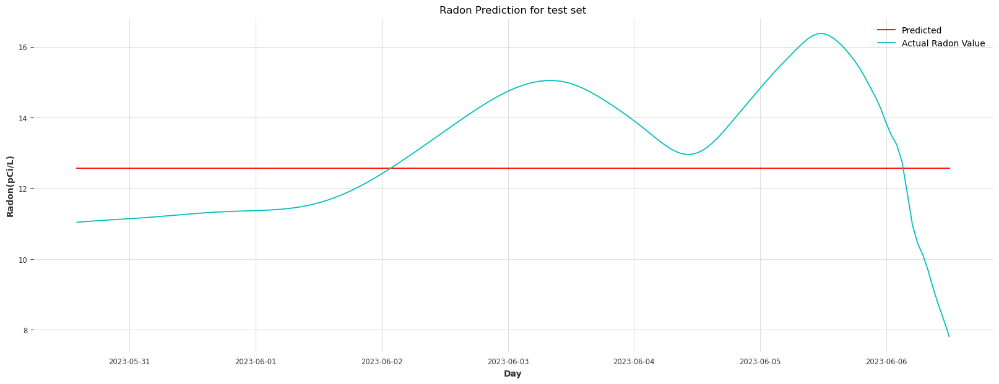

In [24]:
# plot the forecast
plt.figure(100, figsize=(20, 7))
plt.plot(dfY.index, dfY['Predicted'], color='r', label='Predicted')
plt.plot(dfY.index, dfY['Actual'], color='c', label='Actual Radon Value')
plt.legend()
plt.title('Radon Prediction for test set')
plt.xlabel('Day')
plt.ylabel('Radon(pCi/L)')
plt.show()

# Radon 13

In [25]:
df = df_radon['13'].copy()

In [26]:
# Denoising the Radon signal
def madev(d, axis=None):
    """ Mean absolute deviation of a signal """
    return np.mean(np.absolute(d - np.mean(d, axis)), axis)

In [27]:
def wavelet_denoising(x, wavelet='db4', level=5):
    coeff = pywt.wavedec(x, wavelet, mode="per")
    n = len(x) 
    sigma = (1/0.6745) * madev(coeff[-level])
    uthresh = sigma * np.sqrt(2 * np.log(len(x)))
    coeff[1:] = (pywt.threshold(i, value=uthresh, mode='hard') for i in coeff[1:])
    if len(x) % 2 ==0:
        return pywt.waverec(coeff, wavelet, mode='per')
    else:
        return pywt.waverec(coeff, wavelet, mode='per')[:n]

In [28]:
signal = df['Radon'].copy()
wavelet_name='coif17'
filtered = wavelet_denoising(signal, wavelet=wavelet_name, level=4)
df['Radon'] = filtered

In [29]:
# any missing values?
def gaps(df):
    if df.isnull().values.any():
        print("MISSING values:\n")
        mno.matrix(df)
    else:
        print("no missing values\n")
gaps(df)

no missing values



In [30]:
df.describe()

,AirPressure,Humidity,Radon,Temperature
count,"9,378.00","9,378.00","9,378.00","9,378.00"
mean,30.09,82.47,8.81,66.32
std,0.14,14.90,12.58,16.32
min,29.52,23.00,-1.36,16.00
25%,30.00,75.00,1.22,54.00
50%,30.09,88.00,4.38,67.00
75%,30.18,94.00,12.80,76.52
max,30.62,100.00,135.58,137.00


In [31]:
# create time series object for target variable
ts_P = TimeSeries.from_series(df["Radon"], fill_missing_dates=True, freq="H") 

# check attributes of the time series
print("components:", ts_P.components)
print("duration:",ts_P.duration)
print("frequency:",ts_P.freq)
print("frequency:",ts_P.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_P.has_datetime_index)
print("deterministic:",ts_P.is_deterministic)
print("univariate:",ts_P.is_univariate)

components: Index(['Radon'], dtype='object', name='component')
duration: 390 days 17:00:00
frequency: <Hour>
frequency: H
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [32]:
# train/test split and scaling of target variable
ts_train, ts_test = ts_P.split_after(split_point=9210)

print("training start:", ts_train.start_time())
print("training end:", ts_train.end_time())
print("training duration:",ts_train.duration)
print("test start:", ts_test.start_time())
print("test end:", ts_test.end_time())
print("test duration:", ts_test.duration)


scalerP = Scaler()
scalerP.fit_transform(ts_train)
ts_ttrain = scalerP.transform(ts_train)
ts_ttest = scalerP.transform(ts_test)    
ts_t = scalerP.transform(ts_P)

# make sure data are of type float
ts_t = ts_t.astype(np.float32)
ts_ttrain = ts_ttrain.astype(np.float32)
ts_ttest = ts_ttest.astype(np.float32)

print("first and last row of scaled Radon time series:")
pd.options.display.float_format = '{:,.2f}'.format
ts_t.pd_dataframe().iloc[[0,-1]]

training start: 2022-05-11 19:00:00
training end: 2023-05-30 13:00:00
training duration: 383 days 18:00:00
test start: 2023-05-30 14:00:00
test end: 2023-06-06 12:00:00
test duration: 6 days 22:00:00
first and last row of scaled Radon time series:


component,Radon
SyncDate,
2022-05-11 19:00:00,0.05
2023-06-06 12:00:00,0.05


In [33]:
print("first and last row of scaled target variable in training set: price:")
ts_ttrain.pd_dataframe().iloc[[0,-1]]

first and last row of scaled target variable in training set: price:


component,Radon
SyncDate,
2022-05-11 19:00:00,0.05
2023-05-30 13:00:00,0.03


In [34]:
from ray.air import session
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_xgboost_model(
    model_args,
    callbacks=None
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1


#     encoders={"cyclic": {"future": ["hour"]},
#              "transformer": Scaler()
#              } if model_args['include_hour'] else None

    
    arguements = {
                    'eta':model_args['eta'],
                    'gamma':model_args['gamma'],
                    'max_depth':int(model_args['max_depth']),
                    'min_child_weight':int(model_args['min_child_weight']),
                    'subsample':model_args['subsample'],
                    'reg_lambda': int(model_args['reg_lambda']),
                    'reg_alpha':int(model_args['reg_alpha']),
                    'colsample_bytree':model_args['colsample_bytree'],
                    'n_estimators':model_args['n_estimators'],
                    'callbacks':callbacks,
                    'objective':model_args['objective']
                    
    }
    model = XGBModel(
                lags=model_args['lags'],
                output_chunk_length=model_args['output_chunk_length'],
                likelihood='quantile',
                quantiles=QUANTILES,
                multi_models=model_args['multi_models'],
                **arguements
                
    )
    val_len = len(ts_test)
    val_series = ts_ttrain[-((val_len) + model_args['lags']) :]
    ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain_input, 
                val_series=val_series,
                )
    ts_tpred = model.predict(series=ts_ttrain,
                 n=len(ts_ttest))
#     ts_q = ts_tpred.quantile_timeseries(0.5)
    ts_q = scalerP.inverse_transform(ts_tpred)
    q_smape = smape(ts_q, ts_test)
    back_pred = model.historical_forecasts(
        series = ts_ttrain_input,
        start = len(ts_ttrain_input) - 168,
        forecast_horizon = 168)
#     back_pred = back_pred.quantile_timeseries(0.5)
    back_pred = scalerP.inverse_transform(back_pred)
    back_smape = smape(back_pred, ts_train)
    session.report({'q_smape':q_smape, 'back_smape':back_smape})

In [35]:
from ray.air import session
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_xgboost_model_return(
    model_args,
    callbacks=None
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1


#     encoders={"cyclic": {"future": ["hour"]},
#              "transformer": Scaler()
#              } if model_args['include_hour'] else None

    
    arguements = {
                    'eta':model_args['eta'],
                    'gamma':model_args['gamma'],
                    'max_depth':int(model_args['max_depth']),
                    'min_child_weight':int(model_args['min_child_weight']),
                    'subsample':model_args['subsample'],
                    'reg_lambda': int(model_args['reg_lambda']),
                    'reg_alpha':int(model_args['reg_alpha']),
                    'colsample_bytree':model_args['colsample_bytree'],
                    'n_estimators':model_args['n_estimators'],
                    'callbacks':callbacks,
                    'objective':model_args['objective']
                    
    }
    model = XGBModel(
                lags=model_args['lags'],
                output_chunk_length=model_args['output_chunk_length'],
                likelihood='quantile',
                quantiles=QUANTILES,
                multi_models=model_args['multi_models'],
                **arguements
                
    )
    val_len = len(ts_test)
    val_series = ts_ttrain[-((val_len) + model_args['lags']) :]
    ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain_input, 
                val_series=val_series,
                )
#     ts_tpred = model.predict(series=ts_ttrain,
#                  n=len(ts_ttest))
# #     ts_q = ts_tpred.quantile_timeseries(0.5)
#     ts_q = scalerP.inverse_transform(ts_tpred)
#     q_smape = smape(ts_q, ts_test)
#     back_pred = model.historical_forecasts(
#         series = ts_ttrain_input,
#         start = len(ts_ttrain_input) - 168,
#         forecast_horizon = 168)
# #     back_pred = back_pred.quantile_timeseries(0.5)
#     back_pred = scalerP.inverse_transform(back_pred)
#     back_smape = smape(back_pred, ts_train)
#     session.report({'q_smape':q_smape, 'back_smape':back_smape})
    return model

In [36]:
from ray import tune
from ray.tune import CLIReporter
from ray.tune.integration.xgboost import TuneReportCallback
from ray.tune.schedulers import ASHAScheduler, AsyncHyperBandScheduler
from ray.tune.search.optuna import OptunaSearch
from ray.tune.search import ConcurrencyLimiter
# tune_callback = TuneReportCallback(
#     {
#         "loss":'validation_0-rmse'
#     }
# )

#define the hyperparameter search space
config = {
    "lags": tune.randint(8,168),
    "output_chunk_length":tune.randint(1,4),
    "multi_models":tune.choice([True, False]),
    "gamma":tune.uniform(1,9),
    "max_depth":tune.quniform(3,18,1),
    "subsample":tune.uniform(0.5,1),
    "min_child_weight":tune.quniform(0,10,1),
    "reg_lambda":tune.uniform(0,1),
    "reg_alpha":tune.quniform(40,180,1),
    "colsample_bytree":tune.uniform(0.5,1),
    "eta":tune.loguniform(0.01,0.2),
    "n_estimators":tune.randint(50,200),
    "objective":tune.choice(['reg:squarederror','reg:squaredlogerror'])
}

reporter = CLIReporter(
    parameter_columns=list(config.keys()),
    metric_columns=["loss", "training_iteration"])
resources_per_trial = {"cpu": 2}

num_samples = 100

algo = OptunaSearch()
algo = ConcurrencyLimiter(algo, max_concurrent=20)

scheduler = AsyncHyperBandScheduler(max_t=100, grace_period=10, reduction_factor=2)

train_fn_with_parameters = tune.with_parameters(build_fit_xgboost_model)

analysis = tune.run(
    train_fn_with_parameters,
    resources_per_trial=resources_per_trial,
    metric="q_smape",
    mode="min",
    config=config,
    num_samples=num_samples,
    search_alg=algo,
    scheduler = scheduler,
    progress_reporter=reporter,
    name="xgboost_tune",

)

print("Best hyperparameters found were: ", analysis.best_config)

== Status ==
Current time: 2023-07-06 23:34:32 (running for 00:00:00.15)
Memory usage on this node: 9.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 1/100 (1 RUNNING)
+----------------------------------+----------+---------------------+--------+-----------------------+----------------+---------+-------------+-------------+--------------------+--------------+-------------+--------------------+-----------+----------------+------------------+
| Trial name                       | status   | loc                 |   lags |   output_chunk_length | multi_models   |   gamma |   max_depth |   subsample |   min_child_weight |   reg_lambda |   reg_alpha |   colsample_bytree |       eta |   n_estimators | objective        |
|

(build_fit_xgboost_model pid=516832) [4]	validation_0-rmse:0.15738
(build_fit_xgboost_model pid=516832) [5]	validation_0-rmse:0.09362
(build_fit_xgboost_model pid=516832) [6]	validation_0-rmse:0.03060
(build_fit_xgboost_model pid=516832) [7]	validation_0-rmse:0.03401
(build_fit_xgboost_model pid=516832) [8]	validation_0-rmse:0.02883
(build_fit_xgboost_model pid=516832) [9]	validation_0-rmse:0.02292
(build_fit_xgboost_model pid=516832) [10]	validation_0-rmse:0.01716
(build_fit_xgboost_model pid=516832) [11]	validation_0-rmse:0.01272
(build_fit_xgboost_model pid=516832) [12]	validation_0-rmse:0.01451
(build_fit_xgboost_model pid=516832) [13]	validation_0-rmse:0.02846
(build_fit_xgboost_model pid=516832) [14]	validation_0-rmse:0.03713
(build_fit_xgboost_model pid=516832) [15]	validation_0-rmse:0.04012
(build_fit_xgboost_model pid=516832) [16]	validation_0-rmse:0.03960
(build_fit_xgboost_model pid=516832) [17]	validation_0-rmse:0.03491
(build_fit_xgboost_model pid=516832) [18]	validation_0

(build_fit_xgboost_model pid=517063) [30]	validation_0-rmse:0.02442
(build_fit_xgboost_model pid=517265) [14]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517263) [20]	validation_0-rmse:0.25321
(build_fit_xgboost_model pid=517061) [32]	validation_0-rmse:0.09065
(build_fit_xgboost_model pid=517057) [10]	validation_0-rmse:0.07245
(build_fit_xgboost_model pid=517059) [12]	validation_0-rmse:0.22928
(build_fit_xgboost_model pid=517363) [14]	validation_0-rmse:0.10058
(build_fit_xgboost_model pid=517214) [3]	validation_0-rmse:0.42267
(build_fit_xgboost_model pid=517061) [33]	validation_0-rmse:0.09065
(build_fit_xgboost_model pid=517542) [5]	validation_0-rmse:0.03871
(build_fit_xgboost_model pid=517653) [5]	validation_0-rmse:0.23330
(build_fit_xgboost_model pid=517705) [11]	validation_0-rmse:0.13009
(build_fit_xgboost_model pid=517063) [31]	validation_0-rmse:0.02442
(build_fit_xgboost_model pid=517265) [15]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517116) [5]	validation

(build_fit_xgboost_model pid=517063) [48]	validation_0-rmse:0.02442
(build_fit_xgboost_model pid=517265) [28]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517263) [32]	validation_0-rmse:0.12556
(build_fit_xgboost_model pid=517165) [24]	validation_0-rmse:0.14764
(build_fit_xgboost_model pid=517061) [59]	validation_0-rmse:0.09065
(build_fit_xgboost_model pid=517363) [22]	validation_0-rmse:0.01517
(build_fit_xgboost_model pid=517057) [25]	validation_0-rmse:0.07245
(build_fit_xgboost_model pid=517067) [12]	validation_0-rmse:0.27173
(build_fit_xgboost_model pid=517799) [6]	validation_0-rmse:0.33952
(build_fit_xgboost_model pid=517063) [49]	validation_0-rmse:0.02442
(build_fit_xgboost_model pid=517061) [60]	validation_0-rmse:0.09065
(build_fit_xgboost_model pid=517057) [26]	validation_0-rmse:0.07245
(build_fit_xgboost_model pid=517065) [7]	validation_0-rmse:0.05423
(build_fit_xgboost_model pid=517799) [7]	validation_0-rmse:0.31985
(build_fit_xgboost_model pid=517059) [19]	validatio

(build_fit_xgboost_model pid=516832) [29]	validation_0-rmse:0.03041
(build_fit_xgboost_model pid=517059) [24]	validation_0-rmse:0.00611
(build_fit_xgboost_model pid=517059) [25]	validation_0-rmse:0.01028
(build_fit_xgboost_model pid=517063) [65]	validation_0-rmse:0.02442
(build_fit_xgboost_model pid=517063) [66]	validation_0-rmse:0.02442
(build_fit_xgboost_model pid=517063) [67]	validation_0-rmse:0.02442
(build_fit_xgboost_model pid=517063) [68]	validation_0-rmse:0.02442
(build_fit_xgboost_model pid=517063) [69]	validation_0-rmse:0.02442
(build_fit_xgboost_model pid=517063) [70]	validation_0-rmse:0.02442
(build_fit_xgboost_model pid=517063) [71]	validation_0-rmse:0.02442
(build_fit_xgboost_model pid=517063) [72]	validation_0-rmse:0.02442
(build_fit_xgboost_model pid=517063) [73]	validation_0-rmse:0.02442
(build_fit_xgboost_model pid=517063) [74]	validation_0-rmse:0.02442
(build_fit_xgboost_model pid=517265) [41]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517265) [42]	valida

(build_fit_xgboost_model pid=517799) [36]	validation_0-rmse:0.01275
(build_fit_xgboost_model pid=517061) [125]	validation_0-rmse:0.09065
(build_fit_xgboost_model pid=517057) [65]	validation_0-rmse:0.07245
(build_fit_xgboost_model pid=517065) [26]	validation_0-rmse:0.05423
(build_fit_xgboost_model pid=517116) [24]	validation_0-rmse:0.19552
(build_fit_xgboost_model pid=517313) [20]	validation_0-rmse:0.02931
(build_fit_xgboost_model pid=517061) [126]	validation_0-rmse:0.09065
(build_fit_xgboost_model pid=517651) [19]	validation_0-rmse:0.27331
(build_fit_xgboost_model pid=517799) [37]	validation_0-rmse:0.01275
(build_fit_xgboost_model pid=517063) [93]	validation_0-rmse:0.02442
(build_fit_xgboost_model pid=517265) [62]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517363) [42]	validation_0-rmse:0.01517
(build_fit_xgboost_model pid=517057) [66]	validation_0-rmse:0.07245
(build_fit_xgboost_model pid=517214) [22]	validation_0-rmse:0.16358
(build_fit_xgboost_model pid=517799) [38]	vali

(build_fit_xgboost_model pid=517059) [34]	validation_0-rmse:0.01032
(build_fit_xgboost_model pid=517059) [35]	validation_0-rmse:0.01032
(build_fit_xgboost_model pid=517063) [0]	validation_0-rmse:0.42648
(build_fit_xgboost_model pid=517063) [1]	validation_0-rmse:0.37567
(build_fit_xgboost_model pid=517063) [2]	validation_0-rmse:0.32489
(build_fit_xgboost_model pid=517265) [75]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517265) [76]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517265) [77]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517265) [78]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517265) [79]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517265) [80]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517265) [81]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517265) [82]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517116) [29]	validation_0-rmse:0.13934
(build_fit_xgboost_model pid=517116) [30]	validatio

(build_fit_xgboost_model pid=517057) [109]	validation_0-rmse:0.07245
(build_fit_xgboost_model pid=517065) [46]	validation_0-rmse:0.05423
(build_fit_xgboost_model pid=517799) [77]	validation_0-rmse:0.01287
(build_fit_xgboost_model pid=517265) [96]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517061) [3]	validation_0-rmse:0.03933
(build_fit_xgboost_model pid=517653) [19]	validation_0-rmse:0.01548
(build_fit_xgboost_model pid=517799) [78]	validation_0-rmse:0.01287
(build_fit_xgboost_model pid=517363) [62]	validation_0-rmse:0.01517
(build_fit_xgboost_model pid=517651) [31]	validation_0-rmse:0.15111
(build_fit_xgboost_model pid=517542) [33]	validation_0-rmse:0.03871
(build_fit_xgboost_model pid=517059) [40]	validation_0-rmse:0.01033
(build_fit_xgboost_model pid=517265) [97]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517061) [4]	validation_0-rmse:0.02826
(build_fit_xgboost_model pid=517067) [36]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=517705) [90]	validat

(build_fit_xgboost_model pid=517063) [15]	validation_0-rmse:0.01022
(build_fit_xgboost_model pid=517265) [110]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517061) [12]	validation_0-rmse:0.07312
(build_fit_xgboost_model pid=517057) [1]	validation_0-rmse:0.29256
(build_fit_xgboost_model pid=517065) [54]	validation_0-rmse:0.05423
(build_fit_xgboost_model pid=517799) [101]	validation_0-rmse:0.01293
(build_fit_xgboost_model pid=517705) [100]	validation_0-rmse:0.01226
(build_fit_xgboost_model pid=517313) [32]	validation_0-rmse:0.01364
(build_fit_xgboost_model pid=517363) [70]	validation_0-rmse:0.01517
(build_fit_xgboost_model pid=517799) [102]	validation_0-rmse:0.01293
(build_fit_xgboost_model pid=517165) [50]	validation_0-rmse:0.00792
(build_fit_xgboost_model pid=517057) [2]	validation_0-rmse:0.20017
(build_fit_xgboost_model pid=517542) [38]	validation_0-rmse:0.03871
(build_fit_xgboost_model pid=517214) [33]	validation_0-rmse:0.01614
(build_fit_xgboost_model pid=517705) [101]	val

(build_fit_xgboost_model pid=516832) [39]	validation_0-rmse:0.02688
(build_fit_xgboost_model pid=517059) [47]	validation_0-rmse:0.01040
(build_fit_xgboost_model pid=517059) [48]	validation_0-rmse:0.01040
(build_fit_xgboost_model pid=517059) [49]	validation_0-rmse:0.01040
(build_fit_xgboost_model pid=517063) [20]	validation_0-rmse:0.01478
(build_fit_xgboost_model pid=517063) [21]	validation_0-rmse:0.01272
(build_fit_xgboost_model pid=517265) [124]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517265) [125]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517265) [126]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517265) [127]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517265) [128]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517265) [129]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517265) [130]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517265) [131]	validation_0-rmse:0.03693
(build_fit_xgboost_model pid=517116) [38

(build_fit_xgboost_model pid=517542) [50]	validation_0-rmse:0.03871
(build_fit_xgboost_model pid=516832) [42]	validation_0-rmse:0.02817
(build_fit_xgboost_model pid=517059) [55]	validation_0-rmse:0.01040
(build_fit_xgboost_model pid=517059) [56]	validation_0-rmse:0.01040
(build_fit_xgboost_model pid=517063) [27]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517063) [28]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517265) [0]	validation_0-rmse:0.38362
(build_fit_xgboost_model pid=517116) [40]	validation_0-rmse:0.01784
(build_fit_xgboost_model pid=517263) [71]	validation_0-rmse:0.00602
(build_fit_xgboost_model pid=517263) [72]	validation_0-rmse:0.00603
(build_fit_xgboost_model pid=517165) [59]	validation_0-rmse:0.00794
(build_fit_xgboost_model pid=517165) [60]	validation_0-rmse:0.00795
(build_fit_xgboost_model pid=517313) [41]	validation_0-rmse:0.01380
(build_fit_xgboost_model pid=517313) [42]	validation_0-rmse:0.01381
(build_fit_xgboost_model pid=517061) [31]	validat

(build_fit_xgboost_model pid=517651) [42]	validation_0-rmse:0.04046
(build_fit_xgboost_model pid=517653) [30]	validation_0-rmse:0.01552
(build_fit_xgboost_model pid=517313) [49]	validation_0-rmse:0.01385
(build_fit_xgboost_model pid=517363) [111]	validation_0-rmse:0.01517
(build_fit_xgboost_model pid=517705) [15]	validation_0-rmse:0.05834
(build_fit_xgboost_model pid=517263) [81]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=517214) [43]	validation_0-rmse:0.00768
(build_fit_xgboost_model pid=517799) [37]	validation_0-rmse:0.00313
(build_fit_xgboost_model pid=517061) [47]	validation_0-rmse:0.05179
(build_fit_xgboost_model pid=517459) [41]	validation_0-rmse:0.01275
(build_fit_xgboost_model pid=517705) [16]	validation_0-rmse:0.03288
(build_fit_xgboost_model pid=517363) [112]	validation_0-rmse:0.01517
(build_fit_xgboost_model pid=517799) [38]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=517059) [66]	validation_0-rmse:0.01040
(build_fit_xgboost_model pid=517542) [64]	vali

(build_fit_xgboost_model pid=516832) [49]	validation_0-rmse:0.02409
(build_fit_xgboost_model pid=517059) [73]	validation_0-rmse:0.01040
(build_fit_xgboost_model pid=517059) [74]	validation_0-rmse:0.01040
(build_fit_xgboost_model pid=517063) [48]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517063) [49]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517063) [50]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517265) [13]	validation_0-rmse:0.02364
(build_fit_xgboost_model pid=517116) [47]	validation_0-rmse:0.00722
(build_fit_xgboost_model pid=517263) [90]	validation_0-rmse:0.00609
(build_fit_xgboost_model pid=517263) [91]	validation_0-rmse:0.00609
(build_fit_xgboost_model pid=517165) [12]	validation_0-rmse:0.30602
(build_fit_xgboost_model pid=517165) [13]	validation_0-rmse:0.29284
(build_fit_xgboost_model pid=517165) [14]	validation_0-rmse:0.27966
(build_fit_xgboost_model pid=517165) [15]	validation_0-rmse:0.26647
(build_fit_xgboost_model pid=517165) [16]	valida

(build_fit_xgboost_model pid=516832) [52]	validation_0-rmse:0.02409
(build_fit_xgboost_model pid=517059) [80]	validation_0-rmse:0.01040
(build_fit_xgboost_model pid=517059) [81]	validation_0-rmse:0.01040
(build_fit_xgboost_model pid=517063) [54]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517063) [55]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517063) [56]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517265) [16]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=517116) [49]	validation_0-rmse:0.00732
(build_fit_xgboost_model pid=517263) [9]	validation_0-rmse:0.38053
(build_fit_xgboost_model pid=517263) [10]	validation_0-rmse:0.37085
(build_fit_xgboost_model pid=517263) [11]	validation_0-rmse:0.36116
(build_fit_xgboost_model pid=517263) [12]	validation_0-rmse:0.35147
(build_fit_xgboost_model pid=517263) [13]	validation_0-rmse:0.34177
(build_fit_xgboost_model pid=517263) [14]	validation_0-rmse:0.33209
(build_fit_xgboost_model pid=517263) [15]	validat

(build_fit_xgboost_model pid=516832) [54]	validation_0-rmse:0.02409
(build_fit_xgboost_model pid=517059) [85]	validation_0-rmse:0.01040
(build_fit_xgboost_model pid=517059) [86]	validation_0-rmse:0.01040
(build_fit_xgboost_model pid=517063) [59]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517063) [60]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517265) [18]	validation_0-rmse:0.03591
(build_fit_xgboost_model pid=517265) [19]	validation_0-rmse:0.05980
(build_fit_xgboost_model pid=517116) [50]	validation_0-rmse:0.00736
(build_fit_xgboost_model pid=517263) [23]	validation_0-rmse:0.24500
(build_fit_xgboost_model pid=517263) [24]	validation_0-rmse:0.23533
(build_fit_xgboost_model pid=517263) [25]	validation_0-rmse:0.22566
(build_fit_xgboost_model pid=517263) [26]	validation_0-rmse:0.21600
(build_fit_xgboost_model pid=517263) [27]	validation_0-rmse:0.20634
(build_fit_xgboost_model pid=517263) [28]	validation_0-rmse:0.19668
(build_fit_xgboost_model pid=517263) [29]	valida

(build_fit_xgboost_model pid=517542) [91]	validation_0-rmse:0.03871
(build_fit_xgboost_model pid=517542) [92]	validation_0-rmse:0.03871
(build_fit_xgboost_model pid=517214) [55]	validation_0-rmse:0.00791
(build_fit_xgboost_model pid=517653) [41]	validation_0-rmse:0.01567
(build_fit_xgboost_model pid=517705) [92]	validation_0-rmse:0.00934
(build_fit_xgboost_model pid=517705) [93]	validation_0-rmse:0.00934
(build_fit_xgboost_model pid=517705) [94]	validation_0-rmse:0.00934
(build_fit_xgboost_model pid=517705) [95]	validation_0-rmse:0.00934
(build_fit_xgboost_model pid=517705) [96]	validation_0-rmse:0.00934
(build_fit_xgboost_model pid=517705) [97]	validation_0-rmse:0.00934
(build_fit_xgboost_model pid=517705) [98]	validation_0-rmse:0.00934
(build_fit_xgboost_model pid=517705) [99]	validation_0-rmse:0.00934
(build_fit_xgboost_model pid=517799) [82]	validation_0-rmse:0.00226
(build_fit_xgboost_model pid=517799) [83]	validation_0-rmse:0.00226
(build_fit_xgboost_model pid=517799) [84]	valida

(build_fit_xgboost_model pid=516832) [58]	validation_0-rmse:0.02409
(build_fit_xgboost_model pid=517059) [95]	validation_0-rmse:0.01040
(build_fit_xgboost_model pid=517059) [96]	validation_0-rmse:0.01040
(build_fit_xgboost_model pid=517063) [71]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517063) [72]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517265) [25]	validation_0-rmse:0.03136
(build_fit_xgboost_model pid=517116) [54]	validation_0-rmse:0.00747
(build_fit_xgboost_model pid=517263) [46]	validation_0-rmse:0.02520
(build_fit_xgboost_model pid=517263) [47]	validation_0-rmse:0.01643
(build_fit_xgboost_model pid=517263) [48]	validation_0-rmse:0.00832
(build_fit_xgboost_model pid=517165) [43]	validation_0-rmse:0.00851
(build_fit_xgboost_model pid=517165) [44]	validation_0-rmse:0.00854
(build_fit_xgboost_model pid=517313) [74]	validation_0-rmse:0.01391
(build_fit_xgboost_model pid=517061) [90]	validation_0-rmse:0.05179
(build_fit_xgboost_model pid=517061) [91]	valida

(build_fit_xgboost_model pid=516832) [60]	validation_0-rmse:0.02409
(build_fit_xgboost_model pid=517059) [101]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=517059) [102]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=517063) [77]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517063) [78]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517265) [28]	validation_0-rmse:0.01859
(build_fit_xgboost_model pid=517116) [56]	validation_0-rmse:0.00757
(build_fit_xgboost_model pid=517263) [53]	validation_0-rmse:0.00530
(build_fit_xgboost_model pid=517263) [54]	validation_0-rmse:0.00530
(build_fit_xgboost_model pid=517165) [48]	validation_0-rmse:0.00863
(build_fit_xgboost_model pid=517165) [49]	validation_0-rmse:0.00866
(build_fit_xgboost_model pid=517313) [79]	validation_0-rmse:0.01392
(build_fit_xgboost_model pid=517313) [80]	validation_0-rmse:0.01392
(build_fit_xgboost_model pid=517061) [99]	validation_0-rmse:0.05179
(build_fit_xgboost_model pid=517061) [100]	val

(build_fit_xgboost_model pid=516832) [63]	validation_0-rmse:0.02409
(build_fit_xgboost_model pid=517059) [107]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=517059) [108]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=517063) [84]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517063) [85]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517063) [86]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517265) [31]	validation_0-rmse:0.01157
(build_fit_xgboost_model pid=517116) [58]	validation_0-rmse:0.00760
(build_fit_xgboost_model pid=517263) [59]	validation_0-rmse:0.00530
(build_fit_xgboost_model pid=517263) [60]	validation_0-rmse:0.00530
(build_fit_xgboost_model pid=517165) [54]	validation_0-rmse:0.00873
(build_fit_xgboost_model pid=517165) [55]	validation_0-rmse:0.00874
(build_fit_xgboost_model pid=517313) [84]	validation_0-rmse:0.01392
(build_fit_xgboost_model pid=517313) [85]	validation_0-rmse:0.01392
(build_fit_xgboost_model pid=517061) [108]	val

(build_fit_xgboost_model pid=517057) [114]	validation_0-rmse:0.07160
(build_fit_xgboost_model pid=517059) [113]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=517363) [58]	validation_0-rmse:0.00527
(build_fit_xgboost_model pid=517542) [121]	validation_0-rmse:0.03871
(build_fit_xgboost_model pid=517799) [132]	validation_0-rmse:0.00225
(build_fit_xgboost_model pid=517063) [91]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517651) [54]	validation_0-rmse:0.00526
(build_fit_xgboost_model pid=517057) [115]	validation_0-rmse:0.07160
(build_fit_xgboost_model pid=517065) [24]	validation_0-rmse:0.08479
(build_fit_xgboost_model pid=517116) [60]	validation_0-rmse:0.00762
(build_fit_xgboost_model pid=517313) [89]	validation_0-rmse:0.01394
(build_fit_xgboost_model pid=517705) [26]	validation_0-rmse:0.00505
(build_fit_xgboost_model pid=517061) [118]	validation_0-rmse:0.05179
(build_fit_xgboost_model pid=517165) [60]	validation_0-rmse:0.00878
(build_fit_xgboost_model pid=517263) [65]	

(build_fit_xgboost_model pid=516832) [69]	validation_0-rmse:0.02409
(build_fit_xgboost_model pid=517059) [0]	validation_0-rmse:0.45998
(build_fit_xgboost_model pid=517059) [1]	validation_0-rmse:0.44265
(build_fit_xgboost_model pid=517059) [2]	validation_0-rmse:0.42531
(build_fit_xgboost_model pid=517063) [101]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517063) [102]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517265) [37]	validation_0-rmse:0.02905
(build_fit_xgboost_model pid=517263) [73]	validation_0-rmse:0.00530
(build_fit_xgboost_model pid=517263) [74]	validation_0-rmse:0.00530
(build_fit_xgboost_model pid=517165) [68]	validation_0-rmse:0.00887
(build_fit_xgboost_model pid=517165) [69]	validation_0-rmse:0.00887
(build_fit_xgboost_model pid=517165) [70]	validation_0-rmse:0.00888
(build_fit_xgboost_model pid=517313) [98]	validation_0-rmse:0.01394
(build_fit_xgboost_model pid=517313) [99]	validation_0-rmse:0.01394
(build_fit_xgboost_model pid=517061) [131]	valida

(build_fit_xgboost_model pid=516832) [71]	validation_0-rmse:0.02409
(build_fit_xgboost_model pid=517059) [9]	validation_0-rmse:0.30408
(build_fit_xgboost_model pid=517059) [10]	validation_0-rmse:0.28677
(build_fit_xgboost_model pid=517059) [11]	validation_0-rmse:0.26947
(build_fit_xgboost_model pid=517059) [12]	validation_0-rmse:0.25215
(build_fit_xgboost_model pid=517063) [107]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=517265) [40]	validation_0-rmse:0.02905
(build_fit_xgboost_model pid=517263) [79]	validation_0-rmse:0.00530
(build_fit_xgboost_model pid=517263) [80]	validation_0-rmse:0.00530
(build_fit_xgboost_model pid=517165) [6]	validation_0-rmse:0.38530
(build_fit_xgboost_model pid=517165) [7]	validation_0-rmse:0.37214
(build_fit_xgboost_model pid=517165) [8]	validation_0-rmse:0.35897
(build_fit_xgboost_model pid=517165) [9]	validation_0-rmse:0.34580
(build_fit_xgboost_model pid=517165) [10]	validation_0-rmse:0.33262
(build_fit_xgboost_model pid=517165) [11]	validation

(build_fit_xgboost_model pid=516832) [73]	validation_0-rmse:0.02409
(build_fit_xgboost_model pid=517059) [18]	validation_0-rmse:0.14840
(build_fit_xgboost_model pid=517059) [19]	validation_0-rmse:0.13115
(build_fit_xgboost_model pid=517059) [20]	validation_0-rmse:0.11394
(build_fit_xgboost_model pid=517063) [8]	validation_0-rmse:0.07373
(build_fit_xgboost_model pid=517063) [9]	validation_0-rmse:0.02995
(build_fit_xgboost_model pid=517063) [10]	validation_0-rmse:0.01600
(build_fit_xgboost_model pid=517265) [42]	validation_0-rmse:0.02905
(build_fit_xgboost_model pid=517116) [67]	validation_0-rmse:0.00768
(build_fit_xgboost_model pid=517263) [84]	validation_0-rmse:0.00530
(build_fit_xgboost_model pid=517263) [85]	validation_0-rmse:0.00530
(build_fit_xgboost_model pid=517165) [20]	validation_0-rmse:0.20111
(build_fit_xgboost_model pid=517165) [21]	validation_0-rmse:0.18798
(build_fit_xgboost_model pid=517165) [22]	validation_0-rmse:0.17484
(build_fit_xgboost_model pid=517165) [23]	validati

(build_fit_xgboost_model pid=517459) [80]	validation_0-rmse:0.01284
(build_fit_xgboost_model pid=517799) [44]	validation_0-rmse:0.00418
(build_fit_xgboost_model pid=517063) [14]	validation_0-rmse:0.02030
(build_fit_xgboost_model pid=517116) [69]	validation_0-rmse:0.00769
(build_fit_xgboost_model pid=517263) [89]	validation_0-rmse:0.00530
(build_fit_xgboost_model pid=517059) [26]	validation_0-rmse:0.01317
(build_fit_xgboost_model pid=517067) [28]	validation_0-rmse:0.02220
(build_fit_xgboost_model pid=517705) [88]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=517363) [103]	validation_0-rmse:0.00527
(build_fit_xgboost_model pid=516832) [76]	validation_0-rmse:0.02409
(build_fit_xgboost_model pid=517059) [27]	validation_0-rmse:0.00688
(build_fit_xgboost_model pid=517063) [15]	validation_0-rmse:0.01275
(build_fit_xgboost_model pid=517063) [16]	validation_0-rmse:0.00861
(build_fit_xgboost_model pid=517265) [45]	validation_0-rmse:0.02905
(build_fit_xgboost_model pid=517263) [90]	valid

(build_fit_xgboost_model pid=516832) [3]	validation_0-rmse:0.24999
(build_fit_xgboost_model pid=516832) [4]	validation_0-rmse:0.19321
(build_fit_xgboost_model pid=516832) [5]	validation_0-rmse:0.13651
(build_fit_xgboost_model pid=517059) [34]	validation_0-rmse:0.00792
(build_fit_xgboost_model pid=517059) [35]	validation_0-rmse:0.00777
(build_fit_xgboost_model pid=517063) [23]	validation_0-rmse:0.00718
(build_fit_xgboost_model pid=517063) [24]	validation_0-rmse:0.01928
(build_fit_xgboost_model pid=517265) [49]	validation_0-rmse:0.02905
(build_fit_xgboost_model pid=517263) [17]	validation_0-rmse:0.32288
(build_fit_xgboost_model pid=517263) [18]	validation_0-rmse:0.31432
(build_fit_xgboost_model pid=517263) [19]	validation_0-rmse:0.30574
(build_fit_xgboost_model pid=517263) [20]	validation_0-rmse:0.29717
(build_fit_xgboost_model pid=517263) [21]	validation_0-rmse:0.28859
(build_fit_xgboost_model pid=517263) [22]	validation_0-rmse:0.28002
(build_fit_xgboost_model pid=517263) [23]	validatio

(build_fit_xgboost_model pid=516832) [8]	validation_0-rmse:0.03133
(build_fit_xgboost_model pid=517059) [39]	validation_0-rmse:0.00636
(build_fit_xgboost_model pid=517063) [27]	validation_0-rmse:0.01308
(build_fit_xgboost_model pid=517063) [28]	validation_0-rmse:0.00672
(build_fit_xgboost_model pid=517265) [51]	validation_0-rmse:0.02905
(build_fit_xgboost_model pid=517116) [74]	validation_0-rmse:0.00771
(build_fit_xgboost_model pid=517263) [33]	validation_0-rmse:0.18583
(build_fit_xgboost_model pid=517263) [34]	validation_0-rmse:0.17728
(build_fit_xgboost_model pid=517263) [35]	validation_0-rmse:0.16873
(build_fit_xgboost_model pid=517263) [36]	validation_0-rmse:0.16020
(build_fit_xgboost_model pid=517263) [37]	validation_0-rmse:0.15166
(build_fit_xgboost_model pid=517263) [38]	validation_0-rmse:0.14313
(build_fit_xgboost_model pid=517165) [45]	validation_0-rmse:0.00878
(build_fit_xgboost_model pid=517165) [46]	validation_0-rmse:0.00883
(build_fit_xgboost_model pid=517313) [126]	valida

(build_fit_xgboost_model pid=517059) [43]	validation_0-rmse:0.00636
(build_fit_xgboost_model pid=517063) [32]	validation_0-rmse:0.01713
(build_fit_xgboost_model pid=517265) [53]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [76]	validation_0-rmse:0.00772
(build_fit_xgboost_model pid=517263) [46]	validation_0-rmse:0.07533
(build_fit_xgboost_model pid=517263) [47]	validation_0-rmse:0.06697
(build_fit_xgboost_model pid=517263) [48]	validation_0-rmse:0.05860
(build_fit_xgboost_model pid=517263) [49]	validation_0-rmse:0.05028
(build_fit_xgboost_model pid=517165) [50]	validation_0-rmse:0.00904
(build_fit_xgboost_model pid=517165) [51]	validation_0-rmse:0.00908
(build_fit_xgboost_model pid=517313) [131]	validation_0-rmse:0.01398
(build_fit_xgboost_model pid=517061) [5]	validation_0-rmse:0.06740
(build_fit_xgboost_model pid=517061) [6]	validation_0-rmse:0.04245
(build_fit_xgboost_model pid=517061) [7]	validation_0-rmse:0.01769
(build_fit_xgboost_model pid=517061) [8]	validatio

(build_fit_xgboost_model pid=516832) [13]	validation_0-rmse:0.03366
(build_fit_xgboost_model pid=517059) [47]	validation_0-rmse:0.00636
(build_fit_xgboost_model pid=517059) [48]	validation_0-rmse:0.00636
(build_fit_xgboost_model pid=517063) [36]	validation_0-rmse:0.02196
(build_fit_xgboost_model pid=517063) [37]	validation_0-rmse:0.01676
(build_fit_xgboost_model pid=517265) [56]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [78]	validation_0-rmse:0.00775
(build_fit_xgboost_model pid=517263) [55]	validation_0-rmse:0.00490
(build_fit_xgboost_model pid=517263) [56]	validation_0-rmse:0.00377
(build_fit_xgboost_model pid=517165) [55]	validation_0-rmse:0.00917
(build_fit_xgboost_model pid=517165) [56]	validation_0-rmse:0.00923
(build_fit_xgboost_model pid=517313) [136]	validation_0-rmse:0.01401
(build_fit_xgboost_model pid=517313) [137]	validation_0-rmse:0.01401
(build_fit_xgboost_model pid=517061) [16]	validation_0-rmse:0.06314
(build_fit_xgboost_model pid=517061) [17]	vali

(build_fit_xgboost_model pid=516832) [17]	validation_0-rmse:0.03475
(build_fit_xgboost_model pid=517059) [55]	validation_0-rmse:0.00634
(build_fit_xgboost_model pid=517063) [44]	validation_0-rmse:0.01520
(build_fit_xgboost_model pid=517265) [60]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [82]	validation_0-rmse:0.00778
(build_fit_xgboost_model pid=517263) [65]	validation_0-rmse:0.00200
(build_fit_xgboost_model pid=517263) [66]	validation_0-rmse:0.00200
(build_fit_xgboost_model pid=517165) [64]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=517165) [65]	validation_0-rmse:0.00941
(build_fit_xgboost_model pid=517165) [66]	validation_0-rmse:0.00945
(build_fit_xgboost_model pid=517313) [145]	validation_0-rmse:0.01403
(build_fit_xgboost_model pid=517313) [146]	validation_0-rmse:0.01403
(build_fit_xgboost_model pid=517061) [33]	validation_0-rmse:0.05637
(build_fit_xgboost_model pid=517061) [34]	validation_0-rmse:0.05374
(build_fit_xgboost_model pid=517061) [35]	vali

(build_fit_xgboost_model pid=516832) [19]	validation_0-rmse:0.02888
(build_fit_xgboost_model pid=517059) [59]	validation_0-rmse:0.00634
(build_fit_xgboost_model pid=517059) [60]	validation_0-rmse:0.00634
(build_fit_xgboost_model pid=517063) [48]	validation_0-rmse:0.01342
(build_fit_xgboost_model pid=517063) [49]	validation_0-rmse:0.01204
(build_fit_xgboost_model pid=517265) [63]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [84]	validation_0-rmse:0.00778
(build_fit_xgboost_model pid=517263) [70]	validation_0-rmse:0.00200
(build_fit_xgboost_model pid=517165) [70]	validation_0-rmse:0.00948
(build_fit_xgboost_model pid=517165) [0]	validation_0-rmse:0.46540
(build_fit_xgboost_model pid=517165) [1]	validation_0-rmse:0.45342
(build_fit_xgboost_model pid=517313) [150]	validation_0-rmse:0.01404
(build_fit_xgboost_model pid=517313) [151]	validation_0-rmse:0.01404
(build_fit_xgboost_model pid=517061) [43]	validation_0-rmse:0.07784
(build_fit_xgboost_model pid=517061) [44]	valida

(build_fit_xgboost_model pid=516832) [23]	validation_0-rmse:0.03355
(build_fit_xgboost_model pid=517059) [66]	validation_0-rmse:0.00634
(build_fit_xgboost_model pid=517059) [67]	validation_0-rmse:0.00634
(build_fit_xgboost_model pid=517063) [57]	validation_0-rmse:0.01585
(build_fit_xgboost_model pid=517063) [58]	validation_0-rmse:0.01802
(build_fit_xgboost_model pid=517265) [67]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [87]	validation_0-rmse:0.00780
(build_fit_xgboost_model pid=517263) [78]	validation_0-rmse:0.00200
(build_fit_xgboost_model pid=517263) [79]	validation_0-rmse:0.00200
(build_fit_xgboost_model pid=517165) [23]	validation_0-rmse:0.19014
(build_fit_xgboost_model pid=517165) [24]	validation_0-rmse:0.17819
(build_fit_xgboost_model pid=517165) [25]	validation_0-rmse:0.16628
(build_fit_xgboost_model pid=517165) [26]	validation_0-rmse:0.15434
(build_fit_xgboost_model pid=517165) [27]	validation_0-rmse:0.14241
(build_fit_xgboost_model pid=517313) [159]	valid

(build_fit_xgboost_model pid=516832) [25]	validation_0-rmse:0.02408
(build_fit_xgboost_model pid=517059) [71]	validation_0-rmse:0.00634
(build_fit_xgboost_model pid=517063) [62]	validation_0-rmse:0.01137
(build_fit_xgboost_model pid=517063) [63]	validation_0-rmse:0.01406
(build_fit_xgboost_model pid=517265) [69]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [89]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=517263) [83]	validation_0-rmse:0.00200
(build_fit_xgboost_model pid=517165) [36]	validation_0-rmse:0.03627
(build_fit_xgboost_model pid=517165) [37]	validation_0-rmse:0.02493
(build_fit_xgboost_model pid=517165) [38]	validation_0-rmse:0.01405
(build_fit_xgboost_model pid=517165) [39]	validation_0-rmse:0.00536
(build_fit_xgboost_model pid=517313) [164]	validation_0-rmse:0.01406
(build_fit_xgboost_model pid=517313) [165]	validation_0-rmse:0.01406
(build_fit_xgboost_model pid=517061) [67]	validation_0-rmse:0.08232
(build_fit_xgboost_model pid=517061) [68]	vali

(build_fit_xgboost_model pid=516832) [30]	validation_0-rmse:0.02641
(build_fit_xgboost_model pid=517059) [80]	validation_0-rmse:0.00634
(build_fit_xgboost_model pid=517063) [71]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=517265) [74]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [93]	validation_0-rmse:0.00782
(build_fit_xgboost_model pid=517263) [0]	validation_0-rmse:0.47219
(build_fit_xgboost_model pid=517263) [1]	validation_0-rmse:0.46691
(build_fit_xgboost_model pid=517263) [2]	validation_0-rmse:0.46163
(build_fit_xgboost_model pid=517263) [3]	validation_0-rmse:0.45635
(build_fit_xgboost_model pid=517263) [4]	validation_0-rmse:0.45109
(build_fit_xgboost_model pid=517263) [5]	validation_0-rmse:0.44581
(build_fit_xgboost_model pid=517165) [66]	validation_0-rmse:0.00477
(build_fit_xgboost_model pid=517165) [67]	validation_0-rmse:0.00477
(build_fit_xgboost_model pid=517165) [68]	validation_0-rmse:0.00477
(build_fit_xgboost_model pid=517165) [69]	validation_0

(build_fit_xgboost_model pid=516832) [32]	validation_0-rmse:0.03047
(build_fit_xgboost_model pid=517059) [83]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=517059) [84]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=517063) [75]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=517063) [76]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=517265) [77]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [95]	validation_0-rmse:0.00783
(build_fit_xgboost_model pid=517263) [16]	validation_0-rmse:0.38773
(build_fit_xgboost_model pid=517263) [17]	validation_0-rmse:0.38246
(build_fit_xgboost_model pid=517263) [18]	validation_0-rmse:0.37719
(build_fit_xgboost_model pid=517263) [19]	validation_0-rmse:0.37192
(build_fit_xgboost_model pid=517263) [20]	validation_0-rmse:0.36666
(build_fit_xgboost_model pid=517263) [21]	validation_0-rmse:0.36138
(build_fit_xgboost_model pid=517263) [22]	validation_0-rmse:0.35610
(build_fit_xgboost_model pid=517165) [7]	validat

(build_fit_xgboost_model pid=516832) [34]	validation_0-rmse:0.02597
(build_fit_xgboost_model pid=517059) [87]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=517059) [88]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=517063) [79]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=517265) [79]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [97]	validation_0-rmse:0.00783
(build_fit_xgboost_model pid=517263) [31]	validation_0-rmse:0.30865
(build_fit_xgboost_model pid=517263) [32]	validation_0-rmse:0.30338
(build_fit_xgboost_model pid=517263) [33]	validation_0-rmse:0.29811
(build_fit_xgboost_model pid=517263) [34]	validation_0-rmse:0.29286
(build_fit_xgboost_model pid=517263) [35]	validation_0-rmse:0.28760
(build_fit_xgboost_model pid=517263) [36]	validation_0-rmse:0.28234
(build_fit_xgboost_model pid=517165) [20]	validation_0-rmse:0.22639
(build_fit_xgboost_model pid=517165) [21]	validation_0-rmse:0.21444
(build_fit_xgboost_model pid=517165) [22]	valida

(build_fit_xgboost_model pid=516832) [36]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=517059) [91]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=517059) [92]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=517063) [83]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=517265) [81]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [99]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=517263) [46]	validation_0-rmse:0.22974
(build_fit_xgboost_model pid=517263) [47]	validation_0-rmse:0.22447
(build_fit_xgboost_model pid=517263) [48]	validation_0-rmse:0.21921
(build_fit_xgboost_model pid=517263) [49]	validation_0-rmse:0.21395
(build_fit_xgboost_model pid=517263) [50]	validation_0-rmse:0.20868
(build_fit_xgboost_model pid=517263) [51]	validation_0-rmse:0.20343
(build_fit_xgboost_model pid=517165) [33]	validation_0-rmse:0.07205
(build_fit_xgboost_model pid=517165) [34]	validation_0-rmse:0.06035
(build_fit_xgboost_model pid=517165) [35]	valida

(build_fit_xgboost_model pid=516832) [40]	validation_0-rmse:0.03147
(build_fit_xgboost_model pid=517059) [98]	validation_0-rmse:0.00630
(build_fit_xgboost_model pid=517059) [99]	validation_0-rmse:0.00630
(build_fit_xgboost_model pid=517063) [90]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=517063) [91]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=517265) [85]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517265) [86]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [102]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=517263) [73]	validation_0-rmse:0.08858
(build_fit_xgboost_model pid=517263) [74]	validation_0-rmse:0.08346
(build_fit_xgboost_model pid=517263) [75]	validation_0-rmse:0.07834
(build_fit_xgboost_model pid=517263) [76]	validation_0-rmse:0.07321
(build_fit_xgboost_model pid=517165) [44]	validation_0-rmse:0.00520
(build_fit_xgboost_model pid=517313) [5]	validation_0-rmse:0.36059
(build_fit_xgboost_model pid=517313) [6]	validat

(build_fit_xgboost_model pid=517313) [12]	validation_0-rmse:0.22443
(build_fit_xgboost_model pid=517061) [125]	validation_0-rmse:0.05820
(build_fit_xgboost_model pid=517459) [80]	validation_0-rmse:0.01076
(build_fit_xgboost_model pid=517059) [103]	validation_0-rmse:0.00630
(build_fit_xgboost_model pid=517059) [104]	validation_0-rmse:0.00630
(build_fit_xgboost_model pid=517063) [95]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=517265) [88]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517263) [83]	validation_0-rmse:0.03791
(build_fit_xgboost_model pid=517263) [84]	validation_0-rmse:0.03296
(build_fit_xgboost_model pid=517263) [85]	validation_0-rmse:0.02806
(build_fit_xgboost_model pid=517165) [49]	validation_0-rmse:0.00520
(build_fit_xgboost_model pid=517165) [50]	validation_0-rmse:0.00520
(build_fit_xgboost_model pid=517313) [13]	validation_0-rmse:0.20500
(build_fit_xgboost_model pid=517313) [14]	validation_0-rmse:0.18555
(build_fit_xgboost_model pid=517061) [126]	va

(build_fit_xgboost_model pid=516832) [46]	validation_0-rmse:0.03171
(build_fit_xgboost_model pid=517059) [109]	validation_0-rmse:0.00630
(build_fit_xgboost_model pid=517059) [110]	validation_0-rmse:0.00630
(build_fit_xgboost_model pid=517063) [101]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=517265) [92]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [107]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=517263) [0]	validation_0-rmse:0.47550
(build_fit_xgboost_model pid=517263) [1]	validation_0-rmse:0.47353
(build_fit_xgboost_model pid=517263) [2]	validation_0-rmse:0.47156
(build_fit_xgboost_model pid=517263) [3]	validation_0-rmse:0.46960
(build_fit_xgboost_model pid=517263) [4]	validation_0-rmse:0.46763
(build_fit_xgboost_model pid=517165) [55]	validation_0-rmse:0.00520
(build_fit_xgboost_model pid=517165) [56]	validation_0-rmse:0.00520
(build_fit_xgboost_model pid=517313) [21]	validation_0-rmse:0.05070
(build_fit_xgboost_model pid=517313) [22]	validat

(build_fit_xgboost_model pid=516832) [48]	validation_0-rmse:0.03220
(build_fit_xgboost_model pid=517059) [113]	validation_0-rmse:0.00630
(build_fit_xgboost_model pid=517059) [114]	validation_0-rmse:0.00630
(build_fit_xgboost_model pid=517063) [105]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=517265) [94]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [109]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=517263) [14]	validation_0-rmse:0.44795
(build_fit_xgboost_model pid=517263) [15]	validation_0-rmse:0.44598
(build_fit_xgboost_model pid=517263) [16]	validation_0-rmse:0.44401
(build_fit_xgboost_model pid=517263) [17]	validation_0-rmse:0.44204
(build_fit_xgboost_model pid=517263) [18]	validation_0-rmse:0.44008
(build_fit_xgboost_model pid=517263) [19]	validation_0-rmse:0.43811
(build_fit_xgboost_model pid=517263) [20]	validation_0-rmse:0.43615
(build_fit_xgboost_model pid=517165) [59]	validation_0-rmse:0.00520
(build_fit_xgboost_model pid=517165) [60]	va

(build_fit_xgboost_model pid=516832) [50]	validation_0-rmse:0.03277
(build_fit_xgboost_model pid=517059) [117]	validation_0-rmse:0.00630
(build_fit_xgboost_model pid=517059) [118]	validation_0-rmse:0.00630
(build_fit_xgboost_model pid=517063) [1]	validation_0-rmse:0.42206
(build_fit_xgboost_model pid=517063) [2]	validation_0-rmse:0.39445
(build_fit_xgboost_model pid=517063) [3]	validation_0-rmse:0.36683
(build_fit_xgboost_model pid=517063) [4]	validation_0-rmse:0.33926
(build_fit_xgboost_model pid=517063) [5]	validation_0-rmse:0.31167
(build_fit_xgboost_model pid=517063) [6]	validation_0-rmse:0.28412
(build_fit_xgboost_model pid=517265) [97]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [111]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=517263) [31]	validation_0-rmse:0.41450
(build_fit_xgboost_model pid=517263) [32]	validation_0-rmse:0.41253
(build_fit_xgboost_model pid=517263) [33]	validation_0-rmse:0.41056
(build_fit_xgboost_model pid=517263) [34]	validatio

(build_fit_xgboost_model pid=516832) [52]	validation_0-rmse:0.03474
(build_fit_xgboost_model pid=517059) [121]	validation_0-rmse:0.00630
(build_fit_xgboost_model pid=517063) [14]	validation_0-rmse:0.06516
(build_fit_xgboost_model pid=517063) [15]	validation_0-rmse:0.03866
(build_fit_xgboost_model pid=517063) [16]	validation_0-rmse:0.01381
(build_fit_xgboost_model pid=517265) [99]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [113]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=517263) [47]	validation_0-rmse:0.38307
(build_fit_xgboost_model pid=517263) [48]	validation_0-rmse:0.38111
(build_fit_xgboost_model pid=517263) [49]	validation_0-rmse:0.37914
(build_fit_xgboost_model pid=517263) [50]	validation_0-rmse:0.37718
(build_fit_xgboost_model pid=517263) [51]	validation_0-rmse:0.37521
(build_fit_xgboost_model pid=517263) [52]	validation_0-rmse:0.37325
(build_fit_xgboost_model pid=517263) [53]	validation_0-rmse:0.37129
(build_fit_xgboost_model pid=517165) [68]	vali

(build_fit_xgboost_model pid=517059) [6]	validation_0-rmse:0.36970
(build_fit_xgboost_model pid=517063) [20]	validation_0-rmse:0.01503
(build_fit_xgboost_model pid=517165) [6]	validation_0-rmse:0.39385
(build_fit_xgboost_model pid=517653) [125]	validation_0-rmse:0.01576
(build_fit_xgboost_model pid=517799) [29]	validation_0-rmse:0.36400
(build_fit_xgboost_model pid=517363) [38]	validation_0-rmse:0.00648
(build_fit_xgboost_model pid=517057) [92]	validation_0-rmse:0.07074
(build_fit_xgboost_model pid=517263) [66]	validation_0-rmse:0.34575
(build_fit_xgboost_model pid=517214) [19]	validation_0-rmse:0.34120
(build_fit_xgboost_model pid=517799) [30]	validation_0-rmse:0.36023
(build_fit_xgboost_model pid=517165) [7]	validation_0-rmse:0.38192
(build_fit_xgboost_model pid=517313) [39]	validation_0-rmse:0.00414
(build_fit_xgboost_model pid=517542) [71]	validation_0-rmse:0.04288
(build_fit_xgboost_model pid=517705) [72]	validation_0-rmse:0.09040
(build_fit_xgboost_model pid=517799) [31]	validati

(build_fit_xgboost_model pid=517059) [21]	validation_0-rmse:0.13956
(build_fit_xgboost_model pid=517059) [22]	validation_0-rmse:0.12428
(build_fit_xgboost_model pid=517059) [23]	validation_0-rmse:0.10899
(build_fit_xgboost_model pid=517059) [24]	validation_0-rmse:0.09370
(build_fit_xgboost_model pid=517063) [28]	validation_0-rmse:0.01392
(build_fit_xgboost_model pid=517063) [29]	validation_0-rmse:0.01358
(build_fit_xgboost_model pid=517116) [118]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=517263) [0]	validation_0-rmse:0.47661
(build_fit_xgboost_model pid=517263) [1]	validation_0-rmse:0.47574
(build_fit_xgboost_model pid=517263) [2]	validation_0-rmse:0.47488
(build_fit_xgboost_model pid=517263) [3]	validation_0-rmse:0.47401
(build_fit_xgboost_model pid=517165) [29]	validation_0-rmse:0.11980
(build_fit_xgboost_model pid=517165) [30]	validation_0-rmse:0.10797
(build_fit_xgboost_model pid=517165) [31]	validation_0-rmse:0.09619
(build_fit_xgboost_model pid=517165) [32]	validatio

(build_fit_xgboost_model pid=517363) [60]	validation_0-rmse:0.00902
(build_fit_xgboost_model pid=517263) [16]	validation_0-rmse:0.46278
(build_fit_xgboost_model pid=517313) [50]	validation_0-rmse:0.00393
(build_fit_xgboost_model pid=517459) [40]	validation_0-rmse:0.00401
(build_fit_xgboost_model pid=517705) [103]	validation_0-rmse:0.00564
(build_fit_xgboost_model pid=517061) [2]	validation_0-rmse:0.26522
(build_fit_xgboost_model pid=517542) [81]	validation_0-rmse:0.04288
(build_fit_xgboost_model pid=517214) [39]	validation_0-rmse:0.20530
(build_fit_xgboost_model pid=517799) [98]	validation_0-rmse:0.10463
(build_fit_xgboost_model pid=516832) [61]	validation_0-rmse:0.03623
(build_fit_xgboost_model pid=517059) [29]	validation_0-rmse:0.01906
(build_fit_xgboost_model pid=517059) [30]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=517063) [33]	validation_0-rmse:0.01362
(build_fit_xgboost_model pid=517063) [34]	validation_0-rmse:0.01388
(build_fit_xgboost_model pid=517265) [108]	valid

(build_fit_xgboost_model pid=516832) [64]	validation_0-rmse:0.03575
(build_fit_xgboost_model pid=517059) [36]	validation_0-rmse:0.00396
(build_fit_xgboost_model pid=517059) [37]	validation_0-rmse:0.00330
(build_fit_xgboost_model pid=517063) [41]	validation_0-rmse:0.01351
(build_fit_xgboost_model pid=517063) [42]	validation_0-rmse:0.01378
(build_fit_xgboost_model pid=517265) [112]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517263) [41]	validation_0-rmse:0.44118
(build_fit_xgboost_model pid=517263) [42]	validation_0-rmse:0.44032
(build_fit_xgboost_model pid=517263) [43]	validation_0-rmse:0.43946
(build_fit_xgboost_model pid=517263) [44]	validation_0-rmse:0.43860
(build_fit_xgboost_model pid=517263) [45]	validation_0-rmse:0.43773
(build_fit_xgboost_model pid=517263) [46]	validation_0-rmse:0.43687
(build_fit_xgboost_model pid=517263) [47]	validation_0-rmse:0.43601
(build_fit_xgboost_model pid=517165) [45]	validation_0-rmse:0.00484
(build_fit_xgboost_model pid=517165) [46]	valid

(build_fit_xgboost_model pid=516832) [67]	validation_0-rmse:0.03575
(build_fit_xgboost_model pid=517059) [41]	validation_0-rmse:0.00460
(build_fit_xgboost_model pid=517059) [42]	validation_0-rmse:0.00324
(build_fit_xgboost_model pid=517063) [46]	validation_0-rmse:0.01390
(build_fit_xgboost_model pid=517063) [47]	validation_0-rmse:0.01346
(build_fit_xgboost_model pid=517265) [114]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517263) [58]	validation_0-rmse:0.42652
(build_fit_xgboost_model pid=517263) [59]	validation_0-rmse:0.42566
(build_fit_xgboost_model pid=517263) [60]	validation_0-rmse:0.42479
(build_fit_xgboost_model pid=517263) [61]	validation_0-rmse:0.42393
(build_fit_xgboost_model pid=517263) [62]	validation_0-rmse:0.42306
(build_fit_xgboost_model pid=517263) [63]	validation_0-rmse:0.42220
(build_fit_xgboost_model pid=517263) [64]	validation_0-rmse:0.42134
(build_fit_xgboost_model pid=517165) [50]	validation_0-rmse:0.00484
(build_fit_xgboost_model pid=517313) [61]	valid

(build_fit_xgboost_model pid=516832) [71]	validation_0-rmse:0.03745
(build_fit_xgboost_model pid=517059) [48]	validation_0-rmse:0.00308
(build_fit_xgboost_model pid=517063) [55]	validation_0-rmse:0.01346
(build_fit_xgboost_model pid=517063) [56]	validation_0-rmse:0.01394
(build_fit_xgboost_model pid=517265) [119]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [129]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=517263) [87]	validation_0-rmse:0.40152
(build_fit_xgboost_model pid=517263) [88]	validation_0-rmse:0.40066
(build_fit_xgboost_model pid=517263) [89]	validation_0-rmse:0.39980
(build_fit_xgboost_model pid=517263) [90]	validation_0-rmse:0.39894
(build_fit_xgboost_model pid=517263) [91]	validation_0-rmse:0.39808
(build_fit_xgboost_model pid=517165) [57]	validation_0-rmse:0.00484
(build_fit_xgboost_model pid=517165) [58]	validation_0-rmse:0.00484
(build_fit_xgboost_model pid=517313) [69]	validation_0-rmse:0.00392
(build_fit_xgboost_model pid=517061) [45]	vali

(build_fit_xgboost_model pid=516832) [73]	validation_0-rmse:0.03665
(build_fit_xgboost_model pid=517059) [51]	validation_0-rmse:0.00321
(build_fit_xgboost_model pid=517059) [52]	validation_0-rmse:0.00445
(build_fit_xgboost_model pid=517063) [59]	validation_0-rmse:0.01369
(build_fit_xgboost_model pid=517063) [60]	validation_0-rmse:0.01398
(build_fit_xgboost_model pid=517265) [121]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [131]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=517263) [14]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517263) [15]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517263) [16]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517263) [17]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517263) [18]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517263) [19]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517263) [20]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517263) [21]	vali

(build_fit_xgboost_model pid=517363) [115]	validation_0-rmse:0.00610
(build_fit_xgboost_model pid=517459) [63]	validation_0-rmse:0.00333
(build_fit_xgboost_model pid=517799) [28]	validation_0-rmse:0.42617
(build_fit_xgboost_model pid=517263) [46]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517705) [42]	validation_0-rmse:0.37647
(build_fit_xgboost_model pid=517799) [29]	validation_0-rmse:0.42440
(build_fit_xgboost_model pid=517063) [64]	validation_0-rmse:0.01370
(build_fit_xgboost_model pid=517263) [47]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517651) [57]	validation_0-rmse:0.00592
(build_fit_xgboost_model pid=517799) [30]	validation_0-rmse:0.42263
(build_fit_xgboost_model pid=517057) [11]	validation_0-rmse:0.06133
(build_fit_xgboost_model pid=517214) [21]	validation_0-rmse:0.41990
(build_fit_xgboost_model pid=517705) [43]	validation_0-rmse:0.37412
(build_fit_xgboost_model pid=517065) [25]	validation_0-rmse:0.08395
(build_fit_xgboost_model pid=517059) [56]	valid

(build_fit_xgboost_model pid=516832) [77]	validation_0-rmse:0.03659
(build_fit_xgboost_model pid=517059) [58]	validation_0-rmse:0.00463
(build_fit_xgboost_model pid=517059) [59]	validation_0-rmse:0.00463
(build_fit_xgboost_model pid=517063) [67]	validation_0-rmse:0.01358
(build_fit_xgboost_model pid=517265) [125]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [134]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=517263) [62]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517263) [63]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517263) [64]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517263) [65]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517263) [66]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517263) [67]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517263) [68]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517263) [69]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517263) [70]	vali

(build_fit_xgboost_model pid=517063) [71]	validation_0-rmse:0.01361
(build_fit_xgboost_model pid=517165) [5]	validation_0-rmse:0.41367
(build_fit_xgboost_model pid=517363) [129]	validation_0-rmse:0.00581
(build_fit_xgboost_model pid=517705) [77]	validation_0-rmse:0.29456
(build_fit_xgboost_model pid=517799) [73]	validation_0-rmse:0.34685
(build_fit_xgboost_model pid=516832) [2]	validation_0-rmse:0.37134
(build_fit_xgboost_model pid=516832) [3]	validation_0-rmse:0.33602
(build_fit_xgboost_model pid=516832) [4]	validation_0-rmse:0.30072
(build_fit_xgboost_model pid=517059) [63]	validation_0-rmse:0.00463
(build_fit_xgboost_model pid=517059) [64]	validation_0-rmse:0.00463
(build_fit_xgboost_model pid=517063) [72]	validation_0-rmse:0.01392
(build_fit_xgboost_model pid=517265) [128]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [136]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=517165) [6]	validation_0-rmse:0.40305
(build_fit_xgboost_model pid=517165) [7]	validatio

(build_fit_xgboost_model pid=516832) [12]	validation_0-rmse:0.02069
(build_fit_xgboost_model pid=517059) [70]	validation_0-rmse:0.00463
(build_fit_xgboost_model pid=517063) [79]	validation_0-rmse:0.01364
(build_fit_xgboost_model pid=517063) [80]	validation_0-rmse:0.01386
(build_fit_xgboost_model pid=517265) [132]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517165) [31]	validation_0-rmse:0.13816
(build_fit_xgboost_model pid=517165) [32]	validation_0-rmse:0.12760
(build_fit_xgboost_model pid=517165) [33]	validation_0-rmse:0.11706
(build_fit_xgboost_model pid=517165) [34]	validation_0-rmse:0.10652
(build_fit_xgboost_model pid=517165) [35]	validation_0-rmse:0.09600
(build_fit_xgboost_model pid=517313) [92]	validation_0-rmse:0.00392
(build_fit_xgboost_model pid=517313) [93]	validation_0-rmse:0.00392
(build_fit_xgboost_model pid=517061) [91]	validation_0-rmse:0.04955
(build_fit_xgboost_model pid=517061) [92]	validation_0-rmse:0.02586
(build_fit_xgboost_model pid=517061) [93]	valid

(build_fit_xgboost_model pid=516832) [14]	validation_0-rmse:0.02133
(build_fit_xgboost_model pid=517059) [74]	validation_0-rmse:0.00463
(build_fit_xgboost_model pid=517063) [84]	validation_0-rmse:0.01386
(build_fit_xgboost_model pid=517063) [85]	validation_0-rmse:0.01354
(build_fit_xgboost_model pid=517265) [134]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517165) [41]	validation_0-rmse:0.03389
(build_fit_xgboost_model pid=517165) [42]	validation_0-rmse:0.02388
(build_fit_xgboost_model pid=517165) [43]	validation_0-rmse:0.01427
(build_fit_xgboost_model pid=517313) [96]	validation_0-rmse:0.00392
(build_fit_xgboost_model pid=517061) [98]	validation_0-rmse:0.02607
(build_fit_xgboost_model pid=517061) [99]	validation_0-rmse:0.04929
(build_fit_xgboost_model pid=517061) [100]	validation_0-rmse:0.02584
(build_fit_xgboost_model pid=517363) [7]	validation_0-rmse:0.43856
(build_fit_xgboost_model pid=517363) [8]	validation_0-rmse:0.43372
(build_fit_xgboost_model pid=517363) [9]	validat

(build_fit_xgboost_model pid=516832) [17]	validation_0-rmse:0.01454
(build_fit_xgboost_model pid=517059) [77]	validation_0-rmse:0.00463
(build_fit_xgboost_model pid=517059) [78]	validation_0-rmse:0.00463
(build_fit_xgboost_model pid=517063) [88]	validation_0-rmse:0.01388
(build_fit_xgboost_model pid=517063) [89]	validation_0-rmse:0.01377
(build_fit_xgboost_model pid=517265) [136]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517116) [143]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=517165) [47]	validation_0-rmse:0.00388
(build_fit_xgboost_model pid=517165) [48]	validation_0-rmse:0.00316
(build_fit_xgboost_model pid=517165) [49]	validation_0-rmse:0.00290
(build_fit_xgboost_model pid=517313) [100]	validation_0-rmse:0.00392
(build_fit_xgboost_model pid=517061) [105]	validation_0-rmse:0.04935
(build_fit_xgboost_model pid=517061) [106]	validation_0-rmse:0.02591
(build_fit_xgboost_model pid=517061) [107]	validation_0-rmse:0.04954
(build_fit_xgboost_model pid=517363) [24]	

(build_fit_xgboost_model pid=517116) [145]	validation_0-rmse:0.00786
(build_fit_xgboost_model pid=517061) [113]	validation_0-rmse:0.04808
(build_fit_xgboost_model pid=517214) [7]	validation_0-rmse:0.46763
(build_fit_xgboost_model pid=517653) [166]	validation_0-rmse:0.01581
(build_fit_xgboost_model pid=517705) [36]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517799) [71]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517799) [72]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=516832) [19]	validation_0-rmse:0.01470
(build_fit_xgboost_model pid=517363) [45]	validation_0-rmse:0.25491
(build_fit_xgboost_model pid=517799) [73]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517313) [104]	validation_0-rmse:0.00392
(build_fit_xgboost_model pid=517705) [37]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517799) [74]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517067) [57]	validation_0-rmse:0.00622
(build_fit_xgboost_model pid=517705) [38]	val

(build_fit_xgboost_model pid=517705) [61]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517799) [103]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517061) [119]	validation_0-rmse:0.04758
(build_fit_xgboost_model pid=517542) [130]	validation_0-rmse:0.04750
(build_fit_xgboost_model pid=517705) [62]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517799) [104]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517363) [59]	validation_0-rmse:0.18752
(build_fit_xgboost_model pid=517705) [63]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517799) [105]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517313) [107]	validation_0-rmse:0.00392
(build_fit_xgboost_model pid=517705) [64]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517799) [106]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517363) [60]	validation_0-rmse:0.18271
(build_fit_xgboost_model pid=517214) [13]	validation_0-rmse:0.46039
(build_fit_xgboost_model pid=517705) [65]

(build_fit_xgboost_model pid=517214) [18]	validation_0-rmse:0.45432
(build_fit_xgboost_model pid=517705) [88]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517799) [135]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517363) [71]	validation_0-rmse:0.12996
(build_fit_xgboost_model pid=517057) [47]	validation_0-rmse:0.04656
(build_fit_xgboost_model pid=517705) [89]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517799) [136]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517061) [125]	validation_0-rmse:0.04517
(build_fit_xgboost_model pid=517653) [170]	validation_0-rmse:0.01581
(build_fit_xgboost_model pid=517799) [137]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517165) [63]	validation_0-rmse:0.00184
(build_fit_xgboost_model pid=517313) [110]	validation_0-rmse:0.00392
(build_fit_xgboost_model pid=517459) [81]	validation_0-rmse:0.00333
(build_fit_xgboost_model pid=517705) [90]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517799) [138]

(build_fit_xgboost_model pid=516832) [26]	validation_0-rmse:0.02179
(build_fit_xgboost_model pid=517059) [91]	validation_0-rmse:0.00262
(build_fit_xgboost_model pid=517063) [103]	validation_0-rmse:0.01340
(build_fit_xgboost_model pid=517063) [104]	validation_0-rmse:0.01381
(build_fit_xgboost_model pid=517265) [0]	validation_0-rmse:0.39421
(build_fit_xgboost_model pid=517265) [1]	validation_0-rmse:0.31117
(build_fit_xgboost_model pid=517265) [2]	validation_0-rmse:0.22819
(build_fit_xgboost_model pid=517265) [3]	validation_0-rmse:0.14561
(build_fit_xgboost_model pid=517116) [149]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=517165) [67]	validation_0-rmse:0.00184
(build_fit_xgboost_model pid=517165) [68]	validation_0-rmse:0.00184
(build_fit_xgboost_model pid=517165) [69]	validation_0-rmse:0.00184
(build_fit_xgboost_model pid=517313) [113]	validation_0-rmse:0.00392
(build_fit_xgboost_model pid=517313) [114]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=517061) [131]	vali

(build_fit_xgboost_model pid=517059) [95]	validation_0-rmse:0.00409
(build_fit_xgboost_model pid=517061) [140]	validation_0-rmse:0.03311
(build_fit_xgboost_model pid=517214) [32]	validation_0-rmse:0.43736
(build_fit_xgboost_model pid=517165) [6]	validation_0-rmse:0.40320
(build_fit_xgboost_model pid=517057) [56]	validation_0-rmse:0.01797
(build_fit_xgboost_model pid=517067) [23]	validation_0-rmse:0.17146
(build_fit_xgboost_model pid=517063) [0]	validation_0-rmse:0.46710
(build_fit_xgboost_model pid=517116) [151]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=516832) [29]	validation_0-rmse:0.01516
(build_fit_xgboost_model pid=517059) [96]	validation_0-rmse:0.00246
(build_fit_xgboost_model pid=517063) [1]	validation_0-rmse:0.45687
(build_fit_xgboost_model pid=517063) [2]	validation_0-rmse:0.44666
(build_fit_xgboost_model pid=517063) [3]	validation_0-rmse:0.43645
(build_fit_xgboost_model pid=517063) [4]	validation_0-rmse:0.42623
(build_fit_xgboost_model pid=517063) [5]	validation_

(build_fit_xgboost_model pid=516832) [33]	validation_0-rmse:0.01512
(build_fit_xgboost_model pid=517059) [102]	validation_0-rmse:0.00405
(build_fit_xgboost_model pid=517059) [103]	validation_0-rmse:0.00671
(build_fit_xgboost_model pid=517063) [22]	validation_0-rmse:0.24299
(build_fit_xgboost_model pid=517063) [23]	validation_0-rmse:0.23283
(build_fit_xgboost_model pid=517063) [24]	validation_0-rmse:0.22267
(build_fit_xgboost_model pid=517063) [25]	validation_0-rmse:0.21249
(build_fit_xgboost_model pid=517063) [26]	validation_0-rmse:0.20235
(build_fit_xgboost_model pid=517265) [12]	validation_0-rmse:0.02974
(build_fit_xgboost_model pid=517116) [154]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=517165) [28]	validation_0-rmse:0.17032
(build_fit_xgboost_model pid=517165) [29]	validation_0-rmse:0.15978
(build_fit_xgboost_model pid=517165) [30]	validation_0-rmse:0.14924
(build_fit_xgboost_model pid=517165) [31]	validation_0-rmse:0.13870
(build_fit_xgboost_model pid=517165) [32]	val

(build_fit_xgboost_model pid=516832) [38]	validation_0-rmse:0.02204
(build_fit_xgboost_model pid=517059) [110]	validation_0-rmse:0.00671
(build_fit_xgboost_model pid=517063) [42]	validation_0-rmse:0.04556
(build_fit_xgboost_model pid=517063) [43]	validation_0-rmse:0.03648
(build_fit_xgboost_model pid=517063) [44]	validation_0-rmse:0.02776
(build_fit_xgboost_model pid=517063) [45]	validation_0-rmse:0.01962
(build_fit_xgboost_model pid=517265) [17]	validation_0-rmse:0.04344
(build_fit_xgboost_model pid=517116) [158]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=517165) [46]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=517313) [132]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=517061) [167]	validation_0-rmse:0.04738
(build_fit_xgboost_model pid=517061) [168]	validation_0-rmse:0.02959
(build_fit_xgboost_model pid=517061) [169]	validation_0-rmse:0.04716
(build_fit_xgboost_model pid=517363) [124]	validation_0-rmse:0.00690
(build_fit_xgboost_model pid=517363) [125

(build_fit_xgboost_model pid=516832) [44]	validation_0-rmse:0.02281
(build_fit_xgboost_model pid=517059) [118]	validation_0-rmse:0.00302
(build_fit_xgboost_model pid=517063) [53]	validation_0-rmse:0.01261
(build_fit_xgboost_model pid=517265) [22]	validation_0-rmse:0.01464
(build_fit_xgboost_model pid=517165) [55]	validation_0-rmse:0.00200
(build_fit_xgboost_model pid=517165) [56]	validation_0-rmse:0.00200
(build_fit_xgboost_model pid=517165) [57]	validation_0-rmse:0.00200
(build_fit_xgboost_model pid=517313) [140]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=517313) [141]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=517061) [183]	validation_0-rmse:0.04714
(build_fit_xgboost_model pid=517061) [0]	validation_0-rmse:0.45053
(build_fit_xgboost_model pid=517061) [1]	validation_0-rmse:0.42374
(build_fit_xgboost_model pid=517061) [2]	validation_0-rmse:0.39697
(build_fit_xgboost_model pid=517061) [3]	validation_0-rmse:0.37022
(build_fit_xgboost_model pid=517363) [140]	valid

(build_fit_xgboost_model pid=517214) [46]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=516832) [49]	validation_0-rmse:0.01523
(build_fit_xgboost_model pid=517059) [6]	validation_0-rmse:0.41089
(build_fit_xgboost_model pid=517059) [7]	validation_0-rmse:0.40140
(build_fit_xgboost_model pid=517059) [8]	validation_0-rmse:0.39190
(build_fit_xgboost_model pid=517059) [9]	validation_0-rmse:0.38242
(build_fit_xgboost_model pid=517063) [60]	validation_0-rmse:0.01519
(build_fit_xgboost_model pid=517063) [61]	validation_0-rmse:0.01125
(build_fit_xgboost_model pid=517063) [62]	validation_0-rmse:0.01748
(build_fit_xgboost_model pid=517265) [26]	validation_0-rmse:0.03943
(build_fit_xgboost_model pid=517116) [165]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=517165) [64]	validation_0-rmse:0.00200
(build_fit_xgboost_model pid=517165) [65]	validation_0-rmse:0.00200
(build_fit_xgboost_model pid=517165) [66]	validation_0-rmse:0.00200
(build_fit_xgboost_model pid=517313) [148]	validati

(build_fit_xgboost_model pid=516832) [53]	validation_0-rmse:0.01537
(build_fit_xgboost_model pid=517059) [23]	validation_0-rmse:0.24967
(build_fit_xgboost_model pid=517059) [24]	validation_0-rmse:0.24020
(build_fit_xgboost_model pid=517059) [25]	validation_0-rmse:0.23072
(build_fit_xgboost_model pid=517063) [69]	validation_0-rmse:0.01231
(build_fit_xgboost_model pid=517063) [70]	validation_0-rmse:0.01203
(build_fit_xgboost_model pid=517265) [30]	validation_0-rmse:0.04554
(build_fit_xgboost_model pid=517116) [168]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=517165) [9]	validation_0-rmse:0.37157
(build_fit_xgboost_model pid=517165) [10]	validation_0-rmse:0.36099
(build_fit_xgboost_model pid=517165) [11]	validation_0-rmse:0.35037
(build_fit_xgboost_model pid=517165) [12]	validation_0-rmse:0.33979
(build_fit_xgboost_model pid=517165) [13]	validation_0-rmse:0.32922
(build_fit_xgboost_model pid=517313) [155]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=517313) [156]	vali

(build_fit_xgboost_model pid=516832) [58]	validation_0-rmse:0.02307
(build_fit_xgboost_model pid=517059) [39]	validation_0-rmse:0.09850
(build_fit_xgboost_model pid=517059) [40]	validation_0-rmse:0.08915
(build_fit_xgboost_model pid=517059) [41]	validation_0-rmse:0.07982
(build_fit_xgboost_model pid=517063) [79]	validation_0-rmse:0.01196
(build_fit_xgboost_model pid=517063) [80]	validation_0-rmse:0.01196
(build_fit_xgboost_model pid=517116) [172]	validation_0-rmse:0.00788
(build_fit_xgboost_model pid=517165) [36]	validation_0-rmse:0.08701
(build_fit_xgboost_model pid=517165) [37]	validation_0-rmse:0.07667
(build_fit_xgboost_model pid=517165) [38]	validation_0-rmse:0.06640
(build_fit_xgboost_model pid=517165) [39]	validation_0-rmse:0.05612
(build_fit_xgboost_model pid=517313) [163]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=517061) [57]	validation_0-rmse:0.05520
(build_fit_xgboost_model pid=517061) [58]	validation_0-rmse:0.03890
(build_fit_xgboost_model pid=517363) [84]	vali

(build_fit_xgboost_model pid=516832) [63]	validation_0-rmse:0.01608
(build_fit_xgboost_model pid=517059) [50]	validation_0-rmse:0.00517
(build_fit_xgboost_model pid=517059) [51]	validation_0-rmse:0.00414
(build_fit_xgboost_model pid=517063) [88]	validation_0-rmse:0.01178
(build_fit_xgboost_model pid=517063) [89]	validation_0-rmse:0.01178
(build_fit_xgboost_model pid=517063) [90]	validation_0-rmse:0.01178
(build_fit_xgboost_model pid=517265) [39]	validation_0-rmse:0.03007
(build_fit_xgboost_model pid=517116) [6]	validation_0-rmse:0.40558
(build_fit_xgboost_model pid=517116) [7]	validation_0-rmse:0.39533
(build_fit_xgboost_model pid=517116) [8]	validation_0-rmse:0.38508
(build_fit_xgboost_model pid=517165) [49]	validation_0-rmse:0.00294
(build_fit_xgboost_model pid=517165) [50]	validation_0-rmse:0.00286
(build_fit_xgboost_model pid=517313) [171]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=517061) [72]	validation_0-rmse:0.03564
(build_fit_xgboost_model pid=517061) [73]	validati

(build_fit_xgboost_model pid=517063) [102]	validation_0-rmse:0.01178
(build_fit_xgboost_model pid=517363) [11]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517459) [12]	validation_0-rmse:0.41643
(build_fit_xgboost_model pid=517363) [12]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [43]	validation_0-rmse:0.05250
(build_fit_xgboost_model pid=517116) [23]	validation_0-rmse:0.23151
(build_fit_xgboost_model pid=517061) [90]	validation_0-rmse:0.03089
(build_fit_xgboost_model pid=517363) [13]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517313) [179]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=517363) [14]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517459) [13]	validation_0-rmse:0.41173
(build_fit_xgboost_model pid=517067) [43]	validation_0-rmse:0.00414
(build_fit_xgboost_model pid=516832) [69]	validation_0-rmse:0.01514
(build_fit_xgboost_model pid=517059) [60]	validation_0-rmse:0.00488
(build_fit_xgboost_model pid=517059) [61]	vali

(build_fit_xgboost_model pid=517116) [35]	validation_0-rmse:0.10919
(build_fit_xgboost_model pid=517363) [65]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [10]	validation_0-rmse:0.42881
(build_fit_xgboost_model pid=517363) [66]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [67]	validation_0-rmse:0.00484
(build_fit_xgboost_model pid=517061) [106]	validation_0-rmse:0.03647
(build_fit_xgboost_model pid=517459) [36]	validation_0-rmse:0.30378
(build_fit_xgboost_model pid=517653) [40]	validation_0-rmse:0.01164
(build_fit_xgboost_model pid=517165) [66]	validation_0-rmse:0.00275
(build_fit_xgboost_model pid=517363) [67]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [11]	validation_0-rmse:0.42439
(build_fit_xgboost_model pid=517363) [68]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517313) [186]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=517363) [69]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517459) [37]	vali

(build_fit_xgboost_model pid=517363) [122]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517459) [60]	validation_0-rmse:0.19201
(build_fit_xgboost_model pid=517363) [123]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [36]	validation_0-rmse:0.31440
(build_fit_xgboost_model pid=517265) [50]	validation_0-rmse:0.04383
(build_fit_xgboost_model pid=517057) [10]	validation_0-rmse:0.05274
(build_fit_xgboost_model pid=517116) [43]	validation_0-rmse:0.02887
(build_fit_xgboost_model pid=517165) [11]	validation_0-rmse:0.39909
(build_fit_xgboost_model pid=517061) [123]	validation_0-rmse:0.03650
(build_fit_xgboost_model pid=517363) [124]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517459) [61]	validation_0-rmse:0.18739
(build_fit_xgboost_model pid=517653) [46]	validation_0-rmse:0.01162
(build_fit_xgboost_model pid=517363) [125]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [37]	validation_0-rmse:0.31008
(build_fit_xgboost_model pid=517313) [0]	va

(build_fit_xgboost_model pid=517061) [136]	validation_0-rmse:0.03151
(build_fit_xgboost_model pid=517063) [57]	validation_0-rmse:0.22314
(build_fit_xgboost_model pid=517165) [32]	validation_0-rmse:0.26225
(build_fit_xgboost_model pid=517059) [81]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=517313) [9]	validation_0-rmse:0.30463
(build_fit_xgboost_model pid=517063) [58]	validation_0-rmse:0.21877
(build_fit_xgboost_model pid=517116) [47]	validation_0-rmse:0.00527
(build_fit_xgboost_model pid=517459) [80]	validation_0-rmse:0.10076
(build_fit_xgboost_model pid=517653) [52]	validation_0-rmse:0.01162
(build_fit_xgboost_model pid=516832) [7]	validation_0-rmse:0.36691
(build_fit_xgboost_model pid=517165) [33]	validation_0-rmse:0.25575
(build_fit_xgboost_model pid=517061) [137]	validation_0-rmse:0.05171
(build_fit_xgboost_model pid=517542) [27]	validation_0-rmse:0.02671
(build_fit_xgboost_model pid=517063) [59]	validation_0-rmse:0.21445
(build_fit_xgboost_model pid=516832) [8]	validat

(build_fit_xgboost_model pid=517265) [56]	validation_0-rmse:0.04902
(build_fit_xgboost_model pid=517067) [15]	validation_0-rmse:0.27403
(build_fit_xgboost_model pid=517165) [56]	validation_0-rmse:0.10658
(build_fit_xgboost_model pid=517459) [4]	validation_0-rmse:0.46751
(build_fit_xgboost_model pid=516832) [18]	validation_0-rmse:0.21534
(build_fit_xgboost_model pid=516832) [19]	validation_0-rmse:0.20156
(build_fit_xgboost_model pid=517059) [89]	validation_0-rmse:0.00479
(build_fit_xgboost_model pid=517063) [82]	validation_0-rmse:0.11673
(build_fit_xgboost_model pid=517063) [83]	validation_0-rmse:0.11275
(build_fit_xgboost_model pid=517063) [84]	validation_0-rmse:0.10864
(build_fit_xgboost_model pid=517063) [85]	validation_0-rmse:0.10451
(build_fit_xgboost_model pid=517265) [57]	validation_0-rmse:0.05819
(build_fit_xgboost_model pid=517165) [57]	validation_0-rmse:0.10013
(build_fit_xgboost_model pid=517165) [58]	validation_0-rmse:0.09371
(build_fit_xgboost_model pid=517165) [59]	validat

(build_fit_xgboost_model pid=516832) [26]	validation_0-rmse:0.10562
(build_fit_xgboost_model pid=516832) [27]	validation_0-rmse:0.09199
(build_fit_xgboost_model pid=517059) [95]	validation_0-rmse:0.00479
(build_fit_xgboost_model pid=517059) [96]	validation_0-rmse:0.00544
(build_fit_xgboost_model pid=517063) [96]	validation_0-rmse:0.06264
(build_fit_xgboost_model pid=517063) [97]	validation_0-rmse:0.05911
(build_fit_xgboost_model pid=517063) [98]	validation_0-rmse:0.05563
(build_fit_xgboost_model pid=517063) [99]	validation_0-rmse:0.05219
(build_fit_xgboost_model pid=517063) [100]	validation_0-rmse:0.04884
(build_fit_xgboost_model pid=517265) [60]	validation_0-rmse:0.02379
(build_fit_xgboost_model pid=517165) [68]	validation_0-rmse:0.03078
(build_fit_xgboost_model pid=517165) [69]	validation_0-rmse:0.02477
(build_fit_xgboost_model pid=517313) [28]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=517061) [165]	validation_0-rmse:0.02450
(build_fit_xgboost_model pid=517061) [166]	val

(build_fit_xgboost_model pid=516832) [33]	validation_0-rmse:0.01380
(build_fit_xgboost_model pid=517059) [104]	validation_0-rmse:0.00524
(build_fit_xgboost_model pid=517063) [9]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [10]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [11]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [12]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [13]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [14]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [15]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [16]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [17]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [18]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [65]	validation_0-rmse:0.04057
(build_fit_xgboost_model pid=517265) [66]	validation_0-rmse:0.03042
(build_fit_xgboost_model pid=517116) [58]	valida

(build_fit_xgboost_model pid=516832) [36]	validation_0-rmse:0.04254
(build_fit_xgboost_model pid=517059) [108]	validation_0-rmse:0.00531
(build_fit_xgboost_model pid=517059) [109]	validation_0-rmse:0.00476
(build_fit_xgboost_model pid=517063) [34]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [35]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [36]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [37]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [38]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [39]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [40]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [41]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [42]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [43]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [60]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517165) [34]	vali

(build_fit_xgboost_model pid=516832) [38]	validation_0-rmse:0.01973
(build_fit_xgboost_model pid=517059) [112]	validation_0-rmse:0.00540
(build_fit_xgboost_model pid=517059) [113]	validation_0-rmse:0.00509
(build_fit_xgboost_model pid=517063) [61]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [62]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [63]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [64]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [65]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [66]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [67]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [68]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [69]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517063) [70]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [71]	validation_0-rmse:0.02561
(build_fit_xgboost_model pid=517116) [62]	vali

(build_fit_xgboost_model pid=516832) [42]	validation_0-rmse:0.03870
(build_fit_xgboost_model pid=517059) [120]	validation_0-rmse:0.00545
(build_fit_xgboost_model pid=517059) [121]	validation_0-rmse:0.00514
(build_fit_xgboost_model pid=517063) [107]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [76]	validation_0-rmse:0.03694
(build_fit_xgboost_model pid=517116) [65]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517165) [68]	validation_0-rmse:0.03187
(build_fit_xgboost_model pid=517165) [69]	validation_0-rmse:0.02586
(build_fit_xgboost_model pid=517313) [52]	validation_0-rmse:0.00383
(build_fit_xgboost_model pid=517061) [53]	validation_0-rmse:0.06388
(build_fit_xgboost_model pid=517061) [54]	validation_0-rmse:0.06036
(build_fit_xgboost_model pid=517061) [55]	validation_0-rmse:0.06036
(build_fit_xgboost_model pid=517061) [56]	validation_0-rmse:0.06018
(build_fit_xgboost_model pid=517459) [24]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517459) [25]	val

(build_fit_xgboost_model pid=517059) [12]	validation_0-rmse:0.43040
(build_fit_xgboost_model pid=517313) [59]	validation_0-rmse:0.00394
(build_fit_xgboost_model pid=517459) [73]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517265) [81]	validation_0-rmse:0.05078
(build_fit_xgboost_model pid=517165) [18]	validation_0-rmse:0.35388
(build_fit_xgboost_model pid=517459) [74]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517057) [54]	validation_0-rmse:0.04261
(build_fit_xgboost_model pid=517065) [44]	validation_0-rmse:0.05084
(build_fit_xgboost_model pid=517116) [69]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517165) [19]	validation_0-rmse:0.34737
(build_fit_xgboost_model pid=517061) [75]	validation_0-rmse:0.04722
(build_fit_xgboost_model pid=517459) [75]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517059) [13]	validation_0-rmse:0.42679
(build_fit_xgboost_model pid=517459) [76]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=516832) [47]	valida

(build_fit_xgboost_model pid=516832) [50]	validation_0-rmse:0.01935
(build_fit_xgboost_model pid=517059) [27]	validation_0-rmse:0.37627
(build_fit_xgboost_model pid=517059) [28]	validation_0-rmse:0.37266
(build_fit_xgboost_model pid=517059) [29]	validation_0-rmse:0.36905
(build_fit_xgboost_model pid=517059) [30]	validation_0-rmse:0.36545
(build_fit_xgboost_model pid=517265) [85]	validation_0-rmse:0.02908
(build_fit_xgboost_model pid=517116) [71]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517165) [40]	validation_0-rmse:0.21111
(build_fit_xgboost_model pid=517165) [41]	validation_0-rmse:0.20464
(build_fit_xgboost_model pid=517165) [42]	validation_0-rmse:0.19818
(build_fit_xgboost_model pid=517165) [43]	validation_0-rmse:0.19171
(build_fit_xgboost_model pid=517165) [44]	validation_0-rmse:0.18524
(build_fit_xgboost_model pid=517165) [45]	validation_0-rmse:0.17882
(build_fit_xgboost_model pid=517313) [66]	validation_0-rmse:0.00381
(build_fit_xgboost_model pid=517061) [90]	valida

(build_fit_xgboost_model pid=516832) [54]	validation_0-rmse:0.03446
(build_fit_xgboost_model pid=517059) [43]	validation_0-rmse:0.31858
(build_fit_xgboost_model pid=517059) [44]	validation_0-rmse:0.31498
(build_fit_xgboost_model pid=517059) [45]	validation_0-rmse:0.31137
(build_fit_xgboost_model pid=517265) [89]	validation_0-rmse:0.03414
(build_fit_xgboost_model pid=517165) [61]	validation_0-rmse:0.07652
(build_fit_xgboost_model pid=517165) [62]	validation_0-rmse:0.07024
(build_fit_xgboost_model pid=517165) [63]	validation_0-rmse:0.06396
(build_fit_xgboost_model pid=517313) [73]	validation_0-rmse:0.00540
(build_fit_xgboost_model pid=517061) [107]	validation_0-rmse:0.04687
(build_fit_xgboost_model pid=517061) [108]	validation_0-rmse:0.04687
(build_fit_xgboost_model pid=517061) [109]	validation_0-rmse:0.04681
(build_fit_xgboost_model pid=517061) [110]	validation_0-rmse:0.04681
(build_fit_xgboost_model pid=517057) [63]	validation_0-rmse:0.04254
(build_fit_xgboost_model pid=517067) [30]	va

(build_fit_xgboost_model pid=516832) [58]	validation_0-rmse:0.01718
(build_fit_xgboost_model pid=517059) [59]	validation_0-rmse:0.26098
(build_fit_xgboost_model pid=517059) [60]	validation_0-rmse:0.25739
(build_fit_xgboost_model pid=517059) [61]	validation_0-rmse:0.25380
(build_fit_xgboost_model pid=517059) [62]	validation_0-rmse:0.25022
(build_fit_xgboost_model pid=517265) [92]	validation_0-rmse:0.02778
(build_fit_xgboost_model pid=517116) [77]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517165) [3]	validation_0-rmse:0.46765
(build_fit_xgboost_model pid=517165) [4]	validation_0-rmse:0.46522
(build_fit_xgboost_model pid=517165) [5]	validation_0-rmse:0.46279
(build_fit_xgboost_model pid=517165) [6]	validation_0-rmse:0.46036
(build_fit_xgboost_model pid=517165) [7]	validation_0-rmse:0.45793
(build_fit_xgboost_model pid=517313) [80]	validation_0-rmse:0.00504
(build_fit_xgboost_model pid=517061) [125]	validation_0-rmse:0.04681
(build_fit_xgboost_model pid=517061) [126]	validatio

(build_fit_xgboost_model pid=516832) [62]	validation_0-rmse:0.02898
(build_fit_xgboost_model pid=517059) [75]	validation_0-rmse:0.20349
(build_fit_xgboost_model pid=517059) [76]	validation_0-rmse:0.19990
(build_fit_xgboost_model pid=517059) [77]	validation_0-rmse:0.19631
(build_fit_xgboost_model pid=517265) [97]	validation_0-rmse:0.03176
(build_fit_xgboost_model pid=517116) [80]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517165) [27]	validation_0-rmse:0.40932
(build_fit_xgboost_model pid=517165) [28]	validation_0-rmse:0.40689
(build_fit_xgboost_model pid=517165) [29]	validation_0-rmse:0.40446
(build_fit_xgboost_model pid=517165) [30]	validation_0-rmse:0.40203
(build_fit_xgboost_model pid=517165) [31]	validation_0-rmse:0.39960
(build_fit_xgboost_model pid=517165) [32]	validation_0-rmse:0.39717
(build_fit_xgboost_model pid=517313) [86]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=517313) [87]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=517061) [142]	valid

(build_fit_xgboost_model pid=516832) [65]	validation_0-rmse:0.02405
(build_fit_xgboost_model pid=517059) [90]	validation_0-rmse:0.14976
(build_fit_xgboost_model pid=517059) [91]	validation_0-rmse:0.14618
(build_fit_xgboost_model pid=517059) [92]	validation_0-rmse:0.14261
(build_fit_xgboost_model pid=517265) [101]	validation_0-rmse:0.02851
(build_fit_xgboost_model pid=517116) [83]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517165) [52]	validation_0-rmse:0.34860
(build_fit_xgboost_model pid=517165) [53]	validation_0-rmse:0.34618
(build_fit_xgboost_model pid=517165) [54]	validation_0-rmse:0.34375
(build_fit_xgboost_model pid=517165) [55]	validation_0-rmse:0.34133
(build_fit_xgboost_model pid=517165) [56]	validation_0-rmse:0.33890
(build_fit_xgboost_model pid=517313) [93]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=517313) [94]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=517061) [159]	validation_0-rmse:0.04681
(build_fit_xgboost_model pid=517061) [160]	val

(build_fit_xgboost_model pid=516832) [69]	validation_0-rmse:0.02730
(build_fit_xgboost_model pid=517059) [103]	validation_0-rmse:0.10356
(build_fit_xgboost_model pid=517059) [104]	validation_0-rmse:0.10004
(build_fit_xgboost_model pid=517059) [105]	validation_0-rmse:0.09653
(build_fit_xgboost_model pid=517265) [108]	validation_0-rmse:0.03453
(build_fit_xgboost_model pid=517265) [109]	validation_0-rmse:0.03453
(build_fit_xgboost_model pid=517265) [110]	validation_0-rmse:0.03453
(build_fit_xgboost_model pid=517116) [86]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517165) [2]	validation_0-rmse:0.47020
(build_fit_xgboost_model pid=517165) [3]	validation_0-rmse:0.46777
(build_fit_xgboost_model pid=517165) [4]	validation_0-rmse:0.46534
(build_fit_xgboost_model pid=517165) [5]	validation_0-rmse:0.46292
(build_fit_xgboost_model pid=517165) [6]	validation_0-rmse:0.46049
(build_fit_xgboost_model pid=517165) [7]	validation_0-rmse:0.45806
(build_fit_xgboost_model pid=517313) [100]	valid

(build_fit_xgboost_model pid=516832) [73]	validation_0-rmse:0.03464
(build_fit_xgboost_model pid=517059) [115]	validation_0-rmse:0.06191
(build_fit_xgboost_model pid=517059) [116]	validation_0-rmse:0.05849
(build_fit_xgboost_model pid=517116) [90]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517165) [30]	validation_0-rmse:0.40223
(build_fit_xgboost_model pid=517165) [31]	validation_0-rmse:0.39980
(build_fit_xgboost_model pid=517165) [32]	validation_0-rmse:0.39738
(build_fit_xgboost_model pid=517165) [33]	validation_0-rmse:0.39495
(build_fit_xgboost_model pid=517165) [34]	validation_0-rmse:0.39253
(build_fit_xgboost_model pid=517165) [35]	validation_0-rmse:0.39011
(build_fit_xgboost_model pid=517313) [108]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=517061) [42]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517061) [43]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517061) [44]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517061) [45]	val

(build_fit_xgboost_model pid=516832) [76]	validation_0-rmse:0.03161
(build_fit_xgboost_model pid=517059) [121]	validation_0-rmse:0.04165
(build_fit_xgboost_model pid=517265) [124]	validation_0-rmse:0.03453
(build_fit_xgboost_model pid=517265) [125]	validation_0-rmse:0.03453
(build_fit_xgboost_model pid=517165) [45]	validation_0-rmse:0.36587
(build_fit_xgboost_model pid=517165) [46]	validation_0-rmse:0.36344
(build_fit_xgboost_model pid=517165) [47]	validation_0-rmse:0.36102
(build_fit_xgboost_model pid=517165) [48]	validation_0-rmse:0.35859
(build_fit_xgboost_model pid=517165) [49]	validation_0-rmse:0.35616
(build_fit_xgboost_model pid=517165) [50]	validation_0-rmse:0.35374
(build_fit_xgboost_model pid=517313) [112]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=517061) [82]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517061) [83]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517061) [84]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517061) [85]	va

(build_fit_xgboost_model pid=516832) [5]	validation_0-rmse:0.43756
(build_fit_xgboost_model pid=516832) [6]	validation_0-rmse:0.43093
(build_fit_xgboost_model pid=517059) [14]	validation_0-rmse:0.45355
(build_fit_xgboost_model pid=517059) [15]	validation_0-rmse:0.45190
(build_fit_xgboost_model pid=517059) [16]	validation_0-rmse:0.45042
(build_fit_xgboost_model pid=517059) [17]	validation_0-rmse:0.44895
(build_fit_xgboost_model pid=517265) [137]	validation_0-rmse:0.03453
(build_fit_xgboost_model pid=517165) [0]	validation_0-rmse:0.47518
(build_fit_xgboost_model pid=517165) [1]	validation_0-rmse:0.47275
(build_fit_xgboost_model pid=517165) [2]	validation_0-rmse:0.47032
(build_fit_xgboost_model pid=517165) [3]	validation_0-rmse:0.46789
(build_fit_xgboost_model pid=517165) [4]	validation_0-rmse:0.46546
(build_fit_xgboost_model pid=517165) [5]	validation_0-rmse:0.46303
(build_fit_xgboost_model pid=517313) [120]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=517061) [158]	validation_

Trial name,back_smape,date,done,episodes_total,experiment_id,experiment_tag,hostname,iterations_since_restore,node_ip,pid,q_smape,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
build_fit_xgboost_model_07ece967,136.171,2023-07-06_23-41-51,True,,67da529b6101478c890e348b7c6804e9,"72_colsample_bytree=0.9708,eta=0.0158,gamma=7.6971,lags=63,max_depth=8.0000,min_child_weight=6.0000,multi_models=False,n_estimators=136,objective=reg_squaredlogerror,output_chunk_length=1,reg_alpha=72.0000,reg_lambda=0.5606,subsample=0.8643",ip-172-31-10-87,1,172.31.10.87,564190,25.9887,86.9089,86.9089,86.9089,1688686911,0,,1,07ece967,0.00295711
build_fit_xgboost_model_081fee8b,138.354,2023-07-06_23-41-45,True,,b55c23187b594d6e9f770b12ca15687e,"76_colsample_bytree=0.9682,eta=0.0123,gamma=6.9916,lags=63,max_depth=7.0000,min_child_weight=6.0000,multi_models=False,n_estimators=134,objective=reg_squaredlogerror,output_chunk_length=1,reg_alpha=119.0000,reg_lambda=0.8646,subsample=0.8593",ip-172-31-10-87,1,172.31.10.87,572496,37.6752,68.459,68.459,68.459,1688686905,0,,1,081fee8b,0.00305343
build_fit_xgboost_model_09867d50,119.447,2023-07-06_23-43-06,True,,5f5db841d8674e36b47f8462148031d2,"81_colsample_bytree=0.9632,eta=0.0164,gamma=7.6199,lags=111,max_depth=7.0000,min_child_weight=6.0000,multi_models=False,n_estimators=137,objective=reg_squaredlogerror,output_chunk_length=1,reg_alpha=72.0000,reg_lambda=0.6546,subsample=0.7868",ip-172-31-10-87,1,172.31.10.87,574726,37.4718,133.582,133.582,133.582,1688686986,0,,1,09867d50,0.00280571
build_fit_xgboost_model_09c64c28,147.057,2023-07-06_23-39-33,True,,a9fed01a3f424f06805e503113b5adab,"52_colsample_bytree=0.9878,eta=0.0210,gamma=6.5521,lags=94,max_depth=5.0000,min_child_weight=2.0000,multi_models=False,n_estimators=107,objective=reg_squaredlogerror,output_chunk_length=2,reg_alpha=79.0000,reg_lambda=0.7059,subsample=0.6916",ip-172-31-10-87,1,172.31.10.87,558618,142.398,70.983,70.983,70.983,1688686773,0,,1,09c64c28,0.00294304
build_fit_xgboost_model_0a233c46,87.3335,2023-07-06_23-38-45,True,,5957f7b5571740abbf75c559ba226d23,"17_colsample_bytree=0.7299,eta=0.0105,gamma=7.2153,lags=166,max_depth=15.0000,min_child_weight=0.0000,multi_models=True,n_estimators=79,objective=reg_squaredlogerror,output_chunk_length=3,reg_alpha=139.0000,reg_lambda=0.8756,subsample=0.7637",ip-172-31-10-87,1,172.31.10.87,517651,125.596,242.86,242.86,242.86,1688686725,0,,1,0a233c46,0.00318384
build_fit_xgboost_model_0f5d3342,166.035,2023-07-06_23-36-28,True,,e969ca990a264142a937af2baa7830a9,"28_colsample_bytree=0.8363,eta=0.0384,gamma=2.5123,lags=27,max_depth=14.0000,min_child_weight=8.0000,multi_models=True,n_estimators=144,objective=reg_squarederror,output_chunk_length=1,reg_alpha=75.0000,reg_lambda=0.9551,subsample=0.8028",ip-172-31-10-87,1,172.31.10.87,531928,178.455,37.8316,37.8316,37.8316,1688686588,0,,1,0f5d3342,0.00289392
build_fit_xgboost_model_11fbe76c,147.269,2023-07-06_23-40-52,True,,a32e826706f142598314ec01260ef920,"63_colsample_bytree=0.9542,eta=0.0168,gamma=6.8070,lags=102,max_depth=4.0000,min_child_weight=2.0000,multi_models=False,n_estimators=93,objective=reg_squaredlogerror,output_chunk_length=1,reg_alpha=58.0000,reg_lambda=0.5844,subsample=0.9423",ip-172-31-10-87,1,172.31.10.87,566434,92.4258,74.1701,74.1701,74.1701,1688686852,0,,1,11fbe76c,0.0029192
build_fit_xgboost_model_12beb332,1.26778,2023-07-06_23-35-13,True,,7081acd26b6e40d5abfdba8c054e47b0,"11_colsample_bytree=0.9578,eta=0.0110,gamma=7.3929,lags=44,max_depth=9.0000,min_child_weight=4.0000,multi_models=False,n_estimators=92,objective=reg_squaredlogerror,output_chunk_length=2,reg_alpha=159.0000,reg_lambda=0.0338,subsample=0.8278",ip-172-31-10-87,1,172.31.10.87,517263,25.7534,31.1188,31.1188,31.1188,1688686513,0,,1,12beb332,0.00322843
build_fit_xgboost_model_1a74d287,170.619,2023-07-06_23-43-46,True,,bcea96d8b9684c718c1e8f9b178144b3,"83_colsample_bytree=0.9687,eta=0.0124,gamma=7.71

(build_fit_xgboost_model pid=516832) [11]	validation_0-rmse:0.39786
(build_fit_xgboost_model pid=516832) [12]	validation_0-rmse:0.39126
(build_fit_xgboost_model pid=516832) [13]	validation_0-rmse:0.38465
(build_fit_xgboost_model pid=517059) [24]	validation_0-rmse:0.43787
(build_fit_xgboost_model pid=517059) [25]	validation_0-rmse:0.43622
(build_fit_xgboost_model pid=517059) [26]	validation_0-rmse:0.43474
(build_fit_xgboost_model pid=517059) [27]	validation_0-rmse:0.43309
(build_fit_xgboost_model pid=517265) [0]	validation_0-rmse:0.42601
(build_fit_xgboost_model pid=517265) [1]	validation_0-rmse:0.37471
(build_fit_xgboost_model pid=517265) [2]	validation_0-rmse:0.32348
(build_fit_xgboost_model pid=517265) [3]	validation_0-rmse:0.27240
(build_fit_xgboost_model pid=517165) [15]	validation_0-rmse:0.43878
(build_fit_xgboost_model pid=517165) [16]	validation_0-rmse:0.43635
(build_fit_xgboost_model pid=517165) [17]	validation_0-rmse:0.43393
(build_fit_xgboost_model pid=517165) [18]	validation

(build_fit_xgboost_model pid=516832) [22]	validation_0-rmse:0.32510
(build_fit_xgboost_model pid=516832) [23]	validation_0-rmse:0.31849
(build_fit_xgboost_model pid=517059) [38]	validation_0-rmse:0.41491
(build_fit_xgboost_model pid=517059) [39]	validation_0-rmse:0.41326
(build_fit_xgboost_model pid=517059) [40]	validation_0-rmse:0.41161
(build_fit_xgboost_model pid=517059) [41]	validation_0-rmse:0.40996
(build_fit_xgboost_model pid=517265) [10]	validation_0-rmse:0.02174
(build_fit_xgboost_model pid=517116) [99]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517165) [40]	validation_0-rmse:0.37821
(build_fit_xgboost_model pid=517165) [41]	validation_0-rmse:0.37579
(build_fit_xgboost_model pid=517165) [42]	validation_0-rmse:0.37337
(build_fit_xgboost_model pid=517165) [43]	validation_0-rmse:0.37095
(build_fit_xgboost_model pid=517165) [44]	validation_0-rmse:0.36853
(build_fit_xgboost_model pid=517313) [130]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=517313) [131]	vali

(build_fit_xgboost_model pid=516832) [33]	validation_0-rmse:0.25241
(build_fit_xgboost_model pid=516832) [34]	validation_0-rmse:0.24579
(build_fit_xgboost_model pid=517059) [54]	validation_0-rmse:0.38858
(build_fit_xgboost_model pid=517059) [55]	validation_0-rmse:0.38693
(build_fit_xgboost_model pid=517059) [56]	validation_0-rmse:0.38528
(build_fit_xgboost_model pid=517059) [57]	validation_0-rmse:0.38363
(build_fit_xgboost_model pid=517265) [15]	validation_0-rmse:0.03505
(build_fit_xgboost_model pid=517116) [102]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517165) [65]	validation_0-rmse:0.31771
(build_fit_xgboost_model pid=517165) [66]	validation_0-rmse:0.31529
(build_fit_xgboost_model pid=517165) [67]	validation_0-rmse:0.31288
(build_fit_xgboost_model pid=517165) [68]	validation_0-rmse:0.31046
(build_fit_xgboost_model pid=517165) [69]	validation_0-rmse:0.30805
(build_fit_xgboost_model pid=517165) [70]	validation_0-rmse:0.30564
(build_fit_xgboost_model pid=517313) [137]	vali

(build_fit_xgboost_model pid=516832) [47]	validation_0-rmse:0.16040
(build_fit_xgboost_model pid=516832) [48]	validation_0-rmse:0.15389
(build_fit_xgboost_model pid=517059) [78]	validation_0-rmse:0.34908
(build_fit_xgboost_model pid=517059) [79]	validation_0-rmse:0.34743
(build_fit_xgboost_model pid=517059) [80]	validation_0-rmse:0.34578
(build_fit_xgboost_model pid=517265) [22]	validation_0-rmse:0.02386
(build_fit_xgboost_model pid=517116) [106]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517165) [28]	validation_0-rmse:0.44645
(build_fit_xgboost_model pid=517165) [29]	validation_0-rmse:0.44538
(build_fit_xgboost_model pid=517165) [30]	validation_0-rmse:0.44432
(build_fit_xgboost_model pid=517165) [31]	validation_0-rmse:0.44325
(build_fit_xgboost_model pid=517165) [32]	validation_0-rmse:0.44218
(build_fit_xgboost_model pid=517313) [147]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=517313) [148]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=517651) [54]	val

(build_fit_xgboost_model pid=516832) [57]	validation_0-rmse:0.09535
(build_fit_xgboost_model pid=516832) [58]	validation_0-rmse:0.08898
(build_fit_xgboost_model pid=517059) [95]	validation_0-rmse:0.32107
(build_fit_xgboost_model pid=517059) [96]	validation_0-rmse:0.31943
(build_fit_xgboost_model pid=517059) [97]	validation_0-rmse:0.31779
(build_fit_xgboost_model pid=517059) [98]	validation_0-rmse:0.31614
(build_fit_xgboost_model pid=517265) [27]	validation_0-rmse:0.02740
(build_fit_xgboost_model pid=517116) [109]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517165) [54]	validation_0-rmse:0.41871
(build_fit_xgboost_model pid=517165) [55]	validation_0-rmse:0.41765
(build_fit_xgboost_model pid=517165) [56]	validation_0-rmse:0.41658
(build_fit_xgboost_model pid=517165) [57]	validation_0-rmse:0.41551
(build_fit_xgboost_model pid=517165) [58]	validation_0-rmse:0.41445
(build_fit_xgboost_model pid=517165) [59]	validation_0-rmse:0.41338
(build_fit_xgboost_model pid=517313) [154]	vali

(build_fit_xgboost_model pid=516832) [63]	validation_0-rmse:0.05753
(build_fit_xgboost_model pid=517059) [112]	validation_0-rmse:0.29312
(build_fit_xgboost_model pid=517059) [113]	validation_0-rmse:0.29148
(build_fit_xgboost_model pid=517059) [114]	validation_0-rmse:0.28983
(build_fit_xgboost_model pid=517265) [32]	validation_0-rmse:0.02416
(build_fit_xgboost_model pid=517116) [113]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517165) [6]	validation_0-rmse:0.47004
(build_fit_xgboost_model pid=517165) [7]	validation_0-rmse:0.46897
(build_fit_xgboost_model pid=517165) [8]	validation_0-rmse:0.46791
(build_fit_xgboost_model pid=517165) [9]	validation_0-rmse:0.46685
(build_fit_xgboost_model pid=517165) [10]	validation_0-rmse:0.46579
(build_fit_xgboost_model pid=517165) [11]	validation_0-rmse:0.46472
(build_fit_xgboost_model pid=517313) [161]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=517313) [162]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=517057) [16]	vali

(build_fit_xgboost_model pid=516832) [71]	validation_0-rmse:0.01121
(build_fit_xgboost_model pid=517059) [20]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [21]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [22]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [23]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [24]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [25]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [26]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [38]	validation_0-rmse:0.02417
(build_fit_xgboost_model pid=517116) [118]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517165) [43]	validation_0-rmse:0.43066
(build_fit_xgboost_model pid=517165) [44]	validation_0-rmse:0.42959
(build_fit_xgboost_model pid=517165) [45]	validation_0-rmse:0.42854
(build_fit_xgboost_model pid=517165) [46]	validation_0-rmse:0.42747
(build_fit_xgboost_model pid=517165) [47]	valid

(build_fit_xgboost_model pid=517067) [3]	validation_0-rmse:0.46523
(build_fit_xgboost_model pid=517059) [53]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517165) [70]	validation_0-rmse:0.40195
(build_fit_xgboost_model pid=517057) [33]	validation_0-rmse:0.01655
(build_fit_xgboost_model pid=517059) [54]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517542) [167]	validation_0-rmse:0.03459
(build_fit_xgboost_model pid=516832) [76]	validation_0-rmse:0.04102
(build_fit_xgboost_model pid=517059) [55]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [56]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [57]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [58]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [59]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [60]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [43]	validation_0-rmse:0.02813
(build_fit_xgboost_model pid=517165) [0]	validat

(build_fit_xgboost_model pid=516832) [3]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [84]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [85]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [86]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [87]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [46]	validation_0-rmse:0.02533
(build_fit_xgboost_model pid=517165) [21]	validation_0-rmse:0.45424
(build_fit_xgboost_model pid=517165) [22]	validation_0-rmse:0.45318
(build_fit_xgboost_model pid=517165) [23]	validation_0-rmse:0.45212
(build_fit_xgboost_model pid=517165) [24]	validation_0-rmse:0.45105
(build_fit_xgboost_model pid=517165) [25]	validation_0-rmse:0.44999
(build_fit_xgboost_model pid=517165) [26]	validation_0-rmse:0.44893
(build_fit_xgboost_model pid=517313) [185]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=517651) [68]	validation_0-rmse:0.00468
(build_fit_xgboost_model pid=517057) [38]	valida

(build_fit_xgboost_model pid=516832) [12]	validation_0-rmse:0.47716
(build_fit_xgboost_model pid=517059) [112]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [113]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [114]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [115]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [116]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [117]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517059) [118]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [51]	validation_0-rmse:0.02719
(build_fit_xgboost_model pid=517116) [128]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517165) [48]	validation_0-rmse:0.42559
(build_fit_xgboost_model pid=517165) [49]	validation_0-rmse:0.42453
(build_fit_xgboost_model pid=517165) [50]	validation_0-rmse:0.42347
(build_fit_xgboost_model pid=517165) [51]	validation_0-rmse:0.42240
(build_fit_xgboost_model pid=517165) [52

(build_fit_xgboost_model pid=517165) [64]	validation_0-rmse:0.40863
(build_fit_xgboost_model pid=527555) [64]	validation_0-rmse:0.03004
(build_fit_xgboost_model pid=527555) [65]	validation_0-rmse:0.03004
(build_fit_xgboost_model pid=517067) [50]	validation_0-rmse:0.32138
(build_fit_xgboost_model pid=517313) [5]	validation_0-rmse:0.41327
(build_fit_xgboost_model pid=527555) [66]	validation_0-rmse:0.03004
(build_fit_xgboost_model pid=517165) [65]	validation_0-rmse:0.40757
(build_fit_xgboost_model pid=527555) [67]	validation_0-rmse:0.03004
(build_fit_xgboost_model pid=527555) [68]	validation_0-rmse:0.03004
(build_fit_xgboost_model pid=516832) [17]	validation_0-rmse:0.47716
(build_fit_xgboost_model pid=516832) [18]	validation_0-rmse:0.47716
(build_fit_xgboost_model pid=517265) [54]	validation_0-rmse:0.02563
(build_fit_xgboost_model pid=517116) [130]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517165) [66]	validation_0-rmse:0.40651
(build_fit_xgboost_model pid=517165) [67]	valida

(build_fit_xgboost_model pid=516832) [24]	validation_0-rmse:0.47716
(build_fit_xgboost_model pid=516832) [25]	validation_0-rmse:0.47716
(build_fit_xgboost_model pid=517265) [57]	validation_0-rmse:0.02671
(build_fit_xgboost_model pid=517165) [23]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517165) [24]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517165) [25]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517165) [26]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517165) [27]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517165) [28]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517165) [29]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517165) [30]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517165) [31]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517165) [32]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517313) [15]	validation_0-rmse:0.30638
(build_fit_xgboost_model pid=517313) [16]	valida

(build_fit_xgboost_model pid=516832) [31]	validation_0-rmse:0.47716
(build_fit_xgboost_model pid=516832) [32]	validation_0-rmse:0.47716
(build_fit_xgboost_model pid=517265) [61]	validation_0-rmse:0.02664
(build_fit_xgboost_model pid=517165) [58]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517165) [59]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517165) [60]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517165) [61]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517165) [62]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517165) [63]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517165) [64]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517165) [65]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517165) [66]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517165) [67]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517313) [24]	validation_0-rmse:0.21031
(build_fit_xgboost_model pid=517313) [25]	valida

(build_fit_xgboost_model pid=516832) [39]	validation_0-rmse:0.47700
(build_fit_xgboost_model pid=516832) [40]	validation_0-rmse:0.47700
(build_fit_xgboost_model pid=516832) [41]	validation_0-rmse:0.47700
(build_fit_xgboost_model pid=517265) [64]	validation_0-rmse:0.02622
(build_fit_xgboost_model pid=517116) [137]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517165) [19]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517165) [20]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517165) [21]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517165) [22]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517165) [23]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517165) [24]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517165) [25]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517165) [26]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517165) [27]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517165) [28]	valid

(build_fit_xgboost_model pid=517165) [59]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517651) [12]	validation_0-rmse:0.35718
(build_fit_xgboost_model pid=517542) [26]	validation_0-rmse:0.01826
(build_fit_xgboost_model pid=517653) [183]	validation_0-rmse:0.00751
(build_fit_xgboost_model pid=517065) [59]	validation_0-rmse:0.05837
(build_fit_xgboost_model pid=527555) [51]	validation_0-rmse:0.04677
(build_fit_xgboost_model pid=516832) [49]	validation_0-rmse:0.47700
(build_fit_xgboost_model pid=517165) [60]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517067) [46]	validation_0-rmse:0.33387
(build_fit_xgboost_model pid=517165) [61]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=527555) [52]	validation_0-rmse:0.04677
(build_fit_xgboost_model pid=517165) [62]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517313) [41]	validation_0-rmse:0.03128
(build_fit_xgboost_model pid=517651) [13]	validation_0-rmse:0.34793
(build_fit_xgboost_model pid=517165) [63]	valid

(build_fit_xgboost_model pid=516832) [64]	validation_0-rmse:0.47700
(build_fit_xgboost_model pid=516832) [65]	validation_0-rmse:0.47700
(build_fit_xgboost_model pid=517265) [73]	validation_0-rmse:0.02732
(build_fit_xgboost_model pid=517165) [44]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517165) [45]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517165) [46]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517165) [47]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517165) [48]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517165) [49]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517165) [50]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517165) [51]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517165) [52]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517165) [53]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517313) [51]	validation_0-rmse:0.00514
(build_fit_xgboost_model pid=517313) [52]	valida

(build_fit_xgboost_model pid=516832) [76]	validation_0-rmse:0.47700
(build_fit_xgboost_model pid=516832) [77]	validation_0-rmse:0.47700
(build_fit_xgboost_model pid=517265) [78]	validation_0-rmse:0.02598
(build_fit_xgboost_model pid=517313) [59]	validation_0-rmse:0.00536
(build_fit_xgboost_model pid=517313) [60]	validation_0-rmse:0.00429
(build_fit_xgboost_model pid=517651) [39]	validation_0-rmse:0.10832
(build_fit_xgboost_model pid=517057) [82]	validation_0-rmse:0.02880
(build_fit_xgboost_model pid=517067) [27]	validation_0-rmse:0.43678
(build_fit_xgboost_model pid=517067) [28]	validation_0-rmse:0.43533
(build_fit_xgboost_model pid=517067) [29]	validation_0-rmse:0.43387
(build_fit_xgboost_model pid=517067) [30]	validation_0-rmse:0.43242
(build_fit_xgboost_model pid=517542) [46]	validation_0-rmse:0.02251
(build_fit_xgboost_model pid=517542) [47]	validation_0-rmse:0.03131
(build_fit_xgboost_model pid=517653) [6]	validation_0-rmse:0.24823
(build_fit_xgboost_model pid=517653) [7]	validati

(build_fit_xgboost_model pid=517265) [84]	validation_0-rmse:0.02543
(build_fit_xgboost_model pid=517116) [151]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517313) [69]	validation_0-rmse:0.00563
(build_fit_xgboost_model pid=517313) [70]	validation_0-rmse:0.00442
(build_fit_xgboost_model pid=517651) [44]	validation_0-rmse:0.06283
(build_fit_xgboost_model pid=517057) [91]	validation_0-rmse:0.02880
(build_fit_xgboost_model pid=517067) [53]	validation_0-rmse:0.39908
(build_fit_xgboost_model pid=517067) [54]	validation_0-rmse:0.39764
(build_fit_xgboost_model pid=517067) [55]	validation_0-rmse:0.39619
(build_fit_xgboost_model pid=517067) [56]	validation_0-rmse:0.39474
(build_fit_xgboost_model pid=517542) [57]	validation_0-rmse:0.03203
(build_fit_xgboost_model pid=517653) [19]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=517065) [24]	validation_0-rmse:0.12423
(build_fit_xgboost_model pid=527555) [135]	validation_0-rmse:0.04670
(build_fit_xgboost_model pid=527555) [136]	val

(build_fit_xgboost_model pid=517265) [90]	validation_0-rmse:0.02455
(build_fit_xgboost_model pid=517116) [156]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517313) [79]	validation_0-rmse:0.00527
(build_fit_xgboost_model pid=517313) [80]	validation_0-rmse:0.00502
(build_fit_xgboost_model pid=517651) [48]	validation_0-rmse:0.02726
(build_fit_xgboost_model pid=517057) [99]	validation_0-rmse:0.02880
(build_fit_xgboost_model pid=517057) [100]	validation_0-rmse:0.02880
(build_fit_xgboost_model pid=517067) [15]	validation_0-rmse:0.45431
(build_fit_xgboost_model pid=517067) [16]	validation_0-rmse:0.45287
(build_fit_xgboost_model pid=517067) [17]	validation_0-rmse:0.45142
(build_fit_xgboost_model pid=517067) [18]	validation_0-rmse:0.44998
(build_fit_xgboost_model pid=517542) [67]	validation_0-rmse:0.03329
(build_fit_xgboost_model pid=517542) [68]	validation_0-rmse:0.02023
(build_fit_xgboost_model pid=517653) [26]	validation_0-rmse:0.00782
(build_fit_xgboost_model pid=517653) [27]	vali

(build_fit_xgboost_model pid=517265) [96]	validation_0-rmse:0.02417
(build_fit_xgboost_model pid=517116) [160]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517313) [89]	validation_0-rmse:0.00533
(build_fit_xgboost_model pid=517651) [52]	validation_0-rmse:0.00422
(build_fit_xgboost_model pid=517057) [107]	validation_0-rmse:0.02880
(build_fit_xgboost_model pid=517067) [39]	validation_0-rmse:0.41956
(build_fit_xgboost_model pid=517067) [40]	validation_0-rmse:0.41812
(build_fit_xgboost_model pid=517067) [41]	validation_0-rmse:0.41667
(build_fit_xgboost_model pid=517067) [42]	validation_0-rmse:0.41522
(build_fit_xgboost_model pid=517542) [76]	validation_0-rmse:0.02144
(build_fit_xgboost_model pid=517542) [77]	validation_0-rmse:0.03281
(build_fit_xgboost_model pid=517653) [34]	validation_0-rmse:0.01319
(build_fit_xgboost_model pid=517653) [35]	validation_0-rmse:0.01224
(build_fit_xgboost_model pid=527555) [45]	validation_0-rmse:0.01478
(build_fit_xgboost_model pid=527555) [46]	vali

(build_fit_xgboost_model pid=517265) [102]	validation_0-rmse:0.02517
(build_fit_xgboost_model pid=517116) [165]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517313) [100]	validation_0-rmse:0.00465
(build_fit_xgboost_model pid=517651) [55]	validation_0-rmse:0.00449
(build_fit_xgboost_model pid=517057) [116]	validation_0-rmse:0.02880
(build_fit_xgboost_model pid=517067) [3]	validation_0-rmse:0.47182
(build_fit_xgboost_model pid=517067) [4]	validation_0-rmse:0.47037
(build_fit_xgboost_model pid=517067) [5]	validation_0-rmse:0.46892
(build_fit_xgboost_model pid=517067) [6]	validation_0-rmse:0.46748
(build_fit_xgboost_model pid=517542) [87]	validation_0-rmse:0.03238
(build_fit_xgboost_model pid=517542) [88]	validation_0-rmse:0.02299
(build_fit_xgboost_model pid=517653) [41]	validation_0-rmse:0.00934
(build_fit_xgboost_model pid=527555) [72]	validation_0-rmse:0.01053
(build_fit_xgboost_model pid=527555) [73]	validation_0-rmse:0.02580
(build_fit_xgboost_model pid=527555) [74]	valida

(build_fit_xgboost_model pid=517265) [108]	validation_0-rmse:0.02543
(build_fit_xgboost_model pid=517116) [169]	validation_0-rmse:0.00354
(build_fit_xgboost_model pid=517313) [110]	validation_0-rmse:0.00522
(build_fit_xgboost_model pid=517057) [12]	validation_0-rmse:0.02739
(build_fit_xgboost_model pid=517057) [13]	validation_0-rmse:0.01173
(build_fit_xgboost_model pid=517067) [29]	validation_0-rmse:0.43424
(build_fit_xgboost_model pid=517067) [30]	validation_0-rmse:0.43279
(build_fit_xgboost_model pid=517067) [31]	validation_0-rmse:0.43135
(build_fit_xgboost_model pid=517067) [32]	validation_0-rmse:0.42991
(build_fit_xgboost_model pid=517542) [98]	validation_0-rmse:0.02498
(build_fit_xgboost_model pid=517653) [46]	validation_0-rmse:0.01166
(build_fit_xgboost_model pid=517065) [46]	validation_0-rmse:0.06348
(build_fit_xgboost_model pid=527555) [101]	validation_0-rmse:0.01580
(build_fit_xgboost_model pid=527555) [102]	validation_0-rmse:0.01712
(build_fit_xgboost_model pid=527555) [103]	

(build_fit_xgboost_model pid=517265) [114]	validation_0-rmse:0.02437
(build_fit_xgboost_model pid=517313) [120]	validation_0-rmse:0.00516
(build_fit_xgboost_model pid=517057) [23]	validation_0-rmse:0.02204
(build_fit_xgboost_model pid=517057) [24]	validation_0-rmse:0.00964
(build_fit_xgboost_model pid=517067) [54]	validation_0-rmse:0.39813
(build_fit_xgboost_model pid=517067) [55]	validation_0-rmse:0.39669
(build_fit_xgboost_model pid=517067) [56]	validation_0-rmse:0.39524
(build_fit_xgboost_model pid=517067) [57]	validation_0-rmse:0.39380
(build_fit_xgboost_model pid=517542) [108]	validation_0-rmse:0.03244
(build_fit_xgboost_model pid=517542) [109]	validation_0-rmse:0.03685
(build_fit_xgboost_model pid=517653) [53]	validation_0-rmse:0.01640
(build_fit_xgboost_model pid=517653) [54]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=527555) [126]	validation_0-rmse:0.02587
(build_fit_xgboost_model pid=527555) [127]	validation_0-rmse:0.02087
(build_fit_xgboost_model pid=527555) [128]

(build_fit_xgboost_model pid=517265) [120]	validation_0-rmse:0.02394
(build_fit_xgboost_model pid=517116) [20]	validation_0-rmse:0.28647
(build_fit_xgboost_model pid=517116) [21]	validation_0-rmse:0.27738
(build_fit_xgboost_model pid=517116) [22]	validation_0-rmse:0.26831
(build_fit_xgboost_model pid=517313) [130]	validation_0-rmse:0.00465
(build_fit_xgboost_model pid=517313) [131]	validation_0-rmse:0.00544
(build_fit_xgboost_model pid=517057) [33]	validation_0-rmse:0.02824
(build_fit_xgboost_model pid=517057) [34]	validation_0-rmse:0.01895
(build_fit_xgboost_model pid=517067) [26]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517067) [27]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517067) [28]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517067) [29]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517067) [30]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517067) [31]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517542) [119]	va

(build_fit_xgboost_model pid=517265) [124]	validation_0-rmse:0.02411
(build_fit_xgboost_model pid=517116) [34]	validation_0-rmse:0.15961
(build_fit_xgboost_model pid=517116) [35]	validation_0-rmse:0.15054
(build_fit_xgboost_model pid=517116) [36]	validation_0-rmse:0.14153
(build_fit_xgboost_model pid=517313) [137]	validation_0-rmse:0.00524
(build_fit_xgboost_model pid=517057) [40]	validation_0-rmse:0.03061
(build_fit_xgboost_model pid=517057) [41]	validation_0-rmse:0.02159
(build_fit_xgboost_model pid=517067) [53]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517067) [54]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517067) [55]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517067) [56]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517067) [57]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517067) [58]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517067) [59]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517542) [126]	val

(build_fit_xgboost_model pid=517265) [128]	validation_0-rmse:0.02356
(build_fit_xgboost_model pid=517116) [44]	validation_0-rmse:0.06969
(build_fit_xgboost_model pid=517313) [144]	validation_0-rmse:0.00519
(build_fit_xgboost_model pid=517313) [145]	validation_0-rmse:0.00540
(build_fit_xgboost_model pid=517651) [68]	validation_0-rmse:0.00449
(build_fit_xgboost_model pid=517057) [47]	validation_0-rmse:0.03242
(build_fit_xgboost_model pid=517067) [18]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517067) [19]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517067) [20]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517067) [21]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517067) [22]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517542) [134]	validation_0-rmse:0.02673
(build_fit_xgboost_model pid=517542) [135]	validation_0-rmse:0.03257
(build_fit_xgboost_model pid=517653) [74]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=527555) [67]	v

(build_fit_xgboost_model pid=517265) [132]	validation_0-rmse:0.02300
(build_fit_xgboost_model pid=517313) [151]	validation_0-rmse:0.00517
(build_fit_xgboost_model pid=517313) [152]	validation_0-rmse:0.00525
(build_fit_xgboost_model pid=517057) [53]	validation_0-rmse:0.03030
(build_fit_xgboost_model pid=517057) [54]	validation_0-rmse:0.03891
(build_fit_xgboost_model pid=517067) [44]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517067) [45]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517067) [46]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517067) [47]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517067) [48]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517067) [49]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517067) [50]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517542) [142]	validation_0-rmse:0.02932
(build_fit_xgboost_model pid=517653) [78]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=527555) [94]	va

(build_fit_xgboost_model pid=517265) [136]	validation_0-rmse:0.02287
(build_fit_xgboost_model pid=517116) [52]	validation_0-rmse:0.00470
(build_fit_xgboost_model pid=517313) [158]	validation_0-rmse:0.00525
(build_fit_xgboost_model pid=517313) [159]	validation_0-rmse:0.00527
(build_fit_xgboost_model pid=517057) [59]	validation_0-rmse:0.03335
(build_fit_xgboost_model pid=517057) [60]	validation_0-rmse:0.04740
(build_fit_xgboost_model pid=517067) [8]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517067) [9]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517067) [10]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517067) [11]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517067) [12]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517067) [13]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517067) [14]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517542) [149]	validation_0-rmse:0.03504
(build_fit_xgboost_model pid=517542) [150]	val

(build_fit_xgboost_model pid=517265) [140]	validation_0-rmse:0.02339
(build_fit_xgboost_model pid=517116) [55]	validation_0-rmse:0.00321
(build_fit_xgboost_model pid=517313) [165]	validation_0-rmse:0.00521
(build_fit_xgboost_model pid=517313) [166]	validation_0-rmse:0.00531
(build_fit_xgboost_model pid=517057) [65]	validation_0-rmse:0.02356
(build_fit_xgboost_model pid=517067) [34]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517067) [35]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517067) [36]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517067) [37]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517067) [38]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517542) [156]	validation_0-rmse:0.02929
(build_fit_xgboost_model pid=517653) [88]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=517653) [89]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=517065) [60]	validation_0-rmse:0.06303
(build_fit_xgboost_model pid=527555) [147]	v

(build_fit_xgboost_model pid=517265) [0]	validation_0-rmse:0.45780
(build_fit_xgboost_model pid=517116) [57]	validation_0-rmse:0.00335
(build_fit_xgboost_model pid=517313) [171]	validation_0-rmse:0.00532
(build_fit_xgboost_model pid=517313) [172]	validation_0-rmse:0.00516
(build_fit_xgboost_model pid=517057) [68]	validation_0-rmse:0.02794
(build_fit_xgboost_model pid=517542) [162]	validation_0-rmse:0.02984
(build_fit_xgboost_model pid=517542) [163]	validation_0-rmse:0.03579
(build_fit_xgboost_model pid=527555) [31]	validation_0-rmse:0.01603
(build_fit_xgboost_model pid=528066) [42]	validation_0-rmse:0.00517
(build_fit_xgboost_model pid=529138) [78]	validation_0-rmse:0.02548
(build_fit_xgboost_model pid=529138) [79]	validation_0-rmse:0.02548
(build_fit_xgboost_model pid=529138) [80]	validation_0-rmse:0.02548
(build_fit_xgboost_model pid=529138) [81]	validation_0-rmse:0.02548
(build_fit_xgboost_model pid=517265) [1]	validation_0-rmse:0.43829
(build_fit_xgboost_model pid=517265) [2]	valid

(build_fit_xgboost_model pid=517265) [20]	validation_0-rmse:0.07137
(build_fit_xgboost_model pid=517265) [21]	validation_0-rmse:0.05288
(build_fit_xgboost_model pid=517116) [61]	validation_0-rmse:0.00265
(build_fit_xgboost_model pid=517313) [181]	validation_0-rmse:0.00518
(build_fit_xgboost_model pid=517313) [182]	validation_0-rmse:0.00525
(build_fit_xgboost_model pid=517651) [4]	validation_0-rmse:0.43138
(build_fit_xgboost_model pid=517651) [5]	validation_0-rmse:0.42212
(build_fit_xgboost_model pid=517651) [6]	validation_0-rmse:0.41285
(build_fit_xgboost_model pid=517057) [74]	validation_0-rmse:0.03187
(build_fit_xgboost_model pid=517542) [172]	validation_0-rmse:0.03122
(build_fit_xgboost_model pid=517542) [173]	validation_0-rmse:0.03402
(build_fit_xgboost_model pid=517653) [100]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=517065) [1]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517065) [2]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517065) [3]	validat

(build_fit_xgboost_model pid=517265) [28]	validation_0-rmse:0.03292
(build_fit_xgboost_model pid=517116) [65]	validation_0-rmse:0.00292
(build_fit_xgboost_model pid=517313) [191]	validation_0-rmse:0.00530
(build_fit_xgboost_model pid=517651) [21]	validation_0-rmse:0.27428
(build_fit_xgboost_model pid=517651) [22]	validation_0-rmse:0.26506
(build_fit_xgboost_model pid=517651) [23]	validation_0-rmse:0.25584
(build_fit_xgboost_model pid=517057) [82]	validation_0-rmse:0.02254
(build_fit_xgboost_model pid=517542) [183]	validation_0-rmse:0.03378
(build_fit_xgboost_model pid=517653) [108]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=517653) [109]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=517653) [110]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=517065) [29]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517065) [30]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517065) [31]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517065) [32]	v

(build_fit_xgboost_model pid=517265) [33]	validation_0-rmse:0.04544
(build_fit_xgboost_model pid=517116) [68]	validation_0-rmse:0.00274
(build_fit_xgboost_model pid=517313) [9]	validation_0-rmse:0.43635
(build_fit_xgboost_model pid=517313) [10]	validation_0-rmse:0.43224
(build_fit_xgboost_model pid=517651) [33]	validation_0-rmse:0.16381
(build_fit_xgboost_model pid=517651) [34]	validation_0-rmse:0.15462
(build_fit_xgboost_model pid=517057) [87]	validation_0-rmse:0.02921
(build_fit_xgboost_model pid=517542) [7]	validation_0-rmse:0.31528
(build_fit_xgboost_model pid=517542) [8]	validation_0-rmse:0.29505
(build_fit_xgboost_model pid=517542) [9]	validation_0-rmse:0.27486
(build_fit_xgboost_model pid=517542) [10]	validation_0-rmse:0.25469
(build_fit_xgboost_model pid=517065) [49]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517065) [50]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517065) [51]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517065) [52]	validation

(build_fit_xgboost_model pid=517265) [38]	validation_0-rmse:0.05463
(build_fit_xgboost_model pid=517313) [26]	validation_0-rmse:0.36651
(build_fit_xgboost_model pid=517313) [27]	validation_0-rmse:0.36241
(build_fit_xgboost_model pid=517313) [28]	validation_0-rmse:0.35830
(build_fit_xgboost_model pid=517057) [95]	validation_0-rmse:0.03205
(build_fit_xgboost_model pid=517542) [25]	validation_0-rmse:0.06257
(build_fit_xgboost_model pid=517542) [26]	validation_0-rmse:0.04896
(build_fit_xgboost_model pid=517653) [122]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=527555) [121]	validation_0-rmse:0.01943
(build_fit_xgboost_model pid=527555) [122]	validation_0-rmse:0.01943
(build_fit_xgboost_model pid=527555) [123]	validation_0-rmse:0.01943
(build_fit_xgboost_model pid=528066) [11]	validation_0-rmse:0.33582
(build_fit_xgboost_model pid=528066) [12]	validation_0-rmse:0.32401
(build_fit_xgboost_model pid=528066) [13]	validation_0-rmse:0.31222
(build_fit_xgboost_model pid=529138) [20]	va

(build_fit_xgboost_model pid=517265) [44]	validation_0-rmse:0.03703
(build_fit_xgboost_model pid=517116) [76]	validation_0-rmse:0.00294
(build_fit_xgboost_model pid=517116) [77]	validation_0-rmse:0.00294
(build_fit_xgboost_model pid=517313) [42]	validation_0-rmse:0.30083
(build_fit_xgboost_model pid=517313) [43]	validation_0-rmse:0.29673
(build_fit_xgboost_model pid=517313) [44]	validation_0-rmse:0.29263
(build_fit_xgboost_model pid=517057) [103]	validation_0-rmse:0.02856
(build_fit_xgboost_model pid=517542) [35]	validation_0-rmse:0.06113
(build_fit_xgboost_model pid=517542) [36]	validation_0-rmse:0.04779
(build_fit_xgboost_model pid=527555) [145]	validation_0-rmse:0.01943
(build_fit_xgboost_model pid=527555) [146]	validation_0-rmse:0.01943
(build_fit_xgboost_model pid=527555) [147]	validation_0-rmse:0.01943
(build_fit_xgboost_model pid=528066) [27]	validation_0-rmse:0.14754
(build_fit_xgboost_model pid=528066) [28]	validation_0-rmse:0.13585
(build_fit_xgboost_model pid=528066) [29]	va

(build_fit_xgboost_model pid=517265) [49]	validation_0-rmse:0.02281
(build_fit_xgboost_model pid=517116) [81]	validation_0-rmse:0.00282
(build_fit_xgboost_model pid=517313) [60]	validation_0-rmse:0.22713
(build_fit_xgboost_model pid=517313) [61]	validation_0-rmse:0.22306
(build_fit_xgboost_model pid=517057) [110]	validation_0-rmse:0.03254
(build_fit_xgboost_model pid=517542) [45]	validation_0-rmse:0.02449
(build_fit_xgboost_model pid=517542) [46]	validation_0-rmse:0.03007
(build_fit_xgboost_model pid=517653) [137]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=527555) [55]	validation_0-rmse:0.06664
(build_fit_xgboost_model pid=527555) [56]	validation_0-rmse:0.06352
(build_fit_xgboost_model pid=527555) [57]	validation_0-rmse:0.05762
(build_fit_xgboost_model pid=527555) [58]	validation_0-rmse:0.05153
(build_fit_xgboost_model pid=527555) [59]	validation_0-rmse:0.04576
(build_fit_xgboost_model pid=527555) [60]	validation_0-rmse:0.04005
(build_fit_xgboost_model pid=527555) [61]	vali

(build_fit_xgboost_model pid=517265) [53]	validation_0-rmse:0.02826
(build_fit_xgboost_model pid=517116) [84]	validation_0-rmse:0.00281
(build_fit_xgboost_model pid=517313) [70]	validation_0-rmse:0.18638
(build_fit_xgboost_model pid=517313) [71]	validation_0-rmse:0.18232
(build_fit_xgboost_model pid=517313) [72]	validation_0-rmse:0.17825
(build_fit_xgboost_model pid=517651) [52]	validation_0-rmse:0.00413
(build_fit_xgboost_model pid=517057) [115]	validation_0-rmse:0.02794
(build_fit_xgboost_model pid=517542) [51]	validation_0-rmse:0.03021
(build_fit_xgboost_model pid=517542) [52]	validation_0-rmse:0.03377
(build_fit_xgboost_model pid=517653) [142]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=527555) [81]	validation_0-rmse:0.02615
(build_fit_xgboost_model pid=527555) [82]	validation_0-rmse:0.02615
(build_fit_xgboost_model pid=527555) [83]	validation_0-rmse:0.02586
(build_fit_xgboost_model pid=527555) [84]	validation_0-rmse:0.02586
(build_fit_xgboost_model pid=527555) [85]	vali

(build_fit_xgboost_model pid=517265) [58]	validation_0-rmse:0.03517
(build_fit_xgboost_model pid=517116) [88]	validation_0-rmse:0.00279
(build_fit_xgboost_model pid=517313) [86]	validation_0-rmse:0.12155
(build_fit_xgboost_model pid=517313) [87]	validation_0-rmse:0.11751
(build_fit_xgboost_model pid=517313) [88]	validation_0-rmse:0.11349
(build_fit_xgboost_model pid=517651) [55]	validation_0-rmse:0.00453
(build_fit_xgboost_model pid=517057) [9]	validation_0-rmse:0.02821
(build_fit_xgboost_model pid=517057) [10]	validation_0-rmse:0.05759
(build_fit_xgboost_model pid=517542) [61]	validation_0-rmse:0.03584
(build_fit_xgboost_model pid=517653) [151]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=527555) [118]	validation_0-rmse:0.02565
(build_fit_xgboost_model pid=527555) [119]	validation_0-rmse:0.02565
(build_fit_xgboost_model pid=527555) [120]	validation_0-rmse:0.02565
(build_fit_xgboost_model pid=527555) [121]	validation_0-rmse:0.02565
(build_fit_xgboost_model pid=527555) [122]	v

(build_fit_xgboost_model pid=517116) [92]	validation_0-rmse:0.00387
(build_fit_xgboost_model pid=517313) [97]	validation_0-rmse:0.07774
(build_fit_xgboost_model pid=517313) [98]	validation_0-rmse:0.07379
(build_fit_xgboost_model pid=517057) [21]	validation_0-rmse:0.05155
(build_fit_xgboost_model pid=517542) [69]	validation_0-rmse:0.03795
(build_fit_xgboost_model pid=517542) [70]	validation_0-rmse:0.03661
(build_fit_xgboost_model pid=527555) [0]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [1]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [2]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [3]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [4]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [5]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [6]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [7]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [8]	validation_0-rm

(build_fit_xgboost_model pid=517265) [67]	validation_0-rmse:0.02894
(build_fit_xgboost_model pid=517265) [68]	validation_0-rmse:0.02636
(build_fit_xgboost_model pid=517116) [95]	validation_0-rmse:0.00253
(build_fit_xgboost_model pid=517313) [104]	validation_0-rmse:0.05038
(build_fit_xgboost_model pid=517313) [105]	validation_0-rmse:0.04655
(build_fit_xgboost_model pid=517057) [27]	validation_0-rmse:0.03577
(build_fit_xgboost_model pid=517542) [75]	validation_0-rmse:0.03676
(build_fit_xgboost_model pid=517653) [159]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=527555) [70]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [71]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [72]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [73]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [74]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [75]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [76]	val

(build_fit_xgboost_model pid=517265) [71]	validation_0-rmse:0.03197
(build_fit_xgboost_model pid=517313) [110]	validation_0-rmse:0.02769
(build_fit_xgboost_model pid=517313) [111]	validation_0-rmse:0.02405
(build_fit_xgboost_model pid=517651) [61]	validation_0-rmse:0.00453
(build_fit_xgboost_model pid=517057) [32]	validation_0-rmse:0.04956
(build_fit_xgboost_model pid=517542) [80]	validation_0-rmse:0.03635
(build_fit_xgboost_model pid=527555) [129]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [130]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [131]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [132]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [133]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [134]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [135]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [136]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=527555) [

(build_fit_xgboost_model pid=517313) [121]	validation_0-rmse:0.00577
(build_fit_xgboost_model pid=517313) [122]	validation_0-rmse:0.00514
(build_fit_xgboost_model pid=517651) [64]	validation_0-rmse:0.00423
(build_fit_xgboost_model pid=517057) [40]	validation_0-rmse:0.02316
(build_fit_xgboost_model pid=517057) [41]	validation_0-rmse:0.01712
(build_fit_xgboost_model pid=517542) [88]	validation_0-rmse:0.03675
(build_fit_xgboost_model pid=517653) [168]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=528066) [14]	validation_0-rmse:0.36849
(build_fit_xgboost_model pid=528066) [15]	validation_0-rmse:0.36121
(build_fit_xgboost_model pid=529847) [137]	validation_0-rmse:0.01329
(build_fit_xgboost_model pid=529847) [138]	validation_0-rmse:0.01329
(build_fit_xgboost_model pid=529847) [139]	validation_0-rmse:0.01329
(build_fit_xgboost_model pid=529847) [140]	validation_0-rmse:0.01329
(build_fit_xgboost_model pid=529847) [141]	validation_0-rmse:0.01329
(build_fit_xgboost_model pid=529138) [48

(build_fit_xgboost_model pid=517265) [84]	validation_0-rmse:0.02594
(build_fit_xgboost_model pid=517116) [106]	validation_0-rmse:0.00297
(build_fit_xgboost_model pid=517313) [132]	validation_0-rmse:0.00491
(build_fit_xgboost_model pid=517651) [67]	validation_0-rmse:0.00423
(build_fit_xgboost_model pid=517057) [48]	validation_0-rmse:0.03228
(build_fit_xgboost_model pid=517542) [97]	validation_0-rmse:0.03675
(build_fit_xgboost_model pid=517653) [174]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=517653) [175]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=528066) [30]	validation_0-rmse:0.25234
(build_fit_xgboost_model pid=528066) [31]	validation_0-rmse:0.24511
(build_fit_xgboost_model pid=529138) [52]	validation_0-rmse:0.02948
(build_fit_xgboost_model pid=529847) [7]	validation_0-rmse:0.29249
(build_fit_xgboost_model pid=529847) [8]	validation_0-rmse:0.26937
(build_fit_xgboost_model pid=529847) [9]	validation_0-rmse:0.24625
(build_fit_xgboost_model pid=529847) [10]	valid

(build_fit_xgboost_model pid=517265) [90]	validation_0-rmse:0.03266
(build_fit_xgboost_model pid=517116) [112]	validation_0-rmse:0.00321
(build_fit_xgboost_model pid=517313) [144]	validation_0-rmse:0.00676
(build_fit_xgboost_model pid=517057) [56]	validation_0-rmse:0.02310
(build_fit_xgboost_model pid=517057) [57]	validation_0-rmse:0.02235
(build_fit_xgboost_model pid=517542) [107]	validation_0-rmse:0.03661
(build_fit_xgboost_model pid=517653) [183]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=527995) [129]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=528066) [48]	validation_0-rmse:0.12238
(build_fit_xgboost_model pid=528066) [49]	validation_0-rmse:0.11522
(build_fit_xgboost_model pid=529138) [57]	validation_0-rmse:0.02951
(build_fit_xgboost_model pid=529847) [31]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=529847) [32]	validation_0-rmse:0.00512
(build_fit_xgboost_model pid=517313) [145]	validation_0-rmse:0.00500
(build_fit_xgboost_model pid=517265) [91]	

(build_fit_xgboost_model pid=517313) [158]	validation_0-rmse:0.00534
(build_fit_xgboost_model pid=517057) [66]	validation_0-rmse:0.02856
(build_fit_xgboost_model pid=517542) [119]	validation_0-rmse:0.03660
(build_fit_xgboost_model pid=517653) [3]	validation_0-rmse:0.39663
(build_fit_xgboost_model pid=517653) [4]	validation_0-rmse:0.37643
(build_fit_xgboost_model pid=517653) [5]	validation_0-rmse:0.35623
(build_fit_xgboost_model pid=517653) [6]	validation_0-rmse:0.33597
(build_fit_xgboost_model pid=527995) [137]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=528066) [0]	validation_0-rmse:0.47487
(build_fit_xgboost_model pid=528066) [1]	validation_0-rmse:0.47212
(build_fit_xgboost_model pid=529847) [48]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=529847) [49]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=529847) [50]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=517653) [7]	validation_0-rmse:0.31576
(build_fit_xgboost_model pid=517313) [159]	validatio

(build_fit_xgboost_model pid=517313) [169]	validation_0-rmse:0.00528
(build_fit_xgboost_model pid=517313) [170]	validation_0-rmse:0.00528
(build_fit_xgboost_model pid=517057) [73]	validation_0-rmse:0.02690
(build_fit_xgboost_model pid=517542) [128]	validation_0-rmse:0.03660
(build_fit_xgboost_model pid=517653) [23]	validation_0-rmse:0.00538
(build_fit_xgboost_model pid=527995) [144]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=528066) [16]	validation_0-rmse:0.43099
(build_fit_xgboost_model pid=528066) [17]	validation_0-rmse:0.42825
(build_fit_xgboost_model pid=529138) [67]	validation_0-rmse:0.02953
(build_fit_xgboost_model pid=529847) [62]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=529847) [63]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=530528) [6]	validation_0-rmse:0.15869
(build_fit_xgboost_model pid=530528) [7]	validation_0-rmse:0.11350
(build_fit_xgboost_model pid=530528) [8]	validation_0-rmse:0.06832
(build_fit_xgboost_model pid=517313) [171]	vali

== Status ==
Current time: 2023-07-06 23:35:41 (running for 00:01:09.10)
Memory usage on this node: 16.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 35b115ac with q_smape=25.026876612934362 and parameters={'lags': 60, 'output_chunk_length': 3, 'multi_models': False, 'gamma': 6.509347444619773, 'max_depth': 15.0, 'subsample': 0.7818138097303267, 'min_child_weight': 4.0, 'reg_lambda': 0.8976498850355275, 'reg_alpha': 171.0, 'colsample_bytree': 0.8803591052348713, 'eta': 0.02693108537804296, 'n_estimators': 93, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 27/100 (20 RUNNING, 7 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

(build_fit_xgboost_model pid=517265) [108]	validation_0-rmse:0.03292
(build_fit_xgboost_model pid=517116) [124]	validation_0-rmse:0.00315
(build_fit_xgboost_model pid=517313) [183]	validation_0-rmse:0.00528
(build_fit_xgboost_model pid=517313) [184]	validation_0-rmse:0.00528
(build_fit_xgboost_model pid=517651) [12]	validation_0-rmse:0.37069
(build_fit_xgboost_model pid=517651) [13]	validation_0-rmse:0.36249
(build_fit_xgboost_model pid=517651) [14]	validation_0-rmse:0.35428
(build_fit_xgboost_model pid=517057) [82]	validation_0-rmse:0.03338
(build_fit_xgboost_model pid=517542) [138]	validation_0-rmse:0.03660
(build_fit_xgboost_model pid=517542) [139]	validation_0-rmse:0.03660
(build_fit_xgboost_model pid=527995) [150]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=528066) [34]	validation_0-rmse:0.38171
(build_fit_xgboost_model pid=528066) [35]	validation_0-rmse:0.37897
(build_fit_xgboost_model pid=528066) [36]	validation_0-rmse:0.37624
(build_fit_xgboost_model pid=529847) [77]

(build_fit_xgboost_model pid=517265) [110]	validation_0-rmse:0.03292
(build_fit_xgboost_model pid=517116) [126]	validation_0-rmse:0.00315
(build_fit_xgboost_model pid=517313) [190]	validation_0-rmse:0.00528
(build_fit_xgboost_model pid=517313) [191]	validation_0-rmse:0.00528
(build_fit_xgboost_model pid=517651) [22]	validation_0-rmse:0.28872
(build_fit_xgboost_model pid=517651) [23]	validation_0-rmse:0.28052
(build_fit_xgboost_model pid=517651) [24]	validation_0-rmse:0.27232
(build_fit_xgboost_model pid=517057) [86]	validation_0-rmse:0.03462
(build_fit_xgboost_model pid=517542) [144]	validation_0-rmse:0.03660
(build_fit_xgboost_model pid=528066) [44]	validation_0-rmse:0.35434
(build_fit_xgboost_model pid=528066) [45]	validation_0-rmse:0.35161
(build_fit_xgboost_model pid=529138) [74]	validation_0-rmse:0.02960
(build_fit_xgboost_model pid=529847) [84]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=529847) [85]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=529847) [86]	v

(build_fit_xgboost_model pid=530751) [114]	validation_0-rmse:0.02589
(build_fit_xgboost_model pid=528066) [53]	validation_0-rmse:0.32972
(build_fit_xgboost_model pid=529847) [92]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=530528) [92]	validation_0-rmse:0.02157
(build_fit_xgboost_model pid=530751) [115]	validation_0-rmse:0.02589
(build_fit_xgboost_model pid=517265) [113]	validation_0-rmse:0.03292
(build_fit_xgboost_model pid=517313) [5]	validation_0-rmse:0.46597
(build_fit_xgboost_model pid=517313) [6]	validation_0-rmse:0.46405
(build_fit_xgboost_model pid=517313) [7]	validation_0-rmse:0.46214
(build_fit_xgboost_model pid=517651) [32]	validation_0-rmse:0.20679
(build_fit_xgboost_model pid=517651) [33]	validation_0-rmse:0.19860
(build_fit_xgboost_model pid=517651) [34]	validation_0-rmse:0.19041
(build_fit_xgboost_model pid=517057) [91]	validation_0-rmse:0.03066
(build_fit_xgboost_model pid=517542) [149]	validation_0-rmse:0.03660
(build_fit_xgboost_model pid=517653) [36]	valid

(build_fit_xgboost_model pid=517265) [116]	validation_0-rmse:0.03292
(build_fit_xgboost_model pid=517313) [15]	validation_0-rmse:0.44682
(build_fit_xgboost_model pid=517313) [16]	validation_0-rmse:0.44490
(build_fit_xgboost_model pid=517651) [42]	validation_0-rmse:0.12511
(build_fit_xgboost_model pid=517651) [43]	validation_0-rmse:0.11696
(build_fit_xgboost_model pid=517057) [95]	validation_0-rmse:0.03607
(build_fit_xgboost_model pid=517542) [154]	validation_0-rmse:0.03660
(build_fit_xgboost_model pid=517542) [155]	validation_0-rmse:0.03660
(build_fit_xgboost_model pid=517653) [39]	validation_0-rmse:0.01028
(build_fit_xgboost_model pid=528066) [3]	validation_0-rmse:0.47269
(build_fit_xgboost_model pid=528066) [4]	validation_0-rmse:0.47147
(build_fit_xgboost_model pid=529138) [79]	validation_0-rmse:0.02963
(build_fit_xgboost_model pid=529847) [100]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=529847) [101]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=529847) [102]	va

(build_fit_xgboost_model pid=530751) [65]	validation_0-rmse:0.02654
(build_fit_xgboost_model pid=530751) [66]	validation_0-rmse:0.02654
(build_fit_xgboost_model pid=517057) [100]	validation_0-rmse:0.03886
(build_fit_xgboost_model pid=530528) [140]	validation_0-rmse:0.02157
(build_fit_xgboost_model pid=517313) [25]	validation_0-rmse:0.42768
(build_fit_xgboost_model pid=528066) [13]	validation_0-rmse:0.46041
(build_fit_xgboost_model pid=530751) [67]	validation_0-rmse:0.02654
(build_fit_xgboost_model pid=517265) [119]	validation_0-rmse:0.03291
(build_fit_xgboost_model pid=517313) [26]	validation_0-rmse:0.42577
(build_fit_xgboost_model pid=517313) [27]	validation_0-rmse:0.42385
(build_fit_xgboost_model pid=517651) [49]	validation_0-rmse:0.06846
(build_fit_xgboost_model pid=517057) [101]	validation_0-rmse:0.03304
(build_fit_xgboost_model pid=517542) [160]	validation_0-rmse:0.03660
(build_fit_xgboost_model pid=517653) [43]	validation_0-rmse:0.01061
(build_fit_xgboost_model pid=527995) [162]	

(build_fit_xgboost_model pid=517265) [121]	validation_0-rmse:0.03291
(build_fit_xgboost_model pid=517116) [135]	validation_0-rmse:0.00315
(build_fit_xgboost_model pid=517313) [34]	validation_0-rmse:0.41044
(build_fit_xgboost_model pid=517313) [35]	validation_0-rmse:0.40852
(build_fit_xgboost_model pid=517313) [36]	validation_0-rmse:0.40661
(build_fit_xgboost_model pid=517057) [105]	validation_0-rmse:0.03242
(build_fit_xgboost_model pid=517542) [165]	validation_0-rmse:0.03660
(build_fit_xgboost_model pid=527995) [166]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=527995) [167]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=528066) [22]	validation_0-rmse:0.44936
(build_fit_xgboost_model pid=528066) [23]	validation_0-rmse:0.44813
(build_fit_xgboost_model pid=528066) [24]	validation_0-rmse:0.44691
(build_fit_xgboost_model pid=529138) [84]	validation_0-rmse:0.02963
(build_fit_xgboost_model pid=529847) [116]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=529847) [117

(build_fit_xgboost_model pid=517265) [124]	validation_0-rmse:0.03291
(build_fit_xgboost_model pid=517313) [45]	validation_0-rmse:0.38942
(build_fit_xgboost_model pid=517313) [46]	validation_0-rmse:0.38751
(build_fit_xgboost_model pid=517313) [47]	validation_0-rmse:0.38560
(build_fit_xgboost_model pid=517651) [54]	validation_0-rmse:0.02878
(build_fit_xgboost_model pid=517057) [110]	validation_0-rmse:0.02683
(build_fit_xgboost_model pid=517542) [171]	validation_0-rmse:0.03653
(build_fit_xgboost_model pid=517653) [49]	validation_0-rmse:0.01043
(build_fit_xgboost_model pid=527995) [0]	validation_0-rmse:0.46585
(build_fit_xgboost_model pid=528066) [33]	validation_0-rmse:0.43586
(build_fit_xgboost_model pid=528066) [34]	validation_0-rmse:0.43463
(build_fit_xgboost_model pid=529138) [87]	validation_0-rmse:0.02963
(build_fit_xgboost_model pid=529847) [125]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=529847) [126]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=530528) [13]	va

(build_fit_xgboost_model pid=517313) [57]	validation_0-rmse:0.36647
(build_fit_xgboost_model pid=517313) [58]	validation_0-rmse:0.36457
(build_fit_xgboost_model pid=517057) [115]	validation_0-rmse:0.03005
(build_fit_xgboost_model pid=517542) [178]	validation_0-rmse:0.03653
(build_fit_xgboost_model pid=517653) [53]	validation_0-rmse:0.01077
(build_fit_xgboost_model pid=527995) [13]	validation_0-rmse:0.31691
(build_fit_xgboost_model pid=527995) [14]	validation_0-rmse:0.30548
(build_fit_xgboost_model pid=527995) [15]	validation_0-rmse:0.29405
(build_fit_xgboost_model pid=528066) [45]	validation_0-rmse:0.42116
(build_fit_xgboost_model pid=528066) [46]	validation_0-rmse:0.41993
(build_fit_xgboost_model pid=529138) [90]	validation_0-rmse:0.02963
(build_fit_xgboost_model pid=529847) [135]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=529847) [136]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=530528) [24]	validation_0-rmse:0.01017
(build_fit_xgboost_model pid=530528) [25]	va

(build_fit_xgboost_model pid=517265) [130]	validation_0-rmse:0.03310
(build_fit_xgboost_model pid=517116) [142]	validation_0-rmse:0.00315
(build_fit_xgboost_model pid=517313) [66]	validation_0-rmse:0.34928
(build_fit_xgboost_model pid=517313) [67]	validation_0-rmse:0.34736
(build_fit_xgboost_model pid=517057) [1]	validation_0-rmse:0.32860
(build_fit_xgboost_model pid=517057) [2]	validation_0-rmse:0.25424
(build_fit_xgboost_model pid=517057) [3]	validation_0-rmse:0.17992
(build_fit_xgboost_model pid=517057) [4]	validation_0-rmse:0.10576
(build_fit_xgboost_model pid=517057) [5]	validation_0-rmse:0.03244
(build_fit_xgboost_model pid=517542) [183]	validation_0-rmse:0.03653
(build_fit_xgboost_model pid=517653) [56]	validation_0-rmse:0.01036
(build_fit_xgboost_model pid=527995) [24]	validation_0-rmse:0.19122
(build_fit_xgboost_model pid=527995) [25]	validation_0-rmse:0.17978
(build_fit_xgboost_model pid=527995) [26]	validation_0-rmse:0.16835
(build_fit_xgboost_model pid=528066) [54]	validati

(build_fit_xgboost_model pid=517116) [144]	validation_0-rmse:0.00315
(build_fit_xgboost_model pid=517313) [75]	validation_0-rmse:0.33208
(build_fit_xgboost_model pid=517313) [76]	validation_0-rmse:0.33017
(build_fit_xgboost_model pid=517313) [77]	validation_0-rmse:0.32826
(build_fit_xgboost_model pid=517651) [60]	validation_0-rmse:0.00329
(build_fit_xgboost_model pid=517057) [11]	validation_0-rmse:0.04354
(build_fit_xgboost_model pid=517057) [12]	validation_0-rmse:0.03100
(build_fit_xgboost_model pid=517542) [1]	validation_0-rmse:0.45810
(build_fit_xgboost_model pid=517542) [2]	validation_0-rmse:0.44835
(build_fit_xgboost_model pid=517542) [3]	validation_0-rmse:0.43859
(build_fit_xgboost_model pid=517542) [4]	validation_0-rmse:0.42884
(build_fit_xgboost_model pid=517542) [5]	validation_0-rmse:0.41910
(build_fit_xgboost_model pid=527995) [35]	validation_0-rmse:0.06628
(build_fit_xgboost_model pid=527995) [36]	validation_0-rmse:0.05510
(build_fit_xgboost_model pid=527995) [37]	validation

(build_fit_xgboost_model pid=517265) [135]	validation_0-rmse:0.03424
(build_fit_xgboost_model pid=517116) [146]	validation_0-rmse:0.00315
(build_fit_xgboost_model pid=517313) [84]	validation_0-rmse:0.31488
(build_fit_xgboost_model pid=517313) [85]	validation_0-rmse:0.31297
(build_fit_xgboost_model pid=517057) [16]	validation_0-rmse:0.05605
(build_fit_xgboost_model pid=517057) [17]	validation_0-rmse:0.04192
(build_fit_xgboost_model pid=517057) [18]	validation_0-rmse:0.02955
(build_fit_xgboost_model pid=517542) [18]	validation_0-rmse:0.29284
(build_fit_xgboost_model pid=517542) [19]	validation_0-rmse:0.28325
(build_fit_xgboost_model pid=517542) [20]	validation_0-rmse:0.27365
(build_fit_xgboost_model pid=517542) [21]	validation_0-rmse:0.26402
(build_fit_xgboost_model pid=517542) [22]	validation_0-rmse:0.25435
(build_fit_xgboost_model pid=517653) [62]	validation_0-rmse:0.01017
(build_fit_xgboost_model pid=527995) [41]	validation_0-rmse:0.00494
(build_fit_xgboost_model pid=527995) [42]	vali

(build_fit_xgboost_model pid=517265) [138]	validation_0-rmse:0.03524
(build_fit_xgboost_model pid=517313) [91]	validation_0-rmse:0.30152
(build_fit_xgboost_model pid=517313) [92]	validation_0-rmse:0.29963
(build_fit_xgboost_model pid=517651) [63]	validation_0-rmse:0.00255
(build_fit_xgboost_model pid=517057) [22]	validation_0-rmse:0.04119
(build_fit_xgboost_model pid=517057) [23]	validation_0-rmse:0.03119
(build_fit_xgboost_model pid=517542) [32]	validation_0-rmse:0.15855
(build_fit_xgboost_model pid=517542) [33]	validation_0-rmse:0.14896
(build_fit_xgboost_model pid=517542) [34]	validation_0-rmse:0.13942
(build_fit_xgboost_model pid=517542) [35]	validation_0-rmse:0.13001
(build_fit_xgboost_model pid=527995) [45]	validation_0-rmse:0.00502
(build_fit_xgboost_model pid=528066) [36]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=528066) [37]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=528066) [38]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=528066) [39]	valid

(build_fit_xgboost_model pid=517265) [141]	validation_0-rmse:0.03524
(build_fit_xgboost_model pid=517313) [100]	validation_0-rmse:0.28439
(build_fit_xgboost_model pid=517313) [101]	validation_0-rmse:0.28250
(build_fit_xgboost_model pid=517313) [102]	validation_0-rmse:0.28060
(build_fit_xgboost_model pid=517057) [28]	validation_0-rmse:0.03444
(build_fit_xgboost_model pid=517057) [29]	validation_0-rmse:0.03539
(build_fit_xgboost_model pid=517542) [44]	validation_0-rmse:0.04873
(build_fit_xgboost_model pid=517653) [67]	validation_0-rmse:0.01109
(build_fit_xgboost_model pid=527995) [47]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=528066) [54]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=528066) [55]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=528066) [56]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=528066) [57]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [11]	validation_0-rmse:0.00805
(build_fit_xgboost_model pid=529847) [22]	va

(build_fit_xgboost_model pid=517265) [5]	validation_0-rmse:0.42396
(build_fit_xgboost_model pid=517265) [6]	validation_0-rmse:0.41505
(build_fit_xgboost_model pid=517265) [7]	validation_0-rmse:0.40617
(build_fit_xgboost_model pid=517265) [8]	validation_0-rmse:0.39730
(build_fit_xgboost_model pid=517116) [152]	validation_0-rmse:0.00315
(build_fit_xgboost_model pid=517313) [115]	validation_0-rmse:0.25588
(build_fit_xgboost_model pid=517313) [116]	validation_0-rmse:0.25397
(build_fit_xgboost_model pid=517057) [37]	validation_0-rmse:0.04987
(build_fit_xgboost_model pid=517057) [38]	validation_0-rmse:0.03573
(build_fit_xgboost_model pid=517542) [52]	validation_0-rmse:0.04828
(build_fit_xgboost_model pid=517542) [53]	validation_0-rmse:0.04449
(build_fit_xgboost_model pid=517653) [72]	validation_0-rmse:0.01012
(build_fit_xgboost_model pid=529138) [15]	validation_0-rmse:0.02895
(build_fit_xgboost_model pid=529847) [34]	validation_0-rmse:0.00549
(build_fit_xgboost_model pid=529847) [35]	validat

(build_fit_xgboost_model pid=517265) [24]	validation_0-rmse:0.25569
(build_fit_xgboost_model pid=517265) [25]	validation_0-rmse:0.24684
(build_fit_xgboost_model pid=517265) [26]	validation_0-rmse:0.23799
(build_fit_xgboost_model pid=517265) [27]	validation_0-rmse:0.22913
(build_fit_xgboost_model pid=517265) [28]	validation_0-rmse:0.22026
(build_fit_xgboost_model pid=517313) [126]	validation_0-rmse:0.23493
(build_fit_xgboost_model pid=517313) [127]	validation_0-rmse:0.23303
(build_fit_xgboost_model pid=517313) [128]	validation_0-rmse:0.23113
(build_fit_xgboost_model pid=517651) [70]	validation_0-rmse:0.00210
(build_fit_xgboost_model pid=517057) [44]	validation_0-rmse:0.03857
(build_fit_xgboost_model pid=517542) [59]	validation_0-rmse:0.04465
(build_fit_xgboost_model pid=517653) [76]	validation_0-rmse:0.00999
(build_fit_xgboost_model pid=529138) [18]	validation_0-rmse:0.02928
(build_fit_xgboost_model pid=529847) [43]	validation_0-rmse:0.00554
(build_fit_xgboost_model pid=529847) [44]	val

(build_fit_xgboost_model pid=517265) [43]	validation_0-rmse:0.09023
(build_fit_xgboost_model pid=517265) [44]	validation_0-rmse:0.08211
(build_fit_xgboost_model pid=517116) [157]	validation_0-rmse:0.00316
(build_fit_xgboost_model pid=517313) [140]	validation_0-rmse:0.20840
(build_fit_xgboost_model pid=517313) [141]	validation_0-rmse:0.20652
(build_fit_xgboost_model pid=517313) [142]	validation_0-rmse:0.20463
(build_fit_xgboost_model pid=517057) [52]	validation_0-rmse:0.04625
(build_fit_xgboost_model pid=517057) [53]	validation_0-rmse:0.03419
(build_fit_xgboost_model pid=517542) [67]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=517542) [68]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=517653) [80]	validation_0-rmse:0.01025
(build_fit_xgboost_model pid=527995) [57]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529847) [55]	validation_0-rmse:0.00579
(build_fit_xgboost_model pid=529847) [56]	validation_0-rmse:0.00579
(build_fit_xgboost_model pid=530528) [24]	va

(build_fit_xgboost_model pid=517265) [52]	validation_0-rmse:0.02205
(build_fit_xgboost_model pid=517116) [160]	validation_0-rmse:0.00316
(build_fit_xgboost_model pid=517313) [155]	validation_0-rmse:0.18018
(build_fit_xgboost_model pid=517313) [156]	validation_0-rmse:0.17830
(build_fit_xgboost_model pid=517651) [76]	validation_0-rmse:0.00217
(build_fit_xgboost_model pid=517057) [61]	validation_0-rmse:0.01473
(build_fit_xgboost_model pid=517057) [62]	validation_0-rmse:0.04399
(build_fit_xgboost_model pid=517542) [76]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=529847) [69]	validation_0-rmse:0.00622
(build_fit_xgboost_model pid=529847) [70]	validation_0-rmse:0.00547
(build_fit_xgboost_model pid=530528) [29]	validation_0-rmse:0.01319
(build_fit_xgboost_model pid=530751) [37]	validation_0-rmse:0.02373
(build_fit_xgboost_model pid=530751) [38]	validation_0-rmse:0.02366
(build_fit_xgboost_model pid=530751) [39]	validation_0-rmse:0.02366
(build_fit_xgboost_model pid=530751) [40]	val

(build_fit_xgboost_model pid=517265) [58]	validation_0-rmse:0.05955
(build_fit_xgboost_model pid=517116) [163]	validation_0-rmse:0.00316
(build_fit_xgboost_model pid=517313) [169]	validation_0-rmse:0.15399
(build_fit_xgboost_model pid=517313) [170]	validation_0-rmse:0.15210
(build_fit_xgboost_model pid=517651) [0]	validation_0-rmse:0.46930
(build_fit_xgboost_model pid=517057) [69]	validation_0-rmse:0.02324
(build_fit_xgboost_model pid=517542) [84]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=517542) [85]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=517653) [89]	validation_0-rmse:0.01168
(build_fit_xgboost_model pid=527995) [64]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529138) [30]	validation_0-rmse:0.02982
(build_fit_xgboost_model pid=529847) [82]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=529847) [83]	validation_0-rmse:0.00958
(build_fit_xgboost_model pid=530528) [35]	validation_0-rmse:0.01519
(build_fit_xgboost_model pid=530751) [76]	vali

(build_fit_xgboost_model pid=517116) [166]	validation_0-rmse:0.00316
(build_fit_xgboost_model pid=517313) [182]	validation_0-rmse:0.12979
(build_fit_xgboost_model pid=517313) [183]	validation_0-rmse:0.12794
(build_fit_xgboost_model pid=517313) [184]	validation_0-rmse:0.12608
(build_fit_xgboost_model pid=517651) [13]	validation_0-rmse:0.36269
(build_fit_xgboost_model pid=517651) [14]	validation_0-rmse:0.35449
(build_fit_xgboost_model pid=517651) [15]	validation_0-rmse:0.34629
(build_fit_xgboost_model pid=517057) [76]	validation_0-rmse:0.01491
(build_fit_xgboost_model pid=517542) [93]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=517653) [94]	validation_0-rmse:0.01100
(build_fit_xgboost_model pid=527995) [67]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529138) [34]	validation_0-rmse:0.02982
(build_fit_xgboost_model pid=529847) [95]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=529847) [96]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=529847) [97]	va

(build_fit_xgboost_model pid=517265) [69]	validation_0-rmse:0.05691
(build_fit_xgboost_model pid=517116) [169]	validation_0-rmse:0.00316
(build_fit_xgboost_model pid=517313) [0]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [1]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [2]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517651) [25]	validation_0-rmse:0.26443
(build_fit_xgboost_model pid=517651) [26]	validation_0-rmse:0.25624
(build_fit_xgboost_model pid=517651) [27]	validation_0-rmse:0.24809
(build_fit_xgboost_model pid=517057) [82]	validation_0-rmse:0.04824
(build_fit_xgboost_model pid=517057) [83]	validation_0-rmse:0.03721
(build_fit_xgboost_model pid=517542) [100]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=527995) [70]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529138) [37]	validation_0-rmse:0.02982
(build_fit_xgboost_model pid=529847) [107]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=529847) [108]	valid

(build_fit_xgboost_model pid=517265) [70]	validation_0-rmse:0.05691
(build_fit_xgboost_model pid=517265) [71]	validation_0-rmse:0.05691
(build_fit_xgboost_model pid=517313) [3]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [4]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [5]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [6]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517651) [28]	validation_0-rmse:0.23990
(build_fit_xgboost_model pid=517651) [29]	validation_0-rmse:0.23172
(build_fit_xgboost_model pid=517057) [84]	validation_0-rmse:0.03094
(build_fit_xgboost_model pid=517542) [101]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=517653) [98]	validation_0-rmse:0.01156
(build_fit_xgboost_model pid=529138) [38]	validation_0-rmse:0.02982
(build_fit_xgboost_model pid=529847) [109]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=529847) [110]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=530528) [45]	validat

(build_fit_xgboost_model pid=517265) [75]	validation_0-rmse:0.05427
(build_fit_xgboost_model pid=517116) [171]	validation_0-rmse:0.00316
(build_fit_xgboost_model pid=517313) [17]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [18]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [19]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [20]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517651) [36]	validation_0-rmse:0.17453
(build_fit_xgboost_model pid=517651) [37]	validation_0-rmse:0.16637
(build_fit_xgboost_model pid=517057) [87]	validation_0-rmse:0.04735
(build_fit_xgboost_model pid=517542) [105]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=517542) [106]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=517653) [101]	validation_0-rmse:0.01308
(build_fit_xgboost_model pid=529138) [40]	validation_0-rmse:0.02984
(build_fit_xgboost_model pid=529847) [116]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=529847) [117]	

(build_fit_xgboost_model pid=517265) [79]	validation_0-rmse:0.04388
(build_fit_xgboost_model pid=517116) [173]	validation_0-rmse:0.00316
(build_fit_xgboost_model pid=517313) [33]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [34]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [35]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [36]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [37]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517651) [44]	validation_0-rmse:0.10949
(build_fit_xgboost_model pid=517057) [92]	validation_0-rmse:0.03739
(build_fit_xgboost_model pid=517542) [110]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=517542) [111]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=529847) [123]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=529847) [124]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=530751) [59]	validation_0-rmse:0.02397
(build_fit_xgboost_model pid=530751) [60]	v

(build_fit_xgboost_model pid=517265) [82]	validation_0-rmse:0.03429
(build_fit_xgboost_model pid=517116) [5]	validation_0-rmse:0.44357
(build_fit_xgboost_model pid=517116) [6]	validation_0-rmse:0.43794
(build_fit_xgboost_model pid=517116) [7]	validation_0-rmse:0.43231
(build_fit_xgboost_model pid=517313) [48]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [49]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [50]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [51]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517057) [95]	validation_0-rmse:0.03160
(build_fit_xgboost_model pid=517542) [115]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=517653) [106]	validation_0-rmse:0.01358
(build_fit_xgboost_model pid=529138) [45]	validation_0-rmse:0.02988
(build_fit_xgboost_model pid=529847) [130]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=529847) [131]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=530528) [51]	valid

(build_fit_xgboost_model pid=517265) [86]	validation_0-rmse:0.02565
(build_fit_xgboost_model pid=517116) [21]	validation_0-rmse:0.35358
(build_fit_xgboost_model pid=517116) [22]	validation_0-rmse:0.34795
(build_fit_xgboost_model pid=517116) [23]	validation_0-rmse:0.34232
(build_fit_xgboost_model pid=517313) [71]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [72]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [73]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [74]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517651) [50]	validation_0-rmse:0.06132
(build_fit_xgboost_model pid=517057) [101]	validation_0-rmse:0.02942
(build_fit_xgboost_model pid=517542) [122]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=517542) [123]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=517653) [110]	validation_0-rmse:0.01393
(build_fit_xgboost_model pid=527995) [80]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529138) [48]	va

(build_fit_xgboost_model pid=517265) [89]	validation_0-rmse:0.02517
(build_fit_xgboost_model pid=517116) [35]	validation_0-rmse:0.27497
(build_fit_xgboost_model pid=517116) [36]	validation_0-rmse:0.26936
(build_fit_xgboost_model pid=517116) [37]	validation_0-rmse:0.26375
(build_fit_xgboost_model pid=517313) [91]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [92]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [93]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [94]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [95]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517651) [54]	validation_0-rmse:0.02977
(build_fit_xgboost_model pid=517057) [107]	validation_0-rmse:0.03318
(build_fit_xgboost_model pid=517542) [129]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=529138) [51]	validation_0-rmse:0.02991
(build_fit_xgboost_model pid=529847) [150]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=529847) [151]	va

(build_fit_xgboost_model pid=517116) [50]	validation_0-rmse:0.19087
(build_fit_xgboost_model pid=517116) [51]	validation_0-rmse:0.18531
(build_fit_xgboost_model pid=517313) [114]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [115]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [116]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517057) [112]	validation_0-rmse:0.03051
(build_fit_xgboost_model pid=527995) [86]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529847) [161]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=530751) [32]	validation_0-rmse:0.01088
(build_fit_xgboost_model pid=530751) [33]	validation_0-rmse:0.01088
(build_fit_xgboost_model pid=530751) [34]	validation_0-rmse:0.01088
(build_fit_xgboost_model pid=530751) [35]	validation_0-rmse:0.00952
(build_fit_xgboost_model pid=531928) [81]	validation_0-rmse:0.01253
(build_fit_xgboost_model pid=531928) [82]	validation_0-rmse:0.01253
(build_fit_xgboost_model pid=531928) [83]	v

(build_fit_xgboost_model pid=517116) [62]	validation_0-rmse:0.12384
(build_fit_xgboost_model pid=517116) [63]	validation_0-rmse:0.11825
(build_fit_xgboost_model pid=517313) [133]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [134]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [135]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [136]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [137]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517057) [116]	validation_0-rmse:0.03068
(build_fit_xgboost_model pid=517542) [141]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=517653) [121]	validation_0-rmse:0.01507
(build_fit_xgboost_model pid=529138) [58]	validation_0-rmse:0.02997
(build_fit_xgboost_model pid=529847) [20]	validation_0-rmse:0.20991
(build_fit_xgboost_model pid=529847) [21]	validation_0-rmse:0.19720
(build_fit_xgboost_model pid=529847) [22]	validation_0-rmse:0.18449
(build_fit_xgboost_model pid=529847) [23

(build_fit_xgboost_model pid=517265) [97]	validation_0-rmse:0.02503
(build_fit_xgboost_model pid=517116) [69]	validation_0-rmse:0.08496
(build_fit_xgboost_model pid=517313) [154]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [155]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [156]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517651) [61]	validation_0-rmse:0.00358
(build_fit_xgboost_model pid=517057) [7]	validation_0-rmse:0.10715
(build_fit_xgboost_model pid=517057) [8]	validation_0-rmse:0.06128
(build_fit_xgboost_model pid=517057) [9]	validation_0-rmse:0.01682
(build_fit_xgboost_model pid=517542) [147]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=517542) [148]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=517653) [124]	validation_0-rmse:0.01383
(build_fit_xgboost_model pid=527995) [91]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529138) [61]	validation_0-rmse:0.02997
(build_fit_xgboost_model pid=529847) [37]	val

(build_fit_xgboost_model pid=517265) [100]	validation_0-rmse:0.02503
(build_fit_xgboost_model pid=517116) [74]	validation_0-rmse:0.05770
(build_fit_xgboost_model pid=517313) [178]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [179]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [180]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [181]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517313) [182]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517057) [21]	validation_0-rmse:0.01726
(build_fit_xgboost_model pid=517057) [22]	validation_0-rmse:0.02902
(build_fit_xgboost_model pid=517542) [156]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=517653) [129]	validation_0-rmse:0.01485
(build_fit_xgboost_model pid=527995) [94]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529138) [65]	validation_0-rmse:0.02997
(build_fit_xgboost_model pid=529847) [48]	validation_0-rmse:0.00737
(build_fit_xgboost_model pid=529847) [49

(build_fit_xgboost_model pid=517265) [103]	validation_0-rmse:0.02503
(build_fit_xgboost_model pid=517116) [78]	validation_0-rmse:0.03594
(build_fit_xgboost_model pid=517651) [66]	validation_0-rmse:0.00270
(build_fit_xgboost_model pid=517057) [31]	validation_0-rmse:0.01748
(build_fit_xgboost_model pid=517057) [32]	validation_0-rmse:0.02872
(build_fit_xgboost_model pid=517542) [163]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=527995) [97]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529138) [68]	validation_0-rmse:0.02998
(build_fit_xgboost_model pid=529847) [57]	validation_0-rmse:0.00628
(build_fit_xgboost_model pid=529847) [58]	validation_0-rmse:0.00669
(build_fit_xgboost_model pid=530528) [73]	validation_0-rmse:0.01441
(build_fit_xgboost_model pid=530528) [74]	validation_0-rmse:0.01441
(build_fit_xgboost_model pid=530751) [125]	validation_0-rmse:0.00933
(build_fit_xgboost_model pid=530751) [126]	validation_0-rmse:0.00933
(build_fit_xgboost_model pid=530751) [127]	v

(build_fit_xgboost_model pid=517116) [83]	validation_0-rmse:0.01032
(build_fit_xgboost_model pid=517651) [69]	validation_0-rmse:0.00274
(build_fit_xgboost_model pid=517057) [42]	validation_0-rmse:0.02845
(build_fit_xgboost_model pid=517057) [43]	validation_0-rmse:0.01750
(build_fit_xgboost_model pid=517542) [171]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=517653) [137]	validation_0-rmse:0.01494
(build_fit_xgboost_model pid=529138) [72]	validation_0-rmse:0.02999
(build_fit_xgboost_model pid=529847) [70]	validation_0-rmse:0.00728
(build_fit_xgboost_model pid=529847) [71]	validation_0-rmse:0.00759
(build_fit_xgboost_model pid=530528) [78]	validation_0-rmse:0.01441
(build_fit_xgboost_model pid=530751) [23]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=530751) [24]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=530751) [25]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=530751) [26]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=530751) [27]	vali

(build_fit_xgboost_model pid=517057) [52]	validation_0-rmse:0.02963
(build_fit_xgboost_model pid=517057) [53]	validation_0-rmse:0.01764
(build_fit_xgboost_model pid=517542) [178]	validation_0-rmse:0.04438
(build_fit_xgboost_model pid=517653) [141]	validation_0-rmse:0.01498
(build_fit_xgboost_model pid=527995) [103]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529847) [80]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=529847) [81]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=530528) [82]	validation_0-rmse:0.01441
(build_fit_xgboost_model pid=530751) [59]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=530751) [60]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=530751) [61]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=530751) [62]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=530751) [63]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=530751) [64]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=530751) [65]	val

(build_fit_xgboost_model pid=517116) [90]	validation_0-rmse:0.00328
(build_fit_xgboost_model pid=517116) [91]	validation_0-rmse:0.00225
(build_fit_xgboost_model pid=517651) [74]	validation_0-rmse:0.00274
(build_fit_xgboost_model pid=517057) [64]	validation_0-rmse:0.02903
(build_fit_xgboost_model pid=517057) [65]	validation_0-rmse:0.01928
(build_fit_xgboost_model pid=517653) [146]	validation_0-rmse:0.01485
(build_fit_xgboost_model pid=529847) [93]	validation_0-rmse:0.00786
(build_fit_xgboost_model pid=529847) [94]	validation_0-rmse:0.00703
(build_fit_xgboost_model pid=530528) [86]	validation_0-rmse:0.01441
(build_fit_xgboost_model pid=530528) [87]	validation_0-rmse:0.01441
(build_fit_xgboost_model pid=530751) [98]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=530751) [99]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=530751) [100]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=530751) [101]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=530751) [102]	va

(build_fit_xgboost_model pid=517265) [117]	validation_0-rmse:0.02503
(build_fit_xgboost_model pid=517116) [94]	validation_0-rmse:0.00327
(build_fit_xgboost_model pid=517057) [75]	validation_0-rmse:0.01884
(build_fit_xgboost_model pid=517057) [76]	validation_0-rmse:0.02916
(build_fit_xgboost_model pid=517542) [17]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517542) [18]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517542) [19]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517542) [20]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517653) [151]	validation_0-rmse:0.01507
(build_fit_xgboost_model pid=529138) [83]	validation_0-rmse:0.03002
(build_fit_xgboost_model pid=529847) [105]	validation_0-rmse:0.00750
(build_fit_xgboost_model pid=529847) [106]	validation_0-rmse:0.00756
(build_fit_xgboost_model pid=530528) [90]	validation_0-rmse:0.01441
(build_fit_xgboost_model pid=530751) [0]	validation_0-rmse:0.43892
(build_fit_xgboost_model pid=530751) [1]	vali

(build_fit_xgboost_model pid=517265) [120]	validation_0-rmse:0.02503
(build_fit_xgboost_model pid=517651) [0]	validation_0-rmse:0.46943
(build_fit_xgboost_model pid=517651) [1]	validation_0-rmse:0.46123
(build_fit_xgboost_model pid=517057) [83]	validation_0-rmse:0.01796
(build_fit_xgboost_model pid=517057) [84]	validation_0-rmse:0.02917
(build_fit_xgboost_model pid=517542) [36]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [37]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [38]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [39]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517653) [155]	validation_0-rmse:0.01516
(build_fit_xgboost_model pid=529847) [115]	validation_0-rmse:0.00847
(build_fit_xgboost_model pid=529847) [116]	validation_0-rmse:0.00790
(build_fit_xgboost_model pid=530751) [26]	validation_0-rmse:0.01167
(build_fit_xgboost_model pid=530751) [27]	validation_0-rmse:0.01167
(build_fit_xgboost_model pid=530751) [28]	vali

(build_fit_xgboost_model pid=517651) [10]	validation_0-rmse:0.38744
(build_fit_xgboost_model pid=517651) [11]	validation_0-rmse:0.37924
(build_fit_xgboost_model pid=517057) [91]	validation_0-rmse:0.01914
(build_fit_xgboost_model pid=517057) [92]	validation_0-rmse:0.02858
(build_fit_xgboost_model pid=517542) [52]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [53]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [54]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [55]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517653) [158]	validation_0-rmse:0.01522
(build_fit_xgboost_model pid=527995) [115]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529138) [89]	validation_0-rmse:0.03002
(build_fit_xgboost_model pid=529847) [123]	validation_0-rmse:0.00900
(build_fit_xgboost_model pid=529847) [124]	validation_0-rmse:0.00817
(build_fit_xgboost_model pid=530751) [46]	validation_0-rmse:0.00979
(build_fit_xgboost_model pid=530751) [47]	va

== Status ==
Current time: 2023-07-06 23:35:59 (running for 00:01:27.05)
Memory usage on this node: 16.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 35b115ac with q_smape=25.026876612934362 and parameters={'lags': 60, 'output_chunk_length': 3, 'multi_models': False, 'gamma': 6.509347444619773, 'max_depth': 15.0, 'subsample': 0.7818138097303267, 'min_child_weight': 4.0, 'reg_lambda': 0.8976498850355275, 'reg_alpha': 171.0, 'colsample_bytree': 0.8803591052348713, 'eta': 0.02693108537804296, 'n_estimators': 93, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 30/100 (20 RUNNING, 10 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-----------

(build_fit_xgboost_model pid=517116) [102]	validation_0-rmse:0.00331
(build_fit_xgboost_model pid=517651) [22]	validation_0-rmse:0.28926
(build_fit_xgboost_model pid=517651) [23]	validation_0-rmse:0.28108
(build_fit_xgboost_model pid=517057) [99]	validation_0-rmse:0.01963
(build_fit_xgboost_model pid=517057) [100]	validation_0-rmse:0.02789
(build_fit_xgboost_model pid=517542) [71]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [72]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [73]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [74]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517653) [162]	validation_0-rmse:0.01523
(build_fit_xgboost_model pid=527995) [118]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529847) [133]	validation_0-rmse:0.00981
(build_fit_xgboost_model pid=529847) [134]	validation_0-rmse:0.00853
(build_fit_xgboost_model pid=529847) [135]	validation_0-rmse:0.00992
(build_fit_xgboost_model pid=530751) [73]

(build_fit_xgboost_model pid=517265) [128]	validation_0-rmse:0.02503
(build_fit_xgboost_model pid=517116) [104]	validation_0-rmse:0.00324
(build_fit_xgboost_model pid=517651) [31]	validation_0-rmse:0.21574
(build_fit_xgboost_model pid=517651) [32]	validation_0-rmse:0.20758
(build_fit_xgboost_model pid=517651) [33]	validation_0-rmse:0.19942
(build_fit_xgboost_model pid=517057) [106]	validation_0-rmse:0.02763
(build_fit_xgboost_model pid=517057) [107]	validation_0-rmse:0.01923
(build_fit_xgboost_model pid=517542) [86]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [87]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [88]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [89]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517653) [165]	validation_0-rmse:0.01512
(build_fit_xgboost_model pid=529138) [95]	validation_0-rmse:0.03003
(build_fit_xgboost_model pid=529847) [141]	validation_0-rmse:0.00991
(build_fit_xgboost_model pid=529847) [142]

(build_fit_xgboost_model pid=517116) [107]	validation_0-rmse:0.00245
(build_fit_xgboost_model pid=517651) [41]	validation_0-rmse:0.13446
(build_fit_xgboost_model pid=517651) [42]	validation_0-rmse:0.12634
(build_fit_xgboost_model pid=517057) [113]	validation_0-rmse:0.01925
(build_fit_xgboost_model pid=517057) [114]	validation_0-rmse:0.02722
(build_fit_xgboost_model pid=517542) [102]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [103]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [104]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [105]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517653) [168]	validation_0-rmse:0.01536
(build_fit_xgboost_model pid=527995) [123]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529138) [0]	validation_0-rmse:0.44133
(build_fit_xgboost_model pid=529847) [148]	validation_0-rmse:0.00814
(build_fit_xgboost_model pid=529847) [149]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=530751) [

(build_fit_xgboost_model pid=517265) [133]	validation_0-rmse:0.02503
(build_fit_xgboost_model pid=517651) [46]	validation_0-rmse:0.09410
(build_fit_xgboost_model pid=517057) [4]	validation_0-rmse:0.24591
(build_fit_xgboost_model pid=517057) [5]	validation_0-rmse:0.19970
(build_fit_xgboost_model pid=517057) [6]	validation_0-rmse:0.15367
(build_fit_xgboost_model pid=517057) [7]	validation_0-rmse:0.10785
(build_fit_xgboost_model pid=517057) [8]	validation_0-rmse:0.06215
(build_fit_xgboost_model pid=517542) [119]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [120]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [121]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [122]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=529138) [11]	validation_0-rmse:0.04627
(build_fit_xgboost_model pid=529847) [156]	validation_0-rmse:0.00847
(build_fit_xgboost_model pid=529847) [157]	validation_0-rmse:0.00988
(build_fit_xgboost_model pid=530751) [5]	valid

(build_fit_xgboost_model pid=517265) [135]	validation_0-rmse:0.02503
(build_fit_xgboost_model pid=517651) [49]	validation_0-rmse:0.07015
(build_fit_xgboost_model pid=517057) [14]	validation_0-rmse:0.02732
(build_fit_xgboost_model pid=517057) [15]	validation_0-rmse:0.01945
(build_fit_xgboost_model pid=517542) [134]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [135]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [136]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [137]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517653) [175]	validation_0-rmse:0.01523
(build_fit_xgboost_model pid=527995) [128]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529138) [17]	validation_0-rmse:0.01326
(build_fit_xgboost_model pid=529138) [18]	validation_0-rmse:0.01109
(build_fit_xgboost_model pid=529847) [3]	validation_0-rmse:0.45765
(build_fit_xgboost_model pid=529847) [4]	validation_0-rmse:0.45267
(build_fit_xgboost_model pid=529847) [5]	va

(build_fit_xgboost_model pid=517265) [137]	validation_0-rmse:0.02503
(build_fit_xgboost_model pid=517116) [113]	validation_0-rmse:0.00249
(build_fit_xgboost_model pid=517651) [51]	validation_0-rmse:0.05432
(build_fit_xgboost_model pid=517057) [20]	validation_0-rmse:0.02630
(build_fit_xgboost_model pid=517057) [21]	validation_0-rmse:0.02064
(build_fit_xgboost_model pid=517542) [146]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [147]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [148]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [149]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517653) [177]	validation_0-rmse:0.01524
(build_fit_xgboost_model pid=529138) [20]	validation_0-rmse:0.00962
(build_fit_xgboost_model pid=529847) [23]	validation_0-rmse:0.35798
(build_fit_xgboost_model pid=529847) [24]	validation_0-rmse:0.35300
(build_fit_xgboost_model pid=529847) [25]	validation_0-rmse:0.34801
(build_fit_xgboost_model pid=529847) [26]

(build_fit_xgboost_model pid=517265) [139]	validation_0-rmse:0.02503
(build_fit_xgboost_model pid=517116) [115]	validation_0-rmse:0.00238
(build_fit_xgboost_model pid=517651) [53]	validation_0-rmse:0.03853
(build_fit_xgboost_model pid=517057) [28]	validation_0-rmse:0.02485
(build_fit_xgboost_model pid=517542) [161]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [162]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [163]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [164]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [165]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=527995) [132]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529138) [25]	validation_0-rmse:0.01038
(build_fit_xgboost_model pid=529847) [48]	validation_0-rmse:0.23374
(build_fit_xgboost_model pid=529847) [49]	validation_0-rmse:0.22878
(build_fit_xgboost_model pid=529847) [50]	validation_0-rmse:0.22384
(build_fit_xgboost_model pid=529847) [51

(build_fit_xgboost_model pid=532825) [38]	validation_0-rmse:0.37973
(build_fit_xgboost_model pid=517265) [141]	validation_0-rmse:0.02503
(build_fit_xgboost_model pid=517116) [117]	validation_0-rmse:0.00256
(build_fit_xgboost_model pid=517651) [55]	validation_0-rmse:0.02315
(build_fit_xgboost_model pid=517057) [33]	validation_0-rmse:0.02204
(build_fit_xgboost_model pid=517057) [34]	validation_0-rmse:0.02476
(build_fit_xgboost_model pid=517542) [174]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [175]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [176]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517542) [177]	validation_0-rmse:0.47740
(build_fit_xgboost_model pid=517653) [182]	validation_0-rmse:0.01487
(build_fit_xgboost_model pid=529138) [28]	validation_0-rmse:0.01267
(build_fit_xgboost_model pid=529847) [64]	validation_0-rmse:0.15496
(build_fit_xgboost_model pid=529847) [65]	validation_0-rmse:0.15004
(build_fit_xgboost_model pid=529847) [66]

(build_fit_xgboost_model pid=517265) [0]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [119]	validation_0-rmse:0.00259
(build_fit_xgboost_model pid=517651) [57]	validation_0-rmse:0.00884
(build_fit_xgboost_model pid=517057) [39]	validation_0-rmse:0.02208
(build_fit_xgboost_model pid=517057) [40]	validation_0-rmse:0.02490
(build_fit_xgboost_model pid=517653) [185]	validation_0-rmse:0.01535
(build_fit_xgboost_model pid=529138) [32]	validation_0-rmse:0.01247
(build_fit_xgboost_model pid=529847) [79]	validation_0-rmse:0.08206
(build_fit_xgboost_model pid=529847) [80]	validation_0-rmse:0.07725
(build_fit_xgboost_model pid=529847) [81]	validation_0-rmse:0.07247
(build_fit_xgboost_model pid=530751) [93]	validation_0-rmse:0.01183
(build_fit_xgboost_model pid=530751) [94]	validation_0-rmse:0.01220
(build_fit_xgboost_model pid=530751) [95]	validation_0-rmse:0.01170
(build_fit_xgboost_model pid=530751) [96]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=530751) [97]	valid

(build_fit_xgboost_model pid=517265) [28]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [29]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [30]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [31]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [32]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [33]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [34]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [35]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [121]	validation_0-rmse:0.00252
(build_fit_xgboost_model pid=517057) [49]	validation_0-rmse:0.02300
(build_fit_xgboost_model pid=517057) [50]	validation_0-rmse:0.02484
(build_fit_xgboost_model pid=517653) [188]	validation_0-rmse:0.01519
(build_fit_xgboost_model pid=527995) [138]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529138) [35]	validation_0-rmse:0.01073
(build_fit_xgboost_model pid=529847) [93]	val

(build_fit_xgboost_model pid=517265) [63]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [64]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [65]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [66]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [67]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [68]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [69]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [124]	validation_0-rmse:0.00361
(build_fit_xgboost_model pid=517651) [61]	validation_0-rmse:0.00356
(build_fit_xgboost_model pid=517057) [58]	validation_0-rmse:0.02457
(build_fit_xgboost_model pid=517057) [59]	validation_0-rmse:0.02349
(build_fit_xgboost_model pid=517057) [60]	validation_0-rmse:0.02451
(build_fit_xgboost_model pid=517653) [192]	validation_0-rmse:0.01531
(build_fit_xgboost_model pid=527995) [141]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529847) [104]	va

(build_fit_xgboost_model pid=517265) [102]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [103]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [104]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [105]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [106]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [107]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [108]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [127]	validation_0-rmse:0.00259
(build_fit_xgboost_model pid=517057) [69]	validation_0-rmse:0.02373
(build_fit_xgboost_model pid=517057) [70]	validation_0-rmse:0.02423
(build_fit_xgboost_model pid=517653) [17]	validation_0-rmse:0.33947
(build_fit_xgboost_model pid=517653) [18]	validation_0-rmse:0.33181
(build_fit_xgboost_model pid=517653) [19]	validation_0-rmse:0.32416
(build_fit_xgboost_model pid=517653) [20]	validation_0-rmse:0.31650
(build_fit_xgboost_model pid=517653) [21

(build_fit_xgboost_model pid=517265) [139]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [140]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [141]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [142]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517265) [143]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [130]	validation_0-rmse:0.00349
(build_fit_xgboost_model pid=517057) [79]	validation_0-rmse:0.02370
(build_fit_xgboost_model pid=517057) [80]	validation_0-rmse:0.02427
(build_fit_xgboost_model pid=517653) [40]	validation_0-rmse:0.16416
(build_fit_xgboost_model pid=517653) [41]	validation_0-rmse:0.15668
(build_fit_xgboost_model pid=517653) [42]	validation_0-rmse:0.14914
(build_fit_xgboost_model pid=517653) [43]	validation_0-rmse:0.14160
(build_fit_xgboost_model pid=527995) [147]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529847) [127]	validation_0-rmse:0.00777
(build_fit_xgboost_model pid=529847) [12

(build_fit_xgboost_model pid=517057) [83]	validation_0-rmse:0.02283
(build_fit_xgboost_model pid=517057) [84]	validation_0-rmse:0.02485
(build_fit_xgboost_model pid=517653) [49]	validation_0-rmse:0.09688
(build_fit_xgboost_model pid=517653) [50]	validation_0-rmse:0.08956
(build_fit_xgboost_model pid=529138) [48]	validation_0-rmse:0.00754
(build_fit_xgboost_model pid=529847) [132]	validation_0-rmse:0.00721
(build_fit_xgboost_model pid=529847) [133]	validation_0-rmse:0.00710
(build_fit_xgboost_model pid=530751) [74]	validation_0-rmse:0.01136
(build_fit_xgboost_model pid=530751) [75]	validation_0-rmse:0.01239
(build_fit_xgboost_model pid=530751) [76]	validation_0-rmse:0.01133
(build_fit_xgboost_model pid=530751) [77]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=530751) [78]	validation_0-rmse:0.01096
(build_fit_xgboost_model pid=531928) [88]	validation_0-rmse:0.00898
(build_fit_xgboost_model pid=531928) [89]	validation_0-rmse:0.01286
(build_fit_xgboost_model pid=531928) [90]	vali

(build_fit_xgboost_model pid=517116) [135]	validation_0-rmse:0.00286
(build_fit_xgboost_model pid=517651) [71]	validation_0-rmse:0.00295
(build_fit_xgboost_model pid=517057) [95]	validation_0-rmse:0.02309
(build_fit_xgboost_model pid=517653) [59]	validation_0-rmse:0.02605
(build_fit_xgboost_model pid=517653) [60]	validation_0-rmse:0.01958
(build_fit_xgboost_model pid=529138) [53]	validation_0-rmse:0.00754
(build_fit_xgboost_model pid=529847) [146]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=529847) [147]	validation_0-rmse:0.00701
(build_fit_xgboost_model pid=530528) [145]	validation_0-rmse:0.01441
(build_fit_xgboost_model pid=530751) [105]	validation_0-rmse:0.01242
(build_fit_xgboost_model pid=530751) [106]	validation_0-rmse:0.01135
(build_fit_xgboost_model pid=530751) [107]	validation_0-rmse:0.01247
(build_fit_xgboost_model pid=530751) [108]	validation_0-rmse:0.01144
(build_fit_xgboost_model pid=530751) [109]	validation_0-rmse:0.01228
(build_fit_xgboost_model pid=531928) [1

(build_fit_xgboost_model pid=517057) [107]	validation_0-rmse:0.02312
(build_fit_xgboost_model pid=517653) [67]	validation_0-rmse:0.01010
(build_fit_xgboost_model pid=529847) [161]	validation_0-rmse:0.00704
(build_fit_xgboost_model pid=529847) [162]	validation_0-rmse:0.00822
(build_fit_xgboost_model pid=530528) [17]	validation_0-rmse:0.07624
(build_fit_xgboost_model pid=530751) [7]	validation_0-rmse:0.28903
(build_fit_xgboost_model pid=530751) [8]	validation_0-rmse:0.26548
(build_fit_xgboost_model pid=530751) [9]	validation_0-rmse:0.24207
(build_fit_xgboost_model pid=530751) [10]	validation_0-rmse:0.21881
(build_fit_xgboost_model pid=530751) [11]	validation_0-rmse:0.19531
(build_fit_xgboost_model pid=530751) [12]	validation_0-rmse:0.17200
(build_fit_xgboost_model pid=530751) [13]	validation_0-rmse:0.14872
(build_fit_xgboost_model pid=531928) [137]	validation_0-rmse:0.01103
(build_fit_xgboost_model pid=531928) [138]	validation_0-rmse:0.01478
(build_fit_xgboost_model pid=531928) [139]	val

(build_fit_xgboost_model pid=517116) [141]	validation_0-rmse:0.00281
(build_fit_xgboost_model pid=517057) [115]	validation_0-rmse:0.02339
(build_fit_xgboost_model pid=517057) [116]	validation_0-rmse:0.02483
(build_fit_xgboost_model pid=517653) [71]	validation_0-rmse:0.01118
(build_fit_xgboost_model pid=529138) [61]	validation_0-rmse:0.00754
(build_fit_xgboost_model pid=529847) [26]	validation_0-rmse:0.41310
(build_fit_xgboost_model pid=529847) [27]	validation_0-rmse:0.41072
(build_fit_xgboost_model pid=529847) [28]	validation_0-rmse:0.40833
(build_fit_xgboost_model pid=529847) [29]	validation_0-rmse:0.40594
(build_fit_xgboost_model pid=529847) [30]	validation_0-rmse:0.40356
(build_fit_xgboost_model pid=529847) [31]	validation_0-rmse:0.40116
(build_fit_xgboost_model pid=529847) [32]	validation_0-rmse:0.39878
(build_fit_xgboost_model pid=530528) [23]	validation_0-rmse:0.00882
(build_fit_xgboost_model pid=530751) [34]	validation_0-rmse:0.01052
(build_fit_xgboost_model pid=530751) [35]	val

(build_fit_xgboost_model pid=530528) [31]	validation_0-rmse:0.00921
(build_fit_xgboost_model pid=517057) [11]	validation_0-rmse:0.01990
(build_fit_xgboost_model pid=529847) [61]	validation_0-rmse:0.32953
(build_fit_xgboost_model pid=531928) [90]	validation_0-rmse:0.16602
(build_fit_xgboost_model pid=517651) [4]	validation_0-rmse:0.45216
(build_fit_xgboost_model pid=530751) [61]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=531928) [91]	validation_0-rmse:0.16264
(build_fit_xgboost_model pid=517116) [144]	validation_0-rmse:0.00367
(build_fit_xgboost_model pid=517651) [5]	validation_0-rmse:0.44711
(build_fit_xgboost_model pid=517651) [6]	validation_0-rmse:0.44206
(build_fit_xgboost_model pid=517057) [12]	validation_0-rmse:0.02534
(build_fit_xgboost_model pid=517057) [13]	validation_0-rmse:0.02123
(build_fit_xgboost_model pid=517653) [77]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=527995) [163]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=529138) [65]	validat

(build_fit_xgboost_model pid=517651) [16]	validation_0-rmse:0.39160
(build_fit_xgboost_model pid=517651) [17]	validation_0-rmse:0.38655
(build_fit_xgboost_model pid=517651) [18]	validation_0-rmse:0.38151
(build_fit_xgboost_model pid=517057) [20]	validation_0-rmse:0.02428
(build_fit_xgboost_model pid=517653) [82]	validation_0-rmse:0.01276
(build_fit_xgboost_model pid=529138) [68]	validation_0-rmse:0.00754
(build_fit_xgboost_model pid=529847) [90]	validation_0-rmse:0.26065
(build_fit_xgboost_model pid=529847) [91]	validation_0-rmse:0.25830
(build_fit_xgboost_model pid=529847) [92]	validation_0-rmse:0.25593
(build_fit_xgboost_model pid=529847) [93]	validation_0-rmse:0.25356
(build_fit_xgboost_model pid=529847) [94]	validation_0-rmse:0.25119
(build_fit_xgboost_model pid=529847) [95]	validation_0-rmse:0.24882
(build_fit_xgboost_model pid=530528) [37]	validation_0-rmse:0.00935
(build_fit_xgboost_model pid=530751) [83]	validation_0-rmse:0.01105
(build_fit_xgboost_model pid=530751) [84]	valida

(build_fit_xgboost_model pid=517116) [149]	validation_0-rmse:0.00289
(build_fit_xgboost_model pid=517651) [28]	validation_0-rmse:0.33109
(build_fit_xgboost_model pid=517651) [29]	validation_0-rmse:0.32605
(build_fit_xgboost_model pid=517651) [30]	validation_0-rmse:0.32100
(build_fit_xgboost_model pid=517057) [28]	validation_0-rmse:0.02393
(build_fit_xgboost_model pid=529138) [71]	validation_0-rmse:0.00754
(build_fit_xgboost_model pid=529847) [119]	validation_0-rmse:0.19230
(build_fit_xgboost_model pid=529847) [120]	validation_0-rmse:0.18996
(build_fit_xgboost_model pid=529847) [121]	validation_0-rmse:0.18763
(build_fit_xgboost_model pid=529847) [122]	validation_0-rmse:0.18529
(build_fit_xgboost_model pid=529847) [123]	validation_0-rmse:0.18294
(build_fit_xgboost_model pid=530528) [42]	validation_0-rmse:0.01270
(build_fit_xgboost_model pid=530751) [106]	validation_0-rmse:0.01026
(build_fit_xgboost_model pid=530751) [107]	validation_0-rmse:0.01281
(build_fit_xgboost_model pid=530751) [10

(build_fit_xgboost_model pid=529847) [134]	validation_0-rmse:0.15722
(build_fit_xgboost_model pid=530751) [120]	validation_0-rmse:0.01019
(build_fit_xgboost_model pid=531928) [75]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517651) [35]	validation_0-rmse:0.29581
(build_fit_xgboost_model pid=517057) [32]	validation_0-rmse:0.02400
(build_fit_xgboost_model pid=527995) [0]	validation_0-rmse:0.46716
(build_fit_xgboost_model pid=531928) [76]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=531928) [77]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=529847) [135]	validation_0-rmse:0.15489
(build_fit_xgboost_model pid=531928) [78]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=530751) [121]	validation_0-rmse:0.01264
(build_fit_xgboost_model pid=531928) [79]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=531928) [80]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=529847) [136]	validation_0-rmse:0.15255
(build_fit_xgboost_model pid=533873) [57]	va

(build_fit_xgboost_model pid=529847) [152]	validation_0-rmse:0.11554
(build_fit_xgboost_model pid=531928) [141]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=531928) [142]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=533066) [20]	validation_0-rmse:0.01851
(build_fit_xgboost_model pid=517651) [43]	validation_0-rmse:0.25553
(build_fit_xgboost_model pid=530751) [7]	validation_0-rmse:0.40881
(build_fit_xgboost_model pid=527995) [12]	validation_0-rmse:0.34537
(build_fit_xgboost_model pid=533873) [61]	validation_0-rmse:0.01637
(build_fit_xgboost_model pid=517057) [38]	validation_0-rmse:0.02346
(build_fit_xgboost_model pid=529847) [153]	validation_0-rmse:0.11324
(build_fit_xgboost_model pid=531928) [143]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [153]	validation_0-rmse:0.00305
(build_fit_xgboost_model pid=517651) [44]	validation_0-rmse:0.25049
(build_fit_xgboost_model pid=517651) [45]	validation_0-rmse:0.24546
(build_fit_xgboost_model pid=517057) [39]	v

(build_fit_xgboost_model pid=517651) [56]	validation_0-rmse:0.19010
(build_fit_xgboost_model pid=517651) [57]	validation_0-rmse:0.18507
(build_fit_xgboost_model pid=517057) [46]	validation_0-rmse:0.02286
(build_fit_xgboost_model pid=517057) [47]	validation_0-rmse:0.02381
(build_fit_xgboost_model pid=517653) [95]	validation_0-rmse:0.01200
(build_fit_xgboost_model pid=527995) [27]	validation_0-rmse:0.19351
(build_fit_xgboost_model pid=527995) [28]	validation_0-rmse:0.18338
(build_fit_xgboost_model pid=527995) [29]	validation_0-rmse:0.17326
(build_fit_xgboost_model pid=529138) [78]	validation_0-rmse:0.00754
(build_fit_xgboost_model pid=529847) [9]	validation_0-rmse:0.47756
(build_fit_xgboost_model pid=529847) [10]	validation_0-rmse:0.47756
(build_fit_xgboost_model pid=529847) [11]	validation_0-rmse:0.47756
(build_fit_xgboost_model pid=529847) [12]	validation_0-rmse:0.47756
(build_fit_xgboost_model pid=529847) [13]	validation_0-rmse:0.47756
(build_fit_xgboost_model pid=530528) [53]	validat

(build_fit_xgboost_model pid=517651) [68]	validation_0-rmse:0.12993
(build_fit_xgboost_model pid=517651) [69]	validation_0-rmse:0.12492
(build_fit_xgboost_model pid=517057) [55]	validation_0-rmse:0.02433
(build_fit_xgboost_model pid=517057) [56]	validation_0-rmse:0.02209
(build_fit_xgboost_model pid=517653) [98]	validation_0-rmse:0.01060
(build_fit_xgboost_model pid=527995) [40]	validation_0-rmse:0.06322
(build_fit_xgboost_model pid=527995) [41]	validation_0-rmse:0.05333
(build_fit_xgboost_model pid=529847) [34]	validation_0-rmse:0.47756
(build_fit_xgboost_model pid=529847) [35]	validation_0-rmse:0.47756
(build_fit_xgboost_model pid=529847) [36]	validation_0-rmse:0.47751
(build_fit_xgboost_model pid=529847) [37]	validation_0-rmse:0.47751
(build_fit_xgboost_model pid=529847) [38]	validation_0-rmse:0.47751
(build_fit_xgboost_model pid=530528) [58]	validation_0-rmse:0.01258
(build_fit_xgboost_model pid=530751) [65]	validation_0-rmse:0.02064
(build_fit_xgboost_model pid=530751) [66]	valida

(build_fit_xgboost_model pid=517651) [76]	validation_0-rmse:0.09004
(build_fit_xgboost_model pid=517057) [65]	validation_0-rmse:0.02424
(build_fit_xgboost_model pid=517057) [66]	validation_0-rmse:0.02256
(build_fit_xgboost_model pid=517653) [106]	validation_0-rmse:0.01200
(build_fit_xgboost_model pid=527995) [48]	validation_0-rmse:0.00489
(build_fit_xgboost_model pid=529847) [63]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=529847) [64]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=529847) [65]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=529847) [66]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=529847) [67]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=530528) [66]	validation_0-rmse:0.01262
(build_fit_xgboost_model pid=530751) [93]	validation_0-rmse:0.01597
(build_fit_xgboost_model pid=530751) [94]	validation_0-rmse:0.01235
(build_fit_xgboost_model pid=530751) [95]	validation_0-rmse:0.01902
(build_fit_xgboost_model pid=530751) [96]	valid

(build_fit_xgboost_model pid=517116) [164]	validation_0-rmse:0.00396
(build_fit_xgboost_model pid=517651) [4]	validation_0-rmse:0.45230
(build_fit_xgboost_model pid=517651) [5]	validation_0-rmse:0.44726
(build_fit_xgboost_model pid=517651) [6]	validation_0-rmse:0.44221
(build_fit_xgboost_model pid=517057) [75]	validation_0-rmse:0.02397
(build_fit_xgboost_model pid=517057) [76]	validation_0-rmse:0.02222
(build_fit_xgboost_model pid=517653) [112]	validation_0-rmse:0.01200
(build_fit_xgboost_model pid=527995) [51]	validation_0-rmse:0.00293
(build_fit_xgboost_model pid=527995) [52]	validation_0-rmse:0.00297
(build_fit_xgboost_model pid=529847) [91]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=529847) [92]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=529847) [93]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=529847) [94]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=529847) [95]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=530528) [73]	validat

(build_fit_xgboost_model pid=517116) [167]	validation_0-rmse:0.00337
(build_fit_xgboost_model pid=517651) [19]	validation_0-rmse:0.37667
(build_fit_xgboost_model pid=517651) [20]	validation_0-rmse:0.37165
(build_fit_xgboost_model pid=517057) [85]	validation_0-rmse:0.02458
(build_fit_xgboost_model pid=517057) [86]	validation_0-rmse:0.02142
(build_fit_xgboost_model pid=517653) [119]	validation_0-rmse:0.01262
(build_fit_xgboost_model pid=527995) [56]	validation_0-rmse:0.00274
(build_fit_xgboost_model pid=529138) [93]	validation_0-rmse:0.00754
(build_fit_xgboost_model pid=529847) [118]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=529847) [119]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=529847) [120]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=529847) [121]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=529847) [122]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=530528) [80]	validation_0-rmse:0.01265
(build_fit_xgboost_model pid=530751) [21]

(build_fit_xgboost_model pid=517651) [31]	validation_0-rmse:0.31625
(build_fit_xgboost_model pid=517651) [32]	validation_0-rmse:0.31121
(build_fit_xgboost_model pid=517057) [93]	validation_0-rmse:0.02538
(build_fit_xgboost_model pid=517057) [94]	validation_0-rmse:0.02115
(build_fit_xgboost_model pid=517653) [126]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=517653) [127]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=517653) [128]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=517653) [129]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=527995) [60]	validation_0-rmse:0.00232
(build_fit_xgboost_model pid=529138) [97]	validation_0-rmse:0.00754
(build_fit_xgboost_model pid=529847) [141]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=529847) [142]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=529847) [143]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=529847) [144]	validation_0-rmse:0.47745
(build_fit_xgboost_model pid=529847) [14

(build_fit_xgboost_model pid=517651) [43]	validation_0-rmse:0.25591
(build_fit_xgboost_model pid=517651) [44]	validation_0-rmse:0.25087
(build_fit_xgboost_model pid=517651) [45]	validation_0-rmse:0.24586
(build_fit_xgboost_model pid=517057) [102]	validation_0-rmse:0.02165
(build_fit_xgboost_model pid=517653) [142]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=527995) [66]	validation_0-rmse:0.00204
(build_fit_xgboost_model pid=529138) [9]	validation_0-rmse:0.11794
(build_fit_xgboost_model pid=529138) [10]	validation_0-rmse:0.08227
(build_fit_xgboost_model pid=529138) [11]	validation_0-rmse:0.04700
(build_fit_xgboost_model pid=530751) [77]	validation_0-rmse:0.01628
(build_fit_xgboost_model pid=530751) [78]	validation_0-rmse:0.01628
(build_fit_xgboost_model pid=530751) [79]	validation_0-rmse:0.01625
(build_fit_xgboost_model pid=530751) [80]	validation_0-rmse:0.01625
(build_fit_xgboost_model pid=530751) [81]	validation_0-rmse:0.01625
(build_fit_xgboost_model pid=530751) [82]	valid

(build_fit_xgboost_model pid=517116) [1]	validation_0-rmse:0.47300
(build_fit_xgboost_model pid=517116) [2]	validation_0-rmse:0.47085
(build_fit_xgboost_model pid=517116) [3]	validation_0-rmse:0.46868
(build_fit_xgboost_model pid=517116) [4]	validation_0-rmse:0.46652
(build_fit_xgboost_model pid=517651) [51]	validation_0-rmse:0.21571
(build_fit_xgboost_model pid=517651) [52]	validation_0-rmse:0.21069
(build_fit_xgboost_model pid=517651) [53]	validation_0-rmse:0.20566
(build_fit_xgboost_model pid=517057) [107]	validation_0-rmse:0.02539
(build_fit_xgboost_model pid=517057) [108]	validation_0-rmse:0.02177
(build_fit_xgboost_model pid=517653) [146]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=517653) [147]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=517653) [148]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=527995) [68]	validation_0-rmse:0.00204
(build_fit_xgboost_model pid=529138) [14]	validation_0-rmse:0.01968
(build_fit_xgboost_model pid=529138) [15]	valid

(build_fit_xgboost_model pid=517116) [15]	validation_0-rmse:0.44276
(build_fit_xgboost_model pid=517651) [62]	validation_0-rmse:0.16056
(build_fit_xgboost_model pid=517651) [63]	validation_0-rmse:0.15556
(build_fit_xgboost_model pid=517057) [114]	validation_0-rmse:0.02186
(build_fit_xgboost_model pid=517653) [156]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=527995) [73]	validation_0-rmse:0.00204
(build_fit_xgboost_model pid=529138) [18]	validation_0-rmse:0.01067
(build_fit_xgboost_model pid=530528) [100]	validation_0-rmse:0.01259
(build_fit_xgboost_model pid=530751) [121]	validation_0-rmse:0.01625
(build_fit_xgboost_model pid=530751) [122]	validation_0-rmse:0.01625
(build_fit_xgboost_model pid=530751) [123]	validation_0-rmse:0.01625
(build_fit_xgboost_model pid=530751) [124]	validation_0-rmse:0.01625
(build_fit_xgboost_model pid=533066) [65]	validation_0-rmse:0.01782
(build_fit_xgboost_model pid=533873) [123]	validation_0-rmse:0.01639
(build_fit_xgboost_model pid=535078) [13

(build_fit_xgboost_model pid=517116) [29]	validation_0-rmse:0.41251
(build_fit_xgboost_model pid=517116) [30]	validation_0-rmse:0.41035
(build_fit_xgboost_model pid=517116) [31]	validation_0-rmse:0.40819
(build_fit_xgboost_model pid=517116) [32]	validation_0-rmse:0.40603
(build_fit_xgboost_model pid=517651) [72]	validation_0-rmse:0.11065
(build_fit_xgboost_model pid=517057) [5]	validation_0-rmse:0.36869
(build_fit_xgboost_model pid=517057) [6]	validation_0-rmse:0.35059
(build_fit_xgboost_model pid=517057) [7]	validation_0-rmse:0.33248
(build_fit_xgboost_model pid=517057) [8]	validation_0-rmse:0.31439
(build_fit_xgboost_model pid=517057) [9]	validation_0-rmse:0.29629
(build_fit_xgboost_model pid=517653) [163]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=517653) [164]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=517653) [165]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=527995) [77]	validation_0-rmse:0.00204
(build_fit_xgboost_model pid=529138) [23]	validati

(build_fit_xgboost_model pid=517116) [45]	validation_0-rmse:0.37799
(build_fit_xgboost_model pid=517116) [46]	validation_0-rmse:0.37583
(build_fit_xgboost_model pid=517116) [47]	validation_0-rmse:0.37368
(build_fit_xgboost_model pid=517057) [25]	validation_0-rmse:0.01244
(build_fit_xgboost_model pid=517653) [172]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=517653) [173]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=527995) [81]	validation_0-rmse:0.00204
(build_fit_xgboost_model pid=527995) [82]	validation_0-rmse:0.00204
(build_fit_xgboost_model pid=529138) [29]	validation_0-rmse:0.00979
(build_fit_xgboost_model pid=530528) [110]	validation_0-rmse:0.01265
(build_fit_xgboost_model pid=530528) [111]	validation_0-rmse:0.00919
(build_fit_xgboost_model pid=530751) [48]	validation_0-rmse:0.06659
(build_fit_xgboost_model pid=530751) [49]	validation_0-rmse:0.05898
(build_fit_xgboost_model pid=530751) [50]	validation_0-rmse:0.05152
(build_fit_xgboost_model pid=530751) [51]	va

(build_fit_xgboost_model pid=517116) [60]	validation_0-rmse:0.34562
(build_fit_xgboost_model pid=517116) [61]	validation_0-rmse:0.34346
(build_fit_xgboost_model pid=517116) [62]	validation_0-rmse:0.34130
(build_fit_xgboost_model pid=517651) [3]	validation_0-rmse:0.45748
(build_fit_xgboost_model pid=517651) [4]	validation_0-rmse:0.45244
(build_fit_xgboost_model pid=517057) [33]	validation_0-rmse:0.05912
(build_fit_xgboost_model pid=517057) [34]	validation_0-rmse:0.04773
(build_fit_xgboost_model pid=517653) [179]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=529138) [34]	validation_0-rmse:0.00469
(build_fit_xgboost_model pid=530528) [117]	validation_0-rmse:0.00917
(build_fit_xgboost_model pid=530751) [72]	validation_0-rmse:0.00936
(build_fit_xgboost_model pid=530751) [73]	validation_0-rmse:0.00936
(build_fit_xgboost_model pid=530751) [74]	validation_0-rmse:0.00936
(build_fit_xgboost_model pid=530751) [75]	validation_0-rmse:0.00936
(build_fit_xgboost_model pid=530751) [76]	valida

(build_fit_xgboost_model pid=517116) [75]	validation_0-rmse:0.31331
(build_fit_xgboost_model pid=517116) [76]	validation_0-rmse:0.31115
(build_fit_xgboost_model pid=517116) [77]	validation_0-rmse:0.30899
(build_fit_xgboost_model pid=517651) [15]	validation_0-rmse:0.39701
(build_fit_xgboost_model pid=517651) [16]	validation_0-rmse:0.39198
(build_fit_xgboost_model pid=517651) [17]	validation_0-rmse:0.38694
(build_fit_xgboost_model pid=517057) [42]	validation_0-rmse:0.02624
(build_fit_xgboost_model pid=517057) [43]	validation_0-rmse:0.02524
(build_fit_xgboost_model pid=517653) [187]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=517653) [188]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=529138) [39]	validation_0-rmse:0.00402
(build_fit_xgboost_model pid=530528) [122]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=530528) [123]	validation_0-rmse:0.00923
(build_fit_xgboost_model pid=530751) [95]	validation_0-rmse:0.00936
(build_fit_xgboost_model pid=530751) [96]	va

(build_fit_xgboost_model pid=517116) [89]	validation_0-rmse:0.28311
(build_fit_xgboost_model pid=517116) [90]	validation_0-rmse:0.28096
(build_fit_xgboost_model pid=517116) [91]	validation_0-rmse:0.27880
(build_fit_xgboost_model pid=517651) [27]	validation_0-rmse:0.33667
(build_fit_xgboost_model pid=517651) [28]	validation_0-rmse:0.33163
(build_fit_xgboost_model pid=517651) [29]	validation_0-rmse:0.32660
(build_fit_xgboost_model pid=517057) [50]	validation_0-rmse:0.04628
(build_fit_xgboost_model pid=517653) [6]	validation_0-rmse:0.45316
(build_fit_xgboost_model pid=517653) [7]	validation_0-rmse:0.44967
(build_fit_xgboost_model pid=517653) [8]	validation_0-rmse:0.44618
(build_fit_xgboost_model pid=517653) [9]	validation_0-rmse:0.44269
(build_fit_xgboost_model pid=517653) [10]	validation_0-rmse:0.43921
(build_fit_xgboost_model pid=527995) [94]	validation_0-rmse:0.00364
(build_fit_xgboost_model pid=530528) [129]	validation_0-rmse:0.00919
(build_fit_xgboost_model pid=530751) [118]	validati

(build_fit_xgboost_model pid=517116) [104]	validation_0-rmse:0.25085
(build_fit_xgboost_model pid=517116) [105]	validation_0-rmse:0.24869
(build_fit_xgboost_model pid=517116) [106]	validation_0-rmse:0.24654
(build_fit_xgboost_model pid=517651) [39]	validation_0-rmse:0.27639
(build_fit_xgboost_model pid=517651) [40]	validation_0-rmse:0.27137
(build_fit_xgboost_model pid=517651) [41]	validation_0-rmse:0.26635
(build_fit_xgboost_model pid=517057) [57]	validation_0-rmse:0.04130
(build_fit_xgboost_model pid=517057) [58]	validation_0-rmse:0.02830
(build_fit_xgboost_model pid=517653) [28]	validation_0-rmse:0.37642
(build_fit_xgboost_model pid=517653) [29]	validation_0-rmse:0.37293
(build_fit_xgboost_model pid=517653) [30]	validation_0-rmse:0.36944
(build_fit_xgboost_model pid=517653) [31]	validation_0-rmse:0.36595
(build_fit_xgboost_model pid=517653) [32]	validation_0-rmse:0.36247
(build_fit_xgboost_model pid=527995) [101]	validation_0-rmse:0.00253
(build_fit_xgboost_model pid=529138) [47]	va

(build_fit_xgboost_model pid=517116) [118]	validation_0-rmse:0.22069
(build_fit_xgboost_model pid=517116) [119]	validation_0-rmse:0.21854
(build_fit_xgboost_model pid=517116) [120]	validation_0-rmse:0.21638
(build_fit_xgboost_model pid=517651) [51]	validation_0-rmse:0.21621
(build_fit_xgboost_model pid=517651) [52]	validation_0-rmse:0.21119
(build_fit_xgboost_model pid=517057) [65]	validation_0-rmse:0.03560
(build_fit_xgboost_model pid=517653) [49]	validation_0-rmse:0.30335
(build_fit_xgboost_model pid=517653) [50]	validation_0-rmse:0.29989
(build_fit_xgboost_model pid=517653) [51]	validation_0-rmse:0.29641
(build_fit_xgboost_model pid=517653) [52]	validation_0-rmse:0.29296
(build_fit_xgboost_model pid=529138) [52]	validation_0-rmse:0.00425
(build_fit_xgboost_model pid=530528) [140]	validation_0-rmse:0.01247
(build_fit_xgboost_model pid=530751) [44]	validation_0-rmse:0.32497
(build_fit_xgboost_model pid=530751) [45]	validation_0-rmse:0.32144
(build_fit_xgboost_model pid=530751) [46]	va

== Status ==
Current time: 2023-07-06 23:36:16 (running for 00:01:44.01)
Memory usage on this node: 16.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 35b115ac with q_smape=25.026876612934362 and parameters={'lags': 60, 'output_chunk_length': 3, 'multi_models': False, 'gamma': 6.509347444619773, 'max_depth': 15.0, 'subsample': 0.7818138097303267, 'min_child_weight': 4.0, 'reg_lambda': 0.8976498850355275, 'reg_alpha': 171.0, 'colsample_bytree': 0.8803591052348713, 'eta': 0.02693108537804296, 'n_estimators': 93, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 34/100 (20 RUNNING, 14 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-----------

(build_fit_xgboost_model pid=517116) [132]	validation_0-rmse:0.19065
(build_fit_xgboost_model pid=517116) [133]	validation_0-rmse:0.18851
(build_fit_xgboost_model pid=517116) [134]	validation_0-rmse:0.18639
(build_fit_xgboost_model pid=517651) [62]	validation_0-rmse:0.16120
(build_fit_xgboost_model pid=517651) [63]	validation_0-rmse:0.15621
(build_fit_xgboost_model pid=517057) [71]	validation_0-rmse:0.04018
(build_fit_xgboost_model pid=517057) [72]	validation_0-rmse:0.03161
(build_fit_xgboost_model pid=517653) [69]	validation_0-rmse:0.23438
(build_fit_xgboost_model pid=517653) [70]	validation_0-rmse:0.23092
(build_fit_xgboost_model pid=517653) [71]	validation_0-rmse:0.22748
(build_fit_xgboost_model pid=517653) [72]	validation_0-rmse:0.22404
(build_fit_xgboost_model pid=527995) [108]	validation_0-rmse:0.00347
(build_fit_xgboost_model pid=529138) [56]	validation_0-rmse:0.00410
(build_fit_xgboost_model pid=530528) [145]	validation_0-rmse:0.00942
(build_fit_xgboost_model pid=530751) [75]	v

(build_fit_xgboost_model pid=517651) [69]	validation_0-rmse:0.12634
(build_fit_xgboost_model pid=517057) [75]	validation_0-rmse:0.03029
(build_fit_xgboost_model pid=517653) [83]	validation_0-rmse:0.18670
(build_fit_xgboost_model pid=535968) [33]	validation_0-rmse:0.01323
(build_fit_xgboost_model pid=530751) [96]	validation_0-rmse:0.14380
(build_fit_xgboost_model pid=535968) [34]	validation_0-rmse:0.01323
(build_fit_xgboost_model pid=517116) [141]	validation_0-rmse:0.17141
(build_fit_xgboost_model pid=535078) [76]	validation_0-rmse:0.02578
(build_fit_xgboost_model pid=535968) [35]	validation_0-rmse:0.01324
(build_fit_xgboost_model pid=530528) [7]	validation_0-rmse:0.41154
(build_fit_xgboost_model pid=535968) [36]	validation_0-rmse:0.01325
(build_fit_xgboost_model pid=517653) [84]	validation_0-rmse:0.18330
(build_fit_xgboost_model pid=530751) [97]	validation_0-rmse:0.14042
(build_fit_xgboost_model pid=535968) [37]	validation_0-rmse:0.01325
(build_fit_xgboost_model pid=535968) [38]	valida

(build_fit_xgboost_model pid=517116) [149]	validation_0-rmse:0.15434
(build_fit_xgboost_model pid=517651) [73]	validation_0-rmse:0.10650
(build_fit_xgboost_model pid=517057) [79]	validation_0-rmse:0.04792
(build_fit_xgboost_model pid=517653) [95]	validation_0-rmse:0.14617
(build_fit_xgboost_model pid=517653) [96]	validation_0-rmse:0.14284
(build_fit_xgboost_model pid=517653) [97]	validation_0-rmse:0.13950
(build_fit_xgboost_model pid=517653) [98]	validation_0-rmse:0.13616
(build_fit_xgboost_model pid=529138) [60]	validation_0-rmse:0.00410
(build_fit_xgboost_model pid=530528) [15]	validation_0-rmse:0.34580
(build_fit_xgboost_model pid=530528) [16]	validation_0-rmse:0.33757
(build_fit_xgboost_model pid=530528) [17]	validation_0-rmse:0.32935
(build_fit_xgboost_model pid=530528) [18]	validation_0-rmse:0.32114
(build_fit_xgboost_model pid=530751) [113]	validation_0-rmse:0.08812
(build_fit_xgboost_model pid=530751) [114]	validation_0-rmse:0.08519
(build_fit_xgboost_model pid=530751) [115]	va

(build_fit_xgboost_model pid=530751) [128]	validation_0-rmse:0.04610
(build_fit_xgboost_model pid=535163) [121]	validation_0-rmse:0.01803
(build_fit_xgboost_model pid=535968) [115]	validation_0-rmse:0.01328
(build_fit_xgboost_model pid=517116) [155]	validation_0-rmse:0.14155
(build_fit_xgboost_model pid=535968) [116]	validation_0-rmse:0.01328
(build_fit_xgboost_model pid=530751) [129]	validation_0-rmse:0.04358
(build_fit_xgboost_model pid=535078) [84]	validation_0-rmse:0.02578
(build_fit_xgboost_model pid=535968) [117]	validation_0-rmse:0.01328
(build_fit_xgboost_model pid=530528) [25]	validation_0-rmse:0.26378
(build_fit_xgboost_model pid=535968) [118]	validation_0-rmse:0.01328
(build_fit_xgboost_model pid=517653) [107]	validation_0-rmse:0.10662
(build_fit_xgboost_model pid=530751) [130]	validation_0-rmse:0.04296
(build_fit_xgboost_model pid=535968) [119]	validation_0-rmse:0.01328
(build_fit_xgboost_model pid=535968) [120]	validation_0-rmse:0.01328
(build_fit_xgboost_model pid=517057)

(build_fit_xgboost_model pid=517116) [162]	validation_0-rmse:0.12671
(build_fit_xgboost_model pid=517116) [163]	validation_0-rmse:0.12457
(build_fit_xgboost_model pid=517651) [78]	validation_0-rmse:0.08196
(build_fit_xgboost_model pid=517057) [87]	validation_0-rmse:0.02349
(build_fit_xgboost_model pid=517653) [114]	validation_0-rmse:0.08437
(build_fit_xgboost_model pid=517653) [115]	validation_0-rmse:0.08123
(build_fit_xgboost_model pid=517653) [116]	validation_0-rmse:0.07812
(build_fit_xgboost_model pid=527995) [118]	validation_0-rmse:0.00313
(build_fit_xgboost_model pid=529138) [64]	validation_0-rmse:0.00410
(build_fit_xgboost_model pid=529138) [65]	validation_0-rmse:0.00410
(build_fit_xgboost_model pid=530528) [34]	validation_0-rmse:0.19033
(build_fit_xgboost_model pid=530528) [35]	validation_0-rmse:0.18220
(build_fit_xgboost_model pid=530528) [36]	validation_0-rmse:0.17408
(build_fit_xgboost_model pid=530751) [14]	validation_0-rmse:0.43016
(build_fit_xgboost_model pid=530751) [15]	

(build_fit_xgboost_model pid=535968) [8]	validation_0-rmse:0.20336
(build_fit_xgboost_model pid=535968) [9]	validation_0-rmse:0.17305
(build_fit_xgboost_model pid=530528) [43]	validation_0-rmse:0.11773
(build_fit_xgboost_model pid=535968) [10]	validation_0-rmse:0.14270
(build_fit_xgboost_model pid=530751) [34]	validation_0-rmse:0.36132
(build_fit_xgboost_model pid=535968) [11]	validation_0-rmse:0.11255
(build_fit_xgboost_model pid=535163) [7]	validation_0-rmse:0.15468
(build_fit_xgboost_model pid=529138) [67]	validation_0-rmse:0.00410
(build_fit_xgboost_model pid=535968) [12]	validation_0-rmse:0.08230
(build_fit_xgboost_model pid=517651) [3]	validation_0-rmse:0.46984
(build_fit_xgboost_model pid=530751) [35]	validation_0-rmse:0.35777
(build_fit_xgboost_model pid=535968) [13]	validation_0-rmse:0.05282
(build_fit_xgboost_model pid=535968) [14]	validation_0-rmse:0.02321
(build_fit_xgboost_model pid=517116) [168]	validation_0-rmse:0.11399
(build_fit_xgboost_model pid=517116) [169]	validati

(build_fit_xgboost_model pid=517653) [127]	validation_0-rmse:0.04507
(build_fit_xgboost_model pid=533066) [45]	validation_0-rmse:0.01748
(build_fit_xgboost_model pid=535968) [65]	validation_0-rmse:0.01546
(build_fit_xgboost_model pid=535163) [12]	validation_0-rmse:0.01819
(build_fit_xgboost_model pid=535968) [66]	validation_0-rmse:0.01547
(build_fit_xgboost_model pid=530751) [56]	validation_0-rmse:0.28408
(build_fit_xgboost_model pid=533873) [15]	validation_0-rmse:0.01621
(build_fit_xgboost_model pid=517651) [11]	validation_0-rmse:0.45474
(build_fit_xgboost_model pid=527995) [121]	validation_0-rmse:0.00313
(build_fit_xgboost_model pid=535968) [67]	validation_0-rmse:0.01547
(build_fit_xgboost_model pid=517653) [128]	validation_0-rmse:0.04219
(build_fit_xgboost_model pid=535968) [68]	validation_0-rmse:0.01547
(build_fit_xgboost_model pid=530751) [57]	validation_0-rmse:0.28059
(build_fit_xgboost_model pid=535968) [69]	validation_0-rmse:0.01547
(build_fit_xgboost_model pid=535968) [70]	val

(build_fit_xgboost_model pid=517116) [5]	validation_0-rmse:0.47129
(build_fit_xgboost_model pid=517116) [6]	validation_0-rmse:0.47029
(build_fit_xgboost_model pid=517116) [7]	validation_0-rmse:0.46928
(build_fit_xgboost_model pid=517651) [20]	validation_0-rmse:0.43777
(build_fit_xgboost_model pid=517651) [21]	validation_0-rmse:0.43588
(build_fit_xgboost_model pid=517057) [100]	validation_0-rmse:0.04026
(build_fit_xgboost_model pid=517653) [134]	validation_0-rmse:0.02581
(build_fit_xgboost_model pid=527995) [123]	validation_0-rmse:0.00313
(build_fit_xgboost_model pid=529138) [71]	validation_0-rmse:0.00410
(build_fit_xgboost_model pid=530528) [54]	validation_0-rmse:0.03533
(build_fit_xgboost_model pid=530751) [79]	validation_0-rmse:0.20407
(build_fit_xgboost_model pid=530751) [80]	validation_0-rmse:0.20064
(build_fit_xgboost_model pid=530751) [81]	validation_0-rmse:0.19720
(build_fit_xgboost_model pid=530751) [82]	validation_0-rmse:0.19372
(build_fit_xgboost_model pid=530751) [83]	valida

(build_fit_xgboost_model pid=517116) [14]	validation_0-rmse:0.46225
(build_fit_xgboost_model pid=535968) [178]	validation_0-rmse:0.01548
(build_fit_xgboost_model pid=530528) [57]	validation_0-rmse:0.01614
(build_fit_xgboost_model pid=535968) [179]	validation_0-rmse:0.01548
(build_fit_xgboost_model pid=530751) [99]	validation_0-rmse:0.13636
(build_fit_xgboost_model pid=535968) [180]	validation_0-rmse:0.01548
(build_fit_xgboost_model pid=517651) [27]	validation_0-rmse:0.42456
(build_fit_xgboost_model pid=517057) [103]	validation_0-rmse:0.03146
(build_fit_xgboost_model pid=533873) [28]	validation_0-rmse:0.01660
(build_fit_xgboost_model pid=535968) [181]	validation_0-rmse:0.01548
(build_fit_xgboost_model pid=530751) [100]	validation_0-rmse:0.13315
(build_fit_xgboost_model pid=535968) [182]	validation_0-rmse:0.01548
(build_fit_xgboost_model pid=517116) [15]	validation_0-rmse:0.46125
(build_fit_xgboost_model pid=533066) [49]	validation_0-rmse:0.01393
(build_fit_xgboost_model pid=535968) [183

(build_fit_xgboost_model pid=517116) [25]	validation_0-rmse:0.45120
(build_fit_xgboost_model pid=517116) [26]	validation_0-rmse:0.45020
(build_fit_xgboost_model pid=517116) [27]	validation_0-rmse:0.44919
(build_fit_xgboost_model pid=517651) [35]	validation_0-rmse:0.40945
(build_fit_xgboost_model pid=517651) [36]	validation_0-rmse:0.40756
(build_fit_xgboost_model pid=517651) [37]	validation_0-rmse:0.40568
(build_fit_xgboost_model pid=517057) [108]	validation_0-rmse:0.03856
(build_fit_xgboost_model pid=517653) [140]	validation_0-rmse:0.01162
(build_fit_xgboost_model pid=527995) [126]	validation_0-rmse:0.00313
(build_fit_xgboost_model pid=530528) [60]	validation_0-rmse:0.00481
(build_fit_xgboost_model pid=530751) [118]	validation_0-rmse:0.07688
(build_fit_xgboost_model pid=530751) [119]	validation_0-rmse:0.07398
(build_fit_xgboost_model pid=530751) [120]	validation_0-rmse:0.07119
(build_fit_xgboost_model pid=530751) [121]	validation_0-rmse:0.06840
(build_fit_xgboost_model pid=530751) [122

(build_fit_xgboost_model pid=517116) [42]	validation_0-rmse:0.43412
(build_fit_xgboost_model pid=517116) [43]	validation_0-rmse:0.43311
(build_fit_xgboost_model pid=517116) [44]	validation_0-rmse:0.43211
(build_fit_xgboost_model pid=517651) [49]	validation_0-rmse:0.38306
(build_fit_xgboost_model pid=517651) [50]	validation_0-rmse:0.38117
(build_fit_xgboost_model pid=517057) [115]	validation_0-rmse:0.03684
(build_fit_xgboost_model pid=517653) [145]	validation_0-rmse:0.00550
(build_fit_xgboost_model pid=530751) [17]	validation_0-rmse:0.42082
(build_fit_xgboost_model pid=530751) [18]	validation_0-rmse:0.41732
(build_fit_xgboost_model pid=530751) [19]	validation_0-rmse:0.41428
(build_fit_xgboost_model pid=530751) [20]	validation_0-rmse:0.41078
(build_fit_xgboost_model pid=530751) [21]	validation_0-rmse:0.40725
(build_fit_xgboost_model pid=530751) [22]	validation_0-rmse:0.40374
(build_fit_xgboost_model pid=530751) [23]	validation_0-rmse:0.40022
(build_fit_xgboost_model pid=533066) [54]	vali

(build_fit_xgboost_model pid=517116) [57]	validation_0-rmse:0.41906
(build_fit_xgboost_model pid=517116) [58]	validation_0-rmse:0.41806
(build_fit_xgboost_model pid=517116) [59]	validation_0-rmse:0.41705
(build_fit_xgboost_model pid=517651) [61]	validation_0-rmse:0.36044
(build_fit_xgboost_model pid=517651) [62]	validation_0-rmse:0.35856
(build_fit_xgboost_model pid=517651) [63]	validation_0-rmse:0.35667
(build_fit_xgboost_model pid=517057) [8]	validation_0-rmse:0.31469
(build_fit_xgboost_model pid=517057) [9]	validation_0-rmse:0.29661
(build_fit_xgboost_model pid=517057) [10]	validation_0-rmse:0.27857
(build_fit_xgboost_model pid=517057) [11]	validation_0-rmse:0.26053
(build_fit_xgboost_model pid=517057) [12]	validation_0-rmse:0.24258
(build_fit_xgboost_model pid=517653) [153]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=517653) [154]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=517653) [155]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=517653) [156]	vali

(build_fit_xgboost_model pid=517116) [72]	validation_0-rmse:0.40401
(build_fit_xgboost_model pid=517116) [73]	validation_0-rmse:0.40301
(build_fit_xgboost_model pid=517116) [74]	validation_0-rmse:0.40200
(build_fit_xgboost_model pid=517651) [73]	validation_0-rmse:0.33783
(build_fit_xgboost_model pid=517651) [74]	validation_0-rmse:0.33594
(build_fit_xgboost_model pid=517057) [25]	validation_0-rmse:0.01405
(build_fit_xgboost_model pid=517653) [168]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=517653) [169]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=517653) [170]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=529138) [85]	validation_0-rmse:0.00408
(build_fit_xgboost_model pid=530528) [70]	validation_0-rmse:0.00543
(build_fit_xgboost_model pid=530751) [82]	validation_0-rmse:0.19517
(build_fit_xgboost_model pid=530751) [83]	validation_0-rmse:0.19179
(build_fit_xgboost_model pid=530751) [84]	validation_0-rmse:0.18847
(build_fit_xgboost_model pid=530751) [85]	val

(build_fit_xgboost_model pid=517116) [80]	validation_0-rmse:0.39598
(build_fit_xgboost_model pid=517116) [81]	validation_0-rmse:0.39498
(build_fit_xgboost_model pid=517116) [82]	validation_0-rmse:0.39398
(build_fit_xgboost_model pid=517057) [29]	validation_0-rmse:0.03899
(build_fit_xgboost_model pid=517057) [30]	validation_0-rmse:0.02643
(build_fit_xgboost_model pid=517653) [176]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=527995) [135]	validation_0-rmse:0.00313
(build_fit_xgboost_model pid=530751) [99]	validation_0-rmse:0.13846
(build_fit_xgboost_model pid=530751) [100]	validation_0-rmse:0.13532
(build_fit_xgboost_model pid=530751) [101]	validation_0-rmse:0.13204
(build_fit_xgboost_model pid=530751) [102]	validation_0-rmse:0.12874
(build_fit_xgboost_model pid=530751) [103]	validation_0-rmse:0.12545
(build_fit_xgboost_model pid=530751) [104]	validation_0-rmse:0.12224
(build_fit_xgboost_model pid=530751) [105]	validation_0-rmse:0.11902
(build_fit_xgboost_model pid=533873) [66

(build_fit_xgboost_model pid=535968) [31]	validation_0-rmse:0.00841
(build_fit_xgboost_model pid=536654) [39]	validation_0-rmse:0.02559
(build_fit_xgboost_model pid=517653) [181]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=530751) [114]	validation_0-rmse:0.09132
(build_fit_xgboost_model pid=536654) [40]	validation_0-rmse:0.02559
(build_fit_xgboost_model pid=536654) [41]	validation_0-rmse:0.02559
(build_fit_xgboost_model pid=535968) [32]	validation_0-rmse:0.00841
(build_fit_xgboost_model pid=536654) [42]	validation_0-rmse:0.02559
(build_fit_xgboost_model pid=517057) [33]	validation_0-rmse:0.06037
(build_fit_xgboost_model pid=533873) [71]	validation_0-rmse:0.01674
(build_fit_xgboost_model pid=536654) [43]	validation_0-rmse:0.02559
(build_fit_xgboost_model pid=530751) [115]	validation_0-rmse:0.08841
(build_fit_xgboost_model pid=536654) [44]	validation_0-rmse:0.02559
(build_fit_xgboost_model pid=517116) [87]	validation_0-rmse:0.38897
(build_fit_xgboost_model pid=517651) [4]	vali

(build_fit_xgboost_model pid=517116) [92]	validation_0-rmse:0.38395
(build_fit_xgboost_model pid=530751) [124]	validation_0-rmse:0.06346
(build_fit_xgboost_model pid=535968) [52]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=536654) [77]	validation_0-rmse:0.02559
(build_fit_xgboost_model pid=536654) [78]	validation_0-rmse:0.02559
(build_fit_xgboost_model pid=535968) [53]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=536654) [79]	validation_0-rmse:0.02559
(build_fit_xgboost_model pid=530751) [125]	validation_0-rmse:0.06082
(build_fit_xgboost_model pid=536654) [80]	validation_0-rmse:0.02559
(build_fit_xgboost_model pid=529138) [90]	validation_0-rmse:0.00408
(build_fit_xgboost_model pid=535968) [54]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=536654) [81]	validation_0-rmse:0.02559
(build_fit_xgboost_model pid=517116) [93]	validation_0-rmse:0.38295
(build_fit_xgboost_model pid=517653) [188]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=536654) [82]	val

(build_fit_xgboost_model pid=530751) [30]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=535968) [101]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=536654) [158]	validation_0-rmse:0.02559
(build_fit_xgboost_model pid=530751) [31]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=536654) [159]	validation_0-rmse:0.02559
(build_fit_xgboost_model pid=536654) [160]	validation_0-rmse:0.02559
(build_fit_xgboost_model pid=517116) [105]	validation_0-rmse:0.37092
(build_fit_xgboost_model pid=517653) [17]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=535968) [102]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=536654) [161]	validation_0-rmse:0.02559
(build_fit_xgboost_model pid=530751) [32]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=533873) [82]	validation_0-rmse:0.01674
(build_fit_xgboost_model pid=535968) [103]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=536654) [162]	validation_0-rmse:0.02559
(build_fit_xgboost_model pid=530751) [3

(build_fit_xgboost_model pid=517651) [24]	validation_0-rmse:0.43038
(build_fit_xgboost_model pid=517057) [47]	validation_0-rmse:0.02806
(build_fit_xgboost_model pid=517653) [31]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=530751) [53]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=535968) [124]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=536654) [0]	validation_0-rmse:0.44368
(build_fit_xgboost_model pid=536654) [1]	validation_0-rmse:0.40985
(build_fit_xgboost_model pid=536654) [2]	validation_0-rmse:0.37602
(build_fit_xgboost_model pid=517116) [111]	validation_0-rmse:0.36490
(build_fit_xgboost_model pid=517653) [32]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [93]	validation_0-rmse:0.00408
(build_fit_xgboost_model pid=530751) [54]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=535968) [125]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=536654) [3]	validation_0-rmse:0.34223
(build_fit_xgboost_model pid=530751) [55]	validat

(build_fit_xgboost_model pid=535968) [146]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=536654) [39]	validation_0-rmse:0.02539
(build_fit_xgboost_model pid=517653) [46]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=536654) [40]	validation_0-rmse:0.02540
(build_fit_xgboost_model pid=517116) [117]	validation_0-rmse:0.35887
(build_fit_xgboost_model pid=517651) [29]	validation_0-rmse:0.42095
(build_fit_xgboost_model pid=530751) [76]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=535968) [147]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=536654) [41]	validation_0-rmse:0.02540
(build_fit_xgboost_model pid=530751) [77]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=533066) [1]	validation_0-rmse:0.42169
(build_fit_xgboost_model pid=535968) [148]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=536654) [42]	validation_0-rmse:0.02541
(build_fit_xgboost_model pid=517653) [47]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=536654) [43]	val

(build_fit_xgboost_model pid=535968) [168]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=536654) [78]	validation_0-rmse:0.02541
(build_fit_xgboost_model pid=536654) [79]	validation_0-rmse:0.02541
(build_fit_xgboost_model pid=517057) [54]	validation_0-rmse:0.01740
(build_fit_xgboost_model pid=530751) [98]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=533066) [6]	validation_0-rmse:0.28202
(build_fit_xgboost_model pid=535968) [169]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=536654) [80]	validation_0-rmse:0.02541
(build_fit_xgboost_model pid=517116) [123]	validation_0-rmse:0.35285
(build_fit_xgboost_model pid=517653) [61]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=536654) [81]	validation_0-rmse:0.02541
(build_fit_xgboost_model pid=530751) [99]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=535968) [170]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=536654) [82]	validation_0-rmse:0.02541
(build_fit_xgboost_model pid=517651) [34]	val

(build_fit_xgboost_model pid=517653) [75]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=530528) [84]	validation_0-rmse:0.01040
(build_fit_xgboost_model pid=533066) [11]	validation_0-rmse:0.14296
(build_fit_xgboost_model pid=535078) [162]	validation_0-rmse:0.02578
(build_fit_xgboost_model pid=535968) [191]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=536654) [117]	validation_0-rmse:0.02541
(build_fit_xgboost_model pid=517116) [129]	validation_0-rmse:0.34682
(build_fit_xgboost_model pid=517057) [57]	validation_0-rmse:0.05687
(build_fit_xgboost_model pid=530751) [120]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=536654) [118]	validation_0-rmse:0.02541
(build_fit_xgboost_model pid=517653) [76]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=530751) [121]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=535968) [192]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=536654) [119]	validation_0-rmse:0.02541
(build_fit_xgboost_model pid=529138) [9

(build_fit_xgboost_model pid=517653) [90]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=530751) [6]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=535968) [22]	validation_0-rmse:0.01159
(build_fit_xgboost_model pid=536654) [157]	validation_0-rmse:0.02541
(build_fit_xgboost_model pid=517116) [135]	validation_0-rmse:0.34080
(build_fit_xgboost_model pid=517057) [60]	validation_0-rmse:0.01813
(build_fit_xgboost_model pid=517653) [91]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=530751) [7]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=535968) [23]	validation_0-rmse:0.01166
(build_fit_xgboost_model pid=536654) [158]	validation_0-rmse:0.02541
(build_fit_xgboost_model pid=530751) [8]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=536654) [159]	validation_0-rmse:0.02541
(build_fit_xgboost_model pid=517653) [92]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=530751) [9]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=535163) [80]	valida

(build_fit_xgboost_model pid=517651) [48]	validation_0-rmse:0.38516
(build_fit_xgboost_model pid=530751) [28]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=535968) [41]	validation_0-rmse:0.00995
(build_fit_xgboost_model pid=536654) [188]	validation_0-rmse:0.02541
(build_fit_xgboost_model pid=517116) [141]	validation_0-rmse:0.33478
(build_fit_xgboost_model pid=517653) [105]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=530528) [88]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=536654) [189]	validation_0-rmse:0.02541
(build_fit_xgboost_model pid=530751) [29]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=535968) [42]	validation_0-rmse:0.00999
(build_fit_xgboost_model pid=536654) [190]	validation_0-rmse:0.02541
(build_fit_xgboost_model pid=529138) [3]	validation_0-rmse:0.33358
(build_fit_xgboost_model pid=530751) [30]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=533873) [103]	validation_0-rmse:0.01676
(build_fit_xgboost_model pid=535968) [43]	v

(build_fit_xgboost_model pid=517653) [138]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=536654) [60]	validation_0-rmse:0.00809
(build_fit_xgboost_model pid=530751) [79]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=535078) [174]	validation_0-rmse:0.02578
(build_fit_xgboost_model pid=535968) [86]	validation_0-rmse:0.00826
(build_fit_xgboost_model pid=517651) [59]	validation_0-rmse:0.36446
(build_fit_xgboost_model pid=536654) [61]	validation_0-rmse:0.00755
(build_fit_xgboost_model pid=517116) [155]	validation_0-rmse:0.32077
(build_fit_xgboost_model pid=517653) [139]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=530751) [80]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=535968) [87]	validation_0-rmse:0.00869
(build_fit_xgboost_model pid=536654) [62]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=517116) [156]	validation_0-rmse:0.31977
(build_fit_xgboost_model pid=517116) [157]	validation_0-rmse:0.31877
(build_fit_xgboost_model pid=517116) [158]

(build_fit_xgboost_model pid=535163) [93]	validation_0-rmse:0.01842
(build_fit_xgboost_model pid=535968) [107]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=536654) [86]	validation_0-rmse:0.00985
(build_fit_xgboost_model pid=517057) [71]	validation_0-rmse:0.03181
(build_fit_xgboost_model pid=517653) [153]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=530751) [101]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=535968) [108]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=530751) [102]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=533873) [114]	validation_0-rmse:0.01676
(build_fit_xgboost_model pid=535968) [109]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=536654) [87]	validation_0-rmse:0.00985
(build_fit_xgboost_model pid=517116) [161]	validation_0-rmse:0.31477
(build_fit_xgboost_model pid=517651) [64]	validation_0-rmse:0.35505
(build_fit_xgboost_model pid=517653) [154]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [1

(build_fit_xgboost_model pid=517653) [186]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=530751) [14]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=535968) [162]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=536654) [146]	validation_0-rmse:0.00985
(build_fit_xgboost_model pid=530751) [15]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=536654) [147]	validation_0-rmse:0.00985
(build_fit_xgboost_model pid=517653) [187]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=530528) [107]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=535968) [163]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=536654) [148]	validation_0-rmse:0.00985
(build_fit_xgboost_model pid=517057) [77]	validation_0-rmse:0.03783
(build_fit_xgboost_model pid=530751) [16]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=535078) [184]	validation_0-rmse:0.02578
(build_fit_xgboost_model pid=535968) [164]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=536654) [

(build_fit_xgboost_model pid=517116) [5]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=530751) [36]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=533873) [126]	validation_0-rmse:0.01676
(build_fit_xgboost_model pid=535968) [186]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=536654) [174]	validation_0-rmse:0.00985
(build_fit_xgboost_model pid=517057) [79]	validation_0-rmse:0.03488
(build_fit_xgboost_model pid=530751) [37]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=535968) [187]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=536654) [175]	validation_0-rmse:0.00985
(build_fit_xgboost_model pid=536654) [176]	validation_0-rmse:0.00985
(build_fit_xgboost_model pid=517116) [6]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=530751) [38]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=535968) [188]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=530751) [39]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=535163) [104]	

(build_fit_xgboost_model pid=517116) [16]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=530751) [58]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=535968) [18]	validation_0-rmse:0.01500
(build_fit_xgboost_model pid=536654) [9]	validation_0-rmse:0.17099
(build_fit_xgboost_model pid=536654) [10]	validation_0-rmse:0.14043
(build_fit_xgboost_model pid=530751) [59]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=535163) [107]	validation_0-rmse:0.01842
(build_fit_xgboost_model pid=535968) [19]	validation_0-rmse:0.01013
(build_fit_xgboost_model pid=536654) [11]	validation_0-rmse:0.10996
(build_fit_xgboost_model pid=536654) [12]	validation_0-rmse:0.07959
(build_fit_xgboost_model pid=535968) [20]	validation_0-rmse:0.00694
(build_fit_xgboost_model pid=536654) [13]	validation_0-rmse:0.04965
(build_fit_xgboost_model pid=517116) [17]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=530751) [60]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=536654) [14]	valida

(build_fit_xgboost_model pid=517651) [6]	validation_0-rmse:0.46443
(build_fit_xgboost_model pid=536654) [34]	validation_0-rmse:0.00641
(build_fit_xgboost_model pid=517116) [27]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=530751) [80]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=535968) [37]	validation_0-rmse:0.00680
(build_fit_xgboost_model pid=536654) [35]	validation_0-rmse:0.00556
(build_fit_xgboost_model pid=517116) [28]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [29]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [30]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [31]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [32]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517651) [7]	validation_0-rmse:0.46255
(build_fit_xgboost_model pid=517651) [8]	validation_0-rmse:0.46066
(build_fit_xgboost_model pid=517057) [85]	validation_0-rmse:0.02018
(build_fit_xgboost_model pid=527995) [156]	validati

(build_fit_xgboost_model pid=517116) [51]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517651) [17]	validation_0-rmse:0.44372
(build_fit_xgboost_model pid=529138) [26]	validation_0-rmse:0.00846
(build_fit_xgboost_model pid=530751) [129]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=535968) [81]	validation_0-rmse:0.00626
(build_fit_xgboost_model pid=536654) [92]	validation_0-rmse:0.00526
(build_fit_xgboost_model pid=536654) [93]	validation_0-rmse:0.00526
(build_fit_xgboost_model pid=536654) [94]	validation_0-rmse:0.00526
(build_fit_xgboost_model pid=530751) [130]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=533873) [142]	validation_0-rmse:0.01676
(build_fit_xgboost_model pid=535968) [82]	validation_0-rmse:0.00626
(build_fit_xgboost_model pid=517116) [52]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=535078) [5]	validation_0-rmse:0.25799
(build_fit_xgboost_model pid=536654) [95]	validation_0-rmse:0.00526
(build_fit_xgboost_model pid=536654) [96]	vali

(build_fit_xgboost_model pid=517116) [70]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [71]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [72]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [73]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [74]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [75]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517651) [25]	validation_0-rmse:0.42867
(build_fit_xgboost_model pid=517651) [26]	validation_0-rmse:0.42679
(build_fit_xgboost_model pid=517651) [27]	validation_0-rmse:0.42491
(build_fit_xgboost_model pid=517057) [95]	validation_0-rmse:0.03636
(build_fit_xgboost_model pid=529138) [30]	validation_0-rmse:0.00788
(build_fit_xgboost_model pid=533066) [36]	validation_0-rmse:0.01367
(build_fit_xgboost_model pid=533873) [148]	validation_0-rmse:0.01677
(build_fit_xgboost_model pid=533873) [149]	validation_0-rmse:0.01677
(build_fit_xgboost_model pid=533873) [150]	val

(build_fit_xgboost_model pid=517116) [98]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [99]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [100]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [101]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [102]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [103]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517651) [37]	validation_0-rmse:0.40609
(build_fit_xgboost_model pid=517651) [38]	validation_0-rmse:0.40420
(build_fit_xgboost_model pid=517651) [39]	validation_0-rmse:0.40232
(build_fit_xgboost_model pid=517057) [101]	validation_0-rmse:0.03303
(build_fit_xgboost_model pid=517057) [102]	validation_0-rmse:0.02622
(build_fit_xgboost_model pid=527995) [163]	validation_0-rmse:0.00313
(build_fit_xgboost_model pid=529138) [34]	validation_0-rmse:0.00762
(build_fit_xgboost_model pid=530528) [141]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=530528) [14

(build_fit_xgboost_model pid=517116) [113]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [114]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [115]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [116]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [117]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [118]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517651) [44]	validation_0-rmse:0.39292
(build_fit_xgboost_model pid=517651) [45]	validation_0-rmse:0.39104
(build_fit_xgboost_model pid=517057) [105]	validation_0-rmse:0.04366
(build_fit_xgboost_model pid=529138) [35]	validation_0-rmse:0.00762
(build_fit_xgboost_model pid=530528) [2]	validation_0-rmse:0.46693
(build_fit_xgboost_model pid=530528) [3]	validation_0-rmse:0.46341
(build_fit_xgboost_model pid=530528) [4]	validation_0-rmse:0.45990
(build_fit_xgboost_model pid=530528) [5]	validation_0-rmse:0.45639
(build_fit_xgboost_model pid=533066) [41]	val

(build_fit_xgboost_model pid=530528) [11]	validation_0-rmse:0.43536
(build_fit_xgboost_model pid=533066) [43]	validation_0-rmse:0.01366
(build_fit_xgboost_model pid=535078) [31]	validation_0-rmse:0.02780
(build_fit_xgboost_model pid=535968) [5]	validation_0-rmse:0.38583
(build_fit_xgboost_model pid=535968) [6]	validation_0-rmse:0.37060
(build_fit_xgboost_model pid=535968) [7]	validation_0-rmse:0.35537
(build_fit_xgboost_model pid=536654) [81]	validation_0-rmse:0.00780
(build_fit_xgboost_model pid=517116) [129]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=533873) [168]	validation_0-rmse:0.01677
(build_fit_xgboost_model pid=535163) [16]	validation_0-rmse:0.01645
(build_fit_xgboost_model pid=535968) [8]	validation_0-rmse:0.34014
(build_fit_xgboost_model pid=535968) [9]	validation_0-rmse:0.32490
(build_fit_xgboost_model pid=535968) [10]	validation_0-rmse:0.30966
(build_fit_xgboost_model pid=536654) [82]	validation_0-rmse:0.00830
(build_fit_xgboost_model pid=517116) [130]	validati

(build_fit_xgboost_model pid=517116) [149]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [150]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [151]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [152]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [153]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [154]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517651) [60]	validation_0-rmse:0.36286
(build_fit_xgboost_model pid=517651) [61]	validation_0-rmse:0.36098
(build_fit_xgboost_model pid=517057) [112]	validation_0-rmse:0.03086
(build_fit_xgboost_model pid=530528) [21]	validation_0-rmse:0.40043
(build_fit_xgboost_model pid=530528) [22]	validation_0-rmse:0.39693
(build_fit_xgboost_model pid=530528) [23]	validation_0-rmse:0.39343
(build_fit_xgboost_model pid=530528) [24]	validation_0-rmse:0.38994
(build_fit_xgboost_model pid=533066) [46]	validation_0-rmse:0.01433
(build_fit_xgboost_model pid=533873) [175

(build_fit_xgboost_model pid=517116) [163]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [164]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [165]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [166]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517116) [167]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=517651) [66]	validation_0-rmse:0.35159
(build_fit_xgboost_model pid=517651) [67]	validation_0-rmse:0.34970
(build_fit_xgboost_model pid=517057) [115]	validation_0-rmse:0.02457
(build_fit_xgboost_model pid=517057) [116]	validation_0-rmse:0.02835
(build_fit_xgboost_model pid=527995) [169]	validation_0-rmse:0.00313
(build_fit_xgboost_model pid=529138) [40]	validation_0-rmse:0.00762
(build_fit_xgboost_model pid=530528) [29]	validation_0-rmse:0.37246
(build_fit_xgboost_model pid=530528) [30]	validation_0-rmse:0.36898
(build_fit_xgboost_model pid=530528) [31]	validation_0-rmse:0.36549
(build_fit_xgboost_model pid=533066) [48

(build_fit_xgboost_model pid=517651) [73]	validation_0-rmse:0.33843
(build_fit_xgboost_model pid=517651) [74]	validation_0-rmse:0.33656
(build_fit_xgboost_model pid=517057) [118]	validation_0-rmse:0.03277
(build_fit_xgboost_model pid=517057) [0]	validation_0-rmse:0.45952
(build_fit_xgboost_model pid=517057) [1]	validation_0-rmse:0.44143
(build_fit_xgboost_model pid=517057) [2]	validation_0-rmse:0.42338
(build_fit_xgboost_model pid=527995) [2]	validation_0-rmse:0.45865
(build_fit_xgboost_model pid=527995) [3]	validation_0-rmse:0.45244
(build_fit_xgboost_model pid=527995) [4]	validation_0-rmse:0.44622
(build_fit_xgboost_model pid=529138) [41]	validation_0-rmse:0.00758
(build_fit_xgboost_model pid=530528) [38]	validation_0-rmse:0.34104
(build_fit_xgboost_model pid=530528) [39]	validation_0-rmse:0.33754
(build_fit_xgboost_model pid=530528) [40]	validation_0-rmse:0.33405
(build_fit_xgboost_model pid=533066) [50]	validation_0-rmse:0.01461
(build_fit_xgboost_model pid=533873) [184]	validation

(build_fit_xgboost_model pid=517057) [12]	validation_0-rmse:0.24302
(build_fit_xgboost_model pid=517057) [13]	validation_0-rmse:0.22506
(build_fit_xgboost_model pid=517057) [14]	validation_0-rmse:0.20714
(build_fit_xgboost_model pid=527995) [11]	validation_0-rmse:0.40269
(build_fit_xgboost_model pid=527995) [12]	validation_0-rmse:0.39647
(build_fit_xgboost_model pid=527995) [13]	validation_0-rmse:0.39026
(build_fit_xgboost_model pid=529138) [43]	validation_0-rmse:0.00758
(build_fit_xgboost_model pid=530528) [47]	validation_0-rmse:0.30966
(build_fit_xgboost_model pid=530528) [48]	validation_0-rmse:0.30618
(build_fit_xgboost_model pid=530528) [49]	validation_0-rmse:0.30267
(build_fit_xgboost_model pid=533066) [52]	validation_0-rmse:0.01444
(build_fit_xgboost_model pid=533873) [189]	validation_0-rmse:0.01677
(build_fit_xgboost_model pid=535078) [60]	validation_0-rmse:0.02780
(build_fit_xgboost_model pid=535078) [61]	validation_0-rmse:0.02780
(build_fit_xgboost_model pid=535163) [32]	valid

(build_fit_xgboost_model pid=536654) [78]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=517651) [5]	validation_0-rmse:0.47246
(build_fit_xgboost_model pid=517651) [6]	validation_0-rmse:0.47163
(build_fit_xgboost_model pid=517651) [7]	validation_0-rmse:0.47079
(build_fit_xgboost_model pid=517057) [22]	validation_0-rmse:0.06567
(build_fit_xgboost_model pid=517057) [23]	validation_0-rmse:0.04841
(build_fit_xgboost_model pid=527995) [20]	validation_0-rmse:0.34682
(build_fit_xgboost_model pid=527995) [21]	validation_0-rmse:0.34061
(build_fit_xgboost_model pid=527995) [22]	validation_0-rmse:0.33439
(build_fit_xgboost_model pid=529138) [45]	validation_0-rmse:0.00758
(build_fit_xgboost_model pid=530528) [56]	validation_0-rmse:0.27838
(build_fit_xgboost_model pid=530528) [57]	validation_0-rmse:0.27493
(build_fit_xgboost_model pid=530528) [58]	validation_0-rmse:0.27149
(build_fit_xgboost_model pid=533066) [55]	validation_0-rmse:0.01362
(build_fit_xgboost_model pid=533873) [194]	validati

(build_fit_xgboost_model pid=535163) [40]	validation_0-rmse:0.00981
(build_fit_xgboost_model pid=535968) [183]	validation_0-rmse:0.01168
(build_fit_xgboost_model pid=536654) [128]	validation_0-rmse:0.01018
(build_fit_xgboost_model pid=530528) [68]	validation_0-rmse:0.23698
(build_fit_xgboost_model pid=517057) [28]	validation_0-rmse:0.05461
(build_fit_xgboost_model pid=535968) [184]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=536654) [129]	validation_0-rmse:0.01030
(build_fit_xgboost_model pid=537680) [47]	validation_0-rmse:0.01643
(build_fit_xgboost_model pid=536654) [130]	validation_0-rmse:0.00932
(build_fit_xgboost_model pid=527995) [32]	validation_0-rmse:0.27231
(build_fit_xgboost_model pid=533873) [10]	validation_0-rmse:0.03158
(build_fit_xgboost_model pid=535078) [74]	validation_0-rmse:0.02781
(build_fit_xgboost_model pid=535968) [185]	validation_0-rmse:0.01189
(build_fit_xgboost_model pid=536654) [131]	validation_0-rmse:0.01143
(build_fit_xgboost_model pid=517651) [15]

(build_fit_xgboost_model pid=517651) [22]	validation_0-rmse:0.45831
(build_fit_xgboost_model pid=517651) [23]	validation_0-rmse:0.45747
(build_fit_xgboost_model pid=517651) [24]	validation_0-rmse:0.45664
(build_fit_xgboost_model pid=517057) [33]	validation_0-rmse:0.05499
(build_fit_xgboost_model pid=527995) [41]	validation_0-rmse:0.21661
(build_fit_xgboost_model pid=527995) [42]	validation_0-rmse:0.21042
(build_fit_xgboost_model pid=527995) [43]	validation_0-rmse:0.20424
(build_fit_xgboost_model pid=530528) [78]	validation_0-rmse:0.20268
(build_fit_xgboost_model pid=530528) [79]	validation_0-rmse:0.19927
(build_fit_xgboost_model pid=530528) [80]	validation_0-rmse:0.19588
(build_fit_xgboost_model pid=533873) [14]	validation_0-rmse:0.02161
(build_fit_xgboost_model pid=535078) [80]	validation_0-rmse:0.02781
(build_fit_xgboost_model pid=535078) [81]	validation_0-rmse:0.02781
(build_fit_xgboost_model pid=535078) [82]	validation_0-rmse:0.02781
(build_fit_xgboost_model pid=535163) [44]	valida

(build_fit_xgboost_model pid=536654) [20]	validation_0-rmse:0.12301
(build_fit_xgboost_model pid=536654) [21]	validation_0-rmse:0.10640
(build_fit_xgboost_model pid=536654) [22]	validation_0-rmse:0.08964
(build_fit_xgboost_model pid=535968) [57]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=536654) [23]	validation_0-rmse:0.07301
(build_fit_xgboost_model pid=517057) [37]	validation_0-rmse:0.01926
(build_fit_xgboost_model pid=527995) [50]	validation_0-rmse:0.16094
(build_fit_xgboost_model pid=536654) [24]	validation_0-rmse:0.05652
(build_fit_xgboost_model pid=530528) [87]	validation_0-rmse:0.17221
(build_fit_xgboost_model pid=533873) [17]	validation_0-rmse:0.02053
(build_fit_xgboost_model pid=535968) [58]	validation_0-rmse:0.00823
(build_fit_xgboost_model pid=536654) [25]	validation_0-rmse:0.04011
(build_fit_xgboost_model pid=537680) [56]	validation_0-rmse:0.01643
(build_fit_xgboost_model pid=535968) [59]	validation_0-rmse:0.00788
(build_fit_xgboost_model pid=536654) [26]	valida

(build_fit_xgboost_model pid=517651) [38]	validation_0-rmse:0.44496
(build_fit_xgboost_model pid=517651) [39]	validation_0-rmse:0.44413
(build_fit_xgboost_model pid=517057) [41]	validation_0-rmse:0.02706
(build_fit_xgboost_model pid=517057) [42]	validation_0-rmse:0.02332
(build_fit_xgboost_model pid=527995) [60]	validation_0-rmse:0.09958
(build_fit_xgboost_model pid=527995) [61]	validation_0-rmse:0.09346
(build_fit_xgboost_model pid=529138) [53]	validation_0-rmse:0.00758
(build_fit_xgboost_model pid=530528) [97]	validation_0-rmse:0.13869
(build_fit_xgboost_model pid=530528) [98]	validation_0-rmse:0.13539
(build_fit_xgboost_model pid=530528) [99]	validation_0-rmse:0.13214
(build_fit_xgboost_model pid=533066) [65]	validation_0-rmse:0.01330
(build_fit_xgboost_model pid=533873) [21]	validation_0-rmse:0.01219
(build_fit_xgboost_model pid=535078) [95]	validation_0-rmse:0.02781
(build_fit_xgboost_model pid=535078) [96]	validation_0-rmse:0.02781
(build_fit_xgboost_model pid=535078) [97]	valida

(build_fit_xgboost_model pid=527995) [63]	validation_0-rmse:0.08133
(build_fit_xgboost_model pid=529138) [54]	validation_0-rmse:0.00758
(build_fit_xgboost_model pid=535968) [121]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=536654) [86]	validation_0-rmse:0.01145
(build_fit_xgboost_model pid=537680) [65]	validation_0-rmse:0.01643
(build_fit_xgboost_model pid=533066) [2]	validation_0-rmse:0.44583
(build_fit_xgboost_model pid=533873) [23]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=536654) [87]	validation_0-rmse:0.01257
(build_fit_xgboost_model pid=535968) [122]	validation_0-rmse:0.00768
(build_fit_xgboost_model pid=517651) [45]	validation_0-rmse:0.43912
(build_fit_xgboost_model pid=536654) [88]	validation_0-rmse:0.01156
(build_fit_xgboost_model pid=530528) [106]	validation_0-rmse:0.10948
(build_fit_xgboost_model pid=535968) [123]	validation_0-rmse:0.00759
(build_fit_xgboost_model pid=517651) [46]	validation_0-rmse:0.43829
(build_fit_xgboost_model pid=517651) [47]	val

(build_fit_xgboost_model pid=517651) [54]	validation_0-rmse:0.43162
(build_fit_xgboost_model pid=517651) [55]	validation_0-rmse:0.43079
(build_fit_xgboost_model pid=517057) [50]	validation_0-rmse:0.01750
(build_fit_xgboost_model pid=527995) [67]	validation_0-rmse:0.05732
(build_fit_xgboost_model pid=530528) [112]	validation_0-rmse:0.09076
(build_fit_xgboost_model pid=530528) [113]	validation_0-rmse:0.08767
(build_fit_xgboost_model pid=533066) [12]	validation_0-rmse:0.34000
(build_fit_xgboost_model pid=533066) [13]	validation_0-rmse:0.32943
(build_fit_xgboost_model pid=533066) [14]	validation_0-rmse:0.31888
(build_fit_xgboost_model pid=533873) [26]	validation_0-rmse:0.01604
(build_fit_xgboost_model pid=535078) [111]	validation_0-rmse:0.02782
(build_fit_xgboost_model pid=535078) [112]	validation_0-rmse:0.02782
(build_fit_xgboost_model pid=535078) [113]	validation_0-rmse:0.02782
(build_fit_xgboost_model pid=535163) [59]	validation_0-rmse:0.00923
(build_fit_xgboost_model pid=535163) [60]	v

(build_fit_xgboost_model pid=517651) [61]	validation_0-rmse:0.42578
(build_fit_xgboost_model pid=517651) [62]	validation_0-rmse:0.42495
(build_fit_xgboost_model pid=517651) [63]	validation_0-rmse:0.42412
(build_fit_xgboost_model pid=517057) [54]	validation_0-rmse:0.03056
(build_fit_xgboost_model pid=527995) [70]	validation_0-rmse:0.03966
(build_fit_xgboost_model pid=529138) [58]	validation_0-rmse:0.00758
(build_fit_xgboost_model pid=530528) [117]	validation_0-rmse:0.07587
(build_fit_xgboost_model pid=533066) [20]	validation_0-rmse:0.25564
(build_fit_xgboost_model pid=533066) [21]	validation_0-rmse:0.24509
(build_fit_xgboost_model pid=533066) [22]	validation_0-rmse:0.23462
(build_fit_xgboost_model pid=533873) [29]	validation_0-rmse:0.01816
(build_fit_xgboost_model pid=535078) [119]	validation_0-rmse:0.02782
(build_fit_xgboost_model pid=535078) [120]	validation_0-rmse:0.02782
(build_fit_xgboost_model pid=535163) [64]	validation_0-rmse:0.00923
(build_fit_xgboost_model pid=535163) [65]	val

(build_fit_xgboost_model pid=535968) [43]	validation_0-rmse:0.21807
(build_fit_xgboost_model pid=517651) [68]	validation_0-rmse:0.41995
(build_fit_xgboost_model pid=530528) [120]	validation_0-rmse:0.06743
(build_fit_xgboost_model pid=535968) [44]	validation_0-rmse:0.21218
(build_fit_xgboost_model pid=535968) [45]	validation_0-rmse:0.20631
(build_fit_xgboost_model pid=527995) [73]	validation_0-rmse:0.02249
(build_fit_xgboost_model pid=535968) [46]	validation_0-rmse:0.20044
(build_fit_xgboost_model pid=536654) [179]	validation_0-rmse:0.01460
(build_fit_xgboost_model pid=529138) [60]	validation_0-rmse:0.00758
(build_fit_xgboost_model pid=535968) [47]	validation_0-rmse:0.19456
(build_fit_xgboost_model pid=536654) [180]	validation_0-rmse:0.01521
(build_fit_xgboost_model pid=533066) [28]	validation_0-rmse:0.17199
(build_fit_xgboost_model pid=535968) [48]	validation_0-rmse:0.18871
(build_fit_xgboost_model pid=535078) [127]	validation_0-rmse:0.02782
(build_fit_xgboost_model pid=535968) [49]	va

(build_fit_xgboost_model pid=527995) [76]	validation_0-rmse:0.00723
(build_fit_xgboost_model pid=535968) [78]	validation_0-rmse:0.01827
(build_fit_xgboost_model pid=536654) [6]	validation_0-rmse:0.35935
(build_fit_xgboost_model pid=539668) [29]	validation_0-rmse:0.01217
(build_fit_xgboost_model pid=535078) [131]	validation_0-rmse:0.02782
(build_fit_xgboost_model pid=535968) [79]	validation_0-rmse:0.01325
(build_fit_xgboost_model pid=536654) [7]	validation_0-rmse:0.34245
(build_fit_xgboost_model pid=536654) [8]	validation_0-rmse:0.32557
(build_fit_xgboost_model pid=539668) [30]	validation_0-rmse:0.01217
(build_fit_xgboost_model pid=529138) [61]	validation_0-rmse:0.00758
(build_fit_xgboost_model pid=536654) [9]	validation_0-rmse:0.30867
(build_fit_xgboost_model pid=539668) [31]	validation_0-rmse:0.01218
(build_fit_xgboost_model pid=517651) [73]	validation_0-rmse:0.41578
(build_fit_xgboost_model pid=517057) [60]	validation_0-rmse:0.03352
(build_fit_xgboost_model pid=533066) [33]	validatio

(build_fit_xgboost_model pid=535968) [97]	validation_0-rmse:0.00910
(build_fit_xgboost_model pid=536654) [37]	validation_0-rmse:0.00822
(build_fit_xgboost_model pid=539668) [77]	validation_0-rmse:0.01221
(build_fit_xgboost_model pid=539668) [78]	validation_0-rmse:0.01221
(build_fit_xgboost_model pid=539668) [79]	validation_0-rmse:0.01221
(build_fit_xgboost_model pid=535163) [74]	validation_0-rmse:0.00923
(build_fit_xgboost_model pid=535968) [98]	validation_0-rmse:0.00769
(build_fit_xgboost_model pid=536654) [38]	validation_0-rmse:0.00843
(build_fit_xgboost_model pid=539668) [80]	validation_0-rmse:0.01221
(build_fit_xgboost_model pid=539668) [81]	validation_0-rmse:0.01221
(build_fit_xgboost_model pid=517651) [78]	validation_0-rmse:0.41162
(build_fit_xgboost_model pid=533066) [36]	validation_0-rmse:0.08957
(build_fit_xgboost_model pid=535968) [99]	validation_0-rmse:0.00647
(build_fit_xgboost_model pid=536654) [39]	validation_0-rmse:0.00846
(build_fit_xgboost_model pid=539668) [82]	valida

(build_fit_xgboost_model pid=536654) [57]	validation_0-rmse:0.00839
(build_fit_xgboost_model pid=539668) [127]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=535968) [120]	validation_0-rmse:0.00678
(build_fit_xgboost_model pid=539668) [128]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=535078) [141]	validation_0-rmse:0.02782
(build_fit_xgboost_model pid=536654) [58]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=539668) [129]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=539668) [130]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=533066) [38]	validation_0-rmse:0.06961
(build_fit_xgboost_model pid=535968) [121]	validation_0-rmse:0.01006
(build_fit_xgboost_model pid=539668) [131]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=517651) [1]	validation_0-rmse:0.47599
(build_fit_xgboost_model pid=517057) [65]	validation_0-rmse:0.03139
(build_fit_xgboost_model pid=527995) [79]	validation_0-rmse:0.00259
(build_fit_xgboost_model pid=535968) [122

(build_fit_xgboost_model pid=536654) [76]	validation_0-rmse:0.01112
(build_fit_xgboost_model pid=539668) [176]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=539668) [177]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=539668) [178]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=533873) [39]	validation_0-rmse:0.01632
(build_fit_xgboost_model pid=535968) [141]	validation_0-rmse:0.00613
(build_fit_xgboost_model pid=536654) [77]	validation_0-rmse:0.00942
(build_fit_xgboost_model pid=539668) [179]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=539668) [180]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=535968) [142]	validation_0-rmse:0.00770
(build_fit_xgboost_model pid=539668) [181]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=535078) [145]	validation_0-rmse:0.02782
(build_fit_xgboost_model pid=536654) [78]	validation_0-rmse:0.01065
(build_fit_xgboost_model pid=539668) [182]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=539668) [

(build_fit_xgboost_model pid=517651) [10]	validation_0-rmse:0.46850
(build_fit_xgboost_model pid=530528) [132]	validation_0-rmse:0.03578
(build_fit_xgboost_model pid=535968) [159]	validation_0-rmse:0.00697
(build_fit_xgboost_model pid=539668) [41]	validation_0-rmse:0.01290
(build_fit_xgboost_model pid=533066) [41]	validation_0-rmse:0.04119
(build_fit_xgboost_model pid=536654) [95]	validation_0-rmse:0.00928
(build_fit_xgboost_model pid=539668) [42]	validation_0-rmse:0.01290
(build_fit_xgboost_model pid=529138) [66]	validation_0-rmse:0.00758
(build_fit_xgboost_model pid=535968) [160]	validation_0-rmse:0.00696
(build_fit_xgboost_model pid=539668) [43]	validation_0-rmse:0.01295
(build_fit_xgboost_model pid=539668) [44]	validation_0-rmse:0.01295
(build_fit_xgboost_model pid=536654) [96]	validation_0-rmse:0.01154
(build_fit_xgboost_model pid=539668) [45]	validation_0-rmse:0.01295
(build_fit_xgboost_model pid=535163) [82]	validation_0-rmse:0.00923
(build_fit_xgboost_model pid=535968) [161]	va

(build_fit_xgboost_model pid=537680) [97]	validation_0-rmse:0.01643
(build_fit_xgboost_model pid=539668) [89]	validation_0-rmse:0.01302
(build_fit_xgboost_model pid=517651) [15]	validation_0-rmse:0.46435
(build_fit_xgboost_model pid=535078) [155]	validation_0-rmse:0.02783
(build_fit_xgboost_model pid=535968) [180]	validation_0-rmse:0.00615
(build_fit_xgboost_model pid=536654) [114]	validation_0-rmse:0.01270
(build_fit_xgboost_model pid=539668) [90]	validation_0-rmse:0.01302
(build_fit_xgboost_model pid=536654) [115]	validation_0-rmse:0.01059
(build_fit_xgboost_model pid=539668) [91]	validation_0-rmse:0.01302
(build_fit_xgboost_model pid=539668) [92]	validation_0-rmse:0.01302
(build_fit_xgboost_model pid=535968) [181]	validation_0-rmse:0.00663
(build_fit_xgboost_model pid=539668) [93]	validation_0-rmse:0.01302
(build_fit_xgboost_model pid=535968) [182]	validation_0-rmse:0.00624
(build_fit_xgboost_model pid=536654) [116]	validation_0-rmse:0.01303
(build_fit_xgboost_model pid=539668) [94]

(build_fit_xgboost_model pid=535968) [6]	validation_0-rmse:0.43616
(build_fit_xgboost_model pid=536654) [132]	validation_0-rmse:0.01307
(build_fit_xgboost_model pid=539668) [135]	validation_0-rmse:0.01307
(build_fit_xgboost_model pid=539668) [136]	validation_0-rmse:0.01307
(build_fit_xgboost_model pid=535078) [160]	validation_0-rmse:0.02783
(build_fit_xgboost_model pid=535968) [7]	validation_0-rmse:0.43026
(build_fit_xgboost_model pid=539668) [137]	validation_0-rmse:0.01307
(build_fit_xgboost_model pid=517651) [20]	validation_0-rmse:0.46020
(build_fit_xgboost_model pid=535163) [87]	validation_0-rmse:0.00923
(build_fit_xgboost_model pid=535968) [8]	validation_0-rmse:0.42438
(build_fit_xgboost_model pid=535968) [9]	validation_0-rmse:0.41850
(build_fit_xgboost_model pid=537680) [100]	validation_0-rmse:0.01643
(build_fit_xgboost_model pid=539668) [138]	validation_0-rmse:0.01307
(build_fit_xgboost_model pid=530528) [136]	validation_0-rmse:0.02695
(build_fit_xgboost_model pid=533873) [44]	va

(build_fit_xgboost_model pid=535968) [52]	validation_0-rmse:0.16629
(build_fit_xgboost_model pid=536654) [148]	validation_0-rmse:0.01359
(build_fit_xgboost_model pid=535968) [53]	validation_0-rmse:0.16049
(build_fit_xgboost_model pid=535968) [54]	validation_0-rmse:0.15463
(build_fit_xgboost_model pid=536654) [149]	validation_0-rmse:0.01350
(build_fit_xgboost_model pid=539668) [0]	validation_0-rmse:0.45284
(build_fit_xgboost_model pid=517651) [25]	validation_0-rmse:0.45604
(build_fit_xgboost_model pid=535078) [165]	validation_0-rmse:0.02783
(build_fit_xgboost_model pid=535968) [55]	validation_0-rmse:0.14884
(build_fit_xgboost_model pid=539668) [1]	validation_0-rmse:0.42826
(build_fit_xgboost_model pid=539668) [2]	validation_0-rmse:0.40369
(build_fit_xgboost_model pid=535968) [56]	validation_0-rmse:0.14304
(build_fit_xgboost_model pid=536654) [150]	validation_0-rmse:0.01374
(build_fit_xgboost_model pid=537680) [103]	validation_0-rmse:0.01643
(build_fit_xgboost_model pid=539668) [3]	valid

(build_fit_xgboost_model pid=539668) [42]	validation_0-rmse:0.00409
(build_fit_xgboost_model pid=535968) [82]	validation_0-rmse:0.00477
(build_fit_xgboost_model pid=539668) [43]	validation_0-rmse:0.00372
(build_fit_xgboost_model pid=536654) [167]	validation_0-rmse:0.01392
(build_fit_xgboost_model pid=539668) [44]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=539668) [45]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=535968) [83]	validation_0-rmse:0.00950
(build_fit_xgboost_model pid=539668) [46]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=539668) [47]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=533066) [46]	validation_0-rmse:0.00857
(build_fit_xgboost_model pid=536654) [168]	validation_0-rmse:0.01599
(build_fit_xgboost_model pid=539668) [48]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=539668) [49]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=517651) [30]	validation_0-rmse:0.45187
(build_fit_xgboost_model pid=535968) [84]	vali

(build_fit_xgboost_model pid=535968) [104]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=536654) [185]	validation_0-rmse:0.01403
(build_fit_xgboost_model pid=539668) [115]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=539668) [116]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=539668) [117]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=535968) [105]	validation_0-rmse:0.00555
(build_fit_xgboost_model pid=536654) [186]	validation_0-rmse:0.01663
(build_fit_xgboost_model pid=539668) [118]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=539668) [119]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=535968) [106]	validation_0-rmse:0.00542
(build_fit_xgboost_model pid=539668) [120]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=539668) [121]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=533873) [49]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=536654) [187]	validation_0-rmse:0.01410
(build_fit_xgboost_model pid=539668

(build_fit_xgboost_model pid=517651) [39]	validation_0-rmse:0.44437
(build_fit_xgboost_model pid=536654) [24]	validation_0-rmse:0.31370
(build_fit_xgboost_model pid=539668) [0]	validation_0-rmse:0.45296
(build_fit_xgboost_model pid=535968) [124]	validation_0-rmse:0.00634
(build_fit_xgboost_model pid=536654) [25]	validation_0-rmse:0.30716
(build_fit_xgboost_model pid=539668) [1]	validation_0-rmse:0.42841
(build_fit_xgboost_model pid=539668) [2]	validation_0-rmse:0.40387
(build_fit_xgboost_model pid=535078) [178]	validation_0-rmse:0.02783
(build_fit_xgboost_model pid=535968) [125]	validation_0-rmse:0.00563
(build_fit_xgboost_model pid=536654) [26]	validation_0-rmse:0.30062
(build_fit_xgboost_model pid=536654) [27]	validation_0-rmse:0.29408
(build_fit_xgboost_model pid=539668) [3]	validation_0-rmse:0.37933
(build_fit_xgboost_model pid=536654) [28]	validation_0-rmse:0.28757
(build_fit_xgboost_model pid=539668) [4]	validation_0-rmse:0.35484
(build_fit_xgboost_model pid=539668) [5]	validatio

(build_fit_xgboost_model pid=535968) [144]	validation_0-rmse:0.00654
(build_fit_xgboost_model pid=536654) [67]	validation_0-rmse:0.03680
(build_fit_xgboost_model pid=539668) [47]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=539668) [48]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=517651) [44]	validation_0-rmse:0.44021
(build_fit_xgboost_model pid=530528) [0]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535968) [145]	validation_0-rmse:0.00973
(build_fit_xgboost_model pid=536654) [68]	validation_0-rmse:0.03070
(build_fit_xgboost_model pid=536654) [69]	validation_0-rmse:0.02471
(build_fit_xgboost_model pid=539668) [49]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=535968) [146]	validation_0-rmse:0.00716
(build_fit_xgboost_model pid=536654) [70]	validation_0-rmse:0.01892
(build_fit_xgboost_model pid=539668) [50]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=535968) [147]	validation_0-rmse:0.00678
(build_fit_xgboost_model pid=536654) [71]	val

(build_fit_xgboost_model pid=539668) [98]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=527995) [95]	validation_0-rmse:0.00384
(build_fit_xgboost_model pid=535968) [166]	validation_0-rmse:0.00701
(build_fit_xgboost_model pid=536654) [93]	validation_0-rmse:0.00954
(build_fit_xgboost_model pid=539668) [99]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=539668) [100]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=529138) [75]	validation_0-rmse:0.00758
(build_fit_xgboost_model pid=530528) [11]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=536654) [94]	validation_0-rmse:0.00884
(build_fit_xgboost_model pid=539668) [101]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=539668) [102]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=517651) [49]	validation_0-rmse:0.43613
(build_fit_xgboost_model pid=535968) [167]	validation_0-rmse:0.00701
(build_fit_xgboost_model pid=539668) [103]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=517057) [88]	

(build_fit_xgboost_model pid=539668) [152]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=536654) [117]	validation_0-rmse:0.01187
(build_fit_xgboost_model pid=539668) [153]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=539668) [154]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=530528) [22]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535968) [186]	validation_0-rmse:0.00701
(build_fit_xgboost_model pid=539668) [155]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=539668) [156]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=535078) [192]	validation_0-rmse:0.02784
(build_fit_xgboost_model pid=539668) [157]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=539668) [158]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=517651) [54]	validation_0-rmse:0.43198
(build_fit_xgboost_model pid=535968) [187]	validation_0-rmse:0.00701
(build_fit_xgboost_model pid=536654) [118]	validation_0-rmse:0.01444
(build_fit_xgboost_model pid=539668)

(build_fit_xgboost_model pid=535968) [13]	validation_0-rmse:0.43832
(build_fit_xgboost_model pid=539668) [20]	validation_0-rmse:0.02279
(build_fit_xgboost_model pid=530528) [33]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [110]	validation_0-rmse:0.00923
(build_fit_xgboost_model pid=535968) [14]	validation_0-rmse:0.43553
(build_fit_xgboost_model pid=536654) [140]	validation_0-rmse:0.01056
(build_fit_xgboost_model pid=539668) [21]	validation_0-rmse:0.00586
(build_fit_xgboost_model pid=539668) [22]	validation_0-rmse:0.01181
(build_fit_xgboost_model pid=535968) [15]	validation_0-rmse:0.43275
(build_fit_xgboost_model pid=536654) [141]	validation_0-rmse:0.01184
(build_fit_xgboost_model pid=539668) [23]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=535968) [16]	validation_0-rmse:0.42997
(build_fit_xgboost_model pid=536654) [142]	validation_0-rmse:0.01232
(build_fit_xgboost_model pid=539668) [24]	validation_0-rmse:0.00617
(build_fit_xgboost_model pid=529138) [77]	va

(build_fit_xgboost_model pid=535968) [58]	validation_0-rmse:0.31303
(build_fit_xgboost_model pid=535968) [59]	validation_0-rmse:0.31025
(build_fit_xgboost_model pid=539668) [59]	validation_0-rmse:0.00670
(build_fit_xgboost_model pid=530528) [44]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [6]	validation_0-rmse:0.24461
(build_fit_xgboost_model pid=535968) [60]	validation_0-rmse:0.30747
(build_fit_xgboost_model pid=539668) [60]	validation_0-rmse:0.00675
(build_fit_xgboost_model pid=535968) [61]	validation_0-rmse:0.30468
(build_fit_xgboost_model pid=536654) [165]	validation_0-rmse:0.01035
(build_fit_xgboost_model pid=539668) [61]	validation_0-rmse:0.00940
(build_fit_xgboost_model pid=535968) [62]	validation_0-rmse:0.30190
(build_fit_xgboost_model pid=539668) [62]	validation_0-rmse:0.00675
(build_fit_xgboost_model pid=535968) [63]	validation_0-rmse:0.29913
(build_fit_xgboost_model pid=536654) [166]	validation_0-rmse:0.01146
(build_fit_xgboost_model pid=539668) [63]	valid

(build_fit_xgboost_model pid=535968) [104]	validation_0-rmse:0.18586
(build_fit_xgboost_model pid=539668) [103]	validation_0-rmse:0.00828
(build_fit_xgboost_model pid=530528) [55]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535968) [105]	validation_0-rmse:0.18310
(build_fit_xgboost_model pid=536654) [188]	validation_0-rmse:0.01306
(build_fit_xgboost_model pid=539668) [104]	validation_0-rmse:0.00736
(build_fit_xgboost_model pid=533873) [60]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=535968) [106]	validation_0-rmse:0.18036
(build_fit_xgboost_model pid=539668) [105]	validation_0-rmse:0.00907
(build_fit_xgboost_model pid=535968) [107]	validation_0-rmse:0.17768
(build_fit_xgboost_model pid=536654) [189]	validation_0-rmse:0.01184
(build_fit_xgboost_model pid=539668) [106]	validation_0-rmse:0.00793
(build_fit_xgboost_model pid=517057) [97]	validation_0-rmse:0.03763
(build_fit_xgboost_model pid=530528) [56]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535968) [

(build_fit_xgboost_model pid=536654) [31]	validation_0-rmse:0.26841
(build_fit_xgboost_model pid=539668) [150]	validation_0-rmse:0.00673
(build_fit_xgboost_model pid=527995) [104]	validation_0-rmse:0.00287
(build_fit_xgboost_model pid=530528) [66]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [16]	validation_0-rmse:0.01291
(build_fit_xgboost_model pid=535163) [119]	validation_0-rmse:0.00923
(build_fit_xgboost_model pid=535968) [146]	validation_0-rmse:0.07305
(build_fit_xgboost_model pid=536654) [32]	validation_0-rmse:0.26190
(build_fit_xgboost_model pid=536654) [33]	validation_0-rmse:0.25538
(build_fit_xgboost_model pid=539668) [151]	validation_0-rmse:0.00673
(build_fit_xgboost_model pid=539668) [152]	validation_0-rmse:0.00673
(build_fit_xgboost_model pid=539668) [153]	validation_0-rmse:0.00673
(build_fit_xgboost_model pid=517651) [73]	validation_0-rmse:0.41620
(build_fit_xgboost_model pid=535968) [147]	validation_0-rmse:0.07043
(build_fit_xgboost_model pid=536654) [34

(build_fit_xgboost_model pid=530528) [77]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535968) [173]	validation_0-rmse:0.00873
(build_fit_xgboost_model pid=536654) [71]	validation_0-rmse:0.01543
(build_fit_xgboost_model pid=536654) [72]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=537680) [135]	validation_0-rmse:0.01643
(build_fit_xgboost_model pid=539668) [16]	validation_0-rmse:0.10848
(build_fit_xgboost_model pid=539668) [17]	validation_0-rmse:0.08692
(build_fit_xgboost_model pid=533873) [63]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=539668) [18]	validation_0-rmse:0.06561
(build_fit_xgboost_model pid=535968) [174]	validation_0-rmse:0.00731
(build_fit_xgboost_model pid=536654) [73]	validation_0-rmse:0.00630
(build_fit_xgboost_model pid=539668) [19]	validation_0-rmse:0.04441
(build_fit_xgboost_model pid=539668) [20]	validation_0-rmse:0.02365
(build_fit_xgboost_model pid=527995) [106]	validation_0-rmse:0.00287
(build_fit_xgboost_model pid=530528) [78]	va

(build_fit_xgboost_model pid=530528) [88]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535968) [192]	validation_0-rmse:0.00896
(build_fit_xgboost_model pid=537680) [138]	validation_0-rmse:0.01643
(build_fit_xgboost_model pid=539668) [61]	validation_0-rmse:0.00469
(build_fit_xgboost_model pid=536654) [96]	validation_0-rmse:0.00927
(build_fit_xgboost_model pid=539668) [62]	validation_0-rmse:0.00430
(build_fit_xgboost_model pid=539668) [63]	validation_0-rmse:0.00502
(build_fit_xgboost_model pid=535968) [193]	validation_0-rmse:0.00896
(build_fit_xgboost_model pid=539668) [64]	validation_0-rmse:0.00451
(build_fit_xgboost_model pid=530528) [89]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=536654) [97]	validation_0-rmse:0.01039
(build_fit_xgboost_model pid=539668) [65]	validation_0-rmse:0.00440
(build_fit_xgboost_model pid=535163) [125]	validation_0-rmse:0.00923
(build_fit_xgboost_model pid=539668) [66]	validation_0-rmse:0.00406
(build_fit_xgboost_model pid=517651) [1]	val

(build_fit_xgboost_model pid=530528) [99]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535968) [27]	validation_0-rmse:0.39959
(build_fit_xgboost_model pid=535968) [28]	validation_0-rmse:0.39681
(build_fit_xgboost_model pid=536654) [118]	validation_0-rmse:0.01123
(build_fit_xgboost_model pid=539668) [105]	validation_0-rmse:0.00830
(build_fit_xgboost_model pid=539668) [106]	validation_0-rmse:0.00675
(build_fit_xgboost_model pid=535968) [29]	validation_0-rmse:0.39403
(build_fit_xgboost_model pid=539668) [107]	validation_0-rmse:0.00613
(build_fit_xgboost_model pid=535968) [30]	validation_0-rmse:0.39125
(build_fit_xgboost_model pid=536654) [119]	validation_0-rmse:0.00914
(build_fit_xgboost_model pid=539668) [108]	validation_0-rmse:0.00677
(build_fit_xgboost_model pid=530528) [100]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535968) [31]	validation_0-rmse:0.38847
(build_fit_xgboost_model pid=536654) [120]	validation_0-rmse:0.00839
(build_fit_xgboost_model pid=539668) [10

(build_fit_xgboost_model pid=535163) [1]	validation_0-rmse:0.40396
(build_fit_xgboost_model pid=535968) [73]	validation_0-rmse:0.27213
(build_fit_xgboost_model pid=537680) [144]	validation_0-rmse:0.01643
(build_fit_xgboost_model pid=539668) [165]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=539668) [166]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=517651) [10]	validation_0-rmse:0.46872
(build_fit_xgboost_model pid=535968) [74]	validation_0-rmse:0.26936
(build_fit_xgboost_model pid=536654) [144]	validation_0-rmse:0.00819
(build_fit_xgboost_model pid=539668) [167]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=539668) [168]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=530528) [111]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535968) [75]	validation_0-rmse:0.26658
(build_fit_xgboost_model pid=535968) [76]	validation_0-rmse:0.26384
(build_fit_xgboost_model pid=536654) [145]	validation_0-rmse:0.01077
(build_fit_xgboost_model pid=539668) [169

(build_fit_xgboost_model pid=535968) [117]	validation_0-rmse:0.15181
(build_fit_xgboost_model pid=535968) [118]	validation_0-rmse:0.14908
(build_fit_xgboost_model pid=536654) [171]	validation_0-rmse:0.00840
(build_fit_xgboost_model pid=539668) [30]	validation_0-rmse:0.06179
(build_fit_xgboost_model pid=539668) [31]	validation_0-rmse:0.04878
(build_fit_xgboost_model pid=527995) [113]	validation_0-rmse:0.00404
(build_fit_xgboost_model pid=535968) [119]	validation_0-rmse:0.14641
(build_fit_xgboost_model pid=535968) [120]	validation_0-rmse:0.14373
(build_fit_xgboost_model pid=536654) [172]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=537680) [147]	validation_0-rmse:0.01643
(build_fit_xgboost_model pid=539668) [32]	validation_0-rmse:0.03579
(build_fit_xgboost_model pid=517651) [15]	validation_0-rmse:0.46458
(build_fit_xgboost_model pid=530528) [122]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=533066) [4]	validation_0-rmse:0.45363
(build_fit_xgboost_model pid=535968) [12

(build_fit_xgboost_model pid=533066) [9]	validation_0-rmse:0.42966
(build_fit_xgboost_model pid=536654) [2]	validation_0-rmse:0.46806
(build_fit_xgboost_model pid=539668) [74]	validation_0-rmse:0.00610
(build_fit_xgboost_model pid=535968) [154]	validation_0-rmse:0.05501
(build_fit_xgboost_model pid=536654) [3]	validation_0-rmse:0.46496
(build_fit_xgboost_model pid=539668) [75]	validation_0-rmse:0.00703
(build_fit_xgboost_model pid=530528) [133]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [13]	validation_0-rmse:0.02274
(build_fit_xgboost_model pid=535968) [155]	validation_0-rmse:0.05249
(build_fit_xgboost_model pid=536654) [4]	validation_0-rmse:0.46186
(build_fit_xgboost_model pid=539668) [76]	validation_0-rmse:0.00624
(build_fit_xgboost_model pid=527995) [115]	validation_0-rmse:0.00404
(build_fit_xgboost_model pid=535968) [156]	validation_0-rmse:0.04995
(build_fit_xgboost_model pid=536654) [5]	validation_0-rmse:0.45878
(build_fit_xgboost_model pid=536654) [6]	validat

(build_fit_xgboost_model pid=536654) [51]	validation_0-rmse:0.31668
(build_fit_xgboost_model pid=539668) [116]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=530528) [144]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535968) [185]	validation_0-rmse:0.00817
(build_fit_xgboost_model pid=536654) [52]	validation_0-rmse:0.31359
(build_fit_xgboost_model pid=539668) [117]	validation_0-rmse:0.00771
(build_fit_xgboost_model pid=539668) [118]	validation_0-rmse:0.00782
(build_fit_xgboost_model pid=536654) [53]	validation_0-rmse:0.31049
(build_fit_xgboost_model pid=536654) [54]	validation_0-rmse:0.30741
(build_fit_xgboost_model pid=539668) [119]	validation_0-rmse:0.00747
(build_fit_xgboost_model pid=535968) [186]	validation_0-rmse:0.00701
(build_fit_xgboost_model pid=536654) [55]	validation_0-rmse:0.30431
(build_fit_xgboost_model pid=539668) [120]	validation_0-rmse:0.00771
(build_fit_xgboost_model pid=535968) [187]	validation_0-rmse:0.00830
(build_fit_xgboost_model pid=536654) [5

(build_fit_xgboost_model pid=517651) [29]	validation_0-rmse:0.45296
(build_fit_xgboost_model pid=517057) [117]	validation_0-rmse:0.03035
(build_fit_xgboost_model pid=527995) [119]	validation_0-rmse:0.00414
(build_fit_xgboost_model pid=535163) [18]	validation_0-rmse:0.01166
(build_fit_xgboost_model pid=535968) [20]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535968) [21]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=536654) [100]	validation_0-rmse:0.16633
(build_fit_xgboost_model pid=536654) [101]	validation_0-rmse:0.16332
(build_fit_xgboost_model pid=539668) [152]	validation_0-rmse:0.00775
(build_fit_xgboost_model pid=535968) [22]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535968) [23]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=536654) [102]	validation_0-rmse:0.16025
(build_fit_xgboost_model pid=539668) [153]	validation_0-rmse:0.00782
(build_fit_xgboost_model pid=539668) [154]	validation_0-rmse:0.00792
(build_fit_xgboost_model pid=533066) [20

(build_fit_xgboost_model pid=539668) [10]	validation_0-rmse:0.32960
(build_fit_xgboost_model pid=517057) [2]	validation_0-rmse:0.45128
(build_fit_xgboost_model pid=533066) [25]	validation_0-rmse:0.35306
(build_fit_xgboost_model pid=535968) [83]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535968) [84]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=536654) [142]	validation_0-rmse:0.04272
(build_fit_xgboost_model pid=539668) [11]	validation_0-rmse:0.31621
(build_fit_xgboost_model pid=539668) [12]	validation_0-rmse:0.30280
(build_fit_xgboost_model pid=517651) [34]	validation_0-rmse:0.44880
(build_fit_xgboost_model pid=535968) [85]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535968) [86]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535968) [87]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=536654) [143]	validation_0-rmse:0.03996
(build_fit_xgboost_model pid=539668) [13]	validation_0-rmse:0.28939
(build_fit_xgboost_model pid=539668) [14]	valid

(build_fit_xgboost_model pid=535968) [145]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535968) [146]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=536654) [171]	validation_0-rmse:0.00760
(build_fit_xgboost_model pid=539668) [58]	validation_0-rmse:0.00654
(build_fit_xgboost_model pid=539668) [59]	validation_0-rmse:0.00640
(build_fit_xgboost_model pid=517057) [13]	validation_0-rmse:0.35581
(build_fit_xgboost_model pid=535968) [147]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [60]	validation_0-rmse:0.00649
(build_fit_xgboost_model pid=535968) [148]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535968) [149]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=536654) [172]	validation_0-rmse:0.00760
(build_fit_xgboost_model pid=539668) [61]	validation_0-rmse:0.00665
(build_fit_xgboost_model pid=535968) [150]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535968) [151]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [6

(build_fit_xgboost_model pid=535968) [5]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=536654) [8]	validation_0-rmse:0.44965
(build_fit_xgboost_model pid=539668) [102]	validation_0-rmse:0.00665
(build_fit_xgboost_model pid=517651) [43]	validation_0-rmse:0.44134
(build_fit_xgboost_model pid=517057) [23]	validation_0-rmse:0.26909
(build_fit_xgboost_model pid=533873) [79]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=535163) [24]	validation_0-rmse:0.00942
(build_fit_xgboost_model pid=535968) [6]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535968) [7]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=536654) [9]	validation_0-rmse:0.44655
(build_fit_xgboost_model pid=539668) [103]	validation_0-rmse:0.00627
(build_fit_xgboost_model pid=535968) [8]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535968) [9]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=536654) [10]	validation_0-rmse:0.44345
(build_fit_xgboost_model pid=536654) [11]	validation_

(build_fit_xgboost_model pid=535163) [26]	validation_0-rmse:0.00914
(build_fit_xgboost_model pid=535968) [68]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535968) [69]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=536654) [56]	validation_0-rmse:0.30162
(build_fit_xgboost_model pid=536654) [57]	validation_0-rmse:0.29854
(build_fit_xgboost_model pid=539668) [145]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=517057) [32]	validation_0-rmse:0.19118
(build_fit_xgboost_model pid=535078) [43]	validation_0-rmse:0.01186
(build_fit_xgboost_model pid=535968) [70]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535968) [71]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535968) [72]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=536654) [58]	validation_0-rmse:0.29546
(build_fit_xgboost_model pid=536654) [59]	validation_0-rmse:0.29239
(build_fit_xgboost_model pid=539668) [146]	validation_0-rmse:0.00702
(build_fit_xgboost_model pid=539668) [147]	val

(build_fit_xgboost_model pid=533066) [46]	validation_0-rmse:0.25297
(build_fit_xgboost_model pid=535968) [133]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535968) [134]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=536654) [106]	validation_0-rmse:0.14932
(build_fit_xgboost_model pid=536654) [107]	validation_0-rmse:0.14630
(build_fit_xgboost_model pid=539668) [2]	validation_0-rmse:0.46192
(build_fit_xgboost_model pid=539668) [3]	validation_0-rmse:0.45678
(build_fit_xgboost_model pid=517057) [40]	validation_0-rmse:0.12248
(build_fit_xgboost_model pid=535968) [135]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535968) [136]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=536654) [108]	validation_0-rmse:0.14331
(build_fit_xgboost_model pid=539668) [4]	validation_0-rmse:0.45164
(build_fit_xgboost_model pid=539668) [5]	validation_0-rmse:0.44650
(build_fit_xgboost_model pid=535968) [137]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535968) [138]	v

(build_fit_xgboost_model pid=539668) [56]	validation_0-rmse:0.18494
(build_fit_xgboost_model pid=539668) [57]	validation_0-rmse:0.17989
(build_fit_xgboost_model pid=536654) [149]	validation_0-rmse:0.02623
(build_fit_xgboost_model pid=539668) [58]	validation_0-rmse:0.17480
(build_fit_xgboost_model pid=539668) [59]	validation_0-rmse:0.16969
(build_fit_xgboost_model pid=536654) [150]	validation_0-rmse:0.02364
(build_fit_xgboost_model pid=539668) [60]	validation_0-rmse:0.16461
(build_fit_xgboost_model pid=539668) [61]	validation_0-rmse:0.15958
(build_fit_xgboost_model pid=536654) [151]	validation_0-rmse:0.02117
(build_fit_xgboost_model pid=539668) [62]	validation_0-rmse:0.15447
(build_fit_xgboost_model pid=536654) [152]	validation_0-rmse:0.01867
(build_fit_xgboost_model pid=539668) [63]	validation_0-rmse:0.14936
(build_fit_xgboost_model pid=517651) [58]	validation_0-rmse:0.42892
(build_fit_xgboost_model pid=533066) [52]	validation_0-rmse:0.22467
(build_fit_xgboost_model pid=533873) [84]	va

(build_fit_xgboost_model pid=535163) [31]	validation_0-rmse:0.00878
(build_fit_xgboost_model pid=536654) [180]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=536654) [181]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=537680) [176]	validation_0-rmse:0.01643
(build_fit_xgboost_model pid=539668) [106]	validation_0-rmse:0.00768
(build_fit_xgboost_model pid=536654) [182]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=536654) [183]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=539668) [107]	validation_0-rmse:0.00542
(build_fit_xgboost_model pid=517057) [51]	validation_0-rmse:0.03126
(build_fit_xgboost_model pid=536654) [184]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=536654) [185]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=536654) [186]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=539668) [108]	validation_0-rmse:0.01194
(build_fit_xgboost_model pid=539668) [109]	validation_0-rmse:0.00891
(build_fit_xgboost_model pid=533066)

(build_fit_xgboost_model pid=517651) [67]	validation_0-rmse:0.42147
(build_fit_xgboost_model pid=517057) [55]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=536654) [48]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=536654) [49]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=536654) [50]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [149]	validation_0-rmse:0.00518
(build_fit_xgboost_model pid=533066) [62]	validation_0-rmse:0.17786
(build_fit_xgboost_model pid=536654) [51]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=536654) [52]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [150]	validation_0-rmse:0.00830
(build_fit_xgboost_model pid=536654) [53]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=536654) [54]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [179]	validation_0-rmse:0.01643
(build_fit_xgboost_model pid=539668) [151]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=529138) [5]	val

(build_fit_xgboost_model pid=536654) [117]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [2]	validation_0-rmse:0.46205
(build_fit_xgboost_model pid=536654) [118]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=536654) [119]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [3]	validation_0-rmse:0.45691
(build_fit_xgboost_model pid=517651) [72]	validation_0-rmse:0.41733
(build_fit_xgboost_model pid=536654) [120]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=536654) [121]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [4]	validation_0-rmse:0.45177
(build_fit_xgboost_model pid=539668) [5]	validation_0-rmse:0.44664
(build_fit_xgboost_model pid=536654) [122]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [182]	validation_0-rmse:0.01643
(build_fit_xgboost_model pid=539668) [6]	validation_0-rmse:0.44149
(build_fit_xgboost_model pid=536654) [123]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=536654) [124]	va

(build_fit_xgboost_model pid=536654) [185]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=536654) [186]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [58]	validation_0-rmse:0.17561
(build_fit_xgboost_model pid=533066) [6]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=536654) [187]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [59]	validation_0-rmse:0.17053
(build_fit_xgboost_model pid=539668) [60]	validation_0-rmse:0.16548
(build_fit_xgboost_model pid=536654) [188]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=536654) [189]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [61]	validation_0-rmse:0.16049
(build_fit_xgboost_model pid=517651) [77]	validation_0-rmse:0.41319
(build_fit_xgboost_model pid=536654) [190]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [62]	validation_0-rmse:0.15540
(build_fit_xgboost_model pid=539668) [63]	validation_0-rmse:0.15031
(build_fit_xgboost_model pid=517057) [62]	v

(build_fit_xgboost_model pid=517651) [0]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=536654) [52]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=536654) [53]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=539668) [107]	validation_0-rmse:0.00565
(build_fit_xgboost_model pid=539668) [108]	validation_0-rmse:0.00753
(build_fit_xgboost_model pid=536654) [54]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=536654) [55]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=539668) [109]	validation_0-rmse:0.00699
(build_fit_xgboost_model pid=533066) [16]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=536654) [56]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=536654) [57]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=539668) [110]	validation_0-rmse:0.00609
(build_fit_xgboost_model pid=529138) [16]	validation_0-rmse:0.01503
(build_fit_xgboost_model pid=536654) [58]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=536654) [59]	val

(build_fit_xgboost_model pid=533066) [25]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=536654) [118]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=536654) [119]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=539668) [151]	validation_0-rmse:0.00621
(build_fit_xgboost_model pid=536654) [120]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=539668) [152]	validation_0-rmse:0.00760
(build_fit_xgboost_model pid=517651) [9]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=535078) [59]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=536654) [121]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=536654) [122]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=539668) [153]	validation_0-rmse:0.00594
(build_fit_xgboost_model pid=533066) [26]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=536654) [123]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=536654) [124]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=539668) [1

(build_fit_xgboost_model pid=536654) [185]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=539668) [8]	validation_0-rmse:0.45602
(build_fit_xgboost_model pid=533066) [35]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=536654) [186]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=536654) [187]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=539668) [9]	validation_0-rmse:0.45366
(build_fit_xgboost_model pid=539668) [10]	validation_0-rmse:0.45130
(build_fit_xgboost_model pid=517057) [71]	validation_0-rmse:0.01866
(build_fit_xgboost_model pid=535078) [61]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=535163) [43]	validation_0-rmse:0.00872
(build_fit_xgboost_model pid=536654) [188]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=536654) [189]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [9]	validation_0-rmse:0.13344
(build_fit_xgboost_model pid=539668) [11]	validation_0-rmse:0.44894
(build_fit_xgboost_model pid=517651) [18]	vali

(build_fit_xgboost_model pid=517651) [26]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=539668) [65]	validation_0-rmse:0.32111
(build_fit_xgboost_model pid=539668) [66]	validation_0-rmse:0.31874
(build_fit_xgboost_model pid=533066) [45]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=539668) [67]	validation_0-rmse:0.31637
(build_fit_xgboost_model pid=539668) [68]	validation_0-rmse:0.31401
(build_fit_xgboost_model pid=539668) [69]	validation_0-rmse:0.31166
(build_fit_xgboost_model pid=539668) [70]	validation_0-rmse:0.30930
(build_fit_xgboost_model pid=517651) [27]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=539668) [71]	validation_0-rmse:0.30694
(build_fit_xgboost_model pid=539668) [72]	validation_0-rmse:0.30457
(build_fit_xgboost_model pid=533066) [46]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=533873) [97]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=539668) [73]	validation_0-rmse:0.30221
(build_fit_xgboost_model pid=539668) [74]	valida

(build_fit_xgboost_model pid=517057) [81]	validation_0-rmse:0.04260
(build_fit_xgboost_model pid=539668) [167]	validation_0-rmse:0.08439
(build_fit_xgboost_model pid=533066) [64]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=539668) [168]	validation_0-rmse:0.08218
(build_fit_xgboost_model pid=539668) [169]	validation_0-rmse:0.08000
(build_fit_xgboost_model pid=517651) [44]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=539668) [170]	validation_0-rmse:0.07785
(build_fit_xgboost_model pid=533066) [65]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=535163) [50]	validation_0-rmse:0.00872
(build_fit_xgboost_model pid=539668) [171]	validation_0-rmse:0.07573
(build_fit_xgboost_model pid=539668) [172]	validation_0-rmse:0.07355
(build_fit_xgboost_model pid=539668) [173]	validation_0-rmse:0.07136
(build_fit_xgboost_model pid=539668) [174]	validation_0-rmse:0.06921
(build_fit_xgboost_model pid=517651) [45]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=535163) [51

(build_fit_xgboost_model pid=539668) [81]	validation_0-rmse:0.28398
(build_fit_xgboost_model pid=539668) [82]	validation_0-rmse:0.28163
(build_fit_xgboost_model pid=517651) [61]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=539668) [83]	validation_0-rmse:0.27929
(build_fit_xgboost_model pid=539668) [84]	validation_0-rmse:0.27694
(build_fit_xgboost_model pid=517057) [87]	validation_0-rmse:0.01927
(build_fit_xgboost_model pid=539668) [85]	validation_0-rmse:0.27458
(build_fit_xgboost_model pid=539668) [86]	validation_0-rmse:0.27222
(build_fit_xgboost_model pid=539668) [87]	validation_0-rmse:0.26988
(build_fit_xgboost_model pid=537680) [26]	validation_0-rmse:0.01994
(build_fit_xgboost_model pid=539668) [88]	validation_0-rmse:0.26754
(build_fit_xgboost_model pid=539668) [89]	validation_0-rmse:0.26518
(build_fit_xgboost_model pid=517651) [62]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=539668) [90]	validation_0-rmse:0.26283
(build_fit_xgboost_model pid=539668) [91]	valida

(build_fit_xgboost_model pid=517651) [78]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517057) [93]	validation_0-rmse:0.04441
(build_fit_xgboost_model pid=517057) [94]	validation_0-rmse:0.04063
(build_fit_xgboost_model pid=527995) [159]	validation_0-rmse:0.00424
(build_fit_xgboost_model pid=529138) [30]	validation_0-rmse:0.00860
(build_fit_xgboost_model pid=533873) [107]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=535078) [74]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=535163) [61]	validation_0-rmse:0.00872
(build_fit_xgboost_model pid=537680) [32]	validation_0-rmse:0.02000
(build_fit_xgboost_model pid=537680) [33]	validation_0-rmse:0.02001
(build_fit_xgboost_model pid=539668) [0]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [1]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [2]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [3]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [4]	validatio

(build_fit_xgboost_model pid=539668) [109]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [110]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [111]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [112]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [113]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=517651) [7]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=539668) [114]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [115]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [116]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=517057) [98]	validation_0-rmse:0.03222
(build_fit_xgboost_model pid=539668) [117]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [118]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [119]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=539668) [120]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) 

(build_fit_xgboost_model pid=539668) [68]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [70]	validation_0-rmse:0.00872
(build_fit_xgboost_model pid=539668) [69]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=539668) [70]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=517651) [24]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=539668) [71]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=539668) [72]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=539668) [73]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=539668) [74]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=539668) [75]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=539668) [76]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=539668) [77]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=539668) [78]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=527995) [165]	validation_0-rmse:0.00433
(build_fit_xgboost_model pid=539668) [79]	valid

(build_fit_xgboost_model pid=517651) [38]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517651) [39]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517651) [40]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517651) [41]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517651) [42]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517057) [109]	validation_0-rmse:0.04096
(build_fit_xgboost_model pid=517057) [110]	validation_0-rmse:0.03741
(build_fit_xgboost_model pid=527995) [169]	validation_0-rmse:0.00448
(build_fit_xgboost_model pid=529138) [36]	validation_0-rmse:0.00839
(build_fit_xgboost_model pid=533873) [115]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=535078) [84]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=535163) [74]	validation_0-rmse:0.00872
(build_fit_xgboost_model pid=537680) [48]	validation_0-rmse:0.02005
(build_fit_xgboost_model pid=537680) [49]	validation_0-rmse:0.02005
(build_fit_xgboost_model pid=517651) [43]	va

(build_fit_xgboost_model pid=517057) [13]	validation_0-rmse:0.35609
(build_fit_xgboost_model pid=517057) [14]	validation_0-rmse:0.34740
(build_fit_xgboost_model pid=517057) [15]	validation_0-rmse:0.33872
(build_fit_xgboost_model pid=517057) [16]	validation_0-rmse:0.33004
(build_fit_xgboost_model pid=517057) [17]	validation_0-rmse:0.32137
(build_fit_xgboost_model pid=517057) [18]	validation_0-rmse:0.31271
(build_fit_xgboost_model pid=527995) [22]	validation_0-rmse:0.42481
(build_fit_xgboost_model pid=527995) [23]	validation_0-rmse:0.42253
(build_fit_xgboost_model pid=527995) [24]	validation_0-rmse:0.42024
(build_fit_xgboost_model pid=529138) [42]	validation_0-rmse:0.00955
(build_fit_xgboost_model pid=533873) [123]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=535078) [93]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=535163) [85]	validation_0-rmse:0.00872
(build_fit_xgboost_model pid=535163) [86]	validation_0-rmse:0.00872
(build_fit_xgboost_model pid=537680) [63]	valid

(build_fit_xgboost_model pid=517651) [26]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517651) [27]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517651) [28]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517651) [29]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517651) [30]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517057) [44]	validation_0-rmse:0.09025
(build_fit_xgboost_model pid=517057) [45]	validation_0-rmse:0.08196
(build_fit_xgboost_model pid=517057) [46]	validation_0-rmse:0.07369
(build_fit_xgboost_model pid=527995) [43]	validation_0-rmse:0.37686
(build_fit_xgboost_model pid=527995) [44]	validation_0-rmse:0.37458
(build_fit_xgboost_model pid=527995) [45]	validation_0-rmse:0.37230
(build_fit_xgboost_model pid=529138) [46]	validation_0-rmse:0.01637
(build_fit_xgboost_model pid=533873) [129]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=535078) [99]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=535163) [94]	valid

(build_fit_xgboost_model pid=517651) [58]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517651) [59]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517651) [60]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517651) [61]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517057) [59]	validation_0-rmse:0.04511
(build_fit_xgboost_model pid=527995) [65]	validation_0-rmse:0.32674
(build_fit_xgboost_model pid=527995) [66]	validation_0-rmse:0.32446
(build_fit_xgboost_model pid=527995) [67]	validation_0-rmse:0.32218
(build_fit_xgboost_model pid=533873) [135]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=535078) [106]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=535163) [103]	validation_0-rmse:0.00872
(build_fit_xgboost_model pid=535163) [104]	validation_0-rmse:0.00872
(build_fit_xgboost_model pid=537680) [86]	validation_0-rmse:0.02008
(build_fit_xgboost_model pid=517651) [62]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517057) [60]	va

(build_fit_xgboost_model pid=517057) [73]	validation_0-rmse:0.04727
(build_fit_xgboost_model pid=527995) [93]	validation_0-rmse:0.26306
(build_fit_xgboost_model pid=527995) [94]	validation_0-rmse:0.26078
(build_fit_xgboost_model pid=527995) [95]	validation_0-rmse:0.25850
(build_fit_xgboost_model pid=527995) [96]	validation_0-rmse:0.25623
(build_fit_xgboost_model pid=533873) [142]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=535078) [115]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=535163) [114]	validation_0-rmse:0.00872
(build_fit_xgboost_model pid=535163) [115]	validation_0-rmse:0.00872
(build_fit_xgboost_model pid=537680) [101]	validation_0-rmse:0.02010
(build_fit_xgboost_model pid=517057) [74]	validation_0-rmse:0.04079
(build_fit_xgboost_model pid=537680) [102]	validation_0-rmse:0.02010
(build_fit_xgboost_model pid=533873) [143]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=517057) [75]	validation_0-rmse:0.03420
(build_fit_xgboost_model pid=517057) [76]

(build_fit_xgboost_model pid=517057) [90]	validation_0-rmse:0.03529
(build_fit_xgboost_model pid=527995) [127]	validation_0-rmse:0.18630
(build_fit_xgboost_model pid=527995) [128]	validation_0-rmse:0.18405
(build_fit_xgboost_model pid=527995) [129]	validation_0-rmse:0.18179
(build_fit_xgboost_model pid=533873) [152]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=535078) [126]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=535163) [129]	validation_0-rmse:0.00872
(build_fit_xgboost_model pid=537680) [119]	validation_0-rmse:0.02011
(build_fit_xgboost_model pid=537680) [120]	validation_0-rmse:0.02011
(build_fit_xgboost_model pid=517057) [91]	validation_0-rmse:0.03256
(build_fit_xgboost_model pid=517057) [92]	validation_0-rmse:0.03029
(build_fit_xgboost_model pid=527995) [130]	validation_0-rmse:0.17953
(build_fit_xgboost_model pid=527995) [131]	validation_0-rmse:0.17729
(build_fit_xgboost_model pid=527995) [132]	validation_0-rmse:0.17502
(build_fit_xgboost_model pid=529138) 

(build_fit_xgboost_model pid=517057) [96]	validation_0-rmse:0.02211
(build_fit_xgboost_model pid=527995) [140]	validation_0-rmse:0.15710
(build_fit_xgboost_model pid=527995) [141]	validation_0-rmse:0.15487
(build_fit_xgboost_model pid=527995) [142]	validation_0-rmse:0.15263
(build_fit_xgboost_model pid=533873) [156]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=535078) [130]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=535163) [13]	validation_0-rmse:0.02335
(build_fit_xgboost_model pid=535163) [14]	validation_0-rmse:0.01083
(build_fit_xgboost_model pid=537680) [126]	validation_0-rmse:0.02011
(build_fit_xgboost_model pid=537680) [127]	validation_0-rmse:0.02012
(build_fit_xgboost_model pid=517057) [97]	validation_0-rmse:0.02297
(build_fit_xgboost_model pid=517057) [98]	validation_0-rmse:0.05042
(build_fit_xgboost_model pid=527995) [143]	validation_0-rmse:0.15043
(build_fit_xgboost_model pid=527995) [144]	validation_0-rmse:0.14818
(build_fit_xgboost_model pid=527995) [1

(build_fit_xgboost_model pid=517057) [113]	validation_0-rmse:0.01509
(build_fit_xgboost_model pid=517057) [114]	validation_0-rmse:0.01509
(build_fit_xgboost_model pid=527995) [0]	validation_0-rmse:0.47635
(build_fit_xgboost_model pid=527995) [1]	validation_0-rmse:0.47537
(build_fit_xgboost_model pid=529138) [71]	validation_0-rmse:0.01683
(build_fit_xgboost_model pid=533873) [166]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=535078) [142]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=535163) [25]	validation_0-rmse:0.01240
(build_fit_xgboost_model pid=537680) [145]	validation_0-rmse:0.02013
(build_fit_xgboost_model pid=537680) [146]	validation_0-rmse:0.02013
(build_fit_xgboost_model pid=527995) [2]	validation_0-rmse:0.47440
(build_fit_xgboost_model pid=535163) [26]	validation_0-rmse:0.01199
(build_fit_xgboost_model pid=517057) [115]	validation_0-rmse:0.01503
(build_fit_xgboost_model pid=527995) [3]	validation_0-rmse:0.47342
(build_fit_xgboost_model pid=535078) [143]	va

(build_fit_xgboost_model pid=517057) [28]	validation_0-rmse:0.22724
(build_fit_xgboost_model pid=517057) [29]	validation_0-rmse:0.21870
(build_fit_xgboost_model pid=517057) [30]	validation_0-rmse:0.21014
(build_fit_xgboost_model pid=517057) [31]	validation_0-rmse:0.20156
(build_fit_xgboost_model pid=517057) [32]	validation_0-rmse:0.19302
(build_fit_xgboost_model pid=527995) [26]	validation_0-rmse:0.45105
(build_fit_xgboost_model pid=527995) [27]	validation_0-rmse:0.45007
(build_fit_xgboost_model pid=527995) [28]	validation_0-rmse:0.44909
(build_fit_xgboost_model pid=527995) [29]	validation_0-rmse:0.44811
(build_fit_xgboost_model pid=535078) [151]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=535163) [34]	validation_0-rmse:0.01673
(build_fit_xgboost_model pid=537680) [160]	validation_0-rmse:0.02016
(build_fit_xgboost_model pid=537680) [161]	validation_0-rmse:0.02016
(build_fit_xgboost_model pid=533873) [174]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=517057) [33]	va

(build_fit_xgboost_model pid=517057) [57]	validation_0-rmse:0.03205
(build_fit_xgboost_model pid=527995) [58]	validation_0-rmse:0.41992
(build_fit_xgboost_model pid=527995) [59]	validation_0-rmse:0.41894
(build_fit_xgboost_model pid=527995) [60]	validation_0-rmse:0.41798
(build_fit_xgboost_model pid=529138) [80]	validation_0-rmse:0.01751
(build_fit_xgboost_model pid=533873) [182]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=535078) [160]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=535163) [43]	validation_0-rmse:0.01702
(build_fit_xgboost_model pid=537680) [177]	validation_0-rmse:0.02017
(build_fit_xgboost_model pid=537680) [178]	validation_0-rmse:0.02017
(build_fit_xgboost_model pid=527995) [61]	validation_0-rmse:0.41700
(build_fit_xgboost_model pid=535078) [161]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=517057) [58]	validation_0-rmse:0.04650
(build_fit_xgboost_model pid=517057) [59]	validation_0-rmse:0.04317
(build_fit_xgboost_model pid=527995) [62]	v

(build_fit_xgboost_model pid=517057) [73]	validation_0-rmse:0.03371
(build_fit_xgboost_model pid=527995) [92]	validation_0-rmse:0.38692
(build_fit_xgboost_model pid=527995) [93]	validation_0-rmse:0.38595
(build_fit_xgboost_model pid=527995) [94]	validation_0-rmse:0.38497
(build_fit_xgboost_model pid=529138) [86]	validation_0-rmse:0.01751
(build_fit_xgboost_model pid=533873) [191]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=535078) [171]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=535163) [54]	validation_0-rmse:0.01722
(build_fit_xgboost_model pid=537680) [12]	validation_0-rmse:0.07111
(build_fit_xgboost_model pid=537680) [13]	validation_0-rmse:0.04035
(build_fit_xgboost_model pid=537680) [14]	validation_0-rmse:0.01170
(build_fit_xgboost_model pid=517057) [74]	validation_0-rmse:0.03459
(build_fit_xgboost_model pid=527995) [95]	validation_0-rmse:0.38400
(build_fit_xgboost_model pid=527995) [96]	validation_0-rmse:0.38303
(build_fit_xgboost_model pid=527995) [97]	vali

(build_fit_xgboost_model pid=517057) [87]	validation_0-rmse:0.02138
(build_fit_xgboost_model pid=527995) [125]	validation_0-rmse:0.35495
(build_fit_xgboost_model pid=527995) [126]	validation_0-rmse:0.35398
(build_fit_xgboost_model pid=527995) [127]	validation_0-rmse:0.35302
(build_fit_xgboost_model pid=529138) [91]	validation_0-rmse:0.01751
(build_fit_xgboost_model pid=533873) [15]	validation_0-rmse:0.02270
(build_fit_xgboost_model pid=535078) [182]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=535163) [65]	validation_0-rmse:0.01659
(build_fit_xgboost_model pid=537680) [28]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [29]	validation_0-rmse:0.01203
(build_fit_xgboost_model pid=517057) [88]	validation_0-rmse:0.01884
(build_fit_xgboost_model pid=535163) [66]	validation_0-rmse:0.01893
(build_fit_xgboost_model pid=517057) [89]	validation_0-rmse:0.02987
(build_fit_xgboost_model pid=527995) [128]	validation_0-rmse:0.35205
(build_fit_xgboost_model pid=527995) [129]	

(build_fit_xgboost_model pid=546217) [65]	validation_0-rmse:0.02937
(build_fit_xgboost_model pid=546217) [66]	validation_0-rmse:0.02937
(build_fit_xgboost_model pid=546217) [67]	validation_0-rmse:0.02937
(build_fit_xgboost_model pid=546217) [68]	validation_0-rmse:0.02937
(build_fit_xgboost_model pid=527995) [144]	validation_0-rmse:0.33657
(build_fit_xgboost_model pid=535078) [188]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=546217) [69]	validation_0-rmse:0.02937
(build_fit_xgboost_model pid=546217) [70]	validation_0-rmse:0.02937
(build_fit_xgboost_model pid=546217) [71]	validation_0-rmse:0.02938
(build_fit_xgboost_model pid=546217) [72]	validation_0-rmse:0.02938
(build_fit_xgboost_model pid=546217) [73]	validation_0-rmse:0.02938
(build_fit_xgboost_model pid=546217) [74]	validation_0-rmse:0.02938
(build_fit_xgboost_model pid=537680) [37]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [75]	validation_0-rmse:0.02938
(build_fit_xgboost_model pid=546217) [76]	vali

(build_fit_xgboost_model pid=546217) [159]	validation_0-rmse:0.02939
(build_fit_xgboost_model pid=546217) [160]	validation_0-rmse:0.02939
(build_fit_xgboost_model pid=535163) [77]	validation_0-rmse:0.01658
(build_fit_xgboost_model pid=546217) [161]	validation_0-rmse:0.02939
(build_fit_xgboost_model pid=546217) [162]	validation_0-rmse:0.02939
(build_fit_xgboost_model pid=527995) [156]	validation_0-rmse:0.32495
(build_fit_xgboost_model pid=546217) [163]	validation_0-rmse:0.02939
(build_fit_xgboost_model pid=546217) [164]	validation_0-rmse:0.02939
(build_fit_xgboost_model pid=546217) [165]	validation_0-rmse:0.02939
(build_fit_xgboost_model pid=546217) [166]	validation_0-rmse:0.02939
(build_fit_xgboost_model pid=546217) [167]	validation_0-rmse:0.02939
(build_fit_xgboost_model pid=535078) [192]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=546217) [168]	validation_0-rmse:0.02939
(build_fit_xgboost_model pid=546217) [169]	validation_0-rmse:0.02939
(build_fit_xgboost_model pid=546217

(build_fit_xgboost_model pid=546217) [70]	validation_0-rmse:0.02996
(build_fit_xgboost_model pid=546217) [71]	validation_0-rmse:0.02997
(build_fit_xgboost_model pid=546217) [72]	validation_0-rmse:0.02997
(build_fit_xgboost_model pid=546217) [73]	validation_0-rmse:0.02998
(build_fit_xgboost_model pid=546217) [74]	validation_0-rmse:0.02998
(build_fit_xgboost_model pid=546217) [75]	validation_0-rmse:0.02998
(build_fit_xgboost_model pid=529138) [8]	validation_0-rmse:0.19021
(build_fit_xgboost_model pid=546217) [76]	validation_0-rmse:0.02998
(build_fit_xgboost_model pid=546217) [77]	validation_0-rmse:0.02998
(build_fit_xgboost_model pid=535078) [196]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=546217) [78]	validation_0-rmse:0.02998
(build_fit_xgboost_model pid=535163) [82]	validation_0-rmse:0.01919
(build_fit_xgboost_model pid=537680) [48]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [79]	validation_0-rmse:0.02998
(build_fit_xgboost_model pid=546217) [80]	valida

(build_fit_xgboost_model pid=517057) [109]	validation_0-rmse:0.02916
(build_fit_xgboost_model pid=527995) [15]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=546217) [165]	validation_0-rmse:0.03003
(build_fit_xgboost_model pid=546217) [166]	validation_0-rmse:0.03003
(build_fit_xgboost_model pid=546217) [167]	validation_0-rmse:0.03003
(build_fit_xgboost_model pid=546217) [168]	validation_0-rmse:0.03003
(build_fit_xgboost_model pid=546217) [169]	validation_0-rmse:0.03003
(build_fit_xgboost_model pid=527995) [16]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=546217) [170]	validation_0-rmse:0.03003
(build_fit_xgboost_model pid=546217) [171]	validation_0-rmse:0.03003
(build_fit_xgboost_model pid=535078) [12]	validation_0-rmse:0.04757
(build_fit_xgboost_model pid=546217) [172]	validation_0-rmse:0.03003
(build_fit_xgboost_model pid=533873) [33]	validation_0-rmse:0.01388
(build_fit_xgboost_model pid=546217) [173]	validation_0-rmse:0.03003
(build_fit_xgboost_model pid=527995) [

(build_fit_xgboost_model pid=537680) [58]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [65]	validation_0-rmse:0.01128
(build_fit_xgboost_model pid=527995) [39]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=533873) [37]	validation_0-rmse:0.01360
(build_fit_xgboost_model pid=535163) [90]	validation_0-rmse:0.01924
(build_fit_xgboost_model pid=546217) [66]	validation_0-rmse:0.01128
(build_fit_xgboost_model pid=546217) [67]	validation_0-rmse:0.01128
(build_fit_xgboost_model pid=546217) [68]	validation_0-rmse:0.01128
(build_fit_xgboost_model pid=546217) [69]	validation_0-rmse:0.01128
(build_fit_xgboost_model pid=527995) [40]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=546217) [70]	validation_0-rmse:0.01128
(build_fit_xgboost_model pid=546217) [71]	validation_0-rmse:0.01128
(build_fit_xgboost_model pid=546217) [72]	validation_0-rmse:0.01128
(build_fit_xgboost_model pid=546217) [73]	validation_0-rmse:0.01128
(build_fit_xgboost_model pid=527995) [41]	valida

(build_fit_xgboost_model pid=517057) [118]	validation_0-rmse:0.02916
(build_fit_xgboost_model pid=527995) [60]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=527995) [61]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=527995) [62]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=527995) [63]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=527995) [64]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=527995) [65]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=529138) [22]	validation_0-rmse:0.01159
(build_fit_xgboost_model pid=533873) [41]	validation_0-rmse:0.01360
(build_fit_xgboost_model pid=535078) [23]	validation_0-rmse:0.01049
(build_fit_xgboost_model pid=535078) [24]	validation_0-rmse:0.00953
(build_fit_xgboost_model pid=535163) [94]	validation_0-rmse:0.01925
(build_fit_xgboost_model pid=537680) [63]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [148]	validation_0-rmse:0.01128
(build_fit_xgboost_model pid=546217) [149]	val

(build_fit_xgboost_model pid=546217) [67]	validation_0-rmse:0.00822
(build_fit_xgboost_model pid=527995) [89]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=546217) [68]	validation_0-rmse:0.00822
(build_fit_xgboost_model pid=517057) [20]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=537680) [70]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [69]	validation_0-rmse:0.00822
(build_fit_xgboost_model pid=535163) [99]	validation_0-rmse:0.01681
(build_fit_xgboost_model pid=546217) [70]	validation_0-rmse:0.00822
(build_fit_xgboost_model pid=546217) [71]	validation_0-rmse:0.00822
(build_fit_xgboost_model pid=527995) [90]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=546217) [72]	validation_0-rmse:0.00822
(build_fit_xgboost_model pid=546217) [73]	validation_0-rmse:0.00822
(build_fit_xgboost_model pid=546217) [74]	validation_0-rmse:0.00822
(build_fit_xgboost_model pid=517057) [21]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=546217) [75]	valida

(build_fit_xgboost_model pid=546217) [149]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=517057) [36]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=527995) [109]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=533873) [49]	validation_0-rmse:0.01360
(build_fit_xgboost_model pid=546217) [150]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=546217) [151]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=546217) [152]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=546217) [153]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=527995) [110]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=535163) [103]	validation_0-rmse:0.01679
(build_fit_xgboost_model pid=546217) [154]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=517057) [37]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=546217) [155]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=537680) [75]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [

(build_fit_xgboost_model pid=546217) [194]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=527995) [120]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=546217) [195]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=537680) [77]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [196]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=517057) [45]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517057) [46]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517057) [47]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517057) [48]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517057) [49]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=527995) [121]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=527995) [122]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=527995) [123]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=527995) [124]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=527995) [12

(build_fit_xgboost_model pid=527995) [137]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=527995) [138]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=527995) [139]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=527995) [140]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=527995) [141]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=529138) [33]	validation_0-rmse:0.01580
(build_fit_xgboost_model pid=533873) [54]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [39]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=535163) [108]	validation_0-rmse:0.01987
(build_fit_xgboost_model pid=535163) [109]	validation_0-rmse:0.01685
(build_fit_xgboost_model pid=537680) [81]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [62]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=546217) [63]	validation_0-rmse:0.01465
(build_fit_xgboost_model pid=546217) [64]	validation_0-rmse:0.01686
(build_fit_xgboost_model pid=546217) [65]

(build_fit_xgboost_model pid=517057) [77]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517057) [78]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517057) [79]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517057) [80]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517057) [81]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=527995) [158]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=527995) [159]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=527995) [160]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=527995) [161]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=527995) [162]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=527995) [163]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=529138) [35]	validation_0-rmse:0.00791
(build_fit_xgboost_model pid=533873) [58]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [43]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=535163) [112]

(build_fit_xgboost_model pid=517057) [93]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517057) [94]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517057) [95]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=517057) [96]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=529138) [38]	validation_0-rmse:0.01010
(build_fit_xgboost_model pid=533873) [61]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [47]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=535163) [116]	validation_0-rmse:0.02010
(build_fit_xgboost_model pid=535163) [117]	validation_0-rmse:0.01690
(build_fit_xgboost_model pid=537680) [91]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [34]	validation_0-rmse:0.01192
(build_fit_xgboost_model pid=546217) [35]	validation_0-rmse:0.01054
(build_fit_xgboost_model pid=546217) [36]	validation_0-rmse:0.00777
(build_fit_xgboost_model pid=546217) [37]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=546217) [38]	vali

(build_fit_xgboost_model pid=546217) [123]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=546217) [124]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=517057) [112]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=546217) [125]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=546217) [126]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=546217) [127]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=546552) [64]	validation_0-rmse:0.03372
(build_fit_xgboost_model pid=546217) [128]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=546217) [129]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=546217) [130]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=517057) [113]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=535078) [52]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=546217) [131]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=546217) [132]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=546552)

(build_fit_xgboost_model pid=546217) [10]	validation_0-rmse:0.24331
(build_fit_xgboost_model pid=546217) [11]	validation_0-rmse:0.22214
(build_fit_xgboost_model pid=517057) [8]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=546217) [12]	validation_0-rmse:0.20088
(build_fit_xgboost_model pid=546217) [13]	validation_0-rmse:0.17966
(build_fit_xgboost_model pid=546217) [14]	validation_0-rmse:0.15843
(build_fit_xgboost_model pid=546552) [81]	validation_0-rmse:0.03373
(build_fit_xgboost_model pid=535078) [56]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=546217) [15]	validation_0-rmse:0.13723
(build_fit_xgboost_model pid=546217) [16]	validation_0-rmse:0.11625
(build_fit_xgboost_model pid=533873) [68]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=546217) [17]	validation_0-rmse:0.09510
(build_fit_xgboost_model pid=546217) [18]	validation_0-rmse:0.07430
(build_fit_xgboost_model pid=517057) [9]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=546217) [19]	validati

(build_fit_xgboost_model pid=517057) [28]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=535163) [1]	validation_0-rmse:0.41223
(build_fit_xgboost_model pid=546217) [114]	validation_0-rmse:0.01105
(build_fit_xgboost_model pid=546217) [115]	validation_0-rmse:0.01249
(build_fit_xgboost_model pid=546217) [116]	validation_0-rmse:0.01124
(build_fit_xgboost_model pid=546217) [117]	validation_0-rmse:0.01238
(build_fit_xgboost_model pid=546552) [102]	validation_0-rmse:0.03373
(build_fit_xgboost_model pid=535163) [2]	validation_0-rmse:0.37966
(build_fit_xgboost_model pid=546217) [118]	validation_0-rmse:0.01127
(build_fit_xgboost_model pid=546217) [119]	validation_0-rmse:0.01277
(build_fit_xgboost_model pid=517057) [29]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=537680) [109]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [120]	validation_0-rmse:0.01185
(build_fit_xgboost_model pid=546217) [121]	validation_0-rmse:0.01325
(build_fit_xgboost_model pid=546217) [12

(build_fit_xgboost_model pid=517057) [38]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517057) [39]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517057) [40]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=533873) [76]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [65]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=535078) [66]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=535163) [14]	validation_0-rmse:0.00980
(build_fit_xgboost_model pid=537680) [114]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [192]	validation_0-rmse:0.01238
(build_fit_xgboost_model pid=546217) [193]	validation_0-rmse:0.01323
(build_fit_xgboost_model pid=546217) [194]	validation_0-rmse:0.01203
(build_fit_xgboost_model pid=546217) [195]	validation_0-rmse:0.01331
(build_fit_xgboost_model pid=546217) [196]	validation_0-rmse:0.01229
(build_fit_xgboost_model pid=546217) [0]	validation_0-rmse:0.45622
(build_fit_xgboost_model pid=546217) [1]	va

(build_fit_xgboost_model pid=517057) [56]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517057) [57]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517057) [58]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517057) [59]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517057) [60]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=533873) [80]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [71]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=535163) [20]	validation_0-rmse:0.01017
(build_fit_xgboost_model pid=537680) [120]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [101]	validation_0-rmse:0.01391
(build_fit_xgboost_model pid=546217) [102]	validation_0-rmse:0.01272
(build_fit_xgboost_model pid=546217) [103]	validation_0-rmse:0.01483
(build_fit_xgboost_model pid=546217) [104]	validation_0-rmse:0.01311
(build_fit_xgboost_model pid=546217) [105]	validation_0-rmse:0.01477
(build_fit_xgboost_model pid=546217) [106]

(build_fit_xgboost_model pid=517057) [76]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517057) [77]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517057) [78]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=517057) [79]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=529138) [54]	validation_0-rmse:0.00978
(build_fit_xgboost_model pid=533873) [84]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [76]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=535163) [24]	validation_0-rmse:0.01043
(build_fit_xgboost_model pid=537680) [125]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=537680) [126]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [0]	validation_0-rmse:0.46914
(build_fit_xgboost_model pid=546217) [1]	validation_0-rmse:0.46091
(build_fit_xgboost_model pid=546217) [2]	validation_0-rmse:0.45268
(build_fit_xgboost_model pid=546217) [3]	validation_0-rmse:0.44447
(build_fit_xgboost_model pid=546217) [4]	validatio

(build_fit_xgboost_model pid=546217) [72]	validation_0-rmse:0.01716
(build_fit_xgboost_model pid=546217) [73]	validation_0-rmse:0.01449
(build_fit_xgboost_model pid=546217) [74]	validation_0-rmse:0.01234
(build_fit_xgboost_model pid=546217) [75]	validation_0-rmse:0.01166
(build_fit_xgboost_model pid=546217) [76]	validation_0-rmse:0.00865
(build_fit_xgboost_model pid=517057) [89]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=546217) [77]	validation_0-rmse:0.01366
(build_fit_xgboost_model pid=546552) [24]	validation_0-rmse:0.03400
(build_fit_xgboost_model pid=546217) [78]	validation_0-rmse:0.01251
(build_fit_xgboost_model pid=546217) [79]	validation_0-rmse:0.01277
(build_fit_xgboost_model pid=533873) [87]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=546217) [80]	validation_0-rmse:0.00979
(build_fit_xgboost_model pid=546217) [81]	validation_0-rmse:0.01016
(build_fit_xgboost_model pid=517057) [90]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=546217) [82]	valida

(build_fit_xgboost_model pid=517057) [105]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=546217) [156]	validation_0-rmse:0.01204
(build_fit_xgboost_model pid=546217) [157]	validation_0-rmse:0.01542
(build_fit_xgboost_model pid=546217) [158]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=546217) [159]	validation_0-rmse:0.01115
(build_fit_xgboost_model pid=546552) [32]	validation_0-rmse:0.03414
(build_fit_xgboost_model pid=546217) [160]	validation_0-rmse:0.01736
(build_fit_xgboost_model pid=517057) [106]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=546217) [161]	validation_0-rmse:0.01400
(build_fit_xgboost_model pid=546217) [162]	validation_0-rmse:0.01133
(build_fit_xgboost_model pid=546217) [163]	validation_0-rmse:0.01231
(build_fit_xgboost_model pid=546217) [164]	validation_0-rmse:0.01940
(build_fit_xgboost_model pid=546217) [165]	validation_0-rmse:0.01520
(build_fit_xgboost_model pid=546217) [166]	validation_0-rmse:0.01277
(build_fit_xgboost_model pid=517057

(build_fit_xgboost_model pid=537680) [138]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [53]	validation_0-rmse:0.04046
(build_fit_xgboost_model pid=546217) [54]	validation_0-rmse:0.03309
(build_fit_xgboost_model pid=546217) [55]	validation_0-rmse:0.02676
(build_fit_xgboost_model pid=547839) [10]	validation_0-rmse:0.00719
(build_fit_xgboost_model pid=517057) [1]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=546217) [56]	validation_0-rmse:0.01999
(build_fit_xgboost_model pid=535163) [34]	validation_0-rmse:0.01428
(build_fit_xgboost_model pid=546217) [57]	validation_0-rmse:0.01327
(build_fit_xgboost_model pid=546217) [58]	validation_0-rmse:0.00777
(build_fit_xgboost_model pid=533873) [94]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=546217) [59]	validation_0-rmse:0.00875
(build_fit_xgboost_model pid=546217) [60]	validation_0-rmse:0.01611
(build_fit_xgboost_model pid=546217) [61]	validation_0-rmse:0.01817
(build_fit_xgboost_model pid=517057) [2]	validat

(build_fit_xgboost_model pid=546217) [138]	validation_0-rmse:0.01000
(build_fit_xgboost_model pid=517057) [17]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517057) [18]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517057) [19]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=517057) [20]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=533873) [98]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [91]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=535163) [39]	validation_0-rmse:0.01335
(build_fit_xgboost_model pid=537680) [144]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [139]	validation_0-rmse:0.01142
(build_fit_xgboost_model pid=546217) [140]	validation_0-rmse:0.01058
(build_fit_xgboost_model pid=546217) [141]	validation_0-rmse:0.01046
(build_fit_xgboost_model pid=546217) [142]	validation_0-rmse:0.00975
(build_fit_xgboost_model pid=546217) [143]	validation_0-rmse:0.01091
(build_fit_xgboost_model pid=546217) [144

(build_fit_xgboost_model pid=546217) [33]	validation_0-rmse:0.34628
(build_fit_xgboost_model pid=546217) [34]	validation_0-rmse:0.34242
(build_fit_xgboost_model pid=517057) [33]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=546217) [35]	validation_0-rmse:0.33857
(build_fit_xgboost_model pid=546217) [36]	validation_0-rmse:0.33473
(build_fit_xgboost_model pid=546217) [37]	validation_0-rmse:0.33088
(build_fit_xgboost_model pid=533873) [101]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=546217) [38]	validation_0-rmse:0.32702
(build_fit_xgboost_model pid=546217) [39]	validation_0-rmse:0.32318
(build_fit_xgboost_model pid=546552) [61]	validation_0-rmse:0.03423
(build_fit_xgboost_model pid=546217) [40]	validation_0-rmse:0.31934
(build_fit_xgboost_model pid=546217) [41]	validation_0-rmse:0.31549
(build_fit_xgboost_model pid=547839) [33]	validation_0-rmse:0.02484
(build_fit_xgboost_model pid=548126) [9]	validation_0-rmse:0.26923
(build_fit_xgboost_model pid=517057) [34]	valida

(build_fit_xgboost_model pid=517057) [49]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=546217) [136]	validation_0-rmse:0.01231
(build_fit_xgboost_model pid=547839) [42]	validation_0-rmse:0.02484
(build_fit_xgboost_model pid=546217) [137]	validation_0-rmse:0.01484
(build_fit_xgboost_model pid=546552) [69]	validation_0-rmse:0.03423
(build_fit_xgboost_model pid=546217) [138]	validation_0-rmse:0.01242
(build_fit_xgboost_model pid=547839) [43]	validation_0-rmse:0.02484
(build_fit_xgboost_model pid=546217) [139]	validation_0-rmse:0.01320
(build_fit_xgboost_model pid=546217) [140]	validation_0-rmse:0.01123
(build_fit_xgboost_model pid=547839) [44]	validation_0-rmse:0.02484
(build_fit_xgboost_model pid=548126) [19]	validation_0-rmse:0.06216
(build_fit_xgboost_model pid=517057) [50]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=546217) [141]	validation_0-rmse:0.01352
(build_fit_xgboost_model pid=546217) [142]	validation_0-rmse:0.01152
(build_fit_xgboost_model pid=546552) [70]

(build_fit_xgboost_model pid=548126) [27]	validation_0-rmse:0.01159
(build_fit_xgboost_model pid=546217) [34]	validation_0-rmse:0.34279
(build_fit_xgboost_model pid=546217) [35]	validation_0-rmse:0.33894
(build_fit_xgboost_model pid=546217) [36]	validation_0-rmse:0.33512
(build_fit_xgboost_model pid=517057) [66]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=535078) [104]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=537680) [159]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [37]	validation_0-rmse:0.33128
(build_fit_xgboost_model pid=546552) [83]	validation_0-rmse:0.03426
(build_fit_xgboost_model pid=546217) [38]	validation_0-rmse:0.32743
(build_fit_xgboost_model pid=546217) [39]	validation_0-rmse:0.32360
(build_fit_xgboost_model pid=546217) [40]	validation_0-rmse:0.31978
(build_fit_xgboost_model pid=547839) [53]	validation_0-rmse:0.02484
(build_fit_xgboost_model pid=546217) [41]	validation_0-rmse:0.31594
(build_fit_xgboost_model pid=546217) [42]	vali

(build_fit_xgboost_model pid=546217) [137]	validation_0-rmse:0.00774
(build_fit_xgboost_model pid=546552) [94]	validation_0-rmse:0.03427
(build_fit_xgboost_model pid=546217) [138]	validation_0-rmse:0.00774
(build_fit_xgboost_model pid=548126) [36]	validation_0-rmse:0.01183
(build_fit_xgboost_model pid=546217) [139]	validation_0-rmse:0.00774
(build_fit_xgboost_model pid=546217) [140]	validation_0-rmse:0.00774
(build_fit_xgboost_model pid=517057) [83]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=546217) [141]	validation_0-rmse:0.00672
(build_fit_xgboost_model pid=547839) [62]	validation_0-rmse:0.02484
(build_fit_xgboost_model pid=529138) [71]	validation_0-rmse:0.01389
(build_fit_xgboost_model pid=546217) [142]	validation_0-rmse:0.00920
(build_fit_xgboost_model pid=546552) [95]	validation_0-rmse:0.03427
(build_fit_xgboost_model pid=535163) [57]	validation_0-rmse:0.01561
(build_fit_xgboost_model pid=546217) [143]	validation_0-rmse:0.00911
(build_fit_xgboost_model pid=546217) [144

(build_fit_xgboost_model pid=529138) [73]	validation_0-rmse:0.01489
(build_fit_xgboost_model pid=546217) [60]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546217) [61]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=517057) [101]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=546217) [62]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [113]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=546217) [63]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546217) [64]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546217) [65]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546217) [66]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546552) [109]	validation_0-rmse:0.03427
(build_fit_xgboost_model pid=546217) [67]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546217) [68]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [170]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [69]	va

(build_fit_xgboost_model pid=546217) [133]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [172]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [134]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546217) [135]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=517057) [109]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=546217) [136]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546217) [137]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546552) [115]	validation_0-rmse:0.03427
(build_fit_xgboost_model pid=548126) [51]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=546217) [138]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546217) [139]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=533873) [117]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=546217) [140]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546217) [141]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546217

(build_fit_xgboost_model pid=533873) [121]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=546217) [108]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546217) [109]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [2]	validation_0-rmse:0.35979
(build_fit_xgboost_model pid=546217) [110]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546217) [111]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546217) [112]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546217) [113]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=548126) [62]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=537680) [178]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=546217) [114]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546217) [115]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546217) [116]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [3]	validation_0-rmse:0.32064
(build_fit_xgboost_model pid=546217) [1

(build_fit_xgboost_model pid=546217) [181]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546217) [182]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546217) [183]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546217) [184]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546217) [185]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [12]	validation_0-rmse:0.02699
(build_fit_xgboost_model pid=546217) [186]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546217) [187]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546217) [188]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546217) [189]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=547839) [101]	validation_0-rmse:0.02484
(build_fit_xgboost_model pid=546217) [190]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546217) [191]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546217) [192]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546217

(build_fit_xgboost_model pid=533873) [130]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [132]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=535163) [79]	validation_0-rmse:0.01644
(build_fit_xgboost_model pid=537680) [0]	validation_0-rmse:0.44612
(build_fit_xgboost_model pid=537680) [1]	validation_0-rmse:0.41484
(build_fit_xgboost_model pid=537680) [2]	validation_0-rmse:0.38347
(build_fit_xgboost_model pid=537680) [3]	validation_0-rmse:0.35214
(build_fit_xgboost_model pid=537680) [4]	validation_0-rmse:0.32083
(build_fit_xgboost_model pid=537680) [5]	validation_0-rmse:0.28952
(build_fit_xgboost_model pid=546552) [27]	validation_0-rmse:0.01608
(build_fit_xgboost_model pid=547839) [125]	validation_0-rmse:0.02484
(build_fit_xgboost_model pid=547839) [0]	validation_0-rmse:0.43773
(build_fit_xgboost_model pid=548126) [87]	validation_0-rmse:0.01211
(build_fit_xgboost_model pid=548126) [88]	validation_0-rmse:0.01211
(build_fit_xgboost_model pid=547839) [1]	validation_

(build_fit_xgboost_model pid=529138) [85]	validation_0-rmse:0.01461
(build_fit_xgboost_model pid=535078) [140]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=535163) [87]	validation_0-rmse:0.01631
(build_fit_xgboost_model pid=535163) [88]	validation_0-rmse:0.01430
(build_fit_xgboost_model pid=537680) [20]	validation_0-rmse:0.01005
(build_fit_xgboost_model pid=537680) [21]	validation_0-rmse:0.01204
(build_fit_xgboost_model pid=546552) [37]	validation_0-rmse:0.01330
(build_fit_xgboost_model pid=546552) [38]	validation_0-rmse:0.01298
(build_fit_xgboost_model pid=547839) [31]	validation_0-rmse:0.02296
(build_fit_xgboost_model pid=547839) [32]	validation_0-rmse:0.02296
(build_fit_xgboost_model pid=548126) [104]	validation_0-rmse:0.01213
(build_fit_xgboost_model pid=548126) [105]	validation_0-rmse:0.01213
(build_fit_xgboost_model pid=548126) [106]	validation_0-rmse:0.01214
(build_fit_xgboost_model pid=533873) [137]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [141]	

(build_fit_xgboost_model pid=529138) [89]	validation_0-rmse:0.01442
(build_fit_xgboost_model pid=533873) [144]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [149]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=535163) [96]	validation_0-rmse:0.01430
(build_fit_xgboost_model pid=537680) [31]	validation_0-rmse:0.00944
(build_fit_xgboost_model pid=537680) [32]	validation_0-rmse:0.00944
(build_fit_xgboost_model pid=537680) [33]	validation_0-rmse:0.00944
(build_fit_xgboost_model pid=546552) [49]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=546552) [50]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=547839) [69]	validation_0-rmse:0.02296
(build_fit_xgboost_model pid=547839) [70]	validation_0-rmse:0.02296
(build_fit_xgboost_model pid=547839) [71]	validation_0-rmse:0.02296
(build_fit_xgboost_model pid=547839) [72]	validation_0-rmse:0.02296
(build_fit_xgboost_model pid=548126) [0]	validation_0-rmse:0.45853
(build_fit_xgboost_model pid=547839) [73]	valid

(build_fit_xgboost_model pid=533873) [151]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [158]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=535163) [106]	validation_0-rmse:0.01429
(build_fit_xgboost_model pid=537680) [42]	validation_0-rmse:0.00944
(build_fit_xgboost_model pid=546552) [60]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=546552) [61]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=547839) [98]	validation_0-rmse:0.02289
(build_fit_xgboost_model pid=547839) [99]	validation_0-rmse:0.02289
(build_fit_xgboost_model pid=547839) [100]	validation_0-rmse:0.02289
(build_fit_xgboost_model pid=548126) [21]	validation_0-rmse:0.06275
(build_fit_xgboost_model pid=548126) [22]	validation_0-rmse:0.04428
(build_fit_xgboost_model pid=547839) [101]	validation_0-rmse:0.02289
(build_fit_xgboost_model pid=529138) [93]	validation_0-rmse:0.01364
(build_fit_xgboost_model pid=533873) [152]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [159]

(build_fit_xgboost_model pid=529138) [97]	validation_0-rmse:0.01382
(build_fit_xgboost_model pid=533873) [159]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [167]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=535163) [117]	validation_0-rmse:0.01634
(build_fit_xgboost_model pid=537680) [54]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=546552) [73]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=546552) [74]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=547839) [0]	validation_0-rmse:0.44224
(build_fit_xgboost_model pid=547839) [1]	validation_0-rmse:0.40704
(build_fit_xgboost_model pid=547839) [2]	validation_0-rmse:0.37178
(build_fit_xgboost_model pid=547839) [3]	validation_0-rmse:0.33655
(build_fit_xgboost_model pid=547839) [4]	validation_0-rmse:0.30129
(build_fit_xgboost_model pid=548126) [39]	validation_0-rmse:0.00712
(build_fit_xgboost_model pid=548126) [40]	validation_0-rmse:0.00737
(build_fit_xgboost_model pid=537680) [55]	validati

(build_fit_xgboost_model pid=529138) [14]	validation_0-rmse:0.00706
(build_fit_xgboost_model pid=533873) [166]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [175]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=535078) [176]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=535163) [127]	validation_0-rmse:0.01667
(build_fit_xgboost_model pid=537680) [67]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=537680) [68]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=546552) [84]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=546552) [85]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=547839) [26]	validation_0-rmse:0.00540
(build_fit_xgboost_model pid=547839) [27]	validation_0-rmse:0.00637
(build_fit_xgboost_model pid=548126) [54]	validation_0-rmse:0.00635
(build_fit_xgboost_model pid=548126) [55]	validation_0-rmse:0.00635
(build_fit_xgboost_model pid=550518) [0]	validation_0-rmse:0.42537
(build_fit_xgboost_model pid=529138) [15]	val

(build_fit_xgboost_model pid=529138) [18]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=533873) [170]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [180]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=535163) [2]	validation_0-rmse:0.41670
(build_fit_xgboost_model pid=535163) [3]	validation_0-rmse:0.39646
(build_fit_xgboost_model pid=535163) [4]	validation_0-rmse:0.37624
(build_fit_xgboost_model pid=535163) [5]	validation_0-rmse:0.35602
(build_fit_xgboost_model pid=535163) [6]	validation_0-rmse:0.33580
(build_fit_xgboost_model pid=537680) [73]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=537680) [74]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=546552) [89]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=546552) [90]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=547839) [34]	validation_0-rmse:0.01304
(build_fit_xgboost_model pid=547839) [35]	validation_0-rmse:0.01304
(build_fit_xgboost_model pid=547839) [36]	validatio

(build_fit_xgboost_model pid=529138) [24]	validation_0-rmse:0.01082
(build_fit_xgboost_model pid=533873) [175]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [187]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=535163) [23]	validation_0-rmse:0.00624
(build_fit_xgboost_model pid=537680) [84]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=546552) [98]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=546552) [99]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=547839) [46]	validation_0-rmse:0.01313
(build_fit_xgboost_model pid=547839) [47]	validation_0-rmse:0.01219
(build_fit_xgboost_model pid=548126) [73]	validation_0-rmse:0.00635
(build_fit_xgboost_model pid=548126) [74]	validation_0-rmse:0.00635
(build_fit_xgboost_model pid=550518) [41]	validation_0-rmse:0.03741
(build_fit_xgboost_model pid=550518) [42]	validation_0-rmse:0.03741
(build_fit_xgboost_model pid=550518) [43]	validation_0-rmse:0.03741
(build_fit_xgboost_model pid=550518) [44]	vali

(build_fit_xgboost_model pid=529138) [30]	validation_0-rmse:0.01312
(build_fit_xgboost_model pid=533873) [181]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [194]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=535163) [30]	validation_0-rmse:0.01526
(build_fit_xgboost_model pid=537680) [92]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=546552) [107]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=547839) [62]	validation_0-rmse:0.01229
(build_fit_xgboost_model pid=547839) [63]	validation_0-rmse:0.01229
(build_fit_xgboost_model pid=547839) [64]	validation_0-rmse:0.01229
(build_fit_xgboost_model pid=547839) [65]	validation_0-rmse:0.01229
(build_fit_xgboost_model pid=548126) [86]	validation_0-rmse:0.00632
(build_fit_xgboost_model pid=548126) [87]	validation_0-rmse:0.00632
(build_fit_xgboost_model pid=550518) [74]	validation_0-rmse:0.03741
(build_fit_xgboost_model pid=550518) [75]	validation_0-rmse:0.03741
(build_fit_xgboost_model pid=550518) [76]	val

(build_fit_xgboost_model pid=529138) [37]	validation_0-rmse:0.01446
(build_fit_xgboost_model pid=533873) [186]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [14]	validation_0-rmse:0.03661
(build_fit_xgboost_model pid=535078) [15]	validation_0-rmse:0.00988
(build_fit_xgboost_model pid=535163) [37]	validation_0-rmse:0.01137
(build_fit_xgboost_model pid=537680) [103]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=546552) [116]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=547839) [81]	validation_0-rmse:0.01229
(build_fit_xgboost_model pid=547839) [82]	validation_0-rmse:0.01229
(build_fit_xgboost_model pid=547839) [83]	validation_0-rmse:0.01229
(build_fit_xgboost_model pid=548126) [98]	validation_0-rmse:0.00632
(build_fit_xgboost_model pid=548126) [99]	validation_0-rmse:0.00632
(build_fit_xgboost_model pid=550518) [103]	validation_0-rmse:0.03741
(build_fit_xgboost_model pid=550518) [104]	validation_0-rmse:0.03741
(build_fit_xgboost_model pid=550518) [105]	

(build_fit_xgboost_model pid=529138) [44]	validation_0-rmse:0.01654
(build_fit_xgboost_model pid=533873) [192]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=535078) [23]	validation_0-rmse:0.00783
(build_fit_xgboost_model pid=535078) [24]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=535163) [44]	validation_0-rmse:0.01580
(build_fit_xgboost_model pid=535163) [45]	validation_0-rmse:0.01186
(build_fit_xgboost_model pid=537680) [114]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=546552) [125]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=546552) [126]	validation_0-rmse:0.01315
(build_fit_xgboost_model pid=547839) [101]	validation_0-rmse:0.01229
(build_fit_xgboost_model pid=547839) [102]	validation_0-rmse:0.01229
(build_fit_xgboost_model pid=547839) [103]	validation_0-rmse:0.01229
(build_fit_xgboost_model pid=548126) [111]	validation_0-rmse:0.00632
(build_fit_xgboost_model pid=548126) [112]	validation_0-rmse:0.00632
(build_fit_xgboost_model pid=550518) [7

(build_fit_xgboost_model pid=529138) [51]	validation_0-rmse:0.01475
(build_fit_xgboost_model pid=533873) [13]	validation_0-rmse:0.02414
(build_fit_xgboost_model pid=535078) [32]	validation_0-rmse:0.01677
(build_fit_xgboost_model pid=535163) [52]	validation_0-rmse:0.01532
(build_fit_xgboost_model pid=537680) [124]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=537680) [125]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=537680) [126]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=546552) [17]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=546552) [18]	validation_0-rmse:0.00879
(build_fit_xgboost_model pid=547839) [122]	validation_0-rmse:0.01229
(build_fit_xgboost_model pid=547839) [123]	validation_0-rmse:0.01229
(build_fit_xgboost_model pid=547839) [124]	validation_0-rmse:0.01229
(build_fit_xgboost_model pid=548126) [0]	validation_0-rmse:0.46067
(build_fit_xgboost_model pid=548126) [1]	validation_0-rmse:0.44387
(build_fit_xgboost_model pid=550518) [17]	va

(build_fit_xgboost_model pid=529138) [56]	validation_0-rmse:0.01402
(build_fit_xgboost_model pid=533873) [20]	validation_0-rmse:0.01479
(build_fit_xgboost_model pid=535078) [41]	validation_0-rmse:0.01288
(build_fit_xgboost_model pid=535163) [60]	validation_0-rmse:0.01591
(build_fit_xgboost_model pid=537680) [134]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=537680) [135]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=546552) [29]	validation_0-rmse:0.00843
(build_fit_xgboost_model pid=547839) [23]	validation_0-rmse:0.00928
(build_fit_xgboost_model pid=547839) [24]	validation_0-rmse:0.01242
(build_fit_xgboost_model pid=548126) [20]	validation_0-rmse:0.12564
(build_fit_xgboost_model pid=548126) [21]	validation_0-rmse:0.10898
(build_fit_xgboost_model pid=548126) [22]	validation_0-rmse:0.09235
(build_fit_xgboost_model pid=550518) [25]	validation_0-rmse:0.01923
(build_fit_xgboost_model pid=546552) [30]	validation_0-rmse:0.00731
(build_fit_xgboost_model pid=547839) [25]	vali

== Status ==
Current time: 2023-07-06 23:37:17 (running for 00:02:45.45)
Memory usage on this node: 16.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 35b115ac with q_smape=25.026876612934362 and parameters={'lags': 60, 'output_chunk_length': 3, 'multi_models': False, 'gamma': 6.509347444619773, 'max_depth': 15.0, 'subsample': 0.7818138097303267, 'min_child_weight': 4.0, 'reg_lambda': 0.8976498850355275, 'reg_alpha': 171.0, 'colsample_bytree': 0.8803591052348713, 'eta': 0.02693108537804296, 'n_estimators': 93, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 43/100 (20 RUNNING, 23 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-----------

(build_fit_xgboost_model pid=529138) [62]	validation_0-rmse:0.01422
(build_fit_xgboost_model pid=533873) [30]	validation_0-rmse:0.01713
(build_fit_xgboost_model pid=535078) [51]	validation_0-rmse:0.01580
(build_fit_xgboost_model pid=535163) [71]	validation_0-rmse:0.01295
(build_fit_xgboost_model pid=535163) [72]	validation_0-rmse:0.01610
(build_fit_xgboost_model pid=537680) [150]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=537680) [151]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=537680) [152]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=546552) [44]	validation_0-rmse:0.01120
(build_fit_xgboost_model pid=547839) [44]	validation_0-rmse:0.01294
(build_fit_xgboost_model pid=547839) [45]	validation_0-rmse:0.00978
(build_fit_xgboost_model pid=547839) [46]	validation_0-rmse:0.01263
(build_fit_xgboost_model pid=548126) [42]	validation_0-rmse:0.00548
(build_fit_xgboost_model pid=548126) [43]	validation_0-rmse:0.00543
(build_fit_xgboost_model pid=550518) [37]	val

(build_fit_xgboost_model pid=529138) [67]	validation_0-rmse:0.01528
(build_fit_xgboost_model pid=533873) [36]	validation_0-rmse:0.01718
(build_fit_xgboost_model pid=535163) [81]	validation_0-rmse:0.01358
(build_fit_xgboost_model pid=537680) [163]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=546552) [56]	validation_0-rmse:0.01120
(build_fit_xgboost_model pid=547839) [59]	validation_0-rmse:0.00974
(build_fit_xgboost_model pid=548126) [56]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=551035) [23]	validation_0-rmse:0.00822
(build_fit_xgboost_model pid=533873) [37]	validation_0-rmse:0.01690
(build_fit_xgboost_model pid=535078) [59]	validation_0-rmse:0.01652
(build_fit_xgboost_model pid=535163) [82]	validation_0-rmse:0.01632
(build_fit_xgboost_model pid=537680) [164]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=546552) [57]	validation_0-rmse:0.01120
(build_fit_xgboost_model pid=547839) [60]	validation_0-rmse:0.01269
(build_fit_xgboost_model pid=547839) [61]	vali

(build_fit_xgboost_model pid=533873) [43]	validation_0-rmse:0.01681
(build_fit_xgboost_model pid=535078) [67]	validation_0-rmse:0.01541
(build_fit_xgboost_model pid=535163) [91]	validation_0-rmse:0.01383
(build_fit_xgboost_model pid=537680) [176]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=537680) [177]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=546552) [69]	validation_0-rmse:0.01120
(build_fit_xgboost_model pid=547839) [75]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=547839) [76]	validation_0-rmse:0.01271
(build_fit_xgboost_model pid=548126) [71]	validation_0-rmse:0.00512
(build_fit_xgboost_model pid=548126) [72]	validation_0-rmse:0.00512
(build_fit_xgboost_model pid=550518) [51]	validation_0-rmse:0.01508
(build_fit_xgboost_model pid=551035) [31]	validation_0-rmse:0.01436
(build_fit_xgboost_model pid=529138) [72]	validation_0-rmse:0.01517
(build_fit_xgboost_model pid=533873) [44]	validation_0-rmse:0.01681
(build_fit_xgboost_model pid=535078) [68]	vali

(build_fit_xgboost_model pid=529138) [76]	validation_0-rmse:0.01517
(build_fit_xgboost_model pid=533873) [51]	validation_0-rmse:0.01681
(build_fit_xgboost_model pid=535078) [76]	validation_0-rmse:0.01595
(build_fit_xgboost_model pid=535163) [102]	validation_0-rmse:0.01775
(build_fit_xgboost_model pid=537680) [190]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=546552) [84]	validation_0-rmse:0.01120
(build_fit_xgboost_model pid=547839) [95]	validation_0-rmse:0.00993
(build_fit_xgboost_model pid=547839) [96]	validation_0-rmse:0.01270
(build_fit_xgboost_model pid=548126) [89]	validation_0-rmse:0.00512
(build_fit_xgboost_model pid=548126) [90]	validation_0-rmse:0.00512
(build_fit_xgboost_model pid=550518) [56]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=551035) [39]	validation_0-rmse:0.01447
(build_fit_xgboost_model pid=535078) [77]	validation_0-rmse:0.01548
(build_fit_xgboost_model pid=535078) [78]	validation_0-rmse:0.01604
(build_fit_xgboost_model pid=535163) [103]	val

(build_fit_xgboost_model pid=529138) [81]	validation_0-rmse:0.01510
(build_fit_xgboost_model pid=535163) [111]	validation_0-rmse:0.01716
(build_fit_xgboost_model pid=537680) [21]	validation_0-rmse:0.01478
(build_fit_xgboost_model pid=547839) [110]	validation_0-rmse:0.01276
(build_fit_xgboost_model pid=548126) [104]	validation_0-rmse:0.00512
(build_fit_xgboost_model pid=548126) [105]	validation_0-rmse:0.00512
(build_fit_xgboost_model pid=551035) [46]	validation_0-rmse:0.01452
(build_fit_xgboost_model pid=547839) [111]	validation_0-rmse:0.00984
(build_fit_xgboost_model pid=529138) [82]	validation_0-rmse:0.01510
(build_fit_xgboost_model pid=533873) [58]	validation_0-rmse:0.01553
(build_fit_xgboost_model pid=535078) [85]	validation_0-rmse:0.01520
(build_fit_xgboost_model pid=535163) [112]	validation_0-rmse:0.01730
(build_fit_xgboost_model pid=537680) [22]	validation_0-rmse:0.01290
(build_fit_xgboost_model pid=537680) [23]	validation_0-rmse:0.01119
(build_fit_xgboost_model pid=546552) [98]	

(build_fit_xgboost_model pid=533873) [66]	validation_0-rmse:0.01572
(build_fit_xgboost_model pid=535078) [93]	validation_0-rmse:0.01538
(build_fit_xgboost_model pid=535163) [122]	validation_0-rmse:0.01747
(build_fit_xgboost_model pid=537680) [32]	validation_0-rmse:0.01046
(build_fit_xgboost_model pid=546552) [112]	validation_0-rmse:0.01120
(build_fit_xgboost_model pid=546552) [113]	validation_0-rmse:0.01120
(build_fit_xgboost_model pid=547839) [9]	validation_0-rmse:0.39722
(build_fit_xgboost_model pid=547839) [10]	validation_0-rmse:0.38921
(build_fit_xgboost_model pid=547839) [11]	validation_0-rmse:0.38120
(build_fit_xgboost_model pid=547839) [12]	validation_0-rmse:0.37320
(build_fit_xgboost_model pid=547839) [13]	validation_0-rmse:0.36518
(build_fit_xgboost_model pid=547839) [14]	validation_0-rmse:0.35715
(build_fit_xgboost_model pid=547839) [15]	validation_0-rmse:0.34913
(build_fit_xgboost_model pid=548126) [121]	validation_0-rmse:0.00512
(build_fit_xgboost_model pid=548126) [122]	va

(build_fit_xgboost_model pid=533873) [72]	validation_0-rmse:0.01591
(build_fit_xgboost_model pid=535078) [99]	validation_0-rmse:0.01523
(build_fit_xgboost_model pid=535163) [129]	validation_0-rmse:0.01838
(build_fit_xgboost_model pid=537680) [40]	validation_0-rmse:0.01006
(build_fit_xgboost_model pid=537680) [41]	validation_0-rmse:0.00875
(build_fit_xgboost_model pid=546552) [122]	validation_0-rmse:0.00719
(build_fit_xgboost_model pid=546552) [123]	validation_0-rmse:0.00719
(build_fit_xgboost_model pid=547839) [49]	validation_0-rmse:0.08079
(build_fit_xgboost_model pid=547839) [50]	validation_0-rmse:0.07336
(build_fit_xgboost_model pid=547839) [51]	validation_0-rmse:0.06608
(build_fit_xgboost_model pid=548126) [13]	validation_0-rmse:0.33200
(build_fit_xgboost_model pid=548126) [14]	validation_0-rmse:0.32163
(build_fit_xgboost_model pid=548126) [15]	validation_0-rmse:0.31125
(build_fit_xgboost_model pid=550518) [69]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=551035) [60]	val

(build_fit_xgboost_model pid=533873) [76]	validation_0-rmse:0.01606
(build_fit_xgboost_model pid=535078) [104]	validation_0-rmse:0.01528
(build_fit_xgboost_model pid=535163) [17]	validation_0-rmse:0.11487
(build_fit_xgboost_model pid=535163) [18]	validation_0-rmse:0.09503
(build_fit_xgboost_model pid=535163) [19]	validation_0-rmse:0.07540
(build_fit_xgboost_model pid=537680) [46]	validation_0-rmse:0.00980
(build_fit_xgboost_model pid=546552) [9]	validation_0-rmse:0.13039
(build_fit_xgboost_model pid=546552) [10]	validation_0-rmse:0.09608
(build_fit_xgboost_model pid=546552) [11]	validation_0-rmse:0.06176
(build_fit_xgboost_model pid=546552) [12]	validation_0-rmse:0.02790
(build_fit_xgboost_model pid=547839) [64]	validation_0-rmse:0.01475
(build_fit_xgboost_model pid=547839) [65]	validation_0-rmse:0.01538
(build_fit_xgboost_model pid=547839) [66]	validation_0-rmse:0.01128
(build_fit_xgboost_model pid=548126) [29]	validation_0-rmse:0.16626
(build_fit_xgboost_model pid=548126) [30]	valida

(build_fit_xgboost_model pid=529138) [3]	validation_0-rmse:0.39839
(build_fit_xgboost_model pid=529138) [4]	validation_0-rmse:0.37866
(build_fit_xgboost_model pid=529138) [5]	validation_0-rmse:0.35894
(build_fit_xgboost_model pid=533873) [81]	validation_0-rmse:0.01815
(build_fit_xgboost_model pid=535078) [109]	validation_0-rmse:0.01515
(build_fit_xgboost_model pid=535163) [26]	validation_0-rmse:0.01246
(build_fit_xgboost_model pid=537680) [54]	validation_0-rmse:0.01259
(build_fit_xgboost_model pid=546552) [23]	validation_0-rmse:0.01135
(build_fit_xgboost_model pid=547839) [76]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=547839) [77]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=548126) [43]	validation_0-rmse:0.02391
(build_fit_xgboost_model pid=548126) [44]	validation_0-rmse:0.01453
(build_fit_xgboost_model pid=550518) [75]	validation_0-rmse:0.01459
(build_fit_xgboost_model pid=551035) [70]	validation_0-rmse:0.01458
(build_fit_xgboost_model pid=551617) [27]	validati

(build_fit_xgboost_model pid=529138) [21]	validation_0-rmse:0.04534
(build_fit_xgboost_model pid=533873) [87]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535163) [34]	validation_0-rmse:0.01340
(build_fit_xgboost_model pid=537680) [63]	validation_0-rmse:0.01094
(build_fit_xgboost_model pid=546552) [33]	validation_0-rmse:0.01655
(build_fit_xgboost_model pid=547839) [88]	validation_0-rmse:0.00980
(build_fit_xgboost_model pid=547839) [89]	validation_0-rmse:0.00763
(build_fit_xgboost_model pid=548126) [56]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=548126) [57]	validation_0-rmse:0.00492
(build_fit_xgboost_model pid=551035) [77]	validation_0-rmse:0.01458
(build_fit_xgboost_model pid=551617) [35]	validation_0-rmse:0.00983
(build_fit_xgboost_model pid=551813) [26]	validation_0-rmse:0.00971
(build_fit_xgboost_model pid=551813) [27]	validation_0-rmse:0.00977
(build_fit_xgboost_model pid=529138) [22]	validation_0-rmse:0.02652
(build_fit_xgboost_model pid=546552) [34]	valida

(build_fit_xgboost_model pid=529138) [30]	validation_0-rmse:0.01099
(build_fit_xgboost_model pid=533873) [94]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535078) [123]	validation_0-rmse:0.01525
(build_fit_xgboost_model pid=535163) [43]	validation_0-rmse:0.00805
(build_fit_xgboost_model pid=537680) [73]	validation_0-rmse:0.01185
== Status ==
Current time: 2023-07-06 23:37:23 (running for 00:02:51.31)
Memory usage on this node: 16.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 35b115ac with q_smape=25.026876612934362 and parameters={'lags': 60, 'output_chunk_length': 3, 'multi_models': False, 'gamma': 6.509347444619773, 'max_depth': 15.0, 'subsample': 0.7818138097303267, 'min_child_weight': 4.0, 'reg_lambda': 0.8976498850355275, 'reg_alpha': 171.0, 'col

(build_fit_xgboost_model pid=529138) [31]	validation_0-rmse:0.00911
(build_fit_xgboost_model pid=529138) [32]	validation_0-rmse:0.01115
(build_fit_xgboost_model pid=535078) [124]	validation_0-rmse:0.01621
(build_fit_xgboost_model pid=535163) [44]	validation_0-rmse:0.01350
(build_fit_xgboost_model pid=537680) [75]	validation_0-rmse:0.01219
(build_fit_xgboost_model pid=546552) [47]	validation_0-rmse:0.01471
(build_fit_xgboost_model pid=547839) [102]	validation_0-rmse:0.00810
(build_fit_xgboost_model pid=547839) [103]	validation_0-rmse:0.00810
(build_fit_xgboost_model pid=548126) [74]	validation_0-rmse:0.00576
(build_fit_xgboost_model pid=548126) [75]	validation_0-rmse:0.00460
(build_fit_xgboost_model pid=551035) [85]	validation_0-rmse:0.01460
(build_fit_xgboost_model pid=551617) [47]	validation_0-rmse:0.01003
(build_fit_xgboost_model pid=551813) [38]	validation_0-rmse:0.01010
(build_fit_xgboost_model pid=552126) [0]	validation_0-rmse:0.45871
(build_fit_xgboost_model pid=533873) [95]	vali

(build_fit_xgboost_model pid=529138) [37]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=529138) [38]	validation_0-rmse:0.01207
(build_fit_xgboost_model pid=533873) [100]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535078) [130]	validation_0-rmse:0.01646
(build_fit_xgboost_model pid=535163) [51]	validation_0-rmse:0.00814
(build_fit_xgboost_model pid=537680) [81]	validation_0-rmse:0.01197
(build_fit_xgboost_model pid=546552) [56]	validation_0-rmse:0.01265
(build_fit_xgboost_model pid=546552) [57]	validation_0-rmse:0.01303
(build_fit_xgboost_model pid=547839) [111]	validation_0-rmse:0.00808
(build_fit_xgboost_model pid=547839) [112]	validation_0-rmse:0.00808
(build_fit_xgboost_model pid=548126) [86]	validation_0-rmse:0.00581
(build_fit_xgboost_model pid=548126) [87]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=551035) [91]	validation_0-rmse:0.01461
(build_fit_xgboost_model pid=551617) [55]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=551813) [46]	va

(build_fit_xgboost_model pid=529138) [46]	validation_0-rmse:0.01195
(build_fit_xgboost_model pid=535078) [137]	validation_0-rmse:0.01610
(build_fit_xgboost_model pid=535163) [58]	validation_0-rmse:0.01345
(build_fit_xgboost_model pid=537680) [90]	validation_0-rmse:0.01071
(build_fit_xgboost_model pid=546552) [68]	validation_0-rmse:0.01381
(build_fit_xgboost_model pid=547839) [122]	validation_0-rmse:0.00808
(build_fit_xgboost_model pid=548126) [100]	validation_0-rmse:0.00588
(build_fit_xgboost_model pid=548126) [101]	validation_0-rmse:0.00455
(build_fit_xgboost_model pid=551035) [99]	validation_0-rmse:0.01462
(build_fit_xgboost_model pid=551617) [64]	validation_0-rmse:0.01011
(build_fit_xgboost_model pid=551813) [54]	validation_0-rmse:0.01024
(build_fit_xgboost_model pid=551813) [55]	validation_0-rmse:0.01024
(build_fit_xgboost_model pid=552126) [28]	validation_0-rmse:0.01004
(build_fit_xgboost_model pid=546552) [69]	validation_0-rmse:0.01512
(build_fit_xgboost_model pid=552126) [29]	va

(build_fit_xgboost_model pid=529138) [54]	validation_0-rmse:0.01203
(build_fit_xgboost_model pid=533873) [111]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535078) [144]	validation_0-rmse:0.01663
(build_fit_xgboost_model pid=535163) [66]	validation_0-rmse:0.01442
(build_fit_xgboost_model pid=537680) [98]	validation_0-rmse:0.00978
(build_fit_xgboost_model pid=537680) [99]	validation_0-rmse:0.01164
(build_fit_xgboost_model pid=546552) [78]	validation_0-rmse:0.01391
(build_fit_xgboost_model pid=546552) [79]	validation_0-rmse:0.01740
(build_fit_xgboost_model pid=547839) [25]	validation_0-rmse:0.38678
(build_fit_xgboost_model pid=547839) [26]	validation_0-rmse:0.38330
(build_fit_xgboost_model pid=547839) [27]	validation_0-rmse:0.37982
(build_fit_xgboost_model pid=547839) [28]	validation_0-rmse:0.37631
(build_fit_xgboost_model pid=547839) [29]	validation_0-rmse:0.37282
(build_fit_xgboost_model pid=547839) [30]	validation_0-rmse:0.36935
(build_fit_xgboost_model pid=547839) [31]	vali

(build_fit_xgboost_model pid=529138) [60]	validation_0-rmse:0.01202
(build_fit_xgboost_model pid=533873) [115]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535078) [148]	validation_0-rmse:0.01661
(build_fit_xgboost_model pid=535163) [72]	validation_0-rmse:0.01491
(build_fit_xgboost_model pid=537680) [104]	validation_0-rmse:0.00995
(build_fit_xgboost_model pid=546552) [85]	validation_0-rmse:0.01564
(build_fit_xgboost_model pid=546552) [86]	validation_0-rmse:0.01624
(build_fit_xgboost_model pid=547839) [59]	validation_0-rmse:0.26884
(build_fit_xgboost_model pid=547839) [60]	validation_0-rmse:0.26539
(build_fit_xgboost_model pid=547839) [61]	validation_0-rmse:0.26197
(build_fit_xgboost_model pid=547839) [62]	validation_0-rmse:0.25854
(build_fit_xgboost_model pid=547839) [63]	validation_0-rmse:0.25510
(build_fit_xgboost_model pid=547839) [64]	validation_0-rmse:0.25166
(build_fit_xgboost_model pid=547839) [65]	validation_0-rmse:0.24823
(build_fit_xgboost_model pid=548126) [122]	va

(build_fit_xgboost_model pid=529138) [65]	validation_0-rmse:0.00897
(build_fit_xgboost_model pid=529138) [66]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=533873) [119]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535078) [153]	validation_0-rmse:0.01610
(build_fit_xgboost_model pid=535163) [77]	validation_0-rmse:0.01047
(build_fit_xgboost_model pid=535163) [78]	validation_0-rmse:0.01536
(build_fit_xgboost_model pid=537680) [110]	validation_0-rmse:0.01003
(build_fit_xgboost_model pid=546552) [95]	validation_0-rmse:0.01411
(build_fit_xgboost_model pid=546552) [96]	validation_0-rmse:0.01411
(build_fit_xgboost_model pid=547839) [91]	validation_0-rmse:0.16121
(build_fit_xgboost_model pid=547839) [92]	validation_0-rmse:0.15782
(build_fit_xgboost_model pid=547839) [93]	validation_0-rmse:0.15446
(build_fit_xgboost_model pid=547839) [94]	validation_0-rmse:0.15124
(build_fit_xgboost_model pid=547839) [95]	validation_0-rmse:0.14788
(build_fit_xgboost_model pid=547839) [96]	val

(build_fit_xgboost_model pid=529138) [70]	validation_0-rmse:0.01203
(build_fit_xgboost_model pid=533873) [123]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535078) [158]	validation_0-rmse:0.01664
(build_fit_xgboost_model pid=535163) [83]	validation_0-rmse:0.01105
(build_fit_xgboost_model pid=537680) [115]	validation_0-rmse:0.01186
(build_fit_xgboost_model pid=537680) [116]	validation_0-rmse:0.01045
(build_fit_xgboost_model pid=546552) [106]	validation_0-rmse:0.01411
(build_fit_xgboost_model pid=546552) [107]	validation_0-rmse:0.01411
(build_fit_xgboost_model pid=547839) [119]	validation_0-rmse:0.07240
(build_fit_xgboost_model pid=547839) [120]	validation_0-rmse:0.06948
(build_fit_xgboost_model pid=548126) [24]	validation_0-rmse:0.37760
(build_fit_xgboost_model pid=548126) [25]	validation_0-rmse:0.37361
(build_fit_xgboost_model pid=548126) [26]	validation_0-rmse:0.36961
(build_fit_xgboost_model pid=551035) [25]	validation_0-rmse:0.01385
(build_fit_xgboost_model pid=551617) [90

(build_fit_xgboost_model pid=529138) [75]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=529138) [76]	validation_0-rmse:0.01201
(build_fit_xgboost_model pid=533873) [127]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535078) [162]	validation_0-rmse:0.01664
(build_fit_xgboost_model pid=535078) [163]	validation_0-rmse:0.01610
(build_fit_xgboost_model pid=535163) [88]	validation_0-rmse:0.01511
(build_fit_xgboost_model pid=535163) [89]	validation_0-rmse:0.01067
(build_fit_xgboost_model pid=537680) [121]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=546552) [118]	validation_0-rmse:0.01412
(build_fit_xgboost_model pid=546552) [119]	validation_0-rmse:0.01412
(build_fit_xgboost_model pid=547839) [24]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=547839) [25]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=547839) [26]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=547839) [27]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=547839) [28]	

(build_fit_xgboost_model pid=546552) [5]	validation_0-rmse:0.26898
(build_fit_xgboost_model pid=552827) [1]	validation_0-rmse:0.43833
(build_fit_xgboost_model pid=535163) [94]	validation_0-rmse:0.01504
(build_fit_xgboost_model pid=547839) [88]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=529138) [81]	validation_0-rmse:0.00886
(build_fit_xgboost_model pid=533873) [131]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535078) [168]	validation_0-rmse:0.01662
(build_fit_xgboost_model pid=535163) [95]	validation_0-rmse:0.01070
(build_fit_xgboost_model pid=537680) [128]	validation_0-rmse:0.01072
(build_fit_xgboost_model pid=546552) [6]	validation_0-rmse:0.23429
(build_fit_xgboost_model pid=546552) [7]	validation_0-rmse:0.19982
(build_fit_xgboost_model pid=546552) [8]	validation_0-rmse:0.16555
(build_fit_xgboost_model pid=546552) [9]	validation_0-rmse:0.13094
(build_fit_xgboost_model pid=546552) [10]	validation_0-rmse:0.09671
(build_fit_xgboost_model pid=546552) [11]	validatio

(build_fit_xgboost_model pid=529138) [82]	validation_0-rmse:0.01208
(build_fit_xgboost_model pid=533873) [132]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535078) [169]	validation_0-rmse:0.01610
(build_fit_xgboost_model pid=535163) [96]	validation_0-rmse:0.01508
(build_fit_xgboost_model pid=537680) [129]	validation_0-rmse:0.01248
(build_fit_xgboost_model pid=546552) [12]	validation_0-rmse:0.02896
(build_fit_xgboost_model pid=546552) [13]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=547839) [103]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=547839) [104]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=547839) [105]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=547839) [106]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=547839) [107]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=547839) [108]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=547839) [109]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=547839) [

(build_fit_xgboost_model pid=529138) [88]	validation_0-rmse:0.01211
(build_fit_xgboost_model pid=533873) [137]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535078) [175]	validation_0-rmse:0.01610
(build_fit_xgboost_model pid=535163) [102]	validation_0-rmse:0.01447
(build_fit_xgboost_model pid=537680) [135]	validation_0-rmse:0.01245
(build_fit_xgboost_model pid=546552) [21]	validation_0-rmse:0.01740
(build_fit_xgboost_model pid=546552) [22]	validation_0-rmse:0.01281
(build_fit_xgboost_model pid=548126) [77]	validation_0-rmse:0.16676
(build_fit_xgboost_model pid=548126) [78]	validation_0-rmse:0.16282
(build_fit_xgboost_model pid=548126) [79]	validation_0-rmse:0.15887
(build_fit_xgboost_model pid=551035) [38]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=551617) [110]	validation_0-rmse:0.01025
(build_fit_xgboost_model pid=551617) [111]	validation_0-rmse:0.01025
(build_fit_xgboost_model pid=551813) [103]	validation_0-rmse:0.01035
(build_fit_xgboost_model pid=552126) [73]

(build_fit_xgboost_model pid=529138) [95]	validation_0-rmse:0.00897
(build_fit_xgboost_model pid=533873) [143]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535078) [182]	validation_0-rmse:0.01664
(build_fit_xgboost_model pid=535163) [109]	validation_0-rmse:0.01050
(build_fit_xgboost_model pid=537680) [143]	validation_0-rmse:0.01275
(build_fit_xgboost_model pid=546552) [32]	validation_0-rmse:0.01555
(build_fit_xgboost_model pid=548126) [96]	validation_0-rmse:0.09228
(build_fit_xgboost_model pid=548126) [97]	validation_0-rmse:0.08840
(build_fit_xgboost_model pid=551035) [44]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=551617) [16]	validation_0-rmse:0.17774
(build_fit_xgboost_model pid=551617) [17]	validation_0-rmse:0.16016
(build_fit_xgboost_model pid=551617) [18]	validation_0-rmse:0.14259
(build_fit_xgboost_model pid=551617) [19]	validation_0-rmse:0.12508
(build_fit_xgboost_model pid=551813) [112]	validation_0-rmse:0.01035
(build_fit_xgboost_model pid=552126) [82]	v

(build_fit_xgboost_model pid=529138) [7]	validation_0-rmse:0.31971
(build_fit_xgboost_model pid=529138) [8]	validation_0-rmse:0.29999
(build_fit_xgboost_model pid=529138) [9]	validation_0-rmse:0.28030
(build_fit_xgboost_model pid=535078) [188]	validation_0-rmse:0.01664
(build_fit_xgboost_model pid=535163) [116]	validation_0-rmse:0.01518
(build_fit_xgboost_model pid=537680) [150]	validation_0-rmse:0.01082
(build_fit_xgboost_model pid=546552) [41]	validation_0-rmse:0.01418
(build_fit_xgboost_model pid=548126) [109]	validation_0-rmse:0.04309
(build_fit_xgboost_model pid=548126) [110]	validation_0-rmse:0.03941
(build_fit_xgboost_model pid=550518) [118]	validation_0-rmse:0.01460
(build_fit_xgboost_model pid=551617) [29]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=551813) [15]	validation_0-rmse:0.19558
(build_fit_xgboost_model pid=551813) [16]	validation_0-rmse:0.17800
(build_fit_xgboost_model pid=551813) [17]	validation_0-rmse:0.16044
(build_fit_xgboost_model pid=551813) [18]	val

(build_fit_xgboost_model pid=529138) [23]	validation_0-rmse:0.01045
(build_fit_xgboost_model pid=533873) [153]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535078) [195]	validation_0-rmse:0.01610
(build_fit_xgboost_model pid=535163) [123]	validation_0-rmse:0.01176
(build_fit_xgboost_model pid=537680) [157]	validation_0-rmse:0.01303
(build_fit_xgboost_model pid=546552) [51]	validation_0-rmse:0.01732
(build_fit_xgboost_model pid=546552) [52]	validation_0-rmse:0.01696
(build_fit_xgboost_model pid=548126) [123]	validation_0-rmse:0.00700
(build_fit_xgboost_model pid=551035) [54]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=551617) [37]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=551813) [30]	validation_0-rmse:0.00733
(build_fit_xgboost_model pid=552126) [98]	validation_0-rmse:0.01059
(build_fit_xgboost_model pid=552827) [45]	validation_0-rmse:0.01093
(build_fit_xgboost_model pid=529138) [24]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=533873) [154]	

(build_fit_xgboost_model pid=529138) [27]	validation_0-rmse:0.00801
(build_fit_xgboost_model pid=533873) [158]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535078) [14]	validation_0-rmse:0.03764
(build_fit_xgboost_model pid=535078) [15]	validation_0-rmse:0.01064
(build_fit_xgboost_model pid=535163) [0]	validation_0-rmse:0.46952
(build_fit_xgboost_model pid=535163) [1]	validation_0-rmse:0.46169
(build_fit_xgboost_model pid=537680) [163]	validation_0-rmse:0.01275
(build_fit_xgboost_model pid=537680) [164]	validation_0-rmse:0.01080
(build_fit_xgboost_model pid=546552) [59]	validation_0-rmse:0.01961
(build_fit_xgboost_model pid=548126) [14]	validation_0-rmse:0.44950
(build_fit_xgboost_model pid=548126) [15]	validation_0-rmse:0.44764
(build_fit_xgboost_model pid=548126) [16]	validation_0-rmse:0.44577
(build_fit_xgboost_model pid=550518) [10]	validation_0-rmse:0.01963
(build_fit_xgboost_model pid=551617) [43]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=551813) [36]	valid

(build_fit_xgboost_model pid=529138) [33]	validation_0-rmse:0.00854
(build_fit_xgboost_model pid=533873) [163]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535163) [26]	validation_0-rmse:0.26621
(build_fit_xgboost_model pid=535163) [27]	validation_0-rmse:0.25839
(build_fit_xgboost_model pid=535163) [28]	validation_0-rmse:0.25058
(build_fit_xgboost_model pid=535163) [29]	validation_0-rmse:0.24278
(build_fit_xgboost_model pid=535163) [30]	validation_0-rmse:0.23497
(build_fit_xgboost_model pid=537680) [170]	validation_0-rmse:0.01083
(build_fit_xgboost_model pid=537680) [171]	validation_0-rmse:0.01287
(build_fit_xgboost_model pid=546552) [67]	validation_0-rmse:0.01702
(build_fit_xgboost_model pid=546552) [68]	validation_0-rmse:0.01652
(build_fit_xgboost_model pid=548126) [33]	validation_0-rmse:0.41409
(build_fit_xgboost_model pid=548126) [34]	validation_0-rmse:0.41223
(build_fit_xgboost_model pid=548126) [35]	validation_0-rmse:0.41037
(build_fit_xgboost_model pid=551035) [63]	val

(build_fit_xgboost_model pid=529138) [39]	validation_0-rmse:0.00842
(build_fit_xgboost_model pid=533873) [168]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535078) [28]	validation_0-rmse:0.01153
(build_fit_xgboost_model pid=535163) [49]	validation_0-rmse:0.08836
(build_fit_xgboost_model pid=535163) [50]	validation_0-rmse:0.08071
(build_fit_xgboost_model pid=537680) [177]	validation_0-rmse:0.01296
(build_fit_xgboost_model pid=546552) [77]	validation_0-rmse:0.01585
(build_fit_xgboost_model pid=548126) [51]	validation_0-rmse:0.38062
(build_fit_xgboost_model pid=548126) [52]	validation_0-rmse:0.37877
(build_fit_xgboost_model pid=548126) [53]	validation_0-rmse:0.37691
(build_fit_xgboost_model pid=550518) [20]	validation_0-rmse:0.02360
(build_fit_xgboost_model pid=551035) [68]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=551617) [56]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=551813) [49]	validation_0-rmse:0.00489
(build_fit_xgboost_model pid=552126) [21]	vali

(build_fit_xgboost_model pid=529138) [44]	validation_0-rmse:0.01160
(build_fit_xgboost_model pid=533873) [172]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535078) [32]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=535163) [58]	validation_0-rmse:0.02141
(build_fit_xgboost_model pid=537680) [182]	validation_0-rmse:0.01082
(build_fit_xgboost_model pid=546552) [84]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=546552) [85]	validation_0-rmse:0.01672
(build_fit_xgboost_model pid=548126) [65]	validation_0-rmse:0.35459
(build_fit_xgboost_model pid=548126) [66]	validation_0-rmse:0.35273
(build_fit_xgboost_model pid=548126) [67]	validation_0-rmse:0.35087
(build_fit_xgboost_model pid=550518) [24]	validation_0-rmse:0.00956
(build_fit_xgboost_model pid=551035) [71]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=551617) [61]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=551813) [54]	validation_0-rmse:0.00489
(build_fit_xgboost_model pid=552126) [28]	vali

(build_fit_xgboost_model pid=529138) [51]	validation_0-rmse:0.00803
(build_fit_xgboost_model pid=533873) [177]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535078) [39]	validation_0-rmse:0.01082
(build_fit_xgboost_model pid=537680) [190]	validation_0-rmse:0.01082
(build_fit_xgboost_model pid=537680) [0]	validation_0-rmse:0.44965
(build_fit_xgboost_model pid=546552) [94]	validation_0-rmse:0.01672
(build_fit_xgboost_model pid=548126) [86]	validation_0-rmse:0.31554
(build_fit_xgboost_model pid=548126) [87]	validation_0-rmse:0.31368
(build_fit_xgboost_model pid=548126) [88]	validation_0-rmse:0.31182
(build_fit_xgboost_model pid=551035) [76]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=551617) [69]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=551813) [61]	validation_0-rmse:0.00487
(build_fit_xgboost_model pid=552126) [36]	validation_0-rmse:0.00567
(build_fit_xgboost_model pid=552827) [79]	validation_0-rmse:0.01097
(build_fit_xgboost_model pid=552827) [80]	valid

(build_fit_xgboost_model pid=529138) [58]	validation_0-rmse:0.01164
(build_fit_xgboost_model pid=533873) [183]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535078) [45]	validation_0-rmse:0.00799
(build_fit_xgboost_model pid=535163) [72]	validation_0-rmse:0.01223
(build_fit_xgboost_model pid=537680) [20]	validation_0-rmse:0.01002
(build_fit_xgboost_model pid=546552) [103]	validation_0-rmse:0.01672
(build_fit_xgboost_model pid=546552) [104]	validation_0-rmse:0.01672
(build_fit_xgboost_model pid=548126) [107]	validation_0-rmse:0.27661
(build_fit_xgboost_model pid=548126) [108]	validation_0-rmse:0.27476
(build_fit_xgboost_model pid=548126) [109]	validation_0-rmse:0.27291
(build_fit_xgboost_model pid=550518) [33]	validation_0-rmse:0.02098
(build_fit_xgboost_model pid=551035) [81]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=551617) [77]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=551813) [68]	validation_0-rmse:0.00487
(build_fit_xgboost_model pid=552126) [44]	

(build_fit_xgboost_model pid=529138) [65]	validation_0-rmse:0.00825
(build_fit_xgboost_model pid=535078) [52]	validation_0-rmse:0.00981
(build_fit_xgboost_model pid=535078) [53]	validation_0-rmse:0.00891
(build_fit_xgboost_model pid=535163) [79]	validation_0-rmse:0.01794
(build_fit_xgboost_model pid=537680) [29]	validation_0-rmse:0.00724
(build_fit_xgboost_model pid=546552) [112]	validation_0-rmse:0.01672
(build_fit_xgboost_model pid=546552) [113]	validation_0-rmse:0.01672
(build_fit_xgboost_model pid=548126) [3]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=548126) [4]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=548126) [5]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=548126) [6]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=548126) [7]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=548126) [8]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [38]	validation_0-rmse:0.01794
(build_fit_xgboost_model pid=551035) [86]	validation

(build_fit_xgboost_model pid=529138) [71]	validation_0-rmse:0.00816
(build_fit_xgboost_model pid=533873) [194]	validation_0-rmse:0.01636
(build_fit_xgboost_model pid=535078) [59]	validation_0-rmse:0.00970
(build_fit_xgboost_model pid=535163) [85]	validation_0-rmse:0.01519
(build_fit_xgboost_model pid=535163) [86]	validation_0-rmse:0.01678
(build_fit_xgboost_model pid=537680) [37]	validation_0-rmse:0.01183
(build_fit_xgboost_model pid=537680) [38]	validation_0-rmse:0.00995
(build_fit_xgboost_model pid=546552) [121]	validation_0-rmse:0.01671
(build_fit_xgboost_model pid=546552) [122]	validation_0-rmse:0.01671
(build_fit_xgboost_model pid=548126) [41]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=548126) [42]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=548126) [43]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=548126) [44]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=548126) [45]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=548126) [46]	val

(build_fit_xgboost_model pid=529138) [77]	validation_0-rmse:0.00826
(build_fit_xgboost_model pid=533873) [13]	validation_0-rmse:0.02316
(build_fit_xgboost_model pid=533873) [14]	validation_0-rmse:0.01566
(build_fit_xgboost_model pid=535078) [64]	validation_0-rmse:0.01247
(build_fit_xgboost_model pid=535163) [91]	validation_0-rmse:0.01632
(build_fit_xgboost_model pid=537680) [44]	validation_0-rmse:0.01031
(build_fit_xgboost_model pid=537680) [45]	validation_0-rmse:0.00949
(build_fit_xgboost_model pid=546552) [6]	validation_0-rmse:0.32632
(build_fit_xgboost_model pid=546552) [7]	validation_0-rmse:0.30482
(build_fit_xgboost_model pid=546552) [8]	validation_0-rmse:0.28342
(build_fit_xgboost_model pid=546552) [9]	validation_0-rmse:0.26186
(build_fit_xgboost_model pid=546552) [10]	validation_0-rmse:0.24040
(build_fit_xgboost_model pid=546552) [11]	validation_0-rmse:0.21888
(build_fit_xgboost_model pid=548126) [71]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=548126) [72]	validation

(build_fit_xgboost_model pid=529138) [82]	validation_0-rmse:0.01159
(build_fit_xgboost_model pid=533873) [19]	validation_0-rmse:0.01738
(build_fit_xgboost_model pid=535078) [70]	validation_0-rmse:0.01202
(build_fit_xgboost_model pid=537680) [54]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=537680) [55]	validation_0-rmse:0.01220
(build_fit_xgboost_model pid=546552) [25]	validation_0-rmse:0.01017
(build_fit_xgboost_model pid=546552) [26]	validation_0-rmse:0.01490
(build_fit_xgboost_model pid=548126) [101]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=548126) [102]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=548126) [103]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=548126) [104]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=548126) [105]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=548126) [106]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [50]	validation_0-rmse:0.01941
(build_fit_xgboost_model pid=551617) [107]

(build_fit_xgboost_model pid=529138) [89]	validation_0-rmse:0.00820
(build_fit_xgboost_model pid=533873) [25]	validation_0-rmse:0.01129
(build_fit_xgboost_model pid=535078) [77]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=535163) [101]	validation_0-rmse:0.01384
(build_fit_xgboost_model pid=537680) [63]	validation_0-rmse:0.01324
(build_fit_xgboost_model pid=537680) [64]	validation_0-rmse:0.01157
(build_fit_xgboost_model pid=546552) [36]	validation_0-rmse:0.01510
(build_fit_xgboost_model pid=546552) [37]	validation_0-rmse:0.00904
(build_fit_xgboost_model pid=550518) [54]	validation_0-rmse:0.01892
(build_fit_xgboost_model pid=551035) [105]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=551617) [0]	validation_0-rmse:0.46181
(build_fit_xgboost_model pid=551617) [1]	validation_0-rmse:0.44616
(build_fit_xgboost_model pid=551813) [100]	validation_0-rmse:0.00487
(build_fit_xgboost_model pid=552126) [78]	validation_0-rmse:0.00561
(build_fit_xgboost_model pid=552827) [27]	valid

(build_fit_xgboost_model pid=529138) [91]	validation_0-rmse:0.00816
(build_fit_xgboost_model pid=533873) [27]	validation_0-rmse:0.01433
(build_fit_xgboost_model pid=535078) [79]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=535163) [103]	validation_0-rmse:0.01394
(build_fit_xgboost_model pid=537680) [67]	validation_0-rmse:0.01366
(build_fit_xgboost_model pid=546552) [41]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=546552) [42]	validation_0-rmse:0.01500
(build_fit_xgboost_model pid=551035) [107]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=551617) [7]	validation_0-rmse:0.35223
(build_fit_xgboost_model pid=551617) [8]	validation_0-rmse:0.33658
(build_fit_xgboost_model pid=551617) [9]	validation_0-rmse:0.32095
(build_fit_xgboost_model pid=551617) [10]	validation_0-rmse:0.30532
(build_fit_xgboost_model pid=551813) [103]	validation_0-rmse:0.00487
(build_fit_xgboost_model pid=552126) [80]	validation_0-rmse:0.00561
(build_fit_xgboost_model pid=552827) [30]	valida

(build_fit_xgboost_model pid=529138) [0]	validation_0-rmse:0.45786
(build_fit_xgboost_model pid=533873) [34]	validation_0-rmse:0.01356
(build_fit_xgboost_model pid=535078) [87]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=535163) [110]	validation_0-rmse:0.01753
(build_fit_xgboost_model pid=537680) [75]	validation_0-rmse:0.01345
(build_fit_xgboost_model pid=537680) [76]	validation_0-rmse:0.01160
(build_fit_xgboost_model pid=546552) [56]	validation_0-rmse:0.01533
(build_fit_xgboost_model pid=546552) [57]	validation_0-rmse:0.00947
(build_fit_xgboost_model pid=546552) [58]	validation_0-rmse:0.01535
(build_fit_xgboost_model pid=550518) [60]	validation_0-rmse:0.01769
(build_fit_xgboost_model pid=551035) [12]	validation_0-rmse:0.27026
(build_fit_xgboost_model pid=551035) [13]	validation_0-rmse:0.25435
(build_fit_xgboost_model pid=551035) [14]	validation_0-rmse:0.23844
(build_fit_xgboost_model pid=551617) [30]	validation_0-rmse:0.00576
(build_fit_xgboost_model pid=551813) [110]	valid

(build_fit_xgboost_model pid=529138) [19]	validation_0-rmse:0.08533
(build_fit_xgboost_model pid=535078) [94]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=535163) [117]	validation_0-rmse:0.01380
(build_fit_xgboost_model pid=537680) [83]	validation_0-rmse:0.01354
(build_fit_xgboost_model pid=546552) [71]	validation_0-rmse:0.00952
(build_fit_xgboost_model pid=546552) [72]	validation_0-rmse:0.01507
(build_fit_xgboost_model pid=550518) [65]	validation_0-rmse:0.01106
(build_fit_xgboost_model pid=551035) [28]	validation_0-rmse:0.01871
(build_fit_xgboost_model pid=551617) [39]	validation_0-rmse:0.00351
(build_fit_xgboost_model pid=551813) [11]	validation_0-rmse:0.28971
(build_fit_xgboost_model pid=551813) [12]	validation_0-rmse:0.27409
(build_fit_xgboost_model pid=551813) [13]	validation_0-rmse:0.25847
(build_fit_xgboost_model pid=551813) [14]	validation_0-rmse:0.24286
(build_fit_xgboost_model pid=552126) [95]	validation_0-rmse:0.00561
(build_fit_xgboost_model pid=552827) [45]	valid

(build_fit_xgboost_model pid=529138) [26]	validation_0-rmse:0.00883
(build_fit_xgboost_model pid=533873) [46]	validation_0-rmse:0.01433
(build_fit_xgboost_model pid=535078) [103]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=535163) [124]	validation_0-rmse:0.01729
(build_fit_xgboost_model pid=535163) [125]	validation_0-rmse:0.01385
(build_fit_xgboost_model pid=537680) [91]	validation_0-rmse:0.01352
(build_fit_xgboost_model pid=546552) [86]	validation_0-rmse:0.01515
(build_fit_xgboost_model pid=546552) [87]	validation_0-rmse:0.01031
(build_fit_xgboost_model pid=550518) [70]	validation_0-rmse:0.02296
(build_fit_xgboost_model pid=551035) [34]	validation_0-rmse:0.00479
(build_fit_xgboost_model pid=551617) [46]	validation_0-rmse:0.00370
(build_fit_xgboost_model pid=551813) [30]	validation_0-rmse:0.00628
(build_fit_xgboost_model pid=552126) [103]	validation_0-rmse:0.00561
(build_fit_xgboost_model pid=552827) [51]	validation_0-rmse:0.00366
(build_fit_xgboost_model pid=537680) [92]	va

(build_fit_xgboost_model pid=529138) [32]	validation_0-rmse:0.00957
(build_fit_xgboost_model pid=535078) [113]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=535163) [14]	validation_0-rmse:0.36025
(build_fit_xgboost_model pid=535163) [15]	validation_0-rmse:0.35245
(build_fit_xgboost_model pid=535163) [16]	validation_0-rmse:0.34462
(build_fit_xgboost_model pid=535163) [17]	validation_0-rmse:0.33680
(build_fit_xgboost_model pid=535163) [18]	validation_0-rmse:0.32902
(build_fit_xgboost_model pid=537680) [101]	validation_0-rmse:0.01352
(build_fit_xgboost_model pid=546552) [103]	validation_0-rmse:0.01218
(build_fit_xgboost_model pid=546552) [104]	validation_0-rmse:0.01512
(build_fit_xgboost_model pid=550518) [77]	validation_0-rmse:0.01313
(build_fit_xgboost_model pid=551035) [41]	validation_0-rmse:0.00367
(build_fit_xgboost_model pid=551617) [54]	validation_0-rmse:0.00370
(build_fit_xgboost_model pid=551813) [38]	validation_0-rmse:0.00429
(build_fit_xgboost_model pid=552126) [0]	val

(build_fit_xgboost_model pid=529138) [36]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=533873) [58]	validation_0-rmse:0.01496
(build_fit_xgboost_model pid=535078) [119]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=535163) [40]	validation_0-rmse:0.15841
(build_fit_xgboost_model pid=535163) [41]	validation_0-rmse:0.15072
(build_fit_xgboost_model pid=535163) [42]	validation_0-rmse:0.14304
(build_fit_xgboost_model pid=537680) [107]	validation_0-rmse:0.01347
(build_fit_xgboost_model pid=546552) [114]	validation_0-rmse:0.01744
(build_fit_xgboost_model pid=546552) [115]	validation_0-rmse:0.01310
(build_fit_xgboost_model pid=551035) [46]	validation_0-rmse:0.00326
(build_fit_xgboost_model pid=551617) [59]	validation_0-rmse:0.00370
(build_fit_xgboost_model pid=551813) [43]	validation_0-rmse:0.00314
(build_fit_xgboost_model pid=552126) [21]	validation_0-rmse:0.14553
(build_fit_xgboost_model pid=552126) [22]	validation_0-rmse:0.13051
(build_fit_xgboost_model pid=552126) [23]	va

(build_fit_xgboost_model pid=529138) [43]	validation_0-rmse:0.00836
(build_fit_xgboost_model pid=533873) [64]	validation_0-rmse:0.01595
(build_fit_xgboost_model pid=535078) [127]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=535163) [58]	validation_0-rmse:0.02304
(build_fit_xgboost_model pid=537680) [115]	validation_0-rmse:0.01355
(build_fit_xgboost_model pid=546552) [0]	validation_0-rmse:0.45590
(build_fit_xgboost_model pid=546552) [1]	validation_0-rmse:0.43436
(build_fit_xgboost_model pid=546552) [2]	validation_0-rmse:0.41278
(build_fit_xgboost_model pid=546552) [3]	validation_0-rmse:0.39120
(build_fit_xgboost_model pid=546552) [4]	validation_0-rmse:0.36968
(build_fit_xgboost_model pid=550518) [86]	validation_0-rmse:0.00879
(build_fit_xgboost_model pid=551617) [66]	validation_0-rmse:0.00370
(build_fit_xgboost_model pid=551813) [52]	validation_0-rmse:0.00326
(build_fit_xgboost_model pid=552827) [69]	validation_0-rmse:0.00330
(build_fit_xgboost_model pid=537680) [116]	validati

(build_fit_xgboost_model pid=529138) [51]	validation_0-rmse:0.00844
(build_fit_xgboost_model pid=533873) [71]	validation_0-rmse:0.01618
(build_fit_xgboost_model pid=535078) [136]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=535163) [67]	validation_0-rmse:0.00944
(build_fit_xgboost_model pid=535163) [68]	validation_0-rmse:0.00567
(build_fit_xgboost_model pid=537680) [124]	validation_0-rmse:0.01163
(build_fit_xgboost_model pid=546552) [27]	validation_0-rmse:0.00990
(build_fit_xgboost_model pid=550518) [91]	validation_0-rmse:0.00830
(build_fit_xgboost_model pid=551035) [60]	validation_0-rmse:0.00207
(build_fit_xgboost_model pid=551617) [73]	validation_0-rmse:0.00370
(build_fit_xgboost_model pid=552126) [40]	validation_0-rmse:0.00412
(build_fit_xgboost_model pid=552827) [75]	validation_0-rmse:0.00330
(build_fit_xgboost_model pid=535078) [137]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=546552) [28]	validation_0-rmse:0.01143
(build_fit_xgboost_model pid=551813) [59]	val

(build_fit_xgboost_model pid=529138) [59]	validation_0-rmse:0.00848
(build_fit_xgboost_model pid=529138) [60]	validation_0-rmse:0.01029
(build_fit_xgboost_model pid=533873) [79]	validation_0-rmse:0.01626
(build_fit_xgboost_model pid=535078) [147]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=535163) [78]	validation_0-rmse:0.00973
(build_fit_xgboost_model pid=537680) [135]	validation_0-rmse:0.01358
(build_fit_xgboost_model pid=546552) [42]	validation_0-rmse:0.01062
(build_fit_xgboost_model pid=551035) [70]	validation_0-rmse:0.00226
(build_fit_xgboost_model pid=551617) [82]	validation_0-rmse:0.00370
(build_fit_xgboost_model pid=551813) [67]	validation_0-rmse:0.00223
(build_fit_xgboost_model pid=552126) [47]	validation_0-rmse:0.00283
(build_fit_xgboost_model pid=552827) [83]	validation_0-rmse:0.00330
(build_fit_xgboost_model pid=554572) [1]	validation_0-rmse:0.43324
(build_fit_xgboost_model pid=554572) [2]	validation_0-rmse:0.41111
(build_fit_xgboost_model pid=554572) [3]	validat

(build_fit_xgboost_model pid=529138) [62]	validation_0-rmse:0.01022
(build_fit_xgboost_model pid=535078) [149]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=535163) [81]	validation_0-rmse:0.00990
(build_fit_xgboost_model pid=537680) [137]	validation_0-rmse:0.01353
(build_fit_xgboost_model pid=546552) [45]	validation_0-rmse:0.01202
(build_fit_xgboost_model pid=550518) [99]	validation_0-rmse:0.00830
(build_fit_xgboost_model pid=551035) [73]	validation_0-rmse:0.00208
(build_fit_xgboost_model pid=551617) [84]	validation_0-rmse:0.00370
(build_fit_xgboost_model pid=552126) [49]	validation_0-rmse:0.00244
(build_fit_xgboost_model pid=552827) [85]	validation_0-rmse:0.00330
(build_fit_xgboost_model pid=554572) [10]	validation_0-rmse:0.23433
(build_fit_xgboost_model pid=554572) [11]	validation_0-rmse:0.21226
(build_fit_xgboost_model pid=554572) [12]	validation_0-rmse:0.19021
(build_fit_xgboost_model pid=554572) [13]	validation_0-rmse:0.16815
(build_fit_xgboost_model pid=533873) [81]	vali

(build_fit_xgboost_model pid=529138) [69]	validation_0-rmse:0.00866
(build_fit_xgboost_model pid=533873) [87]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [158]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=535163) [90]	validation_0-rmse:0.01199
(build_fit_xgboost_model pid=537680) [146]	validation_0-rmse:0.01162
(build_fit_xgboost_model pid=546552) [57]	validation_0-rmse:0.01241
(build_fit_xgboost_model pid=551035) [82]	validation_0-rmse:0.00627
(build_fit_xgboost_model pid=551617) [91]	validation_0-rmse:0.00370
(build_fit_xgboost_model pid=551813) [75]	validation_0-rmse:0.00222
(build_fit_xgboost_model pid=554572) [24]	validation_0-rmse:0.01076
(build_fit_xgboost_model pid=529138) [70]	validation_0-rmse:0.01013
(build_fit_xgboost_model pid=533873) [88]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [159]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=535078) [160]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=535163) [91]	va

(build_fit_xgboost_model pid=529138) [76]	validation_0-rmse:0.01014
(build_fit_xgboost_model pid=533873) [96]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [168]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=535163) [98]	validation_0-rmse:0.01221
(build_fit_xgboost_model pid=537680) [155]	validation_0-rmse:0.01350
(build_fit_xgboost_model pid=546552) [70]	validation_0-rmse:0.01019
(build_fit_xgboost_model pid=550518) [111]	validation_0-rmse:0.00830
(build_fit_xgboost_model pid=551617) [100]	validation_0-rmse:0.00370
(build_fit_xgboost_model pid=552126) [63]	validation_0-rmse:0.00321
(build_fit_xgboost_model pid=554572) [35]	validation_0-rmse:0.01100
(build_fit_xgboost_model pid=551035) [89]	validation_0-rmse:0.00290
(build_fit_xgboost_model pid=551813) [83]	validation_0-rmse:0.00222
(build_fit_xgboost_model pid=552827) [99]	validation_0-rmse:0.00330
(build_fit_xgboost_model pid=535078) [169]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=537680) [156]	

(build_fit_xgboost_model pid=529138) [82]	validation_0-rmse:0.01031
(build_fit_xgboost_model pid=533873) [104]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [178]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=535163) [107]	validation_0-rmse:0.01178
(build_fit_xgboost_model pid=537680) [165]	validation_0-rmse:0.01354
(build_fit_xgboost_model pid=546552) [83]	validation_0-rmse:0.01213
(build_fit_xgboost_model pid=546552) [84]	validation_0-rmse:0.01157
(build_fit_xgboost_model pid=550518) [117]	validation_0-rmse:0.00830
(build_fit_xgboost_model pid=551035) [95]	validation_0-rmse:0.00295
(build_fit_xgboost_model pid=551617) [108]	validation_0-rmse:0.00356
(build_fit_xgboost_model pid=551813) [90]	validation_0-rmse:0.00222
(build_fit_xgboost_model pid=552126) [72]	validation_0-rmse:0.00329
(build_fit_xgboost_model pid=552827) [106]	validation_0-rmse:0.00330
(build_fit_xgboost_model pid=554572) [45]	validation_0-rmse:0.01107
(build_fit_xgboost_model pid=554572) [46]

(build_fit_xgboost_model pid=529138) [89]	validation_0-rmse:0.00857
(build_fit_xgboost_model pid=533873) [111]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [187]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=535163) [115]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=537680) [174]	validation_0-rmse:0.01162
(build_fit_xgboost_model pid=546552) [95]	validation_0-rmse:0.01211
(build_fit_xgboost_model pid=546552) [96]	validation_0-rmse:0.01227
(build_fit_xgboost_model pid=550518) [0]	validation_0-rmse:0.45160
(build_fit_xgboost_model pid=550518) [1]	validation_0-rmse:0.42575
(build_fit_xgboost_model pid=551035) [101]	validation_0-rmse:0.00295
(build_fit_xgboost_model pid=551617) [4]	validation_0-rmse:0.42922
(build_fit_xgboost_model pid=551617) [5]	validation_0-rmse:0.41956
(build_fit_xgboost_model pid=551617) [6]	validation_0-rmse:0.40990
(build_fit_xgboost_model pid=551617) [7]	validation_0-rmse:0.40024
(build_fit_xgboost_model pid=551813) [97]	validat

(build_fit_xgboost_model pid=529138) [94]	validation_0-rmse:0.01070
(build_fit_xgboost_model pid=533873) [116]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [194]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=535163) [121]	validation_0-rmse:0.01162
(build_fit_xgboost_model pid=537680) [180]	validation_0-rmse:0.01163
(build_fit_xgboost_model pid=537680) [181]	validation_0-rmse:0.01354
(build_fit_xgboost_model pid=546552) [104]	validation_0-rmse:0.01223
(build_fit_xgboost_model pid=546552) [105]	validation_0-rmse:0.01321
(build_fit_xgboost_model pid=550518) [15]	validation_0-rmse:0.06573
(build_fit_xgboost_model pid=551035) [106]	validation_0-rmse:0.00295
(build_fit_xgboost_model pid=551617) [28]	validation_0-rmse:0.19813
(build_fit_xgboost_model pid=551617) [29]	validation_0-rmse:0.18851
(build_fit_xgboost_model pid=551617) [30]	validation_0-rmse:0.17891
(build_fit_xgboost_model pid=551617) [31]	validation_0-rmse:0.16932
(build_fit_xgboost_model pid=551813) [10

(build_fit_xgboost_model pid=529138) [4]	validation_0-rmse:0.43979
(build_fit_xgboost_model pid=529138) [5]	validation_0-rmse:0.43229
(build_fit_xgboost_model pid=529138) [6]	validation_0-rmse:0.42478
(build_fit_xgboost_model pid=533873) [122]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [15]	validation_0-rmse:0.18498
(build_fit_xgboost_model pid=535078) [16]	validation_0-rmse:0.16682
(build_fit_xgboost_model pid=535078) [17]	validation_0-rmse:0.14858
(build_fit_xgboost_model pid=535078) [18]	validation_0-rmse:0.13039
(build_fit_xgboost_model pid=535163) [128]	validation_0-rmse:0.01208
(build_fit_xgboost_model pid=537680) [188]	validation_0-rmse:0.01163
(build_fit_xgboost_model pid=546552) [115]	validation_0-rmse:0.01372
(build_fit_xgboost_model pid=546552) [116]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=551035) [4]	validation_0-rmse:0.42831
(build_fit_xgboost_model pid=551035) [5]	validation_0-rmse:0.41847
(build_fit_xgboost_model pid=551035) [6]	validat

(build_fit_xgboost_model pid=529138) [19]	validation_0-rmse:0.32725
(build_fit_xgboost_model pid=529138) [20]	validation_0-rmse:0.31977
(build_fit_xgboost_model pid=529138) [21]	validation_0-rmse:0.31227
(build_fit_xgboost_model pid=533873) [126]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [27]	validation_0-rmse:0.00797
(build_fit_xgboost_model pid=535163) [14]	validation_0-rmse:0.42192
(build_fit_xgboost_model pid=535163) [15]	validation_0-rmse:0.41823
(build_fit_xgboost_model pid=535163) [16]	validation_0-rmse:0.41453
(build_fit_xgboost_model pid=535163) [17]	validation_0-rmse:0.41082
(build_fit_xgboost_model pid=535163) [18]	validation_0-rmse:0.40714
(build_fit_xgboost_model pid=537680) [9]	validation_0-rmse:0.30488
(build_fit_xgboost_model pid=537680) [10]	validation_0-rmse:0.28768
(build_fit_xgboost_model pid=537680) [11]	validation_0-rmse:0.27050
(build_fit_xgboost_model pid=537680) [12]	validation_0-rmse:0.25326
(build_fit_xgboost_model pid=537680) [13]	valida

(build_fit_xgboost_model pid=529138) [34]	validation_0-rmse:0.21491
(build_fit_xgboost_model pid=529138) [35]	validation_0-rmse:0.20741
(build_fit_xgboost_model pid=529138) [36]	validation_0-rmse:0.19995
(build_fit_xgboost_model pid=533873) [131]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [36]	validation_0-rmse:0.00862
(build_fit_xgboost_model pid=535078) [37]	validation_0-rmse:0.01111
(build_fit_xgboost_model pid=535163) [39]	validation_0-rmse:0.32967
(build_fit_xgboost_model pid=535163) [40]	validation_0-rmse:0.32599
(build_fit_xgboost_model pid=535163) [41]	validation_0-rmse:0.32230
(build_fit_xgboost_model pid=535163) [42]	validation_0-rmse:0.31861
(build_fit_xgboost_model pid=535163) [43]	validation_0-rmse:0.31492
(build_fit_xgboost_model pid=537680) [28]	validation_0-rmse:0.01100
(build_fit_xgboost_model pid=546552) [11]	validation_0-rmse:0.37691
(build_fit_xgboost_model pid=546552) [12]	validation_0-rmse:0.36854
(build_fit_xgboost_model pid=546552) [13]	valid

(build_fit_xgboost_model pid=529138) [45]	validation_0-rmse:0.13310
(build_fit_xgboost_model pid=529138) [46]	validation_0-rmse:0.12570
(build_fit_xgboost_model pid=533873) [134]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [43]	validation_0-rmse:0.01110
(build_fit_xgboost_model pid=535163) [57]	validation_0-rmse:0.26332
(build_fit_xgboost_model pid=535163) [58]	validation_0-rmse:0.25964
(build_fit_xgboost_model pid=535163) [59]	validation_0-rmse:0.25596
(build_fit_xgboost_model pid=535163) [60]	validation_0-rmse:0.25230
(build_fit_xgboost_model pid=537680) [32]	validation_0-rmse:0.01102
(build_fit_xgboost_model pid=537680) [33]	validation_0-rmse:0.00661
(build_fit_xgboost_model pid=546552) [33]	validation_0-rmse:0.19324
(build_fit_xgboost_model pid=546552) [34]	validation_0-rmse:0.18489
(build_fit_xgboost_model pid=546552) [35]	validation_0-rmse:0.17656
(build_fit_xgboost_model pid=546552) [36]	validation_0-rmse:0.16823
(build_fit_xgboost_model pid=546552) [37]	valid

(build_fit_xgboost_model pid=529138) [54]	validation_0-rmse:0.06750
(build_fit_xgboost_model pid=533873) [138]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [50]	validation_0-rmse:0.01076
(build_fit_xgboost_model pid=535078) [51]	validation_0-rmse:0.01009
(build_fit_xgboost_model pid=535163) [78]	validation_0-rmse:0.18622
(build_fit_xgboost_model pid=535163) [79]	validation_0-rmse:0.18264
(build_fit_xgboost_model pid=535163) [80]	validation_0-rmse:0.17902
(build_fit_xgboost_model pid=535163) [81]	validation_0-rmse:0.17536
(build_fit_xgboost_model pid=537680) [38]	validation_0-rmse:0.01276
(build_fit_xgboost_model pid=546552) [51]	validation_0-rmse:0.04515
(build_fit_xgboost_model pid=546552) [52]	validation_0-rmse:0.03729
(build_fit_xgboost_model pid=551035) [47]	validation_0-rmse:0.01146
(build_fit_xgboost_model pid=551617) [68]	validation_0-rmse:0.00444
(build_fit_xgboost_model pid=551617) [69]	validation_0-rmse:0.00547
(build_fit_xgboost_model pid=551813) [40]	valid

(build_fit_xgboost_model pid=529138) [62]	validation_0-rmse:0.01323
(build_fit_xgboost_model pid=533873) [143]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [61]	validation_0-rmse:0.01111
(build_fit_xgboost_model pid=535163) [99]	validation_0-rmse:0.11064
(build_fit_xgboost_model pid=535163) [100]	validation_0-rmse:0.10724
(build_fit_xgboost_model pid=535163) [101]	validation_0-rmse:0.10363
(build_fit_xgboost_model pid=535163) [102]	validation_0-rmse:0.10020
(build_fit_xgboost_model pid=537680) [45]	validation_0-rmse:0.00834
(build_fit_xgboost_model pid=546552) [61]	validation_0-rmse:0.01319
(build_fit_xgboost_model pid=551617) [76]	validation_0-rmse:0.00450
(build_fit_xgboost_model pid=551813) [48]	validation_0-rmse:0.00868
(build_fit_xgboost_model pid=552126) [109]	validation_0-rmse:0.00314
(build_fit_xgboost_model pid=552827) [51]	validation_0-rmse:0.00458
(build_fit_xgboost_model pid=554572) [101]	validation_0-rmse:0.01127
(build_fit_xgboost_model pid=537680) [46]	

(build_fit_xgboost_model pid=533873) [149]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [72]	validation_0-rmse:0.01010
(build_fit_xgboost_model pid=535163) [116]	validation_0-rmse:0.05216
(build_fit_xgboost_model pid=535163) [117]	validation_0-rmse:0.04878
(build_fit_xgboost_model pid=537680) [54]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=537680) [55]	validation_0-rmse:0.00861
(build_fit_xgboost_model pid=546552) [71]	validation_0-rmse:0.01511
(build_fit_xgboost_model pid=550518) [42]	validation_0-rmse:0.00963
(build_fit_xgboost_model pid=551617) [84]	validation_0-rmse:0.00443
(build_fit_xgboost_model pid=551813) [54]	validation_0-rmse:0.00457
(build_fit_xgboost_model pid=552126) [11]	validation_0-rmse:0.36528
(build_fit_xgboost_model pid=552126) [12]	validation_0-rmse:0.35592
(build_fit_xgboost_model pid=552126) [13]	validation_0-rmse:0.34658
(build_fit_xgboost_model pid=552126) [14]	validation_0-rmse:0.33724
(build_fit_xgboost_model pid=552827) [57]	val

(build_fit_xgboost_model pid=529138) [71]	validation_0-rmse:0.01111
(build_fit_xgboost_model pid=533873) [154]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [81]	validation_0-rmse:0.01257
(build_fit_xgboost_model pid=535078) [82]	validation_0-rmse:0.01169
(build_fit_xgboost_model pid=535163) [125]	validation_0-rmse:0.02362
(build_fit_xgboost_model pid=535163) [126]	validation_0-rmse:0.02059
(build_fit_xgboost_model pid=535163) [127]	validation_0-rmse:0.01762
(build_fit_xgboost_model pid=537680) [61]	validation_0-rmse:0.00871
(build_fit_xgboost_model pid=537680) [62]	validation_0-rmse:0.01084
(build_fit_xgboost_model pid=546552) [79]	validation_0-rmse:0.01604
(build_fit_xgboost_model pid=546552) [80]	validation_0-rmse:0.01322
(build_fit_xgboost_model pid=550518) [46]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=551035) [63]	validation_0-rmse:0.00542
(build_fit_xgboost_model pid=551617) [91]	validation_0-rmse:0.00528
(build_fit_xgboost_model pid=551813) [60]	va

(build_fit_xgboost_model pid=529138) [74]	validation_0-rmse:0.01150
(build_fit_xgboost_model pid=533873) [159]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [89]	validation_0-rmse:0.01243
(build_fit_xgboost_model pid=535163) [16]	validation_0-rmse:0.41479
(build_fit_xgboost_model pid=535163) [17]	validation_0-rmse:0.41109
(build_fit_xgboost_model pid=535163) [18]	validation_0-rmse:0.40741
(build_fit_xgboost_model pid=537680) [68]	validation_0-rmse:0.01093
(build_fit_xgboost_model pid=546552) [87]	validation_0-rmse:0.01440
(build_fit_xgboost_model pid=551617) [97]	validation_0-rmse:0.00525
(build_fit_xgboost_model pid=552126) [44]	validation_0-rmse:0.05882
(build_fit_xgboost_model pid=554572) [23]	validation_0-rmse:0.00539
(build_fit_xgboost_model pid=533873) [160]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [90]	validation_0-rmse:0.01214
(build_fit_xgboost_model pid=535078) [91]	validation_0-rmse:0.01218
(build_fit_xgboost_model pid=535163) [19]	vali

(build_fit_xgboost_model pid=529138) [78]	validation_0-rmse:0.01440
(build_fit_xgboost_model pid=533873) [165]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [98]	validation_0-rmse:0.01326
(build_fit_xgboost_model pid=535078) [99]	validation_0-rmse:0.01415
(build_fit_xgboost_model pid=535163) [44]	validation_0-rmse:0.31171
(build_fit_xgboost_model pid=535163) [45]	validation_0-rmse:0.30802
(build_fit_xgboost_model pid=535163) [46]	validation_0-rmse:0.30438
(build_fit_xgboost_model pid=535163) [47]	validation_0-rmse:0.30070
(build_fit_xgboost_model pid=535163) [48]	validation_0-rmse:0.29704
(build_fit_xgboost_model pid=537680) [76]	validation_0-rmse:0.01103
(build_fit_xgboost_model pid=546552) [96]	validation_0-rmse:0.02123
(build_fit_xgboost_model pid=550518) [54]	validation_0-rmse:0.00976
(build_fit_xgboost_model pid=551035) [73]	validation_0-rmse:0.00546
(build_fit_xgboost_model pid=551617) [103]	validation_0-rmse:0.00529
(build_fit_xgboost_model pid=552126) [50]	vali

(build_fit_xgboost_model pid=529138) [82]	validation_0-rmse:0.00907
(build_fit_xgboost_model pid=533873) [171]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [108]	validation_0-rmse:0.01485
(build_fit_xgboost_model pid=535078) [109]	validation_0-rmse:0.01551
(build_fit_xgboost_model pid=535163) [77]	validation_0-rmse:0.19092
(build_fit_xgboost_model pid=535163) [78]	validation_0-rmse:0.18728
(build_fit_xgboost_model pid=535163) [79]	validation_0-rmse:0.18374
(build_fit_xgboost_model pid=535163) [80]	validation_0-rmse:0.18018
(build_fit_xgboost_model pid=537680) [85]	validation_0-rmse:0.00917
(build_fit_xgboost_model pid=546552) [105]	validation_0-rmse:0.01374
(build_fit_xgboost_model pid=546552) [106]	validation_0-rmse:0.02011
(build_fit_xgboost_model pid=546552) [107]	validation_0-rmse:0.01762
(build_fit_xgboost_model pid=550518) [59]	validation_0-rmse:0.01514
(build_fit_xgboost_model pid=551035) [79]	validation_0-rmse:0.00549
(build_fit_xgboost_model pid=551617) [110]

(build_fit_xgboost_model pid=529138) [87]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=533873) [177]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [118]	validation_0-rmse:0.01484
(build_fit_xgboost_model pid=535163) [102]	validation_0-rmse:0.10208
(build_fit_xgboost_model pid=535163) [103]	validation_0-rmse:0.09863
(build_fit_xgboost_model pid=535163) [104]	validation_0-rmse:0.09515
(build_fit_xgboost_model pid=537680) [93]	validation_0-rmse:0.00883
(build_fit_xgboost_model pid=546552) [118]	validation_0-rmse:0.01620
(build_fit_xgboost_model pid=550518) [64]	validation_0-rmse:0.00989
(build_fit_xgboost_model pid=551035) [85]	validation_0-rmse:0.00537
(build_fit_xgboost_model pid=551617) [12]	validation_0-rmse:0.43000
(build_fit_xgboost_model pid=551617) [13]	validation_0-rmse:0.42635
(build_fit_xgboost_model pid=551617) [14]	validation_0-rmse:0.42271
(build_fit_xgboost_model pid=551617) [15]	validation_0-rmse:0.41905
(build_fit_xgboost_model pid=551813) [84]	

(build_fit_xgboost_model pid=533873) [182]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [126]	validation_0-rmse:0.01495
(build_fit_xgboost_model pid=535163) [115]	validation_0-rmse:0.05795
(build_fit_xgboost_model pid=537680) [100]	validation_0-rmse:0.01121
(build_fit_xgboost_model pid=546552) [1]	validation_0-rmse:0.46073
(build_fit_xgboost_model pid=546552) [2]	validation_0-rmse:0.45236
(build_fit_xgboost_model pid=546552) [3]	validation_0-rmse:0.44398
(build_fit_xgboost_model pid=546552) [4]	validation_0-rmse:0.43561
(build_fit_xgboost_model pid=546552) [5]	validation_0-rmse:0.42724
(build_fit_xgboost_model pid=546552) [6]	validation_0-rmse:0.41886
(build_fit_xgboost_model pid=546552) [7]	validation_0-rmse:0.41053
(build_fit_xgboost_model pid=550518) [68]	validation_0-rmse:0.00977
(build_fit_xgboost_model pid=551035) [90]	validation_0-rmse:0.00432
(build_fit_xgboost_model pid=551617) [36]	validation_0-rmse:0.34247
(build_fit_xgboost_model pid=551617) [37]	validatio

(build_fit_xgboost_model pid=529138) [94]	validation_0-rmse:0.01101
(build_fit_xgboost_model pid=533873) [186]	validation_0-rmse:0.01680
(build_fit_xgboost_model pid=535078) [132]	validation_0-rmse:0.01478
(build_fit_xgboost_model pid=535163) [125]	validation_0-rmse:0.02598
(build_fit_xgboost_model pid=535163) [126]	validation_0-rmse:0.02299
(build_fit_xgboost_model pid=537680) [106]	validation_0-rmse:0.01111
(build_fit_xgboost_model pid=546552) [31]	validation_0-rmse:0.21050
(build_fit_xgboost_model pid=546552) [32]	validation_0-rmse:0.20223
(build_fit_xgboost_model pid=546552) [33]	validation_0-rmse:0.19393
(build_fit_xgboost_model pid=546552) [34]	validation_0-rmse:0.18562
(build_fit_xgboost_model pid=546552) [35]	validation_0-rmse:0.17734
(build_fit_xgboost_model pid=550518) [71]	validation_0-rmse:0.01507
(build_fit_xgboost_model pid=551035) [94]	validation_0-rmse:0.00433
(build_fit_xgboost_model pid=551617) [56]	validation_0-rmse:0.26965
(build_fit_xgboost_model pid=551617) [57]	v

(build_fit_xgboost_model pid=529138) [0]	validation_0-rmse:0.46997
(build_fit_xgboost_model pid=529138) [1]	validation_0-rmse:0.46245
(build_fit_xgboost_model pid=529138) [2]	validation_0-rmse:0.45496
(build_fit_xgboost_model pid=535078) [139]	validation_0-rmse:0.01487
(build_fit_xgboost_model pid=535163) [18]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [19]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [20]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [21]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [22]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [23]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [24]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [25]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [26]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [112]	validation_0-rmse:0.01145
(build_fit_xgboost_model pid=546552) [53]	validat

(build_fit_xgboost_model pid=529138) [15]	validation_0-rmse:0.35750
(build_fit_xgboost_model pid=529138) [16]	validation_0-rmse:0.34999
(build_fit_xgboost_model pid=529138) [17]	validation_0-rmse:0.34249
(build_fit_xgboost_model pid=533873) [4]	validation_0-rmse:0.36489
(build_fit_xgboost_model pid=533873) [5]	validation_0-rmse:0.34242
(build_fit_xgboost_model pid=533873) [6]	validation_0-rmse:0.31995
(build_fit_xgboost_model pid=533873) [7]	validation_0-rmse:0.29746
(build_fit_xgboost_model pid=535078) [145]	validation_0-rmse:0.01468
(build_fit_xgboost_model pid=535163) [58]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [59]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [60]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [61]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [62]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [63]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [64]	validatio

(build_fit_xgboost_model pid=529138) [19]	validation_0-rmse:0.32753
(build_fit_xgboost_model pid=529138) [20]	validation_0-rmse:0.32004
(build_fit_xgboost_model pid=529138) [21]	validation_0-rmse:0.31257
(build_fit_xgboost_model pid=533873) [10]	validation_0-rmse:0.23013
(build_fit_xgboost_model pid=533873) [11]	validation_0-rmse:0.20777
(build_fit_xgboost_model pid=533873) [12]	validation_0-rmse:0.18532
(build_fit_xgboost_model pid=533873) [13]	validation_0-rmse:0.16287
(build_fit_xgboost_model pid=535078) [147]	validation_0-rmse:0.01476
(build_fit_xgboost_model pid=535163) [69]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [70]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [71]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [72]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [73]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [74]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [75]	valid

(build_fit_xgboost_model pid=529138) [35]	validation_0-rmse:0.20812
(build_fit_xgboost_model pid=529138) [36]	validation_0-rmse:0.20070
(build_fit_xgboost_model pid=529138) [37]	validation_0-rmse:0.19331
(build_fit_xgboost_model pid=533873) [22]	validation_0-rmse:0.01003
(build_fit_xgboost_model pid=535078) [153]	validation_0-rmse:0.01469
(build_fit_xgboost_model pid=535078) [154]	validation_0-rmse:0.01517
(build_fit_xgboost_model pid=535163) [113]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [114]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [115]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [116]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [117]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [118]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [119]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535163) [120]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [

(build_fit_xgboost_model pid=529138) [48]	validation_0-rmse:0.11205
(build_fit_xgboost_model pid=529138) [49]	validation_0-rmse:0.10483
(build_fit_xgboost_model pid=533873) [27]	validation_0-rmse:0.01385
(build_fit_xgboost_model pid=535078) [160]	validation_0-rmse:0.01576
(build_fit_xgboost_model pid=535078) [161]	validation_0-rmse:0.01538
(build_fit_xgboost_model pid=535163) [14]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [15]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [16]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [17]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [18]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [19]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [20]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [21]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [22]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [132]	val

(build_fit_xgboost_model pid=529138) [55]	validation_0-rmse:0.06195
(build_fit_xgboost_model pid=533873) [34]	validation_0-rmse:0.01079
(build_fit_xgboost_model pid=535078) [168]	validation_0-rmse:0.01591
(build_fit_xgboost_model pid=535163) [57]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [58]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [59]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [60]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [61]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [62]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [63]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [64]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [138]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=537680) [139]	validation_0-rmse:0.01006
(build_fit_xgboost_model pid=546552) [87]	validation_0-rmse:0.02077
(build_fit_xgboost_model pid=546552) [88]	val

(build_fit_xgboost_model pid=529138) [60]	validation_0-rmse:0.02737
(build_fit_xgboost_model pid=533873) [40]	validation_0-rmse:0.01118
(build_fit_xgboost_model pid=535078) [175]	validation_0-rmse:0.01499
(build_fit_xgboost_model pid=535163) [96]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [97]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [98]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [99]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [100]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [101]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [102]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [103]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535163) [104]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [144]	validation_0-rmse:0.01154
(build_fit_xgboost_model pid=546552) [96]	validation_0-rmse:0.01817
(build_fit_xgboost_model pid=551035) [40]

(build_fit_xgboost_model pid=529138) [63]	validation_0-rmse:0.01010
(build_fit_xgboost_model pid=533873) [46]	validation_0-rmse:0.01187
(build_fit_xgboost_model pid=535078) [182]	validation_0-rmse:0.01550
(build_fit_xgboost_model pid=537680) [150]	validation_0-rmse:0.01149
(build_fit_xgboost_model pid=546552) [102]	validation_0-rmse:0.01879
(build_fit_xgboost_model pid=546552) [103]	validation_0-rmse:0.01809
(build_fit_xgboost_model pid=550518) [97]	validation_0-rmse:0.01476
(build_fit_xgboost_model pid=551035) [55]	validation_0-rmse:0.26964
(build_fit_xgboost_model pid=551035) [56]	validation_0-rmse:0.26595
(build_fit_xgboost_model pid=551035) [57]	validation_0-rmse:0.26227
(build_fit_xgboost_model pid=551617) [76]	validation_0-rmse:0.35051
(build_fit_xgboost_model pid=551617) [77]	validation_0-rmse:0.34886
(build_fit_xgboost_model pid=551617) [78]	validation_0-rmse:0.34722
(build_fit_xgboost_model pid=551617) [79]	validation_0-rmse:0.34557
(build_fit_xgboost_model pid=551813) [60]	va

(build_fit_xgboost_model pid=533873) [52]	validation_0-rmse:0.01163
(build_fit_xgboost_model pid=533873) [53]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=535078) [189]	validation_0-rmse:0.01511
(build_fit_xgboost_model pid=535078) [190]	validation_0-rmse:0.01546
(build_fit_xgboost_model pid=537680) [156]	validation_0-rmse:0.01173
(build_fit_xgboost_model pid=546552) [110]	validation_0-rmse:0.01940
(build_fit_xgboost_model pid=550518) [100]	validation_0-rmse:0.00991
(build_fit_xgboost_model pid=551035) [72]	validation_0-rmse:0.20685
(build_fit_xgboost_model pid=551035) [73]	validation_0-rmse:0.20316
(build_fit_xgboost_model pid=551035) [74]	validation_0-rmse:0.19949
(build_fit_xgboost_model pid=551617) [97]	validation_0-rmse:0.31594
(build_fit_xgboost_model pid=551617) [98]	validation_0-rmse:0.31429
(build_fit_xgboost_model pid=551617) [99]	validation_0-rmse:0.31265
(build_fit_xgboost_model pid=551617) [100]	validation_0-rmse:0.31100
(build_fit_xgboost_model pid=551813) [80]	

(build_fit_xgboost_model pid=529138) [71]	validation_0-rmse:0.01014
(build_fit_xgboost_model pid=533873) [59]	validation_0-rmse:0.01194
(build_fit_xgboost_model pid=535078) [0]	validation_0-rmse:0.45917
(build_fit_xgboost_model pid=535078) [1]	validation_0-rmse:0.44089
(build_fit_xgboost_model pid=537680) [163]	validation_0-rmse:0.01028
(build_fit_xgboost_model pid=546552) [118]	validation_0-rmse:0.01930
(build_fit_xgboost_model pid=550518) [104]	validation_0-rmse:0.00996
(build_fit_xgboost_model pid=551035) [90]	validation_0-rmse:0.14092
(build_fit_xgboost_model pid=551035) [91]	validation_0-rmse:0.13728
(build_fit_xgboost_model pid=551035) [92]	validation_0-rmse:0.13363
(build_fit_xgboost_model pid=551617) [6]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=551617) [7]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=551617) [8]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=551617) [9]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=551617) [10]	validatio

(build_fit_xgboost_model pid=529138) [74]	validation_0-rmse:0.01030
(build_fit_xgboost_model pid=533873) [65]	validation_0-rmse:0.01186
(build_fit_xgboost_model pid=535078) [19]	validation_0-rmse:0.11302
(build_fit_xgboost_model pid=535078) [20]	validation_0-rmse:0.09495
(build_fit_xgboost_model pid=535078) [21]	validation_0-rmse:0.07704
(build_fit_xgboost_model pid=537680) [169]	validation_0-rmse:0.01026
(build_fit_xgboost_model pid=546552) [124]	validation_0-rmse:0.01930
(build_fit_xgboost_model pid=546552) [125]	validation_0-rmse:0.01930
(build_fit_xgboost_model pid=550518) [107]	validation_0-rmse:0.01492
(build_fit_xgboost_model pid=551035) [101]	validation_0-rmse:0.10109
(build_fit_xgboost_model pid=551035) [102]	validation_0-rmse:0.09751
(build_fit_xgboost_model pid=551617) [40]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=551617) [41]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=551617) [42]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=551617) [43]	

(build_fit_xgboost_model pid=529138) [78]	validation_0-rmse:0.01278
(build_fit_xgboost_model pid=533873) [71]	validation_0-rmse:0.01278
(build_fit_xgboost_model pid=533873) [72]	validation_0-rmse:0.01352
(build_fit_xgboost_model pid=535078) [27]	validation_0-rmse:0.00896
(build_fit_xgboost_model pid=535078) [28]	validation_0-rmse:0.01021
(build_fit_xgboost_model pid=537680) [174]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=537680) [175]	validation_0-rmse:0.01068
(build_fit_xgboost_model pid=546552) [15]	validation_0-rmse:0.41376
(build_fit_xgboost_model pid=546552) [16]	validation_0-rmse:0.40979
(build_fit_xgboost_model pid=546552) [17]	validation_0-rmse:0.40582
(build_fit_xgboost_model pid=546552) [18]	validation_0-rmse:0.40186
(build_fit_xgboost_model pid=546552) [19]	validation_0-rmse:0.39788
(build_fit_xgboost_model pid=546552) [20]	validation_0-rmse:0.39390
(build_fit_xgboost_model pid=550518) [110]	validation_0-rmse:0.00994
(build_fit_xgboost_model pid=551035) [108]	va

(build_fit_xgboost_model pid=533873) [75]	validation_0-rmse:0.01126
(build_fit_xgboost_model pid=535078) [31]	validation_0-rmse:0.00865
(build_fit_xgboost_model pid=537680) [178]	validation_0-rmse:0.01197
(build_fit_xgboost_model pid=546552) [30]	validation_0-rmse:0.35423
(build_fit_xgboost_model pid=546552) [31]	validation_0-rmse:0.35026
(build_fit_xgboost_model pid=546552) [32]	validation_0-rmse:0.34629
(build_fit_xgboost_model pid=546552) [33]	validation_0-rmse:0.34231
(build_fit_xgboost_model pid=546552) [34]	validation_0-rmse:0.33834
(build_fit_xgboost_model pid=546552) [35]	validation_0-rmse:0.33436
(build_fit_xgboost_model pid=551035) [2]	validation_0-rmse:0.47243
(build_fit_xgboost_model pid=551035) [3]	validation_0-rmse:0.47075
(build_fit_xgboost_model pid=551035) [4]	validation_0-rmse:0.46907
(build_fit_xgboost_model pid=551035) [5]	validation_0-rmse:0.46739
(build_fit_xgboost_model pid=551617) [93]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=551617) [94]	validatio

(build_fit_xgboost_model pid=529138) [83]	validation_0-rmse:0.01136
(build_fit_xgboost_model pid=533873) [82]	validation_0-rmse:0.01357
(build_fit_xgboost_model pid=535078) [37]	validation_0-rmse:0.00936
(build_fit_xgboost_model pid=537680) [184]	validation_0-rmse:0.01168
(build_fit_xgboost_model pid=537680) [185]	validation_0-rmse:0.01082
(build_fit_xgboost_model pid=546552) [58]	validation_0-rmse:0.24320
(build_fit_xgboost_model pid=546552) [59]	validation_0-rmse:0.23926
(build_fit_xgboost_model pid=546552) [60]	validation_0-rmse:0.23533
(build_fit_xgboost_model pid=546552) [61]	validation_0-rmse:0.23136
(build_fit_xgboost_model pid=546552) [62]	validation_0-rmse:0.22742
(build_fit_xgboost_model pid=546552) [63]	validation_0-rmse:0.22347
(build_fit_xgboost_model pid=550518) [115]	validation_0-rmse:0.01541
(build_fit_xgboost_model pid=551035) [20]	validation_0-rmse:0.44224
(build_fit_xgboost_model pid=551035) [21]	validation_0-rmse:0.44056
(build_fit_xgboost_model pid=551035) [22]	val

(build_fit_xgboost_model pid=529138) [85]	validation_0-rmse:0.01040
(build_fit_xgboost_model pid=529138) [86]	validation_0-rmse:0.00896
(build_fit_xgboost_model pid=533873) [87]	validation_0-rmse:0.01327
(build_fit_xgboost_model pid=533873) [88]	validation_0-rmse:0.01405
(build_fit_xgboost_model pid=535078) [42]	validation_0-rmse:0.00822
(build_fit_xgboost_model pid=537680) [190]	validation_0-rmse:0.01190
(build_fit_xgboost_model pid=546552) [81]	validation_0-rmse:0.15281
(build_fit_xgboost_model pid=546552) [82]	validation_0-rmse:0.14888
(build_fit_xgboost_model pid=546552) [83]	validation_0-rmse:0.14496
(build_fit_xgboost_model pid=546552) [84]	validation_0-rmse:0.14105
(build_fit_xgboost_model pid=546552) [85]	validation_0-rmse:0.13718
(build_fit_xgboost_model pid=551035) [35]	validation_0-rmse:0.41707
(build_fit_xgboost_model pid=551035) [36]	validation_0-rmse:0.41539
(build_fit_xgboost_model pid=551035) [37]	validation_0-rmse:0.41372
(build_fit_xgboost_model pid=551813) [39]	valid

(build_fit_xgboost_model pid=533873) [93]	validation_0-rmse:0.01387
(build_fit_xgboost_model pid=535078) [47]	validation_0-rmse:0.01015
(build_fit_xgboost_model pid=537680) [20]	validation_0-rmse:0.11690
(build_fit_xgboost_model pid=537680) [21]	validation_0-rmse:0.10007
(build_fit_xgboost_model pid=537680) [22]	validation_0-rmse:0.08308
(build_fit_xgboost_model pid=546552) [102]	validation_0-rmse:0.07265
(build_fit_xgboost_model pid=546552) [103]	validation_0-rmse:0.06893
(build_fit_xgboost_model pid=546552) [104]	validation_0-rmse:0.06524
(build_fit_xgboost_model pid=550518) [122]	validation_0-rmse:0.01090
(build_fit_xgboost_model pid=551035) [51]	validation_0-rmse:0.39027
(build_fit_xgboost_model pid=551035) [52]	validation_0-rmse:0.38860
(build_fit_xgboost_model pid=551035) [53]	validation_0-rmse:0.38693
(build_fit_xgboost_model pid=551813) [58]	validation_0-rmse:0.37539
(build_fit_xgboost_model pid=551813) [59]	validation_0-rmse:0.37366
(build_fit_xgboost_model pid=551813) [60]	va

(build_fit_xgboost_model pid=529138) [92]	validation_0-rmse:0.00716
(build_fit_xgboost_model pid=533873) [100]	validation_0-rmse:0.01482
(build_fit_xgboost_model pid=533873) [101]	validation_0-rmse:0.01418
(build_fit_xgboost_model pid=535078) [53]	validation_0-rmse:0.01021
(build_fit_xgboost_model pid=535078) [54]	validation_0-rmse:0.00953
(build_fit_xgboost_model pid=537680) [31]	validation_0-rmse:0.00667
(build_fit_xgboost_model pid=537680) [32]	validation_0-rmse:0.01121
(build_fit_xgboost_model pid=546552) [118]	validation_0-rmse:0.01597
(build_fit_xgboost_model pid=546552) [119]	validation_0-rmse:0.01311
(build_fit_xgboost_model pid=546552) [120]	validation_0-rmse:0.01032
(build_fit_xgboost_model pid=550518) [12]	validation_0-rmse:0.35023
(build_fit_xgboost_model pid=550518) [13]	validation_0-rmse:0.34047
(build_fit_xgboost_model pid=550518) [14]	validation_0-rmse:0.33069
(build_fit_xgboost_model pid=551035) [70]	validation_0-rmse:0.35848
(build_fit_xgboost_model pid=551035) [71]	v

(build_fit_xgboost_model pid=529138) [95]	validation_0-rmse:0.00742
(build_fit_xgboost_model pid=533873) [106]	validation_0-rmse:0.01515
(build_fit_xgboost_model pid=535078) [59]	validation_0-rmse:0.01137
(build_fit_xgboost_model pid=537680) [38]	validation_0-rmse:0.01165
(build_fit_xgboost_model pid=537680) [39]	validation_0-rmse:0.01071
(build_fit_xgboost_model pid=546552) [0]	validation_0-rmse:0.47350
(build_fit_xgboost_model pid=546552) [1]	validation_0-rmse:0.46953
(build_fit_xgboost_model pid=546552) [2]	validation_0-rmse:0.46555
(build_fit_xgboost_model pid=546552) [3]	validation_0-rmse:0.46158
(build_fit_xgboost_model pid=546552) [4]	validation_0-rmse:0.45762
(build_fit_xgboost_model pid=550518) [26]	validation_0-rmse:0.21370
(build_fit_xgboost_model pid=550518) [27]	validation_0-rmse:0.20396
(build_fit_xgboost_model pid=550518) [28]	validation_0-rmse:0.19426
(build_fit_xgboost_model pid=551035) [85]	validation_0-rmse:0.33340
(build_fit_xgboost_model pid=551035) [86]	validation

(build_fit_xgboost_model pid=551035) [102]	validation_0-rmse:0.30499
(build_fit_xgboost_model pid=551813) [6]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=529138) [4]	validation_0-rmse:0.44008
(build_fit_xgboost_model pid=529138) [5]	validation_0-rmse:0.43259
(build_fit_xgboost_model pid=529138) [6]	validation_0-rmse:0.42510
(build_fit_xgboost_model pid=533873) [113]	validation_0-rmse:0.01500
(build_fit_xgboost_model pid=535078) [65]	validation_0-rmse:0.01072
(build_fit_xgboost_model pid=537680) [48]	validation_0-rmse:0.01521
(build_fit_xgboost_model pid=537680) [49]	validation_0-rmse:0.01019
(build_fit_xgboost_model pid=546552) [32]	validation_0-rmse:0.34665
(build_fit_xgboost_model pid=546552) [33]	validation_0-rmse:0.34268
(build_fit_xgboost_model pid=546552) [34]	validation_0-rmse:0.33871
(build_fit_xgboost_model pid=546552) [35]	validation_0-rmse:0.33474
(build_fit_xgboost_model pid=546552) [36]	validation_0-rmse:0.33077
(build_fit_xgboost_model pid=546552) [37]	validati

(build_fit_xgboost_model pid=554572) [65]	validation_0-rmse:0.00608
(build_fit_xgboost_model pid=551813) [49]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=551035) [19]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552126) [92]	validation_0-rmse:0.32220
(build_fit_xgboost_model pid=555969) [43]	validation_0-rmse:0.00586
(build_fit_xgboost_model pid=546552) [66]	validation_0-rmse:0.21242
(build_fit_xgboost_model pid=551813) [50]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552827) [89]	validation_0-rmse:0.00550
(build_fit_xgboost_model pid=529138) [23]	validation_0-rmse:0.29789
(build_fit_xgboost_model pid=551035) [20]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [59]	validation_0-rmse:0.01077
(build_fit_xgboost_model pid=551813) [51]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552126) [93]	validation_0-rmse:0.32053
(build_fit_xgboost_model pid=546552) [67]	validation_0-rmse:0.20856
(build_fit_xgboost_model pid=550518) [45]	valida

(build_fit_xgboost_model pid=551813) [81]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [86]	validation_0-rmse:0.13472
(build_fit_xgboost_model pid=551035) [46]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552126) [109]	validation_0-rmse:0.29388
(build_fit_xgboost_model pid=555969) [50]	validation_0-rmse:0.00583
(build_fit_xgboost_model pid=551813) [82]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [87]	validation_0-rmse:0.13089
(build_fit_xgboost_model pid=551035) [47]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=529138) [37]	validation_0-rmse:0.19400
(build_fit_xgboost_model pid=529138) [38]	validation_0-rmse:0.18662
(build_fit_xgboost_model pid=529138) [39]	validation_0-rmse:0.17925
(build_fit_xgboost_model pid=533873) [125]	validation_0-rmse:0.01601
(build_fit_xgboost_model pid=533873) [126]	validation_0-rmse:0.01506
(build_fit_xgboost_model pid=535078) [76]	validation_0-rmse:0.00988
(build_fit_xgboost_model pid=537680) [67]	val

(build_fit_xgboost_model pid=529138) [46]	validation_0-rmse:0.12781
(build_fit_xgboost_model pid=529138) [47]	validation_0-rmse:0.12047
(build_fit_xgboost_model pid=533873) [129]	validation_0-rmse:0.01626
(build_fit_xgboost_model pid=535078) [80]	validation_0-rmse:0.01030
(build_fit_xgboost_model pid=537680) [74]	validation_0-rmse:0.01468
(build_fit_xgboost_model pid=537680) [75]	validation_0-rmse:0.01016
(build_fit_xgboost_model pid=546552) [100]	validation_0-rmse:0.08209
(build_fit_xgboost_model pid=546552) [101]	validation_0-rmse:0.07835
(build_fit_xgboost_model pid=550518) [51]	validation_0-rmse:0.02342
(build_fit_xgboost_model pid=551035) [69]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=551035) [70]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=551035) [71]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=551035) [72]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=551035) [73]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=551035) [74]	val

(build_fit_xgboost_model pid=529138) [54]	validation_0-rmse:0.07042
(build_fit_xgboost_model pid=533873) [133]	validation_0-rmse:0.01587
(build_fit_xgboost_model pid=535078) [85]	validation_0-rmse:0.01190
(build_fit_xgboost_model pid=537680) [81]	validation_0-rmse:0.01036
(build_fit_xgboost_model pid=537680) [82]	validation_0-rmse:0.01379
(build_fit_xgboost_model pid=546552) [109]	validation_0-rmse:0.04906
(build_fit_xgboost_model pid=546552) [110]	validation_0-rmse:0.04543
(build_fit_xgboost_model pid=550518) [54]	validation_0-rmse:0.01186
(build_fit_xgboost_model pid=551035) [94]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=551035) [95]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=551035) [96]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=551035) [97]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552126) [44]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552126) [45]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552126) [46]	val

(build_fit_xgboost_model pid=529138) [62]	validation_0-rmse:0.01711
(build_fit_xgboost_model pid=533873) [140]	validation_0-rmse:0.01577
(build_fit_xgboost_model pid=535078) [91]	validation_0-rmse:0.01216
(build_fit_xgboost_model pid=535078) [92]	validation_0-rmse:0.01139
(build_fit_xgboost_model pid=537680) [92]	validation_0-rmse:0.01407
(build_fit_xgboost_model pid=537680) [93]	validation_0-rmse:0.01263
(build_fit_xgboost_model pid=546552) [122]	validation_0-rmse:0.00732
(build_fit_xgboost_model pid=546552) [123]	validation_0-rmse:0.01190
(build_fit_xgboost_model pid=546552) [124]	validation_0-rmse:0.01072
(build_fit_xgboost_model pid=550518) [58]	validation_0-rmse:0.02168
(build_fit_xgboost_model pid=552126) [79]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552126) [80]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552126) [81]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552126) [82]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552126) [83]	va

(build_fit_xgboost_model pid=533873) [147]	validation_0-rmse:0.01669
(build_fit_xgboost_model pid=535078) [99]	validation_0-rmse:0.01220
(build_fit_xgboost_model pid=537680) [103]	validation_0-rmse:0.01282
(build_fit_xgboost_model pid=537680) [104]	validation_0-rmse:0.01535
(build_fit_xgboost_model pid=546552) [21]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546552) [22]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546552) [23]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546552) [24]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546552) [25]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546552) [26]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=550518) [63]	validation_0-rmse:0.01969
(build_fit_xgboost_model pid=554572) [86]	validation_0-rmse:0.00664
(build_fit_xgboost_model pid=555969) [76]	validation_0-rmse:0.00582
(build_fit_xgboost_model pid=555969) [77]	validation_0-rmse:0.00582
(build_fit_xgboost_model pid=529138) [67]	val

(build_fit_xgboost_model pid=533873) [155]	validation_0-rmse:0.01723
(build_fit_xgboost_model pid=535078) [107]	validation_0-rmse:0.01325
(build_fit_xgboost_model pid=537680) [116]	validation_0-rmse:0.01561
(build_fit_xgboost_model pid=546552) [65]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546552) [66]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546552) [67]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546552) [68]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546552) [69]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546552) [70]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=552827) [5]	validation_0-rmse:0.45490
(build_fit_xgboost_model pid=552827) [6]	validation_0-rmse:0.45114
(build_fit_xgboost_model pid=552827) [7]	validation_0-rmse:0.44738
(build_fit_xgboost_model pid=552827) [8]	validation_0-rmse:0.44362
(build_fit_xgboost_model pid=554572) [92]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=555969) [87]	validat

(build_fit_xgboost_model pid=529138) [76]	validation_0-rmse:0.01078
(build_fit_xgboost_model pid=533873) [162]	validation_0-rmse:0.01717
(build_fit_xgboost_model pid=535078) [114]	validation_0-rmse:0.01173
(build_fit_xgboost_model pid=537680) [127]	validation_0-rmse:0.01673
(build_fit_xgboost_model pid=546552) [107]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546552) [108]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546552) [109]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546552) [110]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546552) [111]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=546552) [112]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=550518) [72]	validation_0-rmse:0.01276
(build_fit_xgboost_model pid=552827) [30]	validation_0-rmse:0.36097
(build_fit_xgboost_model pid=552827) [31]	validation_0-rmse:0.35721
(build_fit_xgboost_model pid=552827) [32]	validation_0-rmse:0.35345
(build_fit_xgboost_model pid=552827) [3

(build_fit_xgboost_model pid=529138) [81]	validation_0-rmse:0.01717
(build_fit_xgboost_model pid=533873) [170]	validation_0-rmse:0.01781
(build_fit_xgboost_model pid=535078) [121]	validation_0-rmse:0.01318
(build_fit_xgboost_model pid=537680) [136]	validation_0-rmse:0.01734
(build_fit_xgboost_model pid=537680) [137]	validation_0-rmse:0.01664
(build_fit_xgboost_model pid=546552) [20]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [21]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [22]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [23]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [24]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [25]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [77]	validation_0-rmse:0.01177
(build_fit_xgboost_model pid=552827) [56]	validation_0-rmse:0.26343
(build_fit_xgboost_model pid=552827) [57]	validation_0-rmse:0.25969
(build_fit_xgboost_model pid=552827) [58]	va

(build_fit_xgboost_model pid=529138) [85]	validation_0-rmse:0.01506
(build_fit_xgboost_model pid=533873) [176]	validation_0-rmse:0.01760
(build_fit_xgboost_model pid=535078) [128]	validation_0-rmse:0.01189
(build_fit_xgboost_model pid=537680) [145]	validation_0-rmse:0.01942
(build_fit_xgboost_model pid=546552) [57]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [58]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [59]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [60]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [61]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [62]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [63]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [81]	validation_0-rmse:0.01789
(build_fit_xgboost_model pid=552827) [78]	validation_0-rmse:0.18126
(build_fit_xgboost_model pid=552827) [79]	validation_0-rmse:0.17754
(build_fit_xgboost_model pid=552827) [80]	val

(build_fit_xgboost_model pid=529138) [87]	validation_0-rmse:0.01361
(build_fit_xgboost_model pid=533873) [178]	validation_0-rmse:0.01706
(build_fit_xgboost_model pid=535078) [130]	validation_0-rmse:0.01134
(build_fit_xgboost_model pid=537680) [147]	validation_0-rmse:0.01935
(build_fit_xgboost_model pid=546552) [66]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [67]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [68]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [69]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [70]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [71]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [72]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [82]	validation_0-rmse:0.01481
(build_fit_xgboost_model pid=552827) [83]	validation_0-rmse:0.16269
(build_fit_xgboost_model pid=552827) [84]	validation_0-rmse:0.15898
(build_fit_xgboost_model pid=552827) [85]	val

(build_fit_xgboost_model pid=529138) [90]	validation_0-rmse:0.01197
(build_fit_xgboost_model pid=533873) [183]	validation_0-rmse:0.01852
(build_fit_xgboost_model pid=533873) [184]	validation_0-rmse:0.01815
(build_fit_xgboost_model pid=537680) [154]	validation_0-rmse:0.02108
(build_fit_xgboost_model pid=537680) [155]	validation_0-rmse:0.01980
(build_fit_xgboost_model pid=546552) [101]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [102]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [103]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [104]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [105]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [106]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=546552) [107]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [85]	validation_0-rmse:0.01135
(build_fit_xgboost_model pid=552827) [97]	validation_0-rmse:0.11091
(build_fit_xgboost_model pid=552827) 

(build_fit_xgboost_model pid=533873) [189]	validation_0-rmse:0.01794
(build_fit_xgboost_model pid=535078) [142]	validation_0-rmse:0.01220
(build_fit_xgboost_model pid=537680) [162]	validation_0-rmse:0.01957
(build_fit_xgboost_model pid=537680) [163]	validation_0-rmse:0.01875
(build_fit_xgboost_model pid=550518) [89]	validation_0-rmse:0.01479
(build_fit_xgboost_model pid=552827) [104]	validation_0-rmse:0.08542
(build_fit_xgboost_model pid=554572) [19]	validation_0-rmse:0.25699
(build_fit_xgboost_model pid=554572) [20]	validation_0-rmse:0.24601
(build_fit_xgboost_model pid=554572) [21]	validation_0-rmse:0.23501
(build_fit_xgboost_model pid=554572) [22]	validation_0-rmse:0.22401
(build_fit_xgboost_model pid=555969) [36]	validation_0-rmse:0.00293
(build_fit_xgboost_model pid=555969) [37]	validation_0-rmse:0.00434
(build_fit_xgboost_model pid=557751) [27]	validation_0-rmse:0.01070
(build_fit_xgboost_model pid=557854) [35]	validation_0-rmse:0.00928
(build_fit_xgboost_model pid=557854) [36]	v

(build_fit_xgboost_model pid=533873) [4]	validation_0-rmse:0.36511
(build_fit_xgboost_model pid=533873) [5]	validation_0-rmse:0.34267
(build_fit_xgboost_model pid=533873) [6]	validation_0-rmse:0.32024
(build_fit_xgboost_model pid=533873) [7]	validation_0-rmse:0.29778
(build_fit_xgboost_model pid=533873) [8]	validation_0-rmse:0.27538
(build_fit_xgboost_model pid=535078) [150]	validation_0-rmse:0.01268
(build_fit_xgboost_model pid=537680) [173]	validation_0-rmse:0.01959
(build_fit_xgboost_model pid=550518) [95]	validation_0-rmse:0.01460
(build_fit_xgboost_model pid=552827) [1]	validation_0-rmse:0.47395
(build_fit_xgboost_model pid=552827) [2]	validation_0-rmse:0.47219
(build_fit_xgboost_model pid=552827) [3]	validation_0-rmse:0.47043
(build_fit_xgboost_model pid=552827) [4]	validation_0-rmse:0.46867
(build_fit_xgboost_model pid=554572) [38]	validation_0-rmse:0.04961
(build_fit_xgboost_model pid=554572) [39]	validation_0-rmse:0.03891
(build_fit_xgboost_model pid=555969) [45]	validation_0-

(build_fit_xgboost_model pid=529138) [15]	validation_0-rmse:0.42242
(build_fit_xgboost_model pid=529138) [16]	validation_0-rmse:0.41899
(build_fit_xgboost_model pid=529138) [17]	validation_0-rmse:0.41555
(build_fit_xgboost_model pid=533873) [21]	validation_0-rmse:0.01232
(build_fit_xgboost_model pid=535078) [157]	validation_0-rmse:0.01441
(build_fit_xgboost_model pid=537680) [182]	validation_0-rmse:0.02181
(build_fit_xgboost_model pid=537680) [183]	validation_0-rmse:0.01985
(build_fit_xgboost_model pid=550518) [100]	validation_0-rmse:0.02098
(build_fit_xgboost_model pid=552827) [23]	validation_0-rmse:0.43527
(build_fit_xgboost_model pid=552827) [24]	validation_0-rmse:0.43351
(build_fit_xgboost_model pid=552827) [25]	validation_0-rmse:0.43175
(build_fit_xgboost_model pid=552827) [26]	validation_0-rmse:0.42999
(build_fit_xgboost_model pid=554572) [44]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=555969) [52]	validation_0-rmse:0.00416
(build_fit_xgboost_model pid=555969) [53]	va

(build_fit_xgboost_model pid=529138) [32]	validation_0-rmse:0.36415
(build_fit_xgboost_model pid=529138) [33]	validation_0-rmse:0.36071
(build_fit_xgboost_model pid=529138) [34]	validation_0-rmse:0.35728
(build_fit_xgboost_model pid=533873) [27]	validation_0-rmse:0.01209
(build_fit_xgboost_model pid=535078) [164]	validation_0-rmse:0.01259
(build_fit_xgboost_model pid=537680) [0]	validation_0-rmse:0.47067
(build_fit_xgboost_model pid=537680) [1]	validation_0-rmse:0.46398
(build_fit_xgboost_model pid=537680) [2]	validation_0-rmse:0.45729
(build_fit_xgboost_model pid=550518) [104]	validation_0-rmse:0.01193
(build_fit_xgboost_model pid=552827) [44]	validation_0-rmse:0.39838
(build_fit_xgboost_model pid=552827) [45]	validation_0-rmse:0.39664
(build_fit_xgboost_model pid=552827) [46]	validation_0-rmse:0.39488
(build_fit_xgboost_model pid=552827) [47]	validation_0-rmse:0.39313
(build_fit_xgboost_model pid=554572) [49]	validation_0-rmse:0.00523
(build_fit_xgboost_model pid=555969) [60]	validat

(build_fit_xgboost_model pid=529138) [47]	validation_0-rmse:0.31274
(build_fit_xgboost_model pid=529138) [48]	validation_0-rmse:0.30932
(build_fit_xgboost_model pid=529138) [49]	validation_0-rmse:0.30590
(build_fit_xgboost_model pid=533873) [33]	validation_0-rmse:0.01082
(build_fit_xgboost_model pid=535078) [169]	validation_0-rmse:0.01405
(build_fit_xgboost_model pid=537680) [26]	validation_0-rmse:0.29718
(build_fit_xgboost_model pid=537680) [27]	validation_0-rmse:0.29051
(build_fit_xgboost_model pid=537680) [28]	validation_0-rmse:0.28384
(build_fit_xgboost_model pid=537680) [29]	validation_0-rmse:0.27716
(build_fit_xgboost_model pid=537680) [30]	validation_0-rmse:0.27048
(build_fit_xgboost_model pid=537680) [31]	validation_0-rmse:0.26382
(build_fit_xgboost_model pid=552827) [63]	validation_0-rmse:0.36505
(build_fit_xgboost_model pid=552827) [64]	validation_0-rmse:0.36330
(build_fit_xgboost_model pid=552827) [65]	validation_0-rmse:0.36154
(build_fit_xgboost_model pid=552827) [66]	valid

(build_fit_xgboost_model pid=529138) [64]	validation_0-rmse:0.25466
(build_fit_xgboost_model pid=529138) [65]	validation_0-rmse:0.25125
(build_fit_xgboost_model pid=529138) [66]	validation_0-rmse:0.24784
(build_fit_xgboost_model pid=533873) [38]	validation_0-rmse:0.01259
(build_fit_xgboost_model pid=535078) [175]	validation_0-rmse:0.01425
(build_fit_xgboost_model pid=537680) [54]	validation_0-rmse:0.11178
(build_fit_xgboost_model pid=537680) [55]	validation_0-rmse:0.10521
(build_fit_xgboost_model pid=537680) [56]	validation_0-rmse:0.09863
(build_fit_xgboost_model pid=550518) [112]	validation_0-rmse:0.01110
(build_fit_xgboost_model pid=552827) [82]	validation_0-rmse:0.33171
(build_fit_xgboost_model pid=552827) [83]	validation_0-rmse:0.32996
(build_fit_xgboost_model pid=552827) [84]	validation_0-rmse:0.32822
(build_fit_xgboost_model pid=552827) [85]	validation_0-rmse:0.32647
(build_fit_xgboost_model pid=554572) [59]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=555969) [73]	vali

(build_fit_xgboost_model pid=529138) [83]	validation_0-rmse:0.18997
(build_fit_xgboost_model pid=529138) [84]	validation_0-rmse:0.18658
(build_fit_xgboost_model pid=529138) [85]	validation_0-rmse:0.18319
(build_fit_xgboost_model pid=533873) [44]	validation_0-rmse:0.01265
(build_fit_xgboost_model pid=535078) [183]	validation_0-rmse:0.01418
(build_fit_xgboost_model pid=537680) [69]	validation_0-rmse:0.01690
(build_fit_xgboost_model pid=537680) [70]	validation_0-rmse:0.01204
(build_fit_xgboost_model pid=550518) [116]	validation_0-rmse:0.01961
(build_fit_xgboost_model pid=552827) [106]	validation_0-rmse:0.28966
(build_fit_xgboost_model pid=552827) [107]	validation_0-rmse:0.28792
(build_fit_xgboost_model pid=552827) [108]	validation_0-rmse:0.28617
(build_fit_xgboost_model pid=552827) [109]	validation_0-rmse:0.28442
(build_fit_xgboost_model pid=554572) [66]	validation_0-rmse:0.00570
(build_fit_xgboost_model pid=555969) [81]	validation_0-rmse:0.00510
(build_fit_xgboost_model pid=557751) [63]	

(build_fit_xgboost_model pid=529138) [87]	validation_0-rmse:0.17642
(build_fit_xgboost_model pid=529138) [88]	validation_0-rmse:0.17304
(build_fit_xgboost_model pid=529138) [89]	validation_0-rmse:0.16967
(build_fit_xgboost_model pid=533873) [46]	validation_0-rmse:0.01248
(build_fit_xgboost_model pid=535078) [184]	validation_0-rmse:0.01270
(build_fit_xgboost_model pid=537680) [71]	validation_0-rmse:0.00909
(build_fit_xgboost_model pid=537680) [72]	validation_0-rmse:0.00740
(build_fit_xgboost_model pid=550518) [117]	validation_0-rmse:0.01412
(build_fit_xgboost_model pid=552827) [110]	validation_0-rmse:0.28268
(build_fit_xgboost_model pid=552827) [111]	validation_0-rmse:0.28093
(build_fit_xgboost_model pid=554572) [67]	validation_0-rmse:0.00495
(build_fit_xgboost_model pid=555969) [82]	validation_0-rmse:0.00510
(build_fit_xgboost_model pid=555969) [83]	validation_0-rmse:0.00510
(build_fit_xgboost_model pid=557751) [65]	validation_0-rmse:0.01072
(build_fit_xgboost_model pid=557854) [60]	va

(build_fit_xgboost_model pid=529138) [1]	validation_0-rmse:0.47061
(build_fit_xgboost_model pid=529138) [2]	validation_0-rmse:0.46717
(build_fit_xgboost_model pid=529138) [3]	validation_0-rmse:0.46374
(build_fit_xgboost_model pid=533873) [51]	validation_0-rmse:0.01184
(build_fit_xgboost_model pid=533873) [52]	validation_0-rmse:0.01257
(build_fit_xgboost_model pid=535078) [190]	validation_0-rmse:0.01346
(build_fit_xgboost_model pid=537680) [78]	validation_0-rmse:0.00898
(build_fit_xgboost_model pid=552827) [29]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552827) [30]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552827) [31]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552827) [32]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552827) [33]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552827) [34]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552827) [35]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=555969) [89]	validati

(build_fit_xgboost_model pid=529138) [17]	validation_0-rmse:0.41578
(build_fit_xgboost_model pid=529138) [18]	validation_0-rmse:0.41236
(build_fit_xgboost_model pid=529138) [19]	validation_0-rmse:0.40893
(build_fit_xgboost_model pid=533873) [57]	validation_0-rmse:0.01178
(build_fit_xgboost_model pid=535078) [196]	validation_0-rmse:0.01360
(build_fit_xgboost_model pid=537680) [84]	validation_0-rmse:0.01203
(build_fit_xgboost_model pid=550518) [5]	validation_0-rmse:0.45082
(build_fit_xgboost_model pid=550518) [6]	validation_0-rmse:0.44638
(build_fit_xgboost_model pid=550518) [7]	validation_0-rmse:0.44195
(build_fit_xgboost_model pid=550518) [8]	validation_0-rmse:0.43752
(build_fit_xgboost_model pid=552827) [63]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552827) [64]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552827) [65]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552827) [66]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=552827) [67]	validatio

(build_fit_xgboost_model pid=529138) [32]	validation_0-rmse:0.36449
(build_fit_xgboost_model pid=529138) [33]	validation_0-rmse:0.36108
(build_fit_xgboost_model pid=529138) [34]	validation_0-rmse:0.35765
(build_fit_xgboost_model pid=533873) [62]	validation_0-rmse:0.01246
(build_fit_xgboost_model pid=535078) [19]	validation_0-rmse:0.33585
(build_fit_xgboost_model pid=535078) [20]	validation_0-rmse:0.32878
(build_fit_xgboost_model pid=535078) [21]	validation_0-rmse:0.32170
(build_fit_xgboost_model pid=535078) [22]	validation_0-rmse:0.31465
(build_fit_xgboost_model pid=535078) [23]	validation_0-rmse:0.30758
(build_fit_xgboost_model pid=537680) [89]	validation_0-rmse:0.01436
(build_fit_xgboost_model pid=537680) [90]	validation_0-rmse:0.01523
(build_fit_xgboost_model pid=550518) [21]	validation_0-rmse:0.38000
(build_fit_xgboost_model pid=550518) [22]	validation_0-rmse:0.37559
(build_fit_xgboost_model pid=550518) [23]	validation_0-rmse:0.37115
(build_fit_xgboost_model pid=552827) [96]	valida

(build_fit_xgboost_model pid=529138) [46]	validation_0-rmse:0.31660
(build_fit_xgboost_model pid=529138) [47]	validation_0-rmse:0.31319
(build_fit_xgboost_model pid=529138) [48]	validation_0-rmse:0.30977
(build_fit_xgboost_model pid=533873) [67]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=535078) [41]	validation_0-rmse:0.18080
(build_fit_xgboost_model pid=535078) [42]	validation_0-rmse:0.17376
(build_fit_xgboost_model pid=535078) [43]	validation_0-rmse:0.16676
(build_fit_xgboost_model pid=535078) [44]	validation_0-rmse:0.15977
(build_fit_xgboost_model pid=537680) [95]	validation_0-rmse:0.01490
(build_fit_xgboost_model pid=550518) [35]	validation_0-rmse:0.31801
(build_fit_xgboost_model pid=550518) [36]	validation_0-rmse:0.31358
(build_fit_xgboost_model pid=550518) [37]	validation_0-rmse:0.30915
(build_fit_xgboost_model pid=554572) [84]	validation_0-rmse:0.00539
(build_fit_xgboost_model pid=555969) [0]	validation_0-rmse:0.46787
(build_fit_xgboost_model pid=555969) [1]	validati

(build_fit_xgboost_model pid=529138) [61]	validation_0-rmse:0.26551
(build_fit_xgboost_model pid=529138) [62]	validation_0-rmse:0.26210
(build_fit_xgboost_model pid=529138) [63]	validation_0-rmse:0.25869
(build_fit_xgboost_model pid=533873) [73]	validation_0-rmse:0.01196
(build_fit_xgboost_model pid=535078) [58]	validation_0-rmse:0.06301
(build_fit_xgboost_model pid=537680) [100]	validation_0-rmse:0.01513
(build_fit_xgboost_model pid=550518) [51]	validation_0-rmse:0.24751
(build_fit_xgboost_model pid=550518) [52]	validation_0-rmse:0.24316
(build_fit_xgboost_model pid=550518) [53]	validation_0-rmse:0.23876
(build_fit_xgboost_model pid=554572) [89]	validation_0-rmse:0.00495
(build_fit_xgboost_model pid=555969) [15]	validation_0-rmse:0.32624
(build_fit_xgboost_model pid=555969) [16]	validation_0-rmse:0.31680
(build_fit_xgboost_model pid=555969) [17]	validation_0-rmse:0.30737
(build_fit_xgboost_model pid=555969) [18]	validation_0-rmse:0.29794
(build_fit_xgboost_model pid=557751) [91]	valid

(build_fit_xgboost_model pid=529138) [82]	validation_0-rmse:0.19432
(build_fit_xgboost_model pid=529138) [83]	validation_0-rmse:0.19098
(build_fit_xgboost_model pid=529138) [84]	validation_0-rmse:0.18759
(build_fit_xgboost_model pid=533873) [80]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=535078) [69]	validation_0-rmse:0.01247
(build_fit_xgboost_model pid=537680) [109]	validation_0-rmse:0.01380
(build_fit_xgboost_model pid=537680) [110]	validation_0-rmse:0.01323
(build_fit_xgboost_model pid=550518) [72]	validation_0-rmse:0.15606
(build_fit_xgboost_model pid=550518) [73]	validation_0-rmse:0.15176
(build_fit_xgboost_model pid=550518) [74]	validation_0-rmse:0.14746
(build_fit_xgboost_model pid=554572) [95]	validation_0-rmse:0.00531
(build_fit_xgboost_model pid=555969) [37]	validation_0-rmse:0.11899
(build_fit_xgboost_model pid=555969) [38]	validation_0-rmse:0.10963
(build_fit_xgboost_model pid=557751) [98]	validation_0-rmse:0.01072
(build_fit_xgboost_model pid=557751) [99]	vali

(build_fit_xgboost_model pid=529138) [2]	validation_0-rmse:0.46730
(build_fit_xgboost_model pid=529138) [3]	validation_0-rmse:0.46388
(build_fit_xgboost_model pid=529138) [4]	validation_0-rmse:0.46046
(build_fit_xgboost_model pid=533873) [87]	validation_0-rmse:0.01215
(build_fit_xgboost_model pid=535078) [77]	validation_0-rmse:0.01107
(build_fit_xgboost_model pid=537680) [118]	validation_0-rmse:0.01341
(build_fit_xgboost_model pid=550518) [88]	validation_0-rmse:0.08866
(build_fit_xgboost_model pid=550518) [89]	validation_0-rmse:0.08463
(build_fit_xgboost_model pid=554572) [101]	validation_0-rmse:0.00501
(build_fit_xgboost_model pid=555969) [50]	validation_0-rmse:0.00473
(build_fit_xgboost_model pid=557751) [106]	validation_0-rmse:0.01072
(build_fit_xgboost_model pid=557854) [1]	validation_0-rmse:0.44357
(build_fit_xgboost_model pid=557854) [2]	validation_0-rmse:0.42668
(build_fit_xgboost_model pid=557854) [3]	validation_0-rmse:0.40984
(build_fit_xgboost_model pid=557854) [4]	validation

(build_fit_xgboost_model pid=529138) [23]	validation_0-rmse:0.39554
(build_fit_xgboost_model pid=529138) [24]	validation_0-rmse:0.39212
(build_fit_xgboost_model pid=529138) [25]	validation_0-rmse:0.38869
(build_fit_xgboost_model pid=533873) [94]	validation_0-rmse:0.01475
(build_fit_xgboost_model pid=535078) [83]	validation_0-rmse:0.01243
(build_fit_xgboost_model pid=535078) [84]	validation_0-rmse:0.01146
(build_fit_xgboost_model pid=537680) [126]	validation_0-rmse:0.01398
(build_fit_xgboost_model pid=550518) [97]	validation_0-rmse:0.05334
(build_fit_xgboost_model pid=555969) [59]	validation_0-rmse:0.00427
(build_fit_xgboost_model pid=557751) [14]	validation_0-rmse:0.19951
(build_fit_xgboost_model pid=557751) [15]	validation_0-rmse:0.18102
(build_fit_xgboost_model pid=557751) [16]	validation_0-rmse:0.16254
(build_fit_xgboost_model pid=557751) [17]	validation_0-rmse:0.14409
(build_fit_xgboost_model pid=557854) [29]	validation_0-rmse:0.00916
(build_fit_xgboost_model pid=557854) [30]	valid

(build_fit_xgboost_model pid=529138) [31]	validation_0-rmse:0.36822
(build_fit_xgboost_model pid=529138) [32]	validation_0-rmse:0.36481
(build_fit_xgboost_model pid=529138) [33]	validation_0-rmse:0.36138
(build_fit_xgboost_model pid=533873) [97]	validation_0-rmse:0.01250
(build_fit_xgboost_model pid=535078) [86]	validation_0-rmse:0.01093
(build_fit_xgboost_model pid=537680) [129]	validation_0-rmse:0.01337
(build_fit_xgboost_model pid=550518) [99]	validation_0-rmse:0.04581
(build_fit_xgboost_model pid=554572) [109]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=555969) [62]	validation_0-rmse:0.00567
(build_fit_xgboost_model pid=557751) [22]	validation_0-rmse:0.05236
(build_fit_xgboost_model pid=557751) [23]	validation_0-rmse:0.03425
(build_fit_xgboost_model pid=557854) [34]	validation_0-rmse:0.00768
(build_fit_xgboost_model pid=557854) [35]	validation_0-rmse:0.00679
(build_fit_xgboost_model pid=558618) [106]	validation_0-rmse:0.01160
(build_fit_xgboost_model pid=535078) [87]	val

(build_fit_xgboost_model pid=529138) [51]	validation_0-rmse:0.30006
(build_fit_xgboost_model pid=529138) [52]	validation_0-rmse:0.29666
(build_fit_xgboost_model pid=529138) [53]	validation_0-rmse:0.29327
(build_fit_xgboost_model pid=533873) [104]	validation_0-rmse:0.01434
(build_fit_xgboost_model pid=535078) [93]	validation_0-rmse:0.01036
(build_fit_xgboost_model pid=537680) [136]	validation_0-rmse:0.01467
(build_fit_xgboost_model pid=550518) [107]	validation_0-rmse:0.01815
(build_fit_xgboost_model pid=554572) [1]	validation_0-rmse:0.46897
(build_fit_xgboost_model pid=554572) [2]	validation_0-rmse:0.46473
(build_fit_xgboost_model pid=554572) [3]	validation_0-rmse:0.46048
(build_fit_xgboost_model pid=554572) [4]	validation_0-rmse:0.45623
(build_fit_xgboost_model pid=554572) [5]	validation_0-rmse:0.45198
(build_fit_xgboost_model pid=555969) [71]	validation_0-rmse:0.00418
(build_fit_xgboost_model pid=555969) [72]	validation_0-rmse:0.00578
(build_fit_xgboost_model pid=557751) [29]	validati

(build_fit_xgboost_model pid=529138) [74]	validation_0-rmse:0.22223
(build_fit_xgboost_model pid=529138) [75]	validation_0-rmse:0.21887
(build_fit_xgboost_model pid=533873) [112]	validation_0-rmse:0.01575
(build_fit_xgboost_model pid=535078) [101]	validation_0-rmse:0.01036
(build_fit_xgboost_model pid=537680) [145]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=550518) [116]	validation_0-rmse:0.00555
(build_fit_xgboost_model pid=554572) [32]	validation_0-rmse:0.33733
(build_fit_xgboost_model pid=554572) [33]	validation_0-rmse:0.33309
(build_fit_xgboost_model pid=554572) [34]	validation_0-rmse:0.32885
(build_fit_xgboost_model pid=554572) [35]	validation_0-rmse:0.32461
(build_fit_xgboost_model pid=555969) [82]	validation_0-rmse:0.00558
(build_fit_xgboost_model pid=557751) [38]	validation_0-rmse:0.00452
(build_fit_xgboost_model pid=557854) [63]	validation_0-rmse:0.00513
(build_fit_xgboost_model pid=557854) [64]	validation_0-rmse:0.00513
(build_fit_xgboost_model pid=558618) [31]	va

(build_fit_xgboost_model pid=529138) [95]	validation_0-rmse:0.15250
(build_fit_xgboost_model pid=529138) [96]	validation_0-rmse:0.14919
(build_fit_xgboost_model pid=529138) [97]	validation_0-rmse:0.14587
(build_fit_xgboost_model pid=533873) [120]	validation_0-rmse:0.01719
(build_fit_xgboost_model pid=535078) [108]	validation_0-rmse:0.01121
(build_fit_xgboost_model pid=537680) [153]	validation_0-rmse:0.01351
(build_fit_xgboost_model pid=537680) [154]	validation_0-rmse:0.01612
(build_fit_xgboost_model pid=550518) [5]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [6]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [7]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [8]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [9]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [10]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [63]	validation_0-rmse:0.20612
(build_fit_xgboost_model pid=554572) [64]	validat

(build_fit_xgboost_model pid=529138) [17]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=529138) [18]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=529138) [19]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=529138) [20]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=529138) [21]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=533873) [125]	validation_0-rmse:0.01682
(build_fit_xgboost_model pid=535078) [113]	validation_0-rmse:0.01129
(build_fit_xgboost_model pid=537680) [159]	validation_0-rmse:0.01367
(build_fit_xgboost_model pid=550518) [33]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [34]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [35]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [36]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [37]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [82]	validation_0-rmse:0.12636
(build_fit_xgboost_model pid=554572) [83]	val

(build_fit_xgboost_model pid=529138) [46]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=529138) [47]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=529138) [48]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=529138) [49]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=529138) [50]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=529138) [51]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=533873) [131]	validation_0-rmse:0.01748
(build_fit_xgboost_model pid=535078) [117]	validation_0-rmse:0.01136
(build_fit_xgboost_model pid=537680) [165]	validation_0-rmse:0.01385
(build_fit_xgboost_model pid=550518) [63]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [64]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [65]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [66]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [67]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [93]	val

(build_fit_xgboost_model pid=529138) [73]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=529138) [74]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=529138) [75]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=529138) [76]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=529138) [77]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=529138) [78]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=537680) [170]	validation_0-rmse:0.01624
(build_fit_xgboost_model pid=537680) [171]	validation_0-rmse:0.01386
(build_fit_xgboost_model pid=550518) [90]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [91]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [92]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [93]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [94]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [95]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [101]	val

(build_fit_xgboost_model pid=529138) [0]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=533873) [141]	validation_0-rmse:0.01908
(build_fit_xgboost_model pid=535078) [126]	validation_0-rmse:0.01036
(build_fit_xgboost_model pid=537680) [175]	validation_0-rmse:0.01387
(build_fit_xgboost_model pid=550518) [115]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [116]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [117]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [118]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [119]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=550518) [120]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [107]	validation_0-rmse:0.02506
(build_fit_xgboost_model pid=555969) [25]	validation_0-rmse:0.38271
(build_fit_xgboost_model pid=555969) [26]	validation_0-rmse:0.37907
(build_fit_xgboost_model pid=555969) [27]	validation_0-rmse:0.37544
(build_fit_xgboost_model pid=555969) [2

(build_fit_xgboost_model pid=529138) [20]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=529138) [21]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=529138) [22]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=529138) [23]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=529138) [24]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=529138) [25]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=533873) [146]	validation_0-rmse:0.02131
(build_fit_xgboost_model pid=537680) [181]	validation_0-rmse:0.01385
(build_fit_xgboost_model pid=554572) [112]	validation_0-rmse:0.00774
(build_fit_xgboost_model pid=555969) [40]	validation_0-rmse:0.32815
(build_fit_xgboost_model pid=555969) [41]	validation_0-rmse:0.32451
(build_fit_xgboost_model pid=555969) [42]	validation_0-rmse:0.32088
(build_fit_xgboost_model pid=557751) [66]	validation_0-rmse:0.00450
(build_fit_xgboost_model pid=557854) [46]	validation_0-rmse:0.00656
(build_fit_xgboost_model pid=557854) [47]	val

(build_fit_xgboost_model pid=529138) [58]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=529138) [59]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=529138) [60]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=529138) [61]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=529138) [62]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=529138) [63]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=533873) [154]	validation_0-rmse:0.02211
(build_fit_xgboost_model pid=535078) [136]	validation_0-rmse:0.01036
(build_fit_xgboost_model pid=537680) [188]	validation_0-rmse:0.01618
(build_fit_xgboost_model pid=554572) [18]	validation_0-rmse:0.43970
(build_fit_xgboost_model pid=554572) [19]	validation_0-rmse:0.43771
(build_fit_xgboost_model pid=554572) [20]	validation_0-rmse:0.43572
(build_fit_xgboost_model pid=554572) [21]	validation_0-rmse:0.43374
(build_fit_xgboost_model pid=555969) [61]	validation_0-rmse:0.25189
(build_fit_xgboost_model pid=555969) [62]	val

(build_fit_xgboost_model pid=529138) [84]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=529138) [85]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=529138) [86]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=529138) [87]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=529138) [88]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=529138) [89]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=533873) [159]	validation_0-rmse:0.01723
(build_fit_xgboost_model pid=533873) [160]	validation_0-rmse:0.02081
(build_fit_xgboost_model pid=535078) [140]	validation_0-rmse:0.01036
(build_fit_xgboost_model pid=537680) [10]	validation_0-rmse:0.40407
(build_fit_xgboost_model pid=537680) [11]	validation_0-rmse:0.39740
(build_fit_xgboost_model pid=537680) [12]	validation_0-rmse:0.39073
(build_fit_xgboost_model pid=537680) [13]	validation_0-rmse:0.38406
(build_fit_xgboost_model pid=537680) [14]	validation_0-rmse:0.37741
(build_fit_xgboost_model pid=537680) [15]	val

(build_fit_xgboost_model pid=529138) [7]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [8]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [9]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [10]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [11]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [12]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=533873) [165]	validation_0-rmse:0.01785
(build_fit_xgboost_model pid=535078) [145]	validation_0-rmse:0.01169
(build_fit_xgboost_model pid=537680) [39]	validation_0-rmse:0.21120
(build_fit_xgboost_model pid=537680) [40]	validation_0-rmse:0.20465
(build_fit_xgboost_model pid=537680) [41]	validation_0-rmse:0.19809
(build_fit_xgboost_model pid=537680) [42]	validation_0-rmse:0.19146
(build_fit_xgboost_model pid=537680) [43]	validation_0-rmse:0.18484
(build_fit_xgboost_model pid=537680) [44]	validation_0-rmse:0.17822
(build_fit_xgboost_model pid=554572) [57]	validat

(build_fit_xgboost_model pid=529138) [33]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [34]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [35]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [36]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [37]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=533873) [170]	validation_0-rmse:0.02160
(build_fit_xgboost_model pid=535078) [149]	validation_0-rmse:0.01170
(build_fit_xgboost_model pid=537680) [59]	validation_0-rmse:0.08079
(build_fit_xgboost_model pid=537680) [60]	validation_0-rmse:0.07432
(build_fit_xgboost_model pid=554572) [76]	validation_0-rmse:0.32464
(build_fit_xgboost_model pid=554572) [77]	validation_0-rmse:0.32265
(build_fit_xgboost_model pid=554572) [78]	validation_0-rmse:0.32067
(build_fit_xgboost_model pid=554572) [79]	validation_0-rmse:0.31868
(build_fit_xgboost_model pid=555969) [101]	validation_0-rmse:0.10743
(build_fit_xgboost_model pid=555969) [102]	va

(build_fit_xgboost_model pid=529138) [60]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [61]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [62]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [63]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [64]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [65]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=533873) [176]	validation_0-rmse:0.02126
(build_fit_xgboost_model pid=535078) [153]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=537680) [69]	validation_0-rmse:0.01894
(build_fit_xgboost_model pid=537680) [70]	validation_0-rmse:0.01331
(build_fit_xgboost_model pid=554572) [97]	validation_0-rmse:0.28307
(build_fit_xgboost_model pid=554572) [98]	validation_0-rmse:0.28109
(build_fit_xgboost_model pid=554572) [99]	validation_0-rmse:0.27913
(build_fit_xgboost_model pid=554572) [100]	validation_0-rmse:0.27716
(build_fit_xgboost_model pid=555969) [3]	vali

(build_fit_xgboost_model pid=529138) [84]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [85]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [86]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [87]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [88]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=529138) [89]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=533873) [181]	validation_0-rmse:0.01824
(build_fit_xgboost_model pid=535078) [157]	validation_0-rmse:0.01169
(build_fit_xgboost_model pid=537680) [76]	validation_0-rmse:0.01154
(build_fit_xgboost_model pid=554572) [0]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [1]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [2]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [3]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [4]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=555969) [17]	validatio

(build_fit_xgboost_model pid=533873) [186]	validation_0-rmse:0.02238
(build_fit_xgboost_model pid=537680) [82]	validation_0-rmse:0.01189
(build_fit_xgboost_model pid=554572) [41]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [42]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [43]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [44]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [45]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [46]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=555969) [35]	validation_0-rmse:0.41643
(build_fit_xgboost_model pid=555969) [36]	validation_0-rmse:0.41472
(build_fit_xgboost_model pid=557854) [40]	validation_0-rmse:0.00594
(build_fit_xgboost_model pid=557854) [41]	validation_0-rmse:0.00499
(build_fit_xgboost_model pid=558618) [35]	validation_0-rmse:0.00555
(build_fit_xgboost_model pid=533873) [187]	validation_0-rmse:0.01879
(build_fit_xgboost_model pid=535078) [163]	val

(build_fit_xgboost_model pid=533873) [193]	validation_0-rmse:0.01853
(build_fit_xgboost_model pid=535078) [169]	validation_0-rmse:0.01172
(build_fit_xgboost_model pid=537680) [90]	validation_0-rmse:0.01263
(build_fit_xgboost_model pid=554572) [91]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [92]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [93]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [94]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [95]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [96]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [97]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=554572) [98]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=555969) [55]	validation_0-rmse:0.38241
(build_fit_xgboost_model pid=555969) [56]	validation_0-rmse:0.38071
(build_fit_xgboost_model pid=555969) [57]	validation_0-rmse:0.37901
(build_fit_xgboost_model pid=555969) [58]	vali

(build_fit_xgboost_model pid=533873) [15]	validation_0-rmse:0.33583
(build_fit_xgboost_model pid=533873) [16]	validation_0-rmse:0.32701
(build_fit_xgboost_model pid=533873) [17]	validation_0-rmse:0.31815
(build_fit_xgboost_model pid=533873) [18]	validation_0-rmse:0.30935
(build_fit_xgboost_model pid=533873) [19]	validation_0-rmse:0.30052
(build_fit_xgboost_model pid=535078) [175]	validation_0-rmse:0.01178
(build_fit_xgboost_model pid=537680) [98]	validation_0-rmse:0.01166
(build_fit_xgboost_model pid=555969) [75]	validation_0-rmse:0.34836
(build_fit_xgboost_model pid=555969) [76]	validation_0-rmse:0.34666
(build_fit_xgboost_model pid=555969) [77]	validation_0-rmse:0.34496
(build_fit_xgboost_model pid=555969) [78]	validation_0-rmse:0.34326
(build_fit_xgboost_model pid=557751) [9]	validation_0-rmse:0.31289
(build_fit_xgboost_model pid=557751) [10]	validation_0-rmse:0.29645
(build_fit_xgboost_model pid=557751) [11]	validation_0-rmse:0.28002
(build_fit_xgboost_model pid=557854) [66]	valida

(build_fit_xgboost_model pid=533873) [41]	validation_0-rmse:0.10712
(build_fit_xgboost_model pid=533873) [42]	validation_0-rmse:0.09839
(build_fit_xgboost_model pid=533873) [43]	validation_0-rmse:0.08975
(build_fit_xgboost_model pid=535078) [181]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=537680) [124]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=537680) [125]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=537680) [126]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=537680) [127]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=537680) [128]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=537680) [129]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=537680) [130]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=537680) [131]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=537680) [132]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=537680) [133]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=537680) 

(build_fit_xgboost_model pid=533873) [50]	validation_0-rmse:0.03056
(build_fit_xgboost_model pid=537680) [179]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=555969) [6]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=537680) [180]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=558618) [71]	validation_0-rmse:0.00425
(build_fit_xgboost_model pid=557854) [90]	validation_0-rmse:0.00505
(build_fit_xgboost_model pid=537680) [181]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=555969) [7]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=537680) [182]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=557751) [32]	validation_0-rmse:0.00565
(build_fit_xgboost_model pid=537680) [183]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=555969) [8]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=535078) [186]	validation_0-rmse:0.01036
(build_fit_xgboost_model pid=537680) [184]	validation_0-rmse:0.01198
(build_fit_xgboost_model pid=555969) [9]	val

(build_fit_xgboost_model pid=533873) [57]	validation_0-rmse:0.01769
(build_fit_xgboost_model pid=535078) [192]	validation_0-rmse:0.01035
(build_fit_xgboost_model pid=537680) [26]	validation_0-rmse:0.39214
(build_fit_xgboost_model pid=537680) [27]	validation_0-rmse:0.38900
(build_fit_xgboost_model pid=537680) [28]	validation_0-rmse:0.38584
(build_fit_xgboost_model pid=537680) [29]	validation_0-rmse:0.38268
(build_fit_xgboost_model pid=537680) [30]	validation_0-rmse:0.37953
(build_fit_xgboost_model pid=537680) [31]	validation_0-rmse:0.37637
(build_fit_xgboost_model pid=555969) [41]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=555969) [42]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=555969) [43]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=555969) [44]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=555969) [45]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=555969) [46]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [38]	valid

(build_fit_xgboost_model pid=533873) [64]	validation_0-rmse:0.01230
(build_fit_xgboost_model pid=535078) [3]	validation_0-rmse:0.44915
(build_fit_xgboost_model pid=535078) [4]	validation_0-rmse:0.44207
(build_fit_xgboost_model pid=535078) [5]	validation_0-rmse:0.43500
(build_fit_xgboost_model pid=535078) [6]	validation_0-rmse:0.42794
(build_fit_xgboost_model pid=535078) [7]	validation_0-rmse:0.42089
(build_fit_xgboost_model pid=537680) [68]	validation_0-rmse:0.25995
(build_fit_xgboost_model pid=537680) [69]	validation_0-rmse:0.25680
(build_fit_xgboost_model pid=537680) [70]	validation_0-rmse:0.25366
(build_fit_xgboost_model pid=537680) [71]	validation_0-rmse:0.25068
(build_fit_xgboost_model pid=537680) [72]	validation_0-rmse:0.24756
(build_fit_xgboost_model pid=537680) [73]	validation_0-rmse:0.24440
(build_fit_xgboost_model pid=555969) [82]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=555969) [83]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=555969) [84]	validation_

(build_fit_xgboost_model pid=535078) [28]	validation_0-rmse:0.27263
(build_fit_xgboost_model pid=535078) [29]	validation_0-rmse:0.26559
(build_fit_xgboost_model pid=535078) [30]	validation_0-rmse:0.25855
(build_fit_xgboost_model pid=535078) [31]	validation_0-rmse:0.25151
(build_fit_xgboost_model pid=535078) [32]	validation_0-rmse:0.24445
(build_fit_xgboost_model pid=537680) [93]	validation_0-rmse:0.18170
(build_fit_xgboost_model pid=537680) [94]	validation_0-rmse:0.17857
(build_fit_xgboost_model pid=537680) [95]	validation_0-rmse:0.17547
(build_fit_xgboost_model pid=537680) [96]	validation_0-rmse:0.17238
(build_fit_xgboost_model pid=557751) [50]	validation_0-rmse:0.00530
(build_fit_xgboost_model pid=557854) [48]	validation_0-rmse:0.00730
(build_fit_xgboost_model pid=557854) [49]	validation_0-rmse:0.00623
(build_fit_xgboost_model pid=558618) [98]	validation_0-rmse:0.00425
(build_fit_xgboost_model pid=558618) [99]	validation_0-rmse:0.00425
(build_fit_xgboost_model pid=560369) [9]	validat

(build_fit_xgboost_model pid=533873) [75]	validation_0-rmse:0.01775
(build_fit_xgboost_model pid=535078) [55]	validation_0-rmse:0.08456
(build_fit_xgboost_model pid=535078) [56]	validation_0-rmse:0.07775
(build_fit_xgboost_model pid=537680) [122]	validation_0-rmse:0.09317
(build_fit_xgboost_model pid=537680) [123]	validation_0-rmse:0.09016
(build_fit_xgboost_model pid=537680) [124]	validation_0-rmse:0.08720
(build_fit_xgboost_model pid=557751) [57]	validation_0-rmse:0.00591
(build_fit_xgboost_model pid=557854) [62]	validation_0-rmse:0.00539
(build_fit_xgboost_model pid=557854) [63]	validation_0-rmse:0.00540
(build_fit_xgboost_model pid=558618) [3]	validation_0-rmse:0.43673
(build_fit_xgboost_model pid=558618) [4]	validation_0-rmse:0.42654
(build_fit_xgboost_model pid=558618) [5]	validation_0-rmse:0.41634
(build_fit_xgboost_model pid=558618) [6]	validation_0-rmse:0.40614
(build_fit_xgboost_model pid=560369) [29]	validation_0-rmse:0.00875
(build_fit_xgboost_model pid=560369) [30]	validat

(build_fit_xgboost_model pid=533873) [83]	validation_0-rmse:0.01702
(build_fit_xgboost_model pid=535078) [70]	validation_0-rmse:0.01429
(build_fit_xgboost_model pid=537680) [149]	validation_0-rmse:0.01658
(build_fit_xgboost_model pid=537680) [150]	validation_0-rmse:0.01411
(build_fit_xgboost_model pid=557751) [66]	validation_0-rmse:0.00621
(build_fit_xgboost_model pid=557854) [80]	validation_0-rmse:0.00759
(build_fit_xgboost_model pid=557854) [81]	validation_0-rmse:0.00652
(build_fit_xgboost_model pid=558618) [34]	validation_0-rmse:0.12168
(build_fit_xgboost_model pid=558618) [35]	validation_0-rmse:0.11162
(build_fit_xgboost_model pid=560369) [49]	validation_0-rmse:0.00907
(build_fit_xgboost_model pid=560369) [50]	validation_0-rmse:0.00907
(build_fit_xgboost_model pid=533873) [84]	validation_0-rmse:0.01893
(build_fit_xgboost_model pid=535078) [71]	validation_0-rmse:0.01321
(build_fit_xgboost_model pid=537680) [151]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=537680) [152]	va

(build_fit_xgboost_model pid=535078) [82]	validation_0-rmse:0.01395
(build_fit_xgboost_model pid=537680) [167]	validation_0-rmse:0.01306
(build_fit_xgboost_model pid=557751) [74]	validation_0-rmse:0.00545
(build_fit_xgboost_model pid=557854) [17]	validation_0-rmse:0.20786
(build_fit_xgboost_model pid=557854) [18]	validation_0-rmse:0.19297
(build_fit_xgboost_model pid=557854) [19]	validation_0-rmse:0.17800
(build_fit_xgboost_model pid=557854) [20]	validation_0-rmse:0.16307
(build_fit_xgboost_model pid=557854) [21]	validation_0-rmse:0.14813
(build_fit_xgboost_model pid=558618) [53]	validation_0-rmse:0.00551
(build_fit_xgboost_model pid=560369) [74]	validation_0-rmse:0.00911
(build_fit_xgboost_model pid=560369) [75]	validation_0-rmse:0.00911
(build_fit_xgboost_model pid=533873) [93]	validation_0-rmse:0.01808
(build_fit_xgboost_model pid=535078) [83]	validation_0-rmse:0.01249
(build_fit_xgboost_model pid=537680) [168]	validation_0-rmse:0.01267
(build_fit_xgboost_model pid=537680) [169]	val

(build_fit_xgboost_model pid=533873) [101]	validation_0-rmse:0.01744
(build_fit_xgboost_model pid=535078) [93]	validation_0-rmse:0.01205
(build_fit_xgboost_model pid=537680) [182]	validation_0-rmse:0.01267
(build_fit_xgboost_model pid=557751) [82]	validation_0-rmse:0.00545
(build_fit_xgboost_model pid=557854) [44]	validation_0-rmse:0.00492
(build_fit_xgboost_model pid=557854) [45]	validation_0-rmse:0.00417
(build_fit_xgboost_model pid=558618) [67]	validation_0-rmse:0.00570
(build_fit_xgboost_model pid=558618) [68]	validation_0-rmse:0.00444
(build_fit_xgboost_model pid=560369) [99]	validation_0-rmse:0.00911
(build_fit_xgboost_model pid=560369) [100]	validation_0-rmse:0.00911
(build_fit_xgboost_model pid=560369) [101]	validation_0-rmse:0.00911
(build_fit_xgboost_model pid=533873) [102]	validation_0-rmse:0.01757
(build_fit_xgboost_model pid=535078) [94]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [183]	validation_0-rmse:0.01267
(build_fit_xgboost_model pid=557751) [83]	

(build_fit_xgboost_model pid=533873) [110]	validation_0-rmse:0.01691
(build_fit_xgboost_model pid=535078) [103]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [15]	validation_0-rmse:0.42707
(build_fit_xgboost_model pid=537680) [16]	validation_0-rmse:0.42391
(build_fit_xgboost_model pid=537680) [17]	validation_0-rmse:0.42075
(build_fit_xgboost_model pid=537680) [18]	validation_0-rmse:0.41761
(build_fit_xgboost_model pid=537680) [19]	validation_0-rmse:0.41445
(build_fit_xgboost_model pid=537680) [20]	validation_0-rmse:0.41130
(build_fit_xgboost_model pid=557854) [65]	validation_0-rmse:0.00555
(build_fit_xgboost_model pid=557854) [66]	validation_0-rmse:0.00555
(build_fit_xgboost_model pid=558618) [82]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=560369) [21]	validation_0-rmse:0.10662
(build_fit_xgboost_model pid=560369) [22]	validation_0-rmse:0.08991
(build_fit_xgboost_model pid=560369) [23]	validation_0-rmse:0.07331
(build_fit_xgboost_model pid=535078) [104]	val

(build_fit_xgboost_model pid=533873) [116]	validation_0-rmse:0.01687
(build_fit_xgboost_model pid=535078) [112]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [63]	validation_0-rmse:0.27617
(build_fit_xgboost_model pid=537680) [64]	validation_0-rmse:0.27307
(build_fit_xgboost_model pid=537680) [65]	validation_0-rmse:0.26992
(build_fit_xgboost_model pid=537680) [66]	validation_0-rmse:0.26677
(build_fit_xgboost_model pid=537680) [67]	validation_0-rmse:0.26362
(build_fit_xgboost_model pid=537680) [68]	validation_0-rmse:0.26057
(build_fit_xgboost_model pid=557751) [95]	validation_0-rmse:0.00540
(build_fit_xgboost_model pid=557751) [96]	validation_0-rmse:0.00540
(build_fit_xgboost_model pid=557854) [81]	validation_0-rmse:0.00558
(build_fit_xgboost_model pid=557854) [82]	validation_0-rmse:0.00558
(build_fit_xgboost_model pid=558618) [93]	validation_0-rmse:0.00593
(build_fit_xgboost_model pid=558618) [94]	validation_0-rmse:0.00441
(build_fit_xgboost_model pid=560369) [38]	vali

(build_fit_xgboost_model pid=533873) [124]	validation_0-rmse:0.01683
(build_fit_xgboost_model pid=535078) [121]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [105]	validation_0-rmse:0.14611
(build_fit_xgboost_model pid=537680) [106]	validation_0-rmse:0.14306
(build_fit_xgboost_model pid=537680) [107]	validation_0-rmse:0.13998
(build_fit_xgboost_model pid=537680) [108]	validation_0-rmse:0.13694
(build_fit_xgboost_model pid=557751) [105]	validation_0-rmse:0.00540
(build_fit_xgboost_model pid=557854) [7]	validation_0-rmse:0.35773
(build_fit_xgboost_model pid=557854) [8]	validation_0-rmse:0.34276
(build_fit_xgboost_model pid=557854) [9]	validation_0-rmse:0.32781
(build_fit_xgboost_model pid=557854) [10]	validation_0-rmse:0.31284
(build_fit_xgboost_model pid=557854) [11]	validation_0-rmse:0.29789
(build_fit_xgboost_model pid=558618) [106]	validation_0-rmse:0.00436
(build_fit_xgboost_model pid=560369) [53]	validation_0-rmse:0.00907
(build_fit_xgboost_model pid=537680) [109]	

(build_fit_xgboost_model pid=533873) [131]	validation_0-rmse:0.01683
(build_fit_xgboost_model pid=535078) [128]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [129]	validation_0-rmse:0.07451
(build_fit_xgboost_model pid=537680) [130]	validation_0-rmse:0.07163
(build_fit_xgboost_model pid=537680) [131]	validation_0-rmse:0.06869
(build_fit_xgboost_model pid=557751) [11]	validation_0-rmse:0.35513
(build_fit_xgboost_model pid=557751) [12]	validation_0-rmse:0.34494
(build_fit_xgboost_model pid=557751) [13]	validation_0-rmse:0.33476
(build_fit_xgboost_model pid=557854) [33]	validation_0-rmse:0.00526
(build_fit_xgboost_model pid=557854) [34]	validation_0-rmse:0.00408
(build_fit_xgboost_model pid=558618) [19]	validation_0-rmse:0.39922
(build_fit_xgboost_model pid=558618) [20]	validation_0-rmse:0.39532
(build_fit_xgboost_model pid=558618) [21]	validation_0-rmse:0.39140
(build_fit_xgboost_model pid=558618) [22]	validation_0-rmse:0.38749
(build_fit_xgboost_model pid=560369) [65]	v

(build_fit_xgboost_model pid=533873) [137]	validation_0-rmse:0.01683
(build_fit_xgboost_model pid=535078) [135]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [148]	validation_0-rmse:0.02143
(build_fit_xgboost_model pid=537680) [149]	validation_0-rmse:0.01891
(build_fit_xgboost_model pid=537680) [150]	validation_0-rmse:0.01639
(build_fit_xgboost_model pid=537680) [151]	validation_0-rmse:0.01397
(build_fit_xgboost_model pid=537680) [152]	validation_0-rmse:0.01174
(build_fit_xgboost_model pid=557751) [34]	validation_0-rmse:0.12145
(build_fit_xgboost_model pid=557751) [35]	validation_0-rmse:0.11136
(build_fit_xgboost_model pid=557854) [47]	validation_0-rmse:0.00373
(build_fit_xgboost_model pid=557854) [48]	validation_0-rmse:0.00571
(build_fit_xgboost_model pid=558618) [44]	validation_0-rmse:0.30154
(build_fit_xgboost_model pid=558618) [45]	validation_0-rmse:0.29763
(build_fit_xgboost_model pid=558618) [46]	validation_0-rmse:0.29374
(build_fit_xgboost_model pid=558618) [47]

(build_fit_xgboost_model pid=533873) [143]	validation_0-rmse:0.01683
(build_fit_xgboost_model pid=535078) [142]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [160]	validation_0-rmse:0.01080
(build_fit_xgboost_model pid=537680) [161]	validation_0-rmse:0.01135
(build_fit_xgboost_model pid=557751) [43]	validation_0-rmse:0.03163
(build_fit_xgboost_model pid=557854) [58]	validation_0-rmse:0.00549
(build_fit_xgboost_model pid=557854) [59]	validation_0-rmse:0.00587
(build_fit_xgboost_model pid=558618) [64]	validation_0-rmse:0.22360
(build_fit_xgboost_model pid=558618) [65]	validation_0-rmse:0.21974
(build_fit_xgboost_model pid=558618) [66]	validation_0-rmse:0.21586
(build_fit_xgboost_model pid=558618) [67]	validation_0-rmse:0.21196
(build_fit_xgboost_model pid=560369) [87]	validation_0-rmse:0.00906
(build_fit_xgboost_model pid=560369) [88]	validation_0-rmse:0.00906
(build_fit_xgboost_model pid=535078) [143]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [162]	

(build_fit_xgboost_model pid=533873) [150]	validation_0-rmse:0.01687
(build_fit_xgboost_model pid=535078) [150]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [172]	validation_0-rmse:0.01123
(build_fit_xgboost_model pid=557751) [50]	validation_0-rmse:0.00409
(build_fit_xgboost_model pid=557854) [74]	validation_0-rmse:0.00506
(build_fit_xgboost_model pid=557854) [75]	validation_0-rmse:0.00506
(build_fit_xgboost_model pid=558618) [92]	validation_0-rmse:0.11547
(build_fit_xgboost_model pid=558618) [93]	validation_0-rmse:0.11164
(build_fit_xgboost_model pid=558618) [94]	validation_0-rmse:0.10786
(build_fit_xgboost_model pid=560369) [101]	validation_0-rmse:0.00906
(build_fit_xgboost_model pid=561228) [19]	validation_0-rmse:0.05105
(build_fit_xgboost_model pid=561228) [20]	validation_0-rmse:0.03025
(build_fit_xgboost_model pid=533873) [151]	validation_0-rmse:0.01687
(build_fit_xgboost_model pid=535078) [151]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [173]

(build_fit_xgboost_model pid=533873) [158]	validation_0-rmse:0.01687
(build_fit_xgboost_model pid=535078) [161]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [185]	validation_0-rmse:0.01128
(build_fit_xgboost_model pid=557751) [59]	validation_0-rmse:0.00612
(build_fit_xgboost_model pid=557854) [92]	validation_0-rmse:0.00506
(build_fit_xgboost_model pid=557854) [93]	validation_0-rmse:0.00506
(build_fit_xgboost_model pid=558618) [6]	validation_0-rmse:0.46472
(build_fit_xgboost_model pid=558618) [7]	validation_0-rmse:0.46291
(build_fit_xgboost_model pid=558618) [8]	validation_0-rmse:0.46108
(build_fit_xgboost_model pid=558618) [9]	validation_0-rmse:0.45926
(build_fit_xgboost_model pid=560369) [13]	validation_0-rmse:0.26783
(build_fit_xgboost_model pid=560369) [14]	validation_0-rmse:0.25289
(build_fit_xgboost_model pid=560369) [15]	validation_0-rmse:0.23795
(build_fit_xgboost_model pid=560369) [16]	validation_0-rmse:0.22302
(build_fit_xgboost_model pid=561228) [32]	validat

(build_fit_xgboost_model pid=535078) [167]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [19]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [20]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=557854) [24]	validation_0-rmse:0.24462
(build_fit_xgboost_model pid=533873) [163]	validation_0-rmse:0.01687
(build_fit_xgboost_model pid=535078) [168]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [21]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [22]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [23]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [24]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [25]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [26]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [27]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [28]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [29]	val

(build_fit_xgboost_model pid=535078) [173]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [72]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [73]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [74]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [75]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [76]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [77]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [78]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [79]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [80]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [81]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=557751) [71]	validation_0-rmse:0.00611
(build_fit_xgboost_model pid=557854) [44]	validation_0-rmse:0.05975
(build_fit_xgboost_model pid=557854) [45]	validation_0-rmse:0.05070
(build_fit_xgboost_model pid=557854) [46]	valid

(build_fit_xgboost_model pid=533873) [171]	validation_0-rmse:0.01687
(build_fit_xgboost_model pid=535078) [178]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [119]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [120]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [121]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [122]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [123]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [124]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [125]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [126]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [127]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [128]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=557854) [55]	validation_0-rmse:0.00486
(build_fit_xgboost_model pid=557854) [56]	validation_0-rmse:0.00465
(build_fit_xgboost_model pid=558618)

(build_fit_xgboost_model pid=533873) [175]	validation_0-rmse:0.01687
(build_fit_xgboost_model pid=535078) [183]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [168]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [169]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [170]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [171]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [172]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [173]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [174]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [175]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [176]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=537680) [177]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=557751) [82]	validation_0-rmse:0.00442
(build_fit_xgboost_model pid=557854) [64]	validation_0-rmse:0.00421
(build_fit_xgboost_model pid=557854)

(build_fit_xgboost_model pid=533873) [180]	validation_0-rmse:0.01687
(build_fit_xgboost_model pid=535078) [189]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [32]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [33]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [34]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [35]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [36]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [37]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [38]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [39]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [40]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [41]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=557751) [88]	validation_0-rmse:0.00450
(build_fit_xgboost_model pid=557854) [76]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=557854) [77]	vali

(build_fit_xgboost_model pid=533873) [182]	validation_0-rmse:0.01687
(build_fit_xgboost_model pid=535078) [191]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=535078) [192]	validation_0-rmse:0.01191
(build_fit_xgboost_model pid=537680) [54]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [55]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [56]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [57]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [58]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [59]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [60]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [61]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [62]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [63]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=557751) [90]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=557854) [80]	val

(build_fit_xgboost_model pid=533873) [186]	validation_0-rmse:0.01687
(build_fit_xgboost_model pid=535078) [0]	validation_0-rmse:0.47401
(build_fit_xgboost_model pid=535078) [1]	validation_0-rmse:0.47067
(build_fit_xgboost_model pid=535078) [2]	validation_0-rmse:0.46732
(build_fit_xgboost_model pid=537680) [107]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [108]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [109]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [110]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [111]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [112]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [113]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [114]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [115]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [116]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [11

(build_fit_xgboost_model pid=535078) [18]	validation_0-rmse:0.41388
(build_fit_xgboost_model pid=535078) [19]	validation_0-rmse:0.41055
(build_fit_xgboost_model pid=535078) [20]	validation_0-rmse:0.40721
(build_fit_xgboost_model pid=535078) [21]	validation_0-rmse:0.40387
(build_fit_xgboost_model pid=535078) [22]	validation_0-rmse:0.40055
(build_fit_xgboost_model pid=537680) [148]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [149]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [150]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [151]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [152]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [153]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [154]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [155]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [156]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=537680) [1

(build_fit_xgboost_model pid=533873) [193]	validation_0-rmse:0.01687
(build_fit_xgboost_model pid=535078) [39]	validation_0-rmse:0.34382
(build_fit_xgboost_model pid=535078) [40]	validation_0-rmse:0.34051
(build_fit_xgboost_model pid=535078) [41]	validation_0-rmse:0.33718
(build_fit_xgboost_model pid=535078) [42]	validation_0-rmse:0.33384
(build_fit_xgboost_model pid=535078) [43]	validation_0-rmse:0.33051
(build_fit_xgboost_model pid=557751) [103]	validation_0-rmse:0.00623
(build_fit_xgboost_model pid=557854) [29]	validation_0-rmse:0.19860
(build_fit_xgboost_model pid=557854) [30]	validation_0-rmse:0.18931
(build_fit_xgboost_model pid=557854) [31]	validation_0-rmse:0.18004
(build_fit_xgboost_model pid=557854) [32]	validation_0-rmse:0.17078
(build_fit_xgboost_model pid=557854) [33]	validation_0-rmse:0.16154
(build_fit_xgboost_model pid=558618) [78]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=558618) [79]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=558618) [80]	vali

(build_fit_xgboost_model pid=533873) [10]	validation_0-rmse:0.38031
(build_fit_xgboost_model pid=533873) [11]	validation_0-rmse:0.37149
(build_fit_xgboost_model pid=533873) [12]	validation_0-rmse:0.36264
(build_fit_xgboost_model pid=533873) [13]	validation_0-rmse:0.35380
(build_fit_xgboost_model pid=535078) [63]	validation_0-rmse:0.26400
(build_fit_xgboost_model pid=535078) [64]	validation_0-rmse:0.26068
(build_fit_xgboost_model pid=535078) [65]	validation_0-rmse:0.25738
(build_fit_xgboost_model pid=535078) [66]	validation_0-rmse:0.25405
(build_fit_xgboost_model pid=535078) [67]	validation_0-rmse:0.25073
(build_fit_xgboost_model pid=557751) [107]	validation_0-rmse:0.00613
(build_fit_xgboost_model pid=557854) [46]	validation_0-rmse:0.04243
(build_fit_xgboost_model pid=557854) [47]	validation_0-rmse:0.03352
(build_fit_xgboost_model pid=557854) [48]	validation_0-rmse:0.02467
(build_fit_xgboost_model pid=560369) [100]	validation_0-rmse:0.00306
(build_fit_xgboost_model pid=561228) [100]	val

(build_fit_xgboost_model pid=533873) [38]	validation_0-rmse:0.13471
(build_fit_xgboost_model pid=533873) [39]	validation_0-rmse:0.12601
(build_fit_xgboost_model pid=533873) [40]	validation_0-rmse:0.11725
(build_fit_xgboost_model pid=535078) [93]	validation_0-rmse:0.16525
(build_fit_xgboost_model pid=535078) [94]	validation_0-rmse:0.16195
(build_fit_xgboost_model pid=535078) [95]	validation_0-rmse:0.15864
(build_fit_xgboost_model pid=535078) [96]	validation_0-rmse:0.15534
(build_fit_xgboost_model pid=557751) [21]	validation_0-rmse:0.39100
(build_fit_xgboost_model pid=557751) [22]	validation_0-rmse:0.38708
(build_fit_xgboost_model pid=557751) [23]	validation_0-rmse:0.38316
(build_fit_xgboost_model pid=557854) [61]	validation_0-rmse:0.00618
(build_fit_xgboost_model pid=557854) [62]	validation_0-rmse:0.00436
(build_fit_xgboost_model pid=560369) [0]	validation_0-rmse:0.46822
(build_fit_xgboost_model pid=560369) [1]	validation_0-rmse:0.45898
(build_fit_xgboost_model pid=560369) [2]	validatio

(build_fit_xgboost_model pid=533873) [51]	validation_0-rmse:0.02405
(build_fit_xgboost_model pid=535078) [116]	validation_0-rmse:0.09055
(build_fit_xgboost_model pid=535078) [117]	validation_0-rmse:0.08734
(build_fit_xgboost_model pid=535078) [118]	validation_0-rmse:0.08415
(build_fit_xgboost_model pid=557751) [43]	validation_0-rmse:0.30474
(build_fit_xgboost_model pid=557751) [44]	validation_0-rmse:0.30083
(build_fit_xgboost_model pid=557751) [45]	validation_0-rmse:0.29691
(build_fit_xgboost_model pid=557751) [46]	validation_0-rmse:0.29299
(build_fit_xgboost_model pid=557854) [73]	validation_0-rmse:0.00584
(build_fit_xgboost_model pid=557854) [74]	validation_0-rmse:0.00443
(build_fit_xgboost_model pid=560369) [25]	validation_0-rmse:0.23756
(build_fit_xgboost_model pid=560369) [26]	validation_0-rmse:0.22836
(build_fit_xgboost_model pid=560369) [27]	validation_0-rmse:0.21916
(build_fit_xgboost_model pid=560369) [28]	validation_0-rmse:0.20995
(build_fit_xgboost_model pid=561228) [9]	vali

(build_fit_xgboost_model pid=533873) [58]	validation_0-rmse:0.01430
(build_fit_xgboost_model pid=535078) [129]	validation_0-rmse:0.05035
(build_fit_xgboost_model pid=535078) [130]	validation_0-rmse:0.04730
(build_fit_xgboost_model pid=557751) [66]	validation_0-rmse:0.21476
(build_fit_xgboost_model pid=557751) [67]	validation_0-rmse:0.21084
(build_fit_xgboost_model pid=557751) [68]	validation_0-rmse:0.20693
(build_fit_xgboost_model pid=557854) [86]	validation_0-rmse:0.00489
(build_fit_xgboost_model pid=557854) [87]	validation_0-rmse:0.00646
(build_fit_xgboost_model pid=560369) [46]	validation_0-rmse:0.04617
(build_fit_xgboost_model pid=560369) [47]	validation_0-rmse:0.03739
(build_fit_xgboost_model pid=561228) [24]	validation_0-rmse:0.00694
(build_fit_xgboost_model pid=561701) [78]	validation_0-rmse:0.01084
(build_fit_xgboost_model pid=561701) [79]	validation_0-rmse:0.01084
(build_fit_xgboost_model pid=557751) [69]	validation_0-rmse:0.20303
(build_fit_xgboost_model pid=533873) [59]	vali

(build_fit_xgboost_model pid=533873) [66]	validation_0-rmse:0.01641
(build_fit_xgboost_model pid=535078) [144]	validation_0-rmse:0.00890
(build_fit_xgboost_model pid=557751) [89]	validation_0-rmse:0.12523
(build_fit_xgboost_model pid=557751) [90]	validation_0-rmse:0.12136
(build_fit_xgboost_model pid=557854) [18]	validation_0-rmse:0.30104
(build_fit_xgboost_model pid=557854) [19]	validation_0-rmse:0.29176
(build_fit_xgboost_model pid=557854) [20]	validation_0-rmse:0.28251
(build_fit_xgboost_model pid=557854) [21]	validation_0-rmse:0.27322
(build_fit_xgboost_model pid=557854) [22]	validation_0-rmse:0.26395
(build_fit_xgboost_model pid=560369) [62]	validation_0-rmse:0.00495
(build_fit_xgboost_model pid=560369) [63]	validation_0-rmse:0.00388
(build_fit_xgboost_model pid=561228) [34]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=561701) [94]	validation_0-rmse:0.01084
(build_fit_xgboost_model pid=535078) [145]	validation_0-rmse:0.00677
(build_fit_xgboost_model pid=557751) [91]	vali

(build_fit_xgboost_model pid=535078) [155]	validation_0-rmse:0.01564
(build_fit_xgboost_model pid=557751) [104]	validation_0-rmse:0.06780
(build_fit_xgboost_model pid=557854) [51]	validation_0-rmse:0.00501
(build_fit_xgboost_model pid=557854) [52]	validation_0-rmse:0.00431
(build_fit_xgboost_model pid=560369) [79]	validation_0-rmse:0.00404
(build_fit_xgboost_model pid=561228) [45]	validation_0-rmse:0.00558
(build_fit_xgboost_model pid=561701) [8]	validation_0-rmse:0.27721
(build_fit_xgboost_model pid=561701) [9]	validation_0-rmse:0.25499
(build_fit_xgboost_model pid=561701) [10]	validation_0-rmse:0.23278
(build_fit_xgboost_model pid=560369) [80]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=561701) [11]	validation_0-rmse:0.21057
(build_fit_xgboost_model pid=533873) [74]	validation_0-rmse:0.01717
(build_fit_xgboost_model pid=535078) [156]	validation_0-rmse:0.01564
(build_fit_xgboost_model pid=535078) [157]	validation_0-rmse:0.01564
(build_fit_xgboost_model pid=557751) [105]	val

(build_fit_xgboost_model pid=535078) [165]	validation_0-rmse:0.01563
(build_fit_xgboost_model pid=557751) [20]	validation_0-rmse:0.43875
(build_fit_xgboost_model pid=557751) [21]	validation_0-rmse:0.43692
(build_fit_xgboost_model pid=557751) [22]	validation_0-rmse:0.43508
(build_fit_xgboost_model pid=557854) [69]	validation_0-rmse:0.00498
(build_fit_xgboost_model pid=560369) [94]	validation_0-rmse:0.00485
(build_fit_xgboost_model pid=560369) [95]	validation_0-rmse:0.00426
(build_fit_xgboost_model pid=561228) [56]	validation_0-rmse:0.00558
(build_fit_xgboost_model pid=561701) [26]	validation_0-rmse:0.00765
(build_fit_xgboost_model pid=533873) [81]	validation_0-rmse:0.01889
(build_fit_xgboost_model pid=535078) [166]	validation_0-rmse:0.01563
(build_fit_xgboost_model pid=557751) [23]	validation_0-rmse:0.43325
(build_fit_xgboost_model pid=557751) [24]	validation_0-rmse:0.43141
(build_fit_xgboost_model pid=557751) [25]	validation_0-rmse:0.42957
(build_fit_xgboost_model pid=557854) [70]	vali

(build_fit_xgboost_model pid=535078) [175]	validation_0-rmse:0.01563
(build_fit_xgboost_model pid=557751) [51]	validation_0-rmse:0.38183
(build_fit_xgboost_model pid=557751) [52]	validation_0-rmse:0.38000
(build_fit_xgboost_model pid=557751) [53]	validation_0-rmse:0.37816
(build_fit_xgboost_model pid=557751) [54]	validation_0-rmse:0.37633
(build_fit_xgboost_model pid=557854) [86]	validation_0-rmse:0.00686
(build_fit_xgboost_model pid=557854) [87]	validation_0-rmse:0.00566
(build_fit_xgboost_model pid=560369) [0]	validation_0-rmse:0.47397
(build_fit_xgboost_model pid=561228) [67]	validation_0-rmse:0.00558
(build_fit_xgboost_model pid=561701) [37]	validation_0-rmse:0.00596
(build_fit_xgboost_model pid=533873) [89]	validation_0-rmse:0.01899
(build_fit_xgboost_model pid=560369) [1]	validation_0-rmse:0.47047
(build_fit_xgboost_model pid=561701) [38]	validation_0-rmse:0.00596
(build_fit_xgboost_model pid=535078) [176]	validation_0-rmse:0.01563
(build_fit_xgboost_model pid=557751) [55]	valida

(build_fit_xgboost_model pid=533873) [95]	validation_0-rmse:0.01845
(build_fit_xgboost_model pid=535078) [183]	validation_0-rmse:0.01563
(build_fit_xgboost_model pid=535078) [184]	validation_0-rmse:0.01563
(build_fit_xgboost_model pid=557751) [79]	validation_0-rmse:0.33046
(build_fit_xgboost_model pid=557751) [80]	validation_0-rmse:0.32863
(build_fit_xgboost_model pid=557751) [81]	validation_0-rmse:0.32680
(build_fit_xgboost_model pid=557751) [82]	validation_0-rmse:0.32497
(build_fit_xgboost_model pid=557854) [17]	validation_0-rmse:0.41223
(build_fit_xgboost_model pid=557854) [18]	validation_0-rmse:0.40861
(build_fit_xgboost_model pid=557854) [19]	validation_0-rmse:0.40498
(build_fit_xgboost_model pid=557854) [20]	validation_0-rmse:0.40136
(build_fit_xgboost_model pid=557854) [21]	validation_0-rmse:0.39774
(build_fit_xgboost_model pid=560369) [29]	validation_0-rmse:0.37272
(build_fit_xgboost_model pid=560369) [30]	validation_0-rmse:0.36924
(build_fit_xgboost_model pid=560369) [31]	vali

(build_fit_xgboost_model pid=533873) [101]	validation_0-rmse:0.01847
(build_fit_xgboost_model pid=535078) [190]	validation_0-rmse:0.01563
(build_fit_xgboost_model pid=535078) [191]	validation_0-rmse:0.01563
(build_fit_xgboost_model pid=557751) [101]	validation_0-rmse:0.29015
(build_fit_xgboost_model pid=557751) [102]	validation_0-rmse:0.28832
(build_fit_xgboost_model pid=557751) [103]	validation_0-rmse:0.28649
(build_fit_xgboost_model pid=557751) [104]	validation_0-rmse:0.28466
(build_fit_xgboost_model pid=557854) [47]	validation_0-rmse:0.30366
(build_fit_xgboost_model pid=557854) [48]	validation_0-rmse:0.30004
(build_fit_xgboost_model pid=557854) [49]	validation_0-rmse:0.29641
(build_fit_xgboost_model pid=557854) [50]	validation_0-rmse:0.29280
(build_fit_xgboost_model pid=557854) [51]	validation_0-rmse:0.28918
(build_fit_xgboost_model pid=560369) [54]	validation_0-rmse:0.28557
(build_fit_xgboost_model pid=560369) [55]	validation_0-rmse:0.28209
(build_fit_xgboost_model pid=560369) [56]

(build_fit_xgboost_model pid=533873) [106]	validation_0-rmse:0.01929
(build_fit_xgboost_model pid=535078) [0]	validation_0-rmse:0.47413
(build_fit_xgboost_model pid=557751) [20]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [21]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [22]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [23]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [24]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [25]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557854) [73]	validation_0-rmse:0.20980
(build_fit_xgboost_model pid=557854) [74]	validation_0-rmse:0.20622
(build_fit_xgboost_model pid=557854) [75]	validation_0-rmse:0.20261
(build_fit_xgboost_model pid=557854) [76]	validation_0-rmse:0.19906
(build_fit_xgboost_model pid=560369) [76]	validation_0-rmse:0.20914
(build_fit_xgboost_model pid=560369) [77]	validation_0-rmse:0.20568
(build_fit_xgboost_model pid=560369) [78]	valida

(build_fit_xgboost_model pid=533873) [110]	validation_0-rmse:0.01989
(build_fit_xgboost_model pid=535078) [17]	validation_0-rmse:0.41747
(build_fit_xgboost_model pid=535078) [18]	validation_0-rmse:0.41414
(build_fit_xgboost_model pid=535078) [19]	validation_0-rmse:0.41081
(build_fit_xgboost_model pid=535078) [20]	validation_0-rmse:0.40748
(build_fit_xgboost_model pid=535078) [21]	validation_0-rmse:0.40414
(build_fit_xgboost_model pid=557751) [46]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [47]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [48]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [49]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [50]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [51]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [52]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557854) [90]	validation_0-rmse:0.14869
(build_fit_xgboost_model pid=557854) [91]	valid

(build_fit_xgboost_model pid=535078) [39]	validation_0-rmse:0.34419
(build_fit_xgboost_model pid=535078) [40]	validation_0-rmse:0.34091
(build_fit_xgboost_model pid=535078) [41]	validation_0-rmse:0.33758
(build_fit_xgboost_model pid=535078) [42]	validation_0-rmse:0.33425
(build_fit_xgboost_model pid=535078) [43]	validation_0-rmse:0.33093
(build_fit_xgboost_model pid=557751) [73]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [74]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [75]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [76]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [77]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [78]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557854) [13]	validation_0-rmse:0.42686
(build_fit_xgboost_model pid=557854) [14]	validation_0-rmse:0.42324
(build_fit_xgboost_model pid=557854) [15]	validation_0-rmse:0.41963
(build_fit_xgboost_model pid=557854) [16]	valida

(build_fit_xgboost_model pid=533873) [115]	validation_0-rmse:0.01909
(build_fit_xgboost_model pid=535078) [47]	validation_0-rmse:0.31760
(build_fit_xgboost_model pid=535078) [48]	validation_0-rmse:0.31428
(build_fit_xgboost_model pid=535078) [49]	validation_0-rmse:0.31094
(build_fit_xgboost_model pid=535078) [50]	validation_0-rmse:0.30761
(build_fit_xgboost_model pid=535078) [51]	validation_0-rmse:0.30432
(build_fit_xgboost_model pid=557751) [83]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [84]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [85]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [86]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [87]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557751) [88]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=557854) [21]	validation_0-rmse:0.39793
(build_fit_xgboost_model pid=557854) [22]	validation_0-rmse:0.39432
(build_fit_xgboost_model pid=557854) [23]	valid

(build_fit_xgboost_model pid=533873) [118]	validation_0-rmse:0.01969
(build_fit_xgboost_model pid=535078) [67]	validation_0-rmse:0.25141
(build_fit_xgboost_model pid=535078) [68]	validation_0-rmse:0.24814
(build_fit_xgboost_model pid=535078) [69]	validation_0-rmse:0.24482
(build_fit_xgboost_model pid=535078) [70]	validation_0-rmse:0.24152
(build_fit_xgboost_model pid=557854) [44]	validation_0-rmse:0.31480
(build_fit_xgboost_model pid=557854) [45]	validation_0-rmse:0.31118
(build_fit_xgboost_model pid=557854) [46]	validation_0-rmse:0.30758
(build_fit_xgboost_model pid=557854) [47]	validation_0-rmse:0.30397
(build_fit_xgboost_model pid=560369) [13]	validation_0-rmse:0.45689
(build_fit_xgboost_model pid=560369) [14]	validation_0-rmse:0.45549
(build_fit_xgboost_model pid=560369) [15]	validation_0-rmse:0.45408
(build_fit_xgboost_model pid=561228) [109]	validation_0-rmse:0.00558
(build_fit_xgboost_model pid=561701) [82]	validation_0-rmse:0.00596
(build_fit_xgboost_model pid=562648) [30]	vali

(build_fit_xgboost_model pid=533873) [123]	validation_0-rmse:0.01954
(build_fit_xgboost_model pid=535078) [92]	validation_0-rmse:0.16972
(build_fit_xgboost_model pid=535078) [93]	validation_0-rmse:0.16650
(build_fit_xgboost_model pid=535078) [94]	validation_0-rmse:0.16320
(build_fit_xgboost_model pid=535078) [95]	validation_0-rmse:0.15992
(build_fit_xgboost_model pid=557854) [70]	validation_0-rmse:0.22112
(build_fit_xgboost_model pid=557854) [71]	validation_0-rmse:0.21752
(build_fit_xgboost_model pid=557854) [72]	validation_0-rmse:0.21392
(build_fit_xgboost_model pid=557854) [73]	validation_0-rmse:0.21031
(build_fit_xgboost_model pid=560369) [35]	validation_0-rmse:0.42397
(build_fit_xgboost_model pid=560369) [36]	validation_0-rmse:0.42239
(build_fit_xgboost_model pid=560369) [37]	validation_0-rmse:0.42082
(build_fit_xgboost_model pid=560369) [38]	validation_0-rmse:0.41943
(build_fit_xgboost_model pid=561228) [3]	validation_0-rmse:0.40845
(build_fit_xgboost_model pid=561228) [4]	validat

(build_fit_xgboost_model pid=533873) [128]	validation_0-rmse:0.01954
(build_fit_xgboost_model pid=535078) [114]	validation_0-rmse:0.09888
(build_fit_xgboost_model pid=535078) [115]	validation_0-rmse:0.09573
(build_fit_xgboost_model pid=535078) [116]	validation_0-rmse:0.09258
(build_fit_xgboost_model pid=557854) [0]	validation_0-rmse:0.47400
(build_fit_xgboost_model pid=557854) [1]	validation_0-rmse:0.47040
(build_fit_xgboost_model pid=560369) [56]	validation_0-rmse:0.39107
(build_fit_xgboost_model pid=560369) [57]	validation_0-rmse:0.38949
(build_fit_xgboost_model pid=560369) [58]	validation_0-rmse:0.38793
(build_fit_xgboost_model pid=560369) [59]	validation_0-rmse:0.38635
(build_fit_xgboost_model pid=561228) [20]	validation_0-rmse:0.11594
(build_fit_xgboost_model pid=561228) [21]	validation_0-rmse:0.09882
(build_fit_xgboost_model pid=561701) [97]	validation_0-rmse:0.00596
(build_fit_xgboost_model pid=562648) [48]	validation_0-rmse:0.01365
(build_fit_xgboost_model pid=562648) [49]	vali

(build_fit_xgboost_model pid=533873) [133]	validation_0-rmse:0.01954
(build_fit_xgboost_model pid=535078) [128]	validation_0-rmse:0.05576
(build_fit_xgboost_model pid=535078) [129]	validation_0-rmse:0.05278
(build_fit_xgboost_model pid=557854) [28]	validation_0-rmse:0.37290
(build_fit_xgboost_model pid=557854) [29]	validation_0-rmse:0.36928
(build_fit_xgboost_model pid=557854) [30]	validation_0-rmse:0.36567
(build_fit_xgboost_model pid=557854) [31]	validation_0-rmse:0.36207
(build_fit_xgboost_model pid=557854) [32]	validation_0-rmse:0.35845
(build_fit_xgboost_model pid=560369) [78]	validation_0-rmse:0.35662
(build_fit_xgboost_model pid=560369) [79]	validation_0-rmse:0.35505
(build_fit_xgboost_model pid=560369) [80]	validation_0-rmse:0.35348
(build_fit_xgboost_model pid=560369) [81]	validation_0-rmse:0.35191
(build_fit_xgboost_model pid=561228) [29]	validation_0-rmse:0.00727
(build_fit_xgboost_model pid=561701) [0]	validation_0-rmse:0.45759
(build_fit_xgboost_model pid=562648) [58]	vali

(build_fit_xgboost_model pid=533873) [138]	validation_0-rmse:0.01954
(build_fit_xgboost_model pid=535078) [141]	validation_0-rmse:0.01833
(build_fit_xgboost_model pid=535078) [142]	validation_0-rmse:0.01568
(build_fit_xgboost_model pid=557854) [57]	validation_0-rmse:0.26838
(build_fit_xgboost_model pid=557854) [58]	validation_0-rmse:0.26478
(build_fit_xgboost_model pid=557854) [59]	validation_0-rmse:0.26126
(build_fit_xgboost_model pid=557854) [60]	validation_0-rmse:0.25767
(build_fit_xgboost_model pid=557854) [61]	validation_0-rmse:0.25406
(build_fit_xgboost_model pid=560369) [100]	validation_0-rmse:0.32201
(build_fit_xgboost_model pid=560369) [101]	validation_0-rmse:0.32043
(build_fit_xgboost_model pid=560369) [102]	validation_0-rmse:0.31886
(build_fit_xgboost_model pid=560369) [103]	validation_0-rmse:0.31727
(build_fit_xgboost_model pid=561228) [36]	validation_0-rmse:0.00531
(build_fit_xgboost_model pid=561701) [17]	validation_0-rmse:0.12241
(build_fit_xgboost_model pid=561701) [18]

(build_fit_xgboost_model pid=533873) [144]	validation_0-rmse:0.01954
(build_fit_xgboost_model pid=535078) [151]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=557854) [88]	validation_0-rmse:0.15763
(build_fit_xgboost_model pid=557854) [89]	validation_0-rmse:0.15408
(build_fit_xgboost_model pid=557854) [90]	validation_0-rmse:0.15050
(build_fit_xgboost_model pid=557854) [91]	validation_0-rmse:0.14692
(build_fit_xgboost_model pid=560369) [24]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=560369) [25]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=560369) [26]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=560369) [27]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=560369) [28]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=560369) [29]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=560369) [30]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=561228) [44]	validation_0-rmse:0.00520
(build_fit_xgboost_model pid=561701) [29]	vali

(build_fit_xgboost_model pid=533873) [149]	validation_0-rmse:0.01954
(build_fit_xgboost_model pid=535078) [159]	validation_0-rmse:0.01422
(build_fit_xgboost_model pid=557854) [23]	validation_0-rmse:0.43650
(build_fit_xgboost_model pid=557854) [24]	validation_0-rmse:0.43478
(build_fit_xgboost_model pid=557854) [25]	validation_0-rmse:0.43305
(build_fit_xgboost_model pid=557854) [26]	validation_0-rmse:0.43133
(build_fit_xgboost_model pid=557854) [27]	validation_0-rmse:0.42961
(build_fit_xgboost_model pid=560369) [74]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=560369) [75]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=560369) [76]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=560369) [77]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=560369) [78]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=560369) [79]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=560369) [80]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=561228) [52]	vali

(build_fit_xgboost_model pid=533873) [153]	validation_0-rmse:0.01954
(build_fit_xgboost_model pid=535078) [164]	validation_0-rmse:0.01422
(build_fit_xgboost_model pid=557854) [45]	validation_0-rmse:0.39877
(build_fit_xgboost_model pid=557854) [46]	validation_0-rmse:0.39705
(build_fit_xgboost_model pid=557854) [47]	validation_0-rmse:0.39533
(build_fit_xgboost_model pid=557854) [48]	validation_0-rmse:0.39376
(build_fit_xgboost_model pid=560369) [106]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=560369) [107]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=560369) [108]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=560369) [109]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=561228) [57]	validation_0-rmse:0.00584
(build_fit_xgboost_model pid=561701) [44]	validation_0-rmse:0.00888
(build_fit_xgboost_model pid=562648) [10]	validation_0-rmse:0.25106
(build_fit_xgboost_model pid=562648) [11]	validation_0-rmse:0.23052
(build_fit_xgboost_model pid=562648) [12]	

(build_fit_xgboost_model pid=533873) [158]	validation_0-rmse:0.01954
(build_fit_xgboost_model pid=535078) [171]	validation_0-rmse:0.01422
(build_fit_xgboost_model pid=535078) [172]	validation_0-rmse:0.01422
(build_fit_xgboost_model pid=557854) [77]	validation_0-rmse:0.34417
(build_fit_xgboost_model pid=557854) [78]	validation_0-rmse:0.34246
(build_fit_xgboost_model pid=557854) [79]	validation_0-rmse:0.34074
(build_fit_xgboost_model pid=557854) [80]	validation_0-rmse:0.33902
(build_fit_xgboost_model pid=557854) [81]	validation_0-rmse:0.33729
(build_fit_xgboost_model pid=561228) [64]	validation_0-rmse:0.00695
(build_fit_xgboost_model pid=561701) [53]	validation_0-rmse:0.00761
(build_fit_xgboost_model pid=562648) [24]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=562648) [25]	validation_0-rmse:0.01149
(build_fit_xgboost_model pid=562864) [16]	validation_0-rmse:0.20215
(build_fit_xgboost_model pid=562864) [17]	validation_0-rmse:0.18601
(build_fit_xgboost_model pid=562864) [18]	val

(build_fit_xgboost_model pid=533873) [166]	validation_0-rmse:0.01954
(build_fit_xgboost_model pid=535078) [181]	validation_0-rmse:0.01422
(build_fit_xgboost_model pid=557854) [23]	validation_0-rmse:0.43700
(build_fit_xgboost_model pid=557854) [24]	validation_0-rmse:0.43528
(build_fit_xgboost_model pid=557854) [25]	validation_0-rmse:0.43356
(build_fit_xgboost_model pid=557854) [26]	validation_0-rmse:0.43184
(build_fit_xgboost_model pid=557854) [27]	validation_0-rmse:0.43029
(build_fit_xgboost_model pid=561228) [74]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=561228) [75]	validation_0-rmse:0.00924
(build_fit_xgboost_model pid=561701) [64]	validation_0-rmse:0.00799
(build_fit_xgboost_model pid=562648) [35]	validation_0-rmse:0.00817
(build_fit_xgboost_model pid=562864) [33]	validation_0-rmse:0.00673
(build_fit_xgboost_model pid=563461) [48]	validation_0-rmse:0.01247
(build_fit_xgboost_model pid=563461) [49]	validation_0-rmse:0.01249
(build_fit_xgboost_model pid=563461) [50]	vali

(build_fit_xgboost_model pid=533873) [173]	validation_0-rmse:0.01954
(build_fit_xgboost_model pid=535078) [191]	validation_0-rmse:0.01422
(build_fit_xgboost_model pid=557854) [63]	validation_0-rmse:0.36922
(build_fit_xgboost_model pid=557854) [64]	validation_0-rmse:0.36751
(build_fit_xgboost_model pid=561228) [84]	validation_0-rmse:0.00772
(build_fit_xgboost_model pid=561701) [75]	validation_0-rmse:0.00541
(build_fit_xgboost_model pid=562648) [45]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=562864) [43]	validation_0-rmse:0.00489
(build_fit_xgboost_model pid=563461) [69]	validation_0-rmse:0.01265
(build_fit_xgboost_model pid=533873) [174]	validation_0-rmse:0.01954
(build_fit_xgboost_model pid=535078) [192]	validation_0-rmse:0.01422
(build_fit_xgboost_model pid=557854) [65]	validation_0-rmse:0.36579
(build_fit_xgboost_model pid=557854) [66]	validation_0-rmse:0.36407
(build_fit_xgboost_model pid=557854) [67]	validation_0-rmse:0.36235
(build_fit_xgboost_model pid=557854) [68]	va

(build_fit_xgboost_model pid=533873) [181]	validation_0-rmse:0.01954
(build_fit_xgboost_model pid=535078) [22]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [23]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [24]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [25]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [26]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [27]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [28]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [29]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [30]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=557854) [0]	validation_0-rmse:0.47589
(build_fit_xgboost_model pid=557854) [1]	validation_0-rmse:0.47417
(build_fit_xgboost_model pid=557854) [2]	validation_0-rmse:0.47262
(build_fit_xgboost_model pid=557854) [3]	validation_0-rmse:0.47106
(build_fit_xgboost_model pid=557854) [4]	validation

(build_fit_xgboost_model pid=533873) [186]	validation_0-rmse:0.01954
(build_fit_xgboost_model pid=535078) [80]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [81]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [82]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [83]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [84]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [85]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [86]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [87]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [88]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=557854) [33]	validation_0-rmse:0.42081
(build_fit_xgboost_model pid=557854) [34]	validation_0-rmse:0.41909
(build_fit_xgboost_model pid=557854) [35]	validation_0-rmse:0.41737
(build_fit_xgboost_model pid=557854) [36]	validation_0-rmse:0.41582
(build_fit_xgboost_model pid=557854) [37]	valid

(build_fit_xgboost_model pid=533873) [192]	validation_0-rmse:0.01954
(build_fit_xgboost_model pid=535078) [140]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [141]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [142]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [143]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [144]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [145]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [146]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [147]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=535078) [148]	validation_0-rmse:0.47736
(build_fit_xgboost_model pid=557854) [65]	validation_0-rmse:0.36638
(build_fit_xgboost_model pid=557854) [66]	validation_0-rmse:0.36467
(build_fit_xgboost_model pid=557854) [67]	validation_0-rmse:0.36295
(build_fit_xgboost_model pid=557854) [68]	validation_0-rmse:0.36122
(build_fit_xgboost_model pid=561228) [

(build_fit_xgboost_model pid=535078) [1]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=557854) [0]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=533873) [14]	validation_0-rmse:0.41285
(build_fit_xgboost_model pid=533873) [15]	validation_0-rmse:0.40854
(build_fit_xgboost_model pid=533873) [16]	validation_0-rmse:0.40424
(build_fit_xgboost_model pid=533873) [17]	validation_0-rmse:0.39994
(build_fit_xgboost_model pid=533873) [18]	validation_0-rmse:0.39567
(build_fit_xgboost_model pid=535078) [2]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [3]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [4]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [5]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [6]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [7]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [8]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [9]	validation_0-rms

(build_fit_xgboost_model pid=557854) [20]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=562648) [84]	validation_0-rmse:0.00647
(build_fit_xgboost_model pid=563461) [46]	validation_0-rmse:0.00533
(build_fit_xgboost_model pid=535078) [41]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=533873) [33]	validation_0-rmse:0.33118
(build_fit_xgboost_model pid=561701) [27]	validation_0-rmse:0.13522
(build_fit_xgboost_model pid=535078) [42]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=557854) [21]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=533873) [34]	validation_0-rmse:0.32688
(build_fit_xgboost_model pid=533873) [35]	validation_0-rmse:0.32258
(build_fit_xgboost_model pid=533873) [36]	validation_0-rmse:0.31828
(build_fit_xgboost_model pid=533873) [37]	validation_0-rmse:0.31397
(build_fit_xgboost_model pid=535078) [43]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [44]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [45]	valida

(build_fit_xgboost_model pid=533873) [51]	validation_0-rmse:0.25401
(build_fit_xgboost_model pid=533873) [52]	validation_0-rmse:0.24972
(build_fit_xgboost_model pid=533873) [53]	validation_0-rmse:0.24542
(build_fit_xgboost_model pid=533873) [54]	validation_0-rmse:0.24119
(build_fit_xgboost_model pid=535078) [80]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [81]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [82]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [83]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [84]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [85]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [86]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [87]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [88]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=557854) [41]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=557854) [42]	valida

(build_fit_xgboost_model pid=533873) [65]	validation_0-rmse:0.19419
(build_fit_xgboost_model pid=533873) [66]	validation_0-rmse:0.18997
(build_fit_xgboost_model pid=533873) [67]	validation_0-rmse:0.18573
(build_fit_xgboost_model pid=533873) [68]	validation_0-rmse:0.18145
(build_fit_xgboost_model pid=535078) [111]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [112]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [113]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [114]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [115]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [116]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [117]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [118]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [119]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=557854) [57]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=557854) [5

(build_fit_xgboost_model pid=533873) [80]	validation_0-rmse:0.13105
(build_fit_xgboost_model pid=533873) [81]	validation_0-rmse:0.12680
(build_fit_xgboost_model pid=533873) [82]	validation_0-rmse:0.12257
(build_fit_xgboost_model pid=535078) [148]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [149]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [150]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [151]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [152]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [153]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [154]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=557854) [77]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=557854) [78]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=557854) [79]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=557854) [80]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=561228) [44]

(build_fit_xgboost_model pid=533873) [91]	validation_0-rmse:0.08484
(build_fit_xgboost_model pid=533873) [92]	validation_0-rmse:0.08066
(build_fit_xgboost_model pid=535078) [182]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [183]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [184]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [185]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [186]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [187]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [188]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [189]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=535078) [190]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=557854) [0]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=557854) [1]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=561228) [48]	validation_0-rmse:0.00519
(build_fit_xgboost_model pid=561701) [52]

(build_fit_xgboost_model pid=533873) [101]	validation_0-rmse:0.04389
(build_fit_xgboost_model pid=533873) [102]	validation_0-rmse:0.04006
(build_fit_xgboost_model pid=557854) [23]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=557854) [24]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=557854) [25]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=557854) [26]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=561228) [54]	validation_0-rmse:0.00537
(build_fit_xgboost_model pid=561701) [59]	validation_0-rmse:0.00713
(build_fit_xgboost_model pid=562648) [31]	validation_0-rmse:0.00690
(build_fit_xgboost_model pid=562864) [25]	validation_0-rmse:0.10398
(build_fit_xgboost_model pid=562864) [26]	validation_0-rmse:0.08968
(build_fit_xgboost_model pid=562864) [27]	validation_0-rmse:0.07545
(build_fit_xgboost_model pid=563461) [82]	validation_0-rmse:0.00540
(build_fit_xgboost_model pid=563461) [83]	validation_0-rmse:0.00540
(build_fit_xgboost_model pid=564190) [31]	vali

(build_fit_xgboost_model pid=533873) [111]	validation_0-rmse:0.00868
(build_fit_xgboost_model pid=557854) [55]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=557854) [56]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=557854) [57]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=557854) [58]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=561228) [62]	validation_0-rmse:0.00543
(build_fit_xgboost_model pid=561701) [69]	validation_0-rmse:0.00698
(build_fit_xgboost_model pid=562648) [39]	validation_0-rmse:0.00469
(build_fit_xgboost_model pid=562864) [37]	validation_0-rmse:0.00593
(build_fit_xgboost_model pid=563461) [95]	validation_0-rmse:0.00540
(build_fit_xgboost_model pid=564190) [47]	validation_0-rmse:0.01405
(build_fit_xgboost_model pid=564190) [48]	validation_0-rmse:0.01407
(build_fit_xgboost_model pid=564190) [49]	validation_0-rmse:0.01412
(build_fit_xgboost_model pid=557854) [59]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=561228) [63]	valid

(build_fit_xgboost_model pid=533873) [118]	validation_0-rmse:0.02215
(build_fit_xgboost_model pid=557854) [86]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=557854) [87]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=557854) [88]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=557854) [89]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=561228) [70]	validation_0-rmse:0.00540
(build_fit_xgboost_model pid=561701) [78]	validation_0-rmse:0.00517
(build_fit_xgboost_model pid=562648) [47]	validation_0-rmse:0.00778
(build_fit_xgboost_model pid=562864) [45]	validation_0-rmse:0.00482
(build_fit_xgboost_model pid=563461) [16]	validation_0-rmse:0.14362
(build_fit_xgboost_model pid=563461) [17]	validation_0-rmse:0.12419
(build_fit_xgboost_model pid=563461) [18]	validation_0-rmse:0.10478
(build_fit_xgboost_model pid=564190) [62]	validation_0-rmse:0.01417
(build_fit_xgboost_model pid=564190) [63]	validation_0-rmse:0.01418
(build_fit_xgboost_model pid=557854) [90]	valid

(build_fit_xgboost_model pid=533873) [126]	validation_0-rmse:0.01700
(build_fit_xgboost_model pid=557854) [24]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=557854) [25]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=557854) [26]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=557854) [27]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=557854) [28]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=561228) [80]	validation_0-rmse:0.00540
(build_fit_xgboost_model pid=561701) [88]	validation_0-rmse:0.00525
(build_fit_xgboost_model pid=562648) [55]	validation_0-rmse:0.00527
(build_fit_xgboost_model pid=562648) [56]	validation_0-rmse:0.00619
(build_fit_xgboost_model pid=562864) [54]	validation_0-rmse:0.00308
(build_fit_xgboost_model pid=563461) [31]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=563461) [32]	validation_0-rmse:0.00637
(build_fit_xgboost_model pid=564190) [80]	validation_0-rmse:0.01422
(build_fit_xgboost_model pid=564190) [81]	valid

(build_fit_xgboost_model pid=533873) [134]	validation_0-rmse:0.01555
(build_fit_xgboost_model pid=557854) [59]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=557854) [60]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=557854) [61]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=557854) [62]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=561228) [89]	validation_0-rmse:0.00530
(build_fit_xgboost_model pid=561701) [98]	validation_0-rmse:0.00546
(build_fit_xgboost_model pid=562648) [65]	validation_0-rmse:0.00379
(build_fit_xgboost_model pid=562864) [64]	validation_0-rmse:0.00459
(build_fit_xgboost_model pid=563461) [44]	validation_0-rmse:0.00477
(build_fit_xgboost_model pid=563461) [45]	validation_0-rmse:0.00640
(build_fit_xgboost_model pid=564190) [98]	validation_0-rmse:0.01424
(build_fit_xgboost_model pid=564190) [99]	validation_0-rmse:0.01424
(build_fit_xgboost_model pid=564190) [100]	validation_0-rmse:0.01424
(build_fit_xgboost_model pid=564768) [0]	valid

(build_fit_xgboost_model pid=533873) [140]	validation_0-rmse:0.01561
(build_fit_xgboost_model pid=557854) [90]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=557854) [91]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=557854) [92]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=557854) [93]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=561228) [97]	validation_0-rmse:0.00519
(build_fit_xgboost_model pid=561701) [3]	validation_0-rmse:0.45839
(build_fit_xgboost_model pid=561701) [4]	validation_0-rmse:0.45366
(build_fit_xgboost_model pid=561701) [5]	validation_0-rmse:0.44892
(build_fit_xgboost_model pid=562648) [72]	validation_0-rmse:0.00755
(build_fit_xgboost_model pid=562864) [72]	validation_0-rmse:0.00599
(build_fit_xgboost_model pid=563461) [55]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=563461) [56]	validation_0-rmse:0.00879
(build_fit_xgboost_model pid=564190) [18]	validation_0-rmse:0.07361
(build_fit_xgboost_model pid=564190) [19]	validati

(build_fit_xgboost_model pid=533873) [148]	validation_0-rmse:0.01505
(build_fit_xgboost_model pid=561228) [107]	validation_0-rmse:0.00522
(build_fit_xgboost_model pid=561701) [28]	validation_0-rmse:0.34009
(build_fit_xgboost_model pid=561701) [29]	validation_0-rmse:0.33536
(build_fit_xgboost_model pid=561701) [30]	validation_0-rmse:0.33064
(build_fit_xgboost_model pid=561701) [31]	validation_0-rmse:0.32591
(build_fit_xgboost_model pid=562648) [81]	validation_0-rmse:0.00562
(build_fit_xgboost_model pid=562864) [82]	validation_0-rmse:0.00681
(build_fit_xgboost_model pid=563461) [68]	validation_0-rmse:0.00736
(build_fit_xgboost_model pid=563461) [69]	validation_0-rmse:0.00736
(build_fit_xgboost_model pid=564190) [33]	validation_0-rmse:0.00599
(build_fit_xgboost_model pid=564190) [34]	validation_0-rmse:0.00512
(build_fit_xgboost_model pid=564768) [36]	validation_0-rmse:0.01042
(build_fit_xgboost_model pid=564768) [37]	validation_0-rmse:0.01042
(build_fit_xgboost_model pid=564768) [38]	vali

(build_fit_xgboost_model pid=533873) [152]	validation_0-rmse:0.01505
(build_fit_xgboost_model pid=561228) [112]	validation_0-rmse:0.00531
(build_fit_xgboost_model pid=561701) [43]	validation_0-rmse:0.26922
(build_fit_xgboost_model pid=561701) [44]	validation_0-rmse:0.26450
(build_fit_xgboost_model pid=561701) [45]	validation_0-rmse:0.25977
(build_fit_xgboost_model pid=562648) [86]	validation_0-rmse:0.00637
(build_fit_xgboost_model pid=562864) [87]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=563461) [76]	validation_0-rmse:0.00709
(build_fit_xgboost_model pid=564190) [41]	validation_0-rmse:0.00524
(build_fit_xgboost_model pid=564190) [42]	validation_0-rmse:0.00512
(build_fit_xgboost_model pid=564768) [49]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=564768) [50]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=564768) [51]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=565093) [3]	validation_0-rmse:0.38923
(build_fit_xgboost_model pid=565093) [4]	valida

(build_fit_xgboost_model pid=533873) [159]	validation_0-rmse:0.01505
(build_fit_xgboost_model pid=561228) [16]	validation_0-rmse:0.40674
(build_fit_xgboost_model pid=561228) [17]	validation_0-rmse:0.40258
(build_fit_xgboost_model pid=561228) [18]	validation_0-rmse:0.39842
(build_fit_xgboost_model pid=561701) [63]	validation_0-rmse:0.17494
(build_fit_xgboost_model pid=561701) [64]	validation_0-rmse:0.17025
(build_fit_xgboost_model pid=561701) [65]	validation_0-rmse:0.16555
(build_fit_xgboost_model pid=562648) [6]	validation_0-rmse:0.39798
(build_fit_xgboost_model pid=562648) [7]	validation_0-rmse:0.38665
(build_fit_xgboost_model pid=562648) [8]	validation_0-rmse:0.37532
(build_fit_xgboost_model pid=562864) [95]	validation_0-rmse:0.00387
(build_fit_xgboost_model pid=563461) [87]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=563461) [88]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=564190) [53]	validation_0-rmse:0.00512
(build_fit_xgboost_model pid=564190) [54]	validati

(build_fit_xgboost_model pid=533873) [164]	validation_0-rmse:0.01505
(build_fit_xgboost_model pid=561228) [32]	validation_0-rmse:0.34023
(build_fit_xgboost_model pid=561228) [33]	validation_0-rmse:0.33607
(build_fit_xgboost_model pid=561228) [34]	validation_0-rmse:0.33192
(build_fit_xgboost_model pid=561701) [78]	validation_0-rmse:0.10472
(build_fit_xgboost_model pid=561701) [79]	validation_0-rmse:0.10006
(build_fit_xgboost_model pid=562648) [22]	validation_0-rmse:0.21685
(build_fit_xgboost_model pid=562648) [23]	validation_0-rmse:0.20553
(build_fit_xgboost_model pid=562648) [24]	validation_0-rmse:0.19423
(build_fit_xgboost_model pid=562864) [13]	validation_0-rmse:0.35216
(build_fit_xgboost_model pid=562864) [14]	validation_0-rmse:0.34321
(build_fit_xgboost_model pid=562864) [15]	validation_0-rmse:0.33428
(build_fit_xgboost_model pid=563461) [0]	validation_0-rmse:0.46525
(build_fit_xgboost_model pid=564190) [63]	validation_0-rmse:0.00512
(build_fit_xgboost_model pid=564190) [64]	valida

(build_fit_xgboost_model pid=533873) [170]	validation_0-rmse:0.01505
(build_fit_xgboost_model pid=561228) [49]	validation_0-rmse:0.26965
(build_fit_xgboost_model pid=561228) [50]	validation_0-rmse:0.26551
(build_fit_xgboost_model pid=561228) [51]	validation_0-rmse:0.26137
(build_fit_xgboost_model pid=561701) [88]	validation_0-rmse:0.05922
(build_fit_xgboost_model pid=562648) [35]	validation_0-rmse:0.07044
(build_fit_xgboost_model pid=562648) [36]	validation_0-rmse:0.05935
(build_fit_xgboost_model pid=562864) [30]	validation_0-rmse:0.20036
(build_fit_xgboost_model pid=562864) [31]	validation_0-rmse:0.19145
(build_fit_xgboost_model pid=563461) [18]	validation_0-rmse:0.24576
(build_fit_xgboost_model pid=563461) [19]	validation_0-rmse:0.23358
(build_fit_xgboost_model pid=563461) [20]	validation_0-rmse:0.22139
(build_fit_xgboost_model pid=564190) [73]	validation_0-rmse:0.00512
(build_fit_xgboost_model pid=564768) [3]	validation_0-rmse:0.39328
(build_fit_xgboost_model pid=564768) [4]	validat

(build_fit_xgboost_model pid=533873) [176]	validation_0-rmse:0.01505
(build_fit_xgboost_model pid=561228) [67]	validation_0-rmse:0.19515
(build_fit_xgboost_model pid=561228) [68]	validation_0-rmse:0.19103
(build_fit_xgboost_model pid=561228) [69]	validation_0-rmse:0.18691
(build_fit_xgboost_model pid=561701) [97]	validation_0-rmse:0.01951
(build_fit_xgboost_model pid=561701) [98]	validation_0-rmse:0.01548
(build_fit_xgboost_model pid=562648) [44]	validation_0-rmse:0.00576
(build_fit_xgboost_model pid=562864) [44]	validation_0-rmse:0.07599
(build_fit_xgboost_model pid=562864) [45]	validation_0-rmse:0.06718
(build_fit_xgboost_model pid=563461) [36]	validation_0-rmse:0.02871
(build_fit_xgboost_model pid=563461) [37]	validation_0-rmse:0.01740
(build_fit_xgboost_model pid=564190) [84]	validation_0-rmse:0.00512
(build_fit_xgboost_model pid=564768) [22]	validation_0-rmse:0.00534
(build_fit_xgboost_model pid=564768) [23]	validation_0-rmse:0.01049
(build_fit_xgboost_model pid=565093) [62]	valid

(build_fit_xgboost_model pid=533873) [182]	validation_0-rmse:0.01505
(build_fit_xgboost_model pid=561228) [84]	validation_0-rmse:0.12525
(build_fit_xgboost_model pid=561228) [85]	validation_0-rmse:0.12115
(build_fit_xgboost_model pid=561701) [1]	validation_0-rmse:0.47287
(build_fit_xgboost_model pid=561701) [2]	validation_0-rmse:0.47063
(build_fit_xgboost_model pid=561701) [3]	validation_0-rmse:0.46840
(build_fit_xgboost_model pid=562648) [51]	validation_0-rmse:0.00635
(build_fit_xgboost_model pid=562864) [55]	validation_0-rmse:0.00494
(build_fit_xgboost_model pid=563461) [48]	validation_0-rmse:0.00644
(build_fit_xgboost_model pid=563461) [49]	validation_0-rmse:0.00663
(build_fit_xgboost_model pid=564190) [96]	validation_0-rmse:0.00512
(build_fit_xgboost_model pid=564768) [50]	validation_0-rmse:0.00981
(build_fit_xgboost_model pid=564768) [51]	validation_0-rmse:0.00981
(build_fit_xgboost_model pid=564768) [52]	validation_0-rmse:0.00981
(build_fit_xgboost_model pid=564768) [53]	validati

(build_fit_xgboost_model pid=533873) [188]	validation_0-rmse:0.01505
(build_fit_xgboost_model pid=561228) [94]	validation_0-rmse:0.08460
(build_fit_xgboost_model pid=561228) [95]	validation_0-rmse:0.08057
(build_fit_xgboost_model pid=561701) [19]	validation_0-rmse:0.43268
(build_fit_xgboost_model pid=561701) [20]	validation_0-rmse:0.43045
(build_fit_xgboost_model pid=561701) [21]	validation_0-rmse:0.42821
(build_fit_xgboost_model pid=562648) [57]	validation_0-rmse:0.00629
(build_fit_xgboost_model pid=562864) [61]	validation_0-rmse:0.00499
(build_fit_xgboost_model pid=562864) [62]	validation_0-rmse:0.00437
(build_fit_xgboost_model pid=563461) [57]	validation_0-rmse:0.00666
(build_fit_xgboost_model pid=563461) [58]	validation_0-rmse:0.00692
(build_fit_xgboost_model pid=564190) [7]	validation_0-rmse:0.32608
(build_fit_xgboost_model pid=564190) [8]	validation_0-rmse:0.30720
(build_fit_xgboost_model pid=564190) [9]	validation_0-rmse:0.28831
(build_fit_xgboost_model pid=564190) [10]	validati

(build_fit_xgboost_model pid=533873) [193]	validation_0-rmse:0.01505
(build_fit_xgboost_model pid=561228) [103]	validation_0-rmse:0.04867
(build_fit_xgboost_model pid=561701) [36]	validation_0-rmse:0.39475
(build_fit_xgboost_model pid=561701) [37]	validation_0-rmse:0.39252
(build_fit_xgboost_model pid=561701) [38]	validation_0-rmse:0.39029
(build_fit_xgboost_model pid=562648) [63]	validation_0-rmse:0.00626
(build_fit_xgboost_model pid=562864) [68]	validation_0-rmse:0.00425
(build_fit_xgboost_model pid=563461) [67]	validation_0-rmse:0.00796
(build_fit_xgboost_model pid=564190) [24]	validation_0-rmse:0.00906
(build_fit_xgboost_model pid=564190) [25]	validation_0-rmse:0.01118
(build_fit_xgboost_model pid=564768) [3]	validation_0-rmse:0.40296
(build_fit_xgboost_model pid=564768) [4]	validation_0-rmse:0.38433
(build_fit_xgboost_model pid=564768) [5]	validation_0-rmse:0.36577
(build_fit_xgboost_model pid=564768) [6]	validation_0-rmse:0.34717
(build_fit_xgboost_model pid=565093) [11]	validati

(build_fit_xgboost_model pid=533873) [8]	validation_0-rmse:0.43887
(build_fit_xgboost_model pid=533873) [9]	validation_0-rmse:0.43458
(build_fit_xgboost_model pid=533873) [10]	validation_0-rmse:0.43028
(build_fit_xgboost_model pid=533873) [11]	validation_0-rmse:0.42598
(build_fit_xgboost_model pid=533873) [12]	validation_0-rmse:0.42168
(build_fit_xgboost_model pid=561228) [109]	validation_0-rmse:0.02543
(build_fit_xgboost_model pid=561701) [50]	validation_0-rmse:0.36355
(build_fit_xgboost_model pid=561701) [51]	validation_0-rmse:0.36132
(build_fit_xgboost_model pid=561701) [52]	validation_0-rmse:0.35909
(build_fit_xgboost_model pid=562648) [68]	validation_0-rmse:0.00836
(build_fit_xgboost_model pid=562864) [73]	validation_0-rmse:0.00501
(build_fit_xgboost_model pid=562864) [74]	validation_0-rmse:0.00439
(build_fit_xgboost_model pid=563461) [75]	validation_0-rmse:0.00763
(build_fit_xgboost_model pid=564190) [32]	validation_0-rmse:0.00601
(build_fit_xgboost_model pid=564190) [33]	validat

(build_fit_xgboost_model pid=533873) [30]	validation_0-rmse:0.34440
(build_fit_xgboost_model pid=533873) [31]	validation_0-rmse:0.34015
(build_fit_xgboost_model pid=533873) [32]	validation_0-rmse:0.33585
(build_fit_xgboost_model pid=533873) [33]	validation_0-rmse:0.33156
(build_fit_xgboost_model pid=561228) [2]	validation_0-rmse:0.47153
(build_fit_xgboost_model pid=561228) [3]	validation_0-rmse:0.46955
(build_fit_xgboost_model pid=561228) [4]	validation_0-rmse:0.46757
(build_fit_xgboost_model pid=561701) [65]	validation_0-rmse:0.33012
(build_fit_xgboost_model pid=561701) [66]	validation_0-rmse:0.32789
(build_fit_xgboost_model pid=561701) [67]	validation_0-rmse:0.32567
(build_fit_xgboost_model pid=562648) [74]	validation_0-rmse:0.00830
(build_fit_xgboost_model pid=562864) [79]	validation_0-rmse:0.00482
(build_fit_xgboost_model pid=563461) [83]	validation_0-rmse:0.00828
(build_fit_xgboost_model pid=563461) [84]	validation_0-rmse:0.00714
(build_fit_xgboost_model pid=564190) [41]	validatio

(build_fit_xgboost_model pid=533873) [50]	validation_0-rmse:0.25887
(build_fit_xgboost_model pid=533873) [51]	validation_0-rmse:0.25465
(build_fit_xgboost_model pid=533873) [52]	validation_0-rmse:0.25038
(build_fit_xgboost_model pid=533873) [53]	validation_0-rmse:0.24610
(build_fit_xgboost_model pid=561228) [17]	validation_0-rmse:0.44184
(build_fit_xgboost_model pid=561228) [18]	validation_0-rmse:0.43986
(build_fit_xgboost_model pid=561228) [19]	validation_0-rmse:0.43788
(build_fit_xgboost_model pid=561701) [79]	validation_0-rmse:0.29894
(build_fit_xgboost_model pid=561701) [80]	validation_0-rmse:0.29671
(build_fit_xgboost_model pid=561701) [81]	validation_0-rmse:0.29448
(build_fit_xgboost_model pid=562648) [79]	validation_0-rmse:0.00623
(build_fit_xgboost_model pid=562864) [85]	validation_0-rmse:0.00483
(build_fit_xgboost_model pid=563461) [91]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=563461) [92]	validation_0-rmse:0.00850
(build_fit_xgboost_model pid=564190) [49]	valida

(build_fit_xgboost_model pid=533873) [72]	validation_0-rmse:0.16599
(build_fit_xgboost_model pid=533873) [73]	validation_0-rmse:0.16177
(build_fit_xgboost_model pid=533873) [74]	validation_0-rmse:0.15755
(build_fit_xgboost_model pid=533873) [75]	validation_0-rmse:0.15335
(build_fit_xgboost_model pid=561228) [33]	validation_0-rmse:0.41019
(build_fit_xgboost_model pid=561228) [34]	validation_0-rmse:0.40822
(build_fit_xgboost_model pid=561228) [35]	validation_0-rmse:0.40624
(build_fit_xgboost_model pid=561701) [96]	validation_0-rmse:0.26111
(build_fit_xgboost_model pid=561701) [97]	validation_0-rmse:0.25889
(build_fit_xgboost_model pid=561701) [98]	validation_0-rmse:0.25668
(build_fit_xgboost_model pid=562648) [86]	validation_0-rmse:0.00826
(build_fit_xgboost_model pid=562864) [91]	validation_0-rmse:0.00483
(build_fit_xgboost_model pid=563461) [6]	validation_0-rmse:0.44421
(build_fit_xgboost_model pid=563461) [7]	validation_0-rmse:0.43947
(build_fit_xgboost_model pid=563461) [8]	validatio

(build_fit_xgboost_model pid=533873) [89]	validation_0-rmse:0.09502
(build_fit_xgboost_model pid=533873) [90]	validation_0-rmse:0.09088
(build_fit_xgboost_model pid=561228) [48]	validation_0-rmse:0.38058
(build_fit_xgboost_model pid=561228) [49]	validation_0-rmse:0.37860
(build_fit_xgboost_model pid=561228) [50]	validation_0-rmse:0.37663
(build_fit_xgboost_model pid=561701) [10]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [11]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [12]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [13]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [14]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [15]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562648) [1]	validation_0-rmse:0.46853
(build_fit_xgboost_model pid=562648) [2]	validation_0-rmse:0.46413
(build_fit_xgboost_model pid=562648) [3]	validation_0-rmse:0.45972
(build_fit_xgboost_model pid=562864) [2]	validation

(build_fit_xgboost_model pid=533873) [96]	validation_0-rmse:0.06631
(build_fit_xgboost_model pid=533873) [97]	validation_0-rmse:0.06238
(build_fit_xgboost_model pid=561228) [60]	validation_0-rmse:0.35686
(build_fit_xgboost_model pid=561228) [61]	validation_0-rmse:0.35488
(build_fit_xgboost_model pid=561228) [62]	validation_0-rmse:0.35291
(build_fit_xgboost_model pid=561701) [33]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [34]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [35]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [36]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [37]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [38]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562648) [13]	validation_0-rmse:0.41571
(build_fit_xgboost_model pid=562648) [14]	validation_0-rmse:0.41131
(build_fit_xgboost_model pid=562648) [15]	validation_0-rmse:0.40691
(build_fit_xgboost_model pid=562864) [13]	valida

(build_fit_xgboost_model pid=533873) [103]	validation_0-rmse:0.03833
(build_fit_xgboost_model pid=561228) [73]	validation_0-rmse:0.33118
(build_fit_xgboost_model pid=561228) [74]	validation_0-rmse:0.32920
(build_fit_xgboost_model pid=561228) [75]	validation_0-rmse:0.32723
(build_fit_xgboost_model pid=561701) [59]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [60]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [61]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [62]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [63]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [64]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562648) [26]	validation_0-rmse:0.35854
(build_fit_xgboost_model pid=562648) [27]	validation_0-rmse:0.35414
(build_fit_xgboost_model pid=562648) [28]	validation_0-rmse:0.34974
(build_fit_xgboost_model pid=562864) [25]	validation_0-rmse:0.38635
(build_fit_xgboost_model pid=562864) [26]	valid

(build_fit_xgboost_model pid=533873) [110]	validation_0-rmse:0.01199
(build_fit_xgboost_model pid=561228) [86]	validation_0-rmse:0.30550
(build_fit_xgboost_model pid=561228) [87]	validation_0-rmse:0.30354
(build_fit_xgboost_model pid=561228) [88]	validation_0-rmse:0.30156
(build_fit_xgboost_model pid=561701) [85]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [86]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [87]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [88]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=561701) [89]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562648) [40]	validation_0-rmse:0.29699
(build_fit_xgboost_model pid=562648) [41]	validation_0-rmse:0.29260
(build_fit_xgboost_model pid=562648) [42]	validation_0-rmse:0.28821
(build_fit_xgboost_model pid=562864) [37]	validation_0-rmse:0.34436
(build_fit_xgboost_model pid=562864) [38]	validation_0-rmse:0.34086
(build_fit_xgboost_model pid=562864) [39]	valid

(build_fit_xgboost_model pid=533873) [115]	validation_0-rmse:0.01718
(build_fit_xgboost_model pid=561228) [98]	validation_0-rmse:0.28187
(build_fit_xgboost_model pid=561228) [99]	validation_0-rmse:0.27990
(build_fit_xgboost_model pid=561228) [100]	validation_0-rmse:0.27794
(build_fit_xgboost_model pid=562648) [53]	validation_0-rmse:0.23994
(build_fit_xgboost_model pid=562648) [54]	validation_0-rmse:0.23555
(build_fit_xgboost_model pid=562648) [55]	validation_0-rmse:0.23116
(build_fit_xgboost_model pid=562864) [50]	validation_0-rmse:0.29891
(build_fit_xgboost_model pid=562864) [51]	validation_0-rmse:0.29541
(build_fit_xgboost_model pid=562864) [52]	validation_0-rmse:0.29191
(build_fit_xgboost_model pid=563461) [80]	validation_0-rmse:0.09488
(build_fit_xgboost_model pid=563461) [81]	validation_0-rmse:0.09023
(build_fit_xgboost_model pid=564190) [0]	validation_0-rmse:0.46572
(build_fit_xgboost_model pid=564768) [2]	validation_0-rmse:0.44335
(build_fit_xgboost_model pid=564768) [3]	validat

(build_fit_xgboost_model pid=533873) [120]	validation_0-rmse:0.02159
(build_fit_xgboost_model pid=561228) [111]	validation_0-rmse:0.25629
(build_fit_xgboost_model pid=561228) [112]	validation_0-rmse:0.25432
(build_fit_xgboost_model pid=561228) [113]	validation_0-rmse:0.25235
(build_fit_xgboost_model pid=562648) [66]	validation_0-rmse:0.18294
(build_fit_xgboost_model pid=562648) [67]	validation_0-rmse:0.17857
(build_fit_xgboost_model pid=562864) [63]	validation_0-rmse:0.25348
(build_fit_xgboost_model pid=562864) [64]	validation_0-rmse:0.24999
(build_fit_xgboost_model pid=562864) [65]	validation_0-rmse:0.24651
(build_fit_xgboost_model pid=563461) [91]	validation_0-rmse:0.04463
(build_fit_xgboost_model pid=563461) [92]	validation_0-rmse:0.04016
(build_fit_xgboost_model pid=564190) [15]	validation_0-rmse:0.28968
(build_fit_xgboost_model pid=564190) [16]	validation_0-rmse:0.27798
(build_fit_xgboost_model pid=564190) [17]	validation_0-rmse:0.26627
(build_fit_xgboost_model pid=564190) [18]	va

(build_fit_xgboost_model pid=533873) [125]	validation_0-rmse:0.01360
(build_fit_xgboost_model pid=561228) [8]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=561228) [9]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=561228) [10]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=562648) [77]	validation_0-rmse:0.13491
(build_fit_xgboost_model pid=562648) [78]	validation_0-rmse:0.13056
(build_fit_xgboost_model pid=562864) [76]	validation_0-rmse:0.20809
(build_fit_xgboost_model pid=562864) [77]	validation_0-rmse:0.20461
(build_fit_xgboost_model pid=563461) [4]	validation_0-rmse:0.46614
(build_fit_xgboost_model pid=563461) [5]	validation_0-rmse:0.46388
(build_fit_xgboost_model pid=563461) [6]	validation_0-rmse:0.46161
(build_fit_xgboost_model pid=563461) [7]	validation_0-rmse:0.45935
(build_fit_xgboost_model pid=564190) [31]	validation_0-rmse:0.10266
(build_fit_xgboost_model pid=564190) [32]	validation_0-rmse:0.09114
(build_fit_xgboost_model pid=564190) [33]	validation_

(build_fit_xgboost_model pid=533873) [132]	validation_0-rmse:0.01101
(build_fit_xgboost_model pid=561228) [27]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=561228) [28]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=561228) [29]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=562648) [0]	validation_0-rmse:0.47524
(build_fit_xgboost_model pid=562864) [94]	validation_0-rmse:0.14544
(build_fit_xgboost_model pid=562864) [95]	validation_0-rmse:0.14200
(build_fit_xgboost_model pid=563461) [30]	validation_0-rmse:0.40733
(build_fit_xgboost_model pid=563461) [31]	validation_0-rmse:0.40507
(build_fit_xgboost_model pid=563461) [32]	validation_0-rmse:0.40281
(build_fit_xgboost_model pid=563461) [33]	validation_0-rmse:0.40056
(build_fit_xgboost_model pid=564190) [45]	validation_0-rmse:0.00604
(build_fit_xgboost_model pid=564190) [46]	validation_0-rmse:0.00532
(build_fit_xgboost_model pid=564768) [47]	validation_0-rmse:0.00542
(build_fit_xgboost_model pid=564768) [48]	valida

(build_fit_xgboost_model pid=533873) [135]	validation_0-rmse:0.01101
(build_fit_xgboost_model pid=561228) [34]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=561228) [35]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=561228) [36]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=562648) [6]	validation_0-rmse:0.46271
(build_fit_xgboost_model pid=562648) [7]	validation_0-rmse:0.46062
(build_fit_xgboost_model pid=562648) [8]	validation_0-rmse:0.45853
(build_fit_xgboost_model pid=562864) [3]	validation_0-rmse:0.47059
(build_fit_xgboost_model pid=562864) [4]	validation_0-rmse:0.46890
(build_fit_xgboost_model pid=562864) [5]	validation_0-rmse:0.46722
(build_fit_xgboost_model pid=563461) [39]	validation_0-rmse:0.38701
(build_fit_xgboost_model pid=563461) [40]	validation_0-rmse:0.38476
(build_fit_xgboost_model pid=563461) [41]	validation_0-rmse:0.38250
(build_fit_xgboost_model pid=564190) [49]	validation_0-rmse:0.00639
(build_fit_xgboost_model pid=564190) [50]	validation_

(build_fit_xgboost_model pid=561228) [48]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=561228) [49]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=561228) [50]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=562648) [20]	validation_0-rmse:0.43345
(build_fit_xgboost_model pid=562648) [21]	validation_0-rmse:0.43136
(build_fit_xgboost_model pid=562648) [22]	validation_0-rmse:0.42927
(build_fit_xgboost_model pid=562864) [16]	validation_0-rmse:0.44867
(build_fit_xgboost_model pid=562864) [17]	validation_0-rmse:0.44699
(build_fit_xgboost_model pid=562864) [18]	validation_0-rmse:0.44531
(build_fit_xgboost_model pid=563461) [55]	validation_0-rmse:0.35084
(build_fit_xgboost_model pid=563461) [56]	validation_0-rmse:0.34858
(build_fit_xgboost_model pid=563461) [57]	validation_0-rmse:0.34632
(build_fit_xgboost_model pid=564190) [57]	validation_0-rmse:0.00679
(build_fit_xgboost_model pid=564768) [60]	validation_0-rmse:0.00435
(build_fit_xgboost_model pid=564768) [61]	valida

(build_fit_xgboost_model pid=533873) [146]	validation_0-rmse:0.01101
(build_fit_xgboost_model pid=561228) [66]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=561228) [67]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=561228) [68]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=562648) [39]	validation_0-rmse:0.39377
(build_fit_xgboost_model pid=562648) [40]	validation_0-rmse:0.39169
(build_fit_xgboost_model pid=562648) [41]	validation_0-rmse:0.38961
(build_fit_xgboost_model pid=562864) [34]	validation_0-rmse:0.41833
(build_fit_xgboost_model pid=562864) [35]	validation_0-rmse:0.41664
(build_fit_xgboost_model pid=563461) [78]	validation_0-rmse:0.29890
(build_fit_xgboost_model pid=563461) [79]	validation_0-rmse:0.29665
(build_fit_xgboost_model pid=563461) [80]	validation_0-rmse:0.29440
(build_fit_xgboost_model pid=564190) [68]	validation_0-rmse:0.00578
(build_fit_xgboost_model pid=564190) [69]	validation_0-rmse:0.00723
(build_fit_xgboost_model pid=564768) [71]	valid

(build_fit_xgboost_model pid=533873) [152]	validation_0-rmse:0.01101
(build_fit_xgboost_model pid=561228) [84]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=561228) [85]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=561228) [86]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=562648) [59]	validation_0-rmse:0.35206
(build_fit_xgboost_model pid=562648) [60]	validation_0-rmse:0.34997
(build_fit_xgboost_model pid=562648) [61]	validation_0-rmse:0.34788
(build_fit_xgboost_model pid=562864) [53]	validation_0-rmse:0.38632
(build_fit_xgboost_model pid=562864) [54]	validation_0-rmse:0.38463
(build_fit_xgboost_model pid=562864) [55]	validation_0-rmse:0.38295
(build_fit_xgboost_model pid=563461) [2]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=563461) [3]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=563461) [4]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [80]	validation_0-rmse:0.00575
(build_fit_xgboost_model pid=564768) [82]	validati

(build_fit_xgboost_model pid=533873) [159]	validation_0-rmse:0.01101
(build_fit_xgboost_model pid=561228) [103]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=561228) [104]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=561228) [105]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=562648) [80]	validation_0-rmse:0.30827
(build_fit_xgboost_model pid=562648) [81]	validation_0-rmse:0.30618
(build_fit_xgboost_model pid=562864) [74]	validation_0-rmse:0.35093
(build_fit_xgboost_model pid=562864) [75]	validation_0-rmse:0.34924
(build_fit_xgboost_model pid=562864) [76]	validation_0-rmse:0.34755
(build_fit_xgboost_model pid=563461) [25]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=563461) [26]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=563461) [27]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [93]	validation_0-rmse:0.00665
(build_fit_xgboost_model pid=564768) [94]	validation_0-rmse:0.00470
(build_fit_xgboost_model pid=565093) [83]	va

(build_fit_xgboost_model pid=562648) [0]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562648) [1]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562864) [88]	validation_0-rmse:0.32734
(build_fit_xgboost_model pid=562864) [89]	validation_0-rmse:0.32566
(build_fit_xgboost_model pid=563461) [40]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=563461) [41]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=563461) [42]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [0]	validation_0-rmse:0.47291
(build_fit_xgboost_model pid=564190) [1]	validation_0-rmse:0.46835
(build_fit_xgboost_model pid=564768) [12]	validation_0-rmse:0.42391
(build_fit_xgboost_model pid=564768) [13]	validation_0-rmse:0.41980
(build_fit_xgboost_model pid=564768) [14]	validation_0-rmse:0.41568
(build_fit_xgboost_model pid=565093) [91]	validation_0-rmse:0.00702
(build_fit_xgboost_model pid=565093) [92]	validation_0-rmse:0.00702
(build_fit_xgboost_model pid=565712) [95]	validation

(build_fit_xgboost_model pid=533873) [169]	validation_0-rmse:0.01101
(build_fit_xgboost_model pid=562648) [17]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562648) [18]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562864) [4]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=563461) [60]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=563461) [61]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=563461) [62]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [22]	validation_0-rmse:0.37268
(build_fit_xgboost_model pid=564190) [23]	validation_0-rmse:0.36812
(build_fit_xgboost_model pid=564768) [32]	validation_0-rmse:0.34163
(build_fit_xgboost_model pid=564768) [33]	validation_0-rmse:0.33752
(build_fit_xgboost_model pid=564768) [34]	validation_0-rmse:0.33342
(build_fit_xgboost_model pid=565093) [14]	validation_0-rmse:0.31220
(build_fit_xgboost_model pid=565093) [15]	validation_0-rmse:0.30121
(build_fit_xgboost_model pid=565712) [7]	validat

(build_fit_xgboost_model pid=533873) [174]	validation_0-rmse:0.01101
(build_fit_xgboost_model pid=562648) [31]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562648) [32]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562648) [33]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562864) [13]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562864) [14]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=563461) [74]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=563461) [75]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=563461) [76]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=563461) [77]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [38]	validation_0-rmse:0.29985
(build_fit_xgboost_model pid=564190) [39]	validation_0-rmse:0.29530
(build_fit_xgboost_model pid=564190) [40]	validation_0-rmse:0.29075
(build_fit_xgboost_model pid=564190) [41]	validation_0-rmse:0.28621
(build_fit_xgboost_model pid=564768) [48]	valid

(build_fit_xgboost_model pid=533873) [179]	validation_0-rmse:0.01101
(build_fit_xgboost_model pid=562648) [45]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562648) [46]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562648) [47]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562864) [23]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562864) [24]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=563461) [90]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=563461) [91]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [55]	validation_0-rmse:0.22265
(build_fit_xgboost_model pid=564190) [56]	validation_0-rmse:0.21813
(build_fit_xgboost_model pid=564190) [57]	validation_0-rmse:0.21360
(build_fit_xgboost_model pid=564768) [65]	validation_0-rmse:0.20662
(build_fit_xgboost_model pid=564768) [66]	validation_0-rmse:0.20256
(build_fit_xgboost_model pid=564768) [67]	validation_0-rmse:0.19848
(build_fit_xgboost_model pid=564768) [68]	valid

(build_fit_xgboost_model pid=533873) [185]	validation_0-rmse:0.01100
(build_fit_xgboost_model pid=562648) [63]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562648) [64]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562648) [65]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562864) [37]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562864) [38]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [75]	validation_0-rmse:0.13238
(build_fit_xgboost_model pid=564190) [76]	validation_0-rmse:0.12789
(build_fit_xgboost_model pid=564190) [77]	validation_0-rmse:0.12340
(build_fit_xgboost_model pid=564768) [86]	validation_0-rmse:0.12191
(build_fit_xgboost_model pid=564768) [87]	validation_0-rmse:0.11792
(build_fit_xgboost_model pid=564768) [88]	validation_0-rmse:0.11393
(build_fit_xgboost_model pid=565093) [50]	validation_0-rmse:0.00588
(build_fit_xgboost_model pid=565093) [51]	validation_0-rmse:0.00605
(build_fit_xgboost_model pid=565712) [39]	valid

(build_fit_xgboost_model pid=533873) [192]	validation_0-rmse:0.01100
(build_fit_xgboost_model pid=562648) [81]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562648) [82]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562648) [83]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562864) [52]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562864) [53]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [92]	validation_0-rmse:0.05709
(build_fit_xgboost_model pid=564190) [93]	validation_0-rmse:0.05274
(build_fit_xgboost_model pid=564768) [11]	validation_0-rmse:0.45701
(build_fit_xgboost_model pid=564768) [12]	validation_0-rmse:0.45532
(build_fit_xgboost_model pid=564768) [13]	validation_0-rmse:0.45361
(build_fit_xgboost_model pid=565093) [62]	validation_0-rmse:0.00714
(build_fit_xgboost_model pid=565712) [50]	validation_0-rmse:0.00910
(build_fit_xgboost_model pid=565712) [51]	validation_0-rmse:0.00819
(build_fit_xgboost_model pid=566434) [33]	valid

(build_fit_xgboost_model pid=533873) [8]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [9]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [10]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=562864) [65]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562864) [66]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [4]	validation_0-rmse:0.46664
(build_fit_xgboost_model pid=564190) [5]	validation_0-rmse:0.46448
(build_fit_xgboost_model pid=564190) [6]	validation_0-rmse:0.46233
(build_fit_xgboost_model pid=564190) [7]	validation_0-rmse:0.46016
(build_fit_xgboost_model pid=564768) [31]	validation_0-rmse:0.42295
(build_fit_xgboost_model pid=564768) [32]	validation_0-rmse:0.42125
(build_fit_xgboost_model pid=564768) [33]	validation_0-rmse:0.41954
(build_fit_xgboost_model pid=565093) [72]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=565712) [60]	validation_0-rmse:0.00882
(build_fit_xgboost_model pid=566434) [41]	validation_0

(build_fit_xgboost_model pid=533873) [27]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [28]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [29]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=562864) [77]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562864) [78]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [25]	validation_0-rmse:0.42121
(build_fit_xgboost_model pid=564190) [26]	validation_0-rmse:0.41905
(build_fit_xgboost_model pid=564190) [27]	validation_0-rmse:0.41689
(build_fit_xgboost_model pid=564190) [28]	validation_0-rmse:0.41472
(build_fit_xgboost_model pid=564768) [50]	validation_0-rmse:0.39070
(build_fit_xgboost_model pid=564768) [51]	validation_0-rmse:0.38900
(build_fit_xgboost_model pid=564768) [52]	validation_0-rmse:0.38730
(build_fit_xgboost_model pid=565093) [81]	validation_0-rmse:0.00709
(build_fit_xgboost_model pid=565093) [82]	validation_0-rmse:0.00789
(build_fit_xgboost_model pid=565712) [69]	valida

(build_fit_xgboost_model pid=533873) [48]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [49]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [50]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=562864) [90]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=562864) [91]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [47]	validation_0-rmse:0.37369
(build_fit_xgboost_model pid=564190) [48]	validation_0-rmse:0.37152
(build_fit_xgboost_model pid=564190) [49]	validation_0-rmse:0.36936
(build_fit_xgboost_model pid=564768) [70]	validation_0-rmse:0.35679
(build_fit_xgboost_model pid=564768) [71]	validation_0-rmse:0.35510
(build_fit_xgboost_model pid=564768) [72]	validation_0-rmse:0.35340
(build_fit_xgboost_model pid=565093) [91]	validation_0-rmse:0.00735
(build_fit_xgboost_model pid=565093) [92]	validation_0-rmse:0.00789
(build_fit_xgboost_model pid=565712) [80]	validation_0-rmse:0.00715
(build_fit_xgboost_model pid=566434) [57]	valida

(build_fit_xgboost_model pid=533873) [64]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [65]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [66]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [67]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=564190) [64]	validation_0-rmse:0.33697
(build_fit_xgboost_model pid=564190) [65]	validation_0-rmse:0.33481
(build_fit_xgboost_model pid=564190) [66]	validation_0-rmse:0.33265
(build_fit_xgboost_model pid=564190) [67]	validation_0-rmse:0.33049
(build_fit_xgboost_model pid=564768) [86]	validation_0-rmse:0.32971
(build_fit_xgboost_model pid=564768) [87]	validation_0-rmse:0.32801
(build_fit_xgboost_model pid=564768) [88]	validation_0-rmse:0.32631
(build_fit_xgboost_model pid=564768) [89]	validation_0-rmse:0.32462
(build_fit_xgboost_model pid=565093) [10]	validation_0-rmse:0.43041
(build_fit_xgboost_model pid=565093) [11]	validation_0-rmse:0.42614
(build_fit_xgboost_model pid=565093) [12]	valida

(build_fit_xgboost_model pid=533873) [77]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [78]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [79]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [80]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=564190) [77]	validation_0-rmse:0.30890
(build_fit_xgboost_model pid=564190) [78]	validation_0-rmse:0.30674
(build_fit_xgboost_model pid=564190) [79]	validation_0-rmse:0.30458
(build_fit_xgboost_model pid=564190) [80]	validation_0-rmse:0.30242
(build_fit_xgboost_model pid=564768) [3]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [4]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [5]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [6]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [7]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [8]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=565093) [23]	validation_0

(build_fit_xgboost_model pid=533873) [82]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [83]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [84]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=564190) [82]	validation_0-rmse:0.29810
(build_fit_xgboost_model pid=564190) [83]	validation_0-rmse:0.29595
(build_fit_xgboost_model pid=564190) [84]	validation_0-rmse:0.29381
(build_fit_xgboost_model pid=564190) [85]	validation_0-rmse:0.29165
(build_fit_xgboost_model pid=564768) [11]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [12]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [13]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [14]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [15]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [16]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=565093) [28]	validation_0-rmse:0.35367
(build_fit_xgboost_model pid=565093) [29]	valida

(build_fit_xgboost_model pid=533873) [95]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [96]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [97]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=564190) [95]	validation_0-rmse:0.27014
(build_fit_xgboost_model pid=564190) [96]	validation_0-rmse:0.26799
(build_fit_xgboost_model pid=564190) [97]	validation_0-rmse:0.26583
(build_fit_xgboost_model pid=564768) [34]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [35]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [36]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [37]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [38]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [39]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=565093) [41]	validation_0-rmse:0.29828
(build_fit_xgboost_model pid=565093) [42]	validation_0-rmse:0.29402
(build_fit_xgboost_model pid=565093) [43]	valida

(build_fit_xgboost_model pid=533873) [108]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [109]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [110]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [111]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=564190) [5]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [6]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [7]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [8]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [58]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [59]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [60]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [61]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [62]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [63]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=565093) [54]	valida

(build_fit_xgboost_model pid=533873) [125]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [126]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [127]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=564190) [22]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [23]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [24]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [25]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [86]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [87]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [88]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [89]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [90]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564768) [91]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=565093) [69]	validation_0-rmse:0.17928
(build_fit_xgboost_model pid=565093) [70]	val

(build_fit_xgboost_model pid=533873) [144]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [145]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [146]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=564190) [41]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [42]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [43]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [44]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=565093) [85]	validation_0-rmse:0.11169
(build_fit_xgboost_model pid=565093) [86]	validation_0-rmse:0.10750
(build_fit_xgboost_model pid=565093) [87]	validation_0-rmse:0.10331
(build_fit_xgboost_model pid=565712) [41]	validation_0-rmse:0.00637
(build_fit_xgboost_model pid=565712) [42]	validation_0-rmse:0.00613
(build_fit_xgboost_model pid=566434) [4]	validation_0-rmse:0.41089
(build_fit_xgboost_model pid=566434) [5]	validation_0-rmse:0.39760
(build_fit_xgboost_model pid=566434) [6]	valida

(build_fit_xgboost_model pid=533873) [162]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [163]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [164]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [165]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=564190) [61]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [62]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [63]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [64]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=565093) [4]	validation_0-rmse:0.46724
(build_fit_xgboost_model pid=565093) [5]	validation_0-rmse:0.46522
(build_fit_xgboost_model pid=565093) [6]	validation_0-rmse:0.46320
(build_fit_xgboost_model pid=565093) [7]	validation_0-rmse:0.46119
(build_fit_xgboost_model pid=565712) [51]	validation_0-rmse:0.00630
(build_fit_xgboost_model pid=566434) [20]	validation_0-rmse:0.19851
(build_fit_xgboost_model pid=566434) [21]	valida

(build_fit_xgboost_model pid=533873) [182]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [183]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=533873) [184]	validation_0-rmse:0.47673
(build_fit_xgboost_model pid=564190) [82]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [83]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=564190) [84]	validation_0-rmse:0.47747
(build_fit_xgboost_model pid=565093) [24]	validation_0-rmse:0.42689
(build_fit_xgboost_model pid=565093) [25]	validation_0-rmse:0.42487
(build_fit_xgboost_model pid=565093) [26]	validation_0-rmse:0.42285
(build_fit_xgboost_model pid=565093) [27]	validation_0-rmse:0.42083
(build_fit_xgboost_model pid=565712) [60]	validation_0-rmse:0.00619
(build_fit_xgboost_model pid=565712) [61]	validation_0-rmse:0.00625
(build_fit_xgboost_model pid=566434) [33]	validation_0-rmse:0.02750
(build_fit_xgboost_model pid=566434) [34]	validation_0-rmse:0.01522
(build_fit_xgboost_model pid=567234) [31]	val

(build_fit_xgboost_model pid=565712) [69]	validation_0-rmse:0.00597
(build_fit_xgboost_model pid=533873) [3]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=565093) [44]	validation_0-rmse:0.38657
(build_fit_xgboost_model pid=566434) [41]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=533873) [4]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [5]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [6]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=565093) [45]	validation_0-rmse:0.38456
(build_fit_xgboost_model pid=565093) [46]	validation_0-rmse:0.38254
(build_fit_xgboost_model pid=565093) [47]	validation_0-rmse:0.38053
(build_fit_xgboost_model pid=565712) [70]	validation_0-rmse:0.00627
(build_fit_xgboost_model pid=565712) [71]	validation_0-rmse:0.00589
(build_fit_xgboost_model pid=566434) [42]	validation_0-rmse:0.00396
(build_fit_xgboost_model pid=567234) [39]	validation_0-rmse:0.00776
(build_fit_xgboost_model pid=567234) [40]	validation

(build_fit_xgboost_model pid=533873) [32]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [33]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [34]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [35]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=565093) [73]	validation_0-rmse:0.32818
(build_fit_xgboost_model pid=565093) [74]	validation_0-rmse:0.32617
(build_fit_xgboost_model pid=565093) [75]	validation_0-rmse:0.32416
(build_fit_xgboost_model pid=565712) [84]	validation_0-rmse:0.00662
(build_fit_xgboost_model pid=566434) [53]	validation_0-rmse:0.00327
(build_fit_xgboost_model pid=567234) [52]	validation_0-rmse:0.00733
(build_fit_xgboost_model pid=567577) [95]	validation_0-rmse:0.02386
(build_fit_xgboost_model pid=567577) [96]	validation_0-rmse:0.02386
(build_fit_xgboost_model pid=567806) [44]	validation_0-rmse:0.00776
(build_fit_xgboost_model pid=567806) [45]	validation_0-rmse:0.00657
(build_fit_xgboost_model pid=565712) [85]	valida

(build_fit_xgboost_model pid=567234) [55]	validation_0-rmse:0.00547
(build_fit_xgboost_model pid=567577) [2]	validation_0-rmse:0.30695
(build_fit_xgboost_model pid=565093) [82]	validation_0-rmse:0.31007
(build_fit_xgboost_model pid=565712) [88]	validation_0-rmse:0.00678
(build_fit_xgboost_model pid=533873) [42]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [43]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [44]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [45]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=565093) [83]	validation_0-rmse:0.30806
(build_fit_xgboost_model pid=565093) [84]	validation_0-rmse:0.30605
(build_fit_xgboost_model pid=565093) [85]	validation_0-rmse:0.30403
(build_fit_xgboost_model pid=565712) [89]	validation_0-rmse:0.00609
(build_fit_xgboost_model pid=566434) [57]	validation_0-rmse:0.00746
(build_fit_xgboost_model pid=567234) [56]	validation_0-rmse:0.00628
(build_fit_xgboost_model pid=567577) [3]	validati

(build_fit_xgboost_model pid=533873) [69]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [70]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [71]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=565093) [25]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565093) [26]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565093) [27]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565093) [28]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565093) [29]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565093) [30]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565093) [31]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565712) [0]	validation_0-rmse:0.47260
(build_fit_xgboost_model pid=565712) [1]	validation_0-rmse:0.46788
(build_fit_xgboost_model pid=565712) [2]	validation_0-rmse:0.46316
(build_fit_xgboost_model pid=566434) [68]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=567234) [67]	validatio

(build_fit_xgboost_model pid=533873) [94]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [95]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [96]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=565093) [72]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565093) [73]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565093) [74]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565093) [75]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565093) [76]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565093) [77]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565712) [25]	validation_0-rmse:0.35466
(build_fit_xgboost_model pid=565712) [26]	validation_0-rmse:0.34994
(build_fit_xgboost_model pid=565712) [27]	validation_0-rmse:0.34522
(build_fit_xgboost_model pid=566434) [77]	validation_0-rmse:0.00816
(build_fit_xgboost_model pid=566434) [78]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=567234) [78]	valida

(build_fit_xgboost_model pid=533873) [114]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [115]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [116]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=565712) [45]	validation_0-rmse:0.26040
(build_fit_xgboost_model pid=565712) [46]	validation_0-rmse:0.25569
(build_fit_xgboost_model pid=565712) [47]	validation_0-rmse:0.25098
(build_fit_xgboost_model pid=566434) [86]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=567234) [86]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=567234) [87]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=567577) [54]	validation_0-rmse:0.00708
(build_fit_xgboost_model pid=567577) [55]	validation_0-rmse:0.03336
(build_fit_xgboost_model pid=567806) [96]	validation_0-rmse:0.00544
(build_fit_xgboost_model pid=567806) [97]	validation_0-rmse:0.00544
(build_fit_xgboost_model pid=533873) [117]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=567577) [56]	va

(build_fit_xgboost_model pid=533873) [137]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [138]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [139]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=565712) [66]	validation_0-rmse:0.16172
(build_fit_xgboost_model pid=565712) [67]	validation_0-rmse:0.15703
(build_fit_xgboost_model pid=565712) [68]	validation_0-rmse:0.15236
(build_fit_xgboost_model pid=566434) [3]	validation_0-rmse:0.44429
(build_fit_xgboost_model pid=566434) [4]	validation_0-rmse:0.43603
(build_fit_xgboost_model pid=566434) [5]	validation_0-rmse:0.42777
(build_fit_xgboost_model pid=567234) [15]	validation_0-rmse:0.17160
(build_fit_xgboost_model pid=567234) [16]	validation_0-rmse:0.15254
(build_fit_xgboost_model pid=567234) [17]	validation_0-rmse:0.13349
(build_fit_xgboost_model pid=567577) [69]	validation_0-rmse:0.02179
(build_fit_xgboost_model pid=567577) [70]	validation_0-rmse:0.01221
(build_fit_xgboost_model pid=567806) [21]	valida

(build_fit_xgboost_model pid=533873) [160]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [161]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [162]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=565712) [84]	validation_0-rmse:0.07874
(build_fit_xgboost_model pid=565712) [85]	validation_0-rmse:0.07414
(build_fit_xgboost_model pid=566434) [22]	validation_0-rmse:0.28744
(build_fit_xgboost_model pid=566434) [23]	validation_0-rmse:0.27919
(build_fit_xgboost_model pid=566434) [24]	validation_0-rmse:0.27094
(build_fit_xgboost_model pid=567234) [28]	validation_0-rmse:0.00628
(build_fit_xgboost_model pid=567577) [83]	validation_0-rmse:0.02173
(build_fit_xgboost_model pid=567577) [84]	validation_0-rmse:0.03102
(build_fit_xgboost_model pid=567806) [36]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=567806) [37]	validation_0-rmse:0.00554
(build_fit_xgboost_model pid=533873) [163]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [164]	v

(build_fit_xgboost_model pid=533873) [189]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [190]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=533873) [191]	validation_0-rmse:0.47689
(build_fit_xgboost_model pid=565712) [0]	validation_0-rmse:0.47508
(build_fit_xgboost_model pid=565712) [1]	validation_0-rmse:0.47284
(build_fit_xgboost_model pid=565712) [2]	validation_0-rmse:0.47059
(build_fit_xgboost_model pid=566434) [45]	validation_0-rmse:0.09815
(build_fit_xgboost_model pid=566434) [46]	validation_0-rmse:0.08997
(build_fit_xgboost_model pid=567234) [40]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=567577) [2]	validation_0-rmse:0.37137
(build_fit_xgboost_model pid=567577) [3]	validation_0-rmse:0.33612
(build_fit_xgboost_model pid=567577) [4]	validation_0-rmse:0.30082
(build_fit_xgboost_model pid=567577) [5]	validation_0-rmse:0.26553
(build_fit_xgboost_model pid=567806) [55]	validation_0-rmse:0.00658
(build_fit_xgboost_model pid=567806) [56]	validation

(build_fit_xgboost_model pid=565712) [32]	validation_0-rmse:0.40322
(build_fit_xgboost_model pid=565712) [33]	validation_0-rmse:0.40098
(build_fit_xgboost_model pid=565712) [34]	validation_0-rmse:0.39874
(build_fit_xgboost_model pid=566434) [60]	validation_0-rmse:0.00326
(build_fit_xgboost_model pid=566434) [61]	validation_0-rmse:0.00372
(build_fit_xgboost_model pid=567234) [52]	validation_0-rmse:0.00716
(build_fit_xgboost_model pid=567234) [53]	validation_0-rmse:0.00537
(build_fit_xgboost_model pid=567577) [25]	validation_0-rmse:0.01520
(build_fit_xgboost_model pid=567577) [26]	validation_0-rmse:0.02130
(build_fit_xgboost_model pid=567577) [27]	validation_0-rmse:0.01509
(build_fit_xgboost_model pid=567806) [75]	validation_0-rmse:0.00549
(build_fit_xgboost_model pid=567806) [76]	validation_0-rmse:0.00796
(build_fit_xgboost_model pid=565712) [35]	validation_0-rmse:0.39649
(build_fit_xgboost_model pid=565712) [36]	validation_0-rmse:0.39425
(build_fit_xgboost_model pid=565712) [37]	valida

(build_fit_xgboost_model pid=565712) [46]	validation_0-rmse:0.37184
(build_fit_xgboost_model pid=565712) [47]	validation_0-rmse:0.36960
(build_fit_xgboost_model pid=565712) [48]	validation_0-rmse:0.36735
(build_fit_xgboost_model pid=566434) [66]	validation_0-rmse:0.00342
(build_fit_xgboost_model pid=566434) [67]	validation_0-rmse:0.00415
(build_fit_xgboost_model pid=567234) [58]	validation_0-rmse:0.00616
(build_fit_xgboost_model pid=567577) [34]	validation_0-rmse:0.02111
(build_fit_xgboost_model pid=567577) [35]	validation_0-rmse:0.01552
(build_fit_xgboost_model pid=567806) [84]	validation_0-rmse:0.00719
(build_fit_xgboost_model pid=567806) [85]	validation_0-rmse:0.00773
(build_fit_xgboost_model pid=565712) [49]	validation_0-rmse:0.36511
(build_fit_xgboost_model pid=567234) [59]	validation_0-rmse:0.00660
(build_fit_xgboost_model pid=569103) [0]	validation_0-rmse:0.46098
(build_fit_xgboost_model pid=565712) [50]	validation_0-rmse:0.36287
(build_fit_xgboost_model pid=565712) [51]	validat

(build_fit_xgboost_model pid=565712) [76]	validation_0-rmse:0.30462
(build_fit_xgboost_model pid=565712) [77]	validation_0-rmse:0.30238
(build_fit_xgboost_model pid=565712) [78]	validation_0-rmse:0.30015
(build_fit_xgboost_model pid=566434) [79]	validation_0-rmse:0.00444
(build_fit_xgboost_model pid=567234) [71]	validation_0-rmse:0.00691
(build_fit_xgboost_model pid=567577) [53]	validation_0-rmse:0.01496
(build_fit_xgboost_model pid=567577) [54]	validation_0-rmse:0.02119
(build_fit_xgboost_model pid=567806) [3]	validation_0-rmse:0.42724
(build_fit_xgboost_model pid=567806) [4]	validation_0-rmse:0.41472
(build_fit_xgboost_model pid=567806) [5]	validation_0-rmse:0.40220
(build_fit_xgboost_model pid=567806) [6]	validation_0-rmse:0.38968
(build_fit_xgboost_model pid=567806) [7]	validation_0-rmse:0.37716
(build_fit_xgboost_model pid=569103) [31]	validation_0-rmse:0.01043
(build_fit_xgboost_model pid=569103) [32]	validation_0-rmse:0.01043
(build_fit_xgboost_model pid=569103) [33]	validation_

(build_fit_xgboost_model pid=565712) [99]	validation_0-rmse:0.25318
(build_fit_xgboost_model pid=565712) [100]	validation_0-rmse:0.25095
(build_fit_xgboost_model pid=566434) [88]	validation_0-rmse:0.00442
(build_fit_xgboost_model pid=567234) [80]	validation_0-rmse:0.00583
(build_fit_xgboost_model pid=567234) [81]	validation_0-rmse:0.00878
(build_fit_xgboost_model pid=567577) [67]	validation_0-rmse:0.01601
(build_fit_xgboost_model pid=567577) [68]	validation_0-rmse:0.02049
(build_fit_xgboost_model pid=567806) [31]	validation_0-rmse:0.07755
(build_fit_xgboost_model pid=567806) [32]	validation_0-rmse:0.06520
(build_fit_xgboost_model pid=567806) [33]	validation_0-rmse:0.05289
(build_fit_xgboost_model pid=569103) [51]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=569103) [52]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=569103) [53]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=567577) [69]	validation_0-rmse:0.01582
(build_fit_xgboost_model pid=567806) [34]	valid

(build_fit_xgboost_model pid=565712) [25]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565712) [26]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565712) [27]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565712) [28]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=566434) [12]	validation_0-rmse:0.43530
(build_fit_xgboost_model pid=566434) [13]	validation_0-rmse:0.43207
(build_fit_xgboost_model pid=567234) [8]	validation_0-rmse:0.37035
(build_fit_xgboost_model pid=567234) [9]	validation_0-rmse:0.35847
(build_fit_xgboost_model pid=567234) [10]	validation_0-rmse:0.34658
(build_fit_xgboost_model pid=567577) [86]	validation_0-rmse:0.02144
(build_fit_xgboost_model pid=567577) [87]	validation_0-rmse:0.01524
(build_fit_xgboost_model pid=567806) [52]	validation_0-rmse:0.00614
(build_fit_xgboost_model pid=567806) [53]	validation_0-rmse:0.00664
(build_fit_xgboost_model pid=569103) [78]	validation_0-rmse:0.01050
(build_fit_xgboost_model pid=569103) [79]	validati

(build_fit_xgboost_model pid=565712) [47]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565712) [48]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565712) [49]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=566434) [29]	validation_0-rmse:0.38035
(build_fit_xgboost_model pid=566434) [30]	validation_0-rmse:0.37712
(build_fit_xgboost_model pid=567234) [27]	validation_0-rmse:0.14484
(build_fit_xgboost_model pid=567234) [28]	validation_0-rmse:0.13302
(build_fit_xgboost_model pid=567577) [0]	validation_0-rmse:0.46352
(build_fit_xgboost_model pid=567577) [1]	validation_0-rmse:0.44971
(build_fit_xgboost_model pid=567577) [2]	validation_0-rmse:0.43591
(build_fit_xgboost_model pid=567577) [3]	validation_0-rmse:0.42209
(build_fit_xgboost_model pid=567806) [65]	validation_0-rmse:0.00616
(build_fit_xgboost_model pid=567806) [66]	validation_0-rmse:0.00619
(build_fit_xgboost_model pid=569103) [98]	validation_0-rmse:0.01051
(build_fit_xgboost_model pid=569103) [0]	validation_

(build_fit_xgboost_model pid=565712) [70]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565712) [71]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565712) [72]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=566434) [47]	validation_0-rmse:0.32219
(build_fit_xgboost_model pid=566434) [48]	validation_0-rmse:0.31897
(build_fit_xgboost_model pid=566434) [49]	validation_0-rmse:0.31574
(build_fit_xgboost_model pid=567234) [40]	validation_0-rmse:0.00637
(build_fit_xgboost_model pid=567234) [41]	validation_0-rmse:0.00551
(build_fit_xgboost_model pid=567577) [28]	validation_0-rmse:0.07848
(build_fit_xgboost_model pid=567577) [29]	validation_0-rmse:0.06496
(build_fit_xgboost_model pid=567577) [30]	validation_0-rmse:0.05166
(build_fit_xgboost_model pid=567806) [79]	validation_0-rmse:0.00649
(build_fit_xgboost_model pid=567806) [80]	validation_0-rmse:0.00722
(build_fit_xgboost_model pid=569103) [27]	validation_0-rmse:0.06273
(build_fit_xgboost_model pid=569103) [28]	valida

(build_fit_xgboost_model pid=565712) [98]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565712) [99]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=565712) [100]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=566434) [70]	validation_0-rmse:0.24797
(build_fit_xgboost_model pid=566434) [71]	validation_0-rmse:0.24475
(build_fit_xgboost_model pid=567234) [52]	validation_0-rmse:0.00627
(build_fit_xgboost_model pid=567577) [48]	validation_0-rmse:0.02648
(build_fit_xgboost_model pid=567577) [49]	validation_0-rmse:0.01651
(build_fit_xgboost_model pid=567577) [50]	validation_0-rmse:0.01299
(build_fit_xgboost_model pid=567806) [97]	validation_0-rmse:0.00661
(build_fit_xgboost_model pid=567806) [98]	validation_0-rmse:0.00683
(build_fit_xgboost_model pid=569103) [47]	validation_0-rmse:0.00416
(build_fit_xgboost_model pid=569103) [48]	validation_0-rmse:0.00384
(build_fit_xgboost_model pid=569553) [12]	validation_0-rmse:0.16559
(build_fit_xgboost_model pid=569553) [13]	valid

(build_fit_xgboost_model pid=566434) [87]	validation_0-rmse:0.19316
(build_fit_xgboost_model pid=566434) [88]	validation_0-rmse:0.18995
(build_fit_xgboost_model pid=566434) [89]	validation_0-rmse:0.18673
(build_fit_xgboost_model pid=567234) [61]	validation_0-rmse:0.00557
(build_fit_xgboost_model pid=567577) [63]	validation_0-rmse:0.02094
(build_fit_xgboost_model pid=567577) [64]	validation_0-rmse:0.02609
(build_fit_xgboost_model pid=567806) [21]	validation_0-rmse:0.36932
(build_fit_xgboost_model pid=567806) [22]	validation_0-rmse:0.36441
(build_fit_xgboost_model pid=567806) [23]	validation_0-rmse:0.35949
(build_fit_xgboost_model pid=567806) [24]	validation_0-rmse:0.35458
(build_fit_xgboost_model pid=569103) [62]	validation_0-rmse:0.00420
(build_fit_xgboost_model pid=569103) [63]	validation_0-rmse:0.00420
(build_fit_xgboost_model pid=569553) [32]	validation_0-rmse:0.01339
(build_fit_xgboost_model pid=569553) [33]	validation_0-rmse:0.01339
(build_fit_xgboost_model pid=569553) [34]	valida

(build_fit_xgboost_model pid=566434) [14]	validation_0-rmse:0.45397
(build_fit_xgboost_model pid=566434) [15]	validation_0-rmse:0.45242
(build_fit_xgboost_model pid=566434) [16]	validation_0-rmse:0.45086
(build_fit_xgboost_model pid=567234) [73]	validation_0-rmse:0.00550
(build_fit_xgboost_model pid=567577) [82]	validation_0-rmse:0.02158
(build_fit_xgboost_model pid=567577) [83]	validation_0-rmse:0.01634
(build_fit_xgboost_model pid=567806) [56]	validation_0-rmse:0.19773
(build_fit_xgboost_model pid=567806) [57]	validation_0-rmse:0.19284
(build_fit_xgboost_model pid=567806) [58]	validation_0-rmse:0.18795
(build_fit_xgboost_model pid=567806) [59]	validation_0-rmse:0.18306
(build_fit_xgboost_model pid=569103) [81]	validation_0-rmse:0.00419
(build_fit_xgboost_model pid=569103) [82]	validation_0-rmse:0.00419
(build_fit_xgboost_model pid=569553) [58]	validation_0-rmse:0.01339
(build_fit_xgboost_model pid=569553) [59]	validation_0-rmse:0.01339
(build_fit_xgboost_model pid=569553) [60]	valida

(build_fit_xgboost_model pid=566434) [37]	validation_0-rmse:0.41814
(build_fit_xgboost_model pid=566434) [38]	validation_0-rmse:0.41658
(build_fit_xgboost_model pid=566434) [39]	validation_0-rmse:0.41502
(build_fit_xgboost_model pid=567234) [84]	validation_0-rmse:0.00727
(build_fit_xgboost_model pid=567577) [1]	validation_0-rmse:0.46405
(build_fit_xgboost_model pid=567577) [2]	validation_0-rmse:0.45742
(build_fit_xgboost_model pid=567577) [3]	validation_0-rmse:0.45078
(build_fit_xgboost_model pid=567577) [4]	validation_0-rmse:0.44414
(build_fit_xgboost_model pid=567806) [84]	validation_0-rmse:0.06291
(build_fit_xgboost_model pid=567806) [85]	validation_0-rmse:0.05813
(build_fit_xgboost_model pid=567806) [86]	validation_0-rmse:0.05339
(build_fit_xgboost_model pid=569103) [0]	validation_0-rmse:0.46414
(build_fit_xgboost_model pid=569103) [1]	validation_0-rmse:0.45096
(build_fit_xgboost_model pid=569103) [2]	validation_0-rmse:0.43778
(build_fit_xgboost_model pid=569103) [3]	validation_0-r

(build_fit_xgboost_model pid=566434) [56]	validation_0-rmse:0.38857
(build_fit_xgboost_model pid=566434) [57]	validation_0-rmse:0.38702
(build_fit_xgboost_model pid=567234) [10]	validation_0-rmse:0.42619
(build_fit_xgboost_model pid=567234) [11]	validation_0-rmse:0.42154
(build_fit_xgboost_model pid=567577) [30]	validation_0-rmse:0.27181
(build_fit_xgboost_model pid=567577) [31]	validation_0-rmse:0.26519
(build_fit_xgboost_model pid=567577) [32]	validation_0-rmse:0.25858
(build_fit_xgboost_model pid=567577) [33]	validation_0-rmse:0.25198
(build_fit_xgboost_model pid=567806) [1]	validation_0-rmse:0.47258
(build_fit_xgboost_model pid=567806) [2]	validation_0-rmse:0.47020
(build_fit_xgboost_model pid=567806) [3]	validation_0-rmse:0.46783
(build_fit_xgboost_model pid=569103) [30]	validation_0-rmse:0.06962
(build_fit_xgboost_model pid=569103) [31]	validation_0-rmse:0.05665
(build_fit_xgboost_model pid=569103) [32]	validation_0-rmse:0.04372
(build_fit_xgboost_model pid=569553) [8]	validation

(build_fit_xgboost_model pid=566434) [75]	validation_0-rmse:0.35901
(build_fit_xgboost_model pid=566434) [76]	validation_0-rmse:0.35745
(build_fit_xgboost_model pid=566434) [77]	validation_0-rmse:0.35590
(build_fit_xgboost_model pid=567234) [29]	validation_0-rmse:0.33789
(build_fit_xgboost_model pid=567234) [30]	validation_0-rmse:0.33324
(build_fit_xgboost_model pid=567234) [31]	validation_0-rmse:0.32861
(build_fit_xgboost_model pid=567577) [57]	validation_0-rmse:0.09457
(build_fit_xgboost_model pid=567577) [58]	validation_0-rmse:0.08821
(build_fit_xgboost_model pid=567577) [59]	validation_0-rmse:0.08180
(build_fit_xgboost_model pid=567806) [27]	validation_0-rmse:0.41084
(build_fit_xgboost_model pid=567806) [28]	validation_0-rmse:0.40847
(build_fit_xgboost_model pid=567806) [29]	validation_0-rmse:0.40610
(build_fit_xgboost_model pid=567806) [30]	validation_0-rmse:0.40373
(build_fit_xgboost_model pid=569103) [46]	validation_0-rmse:0.00398
(build_fit_xgboost_model pid=569103) [47]	valida

(build_fit_xgboost_model pid=566434) [0]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567234) [48]	validation_0-rmse:0.24970
(build_fit_xgboost_model pid=567234) [49]	validation_0-rmse:0.24506
(build_fit_xgboost_model pid=567234) [50]	validation_0-rmse:0.24043
(build_fit_xgboost_model pid=567577) [75]	validation_0-rmse:0.04068
(build_fit_xgboost_model pid=567577) [76]	validation_0-rmse:0.04154
(build_fit_xgboost_model pid=567806) [56]	validation_0-rmse:0.34205
(build_fit_xgboost_model pid=567806) [57]	validation_0-rmse:0.33968
(build_fit_xgboost_model pid=567806) [58]	validation_0-rmse:0.33730
(build_fit_xgboost_model pid=567806) [59]	validation_0-rmse:0.33493
(build_fit_xgboost_model pid=569103) [61]	validation_0-rmse:0.00314
(build_fit_xgboost_model pid=569103) [62]	validation_0-rmse:0.00223
(build_fit_xgboost_model pid=569553) [44]	validation_0-rmse:0.00695
(build_fit_xgboost_model pid=569553) [45]	validation_0-rmse:0.00678
(build_fit_xgboost_model pid=567577) [77]	validat

(build_fit_xgboost_model pid=566434) [13]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=566434) [14]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567234) [67]	validation_0-rmse:0.16175
(build_fit_xgboost_model pid=567234) [68]	validation_0-rmse:0.15712
(build_fit_xgboost_model pid=567577) [91]	validation_0-rmse:0.03539
(build_fit_xgboost_model pid=567577) [92]	validation_0-rmse:0.03266
(build_fit_xgboost_model pid=567806) [84]	validation_0-rmse:0.27569
(build_fit_xgboost_model pid=567806) [85]	validation_0-rmse:0.27332
(build_fit_xgboost_model pid=567806) [86]	validation_0-rmse:0.27096
(build_fit_xgboost_model pid=567806) [87]	validation_0-rmse:0.26859
(build_fit_xgboost_model pid=569103) [76]	validation_0-rmse:0.00601
(build_fit_xgboost_model pid=569103) [77]	validation_0-rmse:0.00460
(build_fit_xgboost_model pid=569553) [59]	validation_0-rmse:0.00737
(build_fit_xgboost_model pid=569553) [60]	validation_0-rmse:0.00737
(build_fit_xgboost_model pid=569553) [61]	valida

(build_fit_xgboost_model pid=566434) [32]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=566434) [33]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567234) [0]	validation_0-rmse:0.47509
(build_fit_xgboost_model pid=567234) [1]	validation_0-rmse:0.47285
(build_fit_xgboost_model pid=567577) [17]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567577) [18]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567577) [19]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567806) [16]	validation_0-rmse:0.47705
(build_fit_xgboost_model pid=567806) [17]	validation_0-rmse:0.47705
(build_fit_xgboost_model pid=567806) [18]	validation_0-rmse:0.47705
(build_fit_xgboost_model pid=569103) [95]	validation_0-rmse:0.00462
(build_fit_xgboost_model pid=569103) [96]	validation_0-rmse:0.00425
(build_fit_xgboost_model pid=569553) [80]	validation_0-rmse:0.00732
(build_fit_xgboost_model pid=569553) [81]	validation_0-rmse:0.00732
(build_fit_xgboost_model pid=567806) [19]	validati

(build_fit_xgboost_model pid=566434) [46]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=566434) [47]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567234) [17]	validation_0-rmse:0.43709
(build_fit_xgboost_model pid=567234) [18]	validation_0-rmse:0.43485
(build_fit_xgboost_model pid=567234) [19]	validation_0-rmse:0.43262
(build_fit_xgboost_model pid=567577) [39]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567577) [40]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567577) [41]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567806) [38]	validation_0-rmse:0.47705
(build_fit_xgboost_model pid=567806) [39]	validation_0-rmse:0.47705
(build_fit_xgboost_model pid=567806) [40]	validation_0-rmse:0.47705
(build_fit_xgboost_model pid=569103) [21]	validation_0-rmse:0.29721
(build_fit_xgboost_model pid=569103) [22]	validation_0-rmse:0.28903
(build_fit_xgboost_model pid=569103) [23]	validation_0-rmse:0.28086
(build_fit_xgboost_model pid=569103) [24]	valida

(build_fit_xgboost_model pid=566434) [60]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=566434) [61]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567234) [37]	validation_0-rmse:0.39239
(build_fit_xgboost_model pid=567234) [38]	validation_0-rmse:0.39016
(build_fit_xgboost_model pid=567234) [39]	validation_0-rmse:0.38792
(build_fit_xgboost_model pid=567577) [61]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567577) [62]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567577) [63]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567577) [64]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567806) [60]	validation_0-rmse:0.47705
(build_fit_xgboost_model pid=567806) [61]	validation_0-rmse:0.47705
(build_fit_xgboost_model pid=567806) [62]	validation_0-rmse:0.47705
(build_fit_xgboost_model pid=569103) [48]	validation_0-rmse:0.07702
(build_fit_xgboost_model pid=569103) [49]	validation_0-rmse:0.06896
(build_fit_xgboost_model pid=569103) [50]	valida

(build_fit_xgboost_model pid=566434) [73]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=566434) [74]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567234) [56]	validation_0-rmse:0.34995
(build_fit_xgboost_model pid=567234) [57]	validation_0-rmse:0.34771
(build_fit_xgboost_model pid=567234) [58]	validation_0-rmse:0.34548
(build_fit_xgboost_model pid=567577) [83]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567577) [84]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567577) [85]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567806) [80]	validation_0-rmse:0.47705
(build_fit_xgboost_model pid=567806) [81]	validation_0-rmse:0.47705
(build_fit_xgboost_model pid=567806) [82]	validation_0-rmse:0.47705
(build_fit_xgboost_model pid=569103) [65]	validation_0-rmse:0.00364
(build_fit_xgboost_model pid=569103) [66]	validation_0-rmse:0.00417
(build_fit_xgboost_model pid=569553) [40]	validation_0-rmse:0.00493
(build_fit_xgboost_model pid=569553) [41]	valida

(build_fit_xgboost_model pid=566434) [88]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567234) [77]	validation_0-rmse:0.30306
(build_fit_xgboost_model pid=567234) [78]	validation_0-rmse:0.30083
(build_fit_xgboost_model pid=569103) [81]	validation_0-rmse:0.00433
(build_fit_xgboost_model pid=569103) [82]	validation_0-rmse:0.00455
(build_fit_xgboost_model pid=569553) [56]	validation_0-rmse:0.00294
(build_fit_xgboost_model pid=566434) [89]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=566434) [90]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=566434) [91]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567234) [79]	validation_0-rmse:0.29859
(build_fit_xgboost_model pid=567234) [80]	validation_0-rmse:0.29636
(build_fit_xgboost_model pid=567234) [81]	validation_0-rmse:0.29412
(build_fit_xgboost_model pid=569103) [83]	validation_0-rmse:0.00423
(build_fit_xgboost_model pid=569103) [84]	validation_0-rmse:0.00446
(build_fit_xgboost_model pid=569553) [57]	valida

(build_fit_xgboost_model pid=567234) [19]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567234) [20]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [26]	validation_0-rmse:0.39092
(build_fit_xgboost_model pid=569103) [27]	validation_0-rmse:0.38772
(build_fit_xgboost_model pid=569103) [28]	validation_0-rmse:0.38453
(build_fit_xgboost_model pid=569103) [29]	validation_0-rmse:0.38133
(build_fit_xgboost_model pid=569553) [85]	validation_0-rmse:0.00921
(build_fit_xgboost_model pid=569553) [86]	validation_0-rmse:0.00667
(build_fit_xgboost_model pid=567234) [21]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567234) [22]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567234) [23]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [30]	validation_0-rmse:0.37813
(build_fit_xgboost_model pid=569103) [31]	validation_0-rmse:0.37493
(build_fit_xgboost_model pid=569103) [32]	validation_0-rmse:0.37174
(build_fit_xgboost_model pid=569103) [33]	valida

(build_fit_xgboost_model pid=567234) [43]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567234) [44]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [75]	validation_0-rmse:0.23434
(build_fit_xgboost_model pid=569103) [76]	validation_0-rmse:0.23115
(build_fit_xgboost_model pid=569103) [77]	validation_0-rmse:0.22795
(build_fit_xgboost_model pid=569103) [78]	validation_0-rmse:0.22476
(build_fit_xgboost_model pid=569553) [28]	validation_0-rmse:0.12887
(build_fit_xgboost_model pid=569553) [29]	validation_0-rmse:0.11691
(build_fit_xgboost_model pid=569553) [30]	validation_0-rmse:0.10495
(build_fit_xgboost_model pid=567234) [45]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567234) [46]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [79]	validation_0-rmse:0.22156
(build_fit_xgboost_model pid=569103) [80]	validation_0-rmse:0.21837
(build_fit_xgboost_model pid=569103) [81]	validation_0-rmse:0.21517
(build_fit_xgboost_model pid=569103) [82]	valida

(build_fit_xgboost_model pid=567234) [70]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567234) [71]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [27]	validation_0-rmse:0.43429
(build_fit_xgboost_model pid=569103) [28]	validation_0-rmse:0.43275
(build_fit_xgboost_model pid=569103) [29]	validation_0-rmse:0.43121
(build_fit_xgboost_model pid=569103) [30]	validation_0-rmse:0.42967
(build_fit_xgboost_model pid=569553) [59]	validation_0-rmse:0.00478
(build_fit_xgboost_model pid=569553) [60]	validation_0-rmse:0.00774
(build_fit_xgboost_model pid=567234) [72]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569553) [61]	validation_0-rmse:0.00510
(build_fit_xgboost_model pid=569103) [31]	validation_0-rmse:0.42813
== Status ==
Current time: 2023-07-06 23:40:14 (running for 00:05:42.20)
Memory usage on this node: 16.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources req

(build_fit_xgboost_model pid=567234) [73]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=567234) [74]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [32]	validation_0-rmse:0.42659
(build_fit_xgboost_model pid=569103) [33]	validation_0-rmse:0.42505
(build_fit_xgboost_model pid=569103) [34]	validation_0-rmse:0.42352
(build_fit_xgboost_model pid=569103) [35]	validation_0-rmse:0.42198
(build_fit_xgboost_model pid=569553) [62]	validation_0-rmse:0.00814
(build_fit_xgboost_model pid=569553) [63]	validation_0-rmse:0.00516
(build_fit_xgboost_model pid=569103) [36]	validation_0-rmse:0.42044
(build_fit_xgboost_model pid=570496) [0]	validation_0-rmse:0.46103
(build_fit_xgboost_model pid=567234) [75]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [37]	validation_0-rmse:0.41890
(build_fit_xgboost_model pid=569103) [38]	validation_0-rmse:0.41737
(build_fit_xgboost_model pid=569103) [39]	validation_0-rmse:0.41583
(build_fit_xgboost_model pid=569103) [40]	validat

(build_fit_xgboost_model pid=569103) [73]	validation_0-rmse:0.36364
(build_fit_xgboost_model pid=569103) [74]	validation_0-rmse:0.36211
(build_fit_xgboost_model pid=569103) [75]	validation_0-rmse:0.36057
(build_fit_xgboost_model pid=569103) [76]	validation_0-rmse:0.35903
(build_fit_xgboost_model pid=569553) [83]	validation_0-rmse:0.00541
(build_fit_xgboost_model pid=569553) [84]	validation_0-rmse:0.00772
(build_fit_xgboost_model pid=570496) [30]	validation_0-rmse:0.00957
(build_fit_xgboost_model pid=570496) [31]	validation_0-rmse:0.00962
(build_fit_xgboost_model pid=570496) [32]	validation_0-rmse:0.00964
(build_fit_xgboost_model pid=569103) [77]	validation_0-rmse:0.35749
(build_fit_xgboost_model pid=570496) [33]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=569103) [78]	validation_0-rmse:0.35596
(build_fit_xgboost_model pid=569103) [79]	validation_0-rmse:0.35442
(build_fit_xgboost_model pid=569103) [80]	validation_0-rmse:0.35288
(build_fit_xgboost_model pid=569103) [81]	valida

(build_fit_xgboost_model pid=569103) [16]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [17]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [18]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569553) [22]	validation_0-rmse:0.36907
(build_fit_xgboost_model pid=569553) [23]	validation_0-rmse:0.36437
(build_fit_xgboost_model pid=569553) [24]	validation_0-rmse:0.35967
(build_fit_xgboost_model pid=569553) [25]	validation_0-rmse:0.35496
(build_fit_xgboost_model pid=570496) [64]	validation_0-rmse:0.00971
(build_fit_xgboost_model pid=570496) [65]	validation_0-rmse:0.00971
(build_fit_xgboost_model pid=570496) [66]	validation_0-rmse:0.00971
(build_fit_xgboost_model pid=569103) [19]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [20]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [21]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569553) [26]	validation_0-rmse:0.35026
(build_fit_xgboost_model pid=569553) [27]	valida

(build_fit_xgboost_model pid=569103) [51]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [52]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [53]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569553) [65]	validation_0-rmse:0.16714
(build_fit_xgboost_model pid=569553) [66]	validation_0-rmse:0.16246
(build_fit_xgboost_model pid=569553) [67]	validation_0-rmse:0.15778
(build_fit_xgboost_model pid=570496) [8]	validation_0-rmse:0.34422
(build_fit_xgboost_model pid=570496) [9]	validation_0-rmse:0.32943
(build_fit_xgboost_model pid=570496) [10]	validation_0-rmse:0.31466
(build_fit_xgboost_model pid=570496) [11]	validation_0-rmse:0.29988
(build_fit_xgboost_model pid=570496) [12]	validation_0-rmse:0.28512
(build_fit_xgboost_model pid=569103) [54]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569553) [68]	validation_0-rmse:0.15312
(build_fit_xgboost_model pid=569103) [55]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [56]	validati

(build_fit_xgboost_model pid=569103) [86]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [87]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [88]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [89]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569553) [3]	validation_0-rmse:0.46826
(build_fit_xgboost_model pid=569553) [4]	validation_0-rmse:0.46600
(build_fit_xgboost_model pid=569553) [5]	validation_0-rmse:0.46373
(build_fit_xgboost_model pid=569553) [6]	validation_0-rmse:0.46147
(build_fit_xgboost_model pid=570496) [44]	validation_0-rmse:0.00670
(build_fit_xgboost_model pid=570496) [45]	validation_0-rmse:0.00670
(build_fit_xgboost_model pid=570496) [46]	validation_0-rmse:0.00670
(build_fit_xgboost_model pid=569103) [90]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [91]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [92]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569553) [7]	validation_

(build_fit_xgboost_model pid=569103) [93]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [94]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569103) [95]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569553) [12]	validation_0-rmse:0.44787
(build_fit_xgboost_model pid=569553) [13]	validation_0-rmse:0.44560
(build_fit_xgboost_model pid=569553) [14]	validation_0-rmse:0.44334
(build_fit_xgboost_model pid=569553) [15]	validation_0-rmse:0.44107
(build_fit_xgboost_model pid=570496) [49]	validation_0-rmse:0.00670
(build_fit_xgboost_model pid=570496) [50]	validation_0-rmse:0.00670
(build_fit_xgboost_model pid=570842) [2]	validation_0-rmse:0.42773
(build_fit_xgboost_model pid=570842) [3]	validation_0-rmse:0.41120
(build_fit_xgboost_model pid=570842) [4]	validation_0-rmse:0.39467
(build_fit_xgboost_model pid=570842) [5]	validation_0-rmse:0.37814
(build_fit_xgboost_model pid=570496) [51]	validation_0-rmse:0.00670
(build_fit_xgboost_model pid=569103) [96]	validation

(build_fit_xgboost_model pid=564190) [16]	validation_0-rmse:0.21478
(build_fit_xgboost_model pid=564190) [17]	validation_0-rmse:0.19935
(build_fit_xgboost_model pid=564190) [18]	validation_0-rmse:0.18393
(build_fit_xgboost_model pid=564190) [19]	validation_0-rmse:0.16855
(build_fit_xgboost_model pid=569553) [36]	validation_0-rmse:0.39348
(build_fit_xgboost_model pid=569553) [37]	validation_0-rmse:0.39122
(build_fit_xgboost_model pid=569553) [38]	validation_0-rmse:0.38895
(build_fit_xgboost_model pid=570496) [63]	validation_0-rmse:0.00670
(build_fit_xgboost_model pid=570842) [27]	validation_0-rmse:0.01763
(build_fit_xgboost_model pid=570842) [28]	validation_0-rmse:0.00532
(build_fit_xgboost_model pid=570896) [22]	validation_0-rmse:0.10242
(build_fit_xgboost_model pid=570896) [23]	validation_0-rmse:0.08622
(build_fit_xgboost_model pid=570496) [64]	validation_0-rmse:0.00670
(build_fit_xgboost_model pid=570896) [24]	validation_0-rmse:0.07008
(build_fit_xgboost_model pid=564190) [20]	valida

(build_fit_xgboost_model pid=564190) [36]	validation_0-rmse:0.00810
(build_fit_xgboost_model pid=564190) [37]	validation_0-rmse:0.00811
(build_fit_xgboost_model pid=569553) [66]	validation_0-rmse:0.32555
(build_fit_xgboost_model pid=569553) [67]	validation_0-rmse:0.32329
(build_fit_xgboost_model pid=569553) [68]	validation_0-rmse:0.32103
(build_fit_xgboost_model pid=569553) [69]	validation_0-rmse:0.31877
(build_fit_xgboost_model pid=570496) [81]	validation_0-rmse:0.00670
(build_fit_xgboost_model pid=570496) [82]	validation_0-rmse:0.00670
(build_fit_xgboost_model pid=570496) [83]	validation_0-rmse:0.00670
(build_fit_xgboost_model pid=570842) [49]	validation_0-rmse:0.00870
(build_fit_xgboost_model pid=570842) [50]	validation_0-rmse:0.00870
(build_fit_xgboost_model pid=570842) [51]	validation_0-rmse:0.00870
(build_fit_xgboost_model pid=570896) [46]	validation_0-rmse:0.01052
(build_fit_xgboost_model pid=570896) [47]	validation_0-rmse:0.01054
(build_fit_xgboost_model pid=570896) [48]	valida

(build_fit_xgboost_model pid=564190) [48]	validation_0-rmse:0.00814
(build_fit_xgboost_model pid=564190) [49]	validation_0-rmse:0.00815
(build_fit_xgboost_model pid=569553) [93]	validation_0-rmse:0.26454
(build_fit_xgboost_model pid=569553) [94]	validation_0-rmse:0.26228
(build_fit_xgboost_model pid=570496) [18]	validation_0-rmse:0.22826
(build_fit_xgboost_model pid=570496) [19]	validation_0-rmse:0.21518
(build_fit_xgboost_model pid=570496) [20]	validation_0-rmse:0.20211
(build_fit_xgboost_model pid=570496) [21]	validation_0-rmse:0.18902
(build_fit_xgboost_model pid=570496) [22]	validation_0-rmse:0.17594
(build_fit_xgboost_model pid=570842) [68]	validation_0-rmse:0.00874
(build_fit_xgboost_model pid=570842) [69]	validation_0-rmse:0.00874
(build_fit_xgboost_model pid=570842) [70]	validation_0-rmse:0.00874
(build_fit_xgboost_model pid=570896) [67]	validation_0-rmse:0.01059
(build_fit_xgboost_model pid=570896) [68]	validation_0-rmse:0.01059
(build_fit_xgboost_model pid=570896) [69]	valida

(build_fit_xgboost_model pid=564190) [62]	validation_0-rmse:0.00816
(build_fit_xgboost_model pid=569553) [21]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569553) [22]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [42]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=570842) [90]	validation_0-rmse:0.00876
(build_fit_xgboost_model pid=570842) [91]	validation_0-rmse:0.00876
(build_fit_xgboost_model pid=570896) [89]	validation_0-rmse:0.01060
(build_fit_xgboost_model pid=570896) [90]	validation_0-rmse:0.01060
(build_fit_xgboost_model pid=564190) [63]	validation_0-rmse:0.00816
(build_fit_xgboost_model pid=564190) [64]	validation_0-rmse:0.00817
(build_fit_xgboost_model pid=569553) [23]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569553) [24]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569553) [25]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [43]	validation_0-rmse:0.00385
(build_fit_xgboost_model pid=570842) [92]	valida

(build_fit_xgboost_model pid=564190) [77]	validation_0-rmse:0.00818
(build_fit_xgboost_model pid=564190) [78]	validation_0-rmse:0.00818
(build_fit_xgboost_model pid=569553) [48]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569553) [49]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569553) [50]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [61]	validation_0-rmse:0.00209
(build_fit_xgboost_model pid=570496) [62]	validation_0-rmse:0.00695
(build_fit_xgboost_model pid=570842) [114]	validation_0-rmse:0.00877
(build_fit_xgboost_model pid=570842) [115]	validation_0-rmse:0.00877
(build_fit_xgboost_model pid=570842) [116]	validation_0-rmse:0.00877
(build_fit_xgboost_model pid=570896) [18]	validation_0-rmse:0.19580
(build_fit_xgboost_model pid=570896) [19]	validation_0-rmse:0.18101
(build_fit_xgboost_model pid=570896) [20]	validation_0-rmse:0.16625
(build_fit_xgboost_model pid=570896) [21]	validation_0-rmse:0.15147
(build_fit_xgboost_model pid=564190) [79]	val

(build_fit_xgboost_model pid=564190) [91]	validation_0-rmse:0.00818
(build_fit_xgboost_model pid=564190) [92]	validation_0-rmse:0.00818
(build_fit_xgboost_model pid=569553) [72]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569553) [73]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569553) [74]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [79]	validation_0-rmse:0.00357
(build_fit_xgboost_model pid=570496) [80]	validation_0-rmse:0.00364
(build_fit_xgboost_model pid=570842) [0]	validation_0-rmse:0.46232
(build_fit_xgboost_model pid=570842) [1]	validation_0-rmse:0.44731
(build_fit_xgboost_model pid=570842) [2]	validation_0-rmse:0.43231
(build_fit_xgboost_model pid=570896) [40]	validation_0-rmse:0.00566
(build_fit_xgboost_model pid=570896) [41]	validation_0-rmse:0.00470
(build_fit_xgboost_model pid=571468) [0]	validation_0-rmse:0.46059
(build_fit_xgboost_model pid=571468) [1]	validation_0-rmse:0.44385
(build_fit_xgboost_model pid=571468) [2]	validation_0

(build_fit_xgboost_model pid=564190) [101]	validation_0-rmse:0.00819
(build_fit_xgboost_model pid=564190) [102]	validation_0-rmse:0.00819
(build_fit_xgboost_model pid=569553) [89]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569553) [90]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=569553) [91]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [5]	validation_0-rmse:0.42871
(build_fit_xgboost_model pid=570496) [6]	validation_0-rmse:0.42062
(build_fit_xgboost_model pid=570496) [7]	validation_0-rmse:0.41251
(build_fit_xgboost_model pid=570496) [8]	validation_0-rmse:0.40441
(build_fit_xgboost_model pid=570496) [9]	validation_0-rmse:0.39631
(build_fit_xgboost_model pid=570842) [22]	validation_0-rmse:0.13275
(build_fit_xgboost_model pid=570842) [23]	validation_0-rmse:0.11784
(build_fit_xgboost_model pid=570842) [24]	validation_0-rmse:0.10294
(build_fit_xgboost_model pid=570842) [25]	validation_0-rmse:0.08809
(build_fit_xgboost_model pid=570842) [26]	validatio

(build_fit_xgboost_model pid=564190) [113]	validation_0-rmse:0.00819
(build_fit_xgboost_model pid=570496) [33]	validation_0-rmse:0.20224
(build_fit_xgboost_model pid=570496) [34]	validation_0-rmse:0.19417
(build_fit_xgboost_model pid=570496) [35]	validation_0-rmse:0.18609
(build_fit_xgboost_model pid=570496) [36]	validation_0-rmse:0.17802
(build_fit_xgboost_model pid=570496) [37]	validation_0-rmse:0.16995
(build_fit_xgboost_model pid=570842) [41]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=570842) [42]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=570896) [65]	validation_0-rmse:0.00455
(build_fit_xgboost_model pid=570896) [66]	validation_0-rmse:0.00455
(build_fit_xgboost_model pid=571468) [35]	validation_0-rmse:0.00915
(build_fit_xgboost_model pid=571468) [36]	validation_0-rmse:0.00917
(build_fit_xgboost_model pid=571494) [18]	validation_0-rmse:0.17149
(build_fit_xgboost_model pid=571494) [19]	validation_0-rmse:0.15544
(build_fit_xgboost_model pid=571494) [20]	valid

(build_fit_xgboost_model pid=564190) [127]	validation_0-rmse:0.00819
(build_fit_xgboost_model pid=564190) [128]	validation_0-rmse:0.00819
(build_fit_xgboost_model pid=570496) [60]	validation_0-rmse:0.00335
(build_fit_xgboost_model pid=570496) [61]	validation_0-rmse:0.00379
(build_fit_xgboost_model pid=570842) [59]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=570842) [60]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=570896) [82]	validation_0-rmse:0.00455
(build_fit_xgboost_model pid=570896) [83]	validation_0-rmse:0.00455
(build_fit_xgboost_model pid=571468) [50]	validation_0-rmse:0.00936
(build_fit_xgboost_model pid=571468) [51]	validation_0-rmse:0.00937
(build_fit_xgboost_model pid=571494) [29]	validation_0-rmse:0.00619
(build_fit_xgboost_model pid=570496) [62]	validation_0-rmse:0.00362
(build_fit_xgboost_model pid=571468) [52]	validation_0-rmse:0.00939
(build_fit_xgboost_model pid=564190) [129]	validation_0-rmse:0.00819
(build_fit_xgboost_model pid=564190) [130]	va

(build_fit_xgboost_model pid=564190) [3]	validation_0-rmse:0.42119
(build_fit_xgboost_model pid=564190) [4]	validation_0-rmse:0.40715
(build_fit_xgboost_model pid=564190) [5]	validation_0-rmse:0.39311
(build_fit_xgboost_model pid=564190) [6]	validation_0-rmse:0.37908
(build_fit_xgboost_model pid=564190) [7]	validation_0-rmse:0.36506
(build_fit_xgboost_model pid=570496) [73]	validation_0-rmse:0.00374
(build_fit_xgboost_model pid=570496) [74]	validation_0-rmse:0.00416
(build_fit_xgboost_model pid=570842) [71]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=570842) [72]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=570842) [73]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=570896) [94]	validation_0-rmse:0.00455
(build_fit_xgboost_model pid=570896) [95]	validation_0-rmse:0.00455
(build_fit_xgboost_model pid=571468) [61]	validation_0-rmse:0.00940
(build_fit_xgboost_model pid=571468) [62]	validation_0-rmse:0.00940
(build_fit_xgboost_model pid=571494) [35]	validation_

(build_fit_xgboost_model pid=564190) [28]	validation_0-rmse:0.07121
(build_fit_xgboost_model pid=570496) [86]	validation_0-rmse:0.00417
(build_fit_xgboost_model pid=570842) [84]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=570842) [85]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=570896) [11]	validation_0-rmse:0.31937
(build_fit_xgboost_model pid=570896) [12]	validation_0-rmse:0.30622
(build_fit_xgboost_model pid=570896) [13]	validation_0-rmse:0.29307
(build_fit_xgboost_model pid=570896) [14]	validation_0-rmse:0.27991
(build_fit_xgboost_model pid=571468) [72]	validation_0-rmse:0.00942
(build_fit_xgboost_model pid=571879) [26]	validation_0-rmse:0.05461
(build_fit_xgboost_model pid=571879) [27]	validation_0-rmse:0.03926
(build_fit_xgboost_model pid=564190) [29]	validation_0-rmse:0.05740
(build_fit_xgboost_model pid=564190) [30]	validation_0-rmse:0.04365
(build_fit_xgboost_model pid=570496) [0]	validation_0-rmse:0.47424
(build_fit_xgboost_model pid=570496) [1]	validati

(build_fit_xgboost_model pid=564190) [39]	validation_0-rmse:0.00495
(build_fit_xgboost_model pid=564190) [40]	validation_0-rmse:0.00494
(build_fit_xgboost_model pid=570496) [22]	validation_0-rmse:0.40639
(build_fit_xgboost_model pid=570496) [23]	validation_0-rmse:0.40331
(build_fit_xgboost_model pid=570496) [24]	validation_0-rmse:0.40023
(build_fit_xgboost_model pid=570496) [25]	validation_0-rmse:0.39715
(build_fit_xgboost_model pid=570842) [100]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=570842) [101]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=570896) [38]	validation_0-rmse:0.00560
(build_fit_xgboost_model pid=570896) [39]	validation_0-rmse:0.00553
(build_fit_xgboost_model pid=571468) [85]	validation_0-rmse:0.00946
(build_fit_xgboost_model pid=571468) [86]	validation_0-rmse:0.00947
(build_fit_xgboost_model pid=571494) [48]	validation_0-rmse:0.00829
(build_fit_xgboost_model pid=571879) [39]	validation_0-rmse:0.00917
(build_fit_xgboost_model pid=571879) [40]	vali

(build_fit_xgboost_model pid=564190) [49]	validation_0-rmse:0.00494
(build_fit_xgboost_model pid=564190) [50]	validation_0-rmse:0.00494
(build_fit_xgboost_model pid=570496) [53]	validation_0-rmse:0.31090
(build_fit_xgboost_model pid=570496) [54]	validation_0-rmse:0.30782
(build_fit_xgboost_model pid=570496) [55]	validation_0-rmse:0.30475
(build_fit_xgboost_model pid=570496) [56]	validation_0-rmse:0.30167
(build_fit_xgboost_model pid=570496) [57]	validation_0-rmse:0.29859
(build_fit_xgboost_model pid=570842) [115]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=570842) [116]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=570842) [117]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=570896) [53]	validation_0-rmse:0.00465
(build_fit_xgboost_model pid=570896) [54]	validation_0-rmse:0.00450
(build_fit_xgboost_model pid=571468) [20]	validation_0-rmse:0.15854
(build_fit_xgboost_model pid=571468) [21]	validation_0-rmse:0.14339
(build_fit_xgboost_model pid=571468) [22]	val

(build_fit_xgboost_model pid=564190) [60]	validation_0-rmse:0.00492
(build_fit_xgboost_model pid=570496) [84]	validation_0-rmse:0.21559
(build_fit_xgboost_model pid=570496) [85]	validation_0-rmse:0.21252
(build_fit_xgboost_model pid=570496) [86]	validation_0-rmse:0.20945
(build_fit_xgboost_model pid=570842) [131]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=570842) [132]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=570896) [68]	validation_0-rmse:0.00346
(build_fit_xgboost_model pid=570896) [69]	validation_0-rmse:0.00387
(build_fit_xgboost_model pid=571468) [35]	validation_0-rmse:0.00696
(build_fit_xgboost_model pid=571468) [36]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=571494) [62]	validation_0-rmse:0.00831
(build_fit_xgboost_model pid=571879) [65]	validation_0-rmse:0.00920
(build_fit_xgboost_model pid=571879) [66]	validation_0-rmse:0.00920
(build_fit_xgboost_model pid=564190) [61]	validation_0-rmse:0.00492
(build_fit_xgboost_model pid=564190) [62]	vali

(build_fit_xgboost_model pid=564190) [71]	validation_0-rmse:0.00492
(build_fit_xgboost_model pid=570496) [30]	validation_0-rmse:0.43356
(build_fit_xgboost_model pid=570496) [31]	validation_0-rmse:0.43215
(build_fit_xgboost_model pid=570496) [32]	validation_0-rmse:0.43074
(build_fit_xgboost_model pid=570496) [33]	validation_0-rmse:0.42932
(build_fit_xgboost_model pid=570842) [21]	validation_0-rmse:0.18491
(build_fit_xgboost_model pid=570842) [22]	validation_0-rmse:0.17165
(build_fit_xgboost_model pid=570842) [23]	validation_0-rmse:0.15840
(build_fit_xgboost_model pid=570842) [24]	validation_0-rmse:0.14515
(build_fit_xgboost_model pid=570896) [84]	validation_0-rmse:0.00329
(build_fit_xgboost_model pid=570896) [85]	validation_0-rmse:0.00272
(build_fit_xgboost_model pid=571468) [46]	validation_0-rmse:0.00335
(build_fit_xgboost_model pid=571494) [69]	validation_0-rmse:0.00832
(build_fit_xgboost_model pid=571879) [79]	validation_0-rmse:0.00920
(build_fit_xgboost_model pid=571879) [80]	valida

(build_fit_xgboost_model pid=564190) [80]	validation_0-rmse:0.00492
(build_fit_xgboost_model pid=564190) [81]	validation_0-rmse:0.00492
(build_fit_xgboost_model pid=570496) [60]	validation_0-rmse:0.39123
(build_fit_xgboost_model pid=570496) [61]	validation_0-rmse:0.38982
(build_fit_xgboost_model pid=570496) [62]	validation_0-rmse:0.38841
(build_fit_xgboost_model pid=570496) [63]	validation_0-rmse:0.38700
(build_fit_xgboost_model pid=570496) [64]	validation_0-rmse:0.38559
(build_fit_xgboost_model pid=570842) [42]	validation_0-rmse:0.00221
(build_fit_xgboost_model pid=570842) [43]	validation_0-rmse:0.00374
(build_fit_xgboost_model pid=570896) [98]	validation_0-rmse:0.00579
(build_fit_xgboost_model pid=570896) [99]	validation_0-rmse:0.00473
(build_fit_xgboost_model pid=571468) [55]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=571494) [76]	validation_0-rmse:0.00836
(build_fit_xgboost_model pid=571879) [92]	validation_0-rmse:0.00921
(build_fit_xgboost_model pid=571879) [93]	valida

(build_fit_xgboost_model pid=564190) [91]	validation_0-rmse:0.00492
(build_fit_xgboost_model pid=564190) [92]	validation_0-rmse:0.00492
(build_fit_xgboost_model pid=570496) [7]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [8]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [9]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [10]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [11]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [12]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [13]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [14]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [60]	validation_0-rmse:0.00513
(build_fit_xgboost_model pid=570842) [61]	validation_0-rmse:0.00258
(build_fit_xgboost_model pid=570842) [62]	validation_0-rmse:0.00152
(build_fit_xgboost_model pid=570896) [28]	validation_0-rmse:0.24049
(build_fit_xgboost_model pid=570896) [29]	validatio

(build_fit_xgboost_model pid=564190) [95]	validation_0-rmse:0.00492
(build_fit_xgboost_model pid=570496) [26]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [27]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [28]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [29]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [30]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [31]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [32]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [33]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [67]	validation_0-rmse:0.00774
(build_fit_xgboost_model pid=570842) [68]	validation_0-rmse:0.00500
(build_fit_xgboost_model pid=570842) [69]	validation_0-rmse:0.00247
(build_fit_xgboost_model pid=570896) [39]	validation_0-rmse:0.15079
(build_fit_xgboost_model pid=570896) [40]	validation_0-rmse:0.14264
(build_fit_xgboost_model pid=570896) [41]	valida

(build_fit_xgboost_model pid=564190) [101]	validation_0-rmse:0.00492
(build_fit_xgboost_model pid=570496) [59]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [60]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [61]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [62]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [63]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [64]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [65]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570496) [66]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [78]	validation_0-rmse:0.00406
(build_fit_xgboost_model pid=570842) [79]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=570842) [80]	validation_0-rmse:0.00401
(build_fit_xgboost_model pid=570896) [53]	validation_0-rmse:0.03780
(build_fit_xgboost_model pid=570896) [54]	validation_0-rmse:0.02996
(build_fit_xgboost_model pid=570896) [55]	valid

(build_fit_xgboost_model pid=564190) [109]	validation_0-rmse:0.00492
(build_fit_xgboost_model pid=564190) [110]	validation_0-rmse:0.00492
(build_fit_xgboost_model pid=570842) [93]	validation_0-rmse:0.00382
(build_fit_xgboost_model pid=570842) [94]	validation_0-rmse:0.00326
(build_fit_xgboost_model pid=570896) [67]	validation_0-rmse:0.00426
(build_fit_xgboost_model pid=570896) [68]	validation_0-rmse:0.00472
(build_fit_xgboost_model pid=570896) [69]	validation_0-rmse:0.00423
(build_fit_xgboost_model pid=571468) [79]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=571494) [24]	validation_0-rmse:0.11205
(build_fit_xgboost_model pid=571494) [25]	validation_0-rmse:0.09750
(build_fit_xgboost_model pid=571879) [129]	validation_0-rmse:0.00923
(build_fit_xgboost_model pid=571879) [130]	validation_0-rmse:0.00923
(build_fit_xgboost_model pid=572496) [44]	validation_0-rmse:0.00626
(build_fit_xgboost_model pid=572496) [45]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=572548) [37]	va

(build_fit_xgboost_model pid=564190) [120]	validation_0-rmse:0.00492
(build_fit_xgboost_model pid=570842) [109]	validation_0-rmse:0.00215
(build_fit_xgboost_model pid=570842) [110]	validation_0-rmse:0.00215
(build_fit_xgboost_model pid=570896) [83]	validation_0-rmse:0.00442
(build_fit_xgboost_model pid=570896) [84]	validation_0-rmse:0.00458
(build_fit_xgboost_model pid=571468) [88]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=571494) [32]	validation_0-rmse:0.00595
(build_fit_xgboost_model pid=571879) [11]	validation_0-rmse:0.30628
(build_fit_xgboost_model pid=571879) [12]	validation_0-rmse:0.29204
(build_fit_xgboost_model pid=571879) [13]	validation_0-rmse:0.27780
(build_fit_xgboost_model pid=571879) [14]	validation_0-rmse:0.26356
(build_fit_xgboost_model pid=572496) [56]	validation_0-rmse:0.00651
(build_fit_xgboost_model pid=572496) [57]	validation_0-rmse:0.00651
(build_fit_xgboost_model pid=572548) [51]	validation_0-rmse:0.00935
(build_fit_xgboost_model pid=572548) [52]	val

(build_fit_xgboost_model pid=564190) [130]	validation_0-rmse:0.00492
(build_fit_xgboost_model pid=570842) [124]	validation_0-rmse:0.00266
(build_fit_xgboost_model pid=570842) [125]	validation_0-rmse:0.00276
(build_fit_xgboost_model pid=570842) [126]	validation_0-rmse:0.00262
(build_fit_xgboost_model pid=570896) [99]	validation_0-rmse:0.00410
(build_fit_xgboost_model pid=571468) [25]	validation_0-rmse:0.12702
(build_fit_xgboost_model pid=571468) [26]	validation_0-rmse:0.11367
(build_fit_xgboost_model pid=571468) [27]	validation_0-rmse:0.10025
(build_fit_xgboost_model pid=571468) [28]	validation_0-rmse:0.08701
(build_fit_xgboost_model pid=571494) [37]	validation_0-rmse:0.00506
(build_fit_xgboost_model pid=571879) [33]	validation_0-rmse:0.00625
(build_fit_xgboost_model pid=571879) [34]	validation_0-rmse:0.00738
(build_fit_xgboost_model pid=572496) [68]	validation_0-rmse:0.00658
(build_fit_xgboost_model pid=572548) [65]	validation_0-rmse:0.00935
(build_fit_xgboost_model pid=570896) [0]	val

(build_fit_xgboost_model pid=564190) [11]	validation_0-rmse:0.32784
(build_fit_xgboost_model pid=564190) [12]	validation_0-rmse:0.31540
(build_fit_xgboost_model pid=564190) [13]	validation_0-rmse:0.30296
(build_fit_xgboost_model pid=564190) [14]	validation_0-rmse:0.29052
(build_fit_xgboost_model pid=570842) [9]	validation_0-rmse:0.39518
(build_fit_xgboost_model pid=570842) [10]	validation_0-rmse:0.38697
(build_fit_xgboost_model pid=570842) [11]	validation_0-rmse:0.37876
(build_fit_xgboost_model pid=570842) [12]	validation_0-rmse:0.37055
(build_fit_xgboost_model pid=570896) [30]	validation_0-rmse:0.37861
(build_fit_xgboost_model pid=570896) [31]	validation_0-rmse:0.37543
(build_fit_xgboost_model pid=570896) [32]	validation_0-rmse:0.37225
(build_fit_xgboost_model pid=570896) [33]	validation_0-rmse:0.36907
(build_fit_xgboost_model pid=571468) [40]	validation_0-rmse:0.00300
(build_fit_xgboost_model pid=571879) [44]	validation_0-rmse:0.00320
(build_fit_xgboost_model pid=572496) [80]	validat

(build_fit_xgboost_model pid=564190) [32]	validation_0-rmse:0.06724
(build_fit_xgboost_model pid=564190) [33]	validation_0-rmse:0.05500
(build_fit_xgboost_model pid=570842) [33]	validation_0-rmse:0.19839
(build_fit_xgboost_model pid=570842) [34]	validation_0-rmse:0.19020
(build_fit_xgboost_model pid=570896) [55]	validation_0-rmse:0.29906
(build_fit_xgboost_model pid=570896) [56]	validation_0-rmse:0.29588
(build_fit_xgboost_model pid=570896) [57]	validation_0-rmse:0.29270
(build_fit_xgboost_model pid=571468) [48]	validation_0-rmse:0.00633
(build_fit_xgboost_model pid=571494) [46]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=571879) [51]	validation_0-rmse:0.00368
(build_fit_xgboost_model pid=572496) [89]	validation_0-rmse:0.00660
(build_fit_xgboost_model pid=572548) [15]	validation_0-rmse:0.24147
(build_fit_xgboost_model pid=572548) [16]	validation_0-rmse:0.22674
(build_fit_xgboost_model pid=572548) [17]	validation_0-rmse:0.21201
(build_fit_xgboost_model pid=572548) [18]	valida

(build_fit_xgboost_model pid=564190) [42]	validation_0-rmse:0.00429
(build_fit_xgboost_model pid=564190) [43]	validation_0-rmse:0.00258
(build_fit_xgboost_model pid=570842) [54]	validation_0-rmse:0.02852
(build_fit_xgboost_model pid=570842) [55]	validation_0-rmse:0.02094
(build_fit_xgboost_model pid=570842) [56]	validation_0-rmse:0.01365
(build_fit_xgboost_model pid=570896) [87]	validation_0-rmse:0.19738
(build_fit_xgboost_model pid=570896) [88]	validation_0-rmse:0.19421
(build_fit_xgboost_model pid=570896) [89]	validation_0-rmse:0.19106
(build_fit_xgboost_model pid=570896) [90]	validation_0-rmse:0.18789
(build_fit_xgboost_model pid=571468) [58]	validation_0-rmse:0.00394
(build_fit_xgboost_model pid=571468) [59]	validation_0-rmse:0.00788
(build_fit_xgboost_model pid=571879) [62]	validation_0-rmse:0.00396
(build_fit_xgboost_model pid=572496) [102]	validation_0-rmse:0.00662
(build_fit_xgboost_model pid=572496) [103]	validation_0-rmse:0.00662
(build_fit_xgboost_model pid=572548) [37]	vali

(build_fit_xgboost_model pid=564190) [52]	validation_0-rmse:0.00325
(build_fit_xgboost_model pid=570842) [71]	validation_0-rmse:0.00402
(build_fit_xgboost_model pid=570842) [72]	validation_0-rmse:0.00426
(build_fit_xgboost_model pid=570896) [12]	validation_0-rmse:0.45754
(build_fit_xgboost_model pid=570896) [13]	validation_0-rmse:0.45602
(build_fit_xgboost_model pid=570896) [14]	validation_0-rmse:0.45450
(build_fit_xgboost_model pid=570896) [15]	validation_0-rmse:0.45298
(build_fit_xgboost_model pid=570896) [16]	validation_0-rmse:0.45146
(build_fit_xgboost_model pid=571468) [67]	validation_0-rmse:0.00485
(build_fit_xgboost_model pid=571468) [68]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=571494) [56]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=571879) [70]	validation_0-rmse:0.00394
(build_fit_xgboost_model pid=572496) [113]	validation_0-rmse:0.00662
(build_fit_xgboost_model pid=572548) [48]	validation_0-rmse:0.00448
(build_fit_xgboost_model pid=573227) [18]	valid

(build_fit_xgboost_model pid=564190) [62]	validation_0-rmse:0.00404
(build_fit_xgboost_model pid=564190) [63]	validation_0-rmse:0.00491
(build_fit_xgboost_model pid=570842) [89]	validation_0-rmse:0.00380
(build_fit_xgboost_model pid=570842) [90]	validation_0-rmse:0.00453
(build_fit_xgboost_model pid=570842) [91]	validation_0-rmse:0.00384
(build_fit_xgboost_model pid=570896) [46]	validation_0-rmse:0.40579
(build_fit_xgboost_model pid=570896) [47]	validation_0-rmse:0.40427
(build_fit_xgboost_model pid=570896) [48]	validation_0-rmse:0.40275
(build_fit_xgboost_model pid=570896) [49]	validation_0-rmse:0.40123
(build_fit_xgboost_model pid=570896) [50]	validation_0-rmse:0.39971
(build_fit_xgboost_model pid=571468) [77]	validation_0-rmse:0.00504
(build_fit_xgboost_model pid=571468) [78]	validation_0-rmse:0.00486
(build_fit_xgboost_model pid=571494) [61]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=571879) [80]	validation_0-rmse:0.00394
(build_fit_xgboost_model pid=572496) [126]	valid

(build_fit_xgboost_model pid=564190) [73]	validation_0-rmse:0.00366
(build_fit_xgboost_model pid=570842) [106]	validation_0-rmse:0.00451
(build_fit_xgboost_model pid=570842) [107]	validation_0-rmse:0.00380
(build_fit_xgboost_model pid=570896) [79]	validation_0-rmse:0.35562
(build_fit_xgboost_model pid=570896) [80]	validation_0-rmse:0.35410
(build_fit_xgboost_model pid=570896) [81]	validation_0-rmse:0.35257
(build_fit_xgboost_model pid=570896) [82]	validation_0-rmse:0.35105
(build_fit_xgboost_model pid=571468) [87]	validation_0-rmse:0.00580
(build_fit_xgboost_model pid=571468) [88]	validation_0-rmse:0.00487
(build_fit_xgboost_model pid=571494) [66]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=571879) [89]	validation_0-rmse:0.00394
(build_fit_xgboost_model pid=571879) [90]	validation_0-rmse:0.00394
(build_fit_xgboost_model pid=572496) [9]	validation_0-rmse:0.36838
(build_fit_xgboost_model pid=572496) [10]	validation_0-rmse:0.35750
(build_fit_xgboost_model pid=572496) [11]	valid

(build_fit_xgboost_model pid=564190) [80]	validation_0-rmse:0.00410
(build_fit_xgboost_model pid=564190) [81]	validation_0-rmse:0.00320
(build_fit_xgboost_model pid=570842) [118]	validation_0-rmse:0.00452
(build_fit_xgboost_model pid=570842) [119]	validation_0-rmse:0.00383
(build_fit_xgboost_model pid=570896) [0]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570896) [1]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570896) [2]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [16]	validation_0-rmse:0.33503
(build_fit_xgboost_model pid=571468) [17]	validation_0-rmse:0.32666
(build_fit_xgboost_model pid=571468) [18]	validation_0-rmse:0.31829
(build_fit_xgboost_model pid=571468) [19]	validation_0-rmse:0.30993
(build_fit_xgboost_model pid=571468) [20]	validation_0-rmse:0.30158
(build_fit_xgboost_model pid=571494) [70]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=571879) [96]	validation_0-rmse:0.00394
(build_fit_xgboost_model pid=572496) [33]	validat

(build_fit_xgboost_model pid=564190) [89]	validation_0-rmse:0.00407
(build_fit_xgboost_model pid=564190) [90]	validation_0-rmse:0.00304
(build_fit_xgboost_model pid=570842) [135]	validation_0-rmse:0.00379
(build_fit_xgboost_model pid=570842) [136]	validation_0-rmse:0.00451
(build_fit_xgboost_model pid=570896) [24]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570896) [25]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570896) [26]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [45]	validation_0-rmse:0.09303
(build_fit_xgboost_model pid=571468) [46]	validation_0-rmse:0.08479
(build_fit_xgboost_model pid=571494) [75]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=571879) [105]	validation_0-rmse:0.00393
(build_fit_xgboost_model pid=572496) [55]	validation_0-rmse:0.00473
(build_fit_xgboost_model pid=572496) [56]	validation_0-rmse:0.00473
(build_fit_xgboost_model pid=572496) [57]	validation_0-rmse:0.00473
(build_fit_xgboost_model pid=572548) [16]	val

(build_fit_xgboost_model pid=564190) [92]	validation_0-rmse:0.00372
(build_fit_xgboost_model pid=570842) [3]	validation_0-rmse:0.46483
(build_fit_xgboost_model pid=570842) [4]	validation_0-rmse:0.46170
(build_fit_xgboost_model pid=570842) [5]	validation_0-rmse:0.45858
(build_fit_xgboost_model pid=570842) [6]	validation_0-rmse:0.45545
(build_fit_xgboost_model pid=570842) [7]	validation_0-rmse:0.45233
(build_fit_xgboost_model pid=570896) [31]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570896) [32]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570896) [33]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [50]	validation_0-rmse:0.05191
(build_fit_xgboost_model pid=571468) [51]	validation_0-rmse:0.04374
(build_fit_xgboost_model pid=571494) [77]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=571879) [108]	validation_0-rmse:0.00393
(build_fit_xgboost_model pid=572496) [61]	validation_0-rmse:0.00472
(build_fit_xgboost_model pid=572496) [62]	validation

(build_fit_xgboost_model pid=564190) [98]	validation_0-rmse:0.00500
(build_fit_xgboost_model pid=570842) [24]	validation_0-rmse:0.39923
(build_fit_xgboost_model pid=570842) [25]	validation_0-rmse:0.39611
(build_fit_xgboost_model pid=570842) [26]	validation_0-rmse:0.39299
(build_fit_xgboost_model pid=570842) [27]	validation_0-rmse:0.38987
(build_fit_xgboost_model pid=570842) [28]	validation_0-rmse:0.38675
(build_fit_xgboost_model pid=570896) [47]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570896) [48]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570896) [49]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570896) [50]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [58]	validation_0-rmse:0.00355
(build_fit_xgboost_model pid=571468) [59]	validation_0-rmse:0.00431
(build_fit_xgboost_model pid=571494) [80]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=571879) [114]	validation_0-rmse:0.00393
(build_fit_xgboost_model pid=572496) [73]	valid

(build_fit_xgboost_model pid=564190) [103]	validation_0-rmse:0.00384
(build_fit_xgboost_model pid=564190) [104]	validation_0-rmse:0.00360
(build_fit_xgboost_model pid=570842) [45]	validation_0-rmse:0.33369
(build_fit_xgboost_model pid=570842) [46]	validation_0-rmse:0.33057
(build_fit_xgboost_model pid=570842) [47]	validation_0-rmse:0.32745
(build_fit_xgboost_model pid=570842) [48]	validation_0-rmse:0.32433
(build_fit_xgboost_model pid=570896) [63]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570896) [64]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570896) [65]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570896) [66]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [65]	validation_0-rmse:0.00325
(build_fit_xgboost_model pid=571879) [120]	validation_0-rmse:0.00393
(build_fit_xgboost_model pid=572496) [82]	validation_0-rmse:0.00472
(build_fit_xgboost_model pid=572496) [83]	validation_0-rmse:0.00472
(build_fit_xgboost_model pid=572496) [84]	val

(build_fit_xgboost_model pid=564190) [111]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=564190) [112]	validation_0-rmse:0.00397
(build_fit_xgboost_model pid=570842) [75]	validation_0-rmse:0.24022
(build_fit_xgboost_model pid=570842) [76]	validation_0-rmse:0.23711
(build_fit_xgboost_model pid=570842) [77]	validation_0-rmse:0.23399
(build_fit_xgboost_model pid=570842) [78]	validation_0-rmse:0.23088
(build_fit_xgboost_model pid=570896) [87]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570896) [88]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570896) [89]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [75]	validation_0-rmse:0.00320
(build_fit_xgboost_model pid=571468) [76]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=571494) [10]	validation_0-rmse:0.33445
(build_fit_xgboost_model pid=571494) [11]	validation_0-rmse:0.32148
(build_fit_xgboost_model pid=571879) [128]	validation_0-rmse:0.00393
(build_fit_xgboost_model pid=571879) [129]	va

(build_fit_xgboost_model pid=564190) [119]	validation_0-rmse:0.00483
(build_fit_xgboost_model pid=570842) [101]	validation_0-rmse:0.15955
(build_fit_xgboost_model pid=570842) [102]	validation_0-rmse:0.15646
(build_fit_xgboost_model pid=570842) [103]	validation_0-rmse:0.15337
(build_fit_xgboost_model pid=570842) [104]	validation_0-rmse:0.15027
(build_fit_xgboost_model pid=570842) [105]	validation_0-rmse:0.14718
(build_fit_xgboost_model pid=571468) [85]	validation_0-rmse:0.00321
(build_fit_xgboost_model pid=571494) [24]	validation_0-rmse:0.15294
(build_fit_xgboost_model pid=571494) [25]	validation_0-rmse:0.14000
(build_fit_xgboost_model pid=571879) [136]	validation_0-rmse:0.00393
(build_fit_xgboost_model pid=571879) [0]	validation_0-rmse:0.46466
(build_fit_xgboost_model pid=572496) [111]	validation_0-rmse:0.00472
(build_fit_xgboost_model pid=572496) [112]	validation_0-rmse:0.00472
(build_fit_xgboost_model pid=572548) [67]	validation_0-rmse:0.00468
(build_fit_xgboost_model pid=573227) [35

(build_fit_xgboost_model pid=564190) [127]	validation_0-rmse:0.00471
(build_fit_xgboost_model pid=564190) [128]	validation_0-rmse:0.00616
(build_fit_xgboost_model pid=570842) [125]	validation_0-rmse:0.08600
(build_fit_xgboost_model pid=570842) [126]	validation_0-rmse:0.08299
(build_fit_xgboost_model pid=570842) [127]	validation_0-rmse:0.08001
(build_fit_xgboost_model pid=570842) [128]	validation_0-rmse:0.07701
(build_fit_xgboost_model pid=571468) [13]	validation_0-rmse:0.43176
(build_fit_xgboost_model pid=571468) [14]	validation_0-rmse:0.42851
(build_fit_xgboost_model pid=571468) [15]	validation_0-rmse:0.42525
(build_fit_xgboost_model pid=571468) [16]	validation_0-rmse:0.42199
(build_fit_xgboost_model pid=571494) [33]	validation_0-rmse:0.03730
(build_fit_xgboost_model pid=571879) [25]	validation_0-rmse:0.14861
(build_fit_xgboost_model pid=571879) [26]	validation_0-rmse:0.13601
(build_fit_xgboost_model pid=571879) [27]	validation_0-rmse:0.12341
(build_fit_xgboost_model pid=571879) [28]	

(build_fit_xgboost_model pid=564190) [1]	validation_0-rmse:0.46186
(build_fit_xgboost_model pid=564190) [2]	validation_0-rmse:0.45413
(build_fit_xgboost_model pid=564190) [3]	validation_0-rmse:0.44640
(build_fit_xgboost_model pid=564190) [4]	validation_0-rmse:0.43866
(build_fit_xgboost_model pid=564190) [5]	validation_0-rmse:0.43093
(build_fit_xgboost_model pid=570842) [14]	validation_0-rmse:0.45592
(build_fit_xgboost_model pid=570842) [15]	validation_0-rmse:0.45449
(build_fit_xgboost_model pid=570842) [16]	validation_0-rmse:0.45306
(build_fit_xgboost_model pid=570842) [17]	validation_0-rmse:0.45164
(build_fit_xgboost_model pid=571468) [45]	validation_0-rmse:0.32767
(build_fit_xgboost_model pid=571468) [46]	validation_0-rmse:0.32442
(build_fit_xgboost_model pid=571468) [47]	validation_0-rmse:0.32117
(build_fit_xgboost_model pid=571468) [48]	validation_0-rmse:0.31792
(build_fit_xgboost_model pid=571494) [39]	validation_0-rmse:0.00346
(build_fit_xgboost_model pid=571879) [40]	validation_

(build_fit_xgboost_model pid=564190) [22]	validation_0-rmse:0.29957
(build_fit_xgboost_model pid=564190) [23]	validation_0-rmse:0.29185
(build_fit_xgboost_model pid=564190) [24]	validation_0-rmse:0.28414
(build_fit_xgboost_model pid=564190) [25]	validation_0-rmse:0.27642
(build_fit_xgboost_model pid=570842) [34]	validation_0-rmse:0.42737
(build_fit_xgboost_model pid=570842) [35]	validation_0-rmse:0.42595
(build_fit_xgboost_model pid=570842) [36]	validation_0-rmse:0.42452
(build_fit_xgboost_model pid=570842) [37]	validation_0-rmse:0.42309
(build_fit_xgboost_model pid=570842) [38]	validation_0-rmse:0.42166
(build_fit_xgboost_model pid=571468) [64]	validation_0-rmse:0.26593
(build_fit_xgboost_model pid=571468) [65]	validation_0-rmse:0.26268
(build_fit_xgboost_model pid=571468) [66]	validation_0-rmse:0.25943
(build_fit_xgboost_model pid=571468) [67]	validation_0-rmse:0.25619
(build_fit_xgboost_model pid=571468) [68]	validation_0-rmse:0.25294
(build_fit_xgboost_model pid=571494) [42]	valida

(build_fit_xgboost_model pid=564190) [42]	validation_0-rmse:0.14534
(build_fit_xgboost_model pid=564190) [43]	validation_0-rmse:0.13765
(build_fit_xgboost_model pid=564190) [44]	validation_0-rmse:0.12998
(build_fit_xgboost_model pid=570842) [54]	validation_0-rmse:0.39884
(build_fit_xgboost_model pid=570842) [55]	validation_0-rmse:0.39741
(build_fit_xgboost_model pid=570842) [56]	validation_0-rmse:0.39599
(build_fit_xgboost_model pid=570842) [57]	validation_0-rmse:0.39457
(build_fit_xgboost_model pid=570842) [58]	validation_0-rmse:0.39314
(build_fit_xgboost_model pid=571468) [83]	validation_0-rmse:0.20426
(build_fit_xgboost_model pid=571468) [84]	validation_0-rmse:0.20102
(build_fit_xgboost_model pid=571468) [85]	validation_0-rmse:0.19778
(build_fit_xgboost_model pid=571494) [45]	validation_0-rmse:0.00454
(build_fit_xgboost_model pid=571879) [52]	validation_0-rmse:0.00324
(build_fit_xgboost_model pid=572496) [45]	validation_0-rmse:0.03490
(build_fit_xgboost_model pid=572496) [46]	valida

(build_fit_xgboost_model pid=564190) [57]	validation_0-rmse:0.03119
(build_fit_xgboost_model pid=564190) [58]	validation_0-rmse:0.02389
(build_fit_xgboost_model pid=570842) [81]	validation_0-rmse:0.36038
(build_fit_xgboost_model pid=570842) [82]	validation_0-rmse:0.35896
(build_fit_xgboost_model pid=570842) [83]	validation_0-rmse:0.35753
(build_fit_xgboost_model pid=570842) [84]	validation_0-rmse:0.35611
(build_fit_xgboost_model pid=571468) [17]	validation_0-rmse:0.44945
(build_fit_xgboost_model pid=571468) [18]	validation_0-rmse:0.44790
(build_fit_xgboost_model pid=571468) [19]	validation_0-rmse:0.44635
(build_fit_xgboost_model pid=571468) [20]	validation_0-rmse:0.44480
(build_fit_xgboost_model pid=571494) [49]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=571879) [59]	validation_0-rmse:0.00467
(build_fit_xgboost_model pid=572496) [58]	validation_0-rmse:0.00315
(build_fit_xgboost_model pid=572548) [61]	validation_0-rmse:0.00381
(build_fit_xgboost_model pid=572548) [62]	valida

(build_fit_xgboost_model pid=564190) [66]	validation_0-rmse:0.00341
(build_fit_xgboost_model pid=570842) [107]	validation_0-rmse:0.32337
(build_fit_xgboost_model pid=570842) [108]	validation_0-rmse:0.32195
(build_fit_xgboost_model pid=570842) [109]	validation_0-rmse:0.32053
(build_fit_xgboost_model pid=570842) [110]	validation_0-rmse:0.31911
(build_fit_xgboost_model pid=571468) [43]	validation_0-rmse:0.40917
(build_fit_xgboost_model pid=571468) [44]	validation_0-rmse:0.40762
(build_fit_xgboost_model pid=571468) [45]	validation_0-rmse:0.40608
(build_fit_xgboost_model pid=571468) [46]	validation_0-rmse:0.40453
(build_fit_xgboost_model pid=571494) [53]	validation_0-rmse:0.00462
(build_fit_xgboost_model pid=571879) [66]	validation_0-rmse:0.00291
(build_fit_xgboost_model pid=572496) [69]	validation_0-rmse:0.00212
(build_fit_xgboost_model pid=572496) [70]	validation_0-rmse:0.00305
(build_fit_xgboost_model pid=572496) [71]	validation_0-rmse:0.00214
(build_fit_xgboost_model pid=572548) [70]	va

== Status ==
Current time: 2023-07-06 23:40:52 (running for 00:06:19.67)
Memory usage on this node: 16.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 81/100 (20 RUNNING, 61 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

(build_fit_xgboost_model pid=564190) [74]	validation_0-rmse:0.00351
(build_fit_xgboost_model pid=570842) [132]	validation_0-rmse:0.28782
(build_fit_xgboost_model pid=570842) [133]	validation_0-rmse:0.28640
(build_fit_xgboost_model pid=570842) [134]	validation_0-rmse:0.28498
(build_fit_xgboost_model pid=570842) [135]	validation_0-rmse:0.28356
(build_fit_xgboost_model pid=570842) [136]	validation_0-rmse:0.28215
(build_fit_xgboost_model pid=571468) [68]	validation_0-rmse:0.37051
(build_fit_xgboost_model pid=571468) [69]	validation_0-rmse:0.36896
(build_fit_xgboost_model pid=571468) [70]	validation_0-rmse:0.36742
(build_fit_xgboost_model pid=571468) [71]	validation_0-rmse:0.36587
(build_fit_xgboost_model pid=571494) [57]	validation_0-rmse:0.00545
(build_fit_xgboost_model pid=571879) [73]	validation_0-rmse:0.00273
(build_fit_xgboost_model pid=572496) [81]	validation_0-rmse:0.00244
(build_fit_xgboost_model pid=572548) [79]	validation_0-rmse:0.00465
(build_fit_xgboost_model pid=572548) [80]	v

(build_fit_xgboost_model pid=564190) [80]	validation_0-rmse:0.00302
(build_fit_xgboost_model pid=570842) [26]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [27]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [28]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [29]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [30]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [0]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [1]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [78]	validation_0-rmse:0.00363
(build_fit_xgboost_model pid=572496) [90]	validation_0-rmse:0.00202
(build_fit_xgboost_model pid=572548) [7]	validation_0-rmse:0.45242
(build_fit_xgboost_model pid=572548) [8]	validation_0-rmse:0.44930
(build_fit_xgboost_model pid=572548) [9]	validation_0-rmse:0.44619
(build_fit_xgboost_model pid=572548) [10]	validation_0-rmse:0.44308
(build_fit_xgboost_model pid=573227) [14]	validation_

(build_fit_xgboost_model pid=564190) [85]	validation_0-rmse:0.00438
(build_fit_xgboost_model pid=564190) [86]	validation_0-rmse:0.00335
(build_fit_xgboost_model pid=570842) [56]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [57]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [58]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [59]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [60]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [61]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [62]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [63]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [15]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [16]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [17]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [18]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [19]	valida

(build_fit_xgboost_model pid=564190) [91]	validation_0-rmse:0.00445
(build_fit_xgboost_model pid=570842) [93]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [94]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [95]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [96]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [97]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [98]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [34]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [103]	validation_0-rmse:0.00202
(build_fit_xgboost_model pid=572548) [49]	validation_0-rmse:0.32176
(build_fit_xgboost_model pid=572548) [50]	validation_0-rmse:0.31865
(build_fit_xgboost_model pid=572548) [51]	validation_0-rmse:0.31554
(build_fit_xgboost_model pid=573227) [27]	validation_0-rmse:0.01826
(build_fit_xgboost_model pid=573227) [28]	validation_0-rmse:0.01284
(build_fit_xgboost_model pid=574726) [28]	valid

(build_fit_xgboost_model pid=570842) [126]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [127]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [128]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [129]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [130]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [131]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [132]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=570842) [133]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [49]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [50]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [94]	validation_0-rmse:0.00395
(build_fit_xgboost_model pid=572496) [109]	validation_0-rmse:0.00202
(build_fit_xgboost_model pid=572548) [69]	validation_0-rmse:0.25964
(build_fit_xgboost_model pid=572548) [70]	validation_0-rmse:0.25654
(build_fit_xgboost_model pid=572548) [7

(build_fit_xgboost_model pid=564190) [102]	validation_0-rmse:0.00350
(build_fit_xgboost_model pid=571468) [73]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [74]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [75]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571468) [76]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571494) [74]	validation_0-rmse:0.00370
(build_fit_xgboost_model pid=571879) [101]	validation_0-rmse:0.00331
(build_fit_xgboost_model pid=572496) [117]	validation_0-rmse:0.00202
(build_fit_xgboost_model pid=572496) [118]	validation_0-rmse:0.00202
(build_fit_xgboost_model pid=572548) [10]	validation_0-rmse:0.46138
(build_fit_xgboost_model pid=572548) [11]	validation_0-rmse:0.45993
(build_fit_xgboost_model pid=572548) [12]	validation_0-rmse:0.45848
(build_fit_xgboost_model pid=572548) [13]	validation_0-rmse:0.45703
(build_fit_xgboost_model pid=572548) [14]	validation_0-rmse:0.45559
(build_fit_xgboost_model pid=573227) [40]	va

(build_fit_xgboost_model pid=564190) [111]	validation_0-rmse:0.00450
(build_fit_xgboost_model pid=571494) [78]	validation_0-rmse:0.00275
(build_fit_xgboost_model pid=571879) [109]	validation_0-rmse:0.00331
(build_fit_xgboost_model pid=572496) [127]	validation_0-rmse:0.00202
(build_fit_xgboost_model pid=572548) [42]	validation_0-rmse:0.41498
(build_fit_xgboost_model pid=572548) [43]	validation_0-rmse:0.41352
(build_fit_xgboost_model pid=572548) [44]	validation_0-rmse:0.41207
(build_fit_xgboost_model pid=572548) [45]	validation_0-rmse:0.41063
(build_fit_xgboost_model pid=573227) [48]	validation_0-rmse:0.01211
(build_fit_xgboost_model pid=574726) [47]	validation_0-rmse:0.00820
(build_fit_xgboost_model pid=564190) [112]	validation_0-rmse:0.00339
(build_fit_xgboost_model pid=564190) [113]	validation_0-rmse:0.00441
(build_fit_xgboost_model pid=571879) [110]	validation_0-rmse:0.00331
(build_fit_xgboost_model pid=572496) [128]	validation_0-rmse:0.00202
(build_fit_xgboost_model pid=572496) [129

(build_fit_xgboost_model pid=564190) [123]	validation_0-rmse:0.00433
(build_fit_xgboost_model pid=571494) [83]	validation_0-rmse:0.00467
(build_fit_xgboost_model pid=571879) [118]	validation_0-rmse:0.00331
(build_fit_xgboost_model pid=572496) [14]	validation_0-rmse:0.38782
(build_fit_xgboost_model pid=572496) [15]	validation_0-rmse:0.38186
(build_fit_xgboost_model pid=572496) [16]	validation_0-rmse:0.37590
(build_fit_xgboost_model pid=572496) [17]	validation_0-rmse:0.36994
(build_fit_xgboost_model pid=572496) [18]	validation_0-rmse:0.36398
(build_fit_xgboost_model pid=572548) [78]	validation_0-rmse:0.36286
(build_fit_xgboost_model pid=572548) [79]	validation_0-rmse:0.36141
(build_fit_xgboost_model pid=572548) [80]	validation_0-rmse:0.35996
(build_fit_xgboost_model pid=572548) [81]	validation_0-rmse:0.35851
(build_fit_xgboost_model pid=573227) [57]	validation_0-rmse:0.01074
(build_fit_xgboost_model pid=573638) [111]	validation_0-rmse:0.00800
(build_fit_xgboost_model pid=573703) [50]	val

(build_fit_xgboost_model pid=564190) [131]	validation_0-rmse:0.00418
(build_fit_xgboost_model pid=564190) [132]	validation_0-rmse:0.00362
(build_fit_xgboost_model pid=571494) [6]	validation_0-rmse:0.42089
(build_fit_xgboost_model pid=571879) [124]	validation_0-rmse:0.00331
(build_fit_xgboost_model pid=571879) [125]	validation_0-rmse:0.00331
(build_fit_xgboost_model pid=572496) [39]	validation_0-rmse:0.23884
(build_fit_xgboost_model pid=572496) [40]	validation_0-rmse:0.23288
(build_fit_xgboost_model pid=572496) [41]	validation_0-rmse:0.22693
(build_fit_xgboost_model pid=572496) [42]	validation_0-rmse:0.22098
(build_fit_xgboost_model pid=572496) [43]	validation_0-rmse:0.21502
(build_fit_xgboost_model pid=572548) [30]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572548) [31]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572548) [32]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572548) [33]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572548) [34]	val

(build_fit_xgboost_model pid=564190) [4]	validation_0-rmse:0.46231
(build_fit_xgboost_model pid=564190) [5]	validation_0-rmse:0.45930
(build_fit_xgboost_model pid=564190) [6]	validation_0-rmse:0.45630
(build_fit_xgboost_model pid=564190) [7]	validation_0-rmse:0.45330
(build_fit_xgboost_model pid=571494) [15]	validation_0-rmse:0.34836
(build_fit_xgboost_model pid=571494) [16]	validation_0-rmse:0.34030
(build_fit_xgboost_model pid=571494) [17]	validation_0-rmse:0.33224
(build_fit_xgboost_model pid=571879) [130]	validation_0-rmse:0.00331
(build_fit_xgboost_model pid=572496) [59]	validation_0-rmse:0.12001
(build_fit_xgboost_model pid=572496) [60]	validation_0-rmse:0.11409
(build_fit_xgboost_model pid=572496) [61]	validation_0-rmse:0.10817
(build_fit_xgboost_model pid=572496) [62]	validation_0-rmse:0.10227
(build_fit_xgboost_model pid=572548) [65]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572548) [66]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572548) [67]	validatio

(build_fit_xgboost_model pid=564190) [29]	validation_0-rmse:0.38724
(build_fit_xgboost_model pid=564190) [30]	validation_0-rmse:0.38424
(build_fit_xgboost_model pid=564190) [31]	validation_0-rmse:0.38124
(build_fit_xgboost_model pid=564190) [32]	validation_0-rmse:0.37824
(build_fit_xgboost_model pid=571494) [28]	validation_0-rmse:0.24369
(build_fit_xgboost_model pid=571494) [29]	validation_0-rmse:0.23565
(build_fit_xgboost_model pid=571879) [0]	validation_0-rmse:0.46947
(build_fit_xgboost_model pid=571879) [1]	validation_0-rmse:0.46161
(build_fit_xgboost_model pid=572496) [74]	validation_0-rmse:0.03255
(build_fit_xgboost_model pid=572496) [75]	validation_0-rmse:0.02694
(build_fit_xgboost_model pid=573227) [72]	validation_0-rmse:0.01314
(build_fit_xgboost_model pid=573227) [73]	validation_0-rmse:0.01043
(build_fit_xgboost_model pid=573638) [125]	validation_0-rmse:0.00800
(build_fit_xgboost_model pid=574726) [78]	validation_0-rmse:0.00823
(build_fit_xgboost_model pid=575320) [21]	validat

(build_fit_xgboost_model pid=564190) [56]	validation_0-rmse:0.30622
(build_fit_xgboost_model pid=564190) [57]	validation_0-rmse:0.30322
(build_fit_xgboost_model pid=564190) [58]	validation_0-rmse:0.30022
(build_fit_xgboost_model pid=564190) [59]	validation_0-rmse:0.29723
(build_fit_xgboost_model pid=564190) [60]	validation_0-rmse:0.29423
(build_fit_xgboost_model pid=571494) [41]	validation_0-rmse:0.13923
(build_fit_xgboost_model pid=571494) [42]	validation_0-rmse:0.13121
(build_fit_xgboost_model pid=571879) [23]	validation_0-rmse:0.28892
(build_fit_xgboost_model pid=571879) [24]	validation_0-rmse:0.28108
(build_fit_xgboost_model pid=571879) [25]	validation_0-rmse:0.27324
(build_fit_xgboost_model pid=571879) [26]	validation_0-rmse:0.26540
(build_fit_xgboost_model pid=572496) [85]	validation_0-rmse:0.00371
(build_fit_xgboost_model pid=572496) [86]	validation_0-rmse:0.00239
(build_fit_xgboost_model pid=573227) [80]	validation_0-rmse:0.01400
(build_fit_xgboost_model pid=573638) [130]	valid

(build_fit_xgboost_model pid=564190) [82]	validation_0-rmse:0.22831
(build_fit_xgboost_model pid=564190) [83]	validation_0-rmse:0.22532
(build_fit_xgboost_model pid=564190) [84]	validation_0-rmse:0.22232
(build_fit_xgboost_model pid=564190) [85]	validation_0-rmse:0.21933
(build_fit_xgboost_model pid=571494) [50]	validation_0-rmse:0.06738
(build_fit_xgboost_model pid=571879) [46]	validation_0-rmse:0.10893
(build_fit_xgboost_model pid=571879) [47]	validation_0-rmse:0.10114
(build_fit_xgboost_model pid=571879) [48]	validation_0-rmse:0.09338
(build_fit_xgboost_model pid=572496) [95]	validation_0-rmse:0.00394
(build_fit_xgboost_model pid=572496) [96]	validation_0-rmse:0.00253
(build_fit_xgboost_model pid=573227) [9]	validation_0-rmse:0.31548
(build_fit_xgboost_model pid=573227) [10]	validation_0-rmse:0.29931
(build_fit_xgboost_model pid=573227) [11]	validation_0-rmse:0.28315
(build_fit_xgboost_model pid=573227) [12]	validation_0-rmse:0.26699
(build_fit_xgboost_model pid=573638) [136]	valida

(build_fit_xgboost_model pid=564190) [104]	validation_0-rmse:0.16257
(build_fit_xgboost_model pid=564190) [105]	validation_0-rmse:0.15959
(build_fit_xgboost_model pid=564190) [106]	validation_0-rmse:0.15661
(build_fit_xgboost_model pid=571494) [56]	validation_0-rmse:0.02067
(build_fit_xgboost_model pid=571879) [58]	validation_0-rmse:0.01724
(build_fit_xgboost_model pid=571879) [59]	validation_0-rmse:0.01042
(build_fit_xgboost_model pid=572496) [104]	validation_0-rmse:0.00257
(build_fit_xgboost_model pid=572496) [105]	validation_0-rmse:0.00399
(build_fit_xgboost_model pid=573227) [26]	validation_0-rmse:0.04208
(build_fit_xgboost_model pid=573227) [27]	validation_0-rmse:0.02654
(build_fit_xgboost_model pid=573638) [9]	validation_0-rmse:0.33717
(build_fit_xgboost_model pid=573638) [10]	validation_0-rmse:0.32315
(build_fit_xgboost_model pid=573703) [79]	validation_0-rmse:0.00571
(build_fit_xgboost_model pid=574726) [101]	validation_0-rmse:0.00825
(build_fit_xgboost_model pid=575320) [46]	v

(build_fit_xgboost_model pid=564190) [107]	validation_0-rmse:0.15362
(build_fit_xgboost_model pid=564190) [108]	validation_0-rmse:0.15065
(build_fit_xgboost_model pid=564190) [109]	validation_0-rmse:0.14767
(build_fit_xgboost_model pid=564190) [110]	validation_0-rmse:0.14469
(build_fit_xgboost_model pid=571879) [60]	validation_0-rmse:0.00522
(build_fit_xgboost_model pid=571879) [61]	validation_0-rmse:0.00344
(build_fit_xgboost_model pid=572496) [106]	validation_0-rmse:0.00259
(build_fit_xgboost_model pid=572496) [107]	validation_0-rmse:0.00399
(build_fit_xgboost_model pid=573227) [28]	validation_0-rmse:0.01208
(build_fit_xgboost_model pid=573638) [11]	validation_0-rmse:0.30915
(build_fit_xgboost_model pid=573638) [12]	validation_0-rmse:0.29515
(build_fit_xgboost_model pid=573638) [13]	validation_0-rmse:0.28114
(build_fit_xgboost_model pid=573703) [80]	validation_0-rmse:0.00571
(build_fit_xgboost_model pid=573703) [81]	validation_0-rmse:0.00571
(build_fit_xgboost_model pid=574726) [102]

(build_fit_xgboost_model pid=564190) [125]	validation_0-rmse:0.10019
(build_fit_xgboost_model pid=564190) [126]	validation_0-rmse:0.09724
(build_fit_xgboost_model pid=564190) [127]	validation_0-rmse:0.09430
(build_fit_xgboost_model pid=571494) [61]	validation_0-rmse:0.00430
(build_fit_xgboost_model pid=571879) [68]	validation_0-rmse:0.00401
(build_fit_xgboost_model pid=572496) [115]	validation_0-rmse:0.00395
(build_fit_xgboost_model pid=573227) [35]	validation_0-rmse:0.00711
(build_fit_xgboost_model pid=573638) [25]	validation_0-rmse:0.11339
(build_fit_xgboost_model pid=573638) [26]	validation_0-rmse:0.09945
(build_fit_xgboost_model pid=573703) [3]	validation_0-rmse:0.42420
(build_fit_xgboost_model pid=573703) [4]	validation_0-rmse:0.41084
(build_fit_xgboost_model pid=573703) [5]	validation_0-rmse:0.39748
(build_fit_xgboost_model pid=574726) [110]	validation_0-rmse:0.00825
(build_fit_xgboost_model pid=575320) [54]	validation_0-rmse:0.00794
(build_fit_xgboost_model pid=575585) [36]	vali

(build_fit_xgboost_model pid=564190) [7]	validation_0-rmse:0.46591
(build_fit_xgboost_model pid=564190) [8]	validation_0-rmse:0.46448
(build_fit_xgboost_model pid=564190) [9]	validation_0-rmse:0.46305
(build_fit_xgboost_model pid=564190) [10]	validation_0-rmse:0.46163
(build_fit_xgboost_model pid=564190) [11]	validation_0-rmse:0.46020
(build_fit_xgboost_model pid=571494) [66]	validation_0-rmse:0.00371
(build_fit_xgboost_model pid=571879) [77]	validation_0-rmse:0.00348
(build_fit_xgboost_model pid=572496) [125]	validation_0-rmse:0.00398
(build_fit_xgboost_model pid=573227) [43]	validation_0-rmse:0.00707
(build_fit_xgboost_model pid=573638) [34]	validation_0-rmse:0.00669
(build_fit_xgboost_model pid=573703) [19]	validation_0-rmse:0.21100
(build_fit_xgboost_model pid=573703) [20]	validation_0-rmse:0.19774
(build_fit_xgboost_model pid=573703) [21]	validation_0-rmse:0.18446
(build_fit_xgboost_model pid=574726) [119]	validation_0-rmse:0.00825
(build_fit_xgboost_model pid=574726) [120]	valida

(build_fit_xgboost_model pid=564190) [38]	validation_0-rmse:0.42165
(build_fit_xgboost_model pid=564190) [39]	validation_0-rmse:0.42022
(build_fit_xgboost_model pid=564190) [40]	validation_0-rmse:0.41879
(build_fit_xgboost_model pid=564190) [41]	validation_0-rmse:0.41736
(build_fit_xgboost_model pid=571879) [86]	validation_0-rmse:0.00401
(build_fit_xgboost_model pid=572496) [2]	validation_0-rmse:0.47051
(build_fit_xgboost_model pid=572496) [3]	validation_0-rmse:0.46824
(build_fit_xgboost_model pid=572496) [4]	validation_0-rmse:0.46597
(build_fit_xgboost_model pid=572496) [5]	validation_0-rmse:0.46370
(build_fit_xgboost_model pid=572496) [6]	validation_0-rmse:0.46142
(build_fit_xgboost_model pid=573227) [51]	validation_0-rmse:0.00743
(build_fit_xgboost_model pid=573638) [41]	validation_0-rmse:0.00594
(build_fit_xgboost_model pid=573638) [42]	validation_0-rmse:0.00594
(build_fit_xgboost_model pid=573703) [31]	validation_0-rmse:0.05276
(build_fit_xgboost_model pid=574726) [129]	validation

(build_fit_xgboost_model pid=564190) [63]	validation_0-rmse:0.38600
(build_fit_xgboost_model pid=564190) [64]	validation_0-rmse:0.38458
(build_fit_xgboost_model pid=564190) [65]	validation_0-rmse:0.38316
(build_fit_xgboost_model pid=564190) [66]	validation_0-rmse:0.38173
(build_fit_xgboost_model pid=564190) [67]	validation_0-rmse:0.38031
(build_fit_xgboost_model pid=571879) [93]	validation_0-rmse:0.00396
(build_fit_xgboost_model pid=572496) [28]	validation_0-rmse:0.41146
(build_fit_xgboost_model pid=572496) [29]	validation_0-rmse:0.40919
(build_fit_xgboost_model pid=572496) [30]	validation_0-rmse:0.40692
(build_fit_xgboost_model pid=572496) [31]	validation_0-rmse:0.40464
(build_fit_xgboost_model pid=572496) [32]	validation_0-rmse:0.40237
(build_fit_xgboost_model pid=573227) [58]	validation_0-rmse:0.00881
(build_fit_xgboost_model pid=573638) [47]	validation_0-rmse:0.00594
(build_fit_xgboost_model pid=573703) [36]	validation_0-rmse:0.00621
(build_fit_xgboost_model pid=575320) [75]	valida

(build_fit_xgboost_model pid=564190) [88]	validation_0-rmse:0.35036
(build_fit_xgboost_model pid=564190) [89]	validation_0-rmse:0.34893
(build_fit_xgboost_model pid=564190) [90]	validation_0-rmse:0.34750
(build_fit_xgboost_model pid=564190) [91]	validation_0-rmse:0.34608
(build_fit_xgboost_model pid=571494) [78]	validation_0-rmse:0.00376
(build_fit_xgboost_model pid=571879) [100]	validation_0-rmse:0.00397
(build_fit_xgboost_model pid=571879) [101]	validation_0-rmse:0.00369
(build_fit_xgboost_model pid=572496) [54]	validation_0-rmse:0.35246
(build_fit_xgboost_model pid=572496) [55]	validation_0-rmse:0.35019
(build_fit_xgboost_model pid=572496) [56]	validation_0-rmse:0.34792
(build_fit_xgboost_model pid=572496) [57]	validation_0-rmse:0.34565
(build_fit_xgboost_model pid=573227) [65]	validation_0-rmse:0.00703
(build_fit_xgboost_model pid=573638) [53]	validation_0-rmse:0.00593
(build_fit_xgboost_model pid=573703) [40]	validation_0-rmse:0.00397
(build_fit_xgboost_model pid=574726) [13]	vali

(build_fit_xgboost_model pid=564190) [109]	validation_0-rmse:0.32044
(build_fit_xgboost_model pid=564190) [110]	validation_0-rmse:0.31901
(build_fit_xgboost_model pid=564190) [111]	validation_0-rmse:0.31759
(build_fit_xgboost_model pid=564190) [112]	validation_0-rmse:0.31617
(build_fit_xgboost_model pid=571494) [82]	validation_0-rmse:0.00373
(build_fit_xgboost_model pid=571879) [107]	validation_0-rmse:0.00376
(build_fit_xgboost_model pid=572496) [76]	validation_0-rmse:0.30258
(build_fit_xgboost_model pid=572496) [77]	validation_0-rmse:0.30032
(build_fit_xgboost_model pid=572496) [78]	validation_0-rmse:0.29805
(build_fit_xgboost_model pid=572496) [79]	validation_0-rmse:0.29579
(build_fit_xgboost_model pid=572496) [80]	validation_0-rmse:0.29352
(build_fit_xgboost_model pid=573227) [71]	validation_0-rmse:0.00706
(build_fit_xgboost_model pid=573638) [58]	validation_0-rmse:0.00593
(build_fit_xgboost_model pid=574726) [27]	validation_0-rmse:0.06961
(build_fit_xgboost_model pid=574726) [28]	v

(build_fit_xgboost_model pid=564190) [133]	validation_0-rmse:0.28625
(build_fit_xgboost_model pid=564190) [134]	validation_0-rmse:0.28483
(build_fit_xgboost_model pid=564190) [135]	validation_0-rmse:0.28341
(build_fit_xgboost_model pid=571494) [1]	validation_0-rmse:0.47106
(build_fit_xgboost_model pid=571494) [2]	validation_0-rmse:0.46792
(build_fit_xgboost_model pid=571494) [3]	validation_0-rmse:0.46478
(build_fit_xgboost_model pid=571879) [114]	validation_0-rmse:0.00389
(build_fit_xgboost_model pid=571879) [115]	validation_0-rmse:0.00376
(build_fit_xgboost_model pid=572496) [102]	validation_0-rmse:0.24372
(build_fit_xgboost_model pid=572496) [103]	validation_0-rmse:0.24146
(build_fit_xgboost_model pid=572496) [104]	validation_0-rmse:0.23920
(build_fit_xgboost_model pid=572496) [105]	validation_0-rmse:0.23694
(build_fit_xgboost_model pid=572496) [106]	validation_0-rmse:0.23467
(build_fit_xgboost_model pid=573227) [78]	validation_0-rmse:0.00880
(build_fit_xgboost_model pid=573638) [63]

(build_fit_xgboost_model pid=564190) [20]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [21]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [22]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [23]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571494) [15]	validation_0-rmse:0.42714
(build_fit_xgboost_model pid=571494) [16]	validation_0-rmse:0.42401
(build_fit_xgboost_model pid=571879) [122]	validation_0-rmse:0.00389
(build_fit_xgboost_model pid=572496) [129]	validation_0-rmse:0.18271
(build_fit_xgboost_model pid=572496) [130]	validation_0-rmse:0.18046
(build_fit_xgboost_model pid=572496) [131]	validation_0-rmse:0.17821
(build_fit_xgboost_model pid=572496) [132]	validation_0-rmse:0.17596
(build_fit_xgboost_model pid=572496) [133]	validation_0-rmse:0.17370
(build_fit_xgboost_model pid=573227) [2]	validation_0-rmse:0.45842
(build_fit_xgboost_model pid=573227) [3]	validation_0-rmse:0.45211
(build_fit_xgboost_model pid=573227) [4]	val

(build_fit_xgboost_model pid=564190) [41]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [42]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [43]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [44]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571494) [26]	validation_0-rmse:0.39265
(build_fit_xgboost_model pid=571494) [27]	validation_0-rmse:0.38952
(build_fit_xgboost_model pid=571879) [128]	validation_0-rmse:0.00387
(build_fit_xgboost_model pid=571879) [129]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=572496) [15]	validation_0-rmse:0.46070
(build_fit_xgboost_model pid=572496) [16]	validation_0-rmse:0.45966
(build_fit_xgboost_model pid=572496) [17]	validation_0-rmse:0.45862
(build_fit_xgboost_model pid=572496) [18]	validation_0-rmse:0.45759
(build_fit_xgboost_model pid=573227) [21]	validation_0-rmse:0.33869
(build_fit_xgboost_model pid=573227) [22]	validation_0-rmse:0.33239
(build_fit_xgboost_model pid=573227) [23]	vali

(build_fit_xgboost_model pid=564190) [62]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [63]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [64]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [65]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571494) [37]	validation_0-rmse:0.35818
(build_fit_xgboost_model pid=571494) [38]	validation_0-rmse:0.35504
(build_fit_xgboost_model pid=571879) [135]	validation_0-rmse:0.00379
(build_fit_xgboost_model pid=572496) [36]	validation_0-rmse:0.43887
(build_fit_xgboost_model pid=572496) [37]	validation_0-rmse:0.43783
(build_fit_xgboost_model pid=572496) [38]	validation_0-rmse:0.43680
(build_fit_xgboost_model pid=572496) [39]	validation_0-rmse:0.43576
(build_fit_xgboost_model pid=572496) [40]	validation_0-rmse:0.43472
(build_fit_xgboost_model pid=573227) [39]	validation_0-rmse:0.22546
(build_fit_xgboost_model pid=573227) [40]	validation_0-rmse:0.21917
(build_fit_xgboost_model pid=573227) [41]	valid

(build_fit_xgboost_model pid=564190) [82]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [83]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [84]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [85]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571494) [48]	validation_0-rmse:0.32370
(build_fit_xgboost_model pid=571494) [49]	validation_0-rmse:0.32057
(build_fit_xgboost_model pid=571879) [11]	validation_0-rmse:0.44070
(build_fit_xgboost_model pid=571879) [12]	validation_0-rmse:0.43765
(build_fit_xgboost_model pid=571879) [13]	validation_0-rmse:0.43459
(build_fit_xgboost_model pid=571879) [14]	validation_0-rmse:0.43154
(build_fit_xgboost_model pid=572496) [57]	validation_0-rmse:0.41705
(build_fit_xgboost_model pid=572496) [58]	validation_0-rmse:0.41601
(build_fit_xgboost_model pid=572496) [59]	validation_0-rmse:0.41497
(build_fit_xgboost_model pid=572496) [60]	validation_0-rmse:0.41393
(build_fit_xgboost_model pid=572496) [61]	valida

(build_fit_xgboost_model pid=564190) [100]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [101]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [102]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [103]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [104]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571494) [57]	validation_0-rmse:0.29553
(build_fit_xgboost_model pid=571494) [58]	validation_0-rmse:0.29240
(build_fit_xgboost_model pid=571879) [29]	validation_0-rmse:0.38576
(build_fit_xgboost_model pid=571879) [30]	validation_0-rmse:0.38271
(build_fit_xgboost_model pid=571879) [31]	validation_0-rmse:0.37966
(build_fit_xgboost_model pid=571879) [32]	validation_0-rmse:0.37661
(build_fit_xgboost_model pid=572496) [77]	validation_0-rmse:0.39629
(build_fit_xgboost_model pid=572496) [78]	validation_0-rmse:0.39525
(build_fit_xgboost_model pid=572496) [79]	validation_0-rmse:0.39422
(build_fit_xgboost_model pid=572496) [80]	v

(build_fit_xgboost_model pid=564190) [121]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [122]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [123]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=564190) [124]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571494) [67]	validation_0-rmse:0.26423
(build_fit_xgboost_model pid=571494) [68]	validation_0-rmse:0.26109
(build_fit_xgboost_model pid=571879) [48]	validation_0-rmse:0.32781
(build_fit_xgboost_model pid=571879) [49]	validation_0-rmse:0.32477
(build_fit_xgboost_model pid=571879) [50]	validation_0-rmse:0.32172
(build_fit_xgboost_model pid=571879) [51]	validation_0-rmse:0.31867
(build_fit_xgboost_model pid=572496) [98]	validation_0-rmse:0.37453
(build_fit_xgboost_model pid=572496) [99]	validation_0-rmse:0.37349
(build_fit_xgboost_model pid=572496) [100]	validation_0-rmse:0.37246
(build_fit_xgboost_model pid=572496) [101]	validation_0-rmse:0.37142
(build_fit_xgboost_model pid=572496) [102]

(build_fit_xgboost_model pid=571494) [78]	validation_0-rmse:0.22983
(build_fit_xgboost_model pid=571494) [79]	validation_0-rmse:0.22670
(build_fit_xgboost_model pid=571879) [71]	validation_0-rmse:0.25774
(build_fit_xgboost_model pid=571879) [72]	validation_0-rmse:0.25469
(build_fit_xgboost_model pid=571879) [73]	validation_0-rmse:0.25165
(build_fit_xgboost_model pid=571879) [74]	validation_0-rmse:0.24861
(build_fit_xgboost_model pid=572496) [125]	validation_0-rmse:0.34652
(build_fit_xgboost_model pid=572496) [126]	validation_0-rmse:0.34548
(build_fit_xgboost_model pid=572496) [127]	validation_0-rmse:0.34445
(build_fit_xgboost_model pid=572496) [128]	validation_0-rmse:0.34341
(build_fit_xgboost_model pid=573227) [80]	validation_0-rmse:0.01054
(build_fit_xgboost_model pid=573638) [94]	validation_0-rmse:0.00591
(build_fit_xgboost_model pid=574726) [66]	validation_0-rmse:0.00367
(build_fit_xgboost_model pid=575320) [63]	validation_0-rmse:0.00502
(build_fit_xgboost_model pid=575585) [109]	v

(build_fit_xgboost_model pid=571494) [3]	validation_0-rmse:0.47135
(build_fit_xgboost_model pid=571494) [4]	validation_0-rmse:0.46986
(build_fit_xgboost_model pid=571879) [92]	validation_0-rmse:0.19385
(build_fit_xgboost_model pid=571879) [93]	validation_0-rmse:0.19084
(build_fit_xgboost_model pid=571879) [94]	validation_0-rmse:0.18780
(build_fit_xgboost_model pid=572496) [26]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [27]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [28]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [29]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [30]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [31]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [32]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [33]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573227) [9]	validation_0-rmse:0.44726
(build_fit_xgboost_model pid=573227) [10]	validatio

(build_fit_xgboost_model pid=571494) [14]	validation_0-rmse:0.45493
(build_fit_xgboost_model pid=571494) [15]	validation_0-rmse:0.45343
(build_fit_xgboost_model pid=571879) [107]	validation_0-rmse:0.14840
(build_fit_xgboost_model pid=571879) [108]	validation_0-rmse:0.14537
(build_fit_xgboost_model pid=571879) [109]	validation_0-rmse:0.14235
(build_fit_xgboost_model pid=572496) [63]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [64]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [65]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [66]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [67]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [68]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [69]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [70]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573227) [27]	validation_0-rmse:0.39312
(build_fit_xgboost_model pid=573227) [28]	val

(build_fit_xgboost_model pid=571494) [24]	validation_0-rmse:0.43999
(build_fit_xgboost_model pid=571494) [25]	validation_0-rmse:0.43849
(build_fit_xgboost_model pid=571879) [120]	validation_0-rmse:0.10916
(build_fit_xgboost_model pid=571879) [121]	validation_0-rmse:0.10615
(build_fit_xgboost_model pid=571879) [122]	validation_0-rmse:0.10314
(build_fit_xgboost_model pid=572496) [100]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [101]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [102]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [103]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [104]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [105]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [106]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=572496) [107]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573227) [44]	validation_0-rmse:0.34205
(build_fit_xgboost_model pid=573227) 

(build_fit_xgboost_model pid=571494) [35]	validation_0-rmse:0.42354
(build_fit_xgboost_model pid=571494) [36]	validation_0-rmse:0.42205
(build_fit_xgboost_model pid=571879) [132]	validation_0-rmse:0.07330
(build_fit_xgboost_model pid=571879) [133]	validation_0-rmse:0.07035
(build_fit_xgboost_model pid=573227) [61]	validation_0-rmse:0.29102
(build_fit_xgboost_model pid=573227) [62]	validation_0-rmse:0.28802
(build_fit_xgboost_model pid=573227) [63]	validation_0-rmse:0.28502
(build_fit_xgboost_model pid=573227) [64]	validation_0-rmse:0.28202
(build_fit_xgboost_model pid=573638) [109]	validation_0-rmse:0.00591
(build_fit_xgboost_model pid=573703) [7]	validation_0-rmse:0.41148
(build_fit_xgboost_model pid=573703) [8]	validation_0-rmse:0.40322
(build_fit_xgboost_model pid=573703) [9]	validation_0-rmse:0.39498
(build_fit_xgboost_model pid=574726) [82]	validation_0-rmse:0.00367
(build_fit_xgboost_model pid=575320) [81]	validation_0-rmse:0.00501
(build_fit_xgboost_model pid=575585) [132]	valid

(build_fit_xgboost_model pid=571494) [49]	validation_0-rmse:0.40264
(build_fit_xgboost_model pid=571494) [50]	validation_0-rmse:0.40114
(build_fit_xgboost_model pid=571879) [15]	validation_0-rmse:0.45411
(build_fit_xgboost_model pid=571879) [16]	validation_0-rmse:0.45266
(build_fit_xgboost_model pid=571879) [17]	validation_0-rmse:0.45121
(build_fit_xgboost_model pid=571879) [18]	validation_0-rmse:0.44975
(build_fit_xgboost_model pid=573227) [0]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573227) [1]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573703) [22]	validation_0-rmse:0.28775
(build_fit_xgboost_model pid=573703) [23]	validation_0-rmse:0.27952
(build_fit_xgboost_model pid=573703) [24]	validation_0-rmse:0.27129
(build_fit_xgboost_model pid=574726) [88]	validation_0-rmse:0.00367
(build_fit_xgboost_model pid=575320) [13]	validation_0-rmse:0.34028
(build_fit_xgboost_model pid=575320) [14]	validation_0-rmse:0.33049
(build_fit_xgboost_model pid=575320) [15]	validati

(build_fit_xgboost_model pid=571494) [62]	validation_0-rmse:0.38326
(build_fit_xgboost_model pid=571494) [63]	validation_0-rmse:0.38177
(build_fit_xgboost_model pid=571879) [39]	validation_0-rmse:0.41926
(build_fit_xgboost_model pid=571879) [40]	validation_0-rmse:0.41780
(build_fit_xgboost_model pid=571879) [41]	validation_0-rmse:0.41635
(build_fit_xgboost_model pid=573227) [17]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573227) [18]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573703) [36]	validation_0-rmse:0.17267
(build_fit_xgboost_model pid=575320) [29]	validation_0-rmse:0.18386
(build_fit_xgboost_model pid=575320) [30]	validation_0-rmse:0.17410
(build_fit_xgboost_model pid=575585) [15]	validation_0-rmse:0.30090
(build_fit_xgboost_model pid=575585) [16]	validation_0-rmse:0.28987
(build_fit_xgboost_model pid=575991) [103]	validation_0-rmse:0.01395
(build_fit_xgboost_model pid=571494) [64]	validation_0-rmse:0.38028
(build_fit_xgboost_model pid=571494) [65]	valid

(build_fit_xgboost_model pid=571494) [75]	validation_0-rmse:0.36387
(build_fit_xgboost_model pid=571494) [76]	validation_0-rmse:0.36238
(build_fit_xgboost_model pid=571879) [61]	validation_0-rmse:0.38736
(build_fit_xgboost_model pid=571879) [62]	validation_0-rmse:0.38591
(build_fit_xgboost_model pid=571879) [63]	validation_0-rmse:0.38446
(build_fit_xgboost_model pid=571879) [64]	validation_0-rmse:0.38301
(build_fit_xgboost_model pid=573227) [35]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573227) [36]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573227) [37]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [122]	validation_0-rmse:0.00591
(build_fit_xgboost_model pid=573703) [45]	validation_0-rmse:0.09920
(build_fit_xgboost_model pid=574726) [97]	validation_0-rmse:0.00367
(build_fit_xgboost_model pid=575320) [40]	validation_0-rmse:0.07676
(build_fit_xgboost_model pid=575320) [41]	validation_0-rmse:0.06710
(build_fit_xgboost_model pid=575585) [27]	valid

(build_fit_xgboost_model pid=571494) [1]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571494) [2]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [88]	validation_0-rmse:0.34820
(build_fit_xgboost_model pid=571879) [89]	validation_0-rmse:0.34675
(build_fit_xgboost_model pid=571879) [90]	validation_0-rmse:0.34530
(build_fit_xgboost_model pid=571879) [91]	validation_0-rmse:0.34385
(build_fit_xgboost_model pid=573227) [57]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573227) [58]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573227) [59]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [127]	validation_0-rmse:0.00591
(build_fit_xgboost_model pid=573703) [52]	validation_0-rmse:0.04309
(build_fit_xgboost_model pid=575320) [48]	validation_0-rmse:0.00482
(build_fit_xgboost_model pid=575585) [37]	validation_0-rmse:0.05962
(build_fit_xgboost_model pid=575656) [58]	validation_0-rmse:0.00697
(build_fit_xgboost_model pid=575991) [114]	valida

(build_fit_xgboost_model pid=571494) [16]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571494) [17]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [115]	validation_0-rmse:0.30908
(build_fit_xgboost_model pid=571879) [116]	validation_0-rmse:0.30763
(build_fit_xgboost_model pid=571879) [117]	validation_0-rmse:0.30618
(build_fit_xgboost_model pid=571879) [118]	validation_0-rmse:0.30473
(build_fit_xgboost_model pid=573227) [81]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573227) [82]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573227) [83]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573703) [58]	validation_0-rmse:0.00432
(build_fit_xgboost_model pid=574726) [108]	validation_0-rmse:0.00367
(build_fit_xgboost_model pid=575320) [54]	validation_0-rmse:0.00299
(build_fit_xgboost_model pid=575656) [63]	validation_0-rmse:0.00697
(build_fit_xgboost_model pid=575991) [120]	validation_0-rmse:0.01395
(build_fit_xgboost_model pid=573638) [133]

(build_fit_xgboost_model pid=571494) [33]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571494) [34]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [10]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [11]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [12]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [13]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [6]	validation_0-rmse:0.39029
(build_fit_xgboost_model pid=573638) [7]	validation_0-rmse:0.37786
(build_fit_xgboost_model pid=573703) [64]	validation_0-rmse:0.00408
(build_fit_xgboost_model pid=574726) [116]	validation_0-rmse:0.00367
(build_fit_xgboost_model pid=575585) [50]	validation_0-rmse:0.00620
(build_fit_xgboost_model pid=575656) [70]	validation_0-rmse:0.00697
(build_fit_xgboost_model pid=575991) [127]	validation_0-rmse:0.01396
(build_fit_xgboost_model pid=571494) [35]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=575320) [61]	valida

(build_fit_xgboost_model pid=571494) [50]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571494) [51]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [44]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [45]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [46]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [47]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [26]	validation_0-rmse:0.14206
(build_fit_xgboost_model pid=573638) [27]	validation_0-rmse:0.12967
(build_fit_xgboost_model pid=573638) [28]	validation_0-rmse:0.11731
(build_fit_xgboost_model pid=573703) [70]	validation_0-rmse:0.00380
(build_fit_xgboost_model pid=574726) [123]	validation_0-rmse:0.00367
(build_fit_xgboost_model pid=575320) [67]	validation_0-rmse:0.00264
(build_fit_xgboost_model pid=575656) [76]	validation_0-rmse:0.00697
(build_fit_xgboost_model pid=575991) [134]	validation_0-rmse:0.01396
(build_fit_xgboost_model pid=571879) [48]	vali

(build_fit_xgboost_model pid=571494) [67]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571494) [68]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [76]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [77]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [78]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [79]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [38]	validation_0-rmse:0.00584
(build_fit_xgboost_model pid=573703) [75]	validation_0-rmse:0.00466
(build_fit_xgboost_model pid=574726) [130]	validation_0-rmse:0.00367
== Status ==
Current time: 2023-07-06 23:41:17 (running for 00:06:45.39)
Memory usage on this node: 16.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 

(build_fit_xgboost_model pid=571494) [69]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571494) [70]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [80]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [81]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [82]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [83]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573703) [76]	validation_0-rmse:0.00372
(build_fit_xgboost_model pid=574726) [131]	validation_0-rmse:0.00367
(build_fit_xgboost_model pid=575320) [74]	validation_0-rmse:0.00250
(build_fit_xgboost_model pid=575656) [6]	validation_0-rmse:0.31413
(build_fit_xgboost_model pid=575656) [7]	validation_0-rmse:0.29081
(build_fit_xgboost_model pid=575656) [8]	validation_0-rmse:0.26750
(build_fit_xgboost_model pid=575991) [11]	validation_0-rmse:0.10842
(build_fit_xgboost_model pid=575991) [12]	validation_0-rmse:0.07788
(build_fit_xgboost_model pid=577722) [3]	validatio

(build_fit_xgboost_model pid=571879) [110]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [111]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [112]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=571879) [113]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [45]	validation_0-rmse:0.00386
(build_fit_xgboost_model pid=573703) [81]	validation_0-rmse:0.00451
(build_fit_xgboost_model pid=574726) [0]	validation_0-rmse:0.46437
(build_fit_xgboost_model pid=574726) [1]	validation_0-rmse:0.45141
(build_fit_xgboost_model pid=574726) [2]	validation_0-rmse:0.43846
(build_fit_xgboost_model pid=575320) [80]	validation_0-rmse:0.00204
(build_fit_xgboost_model pid=575585) [70]	validation_0-rmse:0.00617
(build_fit_xgboost_model pid=575656) [19]	validation_0-rmse:0.01488
(build_fit_xgboost_model pid=575991) [18]	validation_0-rmse:0.01345
(build_fit_xgboost_model pid=577722) [19]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=571879) [114]	vali

(build_fit_xgboost_model pid=571879) [136]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [51]	validation_0-rmse:0.00391
(build_fit_xgboost_model pid=573703) [8]	validation_0-rmse:0.44899
(build_fit_xgboost_model pid=573703) [9]	validation_0-rmse:0.44581
(build_fit_xgboost_model pid=574726) [21]	validation_0-rmse:0.19252
(build_fit_xgboost_model pid=574726) [22]	validation_0-rmse:0.17962
(build_fit_xgboost_model pid=574726) [23]	validation_0-rmse:0.16669
(build_fit_xgboost_model pid=575320) [14]	validation_0-rmse:0.38618
(build_fit_xgboost_model pid=575320) [15]	validation_0-rmse:0.38011
(build_fit_xgboost_model pid=575585) [76]	validation_0-rmse:0.00617
(build_fit_xgboost_model pid=575656) [25]	validation_0-rmse:0.00563
(build_fit_xgboost_model pid=575991) [25]	validation_0-rmse:0.01407
(build_fit_xgboost_model pid=577722) [28]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=577722) [29]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=577722) [30]	validat

(build_fit_xgboost_model pid=573703) [29]	validation_0-rmse:0.38229
(build_fit_xgboost_model pid=573703) [30]	validation_0-rmse:0.37912
(build_fit_xgboost_model pid=574726) [37]	validation_0-rmse:0.00604
(build_fit_xgboost_model pid=575320) [38]	validation_0-rmse:0.24052
(build_fit_xgboost_model pid=575320) [39]	validation_0-rmse:0.23446
(build_fit_xgboost_model pid=575320) [40]	validation_0-rmse:0.22839
(build_fit_xgboost_model pid=575585) [83]	validation_0-rmse:0.00617
(build_fit_xgboost_model pid=575991) [33]	validation_0-rmse:0.01438
(build_fit_xgboost_model pid=577722) [41]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=573638) [59]	validation_0-rmse:0.00336
(build_fit_xgboost_model pid=575656) [32]	validation_0-rmse:0.00575
(build_fit_xgboost_model pid=577722) [42]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=573703) [31]	validation_0-rmse:0.37595
(build_fit_xgboost_model pid=573703) [32]	validation_0-rmse:0.37277
(build_fit_xgboost_model pid=574726) [38]	valida

(build_fit_xgboost_model pid=575585) [91]	validation_0-rmse:0.00617
(build_fit_xgboost_model pid=575991) [42]	validation_0-rmse:0.01444
(build_fit_xgboost_model pid=573703) [53]	validation_0-rmse:0.30613
(build_fit_xgboost_model pid=573703) [54]	validation_0-rmse:0.30296
(build_fit_xgboost_model pid=574726) [47]	validation_0-rmse:0.00429
(build_fit_xgboost_model pid=575320) [61]	validation_0-rmse:0.10129
(build_fit_xgboost_model pid=575320) [62]	validation_0-rmse:0.09528
(build_fit_xgboost_model pid=575656) [39]	validation_0-rmse:0.00583
(build_fit_xgboost_model pid=577722) [56]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=573638) [67]	validation_0-rmse:0.00900
(build_fit_xgboost_model pid=573703) [55]	validation_0-rmse:0.29979
(build_fit_xgboost_model pid=573703) [56]	validation_0-rmse:0.29662
(build_fit_xgboost_model pid=575320) [63]	validation_0-rmse:0.08928
(build_fit_xgboost_model pid=575585) [92]	validation_0-rmse:0.00617
(build_fit_xgboost_model pid=575656) [40]	valida

(build_fit_xgboost_model pid=573638) [76]	validation_0-rmse:0.00378
(build_fit_xgboost_model pid=573703) [81]	validation_0-rmse:0.21765
(build_fit_xgboost_model pid=573703) [82]	validation_0-rmse:0.21450
(build_fit_xgboost_model pid=574726) [56]	validation_0-rmse:0.00479
(build_fit_xgboost_model pid=575320) [76]	validation_0-rmse:0.01318
(build_fit_xgboost_model pid=575656) [48]	validation_0-rmse:0.00839
(build_fit_xgboost_model pid=577722) [72]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=573638) [77]	validation_0-rmse:0.00369
(build_fit_xgboost_model pid=573703) [83]	validation_0-rmse:0.21135
(build_fit_xgboost_model pid=574726) [57]	validation_0-rmse:0.00414
(build_fit_xgboost_model pid=575320) [77]	validation_0-rmse:0.00815
(build_fit_xgboost_model pid=575585) [101]	validation_0-rmse:0.00617
(build_fit_xgboost_model pid=575656) [49]	validation_0-rmse:0.00837
(build_fit_xgboost_model pid=575991) [52]	validation_0-rmse:0.01447
(build_fit_xgboost_model pid=577722) [73]	valid

(build_fit_xgboost_model pid=573638) [84]	validation_0-rmse:0.00369
(build_fit_xgboost_model pid=573703) [19]	validation_0-rmse:0.44795
(build_fit_xgboost_model pid=573703) [20]	validation_0-rmse:0.44647
(build_fit_xgboost_model pid=573703) [21]	validation_0-rmse:0.44499
(build_fit_xgboost_model pid=574726) [64]	validation_0-rmse:0.00479
(build_fit_xgboost_model pid=575320) [9]	validation_0-rmse:0.45369
(build_fit_xgboost_model pid=575320) [10]	validation_0-rmse:0.45133
(build_fit_xgboost_model pid=575320) [11]	validation_0-rmse:0.44896
(build_fit_xgboost_model pid=575585) [109]	validation_0-rmse:0.00617
(build_fit_xgboost_model pid=575656) [56]	validation_0-rmse:0.00807
(build_fit_xgboost_model pid=575991) [61]	validation_0-rmse:0.01448
(build_fit_xgboost_model pid=577722) [87]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=577722) [88]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=578276) [12]	validation_0-rmse:0.06072
(build_fit_xgboost_model pid=578276) [13]	valida

(build_fit_xgboost_model pid=573703) [40]	validation_0-rmse:0.41687
(build_fit_xgboost_model pid=573703) [41]	validation_0-rmse:0.41539
(build_fit_xgboost_model pid=574726) [71]	validation_0-rmse:0.00448
(build_fit_xgboost_model pid=575320) [33]	validation_0-rmse:0.39697
(build_fit_xgboost_model pid=575320) [34]	validation_0-rmse:0.39461
(build_fit_xgboost_model pid=575320) [35]	validation_0-rmse:0.39225
(build_fit_xgboost_model pid=575585) [116]	validation_0-rmse:0.00617
(build_fit_xgboost_model pid=577722) [97]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=577722) [98]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=578512) [0]	validation_0-rmse:0.44481
(build_fit_xgboost_model pid=575991) [69]	validation_0-rmse:0.01451
(build_fit_xgboost_model pid=578276) [29]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=578512) [1]	validation_0-rmse:0.41221
(build_fit_xgboost_model pid=573703) [42]	validation_0-rmse:0.41391
(build_fit_xgboost_model pid=575585) [117]	valida

(build_fit_xgboost_model pid=573638) [96]	validation_0-rmse:0.00369
(build_fit_xgboost_model pid=573703) [59]	validation_0-rmse:0.38874
(build_fit_xgboost_model pid=573703) [60]	validation_0-rmse:0.38726
(build_fit_xgboost_model pid=574726) [78]	validation_0-rmse:0.00414
(build_fit_xgboost_model pid=575320) [54]	validation_0-rmse:0.34737
(build_fit_xgboost_model pid=575320) [55]	validation_0-rmse:0.34501
(build_fit_xgboost_model pid=575585) [123]	validation_0-rmse:0.00617
(build_fit_xgboost_model pid=575991) [76]	validation_0-rmse:0.01452
(build_fit_xgboost_model pid=577722) [107]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=577722) [108]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=578276) [40]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=578276) [41]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=578276) [42]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=578276) [43]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=578512) [15]	val

(build_fit_xgboost_model pid=573703) [69]	validation_0-rmse:0.37393
(build_fit_xgboost_model pid=573703) [70]	validation_0-rmse:0.37245
(build_fit_xgboost_model pid=574726) [82]	validation_0-rmse:0.00405
(build_fit_xgboost_model pid=575320) [65]	validation_0-rmse:0.32140
(build_fit_xgboost_model pid=575320) [66]	validation_0-rmse:0.31904
(build_fit_xgboost_model pid=575656) [72]	validation_0-rmse:0.00508
(build_fit_xgboost_model pid=575991) [80]	validation_0-rmse:0.01452
(build_fit_xgboost_model pid=577722) [114]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=577722) [115]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=578276) [49]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=578276) [50]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=578276) [51]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=573703) [71]	validation_0-rmse:0.37097
(build_fit_xgboost_model pid=575320) [67]	validation_0-rmse:0.31668
(build_fit_xgboost_model pid=578512) [20]	vali

(build_fit_xgboost_model pid=573638) [104]	validation_0-rmse:0.00369
(build_fit_xgboost_model pid=575585) [132]	validation_0-rmse:0.00617
(build_fit_xgboost_model pid=575656) [77]	validation_0-rmse:0.00491
(build_fit_xgboost_model pid=575991) [86]	validation_0-rmse:0.01453
(build_fit_xgboost_model pid=577722) [125]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=578276) [68]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=578512) [25]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=578734) [12]	validation_0-rmse:0.03918
(build_fit_xgboost_model pid=578276) [69]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=573703) [0]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=574726) [88]	validation_0-rmse:0.00422
(build_fit_xgboost_model pid=575320) [0]	validation_0-rmse:0.47620
(build_fit_xgboost_model pid=573638) [105]	validation_0-rmse:0.00369
(build_fit_xgboost_model pid=573703) [1]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=573703) [2]	valida

(build_fit_xgboost_model pid=573703) [29]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=573703) [30]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=573703) [31]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=573703) [32]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=574726) [94]	validation_0-rmse:0.00422
(build_fit_xgboost_model pid=575320) [18]	validation_0-rmse:0.45594
(build_fit_xgboost_model pid=575320) [19]	validation_0-rmse:0.45482
(build_fit_xgboost_model pid=575320) [20]	validation_0-rmse:0.45369
(build_fit_xgboost_model pid=575585) [0]	validation_0-rmse:0.46780
(build_fit_xgboost_model pid=575656) [5]	validation_0-rmse:0.39063
(build_fit_xgboost_model pid=575656) [6]	validation_0-rmse:0.37615
(build_fit_xgboost_model pid=575991) [93]	validation_0-rmse:0.01453
(build_fit_xgboost_model pid=577722) [135]	validation_0-rmse:0.01897
(build_fit_xgboost_model pid=578276) [79]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=578276) [80]	validati

(build_fit_xgboost_model pid=573638) [114]	validation_0-rmse:0.00369
(build_fit_xgboost_model pid=573703) [57]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=573703) [58]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=573703) [59]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=573703) [60]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=574726) [99]	validation_0-rmse:0.00422
(build_fit_xgboost_model pid=575320) [36]	validation_0-rmse:0.43567
(build_fit_xgboost_model pid=575320) [37]	validation_0-rmse:0.43455
(build_fit_xgboost_model pid=575585) [14]	validation_0-rmse:0.33049
(build_fit_xgboost_model pid=575585) [15]	validation_0-rmse:0.32070
(build_fit_xgboost_model pid=575656) [20]	validation_0-rmse:0.17394
(build_fit_xgboost_model pid=575656) [21]	validation_0-rmse:0.15952
(build_fit_xgboost_model pid=575991) [99]	validation_0-rmse:0.01454
(build_fit_xgboost_model pid=577722) [13]	validation_0-rmse:0.06281
(build_fit_xgboost_model pid=578276) [88]	valid

(build_fit_xgboost_model pid=573638) [119]	validation_0-rmse:0.00369
(build_fit_xgboost_model pid=574726) [104]	validation_0-rmse:0.00422
(build_fit_xgboost_model pid=575320) [53]	validation_0-rmse:0.41653
(build_fit_xgboost_model pid=575320) [54]	validation_0-rmse:0.41540
(build_fit_xgboost_model pid=575585) [28]	validation_0-rmse:0.19356
(build_fit_xgboost_model pid=575585) [29]	validation_0-rmse:0.18380
(build_fit_xgboost_model pid=575656) [29]	validation_0-rmse:0.04575
(build_fit_xgboost_model pid=577722) [20]	validation_0-rmse:0.02236
(build_fit_xgboost_model pid=577722) [21]	validation_0-rmse:0.02236
(build_fit_xgboost_model pid=578276) [100]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=578512) [43]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=578734) [24]	validation_0-rmse:0.02540
(build_fit_xgboost_model pid=575320) [55]	validation_0-rmse:0.41428
(build_fit_xgboost_model pid=574726) [105]	validation_0-rmse:0.00422
(build_fit_xgboost_model pid=575320) [56]	va

(build_fit_xgboost_model pid=573638) [125]	validation_0-rmse:0.00369
(build_fit_xgboost_model pid=574726) [112]	validation_0-rmse:0.00422
(build_fit_xgboost_model pid=575320) [76]	validation_0-rmse:0.39067
(build_fit_xgboost_model pid=575320) [77]	validation_0-rmse:0.38955
(build_fit_xgboost_model pid=575320) [78]	validation_0-rmse:0.38842
(build_fit_xgboost_model pid=575585) [42]	validation_0-rmse:0.05781
(build_fit_xgboost_model pid=575656) [36]	validation_0-rmse:0.00655
(build_fit_xgboost_model pid=575991) [112]	validation_0-rmse:0.01455
(build_fit_xgboost_model pid=577722) [31]	validation_0-rmse:0.02236
(build_fit_xgboost_model pid=578276) [113]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=578276) [114]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=578276) [115]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=578512) [50]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=578734) [29]	validation_0-rmse:0.02540
(build_fit_xgboost_model pid=573638) [126]

(build_fit_xgboost_model pid=573638) [132]	validation_0-rmse:0.00369
(build_fit_xgboost_model pid=574726) [120]	validation_0-rmse:0.00422
(build_fit_xgboost_model pid=575320) [16]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=575320) [17]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=575656) [43]	validation_0-rmse:0.00707
(build_fit_xgboost_model pid=575991) [121]	validation_0-rmse:0.01455
(build_fit_xgboost_model pid=577722) [42]	validation_0-rmse:0.02236
(build_fit_xgboost_model pid=577722) [43]	validation_0-rmse:0.02236
(build_fit_xgboost_model pid=578276) [130]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=578276) [131]	validation_0-rmse:0.01771
(build_fit_xgboost_model pid=578512) [58]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=579334) [5]	validation_0-rmse:0.27780
(build_fit_xgboost_model pid=579334) [6]	validation_0-rmse:0.24457
(build_fit_xgboost_model pid=579334) [7]	validation_0-rmse:0.21135
(build_fit_xgboost_model pid=575585) [50]	vali

(build_fit_xgboost_model pid=573638) [3]	validation_0-rmse:0.44661
(build_fit_xgboost_model pid=573638) [4]	validation_0-rmse:0.43893
(build_fit_xgboost_model pid=573638) [5]	validation_0-rmse:0.43126
(build_fit_xgboost_model pid=574726) [126]	validation_0-rmse:0.00422
(build_fit_xgboost_model pid=575320) [36]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=575320) [37]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=575585) [55]	validation_0-rmse:0.00213
(build_fit_xgboost_model pid=575656) [49]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=575991) [128]	validation_0-rmse:0.01455
(build_fit_xgboost_model pid=577722) [52]	validation_0-rmse:0.02238
(build_fit_xgboost_model pid=578276) [11]	validation_0-rmse:0.09298
(build_fit_xgboost_model pid=578512) [65]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=579334) [16]	validation_0-rmse:0.01848
(build_fit_xgboost_model pid=577722) [53]	validation_0-rmse:0.02238
(build_fit_xgboost_model pid=578276) [12]	validat

(build_fit_xgboost_model pid=573638) [25]	validation_0-rmse:0.27781
(build_fit_xgboost_model pid=573638) [26]	validation_0-rmse:0.27014
(build_fit_xgboost_model pid=575320) [58]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=575320) [59]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=575585) [60]	validation_0-rmse:0.00289
(build_fit_xgboost_model pid=575656) [56]	validation_0-rmse:0.00801
(build_fit_xgboost_model pid=575991) [0]	validation_0-rmse:0.44679
(build_fit_xgboost_model pid=577722) [63]	validation_0-rmse:0.02238
(build_fit_xgboost_model pid=578276) [21]	validation_0-rmse:0.01843
(build_fit_xgboost_model pid=578512) [72]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=579334) [21]	validation_0-rmse:0.01848
(build_fit_xgboost_model pid=573638) [27]	validation_0-rmse:0.26248
(build_fit_xgboost_model pid=574726) [134]	validation_0-rmse:0.00422
(build_fit_xgboost_model pid=575320) [60]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=577722) [64]	valida

(build_fit_xgboost_model pid=573638) [43]	validation_0-rmse:0.14007
(build_fit_xgboost_model pid=573638) [44]	validation_0-rmse:0.13243
(build_fit_xgboost_model pid=574726) [9]	validation_0-rmse:0.39700
(build_fit_xgboost_model pid=574726) [10]	validation_0-rmse:0.38897
(build_fit_xgboost_model pid=574726) [11]	validation_0-rmse:0.38094
(build_fit_xgboost_model pid=575320) [76]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=575320) [77]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=575991) [13]	validation_0-rmse:0.04864
(build_fit_xgboost_model pid=577722) [73]	validation_0-rmse:0.02239
(build_fit_xgboost_model pid=578276) [29]	validation_0-rmse:0.01846
(build_fit_xgboost_model pid=578512) [79]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=578734) [49]	validation_0-rmse:0.02540
(build_fit_xgboost_model pid=579334) [26]	validation_0-rmse:0.01848
(build_fit_xgboost_model pid=573638) [45]	validation_0-rmse:0.12481
(build_fit_xgboost_model pid=574726) [12]	validat

(build_fit_xgboost_model pid=573638) [49]	validation_0-rmse:0.09439
(build_fit_xgboost_model pid=573638) [50]	validation_0-rmse:0.08685
(build_fit_xgboost_model pid=574726) [20]	validation_0-rmse:0.30869
(build_fit_xgboost_model pid=574726) [21]	validation_0-rmse:0.30067
(build_fit_xgboost_model pid=574726) [22]	validation_0-rmse:0.29265
(build_fit_xgboost_model pid=577722) [77]	validation_0-rmse:0.02239
(build_fit_xgboost_model pid=578276) [32]	validation_0-rmse:0.01846
(build_fit_xgboost_model pid=578512) [82]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=578734) [51]	validation_0-rmse:0.02540
(build_fit_xgboost_model pid=579334) [28]	validation_0-rmse:0.01848
(build_fit_xgboost_model pid=579674) [6]	validation_0-rmse:0.25349
(build_fit_xgboost_model pid=579674) [7]	validation_0-rmse:0.22154
(build_fit_xgboost_model pid=579674) [8]	validation_0-rmse:0.18960
(build_fit_xgboost_model pid=573638) [51]	validation_0-rmse:0.07932
(build_fit_xgboost_model pid=573638) [52]	validatio

(build_fit_xgboost_model pid=573638) [60]	validation_0-rmse:0.01354
(build_fit_xgboost_model pid=574726) [44]	validation_0-rmse:0.11655
(build_fit_xgboost_model pid=574726) [45]	validation_0-rmse:0.10857
(build_fit_xgboost_model pid=575585) [72]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=575656) [73]	validation_0-rmse:0.00712
(build_fit_xgboost_model pid=575991) [24]	validation_0-rmse:0.01408
(build_fit_xgboost_model pid=577722) [88]	validation_0-rmse:0.02239
(build_fit_xgboost_model pid=578276) [41]	validation_0-rmse:0.01846
(build_fit_xgboost_model pid=578276) [42]	validation_0-rmse:0.01846
(build_fit_xgboost_model pid=578512) [89]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=578734) [56]	validation_0-rmse:0.02540
(build_fit_xgboost_model pid=579674) [19]	validation_0-rmse:0.01872
(build_fit_xgboost_model pid=573638) [61]	validation_0-rmse:0.00738
(build_fit_xgboost_model pid=574726) [46]	validation_0-rmse:0.10065
(build_fit_xgboost_model pid=574726) [47]	valida

(build_fit_xgboost_model pid=573638) [69]	validation_0-rmse:0.00406
(build_fit_xgboost_model pid=574726) [59]	validation_0-rmse:0.00471
(build_fit_xgboost_model pid=575656) [1]	validation_0-rmse:0.46633
(build_fit_xgboost_model pid=575656) [2]	validation_0-rmse:0.46070
(build_fit_xgboost_model pid=575991) [37]	validation_0-rmse:0.01464
(build_fit_xgboost_model pid=577722) [101]	validation_0-rmse:0.02239
(build_fit_xgboost_model pid=578276) [53]	validation_0-rmse:0.01850
(build_fit_xgboost_model pid=578512) [98]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=578512) [99]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=579334) [40]	validation_0-rmse:0.01848
(build_fit_xgboost_model pid=579674) [27]	validation_0-rmse:0.01872
(build_fit_xgboost_model pid=573638) [70]	validation_0-rmse:0.00386
(build_fit_xgboost_model pid=574726) [60]	validation_0-rmse:0.00348
(build_fit_xgboost_model pid=575585) [79]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=575656) [3]	validati

(build_fit_xgboost_model pid=575585) [84]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=575656) [22]	validation_0-rmse:0.34801
(build_fit_xgboost_model pid=575656) [23]	validation_0-rmse:0.34238
(build_fit_xgboost_model pid=575991) [47]	validation_0-rmse:0.01470
(build_fit_xgboost_model pid=577722) [112]	validation_0-rmse:0.02239
(build_fit_xgboost_model pid=578276) [62]	validation_0-rmse:0.01850
(build_fit_xgboost_model pid=578512) [106]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=579334) [46]	validation_0-rmse:0.01848
(build_fit_xgboost_model pid=574726) [68]	validation_0-rmse:0.00401
(build_fit_xgboost_model pid=575656) [24]	validation_0-rmse:0.33675
(build_fit_xgboost_model pid=573638) [78]	validation_0-rmse:0.00414
(build_fit_xgboost_model pid=574726) [69]	validation_0-rmse:0.00385
(build_fit_xgboost_model pid=575585) [85]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=575656) [25]	validation_0-rmse:0.33113
(build_fit_xgboost_model pid=575656) [26]	vali

(build_fit_xgboost_model pid=573638) [86]	validation_0-rmse:0.00424
(build_fit_xgboost_model pid=574726) [77]	validation_0-rmse:0.00384
(build_fit_xgboost_model pid=575656) [46]	validation_0-rmse:0.21325
(build_fit_xgboost_model pid=575656) [47]	validation_0-rmse:0.20766
(build_fit_xgboost_model pid=575991) [58]	validation_0-rmse:0.01471
(build_fit_xgboost_model pid=577722) [124]	validation_0-rmse:0.02239
(build_fit_xgboost_model pid=578276) [73]	validation_0-rmse:0.01851
(build_fit_xgboost_model pid=579334) [52]	validation_0-rmse:0.01848
(build_fit_xgboost_model pid=579674) [47]	validation_0-rmse:0.01872
(build_fit_xgboost_model pid=575656) [48]	validation_0-rmse:0.20209
(build_fit_xgboost_model pid=577722) [125]	validation_0-rmse:0.02239
(build_fit_xgboost_model pid=573638) [87]	validation_0-rmse:0.00392
(build_fit_xgboost_model pid=574726) [78]	validation_0-rmse:0.00401
(build_fit_xgboost_model pid=575585) [91]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=575656) [49]	vali

(build_fit_xgboost_model pid=573638) [92]	validation_0-rmse:0.00429
(build_fit_xgboost_model pid=574726) [83]	validation_0-rmse:0.00393
(build_fit_xgboost_model pid=575585) [95]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=575656) [62]	validation_0-rmse:0.12431
(build_fit_xgboost_model pid=575656) [63]	validation_0-rmse:0.11877
(build_fit_xgboost_model pid=575991) [67]	validation_0-rmse:0.01477
(build_fit_xgboost_model pid=577722) [134]	validation_0-rmse:0.02240
(build_fit_xgboost_model pid=578276) [81]	validation_0-rmse:0.01852
(build_fit_xgboost_model pid=578512) [121]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=578734) [78]	validation_0-rmse:0.02540
(build_fit_xgboost_model pid=579674) [52]	validation_0-rmse:0.01872
(build_fit_xgboost_model pid=579674) [53]	validation_0-rmse:0.01872
(build_fit_xgboost_model pid=573638) [93]	validation_0-rmse:0.00395
(build_fit_xgboost_model pid=574726) [84]	validation_0-rmse:0.00404
(build_fit_xgboost_model pid=575585) [96]	vali

(build_fit_xgboost_model pid=573638) [100]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=574726) [92]	validation_0-rmse:0.00408
(build_fit_xgboost_model pid=575585) [101]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=575656) [73]	validation_0-rmse:0.06433
(build_fit_xgboost_model pid=575991) [78]	validation_0-rmse:0.01478
(build_fit_xgboost_model pid=575991) [79]	validation_0-rmse:0.01478
(build_fit_xgboost_model pid=577722) [16]	validation_0-rmse:0.02148
(build_fit_xgboost_model pid=578276) [91]	validation_0-rmse:0.01853
(build_fit_xgboost_model pid=573638) [101]	validation_0-rmse:0.00392
(build_fit_xgboost_model pid=575585) [102]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=575656) [74]	validation_0-rmse:0.05894
(build_fit_xgboost_model pid=575991) [80]	validation_0-rmse:0.01478
(build_fit_xgboost_model pid=577722) [17]	validation_0-rmse:0.02165
(build_fit_xgboost_model pid=578276) [92]	validation_0-rmse:0.01853
(build_fit_xgboost_model pid=578512) [129]	v

(build_fit_xgboost_model pid=573638) [108]	validation_0-rmse:0.00426
(build_fit_xgboost_model pid=574726) [101]	validation_0-rmse:0.00404
(build_fit_xgboost_model pid=575585) [108]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=575656) [5]	validation_0-rmse:0.46151
(build_fit_xgboost_model pid=575656) [6]	validation_0-rmse:0.45882
(build_fit_xgboost_model pid=575991) [91]	validation_0-rmse:0.01478
(build_fit_xgboost_model pid=577722) [29]	validation_0-rmse:0.02238
(build_fit_xgboost_model pid=577722) [30]	validation_0-rmse:0.02242
(build_fit_xgboost_model pid=578276) [103]	validation_0-rmse:0.01856
(build_fit_xgboost_model pid=578512) [5]	validation_0-rmse:0.28219
(build_fit_xgboost_model pid=578512) [6]	validation_0-rmse:0.24969
(build_fit_xgboost_model pid=578512) [7]	validation_0-rmse:0.21719
(build_fit_xgboost_model pid=578734) [90]	validation_0-rmse:0.02540
(build_fit_xgboost_model pid=573638) [109]	validation_0-rmse:0.00393
(build_fit_xgboost_model pid=574726) [102]	valid

(build_fit_xgboost_model pid=573638) [115]	validation_0-rmse:0.00393
(build_fit_xgboost_model pid=574726) [108]	validation_0-rmse:0.00427
(build_fit_xgboost_model pid=575656) [25]	validation_0-rmse:0.40790
(build_fit_xgboost_model pid=575656) [26]	validation_0-rmse:0.40523
(build_fit_xgboost_model pid=575656) [27]	validation_0-rmse:0.40255
(build_fit_xgboost_model pid=575991) [101]	validation_0-rmse:0.01478
(build_fit_xgboost_model pid=577722) [40]	validation_0-rmse:0.02258
(build_fit_xgboost_model pid=578276) [112]	validation_0-rmse:0.01856
(build_fit_xgboost_model pid=578734) [95]	validation_0-rmse:0.02540
(build_fit_xgboost_model pid=578512) [18]	validation_0-rmse:0.01338
(build_fit_xgboost_model pid=579674) [82]	validation_0-rmse:0.01872
(build_fit_xgboost_model pid=574726) [109]	validation_0-rmse:0.00377
(build_fit_xgboost_model pid=575585) [114]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=575656) [28]	validation_0-rmse:0.39986
(build_fit_xgboost_model pid=575656) [29]	

(build_fit_xgboost_model pid=573638) [122]	validation_0-rmse:0.00426
(build_fit_xgboost_model pid=574726) [116]	validation_0-rmse:0.00431
(build_fit_xgboost_model pid=575585) [120]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=575656) [48]	validation_0-rmse:0.34625
(build_fit_xgboost_model pid=575656) [49]	validation_0-rmse:0.34357
(build_fit_xgboost_model pid=575656) [50]	validation_0-rmse:0.34089
(build_fit_xgboost_model pid=575991) [113]	validation_0-rmse:0.01479
(build_fit_xgboost_model pid=577722) [52]	validation_0-rmse:0.02273
(build_fit_xgboost_model pid=578276) [122]	validation_0-rmse:0.01856
(build_fit_xgboost_model pid=578512) [27]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=579674) [95]	validation_0-rmse:0.01872
(build_fit_xgboost_model pid=573638) [123]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=574726) [117]	validation_0-rmse:0.00388
(build_fit_xgboost_model pid=575656) [51]	validation_0-rmse:0.33821
(build_fit_xgboost_model pid=575656) [52]

(build_fit_xgboost_model pid=573638) [128]	validation_0-rmse:0.00423
(build_fit_xgboost_model pid=574726) [122]	validation_0-rmse:0.00408
(build_fit_xgboost_model pid=575656) [66]	validation_0-rmse:0.29811
(build_fit_xgboost_model pid=575656) [67]	validation_0-rmse:0.29544
(build_fit_xgboost_model pid=575991) [121]	validation_0-rmse:0.01479
(build_fit_xgboost_model pid=575991) [122]	validation_0-rmse:0.01479
(build_fit_xgboost_model pid=577722) [62]	validation_0-rmse:0.02281
(build_fit_xgboost_model pid=578276) [130]	validation_0-rmse:0.01856
(build_fit_xgboost_model pid=578512) [35]	validation_0-rmse:0.01350
(build_fit_xgboost_model pid=578734) [105]	validation_0-rmse:0.02540
(build_fit_xgboost_model pid=579334) [85]	validation_0-rmse:0.01848
(build_fit_xgboost_model pid=574726) [123]	validation_0-rmse:0.00394
(build_fit_xgboost_model pid=575585) [125]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=575656) [68]	validation_0-rmse:0.29278
(build_fit_xgboost_model pid=575656) [69

(build_fit_xgboost_model pid=574726) [130]	validation_0-rmse:0.00431
(build_fit_xgboost_model pid=575656) [3]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [133]	validation_0-rmse:0.01479
(build_fit_xgboost_model pid=577722) [74]	validation_0-rmse:0.02283
(build_fit_xgboost_model pid=578276) [6]	validation_0-rmse:0.25317
(build_fit_xgboost_model pid=578276) [7]	validation_0-rmse:0.22116
(build_fit_xgboost_model pid=578512) [44]	validation_0-rmse:0.01353
(build_fit_xgboost_model pid=579334) [91]	validation_0-rmse:0.01848
(build_fit_xgboost_model pid=573638) [135]	validation_0-rmse:0.00391
(build_fit_xgboost_model pid=574726) [131]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=575585) [131]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=575656) [4]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575656) [5]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [134]	validation_0-rmse:0.01479
(build_fit_xgboost_model pid=577722) [75]	valid

(build_fit_xgboost_model pid=573638) [10]	validation_0-rmse:0.44518
(build_fit_xgboost_model pid=573638) [11]	validation_0-rmse:0.44226
(build_fit_xgboost_model pid=573638) [12]	validation_0-rmse:0.43934
(build_fit_xgboost_model pid=574726) [1]	validation_0-rmse:0.47111
(build_fit_xgboost_model pid=574726) [2]	validation_0-rmse:0.46800
(build_fit_xgboost_model pid=575585) [136]	validation_0-rmse:0.00319
(build_fit_xgboost_model pid=575656) [16]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575656) [17]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [11]	validation_0-rmse:0.14166
(build_fit_xgboost_model pid=577722) [84]	validation_0-rmse:0.02283
(build_fit_xgboost_model pid=577722) [85]	validation_0-rmse:0.02283
(build_fit_xgboost_model pid=578276) [18]	validation_0-rmse:0.01892
(build_fit_xgboost_model pid=578512) [53]	validation_0-rmse:0.01356
(build_fit_xgboost_model pid=579674) [116]	validation_0-rmse:0.01872
(build_fit_xgboost_model pid=574726) [3]	validat

(build_fit_xgboost_model pid=573638) [27]	validation_0-rmse:0.39550
(build_fit_xgboost_model pid=573638) [28]	validation_0-rmse:0.39258
(build_fit_xgboost_model pid=574726) [20]	validation_0-rmse:0.41200
(build_fit_xgboost_model pid=574726) [21]	validation_0-rmse:0.40889
(build_fit_xgboost_model pid=575585) [9]	validation_0-rmse:0.41674
(build_fit_xgboost_model pid=575585) [10]	validation_0-rmse:0.41065
(build_fit_xgboost_model pid=575656) [28]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575656) [29]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [18]	validation_0-rmse:0.01559
(build_fit_xgboost_model pid=577722) [92]	validation_0-rmse:0.02283
(build_fit_xgboost_model pid=577722) [93]	validation_0-rmse:0.02283
(build_fit_xgboost_model pid=578276) [25]	validation_0-rmse:0.01925
(build_fit_xgboost_model pid=578512) [60]	validation_0-rmse:0.01356
(build_fit_xgboost_model pid=579674) [8]	validation_0-rmse:0.18995
(build_fit_xgboost_model pid=579674) [9]	validatio

(build_fit_xgboost_model pid=573638) [42]	validation_0-rmse:0.35171
(build_fit_xgboost_model pid=573638) [43]	validation_0-rmse:0.34879
(build_fit_xgboost_model pid=573638) [44]	validation_0-rmse:0.34587
(build_fit_xgboost_model pid=574726) [38]	validation_0-rmse:0.35605
(build_fit_xgboost_model pid=574726) [39]	validation_0-rmse:0.35294
(build_fit_xgboost_model pid=574726) [40]	validation_0-rmse:0.34982
(build_fit_xgboost_model pid=575585) [24]	validation_0-rmse:0.32550
(build_fit_xgboost_model pid=575585) [25]	validation_0-rmse:0.31942
(build_fit_xgboost_model pid=575656) [40]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575656) [41]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [100]	validation_0-rmse:0.02283
(build_fit_xgboost_model pid=578276) [32]	validation_0-rmse:0.01943
(build_fit_xgboost_model pid=578276) [33]	validation_0-rmse:0.01944
(build_fit_xgboost_model pid=578512) [66]	validation_0-rmse:0.01359
(build_fit_xgboost_model pid=573638) [45]	valid

(build_fit_xgboost_model pid=573638) [61]	validation_0-rmse:0.29628
(build_fit_xgboost_model pid=573638) [62]	validation_0-rmse:0.29336
(build_fit_xgboost_model pid=574726) [60]	validation_0-rmse:0.28772
(build_fit_xgboost_model pid=574726) [61]	validation_0-rmse:0.28461
(build_fit_xgboost_model pid=574726) [62]	validation_0-rmse:0.28150
(build_fit_xgboost_model pid=575585) [41]	validation_0-rmse:0.22235
(build_fit_xgboost_model pid=575585) [42]	validation_0-rmse:0.21629
(build_fit_xgboost_model pid=575585) [43]	validation_0-rmse:0.21022
(build_fit_xgboost_model pid=575656) [56]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575656) [57]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [29]	validation_0-rmse:0.01110
(build_fit_xgboost_model pid=577722) [110]	validation_0-rmse:0.02284
(build_fit_xgboost_model pid=578276) [42]	validation_0-rmse:0.01951
(build_fit_xgboost_model pid=578512) [74]	validation_0-rmse:0.01364
(build_fit_xgboost_model pid=578734) [16]	valid

(build_fit_xgboost_model pid=573638) [79]	validation_0-rmse:0.24384
(build_fit_xgboost_model pid=573638) [80]	validation_0-rmse:0.24093
(build_fit_xgboost_model pid=573638) [81]	validation_0-rmse:0.23803
(build_fit_xgboost_model pid=574726) [81]	validation_0-rmse:0.22257
(build_fit_xgboost_model pid=574726) [82]	validation_0-rmse:0.21947
(build_fit_xgboost_model pid=574726) [83]	validation_0-rmse:0.21637
(build_fit_xgboost_model pid=575585) [56]	validation_0-rmse:0.13173
(build_fit_xgboost_model pid=575656) [70]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [120]	validation_0-rmse:0.02284
(build_fit_xgboost_model pid=578276) [51]	validation_0-rmse:0.01960
(build_fit_xgboost_model pid=578512) [81]	validation_0-rmse:0.01364
(build_fit_xgboost_model pid=579334) [114]	validation_0-rmse:0.01848
(build_fit_xgboost_model pid=579674) [26]	validation_0-rmse:0.01929
(build_fit_xgboost_model pid=575656) [71]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=573638) [82]	vali

(build_fit_xgboost_model pid=573638) [97]	validation_0-rmse:0.19149
(build_fit_xgboost_model pid=573638) [98]	validation_0-rmse:0.18859
(build_fit_xgboost_model pid=573638) [99]	validation_0-rmse:0.18569
(build_fit_xgboost_model pid=574726) [99]	validation_0-rmse:0.16689
(build_fit_xgboost_model pid=574726) [100]	validation_0-rmse:0.16380
(build_fit_xgboost_model pid=575585) [65]	validation_0-rmse:0.07792
(build_fit_xgboost_model pid=575991) [40]	validation_0-rmse:0.00706
(build_fit_xgboost_model pid=577722) [130]	validation_0-rmse:0.02286
(build_fit_xgboost_model pid=578276) [60]	validation_0-rmse:0.01965
(build_fit_xgboost_model pid=578512) [88]	validation_0-rmse:0.01364
(build_fit_xgboost_model pid=578734) [25]	validation_0-rmse:0.02487
(build_fit_xgboost_model pid=579334) [0]	validation_0-rmse:0.44423
(build_fit_xgboost_model pid=579334) [1]	validation_0-rmse:0.41098
(build_fit_xgboost_model pid=579674) [31]	validation_0-rmse:0.01932
(build_fit_xgboost_model pid=580911) [6]	validat

(build_fit_xgboost_model pid=573638) [116]	validation_0-rmse:0.13653
(build_fit_xgboost_model pid=573638) [117]	validation_0-rmse:0.13364
(build_fit_xgboost_model pid=574726) [115]	validation_0-rmse:0.11761
(build_fit_xgboost_model pid=574726) [116]	validation_0-rmse:0.11454
(build_fit_xgboost_model pid=574726) [117]	validation_0-rmse:0.11148
(build_fit_xgboost_model pid=575585) [72]	validation_0-rmse:0.03663
(build_fit_xgboost_model pid=575991) [45]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=577722) [7]	validation_0-rmse:0.26148
(build_fit_xgboost_model pid=577722) [8]	validation_0-rmse:0.23451
(build_fit_xgboost_model pid=577722) [9]	validation_0-rmse:0.20756
(build_fit_xgboost_model pid=578276) [69]	validation_0-rmse:0.01970
(build_fit_xgboost_model pid=578512) [95]	validation_0-rmse:0.01364
(build_fit_xgboost_model pid=579334) [14]	validation_0-rmse:0.01752
(build_fit_xgboost_model pid=579674) [36]	validation_0-rmse:0.01932
(build_fit_xgboost_model pid=580911) [22]	vali

(build_fit_xgboost_model pid=573638) [130]	validation_0-rmse:0.09640
(build_fit_xgboost_model pid=574726) [127]	validation_0-rmse:0.08109
(build_fit_xgboost_model pid=574726) [128]	validation_0-rmse:0.07808
(build_fit_xgboost_model pid=575585) [77]	validation_0-rmse:0.00904
(build_fit_xgboost_model pid=575991) [49]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=577722) [20]	validation_0-rmse:0.00989
(build_fit_xgboost_model pid=578276) [78]	validation_0-rmse:0.01972
(build_fit_xgboost_model pid=578276) [79]	validation_0-rmse:0.01972
(build_fit_xgboost_model pid=578512) [103]	validation_0-rmse:0.01365
(build_fit_xgboost_model pid=578734) [34]	validation_0-rmse:0.02501
(build_fit_xgboost_model pid=579334) [19]	validation_0-rmse:0.01766
(build_fit_xgboost_model pid=579674) [41]	validation_0-rmse:0.01932
(build_fit_xgboost_model pid=580911) [34]	validation_0-rmse:0.01663
(build_fit_xgboost_model pid=581127) [15]	validation_0-rmse:0.04073
(build_fit_xgboost_model pid=573638) [131]	v

(build_fit_xgboost_model pid=573638) [7]	validation_0-rmse:0.46663
(build_fit_xgboost_model pid=573638) [8]	validation_0-rmse:0.46529
(build_fit_xgboost_model pid=574726) [3]	validation_0-rmse:0.47145
(build_fit_xgboost_model pid=574726) [4]	validation_0-rmse:0.46998
(build_fit_xgboost_model pid=574726) [5]	validation_0-rmse:0.46851
(build_fit_xgboost_model pid=577722) [30]	validation_0-rmse:0.00625
(build_fit_xgboost_model pid=578276) [88]	validation_0-rmse:0.01974
(build_fit_xgboost_model pid=578276) [89]	validation_0-rmse:0.01974
(build_fit_xgboost_model pid=578512) [112]	validation_0-rmse:0.01365
(build_fit_xgboost_model pid=578734) [39]	validation_0-rmse:0.02503
(build_fit_xgboost_model pid=579334) [24]	validation_0-rmse:0.01778
(build_fit_xgboost_model pid=579674) [47]	validation_0-rmse:0.01933
(build_fit_xgboost_model pid=580911) [46]	validation_0-rmse:0.01663
(build_fit_xgboost_model pid=580911) [47]	validation_0-rmse:0.01663
(build_fit_xgboost_model pid=573638) [9]	validation_

(build_fit_xgboost_model pid=573638) [25]	validation_0-rmse:0.44255
(build_fit_xgboost_model pid=573638) [26]	validation_0-rmse:0.44122
(build_fit_xgboost_model pid=574726) [25]	validation_0-rmse:0.43911
(build_fit_xgboost_model pid=574726) [26]	validation_0-rmse:0.43764
(build_fit_xgboost_model pid=574726) [27]	validation_0-rmse:0.43617
(build_fit_xgboost_model pid=575585) [87]	validation_0-rmse:0.00353
(build_fit_xgboost_model pid=577722) [38]	validation_0-rmse:0.00618
(build_fit_xgboost_model pid=578276) [97]	validation_0-rmse:0.01975
(build_fit_xgboost_model pid=578512) [119]	validation_0-rmse:0.01365
(build_fit_xgboost_model pid=580911) [59]	validation_0-rmse:0.01663
(build_fit_xgboost_model pid=573638) [27]	validation_0-rmse:0.43988
(build_fit_xgboost_model pid=578734) [44]	validation_0-rmse:0.02504
(build_fit_xgboost_model pid=580911) [60]	validation_0-rmse:0.01663
(build_fit_xgboost_model pid=573638) [28]	validation_0-rmse:0.43854
(build_fit_xgboost_model pid=573638) [29]	valid

(build_fit_xgboost_model pid=573638) [44]	validation_0-rmse:0.41713
(build_fit_xgboost_model pid=573638) [45]	validation_0-rmse:0.41579
(build_fit_xgboost_model pid=574726) [47]	validation_0-rmse:0.40678
(build_fit_xgboost_model pid=574726) [48]	validation_0-rmse:0.40531
(build_fit_xgboost_model pid=574726) [49]	validation_0-rmse:0.40384
(build_fit_xgboost_model pid=575991) [64]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=577722) [45]	validation_0-rmse:0.00617
(build_fit_xgboost_model pid=578276) [106]	validation_0-rmse:0.01978
(build_fit_xgboost_model pid=578512) [127]	validation_0-rmse:0.01366
(build_fit_xgboost_model pid=578734) [48]	validation_0-rmse:0.02504
(build_fit_xgboost_model pid=580911) [70]	validation_0-rmse:0.01663
(build_fit_xgboost_model pid=578276) [107]	validation_0-rmse:0.01978
(build_fit_xgboost_model pid=579674) [57]	validation_0-rmse:0.01935
(build_fit_xgboost_model pid=575585) [92]	validation_0-rmse:0.00390
(build_fit_xgboost_model pid=573638) [46]	val

(build_fit_xgboost_model pid=573638) [62]	validation_0-rmse:0.39309
(build_fit_xgboost_model pid=573638) [63]	validation_0-rmse:0.39176
(build_fit_xgboost_model pid=574726) [69]	validation_0-rmse:0.37449
(build_fit_xgboost_model pid=574726) [70]	validation_0-rmse:0.37302
(build_fit_xgboost_model pid=574726) [71]	validation_0-rmse:0.37155
(build_fit_xgboost_model pid=575585) [96]	validation_0-rmse:0.00377
(build_fit_xgboost_model pid=575991) [69]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=577722) [53]	validation_0-rmse:0.00617
(build_fit_xgboost_model pid=578276) [115]	validation_0-rmse:0.01978
(build_fit_xgboost_model pid=579334) [38]	validation_0-rmse:0.01791
(build_fit_xgboost_model pid=579674) [62]	validation_0-rmse:0.01936
(build_fit_xgboost_model pid=580911) [83]	validation_0-rmse:0.01663
(build_fit_xgboost_model pid=580911) [84]	validation_0-rmse:0.01663
(build_fit_xgboost_model pid=581127) [31]	validation_0-rmse:0.01371
(build_fit_xgboost_model pid=573638) [64]	valid

== Status ==
Current time: 2023-07-06 23:41:56 (running for 00:07:24.35)
Memory usage on this node: 17.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 94/100 (20 RUNNING, 74 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

(build_fit_xgboost_model pid=573638) [82]	validation_0-rmse:0.36641
(build_fit_xgboost_model pid=573638) [83]	validation_0-rmse:0.36508
(build_fit_xgboost_model pid=573638) [84]	validation_0-rmse:0.36374
(build_fit_xgboost_model pid=574726) [93]	validation_0-rmse:0.33925
(build_fit_xgboost_model pid=574726) [94]	validation_0-rmse:0.33778
(build_fit_xgboost_model pid=574726) [95]	validation_0-rmse:0.33631
(build_fit_xgboost_model pid=575991) [74]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=577722) [61]	validation_0-rmse:0.00615
(build_fit_xgboost_model pid=578276) [125]	validation_0-rmse:0.01978
(build_fit_xgboost_model pid=579334) [43]	validation_0-rmse:0.01792
(build_fit_xgboost_model pid=579674) [68]	validation_0-rmse:0.01936
(build_fit_xgboost_model pid=580911) [97]	validation_0-rmse:0.01663
(build_fit_xgboost_model pid=581718) [5]	validation_0-rmse:0.25473
(build_fit_xgboost_model pid=581718) [6]	validation_0-rmse:0.21767
(build_fit_xgboost_model pid=581718) [7]	validati

(build_fit_xgboost_model pid=573638) [99]	validation_0-rmse:0.34371
(build_fit_xgboost_model pid=573638) [100]	validation_0-rmse:0.34238
(build_fit_xgboost_model pid=574726) [112]	validation_0-rmse:0.31138
(build_fit_xgboost_model pid=574726) [113]	validation_0-rmse:0.30991
(build_fit_xgboost_model pid=574726) [114]	validation_0-rmse:0.30844
(build_fit_xgboost_model pid=575991) [78]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=577722) [68]	validation_0-rmse:0.00615
(build_fit_xgboost_model pid=578276) [133]	validation_0-rmse:0.01980
(build_fit_xgboost_model pid=578512) [19]	validation_0-rmse:0.01430
(build_fit_xgboost_model pid=579674) [73]	validation_0-rmse:0.01936
(build_fit_xgboost_model pid=580911) [107]	validation_0-rmse:0.01663
(build_fit_xgboost_model pid=581127) [39]	validation_0-rmse:0.01373
(build_fit_xgboost_model pid=573638) [101]	validation_0-rmse:0.34104
(build_fit_xgboost_model pid=573638) [102]	validation_0-rmse:0.33971
(build_fit_xgboost_model pid=573638) [10

(build_fit_xgboost_model pid=573638) [114]	validation_0-rmse:0.32372
(build_fit_xgboost_model pid=573638) [115]	validation_0-rmse:0.32239
(build_fit_xgboost_model pid=573638) [116]	validation_0-rmse:0.32106
(build_fit_xgboost_model pid=574726) [131]	validation_0-rmse:0.28353
(build_fit_xgboost_model pid=574726) [132]	validation_0-rmse:0.28206
(build_fit_xgboost_model pid=574726) [133]	validation_0-rmse:0.28060
(build_fit_xgboost_model pid=577722) [74]	validation_0-rmse:0.00615
(build_fit_xgboost_model pid=578276) [7]	validation_0-rmse:0.24407
(build_fit_xgboost_model pid=578276) [8]	validation_0-rmse:0.21496
(build_fit_xgboost_model pid=578512) [25]	validation_0-rmse:0.01456
(build_fit_xgboost_model pid=579674) [78]	validation_0-rmse:0.01936
(build_fit_xgboost_model pid=580911) [118]	validation_0-rmse:0.01663
(build_fit_xgboost_model pid=581718) [50]	validation_0-rmse:0.01798
(build_fit_xgboost_model pid=581718) [51]	validation_0-rmse:0.01798
(build_fit_xgboost_model pid=581718) [52]	v

(build_fit_xgboost_model pid=573638) [128]	validation_0-rmse:0.30506
(build_fit_xgboost_model pid=573638) [129]	validation_0-rmse:0.30373
(build_fit_xgboost_model pid=574726) [14]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [15]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [16]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [17]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [18]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=575585) [113]	validation_0-rmse:0.00380
(build_fit_xgboost_model pid=575991) [86]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=577722) [79]	validation_0-rmse:0.00615
(build_fit_xgboost_model pid=578276) [16]	validation_0-rmse:0.01574
(build_fit_xgboost_model pid=578512) [31]	validation_0-rmse:0.01469
(build_fit_xgboost_model pid=578734) [69]	validation_0-rmse:0.02507
(build_fit_xgboost_model pid=579334) [55]	validation_0-rmse:0.01794
(build_fit_xgboost_model pid=579674) [82]	val

(build_fit_xgboost_model pid=573638) [9]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [10]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [11]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [12]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [49]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [50]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [51]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [52]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [53]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=575585) [117]	validation_0-rmse:0.00393
(build_fit_xgboost_model pid=575991) [90]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=577722) [86]	validation_0-rmse:0.00615
(build_fit_xgboost_model pid=578276) [22]	validation_0-rmse:0.01123
(build_fit_xgboost_model pid=578512) [37]	validation_0-rmse:0.01475
(build_fit_xgboost_model pid=578734) [73]	valida

(build_fit_xgboost_model pid=573638) [35]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [36]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [37]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [38]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [80]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [81]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [82]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [83]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [84]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=575991) [94]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=577722) [92]	validation_0-rmse:0.00615
(build_fit_xgboost_model pid=578276) [27]	validation_0-rmse:0.01052
(build_fit_xgboost_model pid=578512) [43]	validation_0-rmse:0.01477
(build_fit_xgboost_model pid=579674) [90]	validation_0-rmse:0.01937
(build_fit_xgboost_model pid=580911) [29]	valida

(build_fit_xgboost_model pid=573638) [65]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [66]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [67]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [68]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [114]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [115]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [116]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [117]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=574726) [118]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=575991) [98]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=577722) [98]	validation_0-rmse:0.00614
(build_fit_xgboost_model pid=578276) [33]	validation_0-rmse:0.00661
(build_fit_xgboost_model pid=578512) [49]	validation_0-rmse:0.01482
(build_fit_xgboost_model pid=579674) [95]	validation_0-rmse:0.01937
(build_fit_xgboost_model pid=580911) [39]	v

(build_fit_xgboost_model pid=573638) [94]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [95]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [96]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [97]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=575585) [129]	validation_0-rmse:0.00393
(build_fit_xgboost_model pid=575991) [102]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=577722) [105]	validation_0-rmse:0.00614
(build_fit_xgboost_model pid=578276) [38]	validation_0-rmse:0.01051
(build_fit_xgboost_model pid=578512) [55]	validation_0-rmse:0.01484
(build_fit_xgboost_model pid=580911) [50]	validation_0-rmse:0.01630
(build_fit_xgboost_model pid=580911) [51]	validation_0-rmse:0.01630
(build_fit_xgboost_model pid=573638) [98]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=581718) [24]	validation_0-rmse:0.02114
(build_fit_xgboost_model pid=579334) [71]	validation_0-rmse:0.01796
(build_fit_xgboost_model pid=581127) [59]	val

(build_fit_xgboost_model pid=573638) [99]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [100]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [101]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [102]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [103]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=577722) [106]	validation_0-rmse:0.00614
(build_fit_xgboost_model pid=578276) [39]	validation_0-rmse:0.01051
(build_fit_xgboost_model pid=578512) [56]	validation_0-rmse:0.01484
(build_fit_xgboost_model pid=578734) [85]	validation_0-rmse:0.02508
(build_fit_xgboost_model pid=579674) [100]	validation_0-rmse:0.01937
(build_fit_xgboost_model pid=580911) [52]	validation_0-rmse:0.01630
(build_fit_xgboost_model pid=573638) [104]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [105]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [106]	validation_0-rmse:0.47733
(build_fit_xgboost_model pid=573638) [1

(build_fit_xgboost_model pid=575585) [135]	validation_0-rmse:0.00394
(build_fit_xgboost_model pid=575991) [108]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=577722) [115]	validation_0-rmse:0.00614
(build_fit_xgboost_model pid=578276) [46]	validation_0-rmse:0.01051
(build_fit_xgboost_model pid=578512) [64]	validation_0-rmse:0.01486
(build_fit_xgboost_model pid=579334) [77]	validation_0-rmse:0.01796
(build_fit_xgboost_model pid=580911) [66]	validation_0-rmse:0.01634
(build_fit_xgboost_model pid=580911) [67]	validation_0-rmse:0.01634
(build_fit_xgboost_model pid=581718) [30]	validation_0-rmse:0.02116
(build_fit_xgboost_model pid=581127) [64]	validation_0-rmse:0.01374
(build_fit_xgboost_model pid=575585) [136]	validation_0-rmse:0.00417
(build_fit_xgboost_model pid=575991) [109]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=577722) [116]	validation_0-rmse:0.00614
(build_fit_xgboost_model pid=578512) [65]	validation_0-rmse:0.01487
(build_fit_xgboost_model pid=578734) [91]	

(build_fit_xgboost_model pid=575585) [14]	validation_0-rmse:0.44210
(build_fit_xgboost_model pid=575585) [15]	validation_0-rmse:0.43974
(build_fit_xgboost_model pid=575585) [16]	validation_0-rmse:0.43737
(build_fit_xgboost_model pid=575991) [115]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=577722) [125]	validation_0-rmse:0.00614
(build_fit_xgboost_model pid=578276) [54]	validation_0-rmse:0.01051
(build_fit_xgboost_model pid=578512) [74]	validation_0-rmse:0.01489
(build_fit_xgboost_model pid=578734) [97]	validation_0-rmse:0.02508
(build_fit_xgboost_model pid=579674) [114]	validation_0-rmse:0.01938
(build_fit_xgboost_model pid=580911) [84]	validation_0-rmse:0.01635
(build_fit_xgboost_model pid=581718) [37]	validation_0-rmse:0.02118
(build_fit_xgboost_model pid=575585) [17]	validation_0-rmse:0.43500
(build_fit_xgboost_model pid=575585) [18]	validation_0-rmse:0.43264
(build_fit_xgboost_model pid=577722) [126]	validation_0-rmse:0.00614
(build_fit_xgboost_model pid=578276) [55]	va

(build_fit_xgboost_model pid=575585) [37]	validation_0-rmse:0.38772
(build_fit_xgboost_model pid=575585) [38]	validation_0-rmse:0.38535
(build_fit_xgboost_model pid=575585) [39]	validation_0-rmse:0.38299
(build_fit_xgboost_model pid=575991) [121]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=577722) [135]	validation_0-rmse:0.00614
(build_fit_xgboost_model pid=578276) [62]	validation_0-rmse:0.01051
(build_fit_xgboost_model pid=578512) [84]	validation_0-rmse:0.01489
(build_fit_xgboost_model pid=579674) [2]	validation_0-rmse:0.38171
(build_fit_xgboost_model pid=579674) [3]	validation_0-rmse:0.34978
(build_fit_xgboost_model pid=579674) [4]	validation_0-rmse:0.31786
(build_fit_xgboost_model pid=580911) [100]	validation_0-rmse:0.01635
(build_fit_xgboost_model pid=581718) [43]	validation_0-rmse:0.02118
(build_fit_xgboost_model pid=575585) [40]	validation_0-rmse:0.38062
(build_fit_xgboost_model pid=575585) [41]	validation_0-rmse:0.37826
(build_fit_xgboost_model pid=575991) [122]	valid

(build_fit_xgboost_model pid=575585) [55]	validation_0-rmse:0.34513
(build_fit_xgboost_model pid=575585) [56]	validation_0-rmse:0.34277
(build_fit_xgboost_model pid=575991) [126]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=577722) [16]	validation_0-rmse:0.02182
(build_fit_xgboost_model pid=578276) [68]	validation_0-rmse:0.01051
(build_fit_xgboost_model pid=578512) [90]	validation_0-rmse:0.01490
(build_fit_xgboost_model pid=580911) [113]	validation_0-rmse:0.01635
(build_fit_xgboost_model pid=581127) [9]	validation_0-rmse:0.20405
(build_fit_xgboost_model pid=581127) [10]	validation_0-rmse:0.17676
(build_fit_xgboost_model pid=581127) [11]	validation_0-rmse:0.14950
(build_fit_xgboost_model pid=581718) [48]	validation_0-rmse:0.02118
(build_fit_xgboost_model pid=575585) [57]	validation_0-rmse:0.34041
(build_fit_xgboost_model pid=578512) [91]	validation_0-rmse:0.01490
(build_fit_xgboost_model pid=578734) [108]	validation_0-rmse:0.02510
(build_fit_xgboost_model pid=581127) [12]	vali

(build_fit_xgboost_model pid=575585) [76]	validation_0-rmse:0.29552
(build_fit_xgboost_model pid=575585) [77]	validation_0-rmse:0.29316
(build_fit_xgboost_model pid=575991) [132]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=578512) [99]	validation_0-rmse:0.01491
(build_fit_xgboost_model pid=578734) [113]	validation_0-rmse:0.02510
(build_fit_xgboost_model pid=580911) [13]	validation_0-rmse:0.07054
(build_fit_xgboost_model pid=581718) [54]	validation_0-rmse:0.02118
(build_fit_xgboost_model pid=577722) [25]	validation_0-rmse:0.00799
(build_fit_xgboost_model pid=580911) [14]	validation_0-rmse:0.04216
(build_fit_xgboost_model pid=575585) [78]	validation_0-rmse:0.29081
(build_fit_xgboost_model pid=575585) [79]	validation_0-rmse:0.28845
(build_fit_xgboost_model pid=575585) [80]	validation_0-rmse:0.28610
(build_fit_xgboost_model pid=575991) [133]	validation_0-rmse:0.00745
(build_fit_xgboost_model pid=578276) [76]	validation_0-rmse:0.01051
(build_fit_xgboost_model pid=578512) [100]	va

(build_fit_xgboost_model pid=575585) [101]	validation_0-rmse:0.23662
(build_fit_xgboost_model pid=575585) [102]	validation_0-rmse:0.23427
(build_fit_xgboost_model pid=575991) [7]	validation_0-rmse:0.25375
(build_fit_xgboost_model pid=575991) [8]	validation_0-rmse:0.22581
(build_fit_xgboost_model pid=577722) [34]	validation_0-rmse:0.00589
(build_fit_xgboost_model pid=578276) [84]	validation_0-rmse:0.01051
(build_fit_xgboost_model pid=578512) [109]	validation_0-rmse:0.01492
(build_fit_xgboost_model pid=578734) [0]	validation_0-rmse:0.44384
(build_fit_xgboost_model pid=578734) [1]	validation_0-rmse:0.41004
(build_fit_xgboost_model pid=579334) [107]	validation_0-rmse:0.01796
(build_fit_xgboost_model pid=580911) [28]	validation_0-rmse:0.01612
(build_fit_xgboost_model pid=580911) [29]	validation_0-rmse:0.01616
(build_fit_xgboost_model pid=581127) [24]	validation_0-rmse:0.01328
(build_fit_xgboost_model pid=581718) [61]	validation_0-rmse:0.02118
(build_fit_xgboost_model pid=575991) [9]	validat

(build_fit_xgboost_model pid=575585) [121]	validation_0-rmse:0.18980
(build_fit_xgboost_model pid=575585) [122]	validation_0-rmse:0.18747
(build_fit_xgboost_model pid=575991) [18]	validation_0-rmse:0.01684
(build_fit_xgboost_model pid=578276) [91]	validation_0-rmse:0.01051
(build_fit_xgboost_model pid=578512) [117]	validation_0-rmse:0.01493
(build_fit_xgboost_model pid=580911) [41]	validation_0-rmse:0.01642
(build_fit_xgboost_model pid=581127) [28]	validation_0-rmse:0.01355
(build_fit_xgboost_model pid=577722) [42]	validation_0-rmse:0.00582
(build_fit_xgboost_model pid=579334) [113]	validation_0-rmse:0.01797
(build_fit_xgboost_model pid=579674) [36]	validation_0-rmse:0.02071
(build_fit_xgboost_model pid=580911) [42]	validation_0-rmse:0.01642
(build_fit_xgboost_model pid=575585) [123]	validation_0-rmse:0.18514
(build_fit_xgboost_model pid=578276) [92]	validation_0-rmse:0.01051
(build_fit_xgboost_model pid=578512) [118]	validation_0-rmse:0.01493
(build_fit_xgboost_model pid=575585) [124]

(build_fit_xgboost_model pid=575585) [5]	validation_0-rmse:0.47085
(build_fit_xgboost_model pid=575585) [6]	validation_0-rmse:0.46972
(build_fit_xgboost_model pid=575585) [7]	validation_0-rmse:0.46859
(build_fit_xgboost_model pid=575991) [26]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=577722) [51]	validation_0-rmse:0.00485
(build_fit_xgboost_model pid=578276) [101]	validation_0-rmse:0.01049
(build_fit_xgboost_model pid=578512) [128]	validation_0-rmse:0.01494
(build_fit_xgboost_model pid=578734) [20]	validation_0-rmse:0.02453
(build_fit_xgboost_model pid=579334) [2]	validation_0-rmse:0.37798
(build_fit_xgboost_model pid=579334) [3]	validation_0-rmse:0.34479
(build_fit_xgboost_model pid=579334) [4]	validation_0-rmse:0.31161
(build_fit_xgboost_model pid=579674) [43]	validation_0-rmse:0.02078
(build_fit_xgboost_model pid=580911) [57]	validation_0-rmse:0.01658
(build_fit_xgboost_model pid=581718) [73]	validation_0-rmse:0.02118
(build_fit_xgboost_model pid=582810) [0]	validation_

(build_fit_xgboost_model pid=575585) [13]	validation_0-rmse:0.46184
(build_fit_xgboost_model pid=575585) [14]	validation_0-rmse:0.46072
(build_fit_xgboost_model pid=575991) [28]	validation_0-rmse:0.00899
(build_fit_xgboost_model pid=578512) [131]	validation_0-rmse:0.01494
(build_fit_xgboost_model pid=579334) [11]	validation_0-rmse:0.08014
(build_fit_xgboost_model pid=580911) [61]	validation_0-rmse:0.01661
(build_fit_xgboost_model pid=580911) [62]	validation_0-rmse:0.01661
(build_fit_xgboost_model pid=581127) [35]	validation_0-rmse:0.01364
(build_fit_xgboost_model pid=581718) [75]	validation_0-rmse:0.02118
(build_fit_xgboost_model pid=582810) [10]	validation_0-rmse:0.16958
(build_fit_xgboost_model pid=582810) [11]	validation_0-rmse:0.14167
(build_fit_xgboost_model pid=582810) [12]	validation_0-rmse:0.11379
(build_fit_xgboost_model pid=575585) [15]	validation_0-rmse:0.45959
(build_fit_xgboost_model pid=578276) [104]	validation_0-rmse:0.01049
(build_fit_xgboost_model pid=578734) [22]	vali

(build_fit_xgboost_model pid=575585) [31]	validation_0-rmse:0.44158
(build_fit_xgboost_model pid=575585) [32]	validation_0-rmse:0.44046
(build_fit_xgboost_model pid=575991) [33]	validation_0-rmse:0.00950
(build_fit_xgboost_model pid=577722) [60]	validation_0-rmse:0.00481
(build_fit_xgboost_model pid=578276) [110]	validation_0-rmse:0.01049
(build_fit_xgboost_model pid=578512) [5]	validation_0-rmse:0.29981
(build_fit_xgboost_model pid=578512) [6]	validation_0-rmse:0.27027
(build_fit_xgboost_model pid=578512) [7]	validation_0-rmse:0.24069
(build_fit_xgboost_model pid=578734) [26]	validation_0-rmse:0.02498
(build_fit_xgboost_model pid=579334) [17]	validation_0-rmse:0.01719
(build_fit_xgboost_model pid=580911) [73]	validation_0-rmse:0.01665
(build_fit_xgboost_model pid=581127) [39]	validation_0-rmse:0.01368
(build_fit_xgboost_model pid=581718) [11]	validation_0-rmse:0.03513
(build_fit_xgboost_model pid=582810) [19]	validation_0-rmse:0.01779
(build_fit_xgboost_model pid=582885) [16]	validati

(build_fit_xgboost_model pid=575585) [51]	validation_0-rmse:0.41910
(build_fit_xgboost_model pid=575585) [52]	validation_0-rmse:0.41798
(build_fit_xgboost_model pid=575585) [53]	validation_0-rmse:0.41685
(build_fit_xgboost_model pid=575991) [39]	validation_0-rmse:0.00597
(build_fit_xgboost_model pid=577722) [67]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=578276) [118]	validation_0-rmse:0.01049
(build_fit_xgboost_model pid=578512) [18]	validation_0-rmse:0.01727
(build_fit_xgboost_model pid=578734) [31]	validation_0-rmse:0.02513
(build_fit_xgboost_model pid=579674) [58]	validation_0-rmse:0.02092
(build_fit_xgboost_model pid=580911) [85]	validation_0-rmse:0.01668
(build_fit_xgboost_model pid=580911) [86]	validation_0-rmse:0.01668
(build_fit_xgboost_model pid=581718) [16]	validation_0-rmse:0.02155
(build_fit_xgboost_model pid=582810) [27]	validation_0-rmse:0.01779
(build_fit_xgboost_model pid=582885) [21]	validation_0-rmse:0.01199
(build_fit_xgboost_model pid=575585) [54]	valid

(build_fit_xgboost_model pid=575585) [74]	validation_0-rmse:0.39324
(build_fit_xgboost_model pid=575585) [75]	validation_0-rmse:0.39212
(build_fit_xgboost_model pid=577722) [75]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=578276) [126]	validation_0-rmse:0.01049
(build_fit_xgboost_model pid=578512) [26]	validation_0-rmse:0.01081
(build_fit_xgboost_model pid=579674) [66]	validation_0-rmse:0.02097
(build_fit_xgboost_model pid=580911) [99]	validation_0-rmse:0.01671
(build_fit_xgboost_model pid=581718) [22]	validation_0-rmse:0.02183
(build_fit_xgboost_model pid=582810) [35]	validation_0-rmse:0.01779
(build_fit_xgboost_model pid=575585) [76]	validation_0-rmse:0.39100
(build_fit_xgboost_model pid=575585) [77]	validation_0-rmse:0.38987
(build_fit_xgboost_model pid=575991) [45]	validation_0-rmse:0.00670
(build_fit_xgboost_model pid=577722) [76]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=578276) [127]	validation_0-rmse:0.01049
(build_fit_xgboost_model pid=578734) [37]	vali

(build_fit_xgboost_model pid=575585) [96]	validation_0-rmse:0.36849
(build_fit_xgboost_model pid=575585) [97]	validation_0-rmse:0.36736
(build_fit_xgboost_model pid=575991) [51]	validation_0-rmse:0.00570
(build_fit_xgboost_model pid=577722) [84]	validation_0-rmse:0.00480
(build_fit_xgboost_model pid=578276) [134]	validation_0-rmse:0.01049
(build_fit_xgboost_model pid=579674) [75]	validation_0-rmse:0.02097
(build_fit_xgboost_model pid=580911) [113]	validation_0-rmse:0.01672
(build_fit_xgboost_model pid=581127) [54]	validation_0-rmse:0.01373
(build_fit_xgboost_model pid=581718) [29]	validation_0-rmse:0.02196
(build_fit_xgboost_model pid=582810) [44]	validation_0-rmse:0.01779
(build_fit_xgboost_model pid=578512) [33]	validation_0-rmse:0.00700
(build_fit_xgboost_model pid=579334) [35]	validation_0-rmse:0.01847
(build_fit_xgboost_model pid=575585) [98]	validation_0-rmse:0.36624
(build_fit_xgboost_model pid=578734) [43]	validation_0-rmse:0.02543
(build_fit_xgboost_model pid=580911) [114]	val

(build_fit_xgboost_model pid=575585) [117]	validation_0-rmse:0.34486
(build_fit_xgboost_model pid=575585) [118]	validation_0-rmse:0.34374
(build_fit_xgboost_model pid=575991) [57]	validation_0-rmse:0.00543
(build_fit_xgboost_model pid=578276) [13]	validation_0-rmse:0.07045
(build_fit_xgboost_model pid=578512) [38]	validation_0-rmse:0.00888
(build_fit_xgboost_model pid=578734) [48]	validation_0-rmse:0.02543
(build_fit_xgboost_model pid=579674) [81]	validation_0-rmse:0.02098
(build_fit_xgboost_model pid=580911) [10]	validation_0-rmse:0.18563
(build_fit_xgboost_model pid=580911) [11]	validation_0-rmse:0.15914
(build_fit_xgboost_model pid=580911) [12]	validation_0-rmse:0.13269
(build_fit_xgboost_model pid=581718) [35]	validation_0-rmse:0.02198
(build_fit_xgboost_model pid=582810) [52]	validation_0-rmse:0.01779
(build_fit_xgboost_model pid=583557) [3]	validation_0-rmse:0.36850
(build_fit_xgboost_model pid=583557) [4]	validation_0-rmse:0.34130
(build_fit_xgboost_model pid=583557) [5]	validat

(build_fit_xgboost_model pid=575585) [134]	validation_0-rmse:0.32576
(build_fit_xgboost_model pid=575585) [135]	validation_0-rmse:0.32463
(build_fit_xgboost_model pid=577722) [98]	validation_0-rmse:0.00477
(build_fit_xgboost_model pid=578276) [20]	validation_0-rmse:0.00922
(build_fit_xgboost_model pid=579334) [45]	validation_0-rmse:0.01860
(build_fit_xgboost_model pid=579674) [88]	validation_0-rmse:0.02098
(build_fit_xgboost_model pid=580911) [22]	validation_0-rmse:0.00987
(build_fit_xgboost_model pid=580911) [23]	validation_0-rmse:0.00830
(build_fit_xgboost_model pid=582810) [58]	validation_0-rmse:0.01779
(build_fit_xgboost_model pid=582885) [42]	validation_0-rmse:0.01199
(build_fit_xgboost_model pid=582885) [43]	validation_0-rmse:0.01199
(build_fit_xgboost_model pid=583557) [17]	validation_0-rmse:0.01064
(build_fit_xgboost_model pid=578734) [53]	validation_0-rmse:0.02545
(build_fit_xgboost_model pid=575585) [136]	validation_0-rmse:0.32351
(build_fit_xgboost_model pid=582810) [59]	val

(build_fit_xgboost_model pid=575585) [0]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [64]	validation_0-rmse:0.00758
(build_fit_xgboost_model pid=577722) [100]	validation_0-rmse:0.00477
(build_fit_xgboost_model pid=578276) [22]	validation_0-rmse:0.00936
(build_fit_xgboost_model pid=578512) [44]	validation_0-rmse:0.00846
(build_fit_xgboost_model pid=578734) [54]	validation_0-rmse:0.02545
(build_fit_xgboost_model pid=579674) [90]	validation_0-rmse:0.02098
(build_fit_xgboost_model pid=580911) [25]	validation_0-rmse:0.00735
(build_fit_xgboost_model pid=581718) [42]	validation_0-rmse:0.02198
(build_fit_xgboost_model pid=582885) [44]	validation_0-rmse:0.01199
(build_fit_xgboost_model pid=583557) [18]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=582810) [61]	validation_0-rmse:0.01779
(build_fit_xgboost_model pid=583792) [0]	validation_0-rmse:0.44856
(build_fit_xgboost_model pid=575585) [1]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [47]	validati

(build_fit_xgboost_model pid=575585) [13]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575585) [14]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [106]	validation_0-rmse:0.00476
(build_fit_xgboost_model pid=578734) [59]	validation_0-rmse:0.02549
(build_fit_xgboost_model pid=579674) [96]	validation_0-rmse:0.02099
(build_fit_xgboost_model pid=580911) [33]	validation_0-rmse:0.00932
(build_fit_xgboost_model pid=581718) [47]	validation_0-rmse:0.02198
(build_fit_xgboost_model pid=582810) [67]	validation_0-rmse:0.01779
(build_fit_xgboost_model pid=582885) [49]	validation_0-rmse:0.01199
(build_fit_xgboost_model pid=583792) [23]	validation_0-rmse:0.01090
(build_fit_xgboost_model pid=583792) [24]	validation_0-rmse:0.01090
(build_fit_xgboost_model pid=583792) [25]	validation_0-rmse:0.01090
(build_fit_xgboost_model pid=583792) [26]	validation_0-rmse:0.01090
(build_fit_xgboost_model pid=583792) [27]	validation_0-rmse:0.01090
(build_fit_xgboost_model pid=583792) [28]	valid

(build_fit_xgboost_model pid=575585) [27]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [74]	validation_0-rmse:0.00651
(build_fit_xgboost_model pid=577722) [112]	validation_0-rmse:0.00476
(build_fit_xgboost_model pid=578276) [34]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=578512) [51]	validation_0-rmse:0.00846
(build_fit_xgboost_model pid=578734) [63]	validation_0-rmse:0.02549
(build_fit_xgboost_model pid=579674) [101]	validation_0-rmse:0.02100
(build_fit_xgboost_model pid=580911) [39]	validation_0-rmse:0.00722
(build_fit_xgboost_model pid=581127) [71]	validation_0-rmse:0.01374
(build_fit_xgboost_model pid=581718) [52]	validation_0-rmse:0.02201
(build_fit_xgboost_model pid=582810) [73]	validation_0-rmse:0.01779
(build_fit_xgboost_model pid=583557) [28]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=583792) [59]	validation_0-rmse:0.01090
(build_fit_xgboost_model pid=583792) [60]	validation_0-rmse:0.01090
(build_fit_xgboost_model pid=583792) [61]	vali

(build_fit_xgboost_model pid=575585) [41]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575585) [42]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [118]	validation_0-rmse:0.00476
(build_fit_xgboost_model pid=578734) [68]	validation_0-rmse:0.02550
(build_fit_xgboost_model pid=579674) [108]	validation_0-rmse:0.02102
(build_fit_xgboost_model pid=580911) [47]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=581127) [75]	validation_0-rmse:0.01374
(build_fit_xgboost_model pid=581718) [58]	validation_0-rmse:0.02201
(build_fit_xgboost_model pid=582810) [80]	validation_0-rmse:0.01779
(build_fit_xgboost_model pid=582885) [57]	validation_0-rmse:0.01199
(build_fit_xgboost_model pid=583557) [33]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=583792) [12]	validation_0-rmse:0.10400
(build_fit_xgboost_model pid=583792) [13]	validation_0-rmse:0.07565
(build_fit_xgboost_model pid=583792) [14]	validation_0-rmse:0.04750
(build_fit_xgboost_model pid=575585) [43]	vali

(build_fit_xgboost_model pid=575585) [57]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575585) [58]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [85]	validation_0-rmse:0.00705
(build_fit_xgboost_model pid=577722) [125]	validation_0-rmse:0.00476
(build_fit_xgboost_model pid=578276) [46]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=578512) [60]	validation_0-rmse:0.00846
(build_fit_xgboost_model pid=578734) [73]	validation_0-rmse:0.02550
(build_fit_xgboost_model pid=579334) [66]	validation_0-rmse:0.01872
(build_fit_xgboost_model pid=579674) [114]	validation_0-rmse:0.02102
(build_fit_xgboost_model pid=580911) [55]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=581127) [13]	validation_0-rmse:0.09575
(build_fit_xgboost_model pid=582810) [88]	validation_0-rmse:0.01779
(build_fit_xgboost_model pid=582885) [62]	validation_0-rmse:0.01199
(build_fit_xgboost_model pid=583557) [39]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=575585) [59]	vali

(build_fit_xgboost_model pid=575585) [75]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [91]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=577722) [132]	validation_0-rmse:0.00476
(build_fit_xgboost_model pid=578276) [53]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=578734) [79]	validation_0-rmse:0.02550
(build_fit_xgboost_model pid=579674) [3]	validation_0-rmse:0.36112
(build_fit_xgboost_model pid=579674) [4]	validation_0-rmse:0.33206
(build_fit_xgboost_model pid=579674) [5]	validation_0-rmse:0.30303
(build_fit_xgboost_model pid=580911) [65]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=581718) [69]	validation_0-rmse:0.02204
(build_fit_xgboost_model pid=582810) [96]	validation_0-rmse:0.01779
(build_fit_xgboost_model pid=582885) [68]	validation_0-rmse:0.01199
(build_fit_xgboost_model pid=583557) [46]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=578512) [65]	validation_0-rmse:0.00846
(build_fit_xgboost_model pid=579334) [72]	validati

(build_fit_xgboost_model pid=575585) [88]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575585) [89]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [96]	validation_0-rmse:0.00672
(build_fit_xgboost_model pid=577722) [5]	validation_0-rmse:0.31582
(build_fit_xgboost_model pid=577722) [6]	validation_0-rmse:0.28890
(build_fit_xgboost_model pid=578276) [58]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=578512) [68]	validation_0-rmse:0.00846
(build_fit_xgboost_model pid=578734) [83]	validation_0-rmse:0.02551
(build_fit_xgboost_model pid=579334) [76]	validation_0-rmse:0.01878
(build_fit_xgboost_model pid=579674) [17]	validation_0-rmse:0.01230
(build_fit_xgboost_model pid=580911) [72]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=581127) [24]	validation_0-rmse:0.01232
(build_fit_xgboost_model pid=581718) [74]	validation_0-rmse:0.02204
(build_fit_xgboost_model pid=582810) [102]	validation_0-rmse:0.01779
(build_fit_xgboost_model pid=582885) [72]	validat

(build_fit_xgboost_model pid=575585) [101]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [101]	validation_0-rmse:0.00672
(build_fit_xgboost_model pid=577722) [18]	validation_0-rmse:0.01163
(build_fit_xgboost_model pid=578276) [63]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=578512) [72]	validation_0-rmse:0.00846
(build_fit_xgboost_model pid=578734) [87]	validation_0-rmse:0.02551
(build_fit_xgboost_model pid=579334) [80]	validation_0-rmse:0.01878
(build_fit_xgboost_model pid=579674) [23]	validation_0-rmse:0.01111
(build_fit_xgboost_model pid=580911) [79]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=581127) [29]	validation_0-rmse:0.01270
(build_fit_xgboost_model pid=581718) [6]	validation_0-rmse:0.24151
(build_fit_xgboost_model pid=581718) [7]	validation_0-rmse:0.20786
(build_fit_xgboost_model pid=581718) [8]	validation_0-rmse:0.17423
(build_fit_xgboost_model pid=582810) [108]	validation_0-rmse:0.01779
(build_fit_xgboost_model pid=582885) [8]	validat

(build_fit_xgboost_model pid=575585) [112]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575585) [113]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [106]	validation_0-rmse:0.00672
(build_fit_xgboost_model pid=577722) [24]	validation_0-rmse:0.00776
(build_fit_xgboost_model pid=578276) [69]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=578734) [92]	validation_0-rmse:0.02553
(build_fit_xgboost_model pid=579334) [85]	validation_0-rmse:0.01878
(build_fit_xgboost_model pid=579674) [30]	validation_0-rmse:0.00673
(build_fit_xgboost_model pid=580911) [86]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=581718) [17]	validation_0-rmse:0.01648
(build_fit_xgboost_model pid=582810) [114]	validation_0-rmse:0.01779
(build_fit_xgboost_model pid=582885) [17]	validation_0-rmse:0.00673
(build_fit_xgboost_model pid=583557) [61]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=583792) [38]	validation_0-rmse:0.01114
(build_fit_xgboost_model pid=575585) [114]	v

(build_fit_xgboost_model pid=575585) [129]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575585) [130]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [33]	validation_0-rmse:0.00612
(build_fit_xgboost_model pid=578512) [80]	validation_0-rmse:0.00846
(build_fit_xgboost_model pid=579674) [35]	validation_0-rmse:0.00828
(build_fit_xgboost_model pid=580911) [95]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=581127) [41]	validation_0-rmse:0.01303
(build_fit_xgboost_model pid=581718) [25]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=582810) [0]	validation_0-rmse:0.44950
(build_fit_xgboost_model pid=582885) [22]	validation_0-rmse:0.01230
(build_fit_xgboost_model pid=583557) [67]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=583792) [44]	validation_0-rmse:0.01117
(build_fit_xgboost_model pid=584387) [29]	validation_0-rmse:0.01267
(build_fit_xgboost_model pid=575991) [113]	validation_0-rmse:0.00672
(build_fit_xgboost_model pid=575585) [131]	val

(build_fit_xgboost_model pid=577722) [40]	validation_0-rmse:0.00612
(build_fit_xgboost_model pid=578276) [81]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=578512) [84]	validation_0-rmse:0.00846
(build_fit_xgboost_model pid=578734) [102]	validation_0-rmse:0.02553
(build_fit_xgboost_model pid=579674) [40]	validation_0-rmse:0.00645
(build_fit_xgboost_model pid=580911) [103]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=581127) [47]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=582810) [16]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=583557) [72]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=584387) [34]	validation_0-rmse:0.01268
(build_fit_xgboost_model pid=575991) [119]	validation_0-rmse:0.00672
(build_fit_xgboost_model pid=577722) [41]	validation_0-rmse:0.00612
(build_fit_xgboost_model pid=578276) [82]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=578734) [103]	validation_0-rmse:0.02553
(build_fit_xgboost_model pid=579334) [96]	va

(build_fit_xgboost_model pid=575991) [126]	validation_0-rmse:0.00672
(build_fit_xgboost_model pid=577722) [50]	validation_0-rmse:0.00612
(build_fit_xgboost_model pid=578276) [89]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=578512) [89]	validation_0-rmse:0.00846
(build_fit_xgboost_model pid=578734) [108]	validation_0-rmse:0.02556
(build_fit_xgboost_model pid=580911) [113]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=581127) [54]	validation_0-rmse:0.01313
(build_fit_xgboost_model pid=581718) [37]	validation_0-rmse:0.01146
(build_fit_xgboost_model pid=582810) [23]	validation_0-rmse:0.01882
(build_fit_xgboost_model pid=582885) [32]	validation_0-rmse:0.01261
(build_fit_xgboost_model pid=584387) [41]	validation_0-rmse:0.01268
(build_fit_xgboost_model pid=579334) [102]	validation_0-rmse:0.01880
(build_fit_xgboost_model pid=583557) [79]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=575991) [127]	validation_0-rmse:0.00672
(build_fit_xgboost_model pid=577722) [51]	v

(build_fit_xgboost_model pid=577722) [56]	validation_0-rmse:0.00611
(build_fit_xgboost_model pid=578276) [94]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=578512) [92]	validation_0-rmse:0.00846
(build_fit_xgboost_model pid=578734) [112]	validation_0-rmse:0.02558
(build_fit_xgboost_model pid=579334) [106]	validation_0-rmse:0.01881
(build_fit_xgboost_model pid=580911) [0]	validation_0-rmse:0.45096
(build_fit_xgboost_model pid=580911) [1]	validation_0-rmse:0.42441
(build_fit_xgboost_model pid=581127) [59]	validation_0-rmse:0.01314
(build_fit_xgboost_model pid=582810) [28]	validation_0-rmse:0.01894
(build_fit_xgboost_model pid=582885) [36]	validation_0-rmse:0.01264
(build_fit_xgboost_model pid=583557) [83]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=584387) [45]	validation_0-rmse:0.01268
(build_fit_xgboost_model pid=583792) [59]	validation_0-rmse:0.01118
(build_fit_xgboost_model pid=575991) [131]	validation_0-rmse:0.00672
(build_fit_xgboost_model pid=577722) [57]	valid

(build_fit_xgboost_model pid=575991) [1]	validation_0-rmse:0.42169
(build_fit_xgboost_model pid=575991) [2]	validation_0-rmse:0.39370
(build_fit_xgboost_model pid=577722) [65]	validation_0-rmse:0.00611
(build_fit_xgboost_model pid=578276) [101]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=578512) [97]	validation_0-rmse:0.00846
(build_fit_xgboost_model pid=578734) [118]	validation_0-rmse:0.02559
(build_fit_xgboost_model pid=579334) [112]	validation_0-rmse:0.01884
(build_fit_xgboost_model pid=580911) [19]	validation_0-rmse:0.01424
(build_fit_xgboost_model pid=580911) [20]	validation_0-rmse:0.01261
(build_fit_xgboost_model pid=581127) [66]	validation_0-rmse:0.01318
(build_fit_xgboost_model pid=581718) [48]	validation_0-rmse:0.01014
(build_fit_xgboost_model pid=582810) [35]	validation_0-rmse:0.01906
(build_fit_xgboost_model pid=584387) [51]	validation_0-rmse:0.01268
(build_fit_xgboost_model pid=575991) [3]	validation_0-rmse:0.36574
(build_fit_xgboost_model pid=575991) [4]	validat

(build_fit_xgboost_model pid=575991) [16]	validation_0-rmse:0.00814
(build_fit_xgboost_model pid=577722) [73]	validation_0-rmse:0.00611
(build_fit_xgboost_model pid=578276) [108]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=578512) [103]	validation_0-rmse:0.00846
(build_fit_xgboost_model pid=578734) [14]	validation_0-rmse:0.01912
(build_fit_xgboost_model pid=580911) [28]	validation_0-rmse:0.00887
(build_fit_xgboost_model pid=581127) [73]	validation_0-rmse:0.01320
(build_fit_xgboost_model pid=581718) [53]	validation_0-rmse:0.01014
(build_fit_xgboost_model pid=582810) [42]	validation_0-rmse:0.01912
(build_fit_xgboost_model pid=582885) [47]	validation_0-rmse:0.01266
(build_fit_xgboost_model pid=583557) [96]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=583792) [72]	validation_0-rmse:0.01118
(build_fit_xgboost_model pid=575991) [17]	validation_0-rmse:0.01934
(build_fit_xgboost_model pid=577722) [74]	validation_0-rmse:0.00611
(build_fit_xgboost_model pid=578276) [109]	val

(build_fit_xgboost_model pid=575991) [22]	validation_0-rmse:0.00967
(build_fit_xgboost_model pid=577722) [82]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=578276) [115]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=578734) [20]	validation_0-rmse:0.01355
(build_fit_xgboost_model pid=579334) [15]	validation_0-rmse:0.00854
(build_fit_xgboost_model pid=580911) [36]	validation_0-rmse:0.00736
(build_fit_xgboost_model pid=581127) [8]	validation_0-rmse:0.25358
(build_fit_xgboost_model pid=581127) [9]	validation_0-rmse:0.22873
(build_fit_xgboost_model pid=581718) [58]	validation_0-rmse:0.00988
(build_fit_xgboost_model pid=582885) [52]	validation_0-rmse:0.01269
(build_fit_xgboost_model pid=583557) [102]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=583792) [11]	validation_0-rmse:0.13298
(build_fit_xgboost_model pid=583792) [12]	validation_0-rmse:0.10450
(build_fit_xgboost_model pid=583792) [13]	validation_0-rmse:0.07626
(build_fit_xgboost_model pid=584387) [63]	valida

(build_fit_xgboost_model pid=575991) [28]	validation_0-rmse:0.00664
(build_fit_xgboost_model pid=577722) [90]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=578276) [122]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=578734) [25]	validation_0-rmse:0.00974
(build_fit_xgboost_model pid=580911) [44]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=581127) [23]	validation_0-rmse:0.00962
(build_fit_xgboost_model pid=581718) [63]	validation_0-rmse:0.00988
(build_fit_xgboost_model pid=582810) [55]	validation_0-rmse:0.01914
(build_fit_xgboost_model pid=582885) [57]	validation_0-rmse:0.01269
(build_fit_xgboost_model pid=583557) [108]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=583792) [19]	validation_0-rmse:0.01156
(build_fit_xgboost_model pid=584387) [69]	validation_0-rmse:0.01268
(build_fit_xgboost_model pid=577722) [91]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=578276) [123]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=578512) [113]	va

(build_fit_xgboost_model pid=577722) [98]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=578276) [129]	validation_0-rmse:0.01055
(build_fit_xgboost_model pid=579334) [26]	validation_0-rmse:0.00935
(build_fit_xgboost_model pid=580911) [64]	validation_0-rmse:0.00600
(build_fit_xgboost_model pid=580911) [65]	validation_0-rmse:0.00600
(build_fit_xgboost_model pid=580911) [66]	validation_0-rmse:0.00600
(build_fit_xgboost_model pid=581127) [28]	validation_0-rmse:0.00788
(build_fit_xgboost_model pid=582810) [62]	validation_0-rmse:0.01914
(build_fit_xgboost_model pid=583557) [114]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=583792) [25]	validation_0-rmse:0.01182
(build_fit_xgboost_model pid=584387) [75]	validation_0-rmse:0.01269
== Status ==
Current time: 2023-07-06 23:42:32 (running for 00:07:59.60)
Memory usage on this node: 17.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources r

(build_fit_xgboost_model pid=575991) [34]	validation_0-rmse:0.00759
(build_fit_xgboost_model pid=577722) [99]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=578512) [118]	validation_0-rmse:0.00845
(build_fit_xgboost_model pid=578734) [30]	validation_0-rmse:0.00587
(build_fit_xgboost_model pid=579334) [27]	validation_0-rmse:0.00811
(build_fit_xgboost_model pid=579674) [76]	validation_0-rmse:0.00711
(build_fit_xgboost_model pid=580911) [67]	validation_0-rmse:0.00600
(build_fit_xgboost_model pid=580911) [68]	validation_0-rmse:0.00600
(build_fit_xgboost_model pid=580911) [69]	validation_0-rmse:0.00600
(build_fit_xgboost_model pid=581718) [68]	validation_0-rmse:0.00988
(build_fit_xgboost_model pid=582810) [63]	validation_0-rmse:0.01914
(build_fit_xgboost_model pid=582885) [63]	validation_0-rmse:0.01270
(build_fit_xgboost_model pid=583557) [115]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=583792) [26]	validation_0-rmse:0.01184
(build_fit_xgboost_model pid=580911) [70]	vali

(build_fit_xgboost_model pid=575991) [40]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=577722) [107]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=578734) [35]	validation_0-rmse:0.00638
(build_fit_xgboost_model pid=579334) [32]	validation_0-rmse:0.01039
(build_fit_xgboost_model pid=579334) [33]	validation_0-rmse:0.01188
(build_fit_xgboost_model pid=579674) [82]	validation_0-rmse:0.00711
(build_fit_xgboost_model pid=580911) [98]	validation_0-rmse:0.00600
(build_fit_xgboost_model pid=581127) [35]	validation_0-rmse:0.00793
(build_fit_xgboost_model pid=581718) [73]	validation_0-rmse:0.00988
(build_fit_xgboost_model pid=582810) [70]	validation_0-rmse:0.01914
(build_fit_xgboost_model pid=583557) [3]	validation_0-rmse:0.36872
(build_fit_xgboost_model pid=583557) [4]	validation_0-rmse:0.34154
(build_fit_xgboost_model pid=583557) [5]	validation_0-rmse:0.31437
(build_fit_xgboost_model pid=583792) [32]	validation_0-rmse:0.01188
(build_fit_xgboost_model pid=584387) [81]	validati

(build_fit_xgboost_model pid=577722) [115]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=578276) [14]	validation_0-rmse:0.04290
(build_fit_xgboost_model pid=579334) [37]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=580911) [115]	validation_0-rmse:0.00600
(build_fit_xgboost_model pid=580911) [116]	validation_0-rmse:0.00600
(build_fit_xgboost_model pid=580911) [117]	validation_0-rmse:0.00600
(build_fit_xgboost_model pid=581127) [40]	validation_0-rmse:0.00691
(build_fit_xgboost_model pid=581718) [0]	validation_0-rmse:0.44381
(build_fit_xgboost_model pid=581718) [1]	validation_0-rmse:0.41012
(build_fit_xgboost_model pid=581718) [2]	validation_0-rmse:0.37643
(build_fit_xgboost_model pid=582885) [73]	validation_0-rmse:0.01274
(build_fit_xgboost_model pid=583792) [37]	validation_0-rmse:0.01192
(build_fit_xgboost_model pid=584387) [86]	validation_0-rmse:0.01269
(build_fit_xgboost_model pid=578276) [15]	validation_0-rmse:0.01538
(build_fit_xgboost_model pid=582810) [77]	valid

(build_fit_xgboost_model pid=577722) [122]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=578512) [131]	validation_0-rmse:0.00845
(build_fit_xgboost_model pid=579334) [42]	validation_0-rmse:0.01101
(build_fit_xgboost_model pid=579674) [91]	validation_0-rmse:0.00711
(build_fit_xgboost_model pid=580911) [14]	validation_0-rmse:0.08127
(build_fit_xgboost_model pid=581718) [15]	validation_0-rmse:0.02010
(build_fit_xgboost_model pid=582810) [83]	validation_0-rmse:0.01914
(build_fit_xgboost_model pid=583557) [21]	validation_0-rmse:0.01154
(build_fit_xgboost_model pid=583792) [42]	validation_0-rmse:0.01194
(build_fit_xgboost_model pid=584387) [91]	validation_0-rmse:0.01269
(build_fit_xgboost_model pid=580911) [15]	validation_0-rmse:0.05540
(build_fit_xgboost_model pid=582885) [15]	validation_0-rmse:0.04889
(build_fit_xgboost_model pid=575991) [51]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=577722) [123]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=578276) [21]	val

(build_fit_xgboost_model pid=575991) [57]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=578276) [28]	validation_0-rmse:0.00823
(build_fit_xgboost_model pid=578512) [3]	validation_0-rmse:0.35918
(build_fit_xgboost_model pid=578512) [4]	validation_0-rmse:0.32962
(build_fit_xgboost_model pid=578512) [5]	validation_0-rmse:0.30007
(build_fit_xgboost_model pid=578734) [47]	validation_0-rmse:0.00644
(build_fit_xgboost_model pid=579334) [49]	validation_0-rmse:0.00717
(build_fit_xgboost_model pid=580911) [25]	validation_0-rmse:0.00820
(build_fit_xgboost_model pid=582810) [91]	validation_0-rmse:0.01914
(build_fit_xgboost_model pid=583557) [27]	validation_0-rmse:0.01160
(build_fit_xgboost_model pid=584387) [98]	validation_0-rmse:0.01269
(build_fit_xgboost_model pid=577722) [132]	validation_0-rmse:0.00606
(build_fit_xgboost_model pid=575991) [58]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=577722) [133]	validation_0-rmse:0.00606
(build_fit_xgboost_model pid=578276) [29]	validat

(build_fit_xgboost_model pid=575991) [63]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=577722) [11]	validation_0-rmse:0.19016
(build_fit_xgboost_model pid=577722) [12]	validation_0-rmse:0.16627
(build_fit_xgboost_model pid=578276) [36]	validation_0-rmse:0.00819
(build_fit_xgboost_model pid=578734) [51]	validation_0-rmse:0.00638
(build_fit_xgboost_model pid=580911) [33]	validation_0-rmse:0.00606
(build_fit_xgboost_model pid=581718) [28]	validation_0-rmse:0.01233
(build_fit_xgboost_model pid=582810) [99]	validation_0-rmse:0.01914
(build_fit_xgboost_model pid=582885) [26]	validation_0-rmse:0.01310
(build_fit_xgboost_model pid=583557) [33]	validation_0-rmse:0.01165
(build_fit_xgboost_model pid=583792) [54]	validation_0-rmse:0.01207
(build_fit_xgboost_model pid=584387) [104]	validation_0-rmse:0.01270
(build_fit_xgboost_model pid=577722) [13]	validation_0-rmse:0.14241
(build_fit_xgboost_model pid=579674) [102]	validation_0-rmse:0.00711
(build_fit_xgboost_model pid=581127) [57]	vali

(build_fit_xgboost_model pid=575991) [65]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=577722) [18]	validation_0-rmse:0.02461
(build_fit_xgboost_model pid=578276) [39]	validation_0-rmse:0.00817
(build_fit_xgboost_model pid=578512) [20]	validation_0-rmse:0.01175
(build_fit_xgboost_model pid=580911) [36]	validation_0-rmse:0.00606
(build_fit_xgboost_model pid=581127) [59]	validation_0-rmse:0.00766
(build_fit_xgboost_model pid=581718) [30]	validation_0-rmse:0.01255
(build_fit_xgboost_model pid=582810) [102]	validation_0-rmse:0.01915
(build_fit_xgboost_model pid=582885) [29]	validation_0-rmse:0.01332
(build_fit_xgboost_model pid=583557) [35]	validation_0-rmse:0.01166
(build_fit_xgboost_model pid=584387) [106]	validation_0-rmse:0.01270
(build_fit_xgboost_model pid=575991) [66]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=577722) [19]	validation_0-rmse:0.00628
(build_fit_xgboost_model pid=578276) [40]	validation_0-rmse:0.00817
(build_fit_xgboost_model pid=578734) [53]	vali

(build_fit_xgboost_model pid=577722) [28]	validation_0-rmse:0.00707
(build_fit_xgboost_model pid=578276) [48]	validation_0-rmse:0.00817
(build_fit_xgboost_model pid=578512) [25]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=579334) [62]	validation_0-rmse:0.00790
(build_fit_xgboost_model pid=579674) [109]	validation_0-rmse:0.00711
(build_fit_xgboost_model pid=580911) [45]	validation_0-rmse:0.00606
(build_fit_xgboost_model pid=581127) [65]	validation_0-rmse:0.00766
(build_fit_xgboost_model pid=581718) [36]	validation_0-rmse:0.00628
(build_fit_xgboost_model pid=582810) [111]	validation_0-rmse:0.01917
(build_fit_xgboost_model pid=582885) [36]	validation_0-rmse:0.01352
(build_fit_xgboost_model pid=583557) [42]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=583792) [63]	validation_0-rmse:0.01211
(build_fit_xgboost_model pid=575991) [72]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=577722) [29]	validation_0-rmse:0.00393
(build_fit_xgboost_model pid=578276) [49]	vali

(build_fit_xgboost_model pid=575991) [78]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=578276) [58]	validation_0-rmse:0.00817
(build_fit_xgboost_model pid=578512) [30]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=578734) [61]	validation_0-rmse:0.00638
(build_fit_xgboost_model pid=579334) [68]	validation_0-rmse:0.00790
(build_fit_xgboost_model pid=579674) [116]	validation_0-rmse:0.00711
(build_fit_xgboost_model pid=580911) [54]	validation_0-rmse:0.00606
(build_fit_xgboost_model pid=581127) [71]	validation_0-rmse:0.00766
(build_fit_xgboost_model pid=582810) [120]	validation_0-rmse:0.01917
(build_fit_xgboost_model pid=582885) [43]	validation_0-rmse:0.01361
(build_fit_xgboost_model pid=583557) [49]	validation_0-rmse:0.01171
(build_fit_xgboost_model pid=583792) [69]	validation_0-rmse:0.01211
(build_fit_xgboost_model pid=584387) [119]	validation_0-rmse:0.01270
(build_fit_xgboost_model pid=577722) [37]	validation_0-rmse:0.01046
(build_fit_xgboost_model pid=578276) [59]	val

(build_fit_xgboost_model pid=575991) [84]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=577722) [44]	validation_0-rmse:0.01216
(build_fit_xgboost_model pid=578276) [66]	validation_0-rmse:0.00817
(build_fit_xgboost_model pid=578512) [34]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=579674) [4]	validation_0-rmse:0.33229
(build_fit_xgboost_model pid=579674) [5]	validation_0-rmse:0.30328
(build_fit_xgboost_model pid=579674) [6]	validation_0-rmse:0.27426
(build_fit_xgboost_model pid=580911) [62]	validation_0-rmse:0.00606
(build_fit_xgboost_model pid=581718) [47]	validation_0-rmse:0.00920
(build_fit_xgboost_model pid=582810) [15]	validation_0-rmse:0.03262
(build_fit_xgboost_model pid=582885) [50]	validation_0-rmse:0.01370
(build_fit_xgboost_model pid=583557) [55]	validation_0-rmse:0.01176
(build_fit_xgboost_model pid=583792) [0]	validation_0-rmse:0.45123
(build_fit_xgboost_model pid=584387) [17]	validation_0-rmse:0.01102
(build_fit_xgboost_model pid=578276) [67]	validation

(build_fit_xgboost_model pid=577722) [51]	validation_0-rmse:0.00804
(build_fit_xgboost_model pid=578276) [73]	validation_0-rmse:0.00817
(build_fit_xgboost_model pid=578512) [38]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=578734) [68]	validation_0-rmse:0.00620
(build_fit_xgboost_model pid=579334) [77]	validation_0-rmse:0.00790
(build_fit_xgboost_model pid=580911) [69]	validation_0-rmse:0.00606
(build_fit_xgboost_model pid=581127) [12]	validation_0-rmse:0.15479
(build_fit_xgboost_model pid=581127) [13]	validation_0-rmse:0.13003
(build_fit_xgboost_model pid=581127) [14]	validation_0-rmse:0.10546
(build_fit_xgboost_model pid=581718) [52]	validation_0-rmse:0.00880
(build_fit_xgboost_model pid=582810) [21]	validation_0-rmse:0.01984
(build_fit_xgboost_model pid=582885) [56]	validation_0-rmse:0.01373
(build_fit_xgboost_model pid=583557) [60]	validation_0-rmse:0.01176
(build_fit_xgboost_model pid=575991) [89]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=579674) [17]	valida

(build_fit_xgboost_model pid=575991) [95]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=577722) [58]	validation_0-rmse:0.00775
(build_fit_xgboost_model pid=578276) [81]	validation_0-rmse:0.00817
(build_fit_xgboost_model pid=579334) [82]	validation_0-rmse:0.00790
(build_fit_xgboost_model pid=580911) [77]	validation_0-rmse:0.00606
(build_fit_xgboost_model pid=581127) [22]	validation_0-rmse:0.01068
(build_fit_xgboost_model pid=582810) [28]	validation_0-rmse:0.02056
(build_fit_xgboost_model pid=583557) [66]	validation_0-rmse:0.01176
(build_fit_xgboost_model pid=583792) [33]	validation_0-rmse:0.00782
(build_fit_xgboost_model pid=583792) [34]	validation_0-rmse:0.00776
(build_fit_xgboost_model pid=584387) [32]	validation_0-rmse:0.01114
(build_fit_xgboost_model pid=578734) [72]	validation_0-rmse:0.00620
(build_fit_xgboost_model pid=579674) [23]	validation_0-rmse:0.01074
(build_fit_xgboost_model pid=575991) [96]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=577722) [59]	valida

(build_fit_xgboost_model pid=575991) [102]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=577722) [67]	validation_0-rmse:0.01004
(build_fit_xgboost_model pid=578276) [90]	validation_0-rmse:0.00813
(build_fit_xgboost_model pid=578734) [76]	validation_0-rmse:0.00620
(build_fit_xgboost_model pid=579334) [88]	validation_0-rmse:0.00790
(build_fit_xgboost_model pid=580911) [86]	validation_0-rmse:0.00606
(build_fit_xgboost_model pid=581718) [63]	validation_0-rmse:0.00880
(build_fit_xgboost_model pid=582810) [38]	validation_0-rmse:0.02087
(build_fit_xgboost_model pid=582885) [70]	validation_0-rmse:0.01381
(build_fit_xgboost_model pid=583792) [45]	validation_0-rmse:0.00776
(build_fit_xgboost_model pid=584387) [42]	validation_0-rmse:0.01118
(build_fit_xgboost_model pid=578276) [91]	validation_0-rmse:0.00813
(build_fit_xgboost_model pid=578512) [48]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=579674) [30]	validation_0-rmse:0.00637
(build_fit_xgboost_model pid=580911) [87]	valid

(build_fit_xgboost_model pid=575991) [108]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=577722) [74]	validation_0-rmse:0.00828
(build_fit_xgboost_model pid=578276) [98]	validation_0-rmse:0.00813
(build_fit_xgboost_model pid=578512) [52]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=578734) [80]	validation_0-rmse:0.00620
(build_fit_xgboost_model pid=579334) [93]	validation_0-rmse:0.00790
(build_fit_xgboost_model pid=579674) [35]	validation_0-rmse:0.00629
(build_fit_xgboost_model pid=581127) [32]	validation_0-rmse:0.00756
(build_fit_xgboost_model pid=582810) [47]	validation_0-rmse:0.02097
(build_fit_xgboost_model pid=582885) [8]	validation_0-rmse:0.25710
(build_fit_xgboost_model pid=582885) [9]	validation_0-rmse:0.23266
(build_fit_xgboost_model pid=582885) [10]	validation_0-rmse:0.20821
(build_fit_xgboost_model pid=583557) [78]	validation_0-rmse:0.01177
(build_fit_xgboost_model pid=583792) [56]	validation_0-rmse:0.00775
(build_fit_xgboost_model pid=583792) [57]	validat

(build_fit_xgboost_model pid=578276) [103]	validation_0-rmse:0.00813
(build_fit_xgboost_model pid=579674) [38]	validation_0-rmse:0.00554
(build_fit_xgboost_model pid=580911) [98]	validation_0-rmse:0.00606
(build_fit_xgboost_model pid=582810) [52]	validation_0-rmse:0.02099
(build_fit_xgboost_model pid=582885) [19]	validation_0-rmse:0.01017
(build_fit_xgboost_model pid=583557) [82]	validation_0-rmse:0.01177
(build_fit_xgboost_model pid=583792) [64]	validation_0-rmse:0.00773
(build_fit_xgboost_model pid=584387) [58]	validation_0-rmse:0.01123
(build_fit_xgboost_model pid=586211) [3]	validation_0-rmse:0.37009
(build_fit_xgboost_model pid=586211) [4]	validation_0-rmse:0.34328
(build_fit_xgboost_model pid=586211) [5]	validation_0-rmse:0.31646
(build_fit_xgboost_model pid=577722) [79]	validation_0-rmse:0.01255
(build_fit_xgboost_model pid=583792) [65]	validation_0-rmse:0.00773
(build_fit_xgboost_model pid=575991) [112]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=578276) [104]	valida

(build_fit_xgboost_model pid=575991) [117]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=577722) [85]	validation_0-rmse:0.01287
(build_fit_xgboost_model pid=578276) [110]	validation_0-rmse:0.00813
(build_fit_xgboost_model pid=579674) [43]	validation_0-rmse:0.00552
(build_fit_xgboost_model pid=581718) [2]	validation_0-rmse:0.37661
(build_fit_xgboost_model pid=581718) [3]	validation_0-rmse:0.34296
(build_fit_xgboost_model pid=581718) [4]	validation_0-rmse:0.30930
(build_fit_xgboost_model pid=582810) [60]	validation_0-rmse:0.02100
(build_fit_xgboost_model pid=582885) [24]	validation_0-rmse:0.00899
(build_fit_xgboost_model pid=583557) [87]	validation_0-rmse:0.01177
(build_fit_xgboost_model pid=583792) [74]	validation_0-rmse:0.00772
(build_fit_xgboost_model pid=584387) [66]	validation_0-rmse:0.01124
(build_fit_xgboost_model pid=586211) [17]	validation_0-rmse:0.00667
(build_fit_xgboost_model pid=580911) [106]	validation_0-rmse:0.00606
(build_fit_xgboost_model pid=578734) [86]	valida

(build_fit_xgboost_model pid=577722) [92]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=578276) [117]	validation_0-rmse:0.00813
(build_fit_xgboost_model pid=578512) [62]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=578734) [89]	validation_0-rmse:0.00620
(build_fit_xgboost_model pid=579334) [105]	validation_0-rmse:0.00790
(build_fit_xgboost_model pid=579674) [48]	validation_0-rmse:0.00552
(build_fit_xgboost_model pid=580911) [112]	validation_0-rmse:0.00606
(build_fit_xgboost_model pid=581718) [15]	validation_0-rmse:0.01938
(build_fit_xgboost_model pid=582810) [67]	validation_0-rmse:0.02101
(build_fit_xgboost_model pid=582885) [29]	validation_0-rmse:0.00696
(build_fit_xgboost_model pid=583557) [92]	validation_0-rmse:0.01177
(build_fit_xgboost_model pid=583792) [17]	validation_0-rmse:0.01219
(build_fit_xgboost_model pid=583792) [18]	validation_0-rmse:0.01406
(build_fit_xgboost_model pid=584387) [73]	validation_0-rmse:0.01124
(build_fit_xgboost_model pid=575991) [122]	va

(build_fit_xgboost_model pid=575991) [128]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=577722) [99]	validation_0-rmse:0.00773
(build_fit_xgboost_model pid=578276) [125]	validation_0-rmse:0.00813
(build_fit_xgboost_model pid=578734) [93]	validation_0-rmse:0.00620
(build_fit_xgboost_model pid=579334) [110]	validation_0-rmse:0.00790
(build_fit_xgboost_model pid=579674) [53]	validation_0-rmse:0.00551
(build_fit_xgboost_model pid=580911) [0]	validation_0-rmse:0.45381
(build_fit_xgboost_model pid=580911) [1]	validation_0-rmse:0.43026
(build_fit_xgboost_model pid=581127) [47]	validation_0-rmse:0.00630
(build_fit_xgboost_model pid=582810) [77]	validation_0-rmse:0.02106
(build_fit_xgboost_model pid=582885) [34]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=583792) [34]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=583792) [35]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=584387) [82]	validation_0-rmse:0.01125
(build_fit_xgboost_model pid=586211) [27]	valid

(build_fit_xgboost_model pid=575991) [133]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=577722) [106]	validation_0-rmse:0.00896
(build_fit_xgboost_model pid=578276) [132]	validation_0-rmse:0.00813
(build_fit_xgboost_model pid=579334) [114]	validation_0-rmse:0.00790
(build_fit_xgboost_model pid=579674) [58]	validation_0-rmse:0.00550
(build_fit_xgboost_model pid=580911) [18]	validation_0-rmse:0.03170
(build_fit_xgboost_model pid=581127) [51]	validation_0-rmse:0.00517
(build_fit_xgboost_model pid=581718) [27]	validation_0-rmse:0.00979
(build_fit_xgboost_model pid=582810) [85]	validation_0-rmse:0.02107
(build_fit_xgboost_model pid=582885) [38]	validation_0-rmse:0.00592
(build_fit_xgboost_model pid=583557) [102]	validation_0-rmse:0.01177
(build_fit_xgboost_model pid=583792) [54]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=583792) [55]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=584387) [90]	validation_0-rmse:0.01126
(build_fit_xgboost_model pid=575991) [134]	

(build_fit_xgboost_model pid=575991) [5]	validation_0-rmse:0.32820
(build_fit_xgboost_model pid=575991) [6]	validation_0-rmse:0.30336
(build_fit_xgboost_model pid=578276) [4]	validation_0-rmse:0.34792
(build_fit_xgboost_model pid=578276) [5]	validation_0-rmse:0.32202
(build_fit_xgboost_model pid=578512) [74]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=579334) [0]	validation_0-rmse:0.44728
(build_fit_xgboost_model pid=579674) [63]	validation_0-rmse:0.00550
(build_fit_xgboost_model pid=580911) [26]	validation_0-rmse:0.00719
(build_fit_xgboost_model pid=582810) [93]	validation_0-rmse:0.02108
(build_fit_xgboost_model pid=582885) [42]	validation_0-rmse:0.00737
(build_fit_xgboost_model pid=583557) [107]	validation_0-rmse:0.01178
(build_fit_xgboost_model pid=583792) [72]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=583792) [73]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=583792) [74]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=584387) [97]	validation

== Status ==
Current time: 2023-07-06 23:42:49 (running for 00:08:17.10)
Memory usage on this node: 17.0/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 40.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (20 RUNNING, 80 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-----------

(build_fit_xgboost_model pid=575991) [18]	validation_0-rmse:0.00960
(build_fit_xgboost_model pid=577722) [119]	validation_0-rmse:0.00641
(build_fit_xgboost_model pid=578276) [18]	validation_0-rmse:0.01220
(build_fit_xgboost_model pid=578512) [78]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=578734) [103]	validation_0-rmse:0.00620
(build_fit_xgboost_model pid=579334) [15]	validation_0-rmse:0.00786
(build_fit_xgboost_model pid=580911) [34]	validation_0-rmse:0.01023
(build_fit_xgboost_model pid=581127) [58]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=582810) [101]	validation_0-rmse:0.02110
(build_fit_xgboost_model pid=582885) [46]	validation_0-rmse:0.00736
(build_fit_xgboost_model pid=583557) [112]	validation_0-rmse:0.01178
(build_fit_xgboost_model pid=583792) [17]	validation_0-rmse:0.01275
(build_fit_xgboost_model pid=584387) [105]	validation_0-rmse:0.01126
(build_fit_xgboost_model pid=586211) [42]	validation_0-rmse:0.01282
(build_fit_xgboost_model pid=575991) [19]	v

(build_fit_xgboost_model pid=577722) [129]	validation_0-rmse:0.01200
(build_fit_xgboost_model pid=578276) [25]	validation_0-rmse:0.00681
(build_fit_xgboost_model pid=578512) [83]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=578734) [107]	validation_0-rmse:0.00620
(build_fit_xgboost_model pid=579674) [73]	validation_0-rmse:0.00550
(build_fit_xgboost_model pid=581127) [62]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=581718) [42]	validation_0-rmse:0.00979
(build_fit_xgboost_model pid=582810) [111]	validation_0-rmse:0.02111
(build_fit_xgboost_model pid=582885) [51]	validation_0-rmse:0.00736
(build_fit_xgboost_model pid=584387) [114]	validation_0-rmse:0.01126
(build_fit_xgboost_model pid=580911) [44]	validation_0-rmse:0.00541
(build_fit_xgboost_model pid=586211) [49]	validation_0-rmse:0.01282
(build_fit_xgboost_model pid=583557) [119]	validation_0-rmse:0.01181
(build_fit_xgboost_model pid=575991) [25]	validation_0-rmse:0.00929
(build_fit_xgboost_model pid=577722) [130]	

(build_fit_xgboost_model pid=575991) [31]	validation_0-rmse:0.00596
(build_fit_xgboost_model pid=577722) [2]	validation_0-rmse:0.40570
(build_fit_xgboost_model pid=577722) [3]	validation_0-rmse:0.38174
(build_fit_xgboost_model pid=577722) [4]	validation_0-rmse:0.35783
(build_fit_xgboost_model pid=578276) [32]	validation_0-rmse:0.01311
(build_fit_xgboost_model pid=578734) [111]	validation_0-rmse:0.00620
(build_fit_xgboost_model pid=579334) [27]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=579674) [78]	validation_0-rmse:0.00550
(build_fit_xgboost_model pid=580911) [52]	validation_0-rmse:0.00771
(build_fit_xgboost_model pid=581127) [66]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=581718) [47]	validation_0-rmse:0.00979
(build_fit_xgboost_model pid=582810) [120]	validation_0-rmse:0.02111
(build_fit_xgboost_model pid=583557) [15]	validation_0-rmse:0.04525
(build_fit_xgboost_model pid=583792) [32]	validation_0-rmse:0.00843
(build_fit_xgboost_model pid=584387) [9]	validati

(build_fit_xgboost_model pid=575991) [36]	validation_0-rmse:0.00650
(build_fit_xgboost_model pid=577722) [19]	validation_0-rmse:0.00620
(build_fit_xgboost_model pid=579334) [31]	validation_0-rmse:0.00793
(build_fit_xgboost_model pid=579674) [83]	validation_0-rmse:0.00550
(build_fit_xgboost_model pid=580911) [59]	validation_0-rmse:0.00612
(build_fit_xgboost_model pid=582810) [16]	validation_0-rmse:0.04641
(build_fit_xgboost_model pid=583557) [20]	validation_0-rmse:0.01192
(build_fit_xgboost_model pid=583792) [38]	validation_0-rmse:0.00843
(build_fit_xgboost_model pid=584387) [20]	validation_0-rmse:0.01196
(build_fit_xgboost_model pid=586211) [60]	validation_0-rmse:0.01282
(build_fit_xgboost_model pid=575991) [37]	validation_0-rmse:0.00430
(build_fit_xgboost_model pid=577722) [20]	validation_0-rmse:0.01343
(build_fit_xgboost_model pid=578276) [38]	validation_0-rmse:0.00740
(build_fit_xgboost_model pid=578512) [92]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=578734) [115]	valid

(build_fit_xgboost_model pid=575991) [43]	validation_0-rmse:0.00708
(build_fit_xgboost_model pid=578276) [45]	validation_0-rmse:0.00542
(build_fit_xgboost_model pid=579674) [89]	validation_0-rmse:0.00550
(build_fit_xgboost_model pid=580911) [68]	validation_0-rmse:0.00905
(build_fit_xgboost_model pid=581127) [74]	validation_0-rmse:0.00515
(build_fit_xgboost_model pid=581718) [57]	validation_0-rmse:0.00979
(build_fit_xgboost_model pid=582810) [24]	validation_0-rmse:0.00944
(build_fit_xgboost_model pid=582810) [25]	validation_0-rmse:0.00813
(build_fit_xgboost_model pid=583792) [44]	validation_0-rmse:0.00843
(build_fit_xgboost_model pid=584387) [31]	validation_0-rmse:0.01251
(build_fit_xgboost_model pid=584387) [32]	validation_0-rmse:0.01252
(build_fit_xgboost_model pid=586211) [67]	validation_0-rmse:0.01282
(build_fit_xgboost_model pid=577722) [29]	validation_0-rmse:0.00863
(build_fit_xgboost_model pid=578512) [97]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=578734) [119]	valid

(build_fit_xgboost_model pid=575991) [49]	validation_0-rmse:0.00942
(build_fit_xgboost_model pid=577722) [35]	validation_0-rmse:0.00351
(build_fit_xgboost_model pid=577722) [36]	validation_0-rmse:0.00573
(build_fit_xgboost_model pid=578276) [51]	validation_0-rmse:0.00531
(build_fit_xgboost_model pid=578512) [101]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=580911) [77]	validation_0-rmse:0.00994
(build_fit_xgboost_model pid=581127) [7]	validation_0-rmse:0.27900
(build_fit_xgboost_model pid=581127) [8]	validation_0-rmse:0.25423
(build_fit_xgboost_model pid=581127) [9]	validation_0-rmse:0.22944
(build_fit_xgboost_model pid=581718) [62]	validation_0-rmse:0.00979
(build_fit_xgboost_model pid=582810) [35]	validation_0-rmse:0.00782
(build_fit_xgboost_model pid=583557) [31]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=584387) [42]	validation_0-rmse:0.01257
(build_fit_xgboost_model pid=586211) [73]	validation_0-rmse:0.01282
(build_fit_xgboost_model pid=578734) [14]	validati

(build_fit_xgboost_model pid=577722) [37]	validation_0-rmse:0.00496
(build_fit_xgboost_model pid=578276) [52]	validation_0-rmse:0.00643
(build_fit_xgboost_model pid=579334) [43]	validation_0-rmse:0.00793
(build_fit_xgboost_model pid=580911) [78]	validation_0-rmse:0.00962
(build_fit_xgboost_model pid=581127) [10]	validation_0-rmse:0.20469
(build_fit_xgboost_model pid=581127) [11]	validation_0-rmse:0.17995
(build_fit_xgboost_model pid=581127) [12]	validation_0-rmse:0.15526
(build_fit_xgboost_model pid=582810) [36]	validation_0-rmse:0.00722
(build_fit_xgboost_model pid=582885) [68]	validation_0-rmse:0.00735
(build_fit_xgboost_model pid=583557) [32]	validation_0-rmse:0.01266
(build_fit_xgboost_model pid=583792) [49]	validation_0-rmse:0.00843
(build_fit_xgboost_model pid=583792) [50]	validation_0-rmse:0.00843
(build_fit_xgboost_model pid=584387) [43]	validation_0-rmse:0.01257
(build_fit_xgboost_model pid=584387) [44]	validation_0-rmse:0.01257
(build_fit_xgboost_model pid=586211) [74]	valida

(build_fit_xgboost_model pid=575991) [55]	validation_0-rmse:0.01253
(build_fit_xgboost_model pid=577722) [44]	validation_0-rmse:0.00365
(build_fit_xgboost_model pid=578276) [58]	validation_0-rmse:0.00502
(build_fit_xgboost_model pid=578512) [106]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=579334) [48]	validation_0-rmse:0.00811
(build_fit_xgboost_model pid=580911) [88]	validation_0-rmse:0.01034
(build_fit_xgboost_model pid=581127) [21]	validation_0-rmse:0.01137
(build_fit_xgboost_model pid=581718) [67]	validation_0-rmse:0.00979
(build_fit_xgboost_model pid=582885) [72]	validation_0-rmse:0.00735
(build_fit_xgboost_model pid=583557) [39]	validation_0-rmse:0.01280
(build_fit_xgboost_model pid=584387) [54]	validation_0-rmse:0.01262
(build_fit_xgboost_model pid=584387) [55]	validation_0-rmse:0.01262
(build_fit_xgboost_model pid=586211) [14]	validation_0-rmse:0.07664
(build_fit_xgboost_model pid=575991) [56]	validation_0-rmse:0.01269
(build_fit_xgboost_model pid=577722) [45]	valid

(build_fit_xgboost_model pid=577722) [51]	validation_0-rmse:0.00365
(build_fit_xgboost_model pid=578276) [66]	validation_0-rmse:0.00476
(build_fit_xgboost_model pid=578734) [23]	validation_0-rmse:0.01167
(build_fit_xgboost_model pid=579674) [106]	validation_0-rmse:0.00550
(build_fit_xgboost_model pid=580911) [98]	validation_0-rmse:0.01148
(build_fit_xgboost_model pid=581127) [26]	validation_0-rmse:0.00893
(build_fit_xgboost_model pid=582885) [13]	validation_0-rmse:0.13558
(build_fit_xgboost_model pid=582885) [14]	validation_0-rmse:0.11127
(build_fit_xgboost_model pid=582885) [15]	validation_0-rmse:0.08707
(build_fit_xgboost_model pid=583557) [45]	validation_0-rmse:0.01288
(build_fit_xgboost_model pid=584387) [65]	validation_0-rmse:0.01263
(build_fit_xgboost_model pid=581718) [72]	validation_0-rmse:0.00979
(build_fit_xgboost_model pid=579334) [53]	validation_0-rmse:0.00796
(build_fit_xgboost_model pid=582885) [16]	validation_0-rmse:0.06299
(build_fit_xgboost_model pid=575991) [61]	valid

(build_fit_xgboost_model pid=575991) [66]	validation_0-rmse:0.01157
(build_fit_xgboost_model pid=577722) [58]	validation_0-rmse:0.00365
(build_fit_xgboost_model pid=578512) [115]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=579334) [57]	validation_0-rmse:0.00796
(build_fit_xgboost_model pid=580911) [108]	validation_0-rmse:0.01152
(build_fit_xgboost_model pid=581127) [31]	validation_0-rmse:0.00706
(build_fit_xgboost_model pid=581718) [0]	validation_0-rmse:0.44746
(build_fit_xgboost_model pid=581718) [1]	validation_0-rmse:0.41755
(build_fit_xgboost_model pid=582810) [52]	validation_0-rmse:0.00599
(build_fit_xgboost_model pid=582885) [22]	validation_0-rmse:0.00970
(build_fit_xgboost_model pid=583557) [52]	validation_0-rmse:0.01299
(build_fit_xgboost_model pid=584387) [76]	validation_0-rmse:0.01266
(build_fit_xgboost_model pid=578734) [28]	validation_0-rmse:0.00692
(build_fit_xgboost_model pid=581718) [2]	validation_0-rmse:0.38765
(build_fit_xgboost_model pid=583792) [72]	validat

(build_fit_xgboost_model pid=578512) [119]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=579674) [116]	validation_0-rmse:0.00549
(build_fit_xgboost_model pid=580911) [116]	validation_0-rmse:0.01208
(build_fit_xgboost_model pid=581718) [16]	validation_0-rmse:0.01798
(build_fit_xgboost_model pid=582810) [57]	validation_0-rmse:0.00599
(build_fit_xgboost_model pid=582885) [26]	validation_0-rmse:0.00804
(build_fit_xgboost_model pid=583792) [9]	validation_0-rmse:0.24584
(build_fit_xgboost_model pid=583792) [10]	validation_0-rmse:0.22272
(build_fit_xgboost_model pid=583792) [11]	validation_0-rmse:0.19960
(build_fit_xgboost_model pid=584387) [86]	validation_0-rmse:0.01267
(build_fit_xgboost_model pid=575991) [72]	validation_0-rmse:0.00897
(build_fit_xgboost_model pid=577722) [65]	validation_0-rmse:0.00365
(build_fit_xgboost_model pid=578276) [79]	validation_0-rmse:0.01064
(build_fit_xgboost_model pid=578734) [32]	validation_0-rmse:0.00873
(build_fit_xgboost_model pid=579334) [62]	vali

(build_fit_xgboost_model pid=575991) [77]	validation_0-rmse:0.01060
(build_fit_xgboost_model pid=577722) [71]	validation_0-rmse:0.00365
(build_fit_xgboost_model pid=578734) [35]	validation_0-rmse:0.00852
(build_fit_xgboost_model pid=579674) [5]	validation_0-rmse:0.30354
(build_fit_xgboost_model pid=579674) [6]	validation_0-rmse:0.27457
(build_fit_xgboost_model pid=579674) [7]	validation_0-rmse:0.24561
(build_fit_xgboost_model pid=580911) [11]	validation_0-rmse:0.19523
(build_fit_xgboost_model pid=580911) [12]	validation_0-rmse:0.17177
(build_fit_xgboost_model pid=580911) [13]	validation_0-rmse:0.14836
(build_fit_xgboost_model pid=583557) [65]	validation_0-rmse:0.01305
(build_fit_xgboost_model pid=583792) [23]	validation_0-rmse:0.00709
(build_fit_xgboost_model pid=584387) [95]	validation_0-rmse:0.01267
(build_fit_xgboost_model pid=584387) [96]	validation_0-rmse:0.01267
(build_fit_xgboost_model pid=586211) [35]	validation_0-rmse:0.01521
(build_fit_xgboost_model pid=582810) [62]	validatio

(build_fit_xgboost_model pid=575991) [80]	validation_0-rmse:0.01357
(build_fit_xgboost_model pid=577722) [75]	validation_0-rmse:0.00365
(build_fit_xgboost_model pid=578276) [89]	validation_0-rmse:0.01342
(build_fit_xgboost_model pid=578512) [125]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=578734) [37]	validation_0-rmse:0.00846
(build_fit_xgboost_model pid=579674) [15]	validation_0-rmse:0.01698
(build_fit_xgboost_model pid=580911) [20]	validation_0-rmse:0.01334
(build_fit_xgboost_model pid=581127) [41]	validation_0-rmse:0.00706
(build_fit_xgboost_model pid=581718) [23]	validation_0-rmse:0.01125
(build_fit_xgboost_model pid=582810) [64]	validation_0-rmse:0.00599
(build_fit_xgboost_model pid=583557) [68]	validation_0-rmse:0.01305
(build_fit_xgboost_model pid=583792) [27]	validation_0-rmse:0.00698
(build_fit_xgboost_model pid=583792) [28]	validation_0-rmse:0.00719
(build_fit_xgboost_model pid=584387) [101]	validation_0-rmse:0.01267
(build_fit_xgboost_model pid=586211) [38]	vali

(build_fit_xgboost_model pid=577722) [83]	validation_0-rmse:0.00365
(build_fit_xgboost_model pid=578734) [42]	validation_0-rmse:0.00846
(build_fit_xgboost_model pid=579334) [73]	validation_0-rmse:0.00796
(build_fit_xgboost_model pid=579674) [22]	validation_0-rmse:0.00902
(build_fit_xgboost_model pid=580911) [29]	validation_0-rmse:0.01064
(build_fit_xgboost_model pid=581127) [46]	validation_0-rmse:0.00706
(build_fit_xgboost_model pid=582885) [38]	validation_0-rmse:0.00433
(build_fit_xgboost_model pid=583557) [76]	validation_0-rmse:0.01308
(build_fit_xgboost_model pid=584387) [113]	validation_0-rmse:0.01267
(build_fit_xgboost_model pid=586211) [45]	validation_0-rmse:0.01526
(build_fit_xgboost_model pid=575991) [87]	validation_0-rmse:0.01004
(build_fit_xgboost_model pid=577722) [84]	validation_0-rmse:0.00365
(build_fit_xgboost_model pid=578276) [97]	validation_0-rmse:0.00675
(build_fit_xgboost_model pid=578512) [130]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=579674) [23]	vali

(build_fit_xgboost_model pid=575991) [92]	validation_0-rmse:0.00984
(build_fit_xgboost_model pid=578276) [103]	validation_0-rmse:0.00535
(build_fit_xgboost_model pid=578276) [104]	validation_0-rmse:0.01445
(build_fit_xgboost_model pid=578512) [134]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=580911) [37]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=582810) [76]	validation_0-rmse:0.00599
(build_fit_xgboost_model pid=583792) [44]	validation_0-rmse:0.00529
(build_fit_xgboost_model pid=584387) [9]	validation_0-rmse:0.21506
(build_fit_xgboost_model pid=584387) [10]	validation_0-rmse:0.18887
(build_fit_xgboost_model pid=584387) [11]	validation_0-rmse:0.16269
(build_fit_xgboost_model pid=586211) [51]	validation_0-rmse:0.01526
(build_fit_xgboost_model pid=584387) [12]	validation_0-rmse:0.13654
(build_fit_xgboost_model pid=577722) [91]	validation_0-rmse:0.00365
(build_fit_xgboost_model pid=579334) [78]	validation_0-rmse:0.00796
(build_fit_xgboost_model pid=583557) [83]	vali

(build_fit_xgboost_model pid=575991) [97]	validation_0-rmse:0.01239
(build_fit_xgboost_model pid=577722) [97]	validation_0-rmse:0.00365
(build_fit_xgboost_model pid=578276) [110]	validation_0-rmse:0.01140
(build_fit_xgboost_model pid=578512) [12]	validation_0-rmse:0.09445
(build_fit_xgboost_model pid=578512) [13]	validation_0-rmse:0.06547
(build_fit_xgboost_model pid=579674) [33]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=580911) [44]	validation_0-rmse:0.00740
(build_fit_xgboost_model pid=583557) [89]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=583792) [51]	validation_0-rmse:0.00529
(build_fit_xgboost_model pid=584387) [24]	validation_0-rmse:0.00862
(build_fit_xgboost_model pid=577722) [98]	validation_0-rmse:0.00365
(build_fit_xgboost_model pid=578276) [111]	validation_0-rmse:0.00829
(build_fit_xgboost_model pid=578512) [14]	validation_0-rmse:0.03666
(build_fit_xgboost_model pid=578734) [51]	validation_0-rmse:0.00844
(build_fit_xgboost_model pid=579334) [82]	vali

(build_fit_xgboost_model pid=575991) [103]	validation_0-rmse:0.01217
(build_fit_xgboost_model pid=578512) [20]	validation_0-rmse:0.01064
(build_fit_xgboost_model pid=578734) [55]	validation_0-rmse:0.00844
(build_fit_xgboost_model pid=579334) [87]	validation_0-rmse:0.00796
(build_fit_xgboost_model pid=579674) [39]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=580911) [54]	validation_0-rmse:0.00820
(build_fit_xgboost_model pid=582810) [86]	validation_0-rmse:0.00599
(build_fit_xgboost_model pid=583792) [59]	validation_0-rmse:0.00529
(build_fit_xgboost_model pid=584387) [32]	validation_0-rmse:0.00790
(build_fit_xgboost_model pid=586211) [63]	validation_0-rmse:0.01526
(build_fit_xgboost_model pid=577722) [106]	validation_0-rmse:0.00365
(build_fit_xgboost_model pid=578276) [118]	validation_0-rmse:0.00737
(build_fit_xgboost_model pid=580911) [55]	validation_0-rmse:0.00982
(build_fit_xgboost_model pid=581127) [60]	validation_0-rmse:0.00708
(build_fit_xgboost_model pid=581718) [41]	val

(build_fit_xgboost_model pid=575991) [109]	validation_0-rmse:0.01263
(build_fit_xgboost_model pid=577722) [114]	validation_0-rmse:0.00365
(build_fit_xgboost_model pid=578276) [125]	validation_0-rmse:0.00639
(build_fit_xgboost_model pid=578512) [25]	validation_0-rmse:0.00959
(build_fit_xgboost_model pid=579334) [92]	validation_0-rmse:0.00796
(build_fit_xgboost_model pid=579674) [45]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=580911) [64]	validation_0-rmse:0.00985
(build_fit_xgboost_model pid=581127) [65]	validation_0-rmse:0.00708
(build_fit_xgboost_model pid=581718) [45]	validation_0-rmse:0.01760
(build_fit_xgboost_model pid=582885) [58]	validation_0-rmse:0.00433
(build_fit_xgboost_model pid=583557) [104]	validation_0-rmse:0.01312
(build_fit_xgboost_model pid=583792) [67]	validation_0-rmse:0.00529
(build_fit_xgboost_model pid=584387) [41]	validation_0-rmse:0.00663
(build_fit_xgboost_model pid=578734) [60]	validation_0-rmse:0.00869
(build_fit_xgboost_model pid=579674) [46]	va

(build_fit_xgboost_model pid=575991) [115]	validation_0-rmse:0.01390
(build_fit_xgboost_model pid=577722) [122]	validation_0-rmse:0.00365
(build_fit_xgboost_model pid=578276) [132]	validation_0-rmse:0.00639
(build_fit_xgboost_model pid=578734) [64]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=579334) [97]	validation_0-rmse:0.00796
(build_fit_xgboost_model pid=580911) [73]	validation_0-rmse:0.00987
(build_fit_xgboost_model pid=580911) [74]	validation_0-rmse:0.00987
(build_fit_xgboost_model pid=580911) [75]	validation_0-rmse:0.00987
(build_fit_xgboost_model pid=581127) [70]	validation_0-rmse:0.00708
(build_fit_xgboost_model pid=581718) [50]	validation_0-rmse:0.01224
(build_fit_xgboost_model pid=582810) [98]	validation_0-rmse:0.00599
(build_fit_xgboost_model pid=582885) [63]	validation_0-rmse:0.00433
(build_fit_xgboost_model pid=583792) [0]	validation_0-rmse:0.45434
(build_fit_xgboost_model pid=586211) [4]	validation_0-rmse:0.34381
(build_fit_xgboost_model pid=586211) [5]	valida

(build_fit_xgboost_model pid=575991) [120]	validation_0-rmse:0.01351
(build_fit_xgboost_model pid=577722) [129]	validation_0-rmse:0.00365
(build_fit_xgboost_model pid=578276) [0]	validation_0-rmse:0.45160
(build_fit_xgboost_model pid=578276) [1]	validation_0-rmse:0.42571
(build_fit_xgboost_model pid=578276) [2]	validation_0-rmse:0.39982
(build_fit_xgboost_model pid=578734) [67]	validation_0-rmse:0.00802
(build_fit_xgboost_model pid=579674) [56]	validation_0-rmse:0.00751
(build_fit_xgboost_model pid=580911) [83]	validation_0-rmse:0.01036
(build_fit_xgboost_model pid=582885) [67]	validation_0-rmse:0.00433
(build_fit_xgboost_model pid=583792) [19]	validation_0-rmse:0.01875
(build_fit_xgboost_model pid=584387) [52]	validation_0-rmse:0.00663
(build_fit_xgboost_model pid=586211) [16]	validation_0-rmse:0.02539
(build_fit_xgboost_model pid=578512) [34]	validation_0-rmse:0.00803
(build_fit_xgboost_model pid=582810) [103]	validation_0-rmse:0.00599
(build_fit_xgboost_model pid=583557) [118]	valid

(build_fit_xgboost_model pid=575991) [125]	validation_0-rmse:0.01235
(build_fit_xgboost_model pid=577722) [0]	validation_0-rmse:0.45368
(build_fit_xgboost_model pid=578276) [17]	validation_0-rmse:0.01522
(build_fit_xgboost_model pid=578512) [38]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=579334) [106]	validation_0-rmse:0.00796
(build_fit_xgboost_model pid=580911) [91]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=581127) [6]	validation_0-rmse:0.32282
(build_fit_xgboost_model pid=581127) [7]	validation_0-rmse:0.30075
(build_fit_xgboost_model pid=581127) [8]	validation_0-rmse:0.27873
(build_fit_xgboost_model pid=582810) [108]	validation_0-rmse:0.00599
(build_fit_xgboost_model pid=582885) [72]	validation_0-rmse:0.00432
(build_fit_xgboost_model pid=583557) [13]	validation_0-rmse:0.13186
(build_fit_xgboost_model pid=583557) [14]	validation_0-rmse:0.10729
(build_fit_xgboost_model pid=583557) [15]	validation_0-rmse:0.08277
(build_fit_xgboost_model pid=586211) [20]	validat

(build_fit_xgboost_model pid=575991) [130]	validation_0-rmse:0.01295
(build_fit_xgboost_model pid=577722) [17]	validation_0-rmse:0.04927
(build_fit_xgboost_model pid=578734) [74]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=580911) [97]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=581127) [21]	validation_0-rmse:0.00738
(build_fit_xgboost_model pid=581718) [63]	validation_0-rmse:0.01491
(build_fit_xgboost_model pid=582885) [9]	validation_0-rmse:0.23335
(build_fit_xgboost_model pid=582885) [10]	validation_0-rmse:0.20900
(build_fit_xgboost_model pid=583557) [21]	validation_0-rmse:0.01090
(build_fit_xgboost_model pid=584387) [62]	validation_0-rmse:0.00663
(build_fit_xgboost_model pid=586211) [24]	validation_0-rmse:0.01568
(build_fit_xgboost_model pid=582810) [112]	validation_0-rmse:0.00599
(build_fit_xgboost_model pid=582885) [11]	validation_0-rmse:0.18465
(build_fit_xgboost_model pid=577722) [18]	validation_0-rmse:0.02616
(build_fit_xgboost_model pid=578276) [23]	valid

(build_fit_xgboost_model pid=575991) [135]	validation_0-rmse:0.01442
(build_fit_xgboost_model pid=577722) [26]	validation_0-rmse:0.00602
(build_fit_xgboost_model pid=578512) [47]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=580911) [106]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=581127) [26]	validation_0-rmse:0.00523
(build_fit_xgboost_model pid=581718) [69]	validation_0-rmse:0.01490
(build_fit_xgboost_model pid=582810) [118]	validation_0-rmse:0.00599
(build_fit_xgboost_model pid=582885) [21]	validation_0-rmse:0.00957
(build_fit_xgboost_model pid=583792) [42]	validation_0-rmse:0.00561
(build_fit_xgboost_model pid=584387) [68]	validation_0-rmse:0.00663
(build_fit_xgboost_model pid=586211) [30]	validation_0-rmse:0.01594
(build_fit_xgboost_model pid=583557) [28]	validation_0-rmse:0.00714
(build_fit_xgboost_model pid=575991) [136]	validation_0-rmse:0.01522
(build_fit_xgboost_model pid=577722) [27]	validation_0-rmse:0.01016
(build_fit_xgboost_model pid=577722) [28]	va

(build_fit_xgboost_model pid=575991) [12]	validation_0-rmse:0.15494
(build_fit_xgboost_model pid=575991) [13]	validation_0-rmse:0.13023
(build_fit_xgboost_model pid=577722) [34]	validation_0-rmse:0.00497
(build_fit_xgboost_model pid=578512) [51]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=578734) [84]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=579334) [0]	validation_0-rmse:0.44741
(build_fit_xgboost_model pid=579334) [1]	validation_0-rmse:0.41723
(build_fit_xgboost_model pid=579334) [2]	validation_0-rmse:0.38704
(build_fit_xgboost_model pid=579674) [77]	validation_0-rmse:0.00751
(build_fit_xgboost_model pid=580911) [114]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=581127) [31]	validation_0-rmse:0.00603
(build_fit_xgboost_model pid=582810) [5]	validation_0-rmse:0.32504
(build_fit_xgboost_model pid=582810) [6]	validation_0-rmse:0.29964
(build_fit_xgboost_model pid=582810) [7]	validation_0-rmse:0.27426
(build_fit_xgboost_model pid=582885) [26]	validation_

(build_fit_xgboost_model pid=575991) [20]	validation_0-rmse:0.01090
(build_fit_xgboost_model pid=578276) [42]	validation_0-rmse:0.00686
(build_fit_xgboost_model pid=578512) [56]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=578734) [89]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=579334) [16]	validation_0-rmse:0.01667
(build_fit_xgboost_model pid=579674) [82]	validation_0-rmse:0.00751
(build_fit_xgboost_model pid=580911) [4]	validation_0-rmse:0.35996
(build_fit_xgboost_model pid=580911) [5]	validation_0-rmse:0.33643
(build_fit_xgboost_model pid=580911) [6]	validation_0-rmse:0.31292
(build_fit_xgboost_model pid=581718) [6]	validation_0-rmse:0.26836
(build_fit_xgboost_model pid=581718) [7]	validation_0-rmse:0.23853
(build_fit_xgboost_model pid=581718) [8]	validation_0-rmse:0.20876
(build_fit_xgboost_model pid=582810) [19]	validation_0-rmse:0.01192
(build_fit_xgboost_model pid=582885) [30]	validation_0-rmse:0.00659
(build_fit_xgboost_model pid=583792) [56]	validation_0

(build_fit_xgboost_model pid=575991) [25]	validation_0-rmse:0.00694
(build_fit_xgboost_model pid=577722) [47]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578276) [47]	validation_0-rmse:0.00740
(build_fit_xgboost_model pid=578512) [60]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=579334) [21]	validation_0-rmse:0.01103
(build_fit_xgboost_model pid=579674) [87]	validation_0-rmse:0.00751
(build_fit_xgboost_model pid=580911) [20]	validation_0-rmse:0.01240
(build_fit_xgboost_model pid=581127) [39]	validation_0-rmse:0.00998
(build_fit_xgboost_model pid=581718) [18]	validation_0-rmse:0.00892
(build_fit_xgboost_model pid=582810) [24]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=583792) [71]	validation_0-rmse:0.00430
(build_fit_xgboost_model pid=586211) [46]	validation_0-rmse:0.01627
(build_fit_xgboost_model pid=580911) [21]	validation_0-rmse:0.00810
(build_fit_xgboost_model pid=583792) [72]	validation_0-rmse:0.00430
(build_fit_xgboost_model pid=584387) [84]	valida

(build_fit_xgboost_model pid=577722) [49]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578276) [49]	validation_0-rmse:0.00609
(build_fit_xgboost_model pid=578512) [61]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=579334) [23]	validation_0-rmse:0.00759
(build_fit_xgboost_model pid=579674) [88]	validation_0-rmse:0.00751
(build_fit_xgboost_model pid=580911) [23]	validation_0-rmse:0.00827
(build_fit_xgboost_model pid=581127) [40]	validation_0-rmse:0.00955
(build_fit_xgboost_model pid=582810) [25]	validation_0-rmse:0.00801
(build_fit_xgboost_model pid=583792) [74]	validation_0-rmse:0.00430
(build_fit_xgboost_model pid=584387) [86]	validation_0-rmse:0.00663
(build_fit_xgboost_model pid=575991) [27]	validation_0-rmse:0.01031
(build_fit_xgboost_model pid=577722) [50]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578276) [50]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=578734) [96]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=579674) [89]	valida

(build_fit_xgboost_model pid=575991) [32]	validation_0-rmse:0.00757
(build_fit_xgboost_model pid=577722) [56]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=579334) [28]	validation_0-rmse:0.00768
(build_fit_xgboost_model pid=579674) [94]	validation_0-rmse:0.00751
(build_fit_xgboost_model pid=580911) [31]	validation_0-rmse:0.00852
(build_fit_xgboost_model pid=581718) [24]	validation_0-rmse:0.01000
(build_fit_xgboost_model pid=582885) [40]	validation_0-rmse:0.00659
(build_fit_xgboost_model pid=583792) [19]	validation_0-rmse:0.01958
(build_fit_xgboost_model pid=586211) [53]	validation_0-rmse:0.01632
(build_fit_xgboost_model pid=578512) [66]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=584387) [92]	validation_0-rmse:0.00663
(build_fit_xgboost_model pid=575991) [33]	validation_0-rmse:0.00833
(build_fit_xgboost_model pid=577722) [57]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578276) [56]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=578734) [101]	valid

(build_fit_xgboost_model pid=577722) [64]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578512) [71]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=579674) [100]	validation_0-rmse:0.00751
(build_fit_xgboost_model pid=580911) [40]	validation_0-rmse:0.00984
(build_fit_xgboost_model pid=582810) [36]	validation_0-rmse:0.00628
(build_fit_xgboost_model pid=582810) [37]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=582885) [46]	validation_0-rmse:0.00659
(build_fit_xgboost_model pid=583557) [55]	validation_0-rmse:0.00625
(build_fit_xgboost_model pid=583792) [31]	validation_0-rmse:0.00459
(build_fit_xgboost_model pid=583792) [32]	validation_0-rmse:0.00371
(build_fit_xgboost_model pid=584387) [98]	validation_0-rmse:0.00663
(build_fit_xgboost_model pid=575991) [39]	validation_0-rmse:0.00815
(build_fit_xgboost_model pid=577722) [65]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578276) [63]	validation_0-rmse:0.00593
(build_fit_xgboost_model pid=579334) [34]	valid

(build_fit_xgboost_model pid=577722) [73]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578276) [70]	validation_0-rmse:0.00628
(build_fit_xgboost_model pid=578512) [76]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=578734) [113]	validation_0-rmse:0.00771
(build_fit_xgboost_model pid=579334) [40]	validation_0-rmse:0.00681
(build_fit_xgboost_model pid=580911) [50]	validation_0-rmse:0.00841
(build_fit_xgboost_model pid=581127) [52]	validation_0-rmse:0.00888
(build_fit_xgboost_model pid=582810) [42]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=582885) [51]	validation_0-rmse:0.00659
(build_fit_xgboost_model pid=583792) [44]	validation_0-rmse:0.00563
(build_fit_xgboost_model pid=575991) [46]	validation_0-rmse:0.00695
(build_fit_xgboost_model pid=577722) [74]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578276) [71]	validation_0-rmse:0.00859
(build_fit_xgboost_model pid=578512) [77]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=579334) [41]	valid

(build_fit_xgboost_model pid=575991) [52]	validation_0-rmse:0.00695
(build_fit_xgboost_model pid=577722) [82]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578734) [119]	validation_0-rmse:0.00771
(build_fit_xgboost_model pid=579674) [113]	validation_0-rmse:0.00751
(build_fit_xgboost_model pid=580911) [60]	validation_0-rmse:0.00816
(build_fit_xgboost_model pid=581718) [39]	validation_0-rmse:0.01282
(build_fit_xgboost_model pid=582885) [57]	validation_0-rmse:0.00659
(build_fit_xgboost_model pid=583792) [58]	validation_0-rmse:0.00697
(build_fit_xgboost_model pid=583792) [59]	validation_0-rmse:0.00697
(build_fit_xgboost_model pid=583792) [60]	validation_0-rmse:0.00697
(build_fit_xgboost_model pid=584387) [111]	validation_0-rmse:0.00663
(build_fit_xgboost_model pid=586211) [74]	validation_0-rmse:0.01639
(build_fit_xgboost_model pid=578276) [78]	validation_0-rmse:0.00639
(build_fit_xgboost_model pid=577722) [83]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578512) [82]	val

(build_fit_xgboost_model pid=575991) [56]	validation_0-rmse:0.00730
(build_fit_xgboost_model pid=578512) [85]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=578734) [11]	validation_0-rmse:0.11053
(build_fit_xgboost_model pid=578734) [12]	validation_0-rmse:0.08025
(build_fit_xgboost_model pid=579674) [117]	validation_0-rmse:0.00751
(build_fit_xgboost_model pid=580911) [66]	validation_0-rmse:0.00858
(build_fit_xgboost_model pid=583792) [68]	validation_0-rmse:0.00697
(build_fit_xgboost_model pid=586211) [11]	validation_0-rmse:0.18535
(build_fit_xgboost_model pid=586211) [12]	validation_0-rmse:0.16105
(build_fit_xgboost_model pid=575991) [57]	validation_0-rmse:0.00730
(build_fit_xgboost_model pid=577722) [88]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578276) [83]	validation_0-rmse:0.00722
(build_fit_xgboost_model pid=579334) [49]	validation_0-rmse:0.00681
(build_fit_xgboost_model pid=579674) [118]	validation_0-rmse:0.00751
(build_fit_xgboost_model pid=580911) [67]	vali

(build_fit_xgboost_model pid=577722) [94]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578276) [88]	validation_0-rmse:0.00633
(build_fit_xgboost_model pid=579334) [53]	validation_0-rmse:0.00681
(build_fit_xgboost_model pid=579674) [10]	validation_0-rmse:0.19383
(build_fit_xgboost_model pid=579674) [11]	validation_0-rmse:0.16811
(build_fit_xgboost_model pid=579674) [12]	validation_0-rmse:0.14240
(build_fit_xgboost_model pid=580911) [74]	validation_0-rmse:0.00869
(build_fit_xgboost_model pid=580911) [75]	validation_0-rmse:0.00883
(build_fit_xgboost_model pid=581127) [63]	validation_0-rmse:0.00847
(build_fit_xgboost_model pid=583792) [14]	validation_0-rmse:0.26410
(build_fit_xgboost_model pid=583792) [15]	validation_0-rmse:0.24991
(build_fit_xgboost_model pid=583792) [16]	validation_0-rmse:0.23575
(build_fit_xgboost_model pid=584387) [6]	validation_0-rmse:0.29396
(build_fit_xgboost_model pid=584387) [7]	validation_0-rmse:0.26776
(build_fit_xgboost_model pid=584387) [8]	validatio

(build_fit_xgboost_model pid=575991) [66]	validation_0-rmse:0.00730
(build_fit_xgboost_model pid=577722) [100]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578276) [94]	validation_0-rmse:0.00633
(build_fit_xgboost_model pid=578734) [20]	validation_0-rmse:0.00950
(build_fit_xgboost_model pid=579674) [20]	validation_0-rmse:0.01006
(build_fit_xgboost_model pid=580911) [83]	validation_0-rmse:0.00975
(build_fit_xgboost_model pid=581718) [50]	validation_0-rmse:0.01655
(build_fit_xgboost_model pid=582885) [68]	validation_0-rmse:0.00659
(build_fit_xgboost_model pid=584387) [24]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=586211) [27]	validation_0-rmse:0.00726
(build_fit_xgboost_model pid=581127) [66]	validation_0-rmse:0.00953
(build_fit_xgboost_model pid=584387) [25]	validation_0-rmse:0.00927
(build_fit_xgboost_model pid=578512) [93]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=586211) [28]	validation_0-rmse:0.00685
(build_fit_xgboost_model pid=575991) [67]	valid

(build_fit_xgboost_model pid=575991) [72]	validation_0-rmse:0.00730
(build_fit_xgboost_model pid=577722) [108]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578276) [102]	validation_0-rmse:0.00633
(build_fit_xgboost_model pid=578512) [98]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=578734) [24]	validation_0-rmse:0.00789
(build_fit_xgboost_model pid=580911) [94]	validation_0-rmse:0.01070
(build_fit_xgboost_model pid=581127) [70]	validation_0-rmse:0.00950
(build_fit_xgboost_model pid=583792) [38]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=584387) [33]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=586211) [34]	validation_0-rmse:0.00676
(build_fit_xgboost_model pid=582885) [73]	validation_0-rmse:0.00659
(build_fit_xgboost_model pid=575991) [73]	validation_0-rmse:0.00730
(build_fit_xgboost_model pid=577722) [109]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=579334) [63]	validation_0-rmse:0.00681
(build_fit_xgboost_model pid=579674) [26]	val

(build_fit_xgboost_model pid=575991) [79]	validation_0-rmse:0.00730
(build_fit_xgboost_model pid=577722) [116]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578276) [109]	validation_0-rmse:0.00633
(build_fit_xgboost_model pid=578512) [102]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=578734) [28]	validation_0-rmse:0.00663
(build_fit_xgboost_model pid=579334) [68]	validation_0-rmse:0.00681
(build_fit_xgboost_model pid=579674) [30]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=580911) [102]	validation_0-rmse:0.01192
(build_fit_xgboost_model pid=581127) [74]	validation_0-rmse:0.00980
(build_fit_xgboost_model pid=582810) [68]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=582885) [18]	validation_0-rmse:0.06568
(build_fit_xgboost_model pid=583557) [88]	validation_0-rmse:0.00625
(build_fit_xgboost_model pid=583792) [52]	validation_0-rmse:0.00942
(build_fit_xgboost_model pid=577722) [117]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578276) [110]	

(build_fit_xgboost_model pid=577722) [125]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578276) [118]	validation_0-rmse:0.00633
(build_fit_xgboost_model pid=580911) [112]	validation_0-rmse:0.01285
(build_fit_xgboost_model pid=581127) [13]	validation_0-rmse:0.16898
(build_fit_xgboost_model pid=581127) [14]	validation_0-rmse:0.14712
(build_fit_xgboost_model pid=581127) [15]	validation_0-rmse:0.12518
(build_fit_xgboost_model pid=581718) [67]	validation_0-rmse:0.01678
(build_fit_xgboost_model pid=582885) [26]	validation_0-rmse:0.00795
(build_fit_xgboost_model pid=583792) [68]	validation_0-rmse:0.00950
(build_fit_xgboost_model pid=584387) [46]	validation_0-rmse:0.00443
(build_fit_xgboost_model pid=586211) [46]	validation_0-rmse:0.00676
(build_fit_xgboost_model pid=575991) [86]	validation_0-rmse:0.00730
(build_fit_xgboost_model pid=577722) [126]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578512) [108]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=578734) [33]	v

(build_fit_xgboost_model pid=575991) [91]	validation_0-rmse:0.00730
(build_fit_xgboost_model pid=577722) [132]	validation_0-rmse:0.00687
(build_fit_xgboost_model pid=578512) [112]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=579334) [78]	validation_0-rmse:0.00681
(build_fit_xgboost_model pid=579674) [41]	validation_0-rmse:0.01064
(build_fit_xgboost_model pid=580911) [2]	validation_0-rmse:0.43350
(build_fit_xgboost_model pid=580911) [3]	validation_0-rmse:0.41887
(build_fit_xgboost_model pid=580911) [4]	validation_0-rmse:0.40424
(build_fit_xgboost_model pid=581127) [23]	validation_0-rmse:0.00904
(build_fit_xgboost_model pid=583557) [98]	validation_0-rmse:0.00625
(build_fit_xgboost_model pid=583792) [7]	validation_0-rmse:0.36377
(build_fit_xgboost_model pid=583792) [8]	validation_0-rmse:0.34955
(build_fit_xgboost_model pid=583792) [9]	validation_0-rmse:0.33534
(build_fit_xgboost_model pid=583792) [10]	validation_0-rmse:0.32115
(build_fit_xgboost_model pid=584387) [51]	validation

(build_fit_xgboost_model pid=575991) [97]	validation_0-rmse:0.00730
(build_fit_xgboost_model pid=577722) [11]	validation_0-rmse:0.29974
(build_fit_xgboost_model pid=577722) [12]	validation_0-rmse:0.28495
(build_fit_xgboost_model pid=577722) [13]	validation_0-rmse:0.27017
(build_fit_xgboost_model pid=578276) [131]	validation_0-rmse:0.00633
(build_fit_xgboost_model pid=578512) [117]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=580911) [26]	validation_0-rmse:0.08341
(build_fit_xgboost_model pid=581127) [27]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=581718) [74]	validation_0-rmse:0.01375
(build_fit_xgboost_model pid=582810) [82]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=582885) [35]	validation_0-rmse:0.01027
(build_fit_xgboost_model pid=583557) [104]	validation_0-rmse:0.00625
(build_fit_xgboost_model pid=583792) [31]	validation_0-rmse:0.02716
(build_fit_xgboost_model pid=584387) [56]	validation_0-rmse:0.00443
(build_fit_xgboost_model pid=577722) [14]	val

(build_fit_xgboost_model pid=577722) [29]	validation_0-rmse:0.03557
(build_fit_xgboost_model pid=577722) [30]	validation_0-rmse:0.02169
(build_fit_xgboost_model pid=578276) [2]	validation_0-rmse:0.40002
(build_fit_xgboost_model pid=578276) [3]	validation_0-rmse:0.37416
(build_fit_xgboost_model pid=578276) [4]	validation_0-rmse:0.34832
(build_fit_xgboost_model pid=580911) [36]	validation_0-rmse:0.00533
(build_fit_xgboost_model pid=581127) [31]	validation_0-rmse:0.00655
(build_fit_xgboost_model pid=581718) [8]	validation_0-rmse:0.20912
(build_fit_xgboost_model pid=581718) [9]	validation_0-rmse:0.17941
(build_fit_xgboost_model pid=581718) [10]	validation_0-rmse:0.14969
(build_fit_xgboost_model pid=582810) [86]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=583557) [109]	validation_0-rmse:0.00625
(build_fit_xgboost_model pid=583792) [37]	validation_0-rmse:0.00888
(build_fit_xgboost_model pid=584387) [61]	validation_0-rmse:0.00443
(build_fit_xgboost_model pid=586211) [60]	validation

(build_fit_xgboost_model pid=575991) [108]	validation_0-rmse:0.00731
(build_fit_xgboost_model pid=578276) [18]	validation_0-rmse:0.01027
(build_fit_xgboost_model pid=579334) [91]	validation_0-rmse:0.00681
(build_fit_xgboost_model pid=579674) [56]	validation_0-rmse:0.00724
(build_fit_xgboost_model pid=580911) [45]	validation_0-rmse:0.00909
(build_fit_xgboost_model pid=581127) [36]	validation_0-rmse:0.00661
(build_fit_xgboost_model pid=582885) [44]	validation_0-rmse:0.00641
(build_fit_xgboost_model pid=583557) [114]	validation_0-rmse:0.00625
(build_fit_xgboost_model pid=583792) [49]	validation_0-rmse:0.00904
(build_fit_xgboost_model pid=584387) [66]	validation_0-rmse:0.00443
(build_fit_xgboost_model pid=577722) [38]	validation_0-rmse:0.00823
(build_fit_xgboost_model pid=578276) [19]	validation_0-rmse:0.00694
(build_fit_xgboost_model pid=578512) [127]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=579674) [57]	validation_0-rmse:0.01014
(build_fit_xgboost_model pid=580911) [46]	val

(build_fit_xgboost_model pid=575991) [115]	validation_0-rmse:0.00731
(build_fit_xgboost_model pid=577722) [47]	validation_0-rmse:0.00624
(build_fit_xgboost_model pid=578276) [26]	validation_0-rmse:0.01360
(build_fit_xgboost_model pid=578512) [132]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=579334) [97]	validation_0-rmse:0.00681
(build_fit_xgboost_model pid=579674) [63]	validation_0-rmse:0.01533
(build_fit_xgboost_model pid=580911) [54]	validation_0-rmse:0.00654
(build_fit_xgboost_model pid=581718) [25]	validation_0-rmse:0.00828
(build_fit_xgboost_model pid=582810) [96]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=582885) [49]	validation_0-rmse:0.00664
(build_fit_xgboost_model pid=583557) [2]	validation_0-rmse:0.40339
(build_fit_xgboost_model pid=583557) [3]	validation_0-rmse:0.37868
(build_fit_xgboost_model pid=583557) [4]	validation_0-rmse:0.35398
(build_fit_xgboost_model pid=583792) [61]	validation_0-rmse:0.00895
(build_fit_xgboost_model pid=584387) [73]	validat

(build_fit_xgboost_model pid=577722) [55]	validation_0-rmse:0.00618
(build_fit_xgboost_model pid=578276) [31]	validation_0-rmse:0.01279
(build_fit_xgboost_model pid=578512) [5]	validation_0-rmse:0.31970
(build_fit_xgboost_model pid=578512) [6]	validation_0-rmse:0.29347
(build_fit_xgboost_model pid=578512) [7]	validation_0-rmse:0.26721
(build_fit_xgboost_model pid=578734) [58]	validation_0-rmse:0.00655
(build_fit_xgboost_model pid=579674) [69]	validation_0-rmse:0.00920
(build_fit_xgboost_model pid=580911) [62]	validation_0-rmse:0.00657
(build_fit_xgboost_model pid=582885) [54]	validation_0-rmse:0.00686
(build_fit_xgboost_model pid=583557) [19]	validation_0-rmse:0.01290
(build_fit_xgboost_model pid=583792) [73]	validation_0-rmse:0.00907
(build_fit_xgboost_model pid=584387) [78]	validation_0-rmse:0.00443
(build_fit_xgboost_model pid=586211) [1]	validation_0-rmse:0.42883
(build_fit_xgboost_model pid=586211) [2]	validation_0-rmse:0.40449
(build_fit_xgboost_model pid=575991) [121]	validation

(build_fit_xgboost_model pid=575991) [126]	validation_0-rmse:0.00731
(build_fit_xgboost_model pid=577722) [62]	validation_0-rmse:0.00817
(build_fit_xgboost_model pid=578276) [37]	validation_0-rmse:0.01037
(build_fit_xgboost_model pid=578512) [20]	validation_0-rmse:0.00789
(build_fit_xgboost_model pid=578734) [63]	validation_0-rmse:0.00655
(build_fit_xgboost_model pid=579334) [106]	validation_0-rmse:0.00681
(build_fit_xgboost_model pid=580911) [70]	validation_0-rmse:0.00697
(build_fit_xgboost_model pid=582885) [60]	validation_0-rmse:0.00686
(build_fit_xgboost_model pid=583557) [24]	validation_0-rmse:0.00823
(build_fit_xgboost_model pid=583792) [20]	validation_0-rmse:0.18015
(build_fit_xgboost_model pid=583792) [21]	validation_0-rmse:0.16611
(build_fit_xgboost_model pid=583792) [22]	validation_0-rmse:0.15208
(build_fit_xgboost_model pid=586211) [18]	validation_0-rmse:0.01832
(build_fit_xgboost_model pid=584387) [83]	validation_0-rmse:0.00443
(build_fit_xgboost_model pid=575991) [127]	val

(build_fit_xgboost_model pid=575991) [133]	validation_0-rmse:0.00731
(build_fit_xgboost_model pid=577722) [72]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=578276) [44]	validation_0-rmse:0.00691
(build_fit_xgboost_model pid=578734) [68]	validation_0-rmse:0.00655
(build_fit_xgboost_model pid=579674) [79]	validation_0-rmse:0.00926
(build_fit_xgboost_model pid=580911) [79]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=581718) [38]	validation_0-rmse:0.01363
(build_fit_xgboost_model pid=582810) [110]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=583557) [30]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=583792) [35]	validation_0-rmse:0.00591
(build_fit_xgboost_model pid=575991) [134]	validation_0-rmse:0.00731
(build_fit_xgboost_model pid=577722) [73]	validation_0-rmse:0.00637
(build_fit_xgboost_model pid=578276) [45]	validation_0-rmse:0.00897
(build_fit_xgboost_model pid=578512) [26]	validation_0-rmse:0.00562
(build_fit_xgboost_model pid=579334) [112]	va

(build_fit_xgboost_model pid=575991) [12]	validation_0-rmse:0.15540
(build_fit_xgboost_model pid=575991) [13]	validation_0-rmse:0.13075
(build_fit_xgboost_model pid=577722) [81]	validation_0-rmse:0.00614
(build_fit_xgboost_model pid=578276) [52]	validation_0-rmse:0.00797
(build_fit_xgboost_model pid=578734) [73]	validation_0-rmse:0.00655
(build_fit_xgboost_model pid=579334) [117]	validation_0-rmse:0.00681
(build_fit_xgboost_model pid=580911) [89]	validation_0-rmse:0.00860
(build_fit_xgboost_model pid=581718) [43]	validation_0-rmse:0.01415
(build_fit_xgboost_model pid=582810) [115]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=583557) [37]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=583792) [45]	validation_0-rmse:0.00829
(build_fit_xgboost_model pid=584387) [95]	validation_0-rmse:0.00443
(build_fit_xgboost_model pid=575991) [14]	validation_0-rmse:0.10620
(build_fit_xgboost_model pid=577722) [82]	validation_0-rmse:0.00819
(build_fit_xgboost_model pid=578276) [53]	vali

(build_fit_xgboost_model pid=577722) [89]	validation_0-rmse:0.00629
(build_fit_xgboost_model pid=578276) [59]	validation_0-rmse:0.01103
(build_fit_xgboost_model pid=578734) [77]	validation_0-rmse:0.00654
(build_fit_xgboost_model pid=579334) [14]	validation_0-rmse:0.07603
(build_fit_xgboost_model pid=579674) [90]	validation_0-rmse:0.00843
(build_fit_xgboost_model pid=580911) [97]	validation_0-rmse:0.00765
(build_fit_xgboost_model pid=581127) [63]	validation_0-rmse:0.00750
(build_fit_xgboost_model pid=582810) [119]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=582885) [17]	validation_0-rmse:0.08786
(build_fit_xgboost_model pid=583557) [42]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=583792) [54]	validation_0-rmse:0.00736
(build_fit_xgboost_model pid=583792) [55]	validation_0-rmse:0.00826
(build_fit_xgboost_model pid=586211) [34]	validation_0-rmse:0.00475
(build_fit_xgboost_model pid=579334) [15]	validation_0-rmse:0.04973
(build_fit_xgboost_model pid=582885) [18]	valid

(build_fit_xgboost_model pid=577722) [94]	validation_0-rmse:0.00821
(build_fit_xgboost_model pid=578276) [63]	validation_0-rmse:0.00976
(build_fit_xgboost_model pid=578512) [37]	validation_0-rmse:0.00965
(build_fit_xgboost_model pid=578734) [80]	validation_0-rmse:0.00654
(build_fit_xgboost_model pid=579334) [20]	validation_0-rmse:0.01084
(build_fit_xgboost_model pid=580911) [103]	validation_0-rmse:0.00803
(build_fit_xgboost_model pid=581127) [67]	validation_0-rmse:0.00747
(build_fit_xgboost_model pid=581718) [49]	validation_0-rmse:0.01415
(build_fit_xgboost_model pid=582810) [4]	validation_0-rmse:0.35063
(build_fit_xgboost_model pid=582810) [5]	validation_0-rmse:0.32526
(build_fit_xgboost_model pid=582810) [6]	validation_0-rmse:0.29989
(build_fit_xgboost_model pid=582885) [22]	validation_0-rmse:0.01164
(build_fit_xgboost_model pid=583557) [46]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=583792) [62]	validation_0-rmse:0.00757
(build_fit_xgboost_model pid=583792) [63]	validati

(build_fit_xgboost_model pid=577722) [104]	validation_0-rmse:0.00813
(build_fit_xgboost_model pid=578276) [71]	validation_0-rmse:0.01096
(build_fit_xgboost_model pid=578734) [85]	validation_0-rmse:0.00654
(build_fit_xgboost_model pid=580911) [113]	validation_0-rmse:0.00804
(build_fit_xgboost_model pid=581127) [72]	validation_0-rmse:0.00717
(build_fit_xgboost_model pid=581718) [53]	validation_0-rmse:0.01414
(build_fit_xgboost_model pid=583557) [53]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=583792) [73]	validation_0-rmse:0.00833
(build_fit_xgboost_model pid=575991) [32]	validation_0-rmse:0.00843
(build_fit_xgboost_model pid=578512) [43]	validation_0-rmse:0.00896
(build_fit_xgboost_model pid=579334) [28]	validation_0-rmse:0.00594
(build_fit_xgboost_model pid=579674) [98]	validation_0-rmse:0.00814
(build_fit_xgboost_model pid=580911) [114]	validation_0-rmse:0.00641
(build_fit_xgboost_model pid=582810) [21]	validation_0-rmse:0.01144
(build_fit_xgboost_model pid=582885) [29]	val

(build_fit_xgboost_model pid=577722) [113]	validation_0-rmse:0.00637
(build_fit_xgboost_model pid=578276) [78]	validation_0-rmse:0.00905
(build_fit_xgboost_model pid=578512) [48]	validation_0-rmse:0.01134
(build_fit_xgboost_model pid=578734) [90]	validation_0-rmse:0.00654
(build_fit_xgboost_model pid=580911) [8]	validation_0-rmse:0.34596
(build_fit_xgboost_model pid=580911) [9]	validation_0-rmse:0.33135
(build_fit_xgboost_model pid=580911) [10]	validation_0-rmse:0.31674
(build_fit_xgboost_model pid=581127) [3]	validation_0-rmse:0.38937
(build_fit_xgboost_model pid=581127) [4]	validation_0-rmse:0.36733
(build_fit_xgboost_model pid=581127) [5]	validation_0-rmse:0.34532
(build_fit_xgboost_model pid=581718) [58]	validation_0-rmse:0.01390
(build_fit_xgboost_model pid=583792) [23]	validation_0-rmse:0.35054
(build_fit_xgboost_model pid=583792) [24]	validation_0-rmse:0.34525
(build_fit_xgboost_model pid=583792) [25]	validation_0-rmse:0.33995
(build_fit_xgboost_model pid=575991) [39]	validation

(build_fit_xgboost_model pid=578512) [51]	validation_0-rmse:0.00952
(build_fit_xgboost_model pid=578734) [93]	validation_0-rmse:0.00654
(build_fit_xgboost_model pid=579334) [37]	validation_0-rmse:0.00759
(build_fit_xgboost_model pid=580911) [25]	validation_0-rmse:0.09861
(build_fit_xgboost_model pid=581127) [18]	validation_0-rmse:0.06064
(build_fit_xgboost_model pid=581718) [61]	validation_0-rmse:0.01390
(build_fit_xgboost_model pid=582810) [30]	validation_0-rmse:0.00468
(build_fit_xgboost_model pid=582885) [37]	validation_0-rmse:0.01039
(build_fit_xgboost_model pid=583557) [64]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=583792) [43]	validation_0-rmse:0.24508
(build_fit_xgboost_model pid=583792) [44]	validation_0-rmse:0.23982
(build_fit_xgboost_model pid=583792) [45]	validation_0-rmse:0.23458
(build_fit_xgboost_model pid=584387) [5]	validation_0-rmse:0.32036
(build_fit_xgboost_model pid=584387) [6]	validation_0-rmse:0.29423
(build_fit_xgboost_model pid=584387) [7]	validatio

(build_fit_xgboost_model pid=575991) [48]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=577722) [126]	validation_0-rmse:0.00808
(build_fit_xgboost_model pid=578276) [88]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=578734) [97]	validation_0-rmse:0.00654
(build_fit_xgboost_model pid=579334) [42]	validation_0-rmse:0.01068
(build_fit_xgboost_model pid=580911) [35]	validation_0-rmse:0.00778
(build_fit_xgboost_model pid=581127) [24]	validation_0-rmse:0.00744
(build_fit_xgboost_model pid=583792) [70]	validation_0-rmse:0.10416
(build_fit_xgboost_model pid=583792) [71]	validation_0-rmse:0.09908
(build_fit_xgboost_model pid=584387) [22]	validation_0-rmse:0.00903
(build_fit_xgboost_model pid=577722) [127]	validation_0-rmse:0.00618
(build_fit_xgboost_model pid=578276) [89]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=578512) [55]	validation_0-rmse:0.00948
(build_fit_xgboost_model pid=579334) [43]	validation_0-rmse:0.00860
(build_fit_xgboost_model pid=580911) [36]	vali

(build_fit_xgboost_model pid=575991) [55]	validation_0-rmse:0.01428
(build_fit_xgboost_model pid=577722) [135]	validation_0-rmse:0.00630
(build_fit_xgboost_model pid=578276) [96]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=579334) [48]	validation_0-rmse:0.01091
(build_fit_xgboost_model pid=579674) [115]	validation_0-rmse:0.00881
(build_fit_xgboost_model pid=580911) [46]	validation_0-rmse:0.00655
(build_fit_xgboost_model pid=582885) [47]	validation_0-rmse:0.00820
(build_fit_xgboost_model pid=583557) [76]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=583792) [23]	validation_0-rmse:0.35082
(build_fit_xgboost_model pid=583792) [24]	validation_0-rmse:0.34554
(build_fit_xgboost_model pid=583792) [25]	validation_0-rmse:0.34025
(build_fit_xgboost_model pid=586211) [61]	validation_0-rmse:0.00509
(build_fit_xgboost_model pid=577722) [0]	validation_0-rmse:0.46270
(build_fit_xgboost_model pid=577722) [1]	validation_0-rmse:0.44790
(build_fit_xgboost_model pid=577722) [2]	validat

(build_fit_xgboost_model pid=575991) [60]	validation_0-rmse:0.01419
(build_fit_xgboost_model pid=577722) [21]	validation_0-rmse:0.15259
(build_fit_xgboost_model pid=577722) [22]	validation_0-rmse:0.13793
(build_fit_xgboost_model pid=577722) [23]	validation_0-rmse:0.12328
(build_fit_xgboost_model pid=579674) [119]	validation_0-rmse:0.00881
(build_fit_xgboost_model pid=580911) [55]	validation_0-rmse:0.00823
(build_fit_xgboost_model pid=582810) [47]	validation_0-rmse:0.00491
(build_fit_xgboost_model pid=582885) [51]	validation_0-rmse:0.00990
(build_fit_xgboost_model pid=583792) [50]	validation_0-rmse:0.20895
(build_fit_xgboost_model pid=583792) [51]	validation_0-rmse:0.20373
(build_fit_xgboost_model pid=583792) [52]	validation_0-rmse:0.19856
(build_fit_xgboost_model pid=584387) [36]	validation_0-rmse:0.00578
(build_fit_xgboost_model pid=575991) [61]	validation_0-rmse:0.01435
(build_fit_xgboost_model pid=577722) [24]	validation_0-rmse:0.10869
(build_fit_xgboost_model pid=577722) [25]	valid

(build_fit_xgboost_model pid=577722) [33]	validation_0-rmse:0.00735
(build_fit_xgboost_model pid=578276) [107]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=578512) [67]	validation_0-rmse:0.01013
(build_fit_xgboost_model pid=579334) [58]	validation_0-rmse:0.00840
(build_fit_xgboost_model pid=579674) [18]	validation_0-rmse:0.00981
(build_fit_xgboost_model pid=580911) [64]	validation_0-rmse:0.00613
(build_fit_xgboost_model pid=581127) [38]	validation_0-rmse:0.00836
(build_fit_xgboost_model pid=581718) [12]	validation_0-rmse:0.23694
(build_fit_xgboost_model pid=581718) [13]	validation_0-rmse:0.21848
(build_fit_xgboost_model pid=581718) [14]	validation_0-rmse:0.20002
(build_fit_xgboost_model pid=582810) [53]	validation_0-rmse:0.00491
(build_fit_xgboost_model pid=582885) [56]	validation_0-rmse:0.01150
(build_fit_xgboost_model pid=583792) [74]	validation_0-rmse:0.08541
(build_fit_xgboost_model pid=584387) [43]	validation_0-rmse:0.00621
(build_fit_xgboost_model pid=575991) [66]	valid

(build_fit_xgboost_model pid=577722) [41]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=580911) [72]	validation_0-rmse:0.00603
(build_fit_xgboost_model pid=581127) [42]	validation_0-rmse:0.00961
(build_fit_xgboost_model pid=581718) [25]	validation_0-rmse:0.00548
(build_fit_xgboost_model pid=582810) [59]	validation_0-rmse:0.00491
(build_fit_xgboost_model pid=582885) [61]	validation_0-rmse:0.01043
(build_fit_xgboost_model pid=583557) [92]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=583792) [23]	validation_0-rmse:0.35108
(build_fit_xgboost_model pid=583792) [24]	validation_0-rmse:0.34581
(build_fit_xgboost_model pid=583792) [25]	validation_0-rmse:0.34054
(build_fit_xgboost_model pid=584387) [51]	validation_0-rmse:0.00621
(build_fit_xgboost_model pid=586211) [73]	validation_0-rmse:0.00508
(build_fit_xgboost_model pid=584387) [52]	validation_0-rmse:0.00621
(build_fit_xgboost_model pid=583792) [26]	validation_0-rmse:0.33527
(build_fit_xgboost_model pid=579674) [24]	valida

(build_fit_xgboost_model pid=577722) [47]	validation_0-rmse:0.00725
(build_fit_xgboost_model pid=578734) [117]	validation_0-rmse:0.00654
(build_fit_xgboost_model pid=579334) [66]	validation_0-rmse:0.00867
(build_fit_xgboost_model pid=580911) [80]	validation_0-rmse:0.00606
(build_fit_xgboost_model pid=581718) [31]	validation_0-rmse:0.00656
(build_fit_xgboost_model pid=582810) [64]	validation_0-rmse:0.00491
(build_fit_xgboost_model pid=583557) [97]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=583792) [47]	validation_0-rmse:0.22523
(build_fit_xgboost_model pid=583792) [48]	validation_0-rmse:0.22002
(build_fit_xgboost_model pid=583792) [49]	validation_0-rmse:0.21483
(build_fit_xgboost_model pid=584387) [59]	validation_0-rmse:0.00621
(build_fit_xgboost_model pid=586211) [7]	validation_0-rmse:0.28313
(build_fit_xgboost_model pid=586211) [8]	validation_0-rmse:0.25885
(build_fit_xgboost_model pid=586211) [9]	validation_0-rmse:0.23460
(build_fit_xgboost_model pid=575991) [76]	validati

(build_fit_xgboost_model pid=577722) [54]	validation_0-rmse:0.00744
(build_fit_xgboost_model pid=578512) [77]	validation_0-rmse:0.01013
(build_fit_xgboost_model pid=578734) [4]	validation_0-rmse:0.34107
(build_fit_xgboost_model pid=578734) [5]	validation_0-rmse:0.31382
(build_fit_xgboost_model pid=580911) [88]	validation_0-rmse:0.00620
(build_fit_xgboost_model pid=581127) [49]	validation_0-rmse:0.01075
(build_fit_xgboost_model pid=582885) [69]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=583557) [102]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=583792) [71]	validation_0-rmse:0.10179
(build_fit_xgboost_model pid=583792) [72]	validation_0-rmse:0.09680
(build_fit_xgboost_model pid=584387) [65]	validation_0-rmse:0.00621
(build_fit_xgboost_model pid=586211) [19]	validation_0-rmse:0.00682
(build_fit_xgboost_model pid=575991) [81]	validation_0-rmse:0.01593
(build_fit_xgboost_model pid=577722) [55]	validation_0-rmse:0.00715
(build_fit_xgboost_model pid=578276) [123]	valida

(build_fit_xgboost_model pid=575991) [86]	validation_0-rmse:0.01437
(build_fit_xgboost_model pid=577722) [61]	validation_0-rmse:0.00709
(build_fit_xgboost_model pid=578734) [17]	validation_0-rmse:0.01129
(build_fit_xgboost_model pid=579674) [36]	validation_0-rmse:0.00503
(build_fit_xgboost_model pid=580911) [96]	validation_0-rmse:0.00623
(build_fit_xgboost_model pid=581718) [44]	validation_0-rmse:0.01158
(build_fit_xgboost_model pid=582810) [74]	validation_0-rmse:0.00491
(build_fit_xgboost_model pid=582885) [73]	validation_0-rmse:0.01020
(build_fit_xgboost_model pid=583557) [107]	validation_0-rmse:0.00631
(build_fit_xgboost_model pid=583792) [18]	validation_0-rmse:0.43348
(build_fit_xgboost_model pid=583792) [19]	validation_0-rmse:0.43117
(build_fit_xgboost_model pid=583792) [20]	validation_0-rmse:0.42887
(build_fit_xgboost_model pid=583792) [21]	validation_0-rmse:0.42656
(build_fit_xgboost_model pid=584387) [73]	validation_0-rmse:0.00621
(build_fit_xgboost_model pid=586211) [24]	valid

(build_fit_xgboost_model pid=575991) [90]	validation_0-rmse:0.01438
(build_fit_xgboost_model pid=577722) [67]	validation_0-rmse:0.00695
(build_fit_xgboost_model pid=579334) [78]	validation_0-rmse:0.00574
(build_fit_xgboost_model pid=579674) [40]	validation_0-rmse:0.00864
(build_fit_xgboost_model pid=580911) [103]	validation_0-rmse:0.00834
(build_fit_xgboost_model pid=582885) [15]	validation_0-rmse:0.13138
(build_fit_xgboost_model pid=582885) [16]	validation_0-rmse:0.10994
(build_fit_xgboost_model pid=583792) [39]	validation_0-rmse:0.38503
(build_fit_xgboost_model pid=583792) [40]	validation_0-rmse:0.38272
(build_fit_xgboost_model pid=583792) [41]	validation_0-rmse:0.38042
(build_fit_xgboost_model pid=584387) [79]	validation_0-rmse:0.00621
(build_fit_xgboost_model pid=578276) [133]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=575991) [91]	validation_0-rmse:0.01438
(build_fit_xgboost_model pid=577722) [68]	validation_0-rmse:0.00708
(build_fit_xgboost_model pid=578512) [84]	vali

(build_fit_xgboost_model pid=578276) [4]	validation_0-rmse:0.39710
(build_fit_xgboost_model pid=578276) [5]	validation_0-rmse:0.38105
(build_fit_xgboost_model pid=580911) [111]	validation_0-rmse:0.00827
(build_fit_xgboost_model pid=582810) [84]	validation_0-rmse:0.00491
(build_fit_xgboost_model pid=582885) [23]	validation_0-rmse:0.00855
(build_fit_xgboost_model pid=583792) [65]	validation_0-rmse:0.32519
(build_fit_xgboost_model pid=583792) [66]	validation_0-rmse:0.32289
(build_fit_xgboost_model pid=583792) [67]	validation_0-rmse:0.32060
(build_fit_xgboost_model pid=586211) [33]	validation_0-rmse:0.00422
(build_fit_xgboost_model pid=578276) [6]	validation_0-rmse:0.36500
(build_fit_xgboost_model pid=577722) [75]	validation_0-rmse:0.00697
(build_fit_xgboost_model pid=583792) [68]	validation_0-rmse:0.31830
(build_fit_xgboost_model pid=575991) [96]	validation_0-rmse:0.01438
(build_fit_xgboost_model pid=578276) [7]	validation_0-rmse:0.34896
(build_fit_xgboost_model pid=578276) [8]	validation

(build_fit_xgboost_model pid=575991) [100]	validation_0-rmse:0.01438
(build_fit_xgboost_model pid=577722) [81]	validation_0-rmse:0.00703
(build_fit_xgboost_model pid=578276) [22]	validation_0-rmse:0.10880
(build_fit_xgboost_model pid=578734) [28]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=579334) [86]	validation_0-rmse:0.00658
(build_fit_xgboost_model pid=580911) [118]	validation_0-rmse:0.00690
(build_fit_xgboost_model pid=581127) [64]	validation_0-rmse:0.01069
(build_fit_xgboost_model pid=582810) [89]	validation_0-rmse:0.00491
(build_fit_xgboost_model pid=583557) [5]	validation_0-rmse:0.32964
(build_fit_xgboost_model pid=583557) [6]	validation_0-rmse:0.30500
(build_fit_xgboost_model pid=583557) [7]	validation_0-rmse:0.28038
(build_fit_xgboost_model pid=583792) [11]	validation_0-rmse:0.44981
(build_fit_xgboost_model pid=583792) [12]	validation_0-rmse:0.44751
(build_fit_xgboost_model pid=583792) [13]	validation_0-rmse:0.44520
(build_fit_xgboost_model pid=584387) [93]	validat

(build_fit_xgboost_model pid=575991) [103]	validation_0-rmse:0.01438
(build_fit_xgboost_model pid=577722) [85]	validation_0-rmse:0.00703
(build_fit_xgboost_model pid=578276) [27]	validation_0-rmse:0.03022
(build_fit_xgboost_model pid=579334) [89]	validation_0-rmse:0.01115
(build_fit_xgboost_model pid=579674) [51]	validation_0-rmse:0.01127
(build_fit_xgboost_model pid=579674) [52]	validation_0-rmse:0.00887
(build_fit_xgboost_model pid=580911) [7]	validation_0-rmse:0.36084
(build_fit_xgboost_model pid=580911) [8]	validation_0-rmse:0.34625
(build_fit_xgboost_model pid=581718) [66]	validation_0-rmse:0.01161
(build_fit_xgboost_model pid=582885) [29]	validation_0-rmse:0.00889
(build_fit_xgboost_model pid=583557) [16]	validation_0-rmse:0.05996
(build_fit_xgboost_model pid=583792) [25]	validation_0-rmse:0.41759
(build_fit_xgboost_model pid=583792) [26]	validation_0-rmse:0.41528
(build_fit_xgboost_model pid=583792) [27]	validation_0-rmse:0.41297
(build_fit_xgboost_model pid=584387) [97]	validat

(build_fit_xgboost_model pid=577722) [92]	validation_0-rmse:0.00733
(build_fit_xgboost_model pid=578734) [33]	validation_0-rmse:0.00930
(build_fit_xgboost_model pid=579334) [94]	validation_0-rmse:0.00758
(build_fit_xgboost_model pid=579674) [57]	validation_0-rmse:0.00843
(build_fit_xgboost_model pid=580911) [26]	validation_0-rmse:0.08516
(build_fit_xgboost_model pid=581718) [72]	validation_0-rmse:0.01098
(build_fit_xgboost_model pid=582810) [97]	validation_0-rmse:0.00491
(build_fit_xgboost_model pid=582885) [33]	validation_0-rmse:0.00743
(build_fit_xgboost_model pid=583557) [22]	validation_0-rmse:0.00818
(build_fit_xgboost_model pid=583792) [48]	validation_0-rmse:0.36473
(build_fit_xgboost_model pid=583792) [49]	validation_0-rmse:0.36243
(build_fit_xgboost_model pid=583792) [50]	validation_0-rmse:0.36014
(build_fit_xgboost_model pid=583792) [51]	validation_0-rmse:0.35784
(build_fit_xgboost_model pid=584387) [104]	validation_0-rmse:0.00621
(build_fit_xgboost_model pid=581127) [70]	valid

(build_fit_xgboost_model pid=577722) [98]	validation_0-rmse:0.00736
(build_fit_xgboost_model pid=578276) [40]	validation_0-rmse:0.01068
(build_fit_xgboost_model pid=578734) [36]	validation_0-rmse:0.01468
(build_fit_xgboost_model pid=579674) [62]	validation_0-rmse:0.00868
(build_fit_xgboost_model pid=580911) [34]	validation_0-rmse:0.00505
(build_fit_xgboost_model pid=581718) [3]	validation_0-rmse:0.40350
(build_fit_xgboost_model pid=581718) [4]	validation_0-rmse:0.38500
(build_fit_xgboost_model pid=581718) [5]	validation_0-rmse:0.36651
(build_fit_xgboost_model pid=582810) [102]	validation_0-rmse:0.00491
(build_fit_xgboost_model pid=583557) [27]	validation_0-rmse:0.00612
(build_fit_xgboost_model pid=583792) [72]	validation_0-rmse:0.30968
(build_fit_xgboost_model pid=583792) [73]	validation_0-rmse:0.30739
(build_fit_xgboost_model pid=583792) [74]	validation_0-rmse:0.30510
(build_fit_xgboost_model pid=584387) [112]	validation_0-rmse:0.00621
(build_fit_xgboost_model pid=586211) [46]	validat

(build_fit_xgboost_model pid=575991) [117]	validation_0-rmse:0.01438
(build_fit_xgboost_model pid=577722) [105]	validation_0-rmse:0.00694
(build_fit_xgboost_model pid=578512) [102]	validation_0-rmse:0.01227
(build_fit_xgboost_model pid=578734) [39]	validation_0-rmse:0.00760
(build_fit_xgboost_model pid=580911) [41]	validation_0-rmse:0.00772
(build_fit_xgboost_model pid=581127) [1]	validation_0-rmse:0.45000
(build_fit_xgboost_model pid=581127) [2]	validation_0-rmse:0.43631
(build_fit_xgboost_model pid=581127) [3]	validation_0-rmse:0.42262
(build_fit_xgboost_model pid=581718) [21]	validation_0-rmse:0.07232
(build_fit_xgboost_model pid=582810) [107]	validation_0-rmse:0.00491
(build_fit_xgboost_model pid=583792) [18]	validation_0-rmse:0.43396
(build_fit_xgboost_model pid=583792) [19]	validation_0-rmse:0.43166
(build_fit_xgboost_model pid=583792) [20]	validation_0-rmse:0.42938
(build_fit_xgboost_model pid=583792) [21]	validation_0-rmse:0.42709
(build_fit_xgboost_model pid=584387) [119]	vali

(build_fit_xgboost_model pid=575991) [121]	validation_0-rmse:0.01438
(build_fit_xgboost_model pid=577722) [111]	validation_0-rmse:0.00695
(build_fit_xgboost_model pid=578276) [52]	validation_0-rmse:0.00956
(build_fit_xgboost_model pid=579334) [106]	validation_0-rmse:0.00800
(build_fit_xgboost_model pid=580911) [48]	validation_0-rmse:0.00740
(build_fit_xgboost_model pid=581127) [20]	validation_0-rmse:0.19016
(build_fit_xgboost_model pid=581127) [21]	validation_0-rmse:0.17650
(build_fit_xgboost_model pid=581127) [22]	validation_0-rmse:0.16286
(build_fit_xgboost_model pid=582810) [112]	validation_0-rmse:0.00491
(build_fit_xgboost_model pid=583557) [35]	validation_0-rmse:0.00575
(build_fit_xgboost_model pid=583792) [39]	validation_0-rmse:0.38579
(build_fit_xgboost_model pid=583792) [40]	validation_0-rmse:0.38350
(build_fit_xgboost_model pid=583792) [41]	validation_0-rmse:0.38120
(build_fit_xgboost_model pid=584387) [17]	validation_0-rmse:0.05939
(build_fit_xgboost_model pid=584387) [18]	va

(build_fit_xgboost_model pid=575991) [126]	validation_0-rmse:0.01438
(build_fit_xgboost_model pid=577722) [117]	validation_0-rmse:0.00692
(build_fit_xgboost_model pid=578276) [58]	validation_0-rmse:0.00957
(build_fit_xgboost_model pid=579334) [110]	validation_0-rmse:0.00800
(build_fit_xgboost_model pid=579674) [72]	validation_0-rmse:0.01064
(build_fit_xgboost_model pid=580911) [55]	validation_0-rmse:0.00712
(build_fit_xgboost_model pid=581718) [32]	validation_0-rmse:0.01124
(build_fit_xgboost_model pid=582810) [117]	validation_0-rmse:0.00491
(build_fit_xgboost_model pid=583792) [63]	validation_0-rmse:0.33080
(build_fit_xgboost_model pid=583792) [64]	validation_0-rmse:0.32852
(build_fit_xgboost_model pid=583792) [65]	validation_0-rmse:0.32623
(build_fit_xgboost_model pid=584387) [26]	validation_0-rmse:0.00407
(build_fit_xgboost_model pid=582885) [48]	validation_0-rmse:0.00731
(build_fit_xgboost_model pid=583557) [40]	validation_0-rmse:0.00575
(build_fit_xgboost_model pid=578512) [108]	v

(build_fit_xgboost_model pid=575991) [131]	validation_0-rmse:0.01438
(build_fit_xgboost_model pid=577722) [124]	validation_0-rmse:0.00739
(build_fit_xgboost_model pid=578276) [64]	validation_0-rmse:0.00905
(build_fit_xgboost_model pid=578512) [111]	validation_0-rmse:0.01016
(build_fit_xgboost_model pid=580911) [62]	validation_0-rmse:0.00744
(build_fit_xgboost_model pid=581127) [37]	validation_0-rmse:0.00756
(build_fit_xgboost_model pid=581718) [38]	validation_0-rmse:0.01122
(build_fit_xgboost_model pid=582810) [0]	validation_0-rmse:0.45479
(build_fit_xgboost_model pid=582810) [1]	validation_0-rmse:0.43223
(build_fit_xgboost_model pid=582885) [51]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=583792) [17]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583792) [18]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583792) [19]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583792) [20]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583792) [21]	valid

(build_fit_xgboost_model pid=575991) [132]	validation_0-rmse:0.01438
(build_fit_xgboost_model pid=577722) [126]	validation_0-rmse:0.00724
(build_fit_xgboost_model pid=578512) [112]	validation_0-rmse:0.01249
(build_fit_xgboost_model pid=579334) [116]	validation_0-rmse:0.00800
(build_fit_xgboost_model pid=580911) [64]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=581127) [38]	validation_0-rmse:0.00556
(build_fit_xgboost_model pid=582810) [5]	validation_0-rmse:0.34194
(build_fit_xgboost_model pid=582810) [6]	validation_0-rmse:0.31936
(build_fit_xgboost_model pid=582810) [7]	validation_0-rmse:0.29680
(build_fit_xgboost_model pid=582885) [52]	validation_0-rmse:0.00956
(build_fit_xgboost_model pid=583557) [46]	validation_0-rmse:0.00575
(build_fit_xgboost_model pid=583792) [29]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583792) [30]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583792) [31]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583792) [32]	valid

(build_fit_xgboost_model pid=575991) [136]	validation_0-rmse:0.01438
(build_fit_xgboost_model pid=577722) [132]	validation_0-rmse:0.00739
(build_fit_xgboost_model pid=578276) [70]	validation_0-rmse:0.00926
(build_fit_xgboost_model pid=578734) [51]	validation_0-rmse:0.01252
(build_fit_xgboost_model pid=579334) [3]	validation_0-rmse:0.37028
(build_fit_xgboost_model pid=579334) [4]	validation_0-rmse:0.34352
(build_fit_xgboost_model pid=579334) [5]	validation_0-rmse:0.31673
(build_fit_xgboost_model pid=580911) [70]	validation_0-rmse:0.00786
(build_fit_xgboost_model pid=581127) [43]	validation_0-rmse:0.00817
(build_fit_xgboost_model pid=581718) [44]	validation_0-rmse:0.01135
(build_fit_xgboost_model pid=582810) [20]	validation_0-rmse:0.00877
(build_fit_xgboost_model pid=582885) [55]	validation_0-rmse:0.00879
(build_fit_xgboost_model pid=583557) [50]	validation_0-rmse:0.00575
(build_fit_xgboost_model pid=583792) [65]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583792) [66]	validat

(build_fit_xgboost_model pid=575991) [11]	validation_0-rmse:0.29218
(build_fit_xgboost_model pid=575991) [12]	validation_0-rmse:0.27677
(build_fit_xgboost_model pid=577722) [4]	validation_0-rmse:0.40364
(build_fit_xgboost_model pid=577722) [5]	validation_0-rmse:0.38884
(build_fit_xgboost_model pid=578276) [75]	validation_0-rmse:0.00803
(build_fit_xgboost_model pid=580911) [76]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=581718) [49]	validation_0-rmse:0.00915
(build_fit_xgboost_model pid=582885) [58]	validation_0-rmse:0.00824
(build_fit_xgboost_model pid=583792) [21]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583792) [22]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583792) [23]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583792) [24]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583792) [25]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583792) [26]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [43]	validati

(build_fit_xgboost_model pid=575991) [23]	validation_0-rmse:0.10761
(build_fit_xgboost_model pid=575991) [24]	validation_0-rmse:0.09230
(build_fit_xgboost_model pid=577722) [22]	validation_0-rmse:0.13851
(build_fit_xgboost_model pid=577722) [23]	validation_0-rmse:0.12391
(build_fit_xgboost_model pid=577722) [24]	validation_0-rmse:0.10939
(build_fit_xgboost_model pid=578512) [120]	validation_0-rmse:0.01245
(build_fit_xgboost_model pid=578734) [56]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=579674) [86]	validation_0-rmse:0.01098
(build_fit_xgboost_model pid=580911) [82]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=581718) [54]	validation_0-rmse:0.01202
(build_fit_xgboost_model pid=583792) [58]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583792) [59]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583792) [60]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583792) [61]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583792) [62]	valid

(build_fit_xgboost_model pid=575991) [30]	validation_0-rmse:0.00562
(build_fit_xgboost_model pid=577722) [32]	validation_0-rmse:0.00627
(build_fit_xgboost_model pid=578276) [84]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=578512) [123]	validation_0-rmse:0.01018
(build_fit_xgboost_model pid=579334) [24]	validation_0-rmse:0.01373
(build_fit_xgboost_model pid=579674) [89]	validation_0-rmse:0.01174
(build_fit_xgboost_model pid=580911) [89]	validation_0-rmse:0.00715
(build_fit_xgboost_model pid=581127) [56]	validation_0-rmse:0.00529
(build_fit_xgboost_model pid=582885) [64]	validation_0-rmse:0.00801
(build_fit_xgboost_model pid=583557) [63]	validation_0-rmse:0.00575
(build_fit_xgboost_model pid=583792) [16]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583792) [17]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583792) [18]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583792) [19]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583792) [20]	valid

(build_fit_xgboost_model pid=577722) [38]	validation_0-rmse:0.00587
(build_fit_xgboost_model pid=578276) [89]	validation_0-rmse:0.00862
(build_fit_xgboost_model pid=578734) [61]	validation_0-rmse:0.01114
(build_fit_xgboost_model pid=579334) [28]	validation_0-rmse:0.00609
(build_fit_xgboost_model pid=579674) [92]	validation_0-rmse:0.01115
(build_fit_xgboost_model pid=580911) [95]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=581127) [60]	validation_0-rmse:0.00521
(build_fit_xgboost_model pid=581718) [65]	validation_0-rmse:0.00981
(build_fit_xgboost_model pid=583792) [55]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583792) [56]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583792) [57]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583792) [58]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583792) [59]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [58]	validation_0-rmse:0.00766
(build_fit_xgboost_model pid=583792) [60]	valida

(build_fit_xgboost_model pid=577722) [45]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=578276) [95]	validation_0-rmse:0.00806
(build_fit_xgboost_model pid=578512) [129]	validation_0-rmse:0.01018
(build_fit_xgboost_model pid=579334) [33]	validation_0-rmse:0.00533
(build_fit_xgboost_model pid=580911) [103]	validation_0-rmse:0.00749
(build_fit_xgboost_model pid=581718) [70]	validation_0-rmse:0.01177
(build_fit_xgboost_model pid=582810) [42]	validation_0-rmse:0.00911
(build_fit_xgboost_model pid=582885) [72]	validation_0-rmse:0.00807
(build_fit_xgboost_model pid=583557) [73]	validation_0-rmse:0.00575
(build_fit_xgboost_model pid=584387) [66]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=584387) [67]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=586211) [26]	validation_0-rmse:0.01098
(build_fit_xgboost_model pid=575991) [41]	validation_0-rmse:0.01014
(build_fit_xgboost_model pid=577722) [46]	validation_0-rmse:0.00602
(build_fit_xgboost_model pid=578734) [65]	vali

(build_fit_xgboost_model pid=575991) [43]	validation_0-rmse:0.01014
(build_fit_xgboost_model pid=577722) [48]	validation_0-rmse:0.00601
(build_fit_xgboost_model pid=578512) [131]	validation_0-rmse:0.01019
(build_fit_xgboost_model pid=579334) [35]	validation_0-rmse:0.01080
(build_fit_xgboost_model pid=580911) [107]	validation_0-rmse:0.00714
(build_fit_xgboost_model pid=581718) [73]	validation_0-rmse:0.00974
(build_fit_xgboost_model pid=582810) [44]	validation_0-rmse:0.00738
(build_fit_xgboost_model pid=582885) [0]	validation_0-rmse:0.46392
(build_fit_xgboost_model pid=582885) [1]	validation_0-rmse:0.45047
(build_fit_xgboost_model pid=582885) [2]	validation_0-rmse:0.43703
(build_fit_xgboost_model pid=584387) [71]	validation_0-rmse:0.00848
(build_fit_xgboost_model pid=586211) [28]	validation_0-rmse:0.01076
(build_fit_xgboost_model pid=578276) [98]	validation_0-rmse:0.00861
(build_fit_xgboost_model pid=575991) [44]	validation_0-rmse:0.00597
(build_fit_xgboost_model pid=577722) [49]	validat

(build_fit_xgboost_model pid=575991) [49]	validation_0-rmse:0.01013
(build_fit_xgboost_model pid=577722) [56]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=578276) [104]	validation_0-rmse:0.01003
(build_fit_xgboost_model pid=579674) [103]	validation_0-rmse:0.01108
(build_fit_xgboost_model pid=580911) [115]	validation_0-rmse:0.00694
(build_fit_xgboost_model pid=581718) [8]	validation_0-rmse:0.31132
(build_fit_xgboost_model pid=581718) [9]	validation_0-rmse:0.29288
(build_fit_xgboost_model pid=581718) [10]	validation_0-rmse:0.27447
(build_fit_xgboost_model pid=582810) [49]	validation_0-rmse:0.01003
(build_fit_xgboost_model pid=582885) [24]	validation_0-rmse:0.14174
(build_fit_xgboost_model pid=582885) [25]	validation_0-rmse:0.12835
(build_fit_xgboost_model pid=583557) [81]	validation_0-rmse:0.00575
(build_fit_xgboost_model pid=584387) [78]	validation_0-rmse:0.00913
(build_fit_xgboost_model pid=575991) [50]	validation_0-rmse:0.00601
(build_fit_xgboost_model pid=577722) [57]	valid

(build_fit_xgboost_model pid=575991) [54]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=577722) [62]	validation_0-rmse:0.00630
(build_fit_xgboost_model pid=578276) [110]	validation_0-rmse:0.00984
(build_fit_xgboost_model pid=578512) [15]	validation_0-rmse:0.05888
(build_fit_xgboost_model pid=579334) [45]	validation_0-rmse:0.00884
(build_fit_xgboost_model pid=580911) [5]	validation_0-rmse:0.44325
(build_fit_xgboost_model pid=580911) [6]	validation_0-rmse:0.43755
(build_fit_xgboost_model pid=580911) [7]	validation_0-rmse:0.43186
(build_fit_xgboost_model pid=581127) [7]	validation_0-rmse:0.36808
(build_fit_xgboost_model pid=581127) [8]	validation_0-rmse:0.35441
(build_fit_xgboost_model pid=581127) [9]	validation_0-rmse:0.34074
(build_fit_xgboost_model pid=581718) [23]	validation_0-rmse:0.03755
(build_fit_xgboost_model pid=583557) [86]	validation_0-rmse:0.00575
(build_fit_xgboost_model pid=584387) [83]	validation_0-rmse:0.00825
(build_fit_xgboost_model pid=575991) [55]	validation_

(build_fit_xgboost_model pid=575991) [59]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=578734) [76]	validation_0-rmse:0.01117
(build_fit_xgboost_model pid=579334) [50]	validation_0-rmse:0.01081
(build_fit_xgboost_model pid=580911) [27]	validation_0-rmse:0.31814
(build_fit_xgboost_model pid=580911) [28]	validation_0-rmse:0.31246
(build_fit_xgboost_model pid=581127) [26]	validation_0-rmse:0.10923
(build_fit_xgboost_model pid=581127) [27]	validation_0-rmse:0.09571
(build_fit_xgboost_model pid=582810) [58]	validation_0-rmse:0.00775
(build_fit_xgboost_model pid=582885) [37]	validation_0-rmse:0.00507
(build_fit_xgboost_model pid=583557) [91]	validation_0-rmse:0.00575
(build_fit_xgboost_model pid=584387) [88]	validation_0-rmse:0.00955
(build_fit_xgboost_model pid=586211) [41]	validation_0-rmse:0.00721
(build_fit_xgboost_model pid=579674) [112]	validation_0-rmse:0.01108
(build_fit_xgboost_model pid=580911) [29]	validation_0-rmse:0.30678
(build_fit_xgboost_model pid=575991) [60]	valid

(build_fit_xgboost_model pid=575991) [65]	validation_0-rmse:0.01031
(build_fit_xgboost_model pid=577722) [76]	validation_0-rmse:0.00605
(build_fit_xgboost_model pid=578276) [122]	validation_0-rmse:0.00978
(build_fit_xgboost_model pid=579674) [116]	validation_0-rmse:0.01108
(build_fit_xgboost_model pid=580911) [48]	validation_0-rmse:0.19899
(build_fit_xgboost_model pid=580911) [49]	validation_0-rmse:0.19332
(build_fit_xgboost_model pid=580911) [50]	validation_0-rmse:0.18767
(build_fit_xgboost_model pid=582810) [63]	validation_0-rmse:0.00755
(build_fit_xgboost_model pid=582885) [42]	validation_0-rmse:0.00830
(build_fit_xgboost_model pid=584387) [94]	validation_0-rmse:0.01100
(build_fit_xgboost_model pid=586211) [49]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=578276) [123]	validation_0-rmse:0.00945
(build_fit_xgboost_model pid=578512) [27]	validation_0-rmse:0.00919
(build_fit_xgboost_model pid=578734) [80]	validation_0-rmse:0.01165
(build_fit_xgboost_model pid=579334) [55]	val

(build_fit_xgboost_model pid=575991) [71]	validation_0-rmse:0.01012
(build_fit_xgboost_model pid=578276) [129]	validation_0-rmse:0.00943
(build_fit_xgboost_model pid=578512) [32]	validation_0-rmse:0.01084
(build_fit_xgboost_model pid=578734) [84]	validation_0-rmse:0.01098
(build_fit_xgboost_model pid=579334) [59]	validation_0-rmse:0.00971
(build_fit_xgboost_model pid=579674) [9]	validation_0-rmse:0.22031
(build_fit_xgboost_model pid=579674) [10]	validation_0-rmse:0.19464
(build_fit_xgboost_model pid=579674) [11]	validation_0-rmse:0.16901
(build_fit_xgboost_model pid=580911) [69]	validation_0-rmse:0.08083
(build_fit_xgboost_model pid=582810) [68]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=582885) [48]	validation_0-rmse:0.00770
(build_fit_xgboost_model pid=583557) [103]	validation_0-rmse:0.00575
(build_fit_xgboost_model pid=577722) [84]	validation_0-rmse:0.00614
(build_fit_xgboost_model pid=580911) [70]	validation_0-rmse:0.07531
(build_fit_xgboost_model pid=578276) [130]	vali

(build_fit_xgboost_model pid=575991) [74]	validation_0-rmse:0.00685
(build_fit_xgboost_model pid=577722) [88]	validation_0-rmse:0.00603
(build_fit_xgboost_model pid=578276) [133]	validation_0-rmse:0.00948
(build_fit_xgboost_model pid=578734) [86]	validation_0-rmse:0.01098
(build_fit_xgboost_model pid=579674) [18]	validation_0-rmse:0.00892
(build_fit_xgboost_model pid=580911) [76]	validation_0-rmse:0.04250
(build_fit_xgboost_model pid=580911) [77]	validation_0-rmse:0.03713
(build_fit_xgboost_model pid=581127) [42]	validation_0-rmse:0.00575
(build_fit_xgboost_model pid=581718) [41]	validation_0-rmse:0.00938
(build_fit_xgboost_model pid=582810) [71]	validation_0-rmse:0.00702
(build_fit_xgboost_model pid=583557) [106]	validation_0-rmse:0.00575
(build_fit_xgboost_model pid=575991) [75]	validation_0-rmse:0.01019
(build_fit_xgboost_model pid=577722) [89]	validation_0-rmse:0.00736
(build_fit_xgboost_model pid=578512) [35]	validation_0-rmse:0.01047
(build_fit_xgboost_model pid=579334) [62]	vali

(build_fit_xgboost_model pid=575991) [81]	validation_0-rmse:0.00991
(build_fit_xgboost_model pid=578276) [11]	validation_0-rmse:0.28506
(build_fit_xgboost_model pid=578276) [12]	validation_0-rmse:0.26906
(build_fit_xgboost_model pid=578512) [40]	validation_0-rmse:0.01105
(build_fit_xgboost_model pid=578734) [91]	validation_0-rmse:0.01102
(build_fit_xgboost_model pid=579334) [67]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=580911) [88]	validation_0-rmse:0.00944
(build_fit_xgboost_model pid=581127) [48]	validation_0-rmse:0.00617
(build_fit_xgboost_model pid=582810) [79]	validation_0-rmse:0.00682
(build_fit_xgboost_model pid=582885) [59]	validation_0-rmse:0.00620
(build_fit_xgboost_model pid=584387) [109]	validation_0-rmse:0.00939
(build_fit_xgboost_model pid=586211) [60]	validation_0-rmse:0.00808
(build_fit_xgboost_model pid=586211) [61]	validation_0-rmse:0.00808
(build_fit_xgboost_model pid=586211) [62]	validation_0-rmse:0.00808
(build_fit_xgboost_model pid=577722) [97]	valid

(build_fit_xgboost_model pid=577722) [103]	validation_0-rmse:0.00732
(build_fit_xgboost_model pid=578276) [26]	validation_0-rmse:0.04659
(build_fit_xgboost_model pid=579674) [29]	validation_0-rmse:0.00800
(build_fit_xgboost_model pid=580911) [96]	validation_0-rmse:0.00714
(build_fit_xgboost_model pid=581127) [53]	validation_0-rmse:0.00874
(build_fit_xgboost_model pid=581718) [53]	validation_0-rmse:0.00963
(build_fit_xgboost_model pid=583557) [118]	validation_0-rmse:0.00574
(build_fit_xgboost_model pid=586211) [4]	validation_0-rmse:0.36950
(build_fit_xgboost_model pid=586211) [5]	validation_0-rmse:0.34794
(build_fit_xgboost_model pid=579334) [71]	validation_0-rmse:0.01325
(build_fit_xgboost_model pid=575991) [87]	validation_0-rmse:0.00989
(build_fit_xgboost_model pid=577722) [104]	validation_0-rmse:0.00603
(build_fit_xgboost_model pid=578276) [27]	validation_0-rmse:0.03120
(build_fit_xgboost_model pid=578512) [45]	validation_0-rmse:0.01139
(build_fit_xgboost_model pid=578734) [95]	valid

(build_fit_xgboost_model pid=579674) [33]	validation_0-rmse:0.00747
(build_fit_xgboost_model pid=581127) [58]	validation_0-rmse:0.00635
(build_fit_xgboost_model pid=582810) [87]	validation_0-rmse:0.00671
(build_fit_xgboost_model pid=582885) [70]	validation_0-rmse:0.00746
(build_fit_xgboost_model pid=583557) [11]	validation_0-rmse:0.21437
(build_fit_xgboost_model pid=583557) [12]	validation_0-rmse:0.19248
(build_fit_xgboost_model pid=583557) [13]	validation_0-rmse:0.17070
(build_fit_xgboost_model pid=584387) [11]	validation_0-rmse:0.19854
(build_fit_xgboost_model pid=584387) [12]	validation_0-rmse:0.17535
(build_fit_xgboost_model pid=584387) [13]	validation_0-rmse:0.15220
(build_fit_xgboost_model pid=578734) [98]	validation_0-rmse:0.01098
(build_fit_xgboost_model pid=584387) [14]	validation_0-rmse:0.12908
(build_fit_xgboost_model pid=577722) [110]	validation_0-rmse:0.00605
(build_fit_xgboost_model pid=581718) [58]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=580911) [104]	vali

(build_fit_xgboost_model pid=578276) [40]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=578512) [53]	validation_0-rmse:0.01221
(build_fit_xgboost_model pid=578734) [102]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=579334) [80]	validation_0-rmse:0.01396
(build_fit_xgboost_model pid=579674) [38]	validation_0-rmse:0.00652
(build_fit_xgboost_model pid=581718) [63]	validation_0-rmse:0.00998
(build_fit_xgboost_model pid=582885) [10]	validation_0-rmse:0.32972
(build_fit_xgboost_model pid=582885) [11]	validation_0-rmse:0.31628
(build_fit_xgboost_model pid=582885) [12]	validation_0-rmse:0.30288
(build_fit_xgboost_model pid=583557) [24]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=584387) [25]	validation_0-rmse:0.00611
(build_fit_xgboost_model pid=586211) [26]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=575991) [98]	validation_0-rmse:0.00680
(build_fit_xgboost_model pid=577722) [118]	validation_0-rmse:0.00610
(build_fit_xgboost_model pid=580911) [113]	val

== Status ==
Current time: 2023-07-06 23:44:06 (running for 00:09:34.09)
Memory usage on this node: 15.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 32.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (16 RUNNING, 84 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-----------

(build_fit_xgboost_model pid=577722) [126]	validation_0-rmse:0.00599
(build_fit_xgboost_model pid=578276) [49]	validation_0-rmse:0.00567
(build_fit_xgboost_model pid=578512) [58]	validation_0-rmse:0.01182
(build_fit_xgboost_model pid=578734) [106]	validation_0-rmse:0.01099
(build_fit_xgboost_model pid=580911) [6]	validation_0-rmse:0.43769
(build_fit_xgboost_model pid=580911) [7]	validation_0-rmse:0.43200
(build_fit_xgboost_model pid=580911) [8]	validation_0-rmse:0.42632
(build_fit_xgboost_model pid=581718) [69]	validation_0-rmse:0.00980
(build_fit_xgboost_model pid=582885) [31]	validation_0-rmse:0.04995
(build_fit_xgboost_model pid=583557) [32]	validation_0-rmse:0.00808
(build_fit_xgboost_model pid=584387) [34]	validation_0-rmse:0.00609
(build_fit_xgboost_model pid=575991) [104]	validation_0-rmse:0.00704
(build_fit_xgboost_model pid=579334) [86]	validation_0-rmse:0.01464
(build_fit_xgboost_model pid=579674) [44]	validation_0-rmse:0.00686
(build_fit_xgboost_model pid=580911) [9]	validat

(build_fit_xgboost_model pid=577722) [134]	validation_0-rmse:0.00582
(build_fit_xgboost_model pid=578734) [110]	validation_0-rmse:0.01097
(build_fit_xgboost_model pid=579334) [90]	validation_0-rmse:0.01472
(build_fit_xgboost_model pid=579674) [48]	validation_0-rmse:0.00740
(build_fit_xgboost_model pid=580911) [33]	validation_0-rmse:0.28439
(build_fit_xgboost_model pid=580911) [34]	validation_0-rmse:0.27873
(build_fit_xgboost_model pid=580911) [35]	validation_0-rmse:0.27306
(build_fit_xgboost_model pid=581127) [0]	validation_0-rmse:0.46394
(build_fit_xgboost_model pid=581127) [1]	validation_0-rmse:0.45028
(build_fit_xgboost_model pid=582810) [102]	validation_0-rmse:0.00842
(build_fit_xgboost_model pid=583557) [38]	validation_0-rmse:0.01426
(build_fit_xgboost_model pid=586211) [36]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=578276) [57]	validation_0-rmse:0.00562
(build_fit_xgboost_model pid=582885) [37]	validation_0-rmse:0.00497
(build_fit_xgboost_model pid=581718) [75]	valid

(build_fit_xgboost_model pid=575991) [114]	validation_0-rmse:0.00704
(build_fit_xgboost_model pid=577722) [13]	validation_0-rmse:0.39802
(build_fit_xgboost_model pid=577722) [14]	validation_0-rmse:0.39236
(build_fit_xgboost_model pid=577722) [15]	validation_0-rmse:0.38670
(build_fit_xgboost_model pid=578276) [63]	validation_0-rmse:0.00555
(build_fit_xgboost_model pid=578512) [66]	validation_0-rmse:0.01155
(build_fit_xgboost_model pid=578734) [113]	validation_0-rmse:0.01237
(build_fit_xgboost_model pid=579334) [94]	validation_0-rmse:0.01472
(build_fit_xgboost_model pid=580911) [53]	validation_0-rmse:0.17144
(build_fit_xgboost_model pid=580911) [54]	validation_0-rmse:0.16582
(build_fit_xgboost_model pid=581127) [20]	validation_0-rmse:0.19117
(build_fit_xgboost_model pid=581127) [21]	validation_0-rmse:0.17760
(build_fit_xgboost_model pid=581127) [22]	validation_0-rmse:0.16404
(build_fit_xgboost_model pid=581718) [10]	validation_0-rmse:0.39908
(build_fit_xgboost_model pid=581718) [11]	vali

(build_fit_xgboost_model pid=577722) [34]	validation_0-rmse:0.27916
(build_fit_xgboost_model pid=577722) [35]	validation_0-rmse:0.27350
(build_fit_xgboost_model pid=577722) [36]	validation_0-rmse:0.26784
(build_fit_xgboost_model pid=579334) [98]	validation_0-rmse:0.01472
(build_fit_xgboost_model pid=580911) [67]	validation_0-rmse:0.09316
(build_fit_xgboost_model pid=581127) [31]	validation_0-rmse:0.04347
(build_fit_xgboost_model pid=581718) [31]	validation_0-rmse:0.24987
(build_fit_xgboost_model pid=581718) [32]	validation_0-rmse:0.24280
(build_fit_xgboost_model pid=581718) [33]	validation_0-rmse:0.23571
(build_fit_xgboost_model pid=582810) [110]	validation_0-rmse:0.00855
(build_fit_xgboost_model pid=582885) [45]	validation_0-rmse:0.00578
(build_fit_xgboost_model pid=583557) [48]	validation_0-rmse:0.00878
(build_fit_xgboost_model pid=584387) [52]	validation_0-rmse:0.00940
(build_fit_xgboost_model pid=578276) [69]	validation_0-rmse:0.00558
(build_fit_xgboost_model pid=578734) [116]	vali

(build_fit_xgboost_model pid=577722) [58]	validation_0-rmse:0.14386
(build_fit_xgboost_model pid=577722) [59]	validation_0-rmse:0.13826
(build_fit_xgboost_model pid=578512) [73]	validation_0-rmse:0.01260
(build_fit_xgboost_model pid=578734) [119]	validation_0-rmse:0.01225
(build_fit_xgboost_model pid=579674) [60]	validation_0-rmse:0.00706
(build_fit_xgboost_model pid=580911) [78]	validation_0-rmse:0.03327
(build_fit_xgboost_model pid=581127) [36]	validation_0-rmse:0.00768
(build_fit_xgboost_model pid=581718) [51]	validation_0-rmse:0.10868
(build_fit_xgboost_model pid=581718) [52]	validation_0-rmse:0.10167
(build_fit_xgboost_model pid=582885) [51]	validation_0-rmse:0.00574
(build_fit_xgboost_model pid=578276) [76]	validation_0-rmse:0.00929
(build_fit_xgboost_model pid=575991) [124]	validation_0-rmse:0.00702
(build_fit_xgboost_model pid=577722) [60]	validation_0-rmse:0.13266
(build_fit_xgboost_model pid=577722) [61]	validation_0-rmse:0.12708
(build_fit_xgboost_model pid=578734) [0]	valid

(build_fit_xgboost_model pid=575991) [129]	validation_0-rmse:0.00978
(build_fit_xgboost_model pid=577722) [74]	validation_0-rmse:0.05557
(build_fit_xgboost_model pid=578276) [83]	validation_0-rmse:0.00557
(build_fit_xgboost_model pid=578512) [77]	validation_0-rmse:0.01266
(build_fit_xgboost_model pid=578734) [15]	validation_0-rmse:0.04365
(build_fit_xgboost_model pid=579334) [107]	validation_0-rmse:0.01472
(build_fit_xgboost_model pid=580911) [88]	validation_0-rmse:0.00794
(build_fit_xgboost_model pid=581127) [41]	validation_0-rmse:0.00715
(build_fit_xgboost_model pid=581718) [61]	validation_0-rmse:0.04027
(build_fit_xgboost_model pid=582810) [118]	validation_0-rmse:0.00853
(build_fit_xgboost_model pid=582885) [57]	validation_0-rmse:0.00576
(build_fit_xgboost_model pid=584387) [63]	validation_0-rmse:0.01059
(build_fit_xgboost_model pid=586211) [53]	validation_0-rmse:0.00793
(build_fit_xgboost_model pid=577722) [75]	validation_0-rmse:0.05023
(build_fit_xgboost_model pid=578734) [16]	val

(build_fit_xgboost_model pid=575991) [131]	validation_0-rmse:0.00976
(build_fit_xgboost_model pid=577722) [79]	validation_0-rmse:0.02930
(build_fit_xgboost_model pid=578276) [86]	validation_0-rmse:0.00934
(build_fit_xgboost_model pid=579674) [67]	validation_0-rmse:0.00706
(build_fit_xgboost_model pid=580911) [92]	validation_0-rmse:0.01126
(build_fit_xgboost_model pid=581127) [43]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=581718) [64]	validation_0-rmse:0.02089
(build_fit_xgboost_model pid=582810) [120]	validation_0-rmse:0.00861
(build_fit_xgboost_model pid=582885) [60]	validation_0-rmse:0.00710
(build_fit_xgboost_model pid=584387) [66]	validation_0-rmse:0.00945
(build_fit_xgboost_model pid=586211) [55]	validation_0-rmse:0.00802
(build_fit_xgboost_model pid=575991) [132]	validation_0-rmse:0.00704
(build_fit_xgboost_model pid=577722) [80]	validation_0-rmse:0.02424
(build_fit_xgboost_model pid=578276) [87]	validation_0-rmse:0.00590
(build_fit_xgboost_model pid=578512) [79]	val

(build_fit_xgboost_model pid=575991) [0]	validation_0-rmse:0.46207
(build_fit_xgboost_model pid=575991) [1]	validation_0-rmse:0.44664
(build_fit_xgboost_model pid=577722) [90]	validation_0-rmse:0.00549
(build_fit_xgboost_model pid=578276) [94]	validation_0-rmse:0.00903
(build_fit_xgboost_model pid=579674) [72]	validation_0-rmse:0.00706
(build_fit_xgboost_model pid=581127) [48]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=581718) [70]	validation_0-rmse:0.01653
(build_fit_xgboost_model pid=582810) [18]	validation_0-rmse:0.05067
(build_fit_xgboost_model pid=582885) [66]	validation_0-rmse:0.00706
(build_fit_xgboost_model pid=583557) [66]	validation_0-rmse:0.00857
(build_fit_xgboost_model pid=584387) [72]	validation_0-rmse:0.00946
(build_fit_xgboost_model pid=577722) [91]	validation_0-rmse:0.00944
(build_fit_xgboost_model pid=575991) [2]	validation_0-rmse:0.43121
(build_fit_xgboost_model pid=580911) [101]	validation_0-rmse:0.00932
(build_fit_xgboost_model pid=575991) [3]	validatio

(build_fit_xgboost_model pid=575991) [21]	validation_0-rmse:0.13880
(build_fit_xgboost_model pid=575991) [22]	validation_0-rmse:0.12350
(build_fit_xgboost_model pid=577722) [100]	validation_0-rmse:0.00925
(build_fit_xgboost_model pid=579334) [4]	validation_0-rmse:0.34376
(build_fit_xgboost_model pid=579334) [5]	validation_0-rmse:0.31700
(build_fit_xgboost_model pid=579334) [6]	validation_0-rmse:0.29030
(build_fit_xgboost_model pid=579674) [77]	validation_0-rmse:0.00706
(build_fit_xgboost_model pid=580911) [109]	validation_0-rmse:0.00868
(build_fit_xgboost_model pid=581127) [54]	validation_0-rmse:0.00801
(build_fit_xgboost_model pid=581718) [76]	validation_0-rmse:0.01145
(build_fit_xgboost_model pid=582810) [25]	validation_0-rmse:0.00995
(build_fit_xgboost_model pid=583557) [72]	validation_0-rmse:0.00864
(build_fit_xgboost_model pid=584387) [79]	validation_0-rmse:0.01091
(build_fit_xgboost_model pid=586211) [64]	validation_0-rmse:0.00950
(build_fit_xgboost_model pid=575991) [23]	validat

(build_fit_xgboost_model pid=575991) [29]	validation_0-rmse:0.01825
(build_fit_xgboost_model pid=577722) [106]	validation_0-rmse:0.00494
(build_fit_xgboost_model pid=580911) [116]	validation_0-rmse:0.00830
(build_fit_xgboost_model pid=581127) [59]	validation_0-rmse:0.00851
(build_fit_xgboost_model pid=581718) [16]	validation_0-rmse:0.35669
(build_fit_xgboost_model pid=581718) [17]	validation_0-rmse:0.34959
(build_fit_xgboost_model pid=581718) [18]	validation_0-rmse:0.34249
(build_fit_xgboost_model pid=582885) [14]	validation_0-rmse:0.27642
(build_fit_xgboost_model pid=582885) [15]	validation_0-rmse:0.26304
(build_fit_xgboost_model pid=582885) [16]	validation_0-rmse:0.24967
(build_fit_xgboost_model pid=584387) [84]	validation_0-rmse:0.00946
(build_fit_xgboost_model pid=575991) [30]	validation_0-rmse:0.00600
(build_fit_xgboost_model pid=577722) [107]	validation_0-rmse:0.00645
(build_fit_xgboost_model pid=578276) [108]	validation_0-rmse:0.00883
(build_fit_xgboost_model pid=578512) [90]	va

(build_fit_xgboost_model pid=575991) [35]	validation_0-rmse:0.00874
(build_fit_xgboost_model pid=578276) [114]	validation_0-rmse:0.00896
(build_fit_xgboost_model pid=578512) [93]	validation_0-rmse:0.01272
(build_fit_xgboost_model pid=579674) [85]	validation_0-rmse:0.00706
(build_fit_xgboost_model pid=580911) [10]	validation_0-rmse:0.41514
(build_fit_xgboost_model pid=580911) [11]	validation_0-rmse:0.40946
(build_fit_xgboost_model pid=580911) [12]	validation_0-rmse:0.40380
(build_fit_xgboost_model pid=581127) [64]	validation_0-rmse:0.00813
(build_fit_xgboost_model pid=581718) [39]	validation_0-rmse:0.19387
(build_fit_xgboost_model pid=581718) [40]	validation_0-rmse:0.18684
(build_fit_xgboost_model pid=582885) [30]	validation_0-rmse:0.06399
(build_fit_xgboost_model pid=584387) [89]	validation_0-rmse:0.01077
(build_fit_xgboost_model pid=586211) [71]	validation_0-rmse:0.00986
(build_fit_xgboost_model pid=581718) [41]	validation_0-rmse:0.17981
(build_fit_xgboost_model pid=577722) [114]	vali

(build_fit_xgboost_model pid=577722) [120]	validation_0-rmse:0.00753
(build_fit_xgboost_model pid=577722) [121]	validation_0-rmse:0.00656
(build_fit_xgboost_model pid=578276) [121]	validation_0-rmse:0.00642
(build_fit_xgboost_model pid=578734) [36]	validation_0-rmse:0.01231
(build_fit_xgboost_model pid=580911) [34]	validation_0-rmse:0.27908
(build_fit_xgboost_model pid=580911) [35]	validation_0-rmse:0.27344
(build_fit_xgboost_model pid=580911) [36]	validation_0-rmse:0.26779
(build_fit_xgboost_model pid=581718) [55]	validation_0-rmse:0.08232
(build_fit_xgboost_model pid=582885) [36]	validation_0-rmse:0.00705
(build_fit_xgboost_model pid=583557) [85]	validation_0-rmse:0.00864
(build_fit_xgboost_model pid=586211) [0]	validation_0-rmse:0.45601
(build_fit_xgboost_model pid=586211) [1]	validation_0-rmse:0.43443
(build_fit_xgboost_model pid=586211) [2]	validation_0-rmse:0.41283
(build_fit_xgboost_model pid=584387) [95]	validation_0-rmse:0.01083
(build_fit_xgboost_model pid=575991) [41]	valida

(build_fit_xgboost_model pid=575991) [42]	validation_0-rmse:0.00658
(build_fit_xgboost_model pid=577722) [123]	validation_0-rmse:0.00655
(build_fit_xgboost_model pid=578276) [123]	validation_0-rmse:0.00644
(build_fit_xgboost_model pid=578734) [37]	validation_0-rmse:0.01223
(build_fit_xgboost_model pid=580911) [41]	validation_0-rmse:0.23950
(build_fit_xgboost_model pid=580911) [42]	validation_0-rmse:0.23385
(build_fit_xgboost_model pid=581127) [71]	validation_0-rmse:0.00836
(build_fit_xgboost_model pid=581718) [57]	validation_0-rmse:0.06943
(build_fit_xgboost_model pid=582885) [37]	validation_0-rmse:0.00516
(build_fit_xgboost_model pid=586211) [6]	validation_0-rmse:0.32657
(build_fit_xgboost_model pid=586211) [7]	validation_0-rmse:0.30502
(build_fit_xgboost_model pid=580911) [43]	validation_0-rmse:0.22822
(build_fit_xgboost_model pid=579334) [28]	validation_0-rmse:0.00635
(build_fit_xgboost_model pid=577722) [124]	validation_0-rmse:0.00923
(build_fit_xgboost_model pid=578276) [124]	vali

(build_fit_xgboost_model pid=577722) [130]	validation_0-rmse:0.00667
(build_fit_xgboost_model pid=577722) [131]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=578276) [130]	validation_0-rmse:0.00891
(build_fit_xgboost_model pid=578512) [101]	validation_0-rmse:0.01269
(build_fit_xgboost_model pid=579674) [95]	validation_0-rmse:0.00706
(build_fit_xgboost_model pid=580911) [62]	validation_0-rmse:0.12184
(build_fit_xgboost_model pid=580911) [63]	validation_0-rmse:0.11628
(build_fit_xgboost_model pid=581127) [76]	validation_0-rmse:0.00845
(build_fit_xgboost_model pid=583557) [91]	validation_0-rmse:0.00864
(build_fit_xgboost_model pid=584387) [102]	validation_0-rmse:0.00946
(build_fit_xgboost_model pid=586211) [20]	validation_0-rmse:0.02759
(build_fit_xgboost_model pid=575991) [48]	validation_0-rmse:0.00656
(build_fit_xgboost_model pid=578276) [131]	validation_0-rmse:0.00644
(build_fit_xgboost_model pid=579334) [33]	validation_0-rmse:0.00905
(build_fit_xgboost_model pid=580911) [64]	

(build_fit_xgboost_model pid=577722) [7]	validation_0-rmse:0.43219
(build_fit_xgboost_model pid=577722) [8]	validation_0-rmse:0.42653
(build_fit_xgboost_model pid=577722) [9]	validation_0-rmse:0.42087
(build_fit_xgboost_model pid=578276) [0]	validation_0-rmse:0.46158
(build_fit_xgboost_model pid=578734) [44]	validation_0-rmse:0.01497
(build_fit_xgboost_model pid=579334) [37]	validation_0-rmse:0.00869
(build_fit_xgboost_model pid=579674) [99]	validation_0-rmse:0.00706
(build_fit_xgboost_model pid=580911) [74]	validation_0-rmse:0.05614
(build_fit_xgboost_model pid=580911) [75]	validation_0-rmse:0.05071
(build_fit_xgboost_model pid=581127) [20]	validation_0-rmse:0.36615
(build_fit_xgboost_model pid=581127) [21]	validation_0-rmse:0.36086
(build_fit_xgboost_model pid=581127) [22]	validation_0-rmse:0.35557
(build_fit_xgboost_model pid=582810) [51]	validation_0-rmse:0.00741
(build_fit_xgboost_model pid=582885) [47]	validation_0-rmse:0.00659
(build_fit_xgboost_model pid=584387) [108]	validatio

(build_fit_xgboost_model pid=575991) [59]	validation_0-rmse:0.00864
(build_fit_xgboost_model pid=577722) [28]	validation_0-rmse:0.31339
(build_fit_xgboost_model pid=577722) [29]	validation_0-rmse:0.30773
(build_fit_xgboost_model pid=577722) [30]	validation_0-rmse:0.30209
(build_fit_xgboost_model pid=578276) [17]	validation_0-rmse:0.18970
(build_fit_xgboost_model pid=578276) [18]	validation_0-rmse:0.17377
(build_fit_xgboost_model pid=578276) [19]	validation_0-rmse:0.15787
(build_fit_xgboost_model pid=579334) [41]	validation_0-rmse:0.01134
(build_fit_xgboost_model pid=579674) [103]	validation_0-rmse:0.00706
(build_fit_xgboost_model pid=580911) [83]	validation_0-rmse:0.00998
(build_fit_xgboost_model pid=581127) [41]	validation_0-rmse:0.25506
(build_fit_xgboost_model pid=581127) [42]	validation_0-rmse:0.24979
(build_fit_xgboost_model pid=581127) [43]	validation_0-rmse:0.24450
(build_fit_xgboost_model pid=582810) [55]	validation_0-rmse:0.00649
(build_fit_xgboost_model pid=582885) [52]	valid

(build_fit_xgboost_model pid=575991) [64]	validation_0-rmse:0.00659
(build_fit_xgboost_model pid=577722) [50]	validation_0-rmse:0.18948
(build_fit_xgboost_model pid=577722) [51]	validation_0-rmse:0.18387
(build_fit_xgboost_model pid=577722) [52]	validation_0-rmse:0.17827
(build_fit_xgboost_model pid=579334) [47]	validation_0-rmse:0.01596
(build_fit_xgboost_model pid=580911) [90]	validation_0-rmse:0.00727
(build_fit_xgboost_model pid=581127) [60]	validation_0-rmse:0.15491
(build_fit_xgboost_model pid=581127) [61]	validation_0-rmse:0.14964
(build_fit_xgboost_model pid=581718) [5]	validation_0-rmse:0.43495
(build_fit_xgboost_model pid=581718) [6]	validation_0-rmse:0.42785
(build_fit_xgboost_model pid=581718) [7]	validation_0-rmse:0.42074
(build_fit_xgboost_model pid=582810) [60]	validation_0-rmse:0.00601
(build_fit_xgboost_model pid=582885) [56]	validation_0-rmse:0.00811
(build_fit_xgboost_model pid=583557) [104]	validation_0-rmse:0.00864
(build_fit_xgboost_model pid=584387) [118]	validat

(build_fit_xgboost_model pid=577722) [65]	validation_0-rmse:0.10589
(build_fit_xgboost_model pid=577722) [66]	validation_0-rmse:0.10040
(build_fit_xgboost_model pid=578276) [32]	validation_0-rmse:0.00923
(build_fit_xgboost_model pid=579334) [51]	validation_0-rmse:0.01249
(build_fit_xgboost_model pid=579674) [110]	validation_0-rmse:0.00706
(build_fit_xgboost_model pid=580911) [96]	validation_0-rmse:0.00753
(build_fit_xgboost_model pid=581127) [72]	validation_0-rmse:0.09221
(build_fit_xgboost_model pid=581718) [23]	validation_0-rmse:0.30728
(build_fit_xgboost_model pid=581718) [24]	validation_0-rmse:0.30021
(build_fit_xgboost_model pid=581718) [25]	validation_0-rmse:0.29313
(build_fit_xgboost_model pid=582810) [64]	validation_0-rmse:0.00582
(build_fit_xgboost_model pid=582885) [60]	validation_0-rmse:0.00831
(build_fit_xgboost_model pid=583557) [108]	validation_0-rmse:0.00864
(build_fit_xgboost_model pid=584387) [13]	validation_0-rmse:0.15268
(build_fit_xgboost_model pid=584387) [14]	vali

(build_fit_xgboost_model pid=575991) [74]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=577722) [76]	validation_0-rmse:0.04649
(build_fit_xgboost_model pid=578276) [38]	validation_0-rmse:0.00908
(build_fit_xgboost_model pid=578734) [57]	validation_0-rmse:0.01450
(build_fit_xgboost_model pid=581127) [7]	validation_0-rmse:0.43515
(build_fit_xgboost_model pid=581127) [8]	validation_0-rmse:0.42986
(build_fit_xgboost_model pid=581127) [9]	validation_0-rmse:0.42457
(build_fit_xgboost_model pid=581718) [45]	validation_0-rmse:0.15262
(build_fit_xgboost_model pid=581718) [46]	validation_0-rmse:0.14565
(build_fit_xgboost_model pid=581718) [47]	validation_0-rmse:0.13866
(build_fit_xgboost_model pid=583557) [112]	validation_0-rmse:0.00864
(build_fit_xgboost_model pid=584387) [23]	validation_0-rmse:0.00943
(build_fit_xgboost_model pid=586211) [37]	validation_0-rmse:0.00651
(build_fit_xgboost_model pid=577722) [77]	validation_0-rmse:0.04126
(build_fit_xgboost_model pid=578276) [39]	validati

(build_fit_xgboost_model pid=577722) [85]	validation_0-rmse:0.00560
(build_fit_xgboost_model pid=578276) [45]	validation_0-rmse:0.00689
(build_fit_xgboost_model pid=578512) [120]	validation_0-rmse:0.01151
(build_fit_xgboost_model pid=579334) [60]	validation_0-rmse:0.01154
(build_fit_xgboost_model pid=579674) [118]	validation_0-rmse:0.00706
(build_fit_xgboost_model pid=580911) [111]	validation_0-rmse:0.00881
(build_fit_xgboost_model pid=580911) [112]	validation_0-rmse:0.00881
(build_fit_xgboost_model pid=581127) [30]	validation_0-rmse:0.31352
(build_fit_xgboost_model pid=581127) [31]	validation_0-rmse:0.30823
(build_fit_xgboost_model pid=581127) [32]	validation_0-rmse:0.30295
(build_fit_xgboost_model pid=582810) [73]	validation_0-rmse:0.00753
(build_fit_xgboost_model pid=582885) [71]	validation_0-rmse:0.00677
(build_fit_xgboost_model pid=583557) [117]	validation_0-rmse:0.00864
(build_fit_xgboost_model pid=584387) [30]	validation_0-rmse:0.00949
(build_fit_xgboost_model pid=586211) [40]	v

(build_fit_xgboost_model pid=577722) [92]	validation_0-rmse:0.00520
(build_fit_xgboost_model pid=578276) [51]	validation_0-rmse:0.00693
(build_fit_xgboost_model pid=578512) [123]	validation_0-rmse:0.01272
(build_fit_xgboost_model pid=579674) [10]	validation_0-rmse:0.30152
(build_fit_xgboost_model pid=579674) [11]	validation_0-rmse:0.28555
(build_fit_xgboost_model pid=579674) [12]	validation_0-rmse:0.26959
(build_fit_xgboost_model pid=580911) [119]	validation_0-rmse:0.00909
(build_fit_xgboost_model pid=581127) [51]	validation_0-rmse:0.20286
(build_fit_xgboost_model pid=581127) [52]	validation_0-rmse:0.19761
(build_fit_xgboost_model pid=581127) [53]	validation_0-rmse:0.19237
(build_fit_xgboost_model pid=582810) [77]	validation_0-rmse:0.00790
(build_fit_xgboost_model pid=582885) [5]	validation_0-rmse:0.44632
(build_fit_xgboost_model pid=582885) [6]	validation_0-rmse:0.44114
(build_fit_xgboost_model pid=582885) [7]	validation_0-rmse:0.43596
(build_fit_xgboost_model pid=583557) [5]	validati

(build_fit_xgboost_model pid=577722) [98]	validation_0-rmse:0.00732
(build_fit_xgboost_model pid=579674) [25]	validation_0-rmse:0.06293
(build_fit_xgboost_model pid=580911) [14]	validation_0-rmse:0.43671
(build_fit_xgboost_model pid=580911) [15]	validation_0-rmse:0.43400
(build_fit_xgboost_model pid=580911) [16]	validation_0-rmse:0.43129
(build_fit_xgboost_model pid=581127) [65]	validation_0-rmse:0.12969
(build_fit_xgboost_model pid=581127) [66]	validation_0-rmse:0.12447
(build_fit_xgboost_model pid=582885) [22]	validation_0-rmse:0.35839
(build_fit_xgboost_model pid=582885) [23]	validation_0-rmse:0.35321
(build_fit_xgboost_model pid=582885) [24]	validation_0-rmse:0.34804
(build_fit_xgboost_model pid=583557) [19]	validation_0-rmse:0.04148
(build_fit_xgboost_model pid=584387) [40]	validation_0-rmse:0.00823
(build_fit_xgboost_model pid=575991) [89]	validation_0-rmse:0.00793
(build_fit_xgboost_model pid=581718) [68]	validation_0-rmse:0.00566
(build_fit_xgboost_model pid=584387) [41]	valida

(build_fit_xgboost_model pid=575991) [94]	validation_0-rmse:0.00776
(build_fit_xgboost_model pid=577722) [106]	validation_0-rmse:0.01126
(build_fit_xgboost_model pid=579334) [74]	validation_0-rmse:0.01344
(build_fit_xgboost_model pid=579674) [31]	validation_0-rmse:0.00522
(build_fit_xgboost_model pid=580911) [36]	validation_0-rmse:0.37713
(build_fit_xgboost_model pid=580911) [37]	validation_0-rmse:0.37442
(build_fit_xgboost_model pid=580911) [38]	validation_0-rmse:0.37171
(build_fit_xgboost_model pid=581127) [76]	validation_0-rmse:0.07297
(build_fit_xgboost_model pid=581718) [72]	validation_0-rmse:0.00901
(build_fit_xgboost_model pid=582885) [43]	validation_0-rmse:0.24987
(build_fit_xgboost_model pid=582885) [44]	validation_0-rmse:0.24471
(build_fit_xgboost_model pid=582885) [45]	validation_0-rmse:0.23956
(build_fit_xgboost_model pid=584387) [48]	validation_0-rmse:0.00853
(build_fit_xgboost_model pid=586211) [48]	validation_0-rmse:0.00586
(build_fit_xgboost_model pid=583557) [25]	valid

(build_fit_xgboost_model pid=575991) [99]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=577722) [113]	validation_0-rmse:0.01083
(build_fit_xgboost_model pid=578276) [69]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=580911) [58]	validation_0-rmse:0.31756
(build_fit_xgboost_model pid=580911) [59]	validation_0-rmse:0.31485
(build_fit_xgboost_model pid=581127) [17]	validation_0-rmse:0.38246
(build_fit_xgboost_model pid=581127) [18]	validation_0-rmse:0.37718
(build_fit_xgboost_model pid=581127) [19]	validation_0-rmse:0.37189
(build_fit_xgboost_model pid=581718) [76]	validation_0-rmse:0.01650
(build_fit_xgboost_model pid=582810) [89]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=582885) [63]	validation_0-rmse:0.14699
(build_fit_xgboost_model pid=582885) [64]	validation_0-rmse:0.14186
(build_fit_xgboost_model pid=583557) [30]	validation_0-rmse:0.00701
(build_fit_xgboost_model pid=584387) [54]	validation_0-rmse:0.01026
(build_fit_xgboost_model pid=575991) [100]	vali

(build_fit_xgboost_model pid=575991) [103]	validation_0-rmse:0.00798
(build_fit_xgboost_model pid=577722) [119]	validation_0-rmse:0.00968
(build_fit_xgboost_model pid=578276) [74]	validation_0-rmse:0.00878
(build_fit_xgboost_model pid=579334) [83]	validation_0-rmse:0.01688
(build_fit_xgboost_model pid=579674) [44]	validation_0-rmse:0.00923
(build_fit_xgboost_model pid=580911) [74]	validation_0-rmse:0.27429
(build_fit_xgboost_model pid=580911) [75]	validation_0-rmse:0.27159
(build_fit_xgboost_model pid=580911) [76]	validation_0-rmse:0.26889
(build_fit_xgboost_model pid=581127) [35]	validation_0-rmse:0.28744
(build_fit_xgboost_model pid=581127) [36]	validation_0-rmse:0.28219
(build_fit_xgboost_model pid=581718) [12]	validation_0-rmse:0.43423
(build_fit_xgboost_model pid=581718) [13]	validation_0-rmse:0.43091
(build_fit_xgboost_model pid=581718) [14]	validation_0-rmse:0.42759
(build_fit_xgboost_model pid=582810) [92]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=582885) [0]	valid

(build_fit_xgboost_model pid=575991) [105]	validation_0-rmse:0.00790
(build_fit_xgboost_model pid=577722) [122]	validation_0-rmse:0.01125
(build_fit_xgboost_model pid=578512) [135]	validation_0-rmse:0.01266
(build_fit_xgboost_model pid=579334) [85]	validation_0-rmse:0.01563
(build_fit_xgboost_model pid=579674) [46]	validation_0-rmse:0.00928
(build_fit_xgboost_model pid=580911) [80]	validation_0-rmse:0.25809
(build_fit_xgboost_model pid=580911) [81]	validation_0-rmse:0.25540
(build_fit_xgboost_model pid=581127) [41]	validation_0-rmse:0.25587
(build_fit_xgboost_model pid=581127) [42]	validation_0-rmse:0.25062
(build_fit_xgboost_model pid=581718) [18]	validation_0-rmse:0.41431
(build_fit_xgboost_model pid=581718) [19]	validation_0-rmse:0.41099
(build_fit_xgboost_model pid=581718) [20]	validation_0-rmse:0.40769
(build_fit_xgboost_model pid=582810) [93]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=582885) [4]	validation_0-rmse:0.45164
(build_fit_xgboost_model pid=582885) [5]	valid

(build_fit_xgboost_model pid=577722) [126]	validation_0-rmse:0.01241
(build_fit_xgboost_model pid=578276) [80]	validation_0-rmse:0.00879
(build_fit_xgboost_model pid=578512) [12]	validation_0-rmse:0.13725
(build_fit_xgboost_model pid=578512) [13]	validation_0-rmse:0.11127
(build_fit_xgboost_model pid=578512) [14]	validation_0-rmse:0.08539
(build_fit_xgboost_model pid=579674) [52]	validation_0-rmse:0.00949
(build_fit_xgboost_model pid=580911) [93]	validation_0-rmse:0.22298
(build_fit_xgboost_model pid=580911) [94]	validation_0-rmse:0.22028
(build_fit_xgboost_model pid=580911) [95]	validation_0-rmse:0.21758
(build_fit_xgboost_model pid=581127) [56]	validation_0-rmse:0.17742
(build_fit_xgboost_model pid=581127) [57]	validation_0-rmse:0.17219
(build_fit_xgboost_model pid=581718) [34]	validation_0-rmse:0.36126
(build_fit_xgboost_model pid=581718) [35]	validation_0-rmse:0.35794
(build_fit_xgboost_model pid=581718) [36]	validation_0-rmse:0.35462
(build_fit_xgboost_model pid=582810) [96]	valid

(build_fit_xgboost_model pid=575991) [113]	validation_0-rmse:0.00783
(build_fit_xgboost_model pid=577722) [132]	validation_0-rmse:0.01257
(build_fit_xgboost_model pid=578276) [85]	validation_0-rmse:0.00669
(build_fit_xgboost_model pid=578512) [19]	validation_0-rmse:0.01069
(build_fit_xgboost_model pid=579674) [58]	validation_0-rmse:0.00906
(build_fit_xgboost_model pid=580911) [109]	validation_0-rmse:0.17992
(build_fit_xgboost_model pid=580911) [110]	validation_0-rmse:0.17724
(build_fit_xgboost_model pid=581127) [70]	validation_0-rmse:0.10483
(build_fit_xgboost_model pid=581718) [53]	validation_0-rmse:0.29831
(build_fit_xgboost_model pid=581718) [54]	validation_0-rmse:0.29500
(build_fit_xgboost_model pid=582885) [36]	validation_0-rmse:0.28637
(build_fit_xgboost_model pid=582885) [37]	validation_0-rmse:0.28122
(build_fit_xgboost_model pid=582885) [38]	validation_0-rmse:0.27606
(build_fit_xgboost_model pid=583557) [43]	validation_0-rmse:0.00505
(build_fit_xgboost_model pid=584387) [73]	va

(build_fit_xgboost_model pid=577722) [5]	validation_0-rmse:0.44363
(build_fit_xgboost_model pid=577722) [6]	validation_0-rmse:0.43798
(build_fit_xgboost_model pid=577722) [7]	validation_0-rmse:0.43233
(build_fit_xgboost_model pid=578276) [90]	validation_0-rmse:0.00866
(build_fit_xgboost_model pid=578734) [83]	validation_0-rmse:0.01490
(build_fit_xgboost_model pid=579334) [95]	validation_0-rmse:0.01560
(build_fit_xgboost_model pid=579674) [64]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=579674) [65]	validation_0-rmse:0.00652
(build_fit_xgboost_model pid=580911) [4]	validation_0-rmse:0.46396
(build_fit_xgboost_model pid=580911) [5]	validation_0-rmse:0.46125
(build_fit_xgboost_model pid=581127) [76]	validation_0-rmse:0.07437
(build_fit_xgboost_model pid=581718) [72]	validation_0-rmse:0.23553
(build_fit_xgboost_model pid=581718) [73]	validation_0-rmse:0.23223
(build_fit_xgboost_model pid=582810) [103]	validation_0-rmse:0.00734
(build_fit_xgboost_model pid=582885) [54]	validation

(build_fit_xgboost_model pid=575991) [121]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=577722) [21]	validation_0-rmse:0.35321
(build_fit_xgboost_model pid=577722) [22]	validation_0-rmse:0.34756
(build_fit_xgboost_model pid=577722) [23]	validation_0-rmse:0.34190
(build_fit_xgboost_model pid=578276) [95]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=579674) [70]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=580911) [20]	validation_0-rmse:0.42064
(build_fit_xgboost_model pid=580911) [21]	validation_0-rmse:0.41793
(build_fit_xgboost_model pid=580911) [22]	validation_0-rmse:0.41522
(build_fit_xgboost_model pid=581127) [11]	validation_0-rmse:0.44737
(build_fit_xgboost_model pid=581127) [12]	validation_0-rmse:0.44487
(build_fit_xgboost_model pid=581127) [13]	validation_0-rmse:0.44236
(build_fit_xgboost_model pid=581718) [8]	validation_0-rmse:0.44762
(build_fit_xgboost_model pid=581718) [9]	validation_0-rmse:0.44431
(build_fit_xgboost_model pid=581718) [10]	validat

(build_fit_xgboost_model pid=575991) [125]	validation_0-rmse:0.00790
(build_fit_xgboost_model pid=577722) [36]	validation_0-rmse:0.26866
(build_fit_xgboost_model pid=577722) [37]	validation_0-rmse:0.26304
(build_fit_xgboost_model pid=577722) [38]	validation_0-rmse:0.25740
(build_fit_xgboost_model pid=578276) [99]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=579334) [100]	validation_0-rmse:0.01553
(build_fit_xgboost_model pid=580911) [36]	validation_0-rmse:0.37738
(build_fit_xgboost_model pid=580911) [37]	validation_0-rmse:0.37468
(build_fit_xgboost_model pid=580911) [38]	validation_0-rmse:0.37198
(build_fit_xgboost_model pid=581127) [27]	validation_0-rmse:0.40734
(build_fit_xgboost_model pid=581127) [28]	validation_0-rmse:0.40485
(build_fit_xgboost_model pid=581718) [24]	validation_0-rmse:0.39469
(build_fit_xgboost_model pid=581718) [25]	validation_0-rmse:0.39137
(build_fit_xgboost_model pid=582885) [1]	validation_0-rmse:0.46727
(build_fit_xgboost_model pid=582885) [2]	valida

(build_fit_xgboost_model pid=577722) [52]	validation_0-rmse:0.17906
(build_fit_xgboost_model pid=577722) [53]	validation_0-rmse:0.17352
(build_fit_xgboost_model pid=578512) [32]	validation_0-rmse:0.01188
(build_fit_xgboost_model pid=579674) [81]	validation_0-rmse:0.00679
(build_fit_xgboost_model pid=580911) [51]	validation_0-rmse:0.33683
(build_fit_xgboost_model pid=580911) [52]	validation_0-rmse:0.33413
(build_fit_xgboost_model pid=580911) [53]	validation_0-rmse:0.33143
(build_fit_xgboost_model pid=581127) [42]	validation_0-rmse:0.36991
(build_fit_xgboost_model pid=581127) [43]	validation_0-rmse:0.36741
(build_fit_xgboost_model pid=581127) [44]	validation_0-rmse:0.36491
(build_fit_xgboost_model pid=581718) [39]	validation_0-rmse:0.34504
(build_fit_xgboost_model pid=581718) [40]	validation_0-rmse:0.34173
(build_fit_xgboost_model pid=581718) [41]	validation_0-rmse:0.33842
(build_fit_xgboost_model pid=582885) [16]	validation_0-rmse:0.38981
(build_fit_xgboost_model pid=582885) [17]	valida

(build_fit_xgboost_model pid=575991) [132]	validation_0-rmse:0.00772
(build_fit_xgboost_model pid=577722) [66]	validation_0-rmse:0.10168
(build_fit_xgboost_model pid=578276) [108]	validation_0-rmse:0.00870
(build_fit_xgboost_model pid=579334) [105]	validation_0-rmse:0.01553
(build_fit_xgboost_model pid=579674) [86]	validation_0-rmse:0.00918
(build_fit_xgboost_model pid=580911) [66]	validation_0-rmse:0.29632
(build_fit_xgboost_model pid=580911) [67]	validation_0-rmse:0.29364
(build_fit_xgboost_model pid=581127) [58]	validation_0-rmse:0.32996
(build_fit_xgboost_model pid=581127) [59]	validation_0-rmse:0.32746
(build_fit_xgboost_model pid=581718) [55]	validation_0-rmse:0.29222
(build_fit_xgboost_model pid=581718) [56]	validation_0-rmse:0.28894
(build_fit_xgboost_model pid=581718) [57]	validation_0-rmse:0.28564
(build_fit_xgboost_model pid=582885) [31]	validation_0-rmse:0.31244
(build_fit_xgboost_model pid=582885) [32]	validation_0-rmse:0.30729
(build_fit_xgboost_model pid=583557) [57]	val

(build_fit_xgboost_model pid=575991) [136]	validation_0-rmse:0.00773
(build_fit_xgboost_model pid=577722) [72]	validation_0-rmse:0.06942
(build_fit_xgboost_model pid=578276) [112]	validation_0-rmse:0.00869
(build_fit_xgboost_model pid=578512) [37]	validation_0-rmse:0.01103
(build_fit_xgboost_model pid=579674) [91]	validation_0-rmse:0.00673
(build_fit_xgboost_model pid=580911) [80]	validation_0-rmse:0.25862
(build_fit_xgboost_model pid=580911) [81]	validation_0-rmse:0.25592
(build_fit_xgboost_model pid=581127) [72]	validation_0-rmse:0.29504
(build_fit_xgboost_model pid=581127) [73]	validation_0-rmse:0.29254
(build_fit_xgboost_model pid=581127) [74]	validation_0-rmse:0.29005
(build_fit_xgboost_model pid=581718) [71]	validation_0-rmse:0.23956
(build_fit_xgboost_model pid=581718) [72]	validation_0-rmse:0.23627
(build_fit_xgboost_model pid=582885) [46]	validation_0-rmse:0.23537
(build_fit_xgboost_model pid=582885) [47]	validation_0-rmse:0.23023
(build_fit_xgboost_model pid=583557) [61]	vali

(build_fit_xgboost_model pid=575991) [9]	validation_0-rmse:0.32351
(build_fit_xgboost_model pid=575991) [10]	validation_0-rmse:0.30811
(build_fit_xgboost_model pid=577722) [79]	validation_0-rmse:0.03284
(build_fit_xgboost_model pid=578276) [116]	validation_0-rmse:0.00871
(build_fit_xgboost_model pid=579334) [110]	validation_0-rmse:0.01553
(build_fit_xgboost_model pid=579674) [96]	validation_0-rmse:0.00914
(build_fit_xgboost_model pid=579674) [97]	validation_0-rmse:0.00681
(build_fit_xgboost_model pid=580911) [94]	validation_0-rmse:0.22098
(build_fit_xgboost_model pid=580911) [95]	validation_0-rmse:0.21830
(build_fit_xgboost_model pid=581127) [9]	validation_0-rmse:0.45252
(build_fit_xgboost_model pid=581127) [10]	validation_0-rmse:0.45002
(build_fit_xgboost_model pid=581718) [7]	validation_0-rmse:0.45111
(build_fit_xgboost_model pid=581718) [8]	validation_0-rmse:0.44780
(build_fit_xgboost_model pid=581718) [9]	validation_0-rmse:0.44450
(build_fit_xgboost_model pid=582885) [61]	validatio

(build_fit_xgboost_model pid=575991) [21]	validation_0-rmse:0.13946
(build_fit_xgboost_model pid=577722) [85]	validation_0-rmse:0.00625
(build_fit_xgboost_model pid=578276) [121]	validation_0-rmse:0.00669
(build_fit_xgboost_model pid=578512) [43]	validation_0-rmse:0.01036
(build_fit_xgboost_model pid=579674) [102]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=580911) [107]	validation_0-rmse:0.18620
(build_fit_xgboost_model pid=580911) [108]	validation_0-rmse:0.18355
(build_fit_xgboost_model pid=581127) [24]	validation_0-rmse:0.41509
(build_fit_xgboost_model pid=581127) [25]	validation_0-rmse:0.41259
(build_fit_xgboost_model pid=581127) [26]	validation_0-rmse:0.41010
(build_fit_xgboost_model pid=581718) [23]	validation_0-rmse:0.39829
(build_fit_xgboost_model pid=581718) [24]	validation_0-rmse:0.39500
(build_fit_xgboost_model pid=581718) [25]	validation_0-rmse:0.39170
(build_fit_xgboost_model pid=582810) [9]	validation_0-rmse:0.25234
(build_fit_xgboost_model pid=582810) [10]	val

(build_fit_xgboost_model pid=577722) [90]	validation_0-rmse:0.00679
(build_fit_xgboost_model pid=578276) [125]	validation_0-rmse:0.00672
(build_fit_xgboost_model pid=578734) [100]	validation_0-rmse:0.01563
(build_fit_xgboost_model pid=579334) [115]	validation_0-rmse:0.01553
(build_fit_xgboost_model pid=581127) [40]	validation_0-rmse:0.37522
(build_fit_xgboost_model pid=581127) [41]	validation_0-rmse:0.37272
(build_fit_xgboost_model pid=581127) [42]	validation_0-rmse:0.37023
(build_fit_xgboost_model pid=581718) [39]	validation_0-rmse:0.34545
(build_fit_xgboost_model pid=581718) [40]	validation_0-rmse:0.34214
(build_fit_xgboost_model pid=581718) [41]	validation_0-rmse:0.33883
(build_fit_xgboost_model pid=582810) [20]	validation_0-rmse:0.00980
(build_fit_xgboost_model pid=582885) [9]	validation_0-rmse:0.45321
(build_fit_xgboost_model pid=582885) [10]	validation_0-rmse:0.45079
(build_fit_xgboost_model pid=582885) [11]	validation_0-rmse:0.44837
(build_fit_xgboost_model pid=583557) [70]	vali

(build_fit_xgboost_model pid=575991) [31]	validation_0-rmse:0.00753
(build_fit_xgboost_model pid=577722) [94]	validation_0-rmse:0.00716
(build_fit_xgboost_model pid=578276) [129]	validation_0-rmse:0.00674
(build_fit_xgboost_model pid=578512) [48]	validation_0-rmse:0.01288
(build_fit_xgboost_model pid=578734) [102]	validation_0-rmse:0.01567
(build_fit_xgboost_model pid=579334) [117]	validation_0-rmse:0.01553
(build_fit_xgboost_model pid=579674) [113]	validation_0-rmse:0.00680
(build_fit_xgboost_model pid=580911) [13]	validation_0-rmse:0.43978
(build_fit_xgboost_model pid=580911) [14]	validation_0-rmse:0.43708
(build_fit_xgboost_model pid=580911) [15]	validation_0-rmse:0.43438
(build_fit_xgboost_model pid=581127) [55]	validation_0-rmse:0.33781
(build_fit_xgboost_model pid=581127) [56]	validation_0-rmse:0.33532
(build_fit_xgboost_model pid=581127) [57]	validation_0-rmse:0.33282
(build_fit_xgboost_model pid=581718) [54]	validation_0-rmse:0.29606
(build_fit_xgboost_model pid=581718) [55]	va

(build_fit_xgboost_model pid=577722) [98]	validation_0-rmse:0.00784
(build_fit_xgboost_model pid=578734) [104]	validation_0-rmse:0.01569
(build_fit_xgboost_model pid=579334) [6]	validation_0-rmse:0.36105
(build_fit_xgboost_model pid=579334) [7]	validation_0-rmse:0.34444
(build_fit_xgboost_model pid=579674) [118]	validation_0-rmse:0.00936
(build_fit_xgboost_model pid=580911) [28]	validation_0-rmse:0.39930
(build_fit_xgboost_model pid=580911) [29]	validation_0-rmse:0.39659
(build_fit_xgboost_model pid=580911) [30]	validation_0-rmse:0.39389
(build_fit_xgboost_model pid=581127) [70]	validation_0-rmse:0.30048
(build_fit_xgboost_model pid=581127) [71]	validation_0-rmse:0.29799
(build_fit_xgboost_model pid=581127) [72]	validation_0-rmse:0.29550
(build_fit_xgboost_model pid=581718) [69]	validation_0-rmse:0.24686
(build_fit_xgboost_model pid=581718) [70]	validation_0-rmse:0.24360
(build_fit_xgboost_model pid=581718) [71]	validation_0-rmse:0.24034
(build_fit_xgboost_model pid=582885) [38]	valida

(build_fit_xgboost_model pid=575991) [38]	validation_0-rmse:0.00847
(build_fit_xgboost_model pid=577722) [103]	validation_0-rmse:0.00714
(build_fit_xgboost_model pid=578276) [1]	validation_0-rmse:0.46496
(build_fit_xgboost_model pid=578276) [2]	validation_0-rmse:0.45875
(build_fit_xgboost_model pid=578512) [53]	validation_0-rmse:0.01070
(build_fit_xgboost_model pid=578734) [106]	validation_0-rmse:0.01569
(build_fit_xgboost_model pid=579334) [20]	validation_0-rmse:0.12886
(build_fit_xgboost_model pid=579334) [21]	validation_0-rmse:0.11236
(build_fit_xgboost_model pid=579674) [9]	validation_0-rmse:0.31771
(build_fit_xgboost_model pid=579674) [10]	validation_0-rmse:0.30174
(build_fit_xgboost_model pid=579674) [11]	validation_0-rmse:0.28581
(build_fit_xgboost_model pid=580911) [44]	validation_0-rmse:0.35611
(build_fit_xgboost_model pid=580911) [45]	validation_0-rmse:0.35340
(build_fit_xgboost_model pid=580911) [46]	validation_0-rmse:0.35072
(build_fit_xgboost_model pid=581127) [6]	validati

(build_fit_xgboost_model pid=575991) [41]	validation_0-rmse:0.00786
(build_fit_xgboost_model pid=577722) [106]	validation_0-rmse:0.00942
(build_fit_xgboost_model pid=578276) [12]	validation_0-rmse:0.39662
(build_fit_xgboost_model pid=578276) [13]	validation_0-rmse:0.39042
(build_fit_xgboost_model pid=578276) [14]	validation_0-rmse:0.38421
(build_fit_xgboost_model pid=579334) [26]	validation_0-rmse:0.03109
(build_fit_xgboost_model pid=579674) [22]	validation_0-rmse:0.11086
(build_fit_xgboost_model pid=580911) [57]	validation_0-rmse:0.32103
(build_fit_xgboost_model pid=580911) [58]	validation_0-rmse:0.31834
(build_fit_xgboost_model pid=581127) [18]	validation_0-rmse:0.43028
(build_fit_xgboost_model pid=581127) [19]	validation_0-rmse:0.42778
(build_fit_xgboost_model pid=581127) [20]	validation_0-rmse:0.42530
(build_fit_xgboost_model pid=581718) [32]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581718) [33]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581718) [34]	valid

(build_fit_xgboost_model pid=578276) [26]	validation_0-rmse:0.30977
(build_fit_xgboost_model pid=578276) [27]	validation_0-rmse:0.30357
(build_fit_xgboost_model pid=578512) [58]	validation_0-rmse:0.01268
(build_fit_xgboost_model pid=579334) [31]	validation_0-rmse:0.01202
(build_fit_xgboost_model pid=580911) [72]	validation_0-rmse:0.28068
(build_fit_xgboost_model pid=580911) [73]	validation_0-rmse:0.27800
(build_fit_xgboost_model pid=581127) [33]	validation_0-rmse:0.39291
(build_fit_xgboost_model pid=581127) [34]	validation_0-rmse:0.39042
(build_fit_xgboost_model pid=581127) [35]	validation_0-rmse:0.38793
(build_fit_xgboost_model pid=581718) [60]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581718) [61]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581718) [62]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581718) [63]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581718) [64]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582885) [4]	validat

(build_fit_xgboost_model pid=577722) [113]	validation_0-rmse:0.00652
(build_fit_xgboost_model pid=578276) [34]	validation_0-rmse:0.26015
(build_fit_xgboost_model pid=578276) [35]	validation_0-rmse:0.25396
(build_fit_xgboost_model pid=578734) [111]	validation_0-rmse:0.01529
(build_fit_xgboost_model pid=579674) [30]	validation_0-rmse:0.00914
(build_fit_xgboost_model pid=580911) [80]	validation_0-rmse:0.25921
(build_fit_xgboost_model pid=580911) [81]	validation_0-rmse:0.25652
(build_fit_xgboost_model pid=580911) [82]	validation_0-rmse:0.25384
(build_fit_xgboost_model pid=581127) [42]	validation_0-rmse:0.37050
(build_fit_xgboost_model pid=581127) [43]	validation_0-rmse:0.36801
(build_fit_xgboost_model pid=581127) [44]	validation_0-rmse:0.36552
(build_fit_xgboost_model pid=581718) [0]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [36]	validation_0-rmse:0.00817
(build_fit_xgboost_model pid=582885) [13]	validation_0-rmse:0.44367
(build_fit_xgboost_model pid=582885) [14]	valid

(build_fit_xgboost_model pid=575991) [50]	validation_0-rmse:0.00845
(build_fit_xgboost_model pid=577722) [118]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=578276) [44]	validation_0-rmse:0.19827
(build_fit_xgboost_model pid=578276) [45]	validation_0-rmse:0.19210
(build_fit_xgboost_model pid=580911) [93]	validation_0-rmse:0.22446
(build_fit_xgboost_model pid=580911) [94]	validation_0-rmse:0.22179
(build_fit_xgboost_model pid=580911) [95]	validation_0-rmse:0.21913
(build_fit_xgboost_model pid=581127) [55]	validation_0-rmse:0.33812
(build_fit_xgboost_model pid=581127) [56]	validation_0-rmse:0.33562
(build_fit_xgboost_model pid=581718) [20]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581718) [21]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581718) [22]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581718) [23]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581718) [24]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [26]	valid

(build_fit_xgboost_model pid=577722) [122]	validation_0-rmse:0.00742
(build_fit_xgboost_model pid=578276) [55]	validation_0-rmse:0.13047
(build_fit_xgboost_model pid=578276) [56]	validation_0-rmse:0.12432
(build_fit_xgboost_model pid=579334) [42]	validation_0-rmse:0.00966
(build_fit_xgboost_model pid=580911) [108]	validation_0-rmse:0.18470
(build_fit_xgboost_model pid=580911) [109]	validation_0-rmse:0.18206
(build_fit_xgboost_model pid=581127) [70]	validation_0-rmse:0.30088
(build_fit_xgboost_model pid=581127) [71]	validation_0-rmse:0.29840
(build_fit_xgboost_model pid=581127) [72]	validation_0-rmse:0.29592
(build_fit_xgboost_model pid=581718) [49]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581718) [50]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581718) [51]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581718) [52]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581718) [53]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [41]	val

(build_fit_xgboost_model pid=575991) [57]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=577722) [127]	validation_0-rmse:0.00842
(build_fit_xgboost_model pid=578276) [63]	validation_0-rmse:0.08164
(build_fit_xgboost_model pid=578512) [67]	validation_0-rmse:0.01094
(build_fit_xgboost_model pid=578734) [117]	validation_0-rmse:0.01518
(build_fit_xgboost_model pid=579334) [47]	validation_0-rmse:0.00688
(build_fit_xgboost_model pid=579674) [40]	validation_0-rmse:0.00799
(build_fit_xgboost_model pid=580911) [0]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [12]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [13]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [14]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [15]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [16]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581718) [0]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582885) [56]	valida

(build_fit_xgboost_model pid=578276) [69]	validation_0-rmse:0.04582
(build_fit_xgboost_model pid=578512) [69]	validation_0-rmse:0.01085
(build_fit_xgboost_model pid=578734) [119]	validation_0-rmse:0.01507
(build_fit_xgboost_model pid=579334) [51]	validation_0-rmse:0.00560
(build_fit_xgboost_model pid=579674) [44]	validation_0-rmse:0.00798
(build_fit_xgboost_model pid=580911) [12]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=580911) [13]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [39]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [40]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [41]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [42]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [43]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581718) [24]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=581718) [25]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=581718) [26]	valid

(build_fit_xgboost_model pid=577722) [135]	validation_0-rmse:0.00806
(build_fit_xgboost_model pid=578276) [73]	validation_0-rmse:0.02283
(build_fit_xgboost_model pid=578512) [71]	validation_0-rmse:0.01104
(build_fit_xgboost_model pid=578734) [7]	validation_0-rmse:0.25989
(build_fit_xgboost_model pid=578734) [8]	validation_0-rmse:0.23278
(build_fit_xgboost_model pid=579674) [47]	validation_0-rmse:0.00826
(build_fit_xgboost_model pid=580911) [23]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=580911) [24]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [61]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [62]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [63]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [64]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [65]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581718) [46]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=581718) [47]	validat

(build_fit_xgboost_model pid=575991) [66]	validation_0-rmse:0.00845
(build_fit_xgboost_model pid=577722) [8]	validation_0-rmse:0.45380
(build_fit_xgboost_model pid=577722) [9]	validation_0-rmse:0.45118
(build_fit_xgboost_model pid=577722) [10]	validation_0-rmse:0.44856
(build_fit_xgboost_model pid=578276) [77]	validation_0-rmse:0.00711
(build_fit_xgboost_model pid=578512) [73]	validation_0-rmse:0.01070
(build_fit_xgboost_model pid=578734) [14]	validation_0-rmse:0.07102
(build_fit_xgboost_model pid=579334) [57]	validation_0-rmse:0.00583
(build_fit_xgboost_model pid=580911) [33]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=580911) [34]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [2]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581127) [3]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581127) [4]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581127) [5]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581127) [6]	validation_0-

(build_fit_xgboost_model pid=575991) [70]	validation_0-rmse:0.00844
(build_fit_xgboost_model pid=577722) [23]	validation_0-rmse:0.41449
(build_fit_xgboost_model pid=577722) [24]	validation_0-rmse:0.41186
(build_fit_xgboost_model pid=577722) [25]	validation_0-rmse:0.40924
(build_fit_xgboost_model pid=578276) [81]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=578734) [17]	validation_0-rmse:0.00941
(build_fit_xgboost_model pid=579334) [62]	validation_0-rmse:0.01092
(build_fit_xgboost_model pid=579674) [53]	validation_0-rmse:0.00842
(build_fit_xgboost_model pid=580911) [46]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=580911) [47]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [29]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581127) [30]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581127) [31]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581127) [32]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581127) [33]	valida

(build_fit_xgboost_model pid=575991) [73]	validation_0-rmse:0.00872
(build_fit_xgboost_model pid=577722) [38]	validation_0-rmse:0.37526
(build_fit_xgboost_model pid=577722) [39]	validation_0-rmse:0.37264
(build_fit_xgboost_model pid=577722) [40]	validation_0-rmse:0.37003
(build_fit_xgboost_model pid=578276) [85]	validation_0-rmse:0.00990
(build_fit_xgboost_model pid=578512) [78]	validation_0-rmse:0.01274
(build_fit_xgboost_model pid=579334) [68]	validation_0-rmse:0.00974
(build_fit_xgboost_model pid=580911) [58]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=580911) [59]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=580911) [60]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [56]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581127) [57]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581127) [58]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581127) [59]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=581127) [60]	valida

(build_fit_xgboost_model pid=575991) [76]	validation_0-rmse:0.00913
(build_fit_xgboost_model pid=577722) [50]	validation_0-rmse:0.34386
(build_fit_xgboost_model pid=577722) [51]	validation_0-rmse:0.34125
(build_fit_xgboost_model pid=577722) [52]	validation_0-rmse:0.33863
(build_fit_xgboost_model pid=578276) [88]	validation_0-rmse:0.00805
(build_fit_xgboost_model pid=578512) [80]	validation_0-rmse:0.01256
(build_fit_xgboost_model pid=578734) [21]	validation_0-rmse:0.01279
(build_fit_xgboost_model pid=579334) [72]	validation_0-rmse:0.00940
(build_fit_xgboost_model pid=580911) [69]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=580911) [70]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=580911) [71]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [0]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=581127) [1]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [57]	validation_0-rmse:0.00756
(build_fit_xgboost_model pid=582885) [59]	validati

(build_fit_xgboost_model pid=577722) [66]	validation_0-rmse:0.30208
(build_fit_xgboost_model pid=577722) [67]	validation_0-rmse:0.29946
(build_fit_xgboost_model pid=577722) [68]	validation_0-rmse:0.29685
(build_fit_xgboost_model pid=578734) [24]	validation_0-rmse:0.00577
(build_fit_xgboost_model pid=579334) [79]	validation_0-rmse:0.00855
(build_fit_xgboost_model pid=579674) [63]	validation_0-rmse:0.00829
(build_fit_xgboost_model pid=580911) [84]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=580911) [85]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=580911) [86]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [26]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=581127) [27]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=581127) [28]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=581127) [29]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=581127) [30]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582885) [0]	validat

(build_fit_xgboost_model pid=577722) [79]	validation_0-rmse:0.26817
(build_fit_xgboost_model pid=577722) [80]	validation_0-rmse:0.26557
(build_fit_xgboost_model pid=577722) [81]	validation_0-rmse:0.26296
(build_fit_xgboost_model pid=578276) [96]	validation_0-rmse:0.00948
(build_fit_xgboost_model pid=579334) [83]	validation_0-rmse:0.00854
(build_fit_xgboost_model pid=579674) [66]	validation_0-rmse:0.00789
(build_fit_xgboost_model pid=580911) [96]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=580911) [97]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=580911) [98]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=581127) [48]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=581127) [49]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=581127) [50]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=581127) [51]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=581127) [52]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582885) [19]	valida

(build_fit_xgboost_model pid=575991) [86]	validation_0-rmse:0.00811
(build_fit_xgboost_model pid=577722) [95]	validation_0-rmse:0.22648
(build_fit_xgboost_model pid=577722) [96]	validation_0-rmse:0.22388
(build_fit_xgboost_model pid=577722) [97]	validation_0-rmse:0.22128
(build_fit_xgboost_model pid=578512) [87]	validation_0-rmse:0.01098
(build_fit_xgboost_model pid=579334) [89]	validation_0-rmse:0.00851
(build_fit_xgboost_model pid=579674) [70]	validation_0-rmse:0.00793
(build_fit_xgboost_model pid=580911) [111]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=580911) [112]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=580911) [113]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582885) [47]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582885) [48]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582885) [49]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582885) [50]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582885) [51]	val

(build_fit_xgboost_model pid=575991) [90]	validation_0-rmse:0.00815
(build_fit_xgboost_model pid=577722) [113]	validation_0-rmse:0.17977
(build_fit_xgboost_model pid=577722) [114]	validation_0-rmse:0.17719
(build_fit_xgboost_model pid=577722) [115]	validation_0-rmse:0.17462
(build_fit_xgboost_model pid=579334) [95]	validation_0-rmse:0.00843
(build_fit_xgboost_model pid=579674) [75]	validation_0-rmse:0.00843
(build_fit_xgboost_model pid=580911) [6]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=580911) [7]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [1]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [2]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [3]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [4]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [5]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [39]	validation_0-rmse:0.00749
(build_fit_xgboost_model pid=579334) [96]	validation

(build_fit_xgboost_model pid=577722) [131]	validation_0-rmse:0.13349
(build_fit_xgboost_model pid=577722) [132]	validation_0-rmse:0.13092
(build_fit_xgboost_model pid=578276) [109]	validation_0-rmse:0.00426
(build_fit_xgboost_model pid=579334) [102]	validation_0-rmse:0.00941
(build_fit_xgboost_model pid=579674) [79]	validation_0-rmse:0.00844
(build_fit_xgboost_model pid=580911) [22]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=580911) [23]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [34]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [35]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [36]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [37]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [38]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [45]	validation_0-rmse:0.00746
(build_fit_xgboost_model pid=580911) [24]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [39]	va

(build_fit_xgboost_model pid=577722) [10]	validation_0-rmse:0.44871
(build_fit_xgboost_model pid=577722) [11]	validation_0-rmse:0.44609
(build_fit_xgboost_model pid=578276) [114]	validation_0-rmse:0.00885
(build_fit_xgboost_model pid=579334) [109]	validation_0-rmse:0.00849
(build_fit_xgboost_model pid=579674) [83]	validation_0-rmse:0.00823
(build_fit_xgboost_model pid=580911) [36]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=580911) [37]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=580911) [38]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [72]	validation_0-rmse:0.00756
(build_fit_xgboost_model pid=582885) [67]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [68]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [69]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [70]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [71]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583557) [2]	valid

(build_fit_xgboost_model pid=577722) [28]	validation_0-rmse:0.40165
(build_fit_xgboost_model pid=577722) [29]	validation_0-rmse:0.39905
(build_fit_xgboost_model pid=577722) [30]	validation_0-rmse:0.39643
(build_fit_xgboost_model pid=578512) [99]	validation_0-rmse:0.01089
(build_fit_xgboost_model pid=579334) [115]	validation_0-rmse:0.00842
(build_fit_xgboost_model pid=579674) [88]	validation_0-rmse:0.00781
(build_fit_xgboost_model pid=580911) [52]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=580911) [53]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=580911) [54]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [75]	validation_0-rmse:0.00756
(build_fit_xgboost_model pid=582885) [20]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582885) [21]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582885) [22]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582885) [23]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582885) [24]	valid

(build_fit_xgboost_model pid=575991) [105]	validation_0-rmse:0.00986
(build_fit_xgboost_model pid=577722) [40]	validation_0-rmse:0.37033
(build_fit_xgboost_model pid=577722) [41]	validation_0-rmse:0.36772
(build_fit_xgboost_model pid=577722) [42]	validation_0-rmse:0.36512
(build_fit_xgboost_model pid=579334) [0]	validation_0-rmse:0.46088
(build_fit_xgboost_model pid=580911) [62]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=580911) [63]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [41]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582885) [42]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582885) [43]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582885) [44]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582885) [45]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [21]	validation_0-rmse:0.00525
(build_fit_xgboost_model pid=584387) [62]	validation_0-rmse:0.00779
(build_fit_xgboost_model pid=586211) [51]	valida

(build_fit_xgboost_model pid=577722) [58]	validation_0-rmse:0.32338
(build_fit_xgboost_model pid=577722) [59]	validation_0-rmse:0.32077
(build_fit_xgboost_model pid=577722) [60]	validation_0-rmse:0.31816
(build_fit_xgboost_model pid=578276) [126]	validation_0-rmse:0.00761
(build_fit_xgboost_model pid=578512) [104]	validation_0-rmse:0.01302
(build_fit_xgboost_model pid=579334) [17]	validation_0-rmse:0.17900
(build_fit_xgboost_model pid=579334) [18]	validation_0-rmse:0.16249
(build_fit_xgboost_model pid=579674) [95]	validation_0-rmse:0.00829
(build_fit_xgboost_model pid=580911) [76]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=580911) [77]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582885) [73]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [70]	validation_0-rmse:0.00793
(build_fit_xgboost_model pid=579334) [19]	validation_0-rmse:0.14598
(build_fit_xgboost_model pid=580911) [78]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=575991) [110]	val

(build_fit_xgboost_model pid=575991) [115]	validation_0-rmse:0.01012
(build_fit_xgboost_model pid=577722) [82]	validation_0-rmse:0.26098
(build_fit_xgboost_model pid=577722) [83]	validation_0-rmse:0.25839
(build_fit_xgboost_model pid=577722) [84]	validation_0-rmse:0.25578
(build_fit_xgboost_model pid=578276) [132]	validation_0-rmse:0.00927
(build_fit_xgboost_model pid=578512) [108]	validation_0-rmse:0.01301
(build_fit_xgboost_model pid=578734) [45]	validation_0-rmse:0.01186
(build_fit_xgboost_model pid=579334) [28]	validation_0-rmse:0.00506
(build_fit_xgboost_model pid=580911) [97]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=580911) [98]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [86]	validation_0-rmse:0.00763
(build_fit_xgboost_model pid=583557) [31]	validation_0-rmse:0.00742
(build_fit_xgboost_model pid=584387) [78]	validation_0-rmse:0.00791
(build_fit_xgboost_model pid=577722) [85]	validation_0-rmse:0.25320
(build_fit_xgboost_model pid=577722) [86]	val

(build_fit_xgboost_model pid=575991) [121]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=577722) [108]	validation_0-rmse:0.19374
(build_fit_xgboost_model pid=577722) [109]	validation_0-rmse:0.19117
(build_fit_xgboost_model pid=578276) [4]	validation_0-rmse:0.44646
(build_fit_xgboost_model pid=578276) [5]	validation_0-rmse:0.44025
(build_fit_xgboost_model pid=578276) [6]	validation_0-rmse:0.43404
(build_fit_xgboost_model pid=579334) [33]	validation_0-rmse:0.00902
(build_fit_xgboost_model pid=580911) [118]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=580911) [119]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583557) [36]	validation_0-rmse:0.00836
(build_fit_xgboost_model pid=584387) [88]	validation_0-rmse:0.00799
(build_fit_xgboost_model pid=586211) [64]	validation_0-rmse:0.00653
(build_fit_xgboost_model pid=577722) [110]	validation_0-rmse:0.18860
(build_fit_xgboost_model pid=577722) [111]	validation_0-rmse:0.18605
(build_fit_xgboost_model pid=577722) [112]	v

(build_fit_xgboost_model pid=577722) [131]	validation_0-rmse:0.13501
(build_fit_xgboost_model pid=577722) [132]	validation_0-rmse:0.13249
(build_fit_xgboost_model pid=577722) [133]	validation_0-rmse:0.12997
(build_fit_xgboost_model pid=578276) [25]	validation_0-rmse:0.31625
(build_fit_xgboost_model pid=578276) [26]	validation_0-rmse:0.31005
(build_fit_xgboost_model pid=578276) [27]	validation_0-rmse:0.30385
(build_fit_xgboost_model pid=579334) [40]	validation_0-rmse:0.00632
(build_fit_xgboost_model pid=580911) [17]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=580911) [18]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=580911) [19]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [97]	validation_0-rmse:0.00763
(build_fit_xgboost_model pid=583557) [40]	validation_0-rmse:0.00759
(build_fit_xgboost_model pid=584387) [97]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=586211) [70]	validation_0-rmse:0.00652
(build_fit_xgboost_model pid=584387) [98]	val

(build_fit_xgboost_model pid=575991) [132]	validation_0-rmse:0.00862
(build_fit_xgboost_model pid=577722) [18]	validation_0-rmse:0.42800
(build_fit_xgboost_model pid=577722) [19]	validation_0-rmse:0.42539
(build_fit_xgboost_model pid=577722) [20]	validation_0-rmse:0.42279
(build_fit_xgboost_model pid=578276) [47]	validation_0-rmse:0.18037
(build_fit_xgboost_model pid=578276) [48]	validation_0-rmse:0.17422
(build_fit_xgboost_model pid=578734) [56]	validation_0-rmse:0.01253
(build_fit_xgboost_model pid=579334) [46]	validation_0-rmse:0.00676
(build_fit_xgboost_model pid=579674) [119]	validation_0-rmse:0.00830
(build_fit_xgboost_model pid=580911) [38]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=580911) [39]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [44]	validation_0-rmse:0.00887
(build_fit_xgboost_model pid=584387) [108]	validation_0-rmse:0.00765
(build_fit_xgboost_model pid=586211) [2]	validation_0-rmse:0.43753
(build_fit_xgboost_model pid=586211) [3]	valid

(build_fit_xgboost_model pid=575991) [135]	validation_0-rmse:0.00992
(build_fit_xgboost_model pid=577722) [30]	validation_0-rmse:0.39670
(build_fit_xgboost_model pid=577722) [31]	validation_0-rmse:0.39409
(build_fit_xgboost_model pid=577722) [32]	validation_0-rmse:0.39148
(build_fit_xgboost_model pid=578276) [55]	validation_0-rmse:0.13139
(build_fit_xgboost_model pid=578276) [56]	validation_0-rmse:0.12528
(build_fit_xgboost_model pid=579334) [49]	validation_0-rmse:0.00921
(build_fit_xgboost_model pid=579674) [7]	validation_0-rmse:0.34987
(build_fit_xgboost_model pid=579674) [8]	validation_0-rmse:0.33391
(build_fit_xgboost_model pid=579674) [9]	validation_0-rmse:0.31795
(build_fit_xgboost_model pid=580911) [48]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=580911) [49]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=580911) [50]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [104]	validation_0-rmse:0.00763
(build_fit_xgboost_model pid=583557) [46]	validat

(build_fit_xgboost_model pid=575991) [6]	validation_0-rmse:0.43526
(build_fit_xgboost_model pid=575991) [7]	validation_0-rmse:0.42925
(build_fit_xgboost_model pid=575991) [8]	validation_0-rmse:0.42323
(build_fit_xgboost_model pid=577722) [48]	validation_0-rmse:0.34976
(build_fit_xgboost_model pid=577722) [49]	validation_0-rmse:0.34715
(build_fit_xgboost_model pid=577722) [50]	validation_0-rmse:0.34454
(build_fit_xgboost_model pid=578276) [63]	validation_0-rmse:0.08298
(build_fit_xgboost_model pid=578734) [60]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=579334) [53]	validation_0-rmse:0.00936
(build_fit_xgboost_model pid=579674) [23]	validation_0-rmse:0.09587
(build_fit_xgboost_model pid=580911) [63]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=580911) [64]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=580911) [65]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [50]	validation_0-rmse:0.00763
(build_fit_xgboost_model pid=584387) [0]	validation

(build_fit_xgboost_model pid=575991) [21]	validation_0-rmse:0.34510
(build_fit_xgboost_model pid=575991) [22]	validation_0-rmse:0.33909
(build_fit_xgboost_model pid=577722) [67]	validation_0-rmse:0.30038
(build_fit_xgboost_model pid=577722) [68]	validation_0-rmse:0.29780
(build_fit_xgboost_model pid=577722) [69]	validation_0-rmse:0.29520
(build_fit_xgboost_model pid=578276) [70]	validation_0-rmse:0.04148
(build_fit_xgboost_model pid=579334) [58]	validation_0-rmse:0.00654
(build_fit_xgboost_model pid=580911) [78]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=580911) [79]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=580911) [80]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [111]	validation_0-rmse:0.00763
(build_fit_xgboost_model pid=584387) [22]	validation_0-rmse:0.14760
(build_fit_xgboost_model pid=584387) [23]	validation_0-rmse:0.13333
(build_fit_xgboost_model pid=584387) [24]	validation_0-rmse:0.11913
(build_fit_xgboost_model pid=583557) [55]	valid

(build_fit_xgboost_model pid=575991) [35]	validation_0-rmse:0.26101
(build_fit_xgboost_model pid=575991) [36]	validation_0-rmse:0.25501
(build_fit_xgboost_model pid=577722) [88]	validation_0-rmse:0.24609
(build_fit_xgboost_model pid=577722) [89]	validation_0-rmse:0.24351
(build_fit_xgboost_model pid=577722) [90]	validation_0-rmse:0.24093
(build_fit_xgboost_model pid=578276) [77]	validation_0-rmse:0.00530
(build_fit_xgboost_model pid=578512) [132]	validation_0-rmse:0.01209
(build_fit_xgboost_model pid=579334) [63]	validation_0-rmse:0.00926
(build_fit_xgboost_model pid=579674) [34]	validation_0-rmse:0.00968
(build_fit_xgboost_model pid=580911) [98]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=580911) [99]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [34]	validation_0-rmse:0.00685
(build_fit_xgboost_model pid=575991) [37]	validation_0-rmse:0.24901
(build_fit_xgboost_model pid=575991) [38]	validation_0-rmse:0.24300
(build_fit_xgboost_model pid=577722) [91]	valid

(build_fit_xgboost_model pid=575991) [51]	validation_0-rmse:0.16514
(build_fit_xgboost_model pid=575991) [52]	validation_0-rmse:0.15917
(build_fit_xgboost_model pid=577722) [112]	validation_0-rmse:0.18470
(build_fit_xgboost_model pid=577722) [113]	validation_0-rmse:0.18213
(build_fit_xgboost_model pid=578276) [83]	validation_0-rmse:0.00844
(build_fit_xgboost_model pid=578512) [2]	validation_0-rmse:0.42848
(build_fit_xgboost_model pid=578512) [3]	validation_0-rmse:0.41217
(build_fit_xgboost_model pid=578512) [4]	validation_0-rmse:0.39585
(build_fit_xgboost_model pid=578734) [69]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=579674) [39]	validation_0-rmse:0.00758
(build_fit_xgboost_model pid=580911) [118]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=580911) [119]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [63]	validation_0-rmse:0.00760
(build_fit_xgboost_model pid=584387) [41]	validation_0-rmse:0.00567
(build_fit_xgboost_model pid=586211) [40]	valid

(build_fit_xgboost_model pid=575991) [64]	validation_0-rmse:0.08787
(build_fit_xgboost_model pid=577722) [134]	validation_0-rmse:0.12909
(build_fit_xgboost_model pid=577722) [135]	validation_0-rmse:0.12659
(build_fit_xgboost_model pid=578276) [88]	validation_0-rmse:0.01115
(build_fit_xgboost_model pid=578512) [23]	validation_0-rmse:0.08703
(build_fit_xgboost_model pid=578512) [24]	validation_0-rmse:0.07097
(build_fit_xgboost_model pid=579334) [74]	validation_0-rmse:0.00661
(build_fit_xgboost_model pid=579674) [45]	validation_0-rmse:0.00817
(build_fit_xgboost_model pid=582810) [18]	validation_0-rmse:0.21168
(build_fit_xgboost_model pid=582810) [19]	validation_0-rmse:0.19771
(build_fit_xgboost_model pid=582810) [20]	validation_0-rmse:0.18378
(build_fit_xgboost_model pid=583557) [67]	validation_0-rmse:0.00760
(build_fit_xgboost_model pid=584387) [49]	validation_0-rmse:0.00644
(build_fit_xgboost_model pid=575991) [65]	validation_0-rmse:0.08198
(build_fit_xgboost_model pid=577722) [0]	valid

(build_fit_xgboost_model pid=575991) [72]	validation_0-rmse:0.04143
(build_fit_xgboost_model pid=577722) [35]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=577722) [36]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=577722) [37]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=577722) [38]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=577722) [39]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [94]	validation_0-rmse:0.01151
(build_fit_xgboost_model pid=579334) [80]	validation_0-rmse:0.00727
(build_fit_xgboost_model pid=579674) [51]	validation_0-rmse:0.00813
(build_fit_xgboost_model pid=582810) [32]	validation_0-rmse:0.01877
(build_fit_xgboost_model pid=583557) [71]	validation_0-rmse:0.00760
(build_fit_xgboost_model pid=584387) [57]	validation_0-rmse:0.00685
(build_fit_xgboost_model pid=575991) [73]	validation_0-rmse:0.03579
(build_fit_xgboost_model pid=577722) [40]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=577722) [41]	valida

(build_fit_xgboost_model pid=577722) [84]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=577722) [85]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=577722) [86]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=577722) [87]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=577722) [88]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [100]	validation_0-rmse:0.01058
(build_fit_xgboost_model pid=579674) [58]	validation_0-rmse:0.00950
(build_fit_xgboost_model pid=582810) [39]	validation_0-rmse:0.00666
(build_fit_xgboost_model pid=584387) [66]	validation_0-rmse:0.00732
(build_fit_xgboost_model pid=575991) [80]	validation_0-rmse:0.00794
(build_fit_xgboost_model pid=577722) [89]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=577722) [90]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=577722) [91]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=577722) [92]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=577722) [93]	valid

(build_fit_xgboost_model pid=577722) [132]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=577722) [133]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=577722) [134]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=577722) [135]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [107]	validation_0-rmse:0.01000
(build_fit_xgboost_model pid=578512) [43]	validation_0-rmse:0.01000
(build_fit_xgboost_model pid=578734) [84]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=579334) [93]	validation_0-rmse:0.00895
(build_fit_xgboost_model pid=579674) [65]	validation_0-rmse:0.00879
(build_fit_xgboost_model pid=582810) [46]	validation_0-rmse:0.00849
(build_fit_xgboost_model pid=584387) [75]	validation_0-rmse:0.00642
(build_fit_xgboost_model pid=586211) [57]	validation_0-rmse:0.00671
(build_fit_xgboost_model pid=575991) [86]	validation_0-rmse:0.01039
(build_fit_xgboost_model pid=577722) [0]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=577722) [1]	val

(build_fit_xgboost_model pid=575991) [92]	validation_0-rmse:0.01053
(build_fit_xgboost_model pid=577722) [40]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=577722) [41]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=577722) [42]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=577722) [43]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=577722) [44]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [114]	validation_0-rmse:0.01162
(build_fit_xgboost_model pid=578512) [49]	validation_0-rmse:0.00916
(build_fit_xgboost_model pid=578734) [88]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=582810) [53]	validation_0-rmse:0.00698
(build_fit_xgboost_model pid=583557) [85]	validation_0-rmse:0.00760
(build_fit_xgboost_model pid=584387) [84]	validation_0-rmse:0.00788
(build_fit_xgboost_model pid=586211) [63]	validation_0-rmse:0.00663
(build_fit_xgboost_model pid=577722) [45]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579674) [72]	valid

(build_fit_xgboost_model pid=575991) [98]	validation_0-rmse:0.01413
(build_fit_xgboost_model pid=577722) [85]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=577722) [86]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=577722) [87]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=577722) [88]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=577722) [89]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [120]	validation_0-rmse:0.00793
(build_fit_xgboost_model pid=578512) [55]	validation_0-rmse:0.00958
(build_fit_xgboost_model pid=582810) [60]	validation_0-rmse:0.00865
(build_fit_xgboost_model pid=584387) [94]	validation_0-rmse:0.00806
(build_fit_xgboost_model pid=586211) [68]	validation_0-rmse:0.00692
(build_fit_xgboost_model pid=577722) [90]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=577722) [91]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=577722) [92]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=577722) [93]	valid

(build_fit_xgboost_model pid=575991) [104]	validation_0-rmse:0.00824
(build_fit_xgboost_model pid=577722) [134]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=577722) [135]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [95]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=579334) [112]	validation_0-rmse:0.00707
(build_fit_xgboost_model pid=583557) [94]	validation_0-rmse:0.00760
(build_fit_xgboost_model pid=584387) [105]	validation_0-rmse:0.00685
(build_fit_xgboost_model pid=586211) [73]	validation_0-rmse:0.00672
(build_fit_xgboost_model pid=575991) [105]	validation_0-rmse:0.01179
(build_fit_xgboost_model pid=577722) [0]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [1]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [2]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [3]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [127]	validation_0-rmse:0.00955
(build_fit_xgboost_model pid=578512) [62]	val

(build_fit_xgboost_model pid=575991) [110]	validation_0-rmse:0.00673
(build_fit_xgboost_model pid=577722) [38]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [39]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [40]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [41]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [42]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [0]	validation_0-rmse:0.46101
(build_fit_xgboost_model pid=582810) [73]	validation_0-rmse:0.00723
(build_fit_xgboost_model pid=584387) [115]	validation_0-rmse:0.00695
(build_fit_xgboost_model pid=586211) [12]	validation_0-rmse:0.41044
(build_fit_xgboost_model pid=586211) [13]	validation_0-rmse:0.40529
(build_fit_xgboost_model pid=586211) [14]	validation_0-rmse:0.40017
(build_fit_xgboost_model pid=577722) [43]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [44]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [45]	valid

(build_fit_xgboost_model pid=577722) [76]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [77]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [78]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [79]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [80]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [2]	validation_0-rmse:0.45901
(build_fit_xgboost_model pid=578276) [3]	validation_0-rmse:0.45281
(build_fit_xgboost_model pid=578276) [4]	validation_0-rmse:0.44660
(build_fit_xgboost_model pid=578512) [72]	validation_0-rmse:0.01101
(build_fit_xgboost_model pid=579334) [19]	validation_0-rmse:0.14660
(build_fit_xgboost_model pid=579334) [20]	validation_0-rmse:0.13017
(build_fit_xgboost_model pid=582810) [79]	validation_0-rmse:0.00722
(build_fit_xgboost_model pid=583557) [102]	validation_0-rmse:0.00760
(build_fit_xgboost_model pid=584387) [8]	validation_0-rmse:0.42758
(build_fit_xgboost_model pid=584387) [9]	validation

(build_fit_xgboost_model pid=577722) [110]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [111]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [112]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [113]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=577722) [114]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [18]	validation_0-rmse:0.35988
(build_fit_xgboost_model pid=578276) [19]	validation_0-rmse:0.35368
(build_fit_xgboost_model pid=578276) [20]	validation_0-rmse:0.34750
(build_fit_xgboost_model pid=579674) [99]	validation_0-rmse:0.00902
(build_fit_xgboost_model pid=584387) [30]	validation_0-rmse:0.30593
(build_fit_xgboost_model pid=584387) [31]	validation_0-rmse:0.30041
(build_fit_xgboost_model pid=584387) [32]	validation_0-rmse:0.29489
(build_fit_xgboost_model pid=584387) [33]	validation_0-rmse:0.28937
(build_fit_xgboost_model pid=586211) [45]	validation_0-rmse:0.24084
(build_fit_xgboost_model pid=586211) [46]	v

(build_fit_xgboost_model pid=578276) [34]	validation_0-rmse:0.26094
(build_fit_xgboost_model pid=578276) [35]	validation_0-rmse:0.25477
(build_fit_xgboost_model pid=578512) [81]	validation_0-rmse:0.01052
(build_fit_xgboost_model pid=582810) [89]	validation_0-rmse:0.00732
(build_fit_xgboost_model pid=583557) [109]	validation_0-rmse:0.00760
(build_fit_xgboost_model pid=584387) [53]	validation_0-rmse:0.17917
(build_fit_xgboost_model pid=584387) [54]	validation_0-rmse:0.17370
(build_fit_xgboost_model pid=584387) [55]	validation_0-rmse:0.16822
(build_fit_xgboost_model pid=586211) [59]	validation_0-rmse:0.16915
(build_fit_xgboost_model pid=586211) [60]	validation_0-rmse:0.16408
(build_fit_xgboost_model pid=578734) [107]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=584387) [56]	validation_0-rmse:0.16272
(build_fit_xgboost_model pid=575991) [123]	validation_0-rmse:0.00957
(build_fit_xgboost_model pid=578276) [36]	validation_0-rmse:0.24860
(build_fit_xgboost_model pid=578276) [37]	val

(build_fit_xgboost_model pid=575991) [129]	validation_0-rmse:0.00673
(build_fit_xgboost_model pid=578276) [56]	validation_0-rmse:0.12631
(build_fit_xgboost_model pid=578276) [57]	validation_0-rmse:0.12021
(build_fit_xgboost_model pid=578512) [88]	validation_0-rmse:0.01093
(build_fit_xgboost_model pid=578734) [111]	validation_0-rmse:0.01222
(build_fit_xgboost_model pid=579674) [111]	validation_0-rmse:0.00908
(build_fit_xgboost_model pid=584387) [76]	validation_0-rmse:0.05470
(build_fit_xgboost_model pid=584387) [77]	validation_0-rmse:0.04947
(build_fit_xgboost_model pid=586211) [1]	validation_0-rmse:0.46721
(build_fit_xgboost_model pid=586211) [2]	validation_0-rmse:0.46206
(build_fit_xgboost_model pid=578276) [58]	validation_0-rmse:0.11413
(build_fit_xgboost_model pid=578512) [89]	validation_0-rmse:0.00998
(build_fit_xgboost_model pid=579334) [37]	validation_0-rmse:0.00984
(build_fit_xgboost_model pid=582810) [97]	validation_0-rmse:0.00740
(build_fit_xgboost_model pid=583557) [115]	vali

(build_fit_xgboost_model pid=578276) [64]	validation_0-rmse:0.07824
(build_fit_xgboost_model pid=579674) [116]	validation_0-rmse:0.00941
(build_fit_xgboost_model pid=582810) [102]	validation_0-rmse:0.00900
(build_fit_xgboost_model pid=584387) [84]	validation_0-rmse:0.01555
(build_fit_xgboost_model pid=586211) [18]	validation_0-rmse:0.37981
(build_fit_xgboost_model pid=586211) [19]	validation_0-rmse:0.37467
(build_fit_xgboost_model pid=586211) [20]	validation_0-rmse:0.36953
(build_fit_xgboost_model pid=575991) [134]	validation_0-rmse:0.00598
(build_fit_xgboost_model pid=578276) [65]	validation_0-rmse:0.07234
(build_fit_xgboost_model pid=578512) [94]	validation_0-rmse:0.01184
(build_fit_xgboost_model pid=579334) [42]	validation_0-rmse:0.00756
(build_fit_xgboost_model pid=579674) [117]	validation_0-rmse:0.00903
(build_fit_xgboost_model pid=582810) [103]	validation_0-rmse:0.00736
(build_fit_xgboost_model pid=583557) [119]	validation_0-rmse:0.00761
(build_fit_xgboost_model pid=584387) [85]	

(build_fit_xgboost_model pid=575991) [10]	validation_0-rmse:0.41138
(build_fit_xgboost_model pid=575991) [11]	validation_0-rmse:0.40537
(build_fit_xgboost_model pid=578276) [72]	validation_0-rmse:0.03158
(build_fit_xgboost_model pid=578512) [99]	validation_0-rmse:0.01193
(build_fit_xgboost_model pid=579674) [9]	validation_0-rmse:0.41544
(build_fit_xgboost_model pid=579674) [10]	validation_0-rmse:0.40925
(build_fit_xgboost_model pid=579674) [11]	validation_0-rmse:0.40306
(build_fit_xgboost_model pid=583557) [17]	validation_0-rmse:0.23325
(build_fit_xgboost_model pid=583557) [18]	validation_0-rmse:0.21970
(build_fit_xgboost_model pid=583557) [19]	validation_0-rmse:0.20614
(build_fit_xgboost_model pid=584387) [93]	validation_0-rmse:0.00832
(build_fit_xgboost_model pid=586211) [39]	validation_0-rmse:0.27198
(build_fit_xgboost_model pid=586211) [40]	validation_0-rmse:0.26686
(build_fit_xgboost_model pid=575991) [12]	validation_0-rmse:0.39937
(build_fit_xgboost_model pid=575991) [13]	validat

(build_fit_xgboost_model pid=575991) [26]	validation_0-rmse:0.31532
(build_fit_xgboost_model pid=575991) [27]	validation_0-rmse:0.30933
(build_fit_xgboost_model pid=575991) [28]	validation_0-rmse:0.30332
(build_fit_xgboost_model pid=578276) [78]	validation_0-rmse:0.00387
(build_fit_xgboost_model pid=578734) [6]	validation_0-rmse:0.35891
(build_fit_xgboost_model pid=578734) [7]	validation_0-rmse:0.34198
(build_fit_xgboost_model pid=578734) [8]	validation_0-rmse:0.32508
(build_fit_xgboost_model pid=579334) [51]	validation_0-rmse:0.00980
(build_fit_xgboost_model pid=579674) [30]	validation_0-rmse:0.28554
(build_fit_xgboost_model pid=579674) [31]	validation_0-rmse:0.27936
(build_fit_xgboost_model pid=579674) [32]	validation_0-rmse:0.27319
(build_fit_xgboost_model pid=583557) [31]	validation_0-rmse:0.04501
(build_fit_xgboost_model pid=584387) [98]	validation_0-rmse:0.00589
(build_fit_xgboost_model pid=586211) [56]	validation_0-rmse:0.18513
(build_fit_xgboost_model pid=586211) [57]	validatio

(build_fit_xgboost_model pid=575991) [43]	validation_0-rmse:0.21349
(build_fit_xgboost_model pid=575991) [44]	validation_0-rmse:0.20751
(build_fit_xgboost_model pid=578276) [84]	validation_0-rmse:0.01074
(build_fit_xgboost_model pid=578512) [110]	validation_0-rmse:0.01169
(build_fit_xgboost_model pid=578734) [23]	validation_0-rmse:0.07232
(build_fit_xgboost_model pid=579334) [56]	validation_0-rmse:0.00750
(build_fit_xgboost_model pid=579674) [51]	validation_0-rmse:0.15605
(build_fit_xgboost_model pid=579674) [52]	validation_0-rmse:0.14990
(build_fit_xgboost_model pid=582810) [120]	validation_0-rmse:0.00860
(build_fit_xgboost_model pid=583557) [36]	validation_0-rmse:0.00607
(build_fit_xgboost_model pid=584387) [104]	validation_0-rmse:0.00886
(build_fit_xgboost_model pid=586211) [72]	validation_0-rmse:0.10430
(build_fit_xgboost_model pid=575991) [45]	validation_0-rmse:0.20153
(build_fit_xgboost_model pid=575991) [46]	validation_0-rmse:0.19558
(build_fit_xgboost_model pid=578512) [111]	va

(build_fit_xgboost_model pid=575991) [59]	validation_0-rmse:0.11832
(build_fit_xgboost_model pid=575991) [60]	validation_0-rmse:0.11241
(build_fit_xgboost_model pid=578276) [90]	validation_0-rmse:0.01001
(build_fit_xgboost_model pid=578512) [116]	validation_0-rmse:0.01184
(build_fit_xgboost_model pid=578734) [28]	validation_0-rmse:0.01000
(build_fit_xgboost_model pid=579674) [66]	validation_0-rmse:0.06486
(build_fit_xgboost_model pid=582810) [18]	validation_0-rmse:0.21216
(build_fit_xgboost_model pid=582810) [19]	validation_0-rmse:0.19822
(build_fit_xgboost_model pid=582810) [20]	validation_0-rmse:0.18432
(build_fit_xgboost_model pid=583557) [42]	validation_0-rmse:0.00613
(build_fit_xgboost_model pid=586211) [14]	validation_0-rmse:0.40053
(build_fit_xgboost_model pid=586211) [15]	validation_0-rmse:0.39540
(build_fit_xgboost_model pid=586211) [16]	validation_0-rmse:0.39026
(build_fit_xgboost_model pid=582810) [21]	validation_0-rmse:0.17040
(build_fit_xgboost_model pid=575991) [61]	valid

(build_fit_xgboost_model pid=575991) [70]	validation_0-rmse:0.05421
(build_fit_xgboost_model pid=579674) [75]	validation_0-rmse:0.01401
(build_fit_xgboost_model pid=583557) [48]	validation_0-rmse:0.00570
(build_fit_xgboost_model pid=584387) [117]	validation_0-rmse:0.01043
(build_fit_xgboost_model pid=586211) [40]	validation_0-rmse:0.26724
(build_fit_xgboost_model pid=586211) [41]	validation_0-rmse:0.26214
== Status ==
Current time: 2023-07-06 23:45:11 (running for 00:10:39.29)
Memory usage on this node: 15.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 32.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight

(build_fit_xgboost_model pid=578276) [99]	validation_0-rmse:0.01048
(build_fit_xgboost_model pid=578512) [125]	validation_0-rmse:0.01193
(build_fit_xgboost_model pid=579334) [70]	validation_0-rmse:0.00738
(build_fit_xgboost_model pid=582810) [35]	validation_0-rmse:0.00744
(build_fit_xgboost_model pid=583557) [49]	validation_0-rmse:0.00793
(build_fit_xgboost_model pid=586211) [45]	validation_0-rmse:0.24173
(build_fit_xgboost_model pid=586211) [46]	validation_0-rmse:0.23663
(build_fit_xgboost_model pid=575991) [72]	validation_0-rmse:0.04313
(build_fit_xgboost_model pid=578276) [100]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=578512) [126]	validation_0-rmse:0.01252
(build_fit_xgboost_model pid=578734) [34]	validation_0-rmse:0.01028
(build_fit_xgboost_model pid=579674) [77]	validation_0-rmse:0.00705
(build_fit_xgboost_model pid=584387) [119]	validation_0-rmse:0.00811
(build_fit_xgboost_model pid=586211) [47]	validation_0-rmse:0.23152
(build_fit_xgboost_model pid=586211) [48]	va

(build_fit_xgboost_model pid=578276) [107]	validation_0-rmse:0.00943
(build_fit_xgboost_model pid=578734) [38]	validation_0-rmse:0.01025
(build_fit_xgboost_model pid=579674) [83]	validation_0-rmse:0.00789
(build_fit_xgboost_model pid=582810) [42]	validation_0-rmse:0.01018
(build_fit_xgboost_model pid=583557) [55]	validation_0-rmse:0.00830
(build_fit_xgboost_model pid=584387) [28]	validation_0-rmse:0.31731
(build_fit_xgboost_model pid=584387) [29]	validation_0-rmse:0.31179
(build_fit_xgboost_model pid=584387) [30]	validation_0-rmse:0.30627
(build_fit_xgboost_model pid=584387) [31]	validation_0-rmse:0.30075
(build_fit_xgboost_model pid=586211) [70]	validation_0-rmse:0.11537
(build_fit_xgboost_model pid=586211) [71]	validation_0-rmse:0.11040
(build_fit_xgboost_model pid=575991) [80]	validation_0-rmse:0.00714
(build_fit_xgboost_model pid=578512) [133]	validation_0-rmse:0.01181
(build_fit_xgboost_model pid=579334) [77]	validation_0-rmse:0.00985
(build_fit_xgboost_model pid=582810) [43]	vali

(build_fit_xgboost_model pid=578276) [113]	validation_0-rmse:0.00943
(build_fit_xgboost_model pid=578512) [14]	validation_0-rmse:0.23328
(build_fit_xgboost_model pid=578512) [15]	validation_0-rmse:0.21702
(build_fit_xgboost_model pid=578512) [16]	validation_0-rmse:0.20080
(build_fit_xgboost_model pid=578734) [42]	validation_0-rmse:0.01050
(build_fit_xgboost_model pid=583557) [61]	validation_0-rmse:0.00817
(build_fit_xgboost_model pid=584387) [62]	validation_0-rmse:0.13084
(build_fit_xgboost_model pid=584387) [63]	validation_0-rmse:0.12541
(build_fit_xgboost_model pid=586211) [12]	validation_0-rmse:0.44611
(build_fit_xgboost_model pid=586211) [13]	validation_0-rmse:0.44370
(build_fit_xgboost_model pid=584387) [64]	validation_0-rmse:0.11999
(build_fit_xgboost_model pid=575991) [86]	validation_0-rmse:0.01255
(build_fit_xgboost_model pid=578276) [114]	validation_0-rmse:0.00943
(build_fit_xgboost_model pid=578512) [17]	validation_0-rmse:0.18460
(build_fit_xgboost_model pid=578512) [18]	vali

(build_fit_xgboost_model pid=578734) [46]	validation_0-rmse:0.00964
(build_fit_xgboost_model pid=579334) [89]	validation_0-rmse:0.00991
(build_fit_xgboost_model pid=582810) [57]	validation_0-rmse:0.00785
(build_fit_xgboost_model pid=583557) [67]	validation_0-rmse:0.00811
(build_fit_xgboost_model pid=584387) [82]	validation_0-rmse:0.02567
(build_fit_xgboost_model pid=586211) [37]	validation_0-rmse:0.38600
(build_fit_xgboost_model pid=586211) [38]	validation_0-rmse:0.38361
(build_fit_xgboost_model pid=586211) [39]	validation_0-rmse:0.38120
(build_fit_xgboost_model pid=575991) [93]	validation_0-rmse:0.01294
(build_fit_xgboost_model pid=578276) [121]	validation_0-rmse:0.01006
(build_fit_xgboost_model pid=578512) [29]	validation_0-rmse:0.00799
(build_fit_xgboost_model pid=579674) [95]	validation_0-rmse:0.01435
(build_fit_xgboost_model pid=582810) [58]	validation_0-rmse:0.01015
(build_fit_xgboost_model pid=583557) [68]	validation_0-rmse:0.00600
(build_fit_xgboost_model pid=584387) [83]	valid

(build_fit_xgboost_model pid=575991) [101]	validation_0-rmse:0.00570
(build_fit_xgboost_model pid=578276) [129]	validation_0-rmse:0.00932
(build_fit_xgboost_model pid=578512) [36]	validation_0-rmse:0.00766
(build_fit_xgboost_model pid=584387) [93]	validation_0-rmse:0.00879
(build_fit_xgboost_model pid=586211) [68]	validation_0-rmse:0.31162
(build_fit_xgboost_model pid=586211) [69]	validation_0-rmse:0.30922
(build_fit_xgboost_model pid=586211) [70]	validation_0-rmse:0.30683
(build_fit_xgboost_model pid=575991) [102]	validation_0-rmse:0.00487
(build_fit_xgboost_model pid=578276) [130]	validation_0-rmse:0.00932
(build_fit_xgboost_model pid=579334) [97]	validation_0-rmse:0.00979
(build_fit_xgboost_model pid=579674) [103]	validation_0-rmse:0.01404
(build_fit_xgboost_model pid=582810) [68]	validation_0-rmse:0.01012
(build_fit_xgboost_model pid=583557) [75]	validation_0-rmse:0.00825
(build_fit_xgboost_model pid=584387) [94]	validation_0-rmse:0.00616
(build_fit_xgboost_model pid=586211) [71]	v

(build_fit_xgboost_model pid=578734) [52]	validation_0-rmse:0.00941
(build_fit_xgboost_model pid=583557) [76]	validation_0-rmse:0.00573
(build_fit_xgboost_model pid=584387) [95]	validation_0-rmse:0.00676
(build_fit_xgboost_model pid=586211) [73]	validation_0-rmse:0.29963
(build_fit_xgboost_model pid=586211) [74]	validation_0-rmse:0.29723
(build_fit_xgboost_model pid=575991) [103]	validation_0-rmse:0.00428
(build_fit_xgboost_model pid=578276) [131]	validation_0-rmse:0.00932
(build_fit_xgboost_model pid=578512) [38]	validation_0-rmse:0.00833
(build_fit_xgboost_model pid=579334) [98]	validation_0-rmse:0.00758
(build_fit_xgboost_model pid=579674) [104]	validation_0-rmse:0.01625
(build_fit_xgboost_model pid=582810) [70]	validation_0-rmse:0.00979
(build_fit_xgboost_model pid=586211) [0]	validation_0-rmse:0.47509
(build_fit_xgboost_model pid=578276) [132]	validation_0-rmse:0.00932
(build_fit_xgboost_model pid=578734) [53]	validation_0-rmse:0.01064
(build_fit_xgboost_model pid=579334) [99]	val

(build_fit_xgboost_model pid=578276) [8]	validation_0-rmse:0.45100
(build_fit_xgboost_model pid=578276) [9]	validation_0-rmse:0.44807
(build_fit_xgboost_model pid=578276) [10]	validation_0-rmse:0.44514
(build_fit_xgboost_model pid=578512) [45]	validation_0-rmse:0.00835
(build_fit_xgboost_model pid=578734) [57]	validation_0-rmse:0.01128
(build_fit_xgboost_model pid=579334) [105]	validation_0-rmse:0.00989
(build_fit_xgboost_model pid=582810) [80]	validation_0-rmse:0.01038
(build_fit_xgboost_model pid=583557) [83]	validation_0-rmse:0.00803
(build_fit_xgboost_model pid=584387) [104]	validation_0-rmse:0.00865
(build_fit_xgboost_model pid=586211) [26]	validation_0-rmse:0.41267
(build_fit_xgboost_model pid=586211) [27]	validation_0-rmse:0.41026
(build_fit_xgboost_model pid=586211) [28]	validation_0-rmse:0.40785
(build_fit_xgboost_model pid=575991) [111]	validation_0-rmse:0.00823
(build_fit_xgboost_model pid=578276) [11]	validation_0-rmse:0.44221
(build_fit_xgboost_model pid=578276) [12]	valid

(build_fit_xgboost_model pid=575991) [117]	validation_0-rmse:0.00633
(build_fit_xgboost_model pid=578276) [35]	validation_0-rmse:0.37189
(build_fit_xgboost_model pid=578276) [36]	validation_0-rmse:0.36896
(build_fit_xgboost_model pid=578276) [37]	validation_0-rmse:0.36604
(build_fit_xgboost_model pid=578512) [52]	validation_0-rmse:0.00860
(build_fit_xgboost_model pid=586211) [52]	validation_0-rmse:0.35035
(build_fit_xgboost_model pid=586211) [53]	validation_0-rmse:0.34795
(build_fit_xgboost_model pid=586211) [54]	validation_0-rmse:0.34556
(build_fit_xgboost_model pid=575991) [118]	validation_0-rmse:0.00843
(build_fit_xgboost_model pid=578276) [38]	validation_0-rmse:0.36311
(build_fit_xgboost_model pid=578276) [39]	validation_0-rmse:0.36018
(build_fit_xgboost_model pid=578512) [53]	validation_0-rmse:0.00848
(build_fit_xgboost_model pid=579334) [112]	validation_0-rmse:0.00763
(build_fit_xgboost_model pid=579674) [117]	validation_0-rmse:0.01412
(build_fit_xgboost_model pid=582810) [90]	va

(build_fit_xgboost_model pid=578276) [59]	validation_0-rmse:0.30167
(build_fit_xgboost_model pid=578276) [60]	validation_0-rmse:0.29875
(build_fit_xgboost_model pid=578276) [61]	validation_0-rmse:0.29582
(build_fit_xgboost_model pid=578512) [59]	validation_0-rmse:0.00829
(build_fit_xgboost_model pid=578734) [65]	validation_0-rmse:0.01135
(build_fit_xgboost_model pid=579674) [12]	validation_0-rmse:0.39706
(build_fit_xgboost_model pid=579674) [13]	validation_0-rmse:0.39088
(build_fit_xgboost_model pid=579674) [14]	validation_0-rmse:0.38470
(build_fit_xgboost_model pid=583557) [95]	validation_0-rmse:0.00808
(build_fit_xgboost_model pid=586211) [0]	validation_0-rmse:0.47521
(build_fit_xgboost_model pid=575991) [124]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=578276) [62]	validation_0-rmse:0.29290
(build_fit_xgboost_model pid=578276) [63]	validation_0-rmse:0.28999
(build_fit_xgboost_model pid=579334) [118]	validation_0-rmse:0.00774
(build_fit_xgboost_model pid=579674) [15]	valid

(build_fit_xgboost_model pid=575991) [128]	validation_0-rmse:0.01395
(build_fit_xgboost_model pid=578276) [78]	validation_0-rmse:0.24619
(build_fit_xgboost_model pid=578276) [79]	validation_0-rmse:0.24327
(build_fit_xgboost_model pid=578512) [64]	validation_0-rmse:0.00867
(build_fit_xgboost_model pid=578734) [68]	validation_0-rmse:0.01035
(build_fit_xgboost_model pid=579334) [15]	validation_0-rmse:0.37459
(build_fit_xgboost_model pid=579334) [16]	validation_0-rmse:0.36817
(build_fit_xgboost_model pid=579674) [33]	validation_0-rmse:0.26734
(build_fit_xgboost_model pid=579674) [34]	validation_0-rmse:0.26119
(build_fit_xgboost_model pid=579674) [35]	validation_0-rmse:0.25503
(build_fit_xgboost_model pid=582810) [104]	validation_0-rmse:0.01022
(build_fit_xgboost_model pid=583557) [100]	validation_0-rmse:0.00618
(build_fit_xgboost_model pid=584387) [14]	validation_0-rmse:0.39482
(build_fit_xgboost_model pid=584387) [15]	validation_0-rmse:0.38930
(build_fit_xgboost_model pid=584387) [16]	val

(build_fit_xgboost_model pid=578276) [90]	validation_0-rmse:0.21116
(build_fit_xgboost_model pid=578276) [91]	validation_0-rmse:0.20825
(build_fit_xgboost_model pid=578512) [68]	validation_0-rmse:0.00871
(build_fit_xgboost_model pid=579334) [30]	validation_0-rmse:0.27832
(build_fit_xgboost_model pid=579334) [31]	validation_0-rmse:0.27191
(build_fit_xgboost_model pid=579334) [32]	validation_0-rmse:0.26549
(build_fit_xgboost_model pid=579674) [49]	validation_0-rmse:0.16900
(build_fit_xgboost_model pid=579674) [50]	validation_0-rmse:0.16287
(build_fit_xgboost_model pid=582810) [109]	validation_0-rmse:0.00789
(build_fit_xgboost_model pid=583557) [103]	validation_0-rmse:0.00825
(build_fit_xgboost_model pid=584387) [33]	validation_0-rmse:0.29006
(build_fit_xgboost_model pid=584387) [34]	validation_0-rmse:0.28456
(build_fit_xgboost_model pid=584387) [35]	validation_0-rmse:0.27908
(build_fit_xgboost_model pid=586211) [30]	validation_0-rmse:0.40335
(build_fit_xgboost_model pid=586211) [31]	vali

(build_fit_xgboost_model pid=575991) [136]	validation_0-rmse:0.01359
(build_fit_xgboost_model pid=578276) [106]	validation_0-rmse:0.16481
(build_fit_xgboost_model pid=578276) [107]	validation_0-rmse:0.16190
(build_fit_xgboost_model pid=578734) [73]	validation_0-rmse:0.01112
(build_fit_xgboost_model pid=579334) [50]	validation_0-rmse:0.15051
(build_fit_xgboost_model pid=579334) [51]	validation_0-rmse:0.14413
(build_fit_xgboost_model pid=579674) [63]	validation_0-rmse:0.08407
(build_fit_xgboost_model pid=582810) [115]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=584387) [59]	validation_0-rmse:0.14810
(build_fit_xgboost_model pid=584387) [60]	validation_0-rmse:0.14269
(build_fit_xgboost_model pid=584387) [61]	validation_0-rmse:0.13729
(build_fit_xgboost_model pid=584387) [62]	validation_0-rmse:0.13189
(build_fit_xgboost_model pid=586211) [48]	validation_0-rmse:0.36028
(build_fit_xgboost_model pid=586211) [49]	validation_0-rmse:0.35789
(build_fit_xgboost_model pid=586211) [50]	va

(build_fit_xgboost_model pid=575991) [16]	validation_0-rmse:0.37554
(build_fit_xgboost_model pid=575991) [17]	validation_0-rmse:0.36953
(build_fit_xgboost_model pid=575991) [18]	validation_0-rmse:0.36355
(build_fit_xgboost_model pid=578276) [121]	validation_0-rmse:0.12154
(build_fit_xgboost_model pid=578276) [122]	validation_0-rmse:0.11867
(build_fit_xgboost_model pid=578512) [79]	validation_0-rmse:0.00870
(build_fit_xgboost_model pid=579334) [62]	validation_0-rmse:0.07474
(build_fit_xgboost_model pid=579674) [71]	validation_0-rmse:0.03690
(build_fit_xgboost_model pid=582810) [1]	validation_0-rmse:0.44968
(build_fit_xgboost_model pid=582810) [2]	validation_0-rmse:0.43570
(build_fit_xgboost_model pid=582810) [3]	validation_0-rmse:0.42171
(build_fit_xgboost_model pid=584387) [75]	validation_0-rmse:0.06301
(build_fit_xgboost_model pid=586211) [68]	validation_0-rmse:0.31250
(build_fit_xgboost_model pid=586211) [69]	validation_0-rmse:0.31011
(build_fit_xgboost_model pid=586211) [70]	validat

(build_fit_xgboost_model pid=575991) [34]	validation_0-rmse:0.26772
(build_fit_xgboost_model pid=575991) [35]	validation_0-rmse:0.26173
(build_fit_xgboost_model pid=578276) [133]	validation_0-rmse:0.08754
(build_fit_xgboost_model pid=578512) [85]	validation_0-rmse:0.00856
(build_fit_xgboost_model pid=579334) [69]	validation_0-rmse:0.03340
(build_fit_xgboost_model pid=582810) [23]	validation_0-rmse:0.14332
(build_fit_xgboost_model pid=582810) [24]	validation_0-rmse:0.12948
(build_fit_xgboost_model pid=584387) [84]	validation_0-rmse:0.01787
(build_fit_xgboost_model pid=586211) [17]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=586211) [18]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=586211) [19]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=586211) [20]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582810) [25]	validation_0-rmse:0.11565
(build_fit_xgboost_model pid=586211) [21]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579674) [77]	valid

(build_fit_xgboost_model pid=575991) [50]	validation_0-rmse:0.17251
(build_fit_xgboost_model pid=575991) [51]	validation_0-rmse:0.16659
(build_fit_xgboost_model pid=578276) [9]	validation_0-rmse:0.44821
(build_fit_xgboost_model pid=578276) [10]	validation_0-rmse:0.44529
(build_fit_xgboost_model pid=578512) [90]	validation_0-rmse:0.00932
(build_fit_xgboost_model pid=583557) [4]	validation_0-rmse:0.40967
(build_fit_xgboost_model pid=583557) [5]	validation_0-rmse:0.39610
(build_fit_xgboost_model pid=583557) [6]	validation_0-rmse:0.38256
(build_fit_xgboost_model pid=584387) [91]	validation_0-rmse:0.00823
(build_fit_xgboost_model pid=586211) [51]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=586211) [52]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=586211) [53]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=586211) [54]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [11]	validation_0-rmse:0.44236
(build_fit_xgboost_model pid=579334) [75]	validation

(build_fit_xgboost_model pid=575991) [62]	validation_0-rmse:0.10179
(build_fit_xgboost_model pid=578276) [28]	validation_0-rmse:0.39267
(build_fit_xgboost_model pid=578276) [29]	validation_0-rmse:0.38975
(build_fit_xgboost_model pid=578276) [30]	validation_0-rmse:0.38682
(build_fit_xgboost_model pid=578512) [95]	validation_0-rmse:0.00925
(build_fit_xgboost_model pid=582810) [37]	validation_0-rmse:0.00670
(build_fit_xgboost_model pid=583557) [25]	validation_0-rmse:0.12573
(build_fit_xgboost_model pid=583557) [26]	validation_0-rmse:0.11228
(build_fit_xgboost_model pid=584387) [97]	validation_0-rmse:0.00752
(build_fit_xgboost_model pid=586211) [5]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=586211) [6]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=586211) [7]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=586211) [8]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=575991) [63]	validation_0-rmse:0.09599
(build_fit_xgboost_model pid=578276) [31]	validation

(build_fit_xgboost_model pid=578276) [49]	validation_0-rmse:0.33130
(build_fit_xgboost_model pid=578276) [50]	validation_0-rmse:0.32838
(build_fit_xgboost_model pid=578734) [89]	validation_0-rmse:0.01137
(build_fit_xgboost_model pid=579674) [89]	validation_0-rmse:0.00529
(build_fit_xgboost_model pid=582810) [42]	validation_0-rmse:0.00729
(build_fit_xgboost_model pid=583557) [34]	validation_0-rmse:0.00881
(build_fit_xgboost_model pid=584387) [103]	validation_0-rmse:0.00723
(build_fit_xgboost_model pid=586211) [42]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=586211) [43]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=586211) [44]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=586211) [45]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [51]	validation_0-rmse:0.32546
(build_fit_xgboost_model pid=578512) [101]	validation_0-rmse:0.00910
(build_fit_xgboost_model pid=579334) [85]	validation_0-rmse:0.00967
(build_fit_xgboost_model pid=586211) [46]	vali

(build_fit_xgboost_model pid=575991) [77]	validation_0-rmse:0.01695
(build_fit_xgboost_model pid=578276) [72]	validation_0-rmse:0.26426
(build_fit_xgboost_model pid=578276) [73]	validation_0-rmse:0.26135
(build_fit_xgboost_model pid=578276) [74]	validation_0-rmse:0.25844
(build_fit_xgboost_model pid=578512) [107]	validation_0-rmse:0.00969
(build_fit_xgboost_model pid=579334) [90]	validation_0-rmse:0.01356
(build_fit_xgboost_model pid=583557) [40]	validation_0-rmse:0.00653
(build_fit_xgboost_model pid=584387) [110]	validation_0-rmse:0.00761
(build_fit_xgboost_model pid=586211) [4]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=586211) [5]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=586211) [6]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=586211) [7]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=586211) [8]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [75]	validation_0-rmse:0.25553
(build_fit_xgboost_model pid=578276) [76]	validatio

(build_fit_xgboost_model pid=575991) [83]	validation_0-rmse:0.01197
(build_fit_xgboost_model pid=578276) [94]	validation_0-rmse:0.20039
(build_fit_xgboost_model pid=578276) [95]	validation_0-rmse:0.19751
(build_fit_xgboost_model pid=578276) [96]	validation_0-rmse:0.19467
(build_fit_xgboost_model pid=578512) [113]	validation_0-rmse:0.01007
(build_fit_xgboost_model pid=578734) [96]	validation_0-rmse:0.01157
(build_fit_xgboost_model pid=579334) [95]	validation_0-rmse:0.00867
(build_fit_xgboost_model pid=579674) [98]	validation_0-rmse:0.00828
(build_fit_xgboost_model pid=583557) [46]	validation_0-rmse:0.00664
(build_fit_xgboost_model pid=584387) [119]	validation_0-rmse:0.00860
(build_fit_xgboost_model pid=586211) [45]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=586211) [46]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=586211) [47]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=586211) [48]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=586211) [49]	vali

(build_fit_xgboost_model pid=578276) [112]	validation_0-rmse:0.14863
(build_fit_xgboost_model pid=578276) [113]	validation_0-rmse:0.14578
(build_fit_xgboost_model pid=578512) [118]	validation_0-rmse:0.00968
(build_fit_xgboost_model pid=579334) [99]	validation_0-rmse:0.00894
(build_fit_xgboost_model pid=582810) [60]	validation_0-rmse:0.00794
(build_fit_xgboost_model pid=583557) [51]	validation_0-rmse:0.00699
(build_fit_xgboost_model pid=584387) [26]	validation_0-rmse:0.40787
(build_fit_xgboost_model pid=584387) [27]	validation_0-rmse:0.40529
(build_fit_xgboost_model pid=584387) [28]	validation_0-rmse:0.40272
(build_fit_xgboost_model pid=575991) [89]	validation_0-rmse:0.01074
(build_fit_xgboost_model pid=578276) [114]	validation_0-rmse:0.14293
(build_fit_xgboost_model pid=578276) [115]	validation_0-rmse:0.14009
(build_fit_xgboost_model pid=578734) [100]	validation_0-rmse:0.01182
(build_fit_xgboost_model pid=579674) [103]	validation_0-rmse:0.00824
(build_fit_xgboost_model pid=582810) [61]

(build_fit_xgboost_model pid=578276) [132]	validation_0-rmse:0.09218
(build_fit_xgboost_model pid=578734) [104]	validation_0-rmse:0.01186
(build_fit_xgboost_model pid=579674) [109]	validation_0-rmse:0.00919
(build_fit_xgboost_model pid=582810) [69]	validation_0-rmse:0.00606
(build_fit_xgboost_model pid=584387) [66]	validation_0-rmse:0.30512
(build_fit_xgboost_model pid=584387) [67]	validation_0-rmse:0.30256
(build_fit_xgboost_model pid=584387) [68]	validation_0-rmse:0.29999
(build_fit_xgboost_model pid=584387) [69]	validation_0-rmse:0.29742
(build_fit_xgboost_model pid=575991) [96]	validation_0-rmse:0.00824
(build_fit_xgboost_model pid=578276) [133]	validation_0-rmse:0.08941
(build_fit_xgboost_model pid=578512) [125]	validation_0-rmse:0.00946
(build_fit_xgboost_model pid=579334) [105]	validation_0-rmse:0.01316
(build_fit_xgboost_model pid=583557) [60]	validation_0-rmse:0.00692
(build_fit_xgboost_model pid=584387) [70]	validation_0-rmse:0.29485
(build_fit_xgboost_model pid=584387) [71]	

(build_fit_xgboost_model pid=575991) [103]	validation_0-rmse:0.00924
(build_fit_xgboost_model pid=578276) [13]	validation_0-rmse:0.43673
(build_fit_xgboost_model pid=578276) [14]	validation_0-rmse:0.43381
(build_fit_xgboost_model pid=578276) [15]	validation_0-rmse:0.43090
(build_fit_xgboost_model pid=578512) [131]	validation_0-rmse:0.01019
(build_fit_xgboost_model pid=582810) [78]	validation_0-rmse:0.00765
(build_fit_xgboost_model pid=584387) [107]	validation_0-rmse:0.20014
(build_fit_xgboost_model pid=584387) [108]	validation_0-rmse:0.19759
(build_fit_xgboost_model pid=584387) [109]	validation_0-rmse:0.19505
(build_fit_xgboost_model pid=584387) [110]	validation_0-rmse:0.19250
(build_fit_xgboost_model pid=578276) [16]	validation_0-rmse:0.42799
(build_fit_xgboost_model pid=578276) [17]	validation_0-rmse:0.42507
(build_fit_xgboost_model pid=578734) [109]	validation_0-rmse:0.01118
(build_fit_xgboost_model pid=579334) [111]	validation_0-rmse:0.00797
(build_fit_xgboost_model pid=579674) [11

(build_fit_xgboost_model pid=575991) [109]	validation_0-rmse:0.00879
(build_fit_xgboost_model pid=578276) [37]	validation_0-rmse:0.36671
(build_fit_xgboost_model pid=578276) [38]	validation_0-rmse:0.36379
(build_fit_xgboost_model pid=578512) [3]	validation_0-rmse:0.41248
(build_fit_xgboost_model pid=578512) [4]	validation_0-rmse:0.39617
(build_fit_xgboost_model pid=578512) [5]	validation_0-rmse:0.37990
(build_fit_xgboost_model pid=579674) [5]	validation_0-rmse:0.44049
(build_fit_xgboost_model pid=579674) [6]	validation_0-rmse:0.43431
(build_fit_xgboost_model pid=579674) [7]	validation_0-rmse:0.42813
(build_fit_xgboost_model pid=583557) [72]	validation_0-rmse:0.00695
(build_fit_xgboost_model pid=584387) [19]	validation_0-rmse:0.42607
(build_fit_xgboost_model pid=584387) [20]	validation_0-rmse:0.42350
(build_fit_xgboost_model pid=584387) [21]	validation_0-rmse:0.42093
(build_fit_xgboost_model pid=584387) [22]	validation_0-rmse:0.41837
(build_fit_xgboost_model pid=578276) [39]	validation_

(build_fit_xgboost_model pid=575991) [112]	validation_0-rmse:0.00546
(build_fit_xgboost_model pid=578276) [50]	validation_0-rmse:0.32880
(build_fit_xgboost_model pid=578276) [51]	validation_0-rmse:0.32589
(build_fit_xgboost_model pid=578512) [18]	validation_0-rmse:0.16893
(build_fit_xgboost_model pid=578512) [19]	validation_0-rmse:0.15278
(build_fit_xgboost_model pid=579334) [0]	validation_0-rmse:0.47108
(build_fit_xgboost_model pid=579674) [20]	validation_0-rmse:0.34783
(build_fit_xgboost_model pid=579674) [21]	validation_0-rmse:0.34167
(build_fit_xgboost_model pid=579674) [22]	validation_0-rmse:0.33549
(build_fit_xgboost_model pid=584387) [38]	validation_0-rmse:0.37734
(build_fit_xgboost_model pid=584387) [39]	validation_0-rmse:0.37477
(build_fit_xgboost_model pid=584387) [40]	validation_0-rmse:0.37221
(build_fit_xgboost_model pid=584387) [41]	validation_0-rmse:0.36964
(build_fit_xgboost_model pid=578276) [52]	validation_0-rmse:0.32298
(build_fit_xgboost_model pid=575991) [113]	valid

(build_fit_xgboost_model pid=575991) [117]	validation_0-rmse:0.00751
(build_fit_xgboost_model pid=578276) [69]	validation_0-rmse:0.27364
(build_fit_xgboost_model pid=578276) [70]	validation_0-rmse:0.27074
(build_fit_xgboost_model pid=578512) [27]	validation_0-rmse:0.02546
(build_fit_xgboost_model pid=579334) [19]	validation_0-rmse:0.34912
(build_fit_xgboost_model pid=579334) [20]	validation_0-rmse:0.34270
(build_fit_xgboost_model pid=579334) [21]	validation_0-rmse:0.33628
(build_fit_xgboost_model pid=579674) [42]	validation_0-rmse:0.21250
(build_fit_xgboost_model pid=579674) [43]	validation_0-rmse:0.20639
(build_fit_xgboost_model pid=579674) [44]	validation_0-rmse:0.20028
(build_fit_xgboost_model pid=582810) [95]	validation_0-rmse:0.00614
(build_fit_xgboost_model pid=584387) [66]	validation_0-rmse:0.30555
(build_fit_xgboost_model pid=584387) [67]	validation_0-rmse:0.30300
(build_fit_xgboost_model pid=584387) [68]	validation_0-rmse:0.30044
(build_fit_xgboost_model pid=578276) [71]	valid

(build_fit_xgboost_model pid=578276) [86]	validation_0-rmse:0.22446
(build_fit_xgboost_model pid=578276) [87]	validation_0-rmse:0.22158
(build_fit_xgboost_model pid=578276) [88]	validation_0-rmse:0.21870
(build_fit_xgboost_model pid=578512) [31]	validation_0-rmse:0.00740
(build_fit_xgboost_model pid=578734) [4]	validation_0-rmse:0.39292
(build_fit_xgboost_model pid=578734) [5]	validation_0-rmse:0.37603
(build_fit_xgboost_model pid=578734) [6]	validation_0-rmse:0.35914
(build_fit_xgboost_model pid=579334) [40]	validation_0-rmse:0.21476
(build_fit_xgboost_model pid=579334) [41]	validation_0-rmse:0.20841
(build_fit_xgboost_model pid=579334) [42]	validation_0-rmse:0.20203
(build_fit_xgboost_model pid=579674) [59]	validation_0-rmse:0.10924
(build_fit_xgboost_model pid=584387) [92]	validation_0-rmse:0.23917
(build_fit_xgboost_model pid=584387) [93]	validation_0-rmse:0.23663
(build_fit_xgboost_model pid=584387) [94]	validation_0-rmse:0.23408
(build_fit_xgboost_model pid=584387) [95]	validatio

(build_fit_xgboost_model pid=575991) [126]	validation_0-rmse:0.00673
(build_fit_xgboost_model pid=578276) [104]	validation_0-rmse:0.17296
(build_fit_xgboost_model pid=578276) [105]	validation_0-rmse:0.17010
(build_fit_xgboost_model pid=578734) [22]	validation_0-rmse:0.08975
(build_fit_xgboost_model pid=579334) [57]	validation_0-rmse:0.10712
(build_fit_xgboost_model pid=579674) [67]	validation_0-rmse:0.06175
(build_fit_xgboost_model pid=582810) [106]	validation_0-rmse:0.00757
(build_fit_xgboost_model pid=583557) [91]	validation_0-rmse:0.00824
(build_fit_xgboost_model pid=584387) [118]	validation_0-rmse:0.17336
(build_fit_xgboost_model pid=584387) [119]	validation_0-rmse:0.17084
(build_fit_xgboost_model pid=578512) [35]	validation_0-rmse:0.00575
(build_fit_xgboost_model pid=578276) [106]	validation_0-rmse:0.16723
(build_fit_xgboost_model pid=575991) [127]	validation_0-rmse:0.00642
(build_fit_xgboost_model pid=578276) [107]	validation_0-rmse:0.16435
(build_fit_xgboost_model pid=578276) [1

(build_fit_xgboost_model pid=578276) [124]	validation_0-rmse:0.11644
(build_fit_xgboost_model pid=578734) [28]	validation_0-rmse:0.00886
(build_fit_xgboost_model pid=579334) [66]	validation_0-rmse:0.05157
(build_fit_xgboost_model pid=582810) [113]	validation_0-rmse:0.00618
(build_fit_xgboost_model pid=583557) [98]	validation_0-rmse:0.00695
(build_fit_xgboost_model pid=584387) [31]	validation_0-rmse:0.39558
(build_fit_xgboost_model pid=584387) [32]	validation_0-rmse:0.39302
(build_fit_xgboost_model pid=584387) [33]	validation_0-rmse:0.39046
(build_fit_xgboost_model pid=584387) [34]	validation_0-rmse:0.38789
(build_fit_xgboost_model pid=575991) [133]	validation_0-rmse:0.00776
(build_fit_xgboost_model pid=578276) [125]	validation_0-rmse:0.11364
(build_fit_xgboost_model pid=578276) [126]	validation_0-rmse:0.11090
(build_fit_xgboost_model pid=578512) [41]	validation_0-rmse:0.00832
(build_fit_xgboost_model pid=579334) [67]	validation_0-rmse:0.04549
(build_fit_xgboost_model pid=579674) [76]	v

(build_fit_xgboost_model pid=575991) [8]	validation_0-rmse:0.45152
(build_fit_xgboost_model pid=575991) [9]	validation_0-rmse:0.44864
(build_fit_xgboost_model pid=578276) [136]	validation_0-rmse:0.08360
(build_fit_xgboost_model pid=578512) [47]	validation_0-rmse:0.00848
(build_fit_xgboost_model pid=579334) [74]	validation_0-rmse:0.00710
(build_fit_xgboost_model pid=582810) [121]	validation_0-rmse:0.00624
(build_fit_xgboost_model pid=584387) [68]	validation_0-rmse:0.30096
(build_fit_xgboost_model pid=584387) [69]	validation_0-rmse:0.29841
(build_fit_xgboost_model pid=584387) [70]	validation_0-rmse:0.29586
(build_fit_xgboost_model pid=584387) [71]	validation_0-rmse:0.29333
(build_fit_xgboost_model pid=583557) [106]	validation_0-rmse:0.00720
(build_fit_xgboost_model pid=575991) [10]	validation_0-rmse:0.44577
(build_fit_xgboost_model pid=575991) [11]	validation_0-rmse:0.44289
(build_fit_xgboost_model pid=578276) [0]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [1]	validat

(build_fit_xgboost_model pid=575991) [15]	validation_0-rmse:0.43140
(build_fit_xgboost_model pid=575991) [16]	validation_0-rmse:0.42852
(build_fit_xgboost_model pid=578276) [8]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [9]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [10]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [11]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [49]	validation_0-rmse:0.00847
(build_fit_xgboost_model pid=582810) [5]	validation_0-rmse:0.44492
(build_fit_xgboost_model pid=582810) [6]	validation_0-rmse:0.43951
(build_fit_xgboost_model pid=582810) [7]	validation_0-rmse:0.43409
(build_fit_xgboost_model pid=583557) [108]	validation_0-rmse:0.00733
(build_fit_xgboost_model pid=584387) [80]	validation_0-rmse:0.27042
(build_fit_xgboost_model pid=584387) [81]	validation_0-rmse:0.26787
(build_fit_xgboost_model pid=584387) [82]	validation_0-rmse:0.26532
(build_fit_xgboost_model pid=584387) [83]	validation

(build_fit_xgboost_model pid=575991) [31]	validation_0-rmse:0.38544
(build_fit_xgboost_model pid=575991) [32]	validation_0-rmse:0.38257
(build_fit_xgboost_model pid=578276) [42]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [43]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [44]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [45]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [46]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582810) [28]	validation_0-rmse:0.32051
(build_fit_xgboost_model pid=582810) [29]	validation_0-rmse:0.31510
(build_fit_xgboost_model pid=583557) [113]	validation_0-rmse:0.00840
(build_fit_xgboost_model pid=584387) [107]	validation_0-rmse:0.20216
(build_fit_xgboost_model pid=584387) [108]	validation_0-rmse:0.19967
(build_fit_xgboost_model pid=584387) [109]	validation_0-rmse:0.19717
(build_fit_xgboost_model pid=584387) [110]	validation_0-rmse:0.19467
(build_fit_xgboost_model pid=575991) [33]	v

(build_fit_xgboost_model pid=575991) [45]	validation_0-rmse:0.34524
(build_fit_xgboost_model pid=575991) [46]	validation_0-rmse:0.34236
(build_fit_xgboost_model pid=578276) [73]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [74]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [75]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [76]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [40]	validation_0-rmse:0.00956
(build_fit_xgboost_model pid=579334) [84]	validation_0-rmse:0.01371
(build_fit_xgboost_model pid=579674) [91]	validation_0-rmse:0.00572
(build_fit_xgboost_model pid=582810) [47]	validation_0-rmse:0.21791
(build_fit_xgboost_model pid=582810) [48]	validation_0-rmse:0.21251
(build_fit_xgboost_model pid=582810) [49]	validation_0-rmse:0.20716
(build_fit_xgboost_model pid=583557) [118]	validation_0-rmse:0.00757
(build_fit_xgboost_model pid=584387) [17]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=584387) [18]	valid

(build_fit_xgboost_model pid=575991) [56]	validation_0-rmse:0.31367
(build_fit_xgboost_model pid=575991) [57]	validation_0-rmse:0.31080
(build_fit_xgboost_model pid=578276) [97]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [98]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [99]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [100]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [101]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [61]	validation_0-rmse:0.00848
(build_fit_xgboost_model pid=579334) [87]	validation_0-rmse:0.00600
(build_fit_xgboost_model pid=579674) [94]	validation_0-rmse:0.01130
(build_fit_xgboost_model pid=582810) [60]	validation_0-rmse:0.14804
(build_fit_xgboost_model pid=582810) [61]	validation_0-rmse:0.14267
(build_fit_xgboost_model pid=582810) [62]	validation_0-rmse:0.13731
(build_fit_xgboost_model pid=583557) [7]	validation_0-rmse:0.36921
(build_fit_xgboost_model pid=583557) [8]	valida

(build_fit_xgboost_model pid=575991) [66]	validation_0-rmse:0.28499
(build_fit_xgboost_model pid=575991) [67]	validation_0-rmse:0.28213
(build_fit_xgboost_model pid=578276) [121]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [122]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [123]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [124]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578276) [125]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [64]	validation_0-rmse:0.00848
(build_fit_xgboost_model pid=579334) [90]	validation_0-rmse:0.00926
(build_fit_xgboost_model pid=582810) [71]	validation_0-rmse:0.08937
(build_fit_xgboost_model pid=583557) [22]	validation_0-rmse:0.16679
(build_fit_xgboost_model pid=583557) [23]	validation_0-rmse:0.15334
(build_fit_xgboost_model pid=584387) [87]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=584387) [88]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=584387) [89]	v

(build_fit_xgboost_model pid=575991) [79]	validation_0-rmse:0.24780
(build_fit_xgboost_model pid=575991) [80]	validation_0-rmse:0.24494
(build_fit_xgboost_model pid=578276) [10]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [11]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [12]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [13]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579334) [94]	validation_0-rmse:0.00907
(build_fit_xgboost_model pid=582810) [78]	validation_0-rmse:0.05369
(build_fit_xgboost_model pid=583557) [31]	validation_0-rmse:0.04723
(build_fit_xgboost_model pid=584387) [5]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [6]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [7]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [8]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [9]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [10]	validation_

(build_fit_xgboost_model pid=575991) [91]	validation_0-rmse:0.21342
(build_fit_xgboost_model pid=578276) [39]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [40]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [41]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [42]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [43]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579334) [97]	validation_0-rmse:0.00956
(build_fit_xgboost_model pid=582810) [84]	validation_0-rmse:0.02424
(build_fit_xgboost_model pid=584387) [48]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [49]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [50]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [51]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [52]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [53]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=575991) [92]	valida

(build_fit_xgboost_model pid=575991) [102]	validation_0-rmse:0.18205
(build_fit_xgboost_model pid=575991) [103]	validation_0-rmse:0.17920
(build_fit_xgboost_model pid=578276) [68]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [69]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [70]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [71]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [53]	validation_0-rmse:0.00808
(build_fit_xgboost_model pid=579674) [106]	validation_0-rmse:0.01359
(build_fit_xgboost_model pid=582810) [89]	validation_0-rmse:0.00718
(build_fit_xgboost_model pid=583557) [39]	validation_0-rmse:0.00602
(build_fit_xgboost_model pid=584387) [89]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [90]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [91]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [92]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [93]	val

(build_fit_xgboost_model pid=575991) [106]	validation_0-rmse:0.17069
(build_fit_xgboost_model pid=575991) [107]	validation_0-rmse:0.16785
(build_fit_xgboost_model pid=578276) [77]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [78]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [79]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [80]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [81]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [78]	validation_0-rmse:0.00852
(build_fit_xgboost_model pid=578734) [54]	validation_0-rmse:0.00945
(build_fit_xgboost_model pid=579334) [102]	validation_0-rmse:0.01240
(build_fit_xgboost_model pid=579674) [107]	validation_0-rmse:0.01394
(build_fit_xgboost_model pid=583557) [40]	validation_0-rmse:0.00747
(build_fit_xgboost_model pid=584387) [103]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [104]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=584387) [105]

(build_fit_xgboost_model pid=575991) [119]	validation_0-rmse:0.13380
(build_fit_xgboost_model pid=578276) [112]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [113]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [114]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578276) [115]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [82]	validation_0-rmse:0.00850
(build_fit_xgboost_model pid=584387) [28]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [29]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [30]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [31]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [32]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [33]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [34]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [116]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=575991) [120]

(build_fit_xgboost_model pid=575991) [129]	validation_0-rmse:0.10566
(build_fit_xgboost_model pid=575991) [130]	validation_0-rmse:0.10285
(build_fit_xgboost_model pid=578276) [1]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [2]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [3]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [4]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [100]	validation_0-rmse:0.00508
(build_fit_xgboost_model pid=584387) [72]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [73]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [74]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [75]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [76]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [77]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [78]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [5]	validati

(build_fit_xgboost_model pid=575991) [0]	validation_0-rmse:0.47463
(build_fit_xgboost_model pid=578276) [30]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [31]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [32]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [33]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [115]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [116]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [117]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [118]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=584387) [119]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [34]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [1]	validation_0-rmse:0.47176
(build_fit_xgboost_model pid=575991) [2]	validation_0-rmse:0.46888
(build_fit_xgboost_model pid=578276) [35]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [36]	vali

(build_fit_xgboost_model pid=575991) [22]	validation_0-rmse:0.41148
(build_fit_xgboost_model pid=575991) [23]	validation_0-rmse:0.40862
(build_fit_xgboost_model pid=578276) [78]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [79]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [80]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [81]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [97]	validation_0-rmse:0.00869
(build_fit_xgboost_model pid=578734) [68]	validation_0-rmse:0.00925
(build_fit_xgboost_model pid=579674) [9]	validation_0-rmse:0.44813
(build_fit_xgboost_model pid=579674) [10]	validation_0-rmse:0.44520
(build_fit_xgboost_model pid=582810) [110]	validation_0-rmse:0.00888
(build_fit_xgboost_model pid=583557) [57]	validation_0-rmse:0.00618
(build_fit_xgboost_model pid=575991) [24]	validation_0-rmse:0.40576
(build_fit_xgboost_model pid=579674) [11]	validation_0-rmse:0.44227
(build_fit_xgboost_model pid=575991) [25]	valida

(build_fit_xgboost_model pid=575991) [40]	validation_0-rmse:0.35991
(build_fit_xgboost_model pid=575991) [41]	validation_0-rmse:0.35704
(build_fit_xgboost_model pid=578276) [115]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [116]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [117]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578276) [118]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [102]	validation_0-rmse:0.00855
(build_fit_xgboost_model pid=579334) [11]	validation_0-rmse:0.40065
(build_fit_xgboost_model pid=579334) [12]	validation_0-rmse:0.39426
(build_fit_xgboost_model pid=579334) [13]	validation_0-rmse:0.38784
(build_fit_xgboost_model pid=579674) [32]	validation_0-rmse:0.38087
(build_fit_xgboost_model pid=579674) [33]	validation_0-rmse:0.37796
(build_fit_xgboost_model pid=579674) [34]	validation_0-rmse:0.37504
(build_fit_xgboost_model pid=582810) [116]	validation_0-rmse:0.00858
(build_fit_xgboost_model pid=583557) [62]	

(build_fit_xgboost_model pid=575991) [50]	validation_0-rmse:0.33124
(build_fit_xgboost_model pid=575991) [51]	validation_0-rmse:0.32838
(build_fit_xgboost_model pid=578512) [105]	validation_0-rmse:0.00883
(build_fit_xgboost_model pid=578734) [74]	validation_0-rmse:0.00934
(build_fit_xgboost_model pid=579334) [26]	validation_0-rmse:0.30455
(build_fit_xgboost_model pid=579334) [27]	validation_0-rmse:0.29815
(build_fit_xgboost_model pid=579334) [28]	validation_0-rmse:0.29176
(build_fit_xgboost_model pid=579674) [47]	validation_0-rmse:0.33703
(build_fit_xgboost_model pid=579674) [48]	validation_0-rmse:0.33411
(build_fit_xgboost_model pid=582810) [119]	validation_0-rmse:0.00704
(build_fit_xgboost_model pid=579674) [49]	validation_0-rmse:0.33118
(build_fit_xgboost_model pid=575991) [52]	validation_0-rmse:0.32551
(build_fit_xgboost_model pid=575991) [53]	validation_0-rmse:0.32265
(build_fit_xgboost_model pid=579334) [29]	validation_0-rmse:0.28537
(build_fit_xgboost_model pid=579334) [30]	vali

(build_fit_xgboost_model pid=575991) [69]	validation_0-rmse:0.27689
(build_fit_xgboost_model pid=575991) [70]	validation_0-rmse:0.27403
(build_fit_xgboost_model pid=578734) [78]	validation_0-rmse:0.00935
(build_fit_xgboost_model pid=579334) [53]	validation_0-rmse:0.13322
(build_fit_xgboost_model pid=579334) [54]	validation_0-rmse:0.12699
(build_fit_xgboost_model pid=579674) [74]	validation_0-rmse:0.25827
(build_fit_xgboost_model pid=579674) [75]	validation_0-rmse:0.25536
(build_fit_xgboost_model pid=582810) [17]	validation_0-rmse:0.38021
(build_fit_xgboost_model pid=582810) [18]	validation_0-rmse:0.37481
(build_fit_xgboost_model pid=582810) [19]	validation_0-rmse:0.36940
(build_fit_xgboost_model pid=583557) [71]	validation_0-rmse:0.00657
(build_fit_xgboost_model pid=579334) [55]	validation_0-rmse:0.12068
(build_fit_xgboost_model pid=579674) [76]	validation_0-rmse:0.25245
(build_fit_xgboost_model pid=578512) [111]	validation_0-rmse:0.00907
(build_fit_xgboost_model pid=575991) [71]	valid

(build_fit_xgboost_model pid=575991) [89]	validation_0-rmse:0.21983
(build_fit_xgboost_model pid=575991) [90]	validation_0-rmse:0.21698
(build_fit_xgboost_model pid=578512) [117]	validation_0-rmse:0.00892
(build_fit_xgboost_model pid=579334) [65]	validation_0-rmse:0.05910
(build_fit_xgboost_model pid=579674) [99]	validation_0-rmse:0.18560
(build_fit_xgboost_model pid=579674) [100]	validation_0-rmse:0.18271
(build_fit_xgboost_model pid=582810) [49]	validation_0-rmse:0.20774
(build_fit_xgboost_model pid=582810) [50]	validation_0-rmse:0.20238
(build_fit_xgboost_model pid=582810) [51]	validation_0-rmse:0.19703
(build_fit_xgboost_model pid=579674) [101]	validation_0-rmse:0.17982
(build_fit_xgboost_model pid=575991) [91]	validation_0-rmse:0.21413
(build_fit_xgboost_model pid=575991) [92]	validation_0-rmse:0.21128
(build_fit_xgboost_model pid=578512) [118]	validation_0-rmse:0.00914
(build_fit_xgboost_model pid=578734) [83]	validation_0-rmse:0.00787
(build_fit_xgboost_model pid=579334) [66]	va

(build_fit_xgboost_model pid=575991) [112]	validation_0-rmse:0.15476
(build_fit_xgboost_model pid=575991) [113]	validation_0-rmse:0.15193
(build_fit_xgboost_model pid=578734) [88]	validation_0-rmse:0.00984
(build_fit_xgboost_model pid=579334) [74]	validation_0-rmse:0.00830
(build_fit_xgboost_model pid=579674) [5]	validation_0-rmse:0.45996
(build_fit_xgboost_model pid=579674) [6]	validation_0-rmse:0.45704
(build_fit_xgboost_model pid=579674) [7]	validation_0-rmse:0.45411
(build_fit_xgboost_model pid=582810) [73]	validation_0-rmse:0.08024
(build_fit_xgboost_model pid=583557) [85]	validation_0-rmse:0.00633
(build_fit_xgboost_model pid=575991) [114]	validation_0-rmse:0.14912
(build_fit_xgboost_model pid=575991) [115]	validation_0-rmse:0.14632
(build_fit_xgboost_model pid=578512) [126]	validation_0-rmse:0.00908
(build_fit_xgboost_model pid=579674) [8]	validation_0-rmse:0.45119
(build_fit_xgboost_model pid=579674) [9]	validation_0-rmse:0.44827
(build_fit_xgboost_model pid=579674) [10]	valida

(build_fit_xgboost_model pid=575991) [133]	validation_0-rmse:0.09617
(build_fit_xgboost_model pid=578512) [134]	validation_0-rmse:0.00884
(build_fit_xgboost_model pid=579674) [40]	validation_0-rmse:0.35780
(build_fit_xgboost_model pid=579674) [41]	validation_0-rmse:0.35488
(build_fit_xgboost_model pid=579674) [42]	validation_0-rmse:0.35197
(build_fit_xgboost_model pid=582810) [86]	validation_0-rmse:0.01479
(build_fit_xgboost_model pid=575991) [134]	validation_0-rmse:0.09344
(build_fit_xgboost_model pid=579334) [81]	validation_0-rmse:0.00823
(build_fit_xgboost_model pid=579674) [43]	validation_0-rmse:0.34905
(build_fit_xgboost_model pid=579674) [44]	validation_0-rmse:0.34613
(build_fit_xgboost_model pid=579674) [45]	validation_0-rmse:0.34321
(build_fit_xgboost_model pid=583557) [93]	validation_0-rmse:0.00637
(build_fit_xgboost_model pid=578734) [94]	validation_0-rmse:0.00912
(build_fit_xgboost_model pid=575991) [135]	validation_0-rmse:0.09069
(build_fit_xgboost_model pid=578512) [135]	v

(build_fit_xgboost_model pid=575991) [18]	validation_0-rmse:0.42319
(build_fit_xgboost_model pid=575991) [19]	validation_0-rmse:0.42033
(build_fit_xgboost_model pid=578512) [27]	validation_0-rmse:0.29990
(build_fit_xgboost_model pid=578512) [28]	validation_0-rmse:0.29356
(build_fit_xgboost_model pid=578512) [29]	validation_0-rmse:0.28723
(build_fit_xgboost_model pid=579334) [87]	validation_0-rmse:0.00584
(build_fit_xgboost_model pid=579674) [75]	validation_0-rmse:0.25594
(build_fit_xgboost_model pid=579674) [76]	validation_0-rmse:0.25304
(build_fit_xgboost_model pid=583557) [100]	validation_0-rmse:0.00710
(build_fit_xgboost_model pid=575991) [20]	validation_0-rmse:0.41747
(build_fit_xgboost_model pid=579674) [77]	validation_0-rmse:0.25014
(build_fit_xgboost_model pid=575991) [21]	validation_0-rmse:0.41460
(build_fit_xgboost_model pid=575991) [22]	validation_0-rmse:0.41174
(build_fit_xgboost_model pid=578512) [30]	validation_0-rmse:0.28091
(build_fit_xgboost_model pid=578512) [31]	valid

(build_fit_xgboost_model pid=575991) [43]	validation_0-rmse:0.35165
(build_fit_xgboost_model pid=575991) [44]	validation_0-rmse:0.34879
(build_fit_xgboost_model pid=578512) [56]	validation_0-rmse:0.11709
(build_fit_xgboost_model pid=578512) [57]	validation_0-rmse:0.11083
(build_fit_xgboost_model pid=579674) [105]	validation_0-rmse:0.16936
(build_fit_xgboost_model pid=579674) [106]	validation_0-rmse:0.16648
(build_fit_xgboost_model pid=582810) [101]	validation_0-rmse:0.00956
(build_fit_xgboost_model pid=583557) [107]	validation_0-rmse:0.00660
(build_fit_xgboost_model pid=575991) [45]	validation_0-rmse:0.34592
(build_fit_xgboost_model pid=575991) [46]	validation_0-rmse:0.34306
(build_fit_xgboost_model pid=578512) [58]	validation_0-rmse:0.10460
(build_fit_xgboost_model pid=578734) [104]	validation_0-rmse:0.00907
(build_fit_xgboost_model pid=579334) [95]	validation_0-rmse:0.01421
(build_fit_xgboost_model pid=579674) [107]	validation_0-rmse:0.16360
(build_fit_xgboost_model pid=579674) [108]

(build_fit_xgboost_model pid=575991) [71]	validation_0-rmse:0.27171
(build_fit_xgboost_model pid=575991) [72]	validation_0-rmse:0.26889
(build_fit_xgboost_model pid=579674) [17]	validation_0-rmse:0.42512
(build_fit_xgboost_model pid=579674) [18]	validation_0-rmse:0.42221
(build_fit_xgboost_model pid=579674) [19]	validation_0-rmse:0.41928
(build_fit_xgboost_model pid=582810) [111]	validation_0-rmse:0.00762
(build_fit_xgboost_model pid=575991) [73]	validation_0-rmse:0.26605
(build_fit_xgboost_model pid=575991) [74]	validation_0-rmse:0.26322
(build_fit_xgboost_model pid=578512) [71]	validation_0-rmse:0.02549
(build_fit_xgboost_model pid=578734) [110]	validation_0-rmse:0.00945
(build_fit_xgboost_model pid=579334) [102]	validation_0-rmse:0.01337
(build_fit_xgboost_model pid=579674) [20]	validation_0-rmse:0.41638
(build_fit_xgboost_model pid=579674) [21]	validation_0-rmse:0.41346
(build_fit_xgboost_model pid=579674) [22]	validation_0-rmse:0.41055
(build_fit_xgboost_model pid=582810) [112]	va

(build_fit_xgboost_model pid=575991) [88]	validation_0-rmse:0.22350
(build_fit_xgboost_model pid=578512) [77]	validation_0-rmse:0.01474
(build_fit_xgboost_model pid=579674) [41]	validation_0-rmse:0.35516
(build_fit_xgboost_model pid=579674) [42]	validation_0-rmse:0.35224
(build_fit_xgboost_model pid=579674) [43]	validation_0-rmse:0.34933
(build_fit_xgboost_model pid=582810) [118]	validation_0-rmse:0.00891
(build_fit_xgboost_model pid=583557) [4]	validation_0-rmse:0.45127
(build_fit_xgboost_model pid=583557) [5]	validation_0-rmse:0.44604
(build_fit_xgboost_model pid=575991) [89]	validation_0-rmse:0.22067
(build_fit_xgboost_model pid=583557) [6]	validation_0-rmse:0.44082
(build_fit_xgboost_model pid=575991) [90]	validation_0-rmse:0.21783
(build_fit_xgboost_model pid=575991) [91]	validation_0-rmse:0.21500
(build_fit_xgboost_model pid=578512) [78]	validation_0-rmse:0.01360
(build_fit_xgboost_model pid=579334) [107]	validation_0-rmse:0.01371
(build_fit_xgboost_model pid=579674) [44]	validat

(build_fit_xgboost_model pid=575991) [107]	validation_0-rmse:0.17006
(build_fit_xgboost_model pid=578512) [83]	validation_0-rmse:0.01320
(build_fit_xgboost_model pid=578734) [118]	validation_0-rmse:0.00946
(build_fit_xgboost_model pid=579334) [112]	validation_0-rmse:0.01352
(build_fit_xgboost_model pid=579674) [71]	validation_0-rmse:0.26805
(build_fit_xgboost_model pid=579674) [72]	validation_0-rmse:0.26516
(build_fit_xgboost_model pid=579674) [73]	validation_0-rmse:0.26227
(build_fit_xgboost_model pid=582810) [13]	validation_0-rmse:0.40201
(build_fit_xgboost_model pid=582810) [14]	validation_0-rmse:0.39661
(build_fit_xgboost_model pid=582810) [15]	validation_0-rmse:0.39122
(build_fit_xgboost_model pid=583557) [33]	validation_0-rmse:0.29996
(build_fit_xgboost_model pid=583557) [34]	validation_0-rmse:0.29475
(build_fit_xgboost_model pid=583557) [35]	validation_0-rmse:0.28953
(build_fit_xgboost_model pid=575991) [108]	validation_0-rmse:0.16728
(build_fit_xgboost_model pid=575991) [109]	v

(build_fit_xgboost_model pid=575991) [121]	validation_0-rmse:0.13101
(build_fit_xgboost_model pid=575991) [122]	validation_0-rmse:0.12822
(build_fit_xgboost_model pid=578734) [11]	validation_0-rmse:0.27502
(build_fit_xgboost_model pid=578734) [12]	validation_0-rmse:0.25817
(build_fit_xgboost_model pid=579334) [116]	validation_0-rmse:0.01351
(build_fit_xgboost_model pid=579674) [95]	validation_0-rmse:0.19906
(build_fit_xgboost_model pid=579674) [96]	validation_0-rmse:0.19621
(build_fit_xgboost_model pid=582810) [38]	validation_0-rmse:0.26729
(build_fit_xgboost_model pid=582810) [39]	validation_0-rmse:0.26190
(build_fit_xgboost_model pid=582810) [40]	validation_0-rmse:0.25652
(build_fit_xgboost_model pid=583557) [56]	validation_0-rmse:0.18036
(build_fit_xgboost_model pid=583557) [57]	validation_0-rmse:0.17518
(build_fit_xgboost_model pid=583557) [58]	validation_0-rmse:0.17000
(build_fit_xgboost_model pid=578734) [13]	validation_0-rmse:0.24137
(build_fit_xgboost_model pid=579674) [97]	val

(build_fit_xgboost_model pid=575991) [133]	validation_0-rmse:0.09805
(build_fit_xgboost_model pid=579334) [10]	validation_0-rmse:0.44407
(build_fit_xgboost_model pid=579334) [11]	validation_0-rmse:0.44104
(build_fit_xgboost_model pid=579334) [12]	validation_0-rmse:0.43801
(build_fit_xgboost_model pid=579674) [118]	validation_0-rmse:0.13369
(build_fit_xgboost_model pid=579674) [119]	validation_0-rmse:0.13084
(build_fit_xgboost_model pid=582810) [63]	validation_0-rmse:0.13394
(build_fit_xgboost_model pid=582810) [64]	validation_0-rmse:0.12865
(build_fit_xgboost_model pid=583557) [73]	validation_0-rmse:0.09284
(build_fit_xgboost_model pid=583557) [74]	validation_0-rmse:0.08775
(build_fit_xgboost_model pid=575991) [134]	validation_0-rmse:0.09535
(build_fit_xgboost_model pid=578512) [91]	validation_0-rmse:0.01211
(build_fit_xgboost_model pid=578734) [25]	validation_0-rmse:0.04129
(build_fit_xgboost_model pid=579334) [13]	validation_0-rmse:0.43498
(build_fit_xgboost_model pid=579334) [14]	va

(build_fit_xgboost_model pid=575991) [8]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [96]	validation_0-rmse:0.01334
(build_fit_xgboost_model pid=578734) [29]	validation_0-rmse:0.00862
(build_fit_xgboost_model pid=579334) [37]	validation_0-rmse:0.36239
(build_fit_xgboost_model pid=579334) [38]	validation_0-rmse:0.35938
(build_fit_xgboost_model pid=579334) [39]	validation_0-rmse:0.35635
(build_fit_xgboost_model pid=579674) [40]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579674) [41]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579674) [42]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579674) [43]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582810) [75]	validation_0-rmse:0.07132
(build_fit_xgboost_model pid=579674) [44]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=575991) [9]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=575991) [10]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [97]	validati

(build_fit_xgboost_model pid=575991) [20]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=575991) [21]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [100]	validation_0-rmse:0.01053
(build_fit_xgboost_model pid=579334) [58]	validation_0-rmse:0.29894
(build_fit_xgboost_model pid=579334) [59]	validation_0-rmse:0.29592
(build_fit_xgboost_model pid=579334) [60]	validation_0-rmse:0.29290
(build_fit_xgboost_model pid=579674) [79]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579674) [80]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579674) [81]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579674) [82]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579674) [83]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582810) [83]	validation_0-rmse:0.03077
(build_fit_xgboost_model pid=583557) [92]	validation_0-rmse:0.00581
(build_fit_xgboost_model pid=575991) [22]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=575991) [23]	valid

(build_fit_xgboost_model pid=575991) [36]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=575991) [37]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579334) [83]	validation_0-rmse:0.22362
(build_fit_xgboost_model pid=579334) [84]	validation_0-rmse:0.22062
(build_fit_xgboost_model pid=579674) [2]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579674) [3]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579674) [4]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579674) [5]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583557) [97]	validation_0-rmse:0.00657
(build_fit_xgboost_model pid=575991) [38]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [105]	validation_0-rmse:0.01136
(build_fit_xgboost_model pid=578734) [37]	validation_0-rmse:0.00857
(build_fit_xgboost_model pid=579334) [85]	validation_0-rmse:0.21761
(build_fit_xgboost_model pid=579334) [86]	validation_0-rmse:0.21459
(build_fit_xgboost_model pid=579334) [87]	validatio

(build_fit_xgboost_model pid=575991) [53]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [110]	validation_0-rmse:0.00980
(build_fit_xgboost_model pid=579334) [107]	validation_0-rmse:0.15178
(build_fit_xgboost_model pid=579334) [108]	validation_0-rmse:0.14879
(build_fit_xgboost_model pid=579674) [54]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579674) [55]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579674) [56]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579674) [57]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579674) [58]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [96]	validation_0-rmse:0.00728
(build_fit_xgboost_model pid=583557) [102]	validation_0-rmse:0.00770
(build_fit_xgboost_model pid=575991) [54]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579674) [59]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=575991) [55]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=575991) [56]	va

(build_fit_xgboost_model pid=575991) [69]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=575991) [70]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [114]	validation_0-rmse:0.00985
(build_fit_xgboost_model pid=579334) [7]	validation_0-rmse:0.45329
(build_fit_xgboost_model pid=579334) [8]	validation_0-rmse:0.45026
(build_fit_xgboost_model pid=579674) [103]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579674) [104]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579674) [105]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579674) [106]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579674) [107]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=575991) [71]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579334) [9]	validation_0-rmse:0.44724
(build_fit_xgboost_model pid=579334) [10]	validation_0-rmse:0.44421
(build_fit_xgboost_model pid=579334) [11]	validation_0-rmse:0.44118
(build_fit_xgboost_model pid=579674) [108]	va

(build_fit_xgboost_model pid=575991) [86]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579334) [33]	validation_0-rmse:0.37478
(build_fit_xgboost_model pid=579334) [34]	validation_0-rmse:0.37176
(build_fit_xgboost_model pid=579334) [35]	validation_0-rmse:0.36874
(build_fit_xgboost_model pid=579674) [27]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579674) [28]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579674) [29]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579674) [30]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579674) [31]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [112]	validation_0-rmse:0.00864
(build_fit_xgboost_model pid=575991) [87]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=575991) [88]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [119]	validation_0-rmse:0.01058
(build_fit_xgboost_model pid=579334) [36]	validation_0-rmse:0.36572
(build_fit_xgboost_model pid=579334) [37]	vali

(build_fit_xgboost_model pid=575991) [100]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [53]	validation_0-rmse:0.00853
(build_fit_xgboost_model pid=579334) [56]	validation_0-rmse:0.30540
(build_fit_xgboost_model pid=579334) [57]	validation_0-rmse:0.30239
(build_fit_xgboost_model pid=579334) [58]	validation_0-rmse:0.29938
(build_fit_xgboost_model pid=579674) [70]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579674) [71]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579674) [72]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579674) [73]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579674) [74]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [112]	validation_0-rmse:0.00800
(build_fit_xgboost_model pid=579674) [75]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [101]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=575991) [102]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [123]	v

(build_fit_xgboost_model pid=575991) [115]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=575991) [116]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [57]	validation_0-rmse:0.00877
(build_fit_xgboost_model pid=579334) [81]	validation_0-rmse:0.23032
(build_fit_xgboost_model pid=579334) [82]	validation_0-rmse:0.22735
(build_fit_xgboost_model pid=579334) [83]	validation_0-rmse:0.22435
(build_fit_xgboost_model pid=579674) [118]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579674) [119]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [7]	validation_0-rmse:0.43576
(build_fit_xgboost_model pid=583557) [8]	validation_0-rmse:0.43054
(build_fit_xgboost_model pid=583557) [9]	validation_0-rmse:0.42533
(build_fit_xgboost_model pid=575991) [117]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=575991) [118]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579334) [84]	validation_0-rmse:0.22138
(build_fit_xgboost_model pid=579334) [85]	val

(build_fit_xgboost_model pid=575991) [134]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=575991) [135]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [131]	validation_0-rmse:0.01041
(build_fit_xgboost_model pid=579334) [109]	validation_0-rmse:0.14719
(build_fit_xgboost_model pid=579334) [110]	validation_0-rmse:0.14424
(build_fit_xgboost_model pid=579334) [111]	validation_0-rmse:0.14130
(build_fit_xgboost_model pid=582810) [13]	validation_0-rmse:0.44167
(build_fit_xgboost_model pid=582810) [14]	validation_0-rmse:0.43912
(build_fit_xgboost_model pid=582810) [15]	validation_0-rmse:0.43657
(build_fit_xgboost_model pid=583557) [38]	validation_0-rmse:0.27428
(build_fit_xgboost_model pid=583557) [39]	validation_0-rmse:0.26909
(build_fit_xgboost_model pid=583557) [40]	validation_0-rmse:0.26388
(build_fit_xgboost_model pid=575991) [136]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [62]	validation_0-rmse:0.00923
(build_fit_xgboost_model pid=579334) [112

(build_fit_xgboost_model pid=575991) [13]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [0]	validation_0-rmse:0.47116
(build_fit_xgboost_model pid=579334) [15]	validation_0-rmse:0.42933
(build_fit_xgboost_model pid=579334) [16]	validation_0-rmse:0.42632
(build_fit_xgboost_model pid=579334) [17]	validation_0-rmse:0.42330
(build_fit_xgboost_model pid=582810) [45]	validation_0-rmse:0.36012
(build_fit_xgboost_model pid=582810) [46]	validation_0-rmse:0.35757
(build_fit_xgboost_model pid=582810) [47]	validation_0-rmse:0.35502
(build_fit_xgboost_model pid=583557) [66]	validation_0-rmse:0.12967
(build_fit_xgboost_model pid=583557) [67]	validation_0-rmse:0.12453
(build_fit_xgboost_model pid=575991) [14]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=575991) [15]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [1]	validation_0-rmse:0.46482
(build_fit_xgboost_model pid=578512) [2]	validation_0-rmse:0.45850
(build_fit_xgboost_model pid=578512) [3]	validation

(build_fit_xgboost_model pid=575991) [28]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [26]	validation_0-rmse:0.30654
(build_fit_xgboost_model pid=578512) [27]	validation_0-rmse:0.30022
(build_fit_xgboost_model pid=578512) [28]	validation_0-rmse:0.29389
(build_fit_xgboost_model pid=579334) [41]	validation_0-rmse:0.35098
(build_fit_xgboost_model pid=579334) [42]	validation_0-rmse:0.34796
(build_fit_xgboost_model pid=579334) [43]	validation_0-rmse:0.34494
(build_fit_xgboost_model pid=582810) [73]	validation_0-rmse:0.28882
(build_fit_xgboost_model pid=582810) [74]	validation_0-rmse:0.28628
(build_fit_xgboost_model pid=582810) [75]	validation_0-rmse:0.28374
(build_fit_xgboost_model pid=583557) [78]	validation_0-rmse:0.06896
(build_fit_xgboost_model pid=575991) [29]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=575991) [30]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [29]	validation_0-rmse:0.28756
(build_fit_xgboost_model pid=578512) [30]	valida

(build_fit_xgboost_model pid=575991) [36]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [40]	validation_0-rmse:0.21825
(build_fit_xgboost_model pid=578512) [41]	validation_0-rmse:0.21196
(build_fit_xgboost_model pid=578512) [42]	validation_0-rmse:0.20565
(build_fit_xgboost_model pid=579334) [56]	validation_0-rmse:0.30584
(build_fit_xgboost_model pid=579334) [57]	validation_0-rmse:0.30284
(build_fit_xgboost_model pid=582810) [88]	validation_0-rmse:0.25072
(build_fit_xgboost_model pid=582810) [89]	validation_0-rmse:0.24818
(build_fit_xgboost_model pid=582810) [90]	validation_0-rmse:0.24563
(build_fit_xgboost_model pid=583557) [83]	validation_0-rmse:0.04432
(build_fit_xgboost_model pid=575991) [37]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579334) [58]	validation_0-rmse:0.29984
(build_fit_xgboost_model pid=582810) [91]	validation_0-rmse:0.24309
(build_fit_xgboost_model pid=575991) [38]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [43]	valida

(build_fit_xgboost_model pid=575991) [53]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [61]	validation_0-rmse:0.08719
(build_fit_xgboost_model pid=578734) [76]	validation_0-rmse:0.00905
(build_fit_xgboost_model pid=579334) [85]	validation_0-rmse:0.21924
(build_fit_xgboost_model pid=579334) [86]	validation_0-rmse:0.21626
(build_fit_xgboost_model pid=579334) [87]	validation_0-rmse:0.21329
(build_fit_xgboost_model pid=582810) [117]	validation_0-rmse:0.17722
(build_fit_xgboost_model pid=582810) [118]	validation_0-rmse:0.17471
(build_fit_xgboost_model pid=582810) [119]	validation_0-rmse:0.17219
(build_fit_xgboost_model pid=583557) [91]	validation_0-rmse:0.00842
(build_fit_xgboost_model pid=575991) [54]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=575991) [55]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [62]	validation_0-rmse:0.08109
(build_fit_xgboost_model pid=579334) [88]	validation_0-rmse:0.21032
(build_fit_xgboost_model pid=579334) [89]	val

(build_fit_xgboost_model pid=575991) [72]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=575991) [73]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [81]	validation_0-rmse:0.00882
(build_fit_xgboost_model pid=579334) [117]	validation_0-rmse:0.12541
(build_fit_xgboost_model pid=579334) [118]	validation_0-rmse:0.12250
(build_fit_xgboost_model pid=582810) [29]	validation_0-rmse:0.40113
(build_fit_xgboost_model pid=582810) [30]	validation_0-rmse:0.39859
(build_fit_xgboost_model pid=582810) [31]	validation_0-rmse:0.39605
(build_fit_xgboost_model pid=583557) [98]	validation_0-rmse:0.00802
(build_fit_xgboost_model pid=575991) [74]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=575991) [75]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [71]	validation_0-rmse:0.02705
(build_fit_xgboost_model pid=579334) [0]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582810) [32]	validation_0-rmse:0.39351
(build_fit_xgboost_model pid=582810) [33]	valid

(build_fit_xgboost_model pid=575991) [89]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [76]	validation_0-rmse:0.00907
(build_fit_xgboost_model pid=578734) [85]	validation_0-rmse:0.00879
(build_fit_xgboost_model pid=579334) [44]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579334) [45]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579334) [46]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579334) [47]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579334) [48]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582810) [60]	validation_0-rmse:0.32231
(build_fit_xgboost_model pid=582810) [61]	validation_0-rmse:0.31977
(build_fit_xgboost_model pid=582810) [62]	validation_0-rmse:0.31722
(build_fit_xgboost_model pid=583557) [106]	validation_0-rmse:0.00881
(build_fit_xgboost_model pid=575991) [90]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=575991) [91]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579334) [49]	valid

(build_fit_xgboost_model pid=575991) [104]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [81]	validation_0-rmse:0.00858
(build_fit_xgboost_model pid=579334) [94]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579334) [95]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579334) [96]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579334) [97]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579334) [98]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582810) [89]	validation_0-rmse:0.24877
(build_fit_xgboost_model pid=582810) [90]	validation_0-rmse:0.24624
(build_fit_xgboost_model pid=582810) [91]	validation_0-rmse:0.24371
(build_fit_xgboost_model pid=583557) [112]	validation_0-rmse:0.00502
(build_fit_xgboost_model pid=575991) [105]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=575991) [106]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579334) [99]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579334) [100]	v

(build_fit_xgboost_model pid=575991) [109]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [83]	validation_0-rmse:0.00738
(build_fit_xgboost_model pid=579334) [110]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579334) [111]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579334) [112]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579334) [113]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=579334) [114]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582810) [99]	validation_0-rmse:0.22348
(build_fit_xgboost_model pid=582810) [100]	validation_0-rmse:0.22095
(build_fit_xgboost_model pid=582810) [101]	validation_0-rmse:0.21842
(build_fit_xgboost_model pid=579334) [115]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=575991) [110]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=575991) [111]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [91]	validation_0-rmse:0.00893
(build_fit_xgboost_model pid=579334) 

(build_fit_xgboost_model pid=575991) [126]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [88]	validation_0-rmse:0.00946
(build_fit_xgboost_model pid=578734) [95]	validation_0-rmse:0.00897
(build_fit_xgboost_model pid=579334) [40]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579334) [41]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579334) [42]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579334) [43]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579334) [44]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [5]	validation_0-rmse:0.46236
(build_fit_xgboost_model pid=582810) [6]	validation_0-rmse:0.45981
(build_fit_xgboost_model pid=582810) [7]	validation_0-rmse:0.45727
(build_fit_xgboost_model pid=583557) [0]	validation_0-rmse:0.47240
(build_fit_xgboost_model pid=575991) [127]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=575991) [128]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [89]	validat

(build_fit_xgboost_model pid=575991) [1]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [93]	validation_0-rmse:0.00933
(build_fit_xgboost_model pid=579334) [85]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579334) [86]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579334) [87]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579334) [88]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=579334) [89]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [31]	validation_0-rmse:0.39633
(build_fit_xgboost_model pid=582810) [32]	validation_0-rmse:0.39379
(build_fit_xgboost_model pid=582810) [33]	validation_0-rmse:0.39125
(build_fit_xgboost_model pid=583557) [22]	validation_0-rmse:0.35784
(build_fit_xgboost_model pid=583557) [23]	validation_0-rmse:0.35263
(build_fit_xgboost_model pid=583557) [24]	validation_0-rmse:0.34742
(build_fit_xgboost_model pid=575991) [2]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [3]	validatio

(build_fit_xgboost_model pid=575991) [15]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [16]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [6]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [7]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [8]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [9]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [10]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [57]	validation_0-rmse:0.33031
(build_fit_xgboost_model pid=582810) [58]	validation_0-rmse:0.32778
(build_fit_xgboost_model pid=582810) [59]	validation_0-rmse:0.32524
(build_fit_xgboost_model pid=583557) [46]	validation_0-rmse:0.23330
(build_fit_xgboost_model pid=583557) [47]	validation_0-rmse:0.22812
(build_fit_xgboost_model pid=583557) [48]	validation_0-rmse:0.22293
(build_fit_xgboost_model pid=579334) [11]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [17]	validation

(build_fit_xgboost_model pid=575991) [27]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [28]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [46]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [47]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [48]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [49]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [50]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [80]	validation_0-rmse:0.27215
(build_fit_xgboost_model pid=582810) [81]	validation_0-rmse:0.26962
(build_fit_xgboost_model pid=582810) [82]	validation_0-rmse:0.26709
(build_fit_xgboost_model pid=583557) [66]	validation_0-rmse:0.13064
(build_fit_xgboost_model pid=583557) [67]	validation_0-rmse:0.12554
(build_fit_xgboost_model pid=583557) [68]	validation_0-rmse:0.12044
(build_fit_xgboost_model pid=575991) [29]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [102]	valid

(build_fit_xgboost_model pid=575991) [41]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [107]	validation_0-rmse:0.00901
(build_fit_xgboost_model pid=578734) [109]	validation_0-rmse:0.00897
(build_fit_xgboost_model pid=579334) [90]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [91]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [92]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [93]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [94]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [106]	validation_0-rmse:0.20678
(build_fit_xgboost_model pid=582810) [107]	validation_0-rmse:0.20430
(build_fit_xgboost_model pid=582810) [108]	validation_0-rmse:0.20182
(build_fit_xgboost_model pid=575991) [42]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [43]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [95]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [96]	v

(build_fit_xgboost_model pid=575991) [44]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [108]	validation_0-rmse:0.00901
(build_fit_xgboost_model pid=578734) [110]	validation_0-rmse:0.00937
(build_fit_xgboost_model pid=579334) [100]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [101]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [102]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [103]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=579334) [104]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [112]	validation_0-rmse:0.19187
(build_fit_xgboost_model pid=582810) [113]	validation_0-rmse:0.18939
(build_fit_xgboost_model pid=582810) [114]	validation_0-rmse:0.18689
(build_fit_xgboost_model pid=583557) [79]	validation_0-rmse:0.06556
(build_fit_xgboost_model pid=575991) [45]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [46]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [

(build_fit_xgboost_model pid=575991) [61]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [62]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [38]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582810) [39]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582810) [40]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582810) [41]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582810) [42]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583557) [88]	validation_0-rmse:0.02242
(build_fit_xgboost_model pid=583557) [89]	validation_0-rmse:0.01802
(build_fit_xgboost_model pid=575991) [63]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [116]	validation_0-rmse:0.00920
(build_fit_xgboost_model pid=578734) [115]	validation_0-rmse:0.00859
(build_fit_xgboost_model pid=582810) [43]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582810) [44]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582810) [45]	vali

(build_fit_xgboost_model pid=575991) [80]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [81]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [0]	validation_0-rmse:0.47080
(build_fit_xgboost_model pid=578734) [1]	validation_0-rmse:0.46421
(build_fit_xgboost_model pid=582810) [105]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582810) [106]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582810) [107]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582810) [108]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=582810) [109]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583557) [98]	validation_0-rmse:0.00869
(build_fit_xgboost_model pid=575991) [82]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [122]	validation_0-rmse:0.00888
(build_fit_xgboost_model pid=578734) [2]	validation_0-rmse:0.45763
(build_fit_xgboost_model pid=578734) [3]	validation_0-rmse:0.45104
(build_fit_xgboost_model pid=578734) [4]	valid

(build_fit_xgboost_model pid=575991) [96]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [97]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [26]	validation_0-rmse:0.29969
(build_fit_xgboost_model pid=578734) [27]	validation_0-rmse:0.29312
(build_fit_xgboost_model pid=578734) [28]	validation_0-rmse:0.28655
(build_fit_xgboost_model pid=582810) [34]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [35]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [36]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [37]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [38]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [39]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583557) [103]	validation_0-rmse:0.00670
(build_fit_xgboost_model pid=575991) [98]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [127]	validation_0-rmse:0.01139
(build_fit_xgboost_model pid=578734) [29]	vali

(build_fit_xgboost_model pid=575991) [113]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [114]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [47]	validation_0-rmse:0.16209
(build_fit_xgboost_model pid=578734) [48]	validation_0-rmse:0.15555
(build_fit_xgboost_model pid=582810) [93]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [94]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [95]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [96]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [97]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583557) [108]	validation_0-rmse:0.00690
(build_fit_xgboost_model pid=582810) [98]	validation_0-rmse:0.47750
== Status ==
Current time: 2023-07-06 23:46:29 (running for 00:11:56.65)
Memory usage on this node: 15.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources 

(build_fit_xgboost_model pid=575991) [117]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [118]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [50]	validation_0-rmse:0.14252
(build_fit_xgboost_model pid=578734) [51]	validation_0-rmse:0.13599
(build_fit_xgboost_model pid=582810) [104]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [105]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [106]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [107]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [108]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=582810) [109]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583557) [109]	validation_0-rmse:0.00715
(build_fit_xgboost_model pid=575991) [119]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [133]	validation_0-rmse:0.01162
(build_fit_xgboost_model pid=578734) [52]	validation_0-rmse:0.12950
(build_fit_xgboost_model pid=582810) 

(build_fit_xgboost_model pid=575991) [135]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=575991) [136]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [12]	validation_0-rmse:0.39532
(build_fit_xgboost_model pid=578512) [13]	validation_0-rmse:0.38900
(build_fit_xgboost_model pid=578512) [14]	validation_0-rmse:0.38268
(build_fit_xgboost_model pid=578734) [63]	validation_0-rmse:0.05869
(build_fit_xgboost_model pid=582810) [41]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [42]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [43]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [44]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [45]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [115]	validation_0-rmse:0.00682
(build_fit_xgboost_model pid=582810) [46]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [15]	validation_0-rmse:0.37636
(build_fit_xgboost_model pid=578512) [16]	val

(build_fit_xgboost_model pid=578512) [44]	validation_0-rmse:0.19381
(build_fit_xgboost_model pid=578512) [45]	validation_0-rmse:0.18765
(build_fit_xgboost_model pid=578512) [46]	validation_0-rmse:0.18141
(build_fit_xgboost_model pid=582810) [102]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [103]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [104]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [105]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=582810) [106]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [2]	validation_0-rmse:0.47008
(build_fit_xgboost_model pid=583557) [3]	validation_0-rmse:0.46764
(build_fit_xgboost_model pid=583557) [4]	validation_0-rmse:0.46520
(build_fit_xgboost_model pid=582810) [107]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [47]	validation_0-rmse:0.17517
(build_fit_xgboost_model pid=578512) [48]	validation_0-rmse:0.16895
(build_fit_xgboost_model pid=578734) [70]	val

(build_fit_xgboost_model pid=578512) [68]	validation_0-rmse:0.04617
(build_fit_xgboost_model pid=578734) [78]	validation_0-rmse:0.00753
(build_fit_xgboost_model pid=583557) [53]	validation_0-rmse:0.34593
(build_fit_xgboost_model pid=583557) [54]	validation_0-rmse:0.34349
(build_fit_xgboost_model pid=583557) [55]	validation_0-rmse:0.34106
(build_fit_xgboost_model pid=583557) [56]	validation_0-rmse:0.33863
(build_fit_xgboost_model pid=583557) [57]	validation_0-rmse:0.33620
(build_fit_xgboost_model pid=578512) [69]	validation_0-rmse:0.04027
(build_fit_xgboost_model pid=578734) [79]	validation_0-rmse:0.01329
(build_fit_xgboost_model pid=583557) [58]	validation_0-rmse:0.33377
(build_fit_xgboost_model pid=583557) [59]	validation_0-rmse:0.33134
(build_fit_xgboost_model pid=583557) [60]	validation_0-rmse:0.32891
(build_fit_xgboost_model pid=583557) [61]	validation_0-rmse:0.32648
(build_fit_xgboost_model pid=583557) [62]	validation_0-rmse:0.32405
(build_fit_xgboost_model pid=583557) [63]	valida

(build_fit_xgboost_model pid=578512) [71]	validation_0-rmse:0.02861
(build_fit_xgboost_model pid=583557) [67]	validation_0-rmse:0.31191
(build_fit_xgboost_model pid=583557) [68]	validation_0-rmse:0.30948
(build_fit_xgboost_model pid=583557) [69]	validation_0-rmse:0.30706
(build_fit_xgboost_model pid=583557) [70]	validation_0-rmse:0.30463
(build_fit_xgboost_model pid=583557) [71]	validation_0-rmse:0.30220
(build_fit_xgboost_model pid=578512) [72]	validation_0-rmse:0.02293
(build_fit_xgboost_model pid=578734) [81]	validation_0-rmse:0.01498
(build_fit_xgboost_model pid=583557) [72]	validation_0-rmse:0.29977
(build_fit_xgboost_model pid=583557) [73]	validation_0-rmse:0.29733
(build_fit_xgboost_model pid=583557) [74]	validation_0-rmse:0.29490
(build_fit_xgboost_model pid=583557) [75]	validation_0-rmse:0.29247
(build_fit_xgboost_model pid=583557) [76]	validation_0-rmse:0.29004
(build_fit_xgboost_model pid=583557) [77]	validation_0-rmse:0.28762
(build_fit_xgboost_model pid=578512) [73]	valida

(build_fit_xgboost_model pid=583557) [21]	validation_0-rmse:0.42399
(build_fit_xgboost_model pid=583557) [22]	validation_0-rmse:0.42156
(build_fit_xgboost_model pid=583557) [23]	validation_0-rmse:0.41912
(build_fit_xgboost_model pid=578512) [86]	validation_0-rmse:0.00959
(build_fit_xgboost_model pid=583557) [24]	validation_0-rmse:0.41669
(build_fit_xgboost_model pid=583557) [25]	validation_0-rmse:0.41426
(build_fit_xgboost_model pid=583557) [26]	validation_0-rmse:0.41183
(build_fit_xgboost_model pid=578734) [94]	validation_0-rmse:0.01098
(build_fit_xgboost_model pid=583557) [27]	validation_0-rmse:0.40940
(build_fit_xgboost_model pid=583557) [28]	validation_0-rmse:0.40696
(build_fit_xgboost_model pid=583557) [29]	validation_0-rmse:0.40453
(build_fit_xgboost_model pid=578512) [87]	validation_0-rmse:0.01034
(build_fit_xgboost_model pid=583557) [30]	validation_0-rmse:0.40211
(build_fit_xgboost_model pid=583557) [31]	validation_0-rmse:0.39968
(build_fit_xgboost_model pid=578734) [95]	valida

(build_fit_xgboost_model pid=583557) [68]	validation_0-rmse:0.30988
(build_fit_xgboost_model pid=583557) [69]	validation_0-rmse:0.30746
(build_fit_xgboost_model pid=583557) [70]	validation_0-rmse:0.30505
(build_fit_xgboost_model pid=578734) [101]	validation_0-rmse:0.00796
(build_fit_xgboost_model pid=583557) [71]	validation_0-rmse:0.30262
(build_fit_xgboost_model pid=583557) [72]	validation_0-rmse:0.30021
(build_fit_xgboost_model pid=583557) [73]	validation_0-rmse:0.29778
(build_fit_xgboost_model pid=578512) [95]	validation_0-rmse:0.01068
(build_fit_xgboost_model pid=583557) [74]	validation_0-rmse:0.29536
(build_fit_xgboost_model pid=583557) [75]	validation_0-rmse:0.29294
(build_fit_xgboost_model pid=578734) [102]	validation_0-rmse:0.00920
(build_fit_xgboost_model pid=583557) [76]	validation_0-rmse:0.29053
(build_fit_xgboost_model pid=583557) [77]	validation_0-rmse:0.28811
(build_fit_xgboost_model pid=583557) [78]	validation_0-rmse:0.28569
(build_fit_xgboost_model pid=578512) [96]	vali

(build_fit_xgboost_model pid=583557) [26]	validation_0-rmse:0.41211
(build_fit_xgboost_model pid=583557) [27]	validation_0-rmse:0.40968
(build_fit_xgboost_model pid=578512) [109]	validation_0-rmse:0.00992
(build_fit_xgboost_model pid=583557) [28]	validation_0-rmse:0.40725
(build_fit_xgboost_model pid=583557) [29]	validation_0-rmse:0.40483
(build_fit_xgboost_model pid=583557) [30]	validation_0-rmse:0.40240
(build_fit_xgboost_model pid=578734) [113]	validation_0-rmse:0.01278
(build_fit_xgboost_model pid=583557) [31]	validation_0-rmse:0.39998
(build_fit_xgboost_model pid=583557) [32]	validation_0-rmse:0.39755
(build_fit_xgboost_model pid=583557) [33]	validation_0-rmse:0.39513
(build_fit_xgboost_model pid=583557) [34]	validation_0-rmse:0.39270
(build_fit_xgboost_model pid=583557) [35]	validation_0-rmse:0.39028
(build_fit_xgboost_model pid=583557) [36]	validation_0-rmse:0.38785
(build_fit_xgboost_model pid=578512) [110]	validation_0-rmse:0.01286
(build_fit_xgboost_model pid=578734) [114]	va

(build_fit_xgboost_model pid=578734) [119]	validation_0-rmse:0.01159
(build_fit_xgboost_model pid=583557) [72]	validation_0-rmse:0.30069
(build_fit_xgboost_model pid=583557) [73]	validation_0-rmse:0.29827
(build_fit_xgboost_model pid=583557) [74]	validation_0-rmse:0.29587
(build_fit_xgboost_model pid=578512) [117]	validation_0-rmse:0.01043
(build_fit_xgboost_model pid=578734) [0]	validation_0-rmse:0.47092
(build_fit_xgboost_model pid=583557) [75]	validation_0-rmse:0.29346
(build_fit_xgboost_model pid=583557) [76]	validation_0-rmse:0.29105
(build_fit_xgboost_model pid=583557) [77]	validation_0-rmse:0.28863
(build_fit_xgboost_model pid=578734) [1]	validation_0-rmse:0.46434
(build_fit_xgboost_model pid=578734) [2]	validation_0-rmse:0.45777
(build_fit_xgboost_model pid=578734) [3]	validation_0-rmse:0.45118
(build_fit_xgboost_model pid=583557) [78]	validation_0-rmse:0.28621
(build_fit_xgboost_model pid=583557) [79]	validation_0-rmse:0.28381
(build_fit_xgboost_model pid=583557) [80]	validati

(build_fit_xgboost_model pid=578734) [43]	validation_0-rmse:0.18879
(build_fit_xgboost_model pid=578734) [44]	validation_0-rmse:0.18229
(build_fit_xgboost_model pid=583557) [0]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583557) [1]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583557) [2]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583557) [3]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [126]	validation_0-rmse:0.01322
(build_fit_xgboost_model pid=578734) [45]	validation_0-rmse:0.17582
(build_fit_xgboost_model pid=583557) [4]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583557) [5]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583557) [6]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583557) [7]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583557) [8]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [46]	validation_0-rmse:0.16931
(build_fit_xgboost_model pid=578734) [47]	validation_0-r

(build_fit_xgboost_model pid=578734) [62]	validation_0-rmse:0.06644
(build_fit_xgboost_model pid=583557) [80]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583557) [81]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583557) [82]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583557) [83]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583557) [84]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [134]	validation_0-rmse:0.01337
(build_fit_xgboost_model pid=578734) [63]	validation_0-rmse:0.06013
(build_fit_xgboost_model pid=583557) [85]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583557) [86]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583557) [87]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583557) [88]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=583557) [89]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [64]	validation_0-rmse:0.05388
(build_fit_xgboost_model pid=583557) [90]	valid

(build_fit_xgboost_model pid=578512) [21]	validation_0-rmse:0.41096
(build_fit_xgboost_model pid=578512) [22]	validation_0-rmse:0.40795
(build_fit_xgboost_model pid=583557) [11]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583557) [12]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583557) [13]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583557) [14]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583557) [15]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [23]	validation_0-rmse:0.40493
(build_fit_xgboost_model pid=583557) [16]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [24]	validation_0-rmse:0.40191
(build_fit_xgboost_model pid=578512) [25]	validation_0-rmse:0.39889
(build_fit_xgboost_model pid=578512) [26]	validation_0-rmse:0.39588
(build_fit_xgboost_model pid=578734) [70]	validation_0-rmse:0.01733
(build_fit_xgboost_model pid=583557) [17]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583557) [18]	valida

(build_fit_xgboost_model pid=578512) [57]	validation_0-rmse:0.30243
(build_fit_xgboost_model pid=578512) [58]	validation_0-rmse:0.29942
(build_fit_xgboost_model pid=578734) [77]	validation_0-rmse:0.00964
(build_fit_xgboost_model pid=583557) [78]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583557) [79]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583557) [80]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583557) [81]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583557) [82]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [59]	validation_0-rmse:0.29640
(build_fit_xgboost_model pid=578512) [60]	validation_0-rmse:0.29339
(build_fit_xgboost_model pid=578512) [61]	validation_0-rmse:0.29037
(build_fit_xgboost_model pid=583557) [83]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583557) [84]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583557) [85]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=583557) [86]	valida

(build_fit_xgboost_model pid=578512) [90]	validation_0-rmse:0.20330
(build_fit_xgboost_model pid=578512) [91]	validation_0-rmse:0.20034
(build_fit_xgboost_model pid=578512) [92]	validation_0-rmse:0.19734
(build_fit_xgboost_model pid=583557) [21]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [22]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [23]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [24]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [25]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [93]	validation_0-rmse:0.19434
(build_fit_xgboost_model pid=578512) [94]	validation_0-rmse:0.19137
(build_fit_xgboost_model pid=578734) [83]	validation_0-rmse:0.00820
(build_fit_xgboost_model pid=583557) [26]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [27]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [28]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [29]	valida

(build_fit_xgboost_model pid=578512) [120]	validation_0-rmse:0.11422
(build_fit_xgboost_model pid=578512) [121]	validation_0-rmse:0.11127
(build_fit_xgboost_model pid=583557) [92]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [93]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [94]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [95]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [96]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [122]	validation_0-rmse:0.10834
(build_fit_xgboost_model pid=578512) [123]	validation_0-rmse:0.10545
(build_fit_xgboost_model pid=578734) [89]	validation_0-rmse:0.00985
(build_fit_xgboost_model pid=583557) [97]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [98]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [99]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [100]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [101]	

(build_fit_xgboost_model pid=578512) [129]	validation_0-rmse:0.08794
(build_fit_xgboost_model pid=583557) [118]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=583557) [119]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [130]	validation_0-rmse:0.08503
(build_fit_xgboost_model pid=578512) [131]	validation_0-rmse:0.08216
(build_fit_xgboost_model pid=578734) [91]	validation_0-rmse:0.00862
(build_fit_xgboost_model pid=578512) [132]	validation_0-rmse:0.07929
(build_fit_xgboost_model pid=578512) [133]	validation_0-rmse:0.07641
(build_fit_xgboost_model pid=578734) [92]	validation_0-rmse:0.00750
(build_fit_xgboost_model pid=578512) [134]	validation_0-rmse:0.07362
(build_fit_xgboost_model pid=578512) [135]	validation_0-rmse:0.07080
(build_fit_xgboost_model pid=578512) [0]	validation_0-rmse:0.47449
(build_fit_xgboost_model pid=578512) [1]	validation_0-rmse:0.47147
(build_fit_xgboost_model pid=578734) [93]	validation_0-rmse:0.00611
(build_fit_xgboost_model pid=578512) [2]	

(build_fit_xgboost_model pid=578512) [79]	validation_0-rmse:0.23692
(build_fit_xgboost_model pid=578512) [80]	validation_0-rmse:0.23393
(build_fit_xgboost_model pid=578512) [81]	validation_0-rmse:0.23093
(build_fit_xgboost_model pid=578512) [82]	validation_0-rmse:0.22797
(build_fit_xgboost_model pid=578512) [83]	validation_0-rmse:0.22500
(build_fit_xgboost_model pid=578512) [84]	validation_0-rmse:0.22201
(build_fit_xgboost_model pid=578512) [85]	validation_0-rmse:0.21902
(build_fit_xgboost_model pid=578734) [105]	validation_0-rmse:0.01110
(build_fit_xgboost_model pid=578512) [86]	validation_0-rmse:0.21606
(build_fit_xgboost_model pid=578512) [87]	validation_0-rmse:0.21307
(build_fit_xgboost_model pid=578512) [88]	validation_0-rmse:0.21013
(build_fit_xgboost_model pid=578512) [89]	validation_0-rmse:0.20715
(build_fit_xgboost_model pid=578512) [90]	validation_0-rmse:0.20417
(build_fit_xgboost_model pid=578734) [106]	validation_0-rmse:0.01004
(build_fit_xgboost_model pid=578512) [91]	vali

(build_fit_xgboost_model pid=578512) [104]	validation_0-rmse:0.16280
(build_fit_xgboost_model pid=578512) [105]	validation_0-rmse:0.15983
(build_fit_xgboost_model pid=578512) [106]	validation_0-rmse:0.15686
(build_fit_xgboost_model pid=578512) [107]	validation_0-rmse:0.15389
(build_fit_xgboost_model pid=578734) [109]	validation_0-rmse:0.00916
(build_fit_xgboost_model pid=578512) [108]	validation_0-rmse:0.15101
(build_fit_xgboost_model pid=578512) [109]	validation_0-rmse:0.14806
(build_fit_xgboost_model pid=578512) [110]	validation_0-rmse:0.14512
(build_fit_xgboost_model pid=578512) [111]	validation_0-rmse:0.14216
(build_fit_xgboost_model pid=578512) [112]	validation_0-rmse:0.13927
(build_fit_xgboost_model pid=578512) [113]	validation_0-rmse:0.13632
(build_fit_xgboost_model pid=578734) [110]	validation_0-rmse:0.00948
(build_fit_xgboost_model pid=578512) [114]	validation_0-rmse:0.13342
(build_fit_xgboost_model pid=578512) [115]	validation_0-rmse:0.13048
(build_fit_xgboost_model pid=57851

(build_fit_xgboost_model pid=578512) [42]	validation_0-rmse:0.34832
(build_fit_xgboost_model pid=578512) [43]	validation_0-rmse:0.34531
(build_fit_xgboost_model pid=578734) [17]	validation_0-rmse:0.35936
(build_fit_xgboost_model pid=578734) [18]	validation_0-rmse:0.35280
(build_fit_xgboost_model pid=578512) [44]	validation_0-rmse:0.34229
(build_fit_xgboost_model pid=578734) [19]	validation_0-rmse:0.34623
(build_fit_xgboost_model pid=578512) [45]	validation_0-rmse:0.33932
(build_fit_xgboost_model pid=578512) [46]	validation_0-rmse:0.33631
(build_fit_xgboost_model pid=578512) [47]	validation_0-rmse:0.33331
(build_fit_xgboost_model pid=578734) [20]	validation_0-rmse:0.33966
(build_fit_xgboost_model pid=578734) [21]	validation_0-rmse:0.33310
(build_fit_xgboost_model pid=578512) [48]	validation_0-rmse:0.33030
(build_fit_xgboost_model pid=578512) [49]	validation_0-rmse:0.32730
(build_fit_xgboost_model pid=578512) [50]	validation_0-rmse:0.32430
(build_fit_xgboost_model pid=578734) [22]	valida

(build_fit_xgboost_model pid=578512) [74]	validation_0-rmse:0.25253
(build_fit_xgboost_model pid=578512) [75]	validation_0-rmse:0.24954
(build_fit_xgboost_model pid=578734) [46]	validation_0-rmse:0.17011
(build_fit_xgboost_model pid=578512) [76]	validation_0-rmse:0.24656
(build_fit_xgboost_model pid=578512) [77]	validation_0-rmse:0.24359
(build_fit_xgboost_model pid=578512) [78]	validation_0-rmse:0.24062
(build_fit_xgboost_model pid=578734) [47]	validation_0-rmse:0.16360
(build_fit_xgboost_model pid=578734) [48]	validation_0-rmse:0.15714
(build_fit_xgboost_model pid=578512) [79]	validation_0-rmse:0.23768
(build_fit_xgboost_model pid=578512) [80]	validation_0-rmse:0.23470
(build_fit_xgboost_model pid=578734) [49]	validation_0-rmse:0.15071
(build_fit_xgboost_model pid=578512) [81]	validation_0-rmse:0.23171
(build_fit_xgboost_model pid=578512) [82]	validation_0-rmse:0.22879
(build_fit_xgboost_model pid=578734) [50]	validation_0-rmse:0.14424
(build_fit_xgboost_model pid=578734) [51]	valida

(build_fit_xgboost_model pid=578512) [12]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [13]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [14]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [15]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [16]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [17]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [18]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [76]	validation_0-rmse:0.01368
(build_fit_xgboost_model pid=578512) [19]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [20]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [21]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [22]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [23]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [24]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [77]	valida

(build_fit_xgboost_model pid=578512) [30]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [31]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [32]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [78]	validation_0-rmse:0.00877
(build_fit_xgboost_model pid=578512) [33]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [34]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [35]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [36]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [37]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [38]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [39]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [40]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [79]	validation_0-rmse:0.00789
(build_fit_xgboost_model pid=578512) [41]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [42]	valida

(build_fit_xgboost_model pid=578512) [116]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [117]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [118]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [93]	validation_0-rmse:0.00967
(build_fit_xgboost_model pid=578512) [119]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [120]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [121]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [122]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [123]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [124]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [125]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512) [126]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [94]	validation_0-rmse:0.01060
(build_fit_xgboost_model pid=578512) [127]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578512)

(build_fit_xgboost_model pid=578512) [24]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [25]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [26]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [27]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [28]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [101]	validation_0-rmse:0.01309
(build_fit_xgboost_model pid=578512) [29]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [30]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [31]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [32]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [33]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [102]	validation_0-rmse:0.01213
(build_fit_xgboost_model pid=578512) [34]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [35]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [36]	vali

(build_fit_xgboost_model pid=578512) [113]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [114]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [115]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [116]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [117]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [118]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [117]	validation_0-rmse:0.01162
(build_fit_xgboost_model pid=578512) [119]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [120]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [121]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [122]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578512) [123]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [118]	validation_0-rmse:0.01082
(build_fit_xgboost_model pid=578512) [124]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=57851

(build_fit_xgboost_model pid=578512) [1]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [2]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [7]	validation_0-rmse:0.45228
(build_fit_xgboost_model pid=578734) [8]	validation_0-rmse:0.44914
(build_fit_xgboost_model pid=578734) [9]	validation_0-rmse:0.44601
(build_fit_xgboost_model pid=578512) [3]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [4]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [5]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [10]	validation_0-rmse:0.44287
(build_fit_xgboost_model pid=578734) [11]	validation_0-rmse:0.43973
(build_fit_xgboost_model pid=578734) [12]	validation_0-rmse:0.43659
(build_fit_xgboost_model pid=578512) [6]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [7]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [13]	validation_0-rmse:0.43346
(build_fit_xgboost_model pid=578734) [14]	validation_0-rms

(build_fit_xgboost_model pid=578512) [57]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [58]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [59]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [60]	validation_0-rmse:0.28625
(build_fit_xgboost_model pid=578734) [61]	validation_0-rmse:0.28312
(build_fit_xgboost_model pid=578512) [60]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [61]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [62]	validation_0-rmse:0.27999
(build_fit_xgboost_model pid=578734) [63]	validation_0-rmse:0.27687
(build_fit_xgboost_model pid=578512) [62]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [63]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [64]	validation_0-rmse:0.27374
(build_fit_xgboost_model pid=578734) [65]	validation_0-rmse:0.27062
(build_fit_xgboost_model pid=578512) [64]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [65]	valida

(build_fit_xgboost_model pid=578512) [118]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [119]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [105]	validation_0-rmse:0.14610
(build_fit_xgboost_model pid=578512) [120]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [121]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [122]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [106]	validation_0-rmse:0.14303
(build_fit_xgboost_model pid=578734) [107]	validation_0-rmse:0.13995
(build_fit_xgboost_model pid=578512) [123]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [124]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [125]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [108]	validation_0-rmse:0.13687
(build_fit_xgboost_model pid=578512) [126]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578512) [127]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=57873

(build_fit_xgboost_model pid=578734) [40]	validation_0-rmse:0.34918
(build_fit_xgboost_model pid=578734) [41]	validation_0-rmse:0.34605
(build_fit_xgboost_model pid=578734) [42]	validation_0-rmse:0.34293
(build_fit_xgboost_model pid=578734) [43]	validation_0-rmse:0.33981
(build_fit_xgboost_model pid=578734) [44]	validation_0-rmse:0.33667
(build_fit_xgboost_model pid=578734) [45]	validation_0-rmse:0.33356
(build_fit_xgboost_model pid=578734) [46]	validation_0-rmse:0.33044
(build_fit_xgboost_model pid=578734) [47]	validation_0-rmse:0.32731
(build_fit_xgboost_model pid=578734) [48]	validation_0-rmse:0.32418
(build_fit_xgboost_model pid=578734) [49]	validation_0-rmse:0.32106
(build_fit_xgboost_model pid=578734) [50]	validation_0-rmse:0.31793
(build_fit_xgboost_model pid=578734) [51]	validation_0-rmse:0.31480
(build_fit_xgboost_model pid=578734) [52]	validation_0-rmse:0.31168
(build_fit_xgboost_model pid=578734) [53]	validation_0-rmse:0.30855
(build_fit_xgboost_model pid=578734) [54]	valida

(build_fit_xgboost_model pid=578734) [1]	validation_0-rmse:0.47135
(build_fit_xgboost_model pid=578734) [2]	validation_0-rmse:0.46822
(build_fit_xgboost_model pid=578734) [3]	validation_0-rmse:0.46510
(build_fit_xgboost_model pid=578734) [4]	validation_0-rmse:0.46197
(build_fit_xgboost_model pid=578734) [5]	validation_0-rmse:0.45884
(build_fit_xgboost_model pid=578734) [6]	validation_0-rmse:0.45571
(build_fit_xgboost_model pid=578734) [7]	validation_0-rmse:0.45259
(build_fit_xgboost_model pid=578734) [8]	validation_0-rmse:0.44947
(build_fit_xgboost_model pid=578734) [9]	validation_0-rmse:0.44634
(build_fit_xgboost_model pid=578734) [10]	validation_0-rmse:0.44322
(build_fit_xgboost_model pid=578734) [11]	validation_0-rmse:0.44009
(build_fit_xgboost_model pid=578734) [12]	validation_0-rmse:0.43697
(build_fit_xgboost_model pid=578734) [13]	validation_0-rmse:0.43384
(build_fit_xgboost_model pid=578734) [14]	validation_0-rmse:0.43073
(build_fit_xgboost_model pid=578734) [15]	validation_0-rm

(build_fit_xgboost_model pid=578734) [101]	validation_0-rmse:0.16090
(build_fit_xgboost_model pid=578734) [102]	validation_0-rmse:0.15784
(build_fit_xgboost_model pid=578734) [103]	validation_0-rmse:0.15480
(build_fit_xgboost_model pid=578734) [104]	validation_0-rmse:0.15174
(build_fit_xgboost_model pid=578734) [105]	validation_0-rmse:0.14876
(build_fit_xgboost_model pid=578734) [106]	validation_0-rmse:0.14575
(build_fit_xgboost_model pid=578734) [107]	validation_0-rmse:0.14273
(build_fit_xgboost_model pid=578734) [108]	validation_0-rmse:0.13969
(build_fit_xgboost_model pid=578734) [109]	validation_0-rmse:0.13668
(build_fit_xgboost_model pid=578734) [110]	validation_0-rmse:0.13364
(build_fit_xgboost_model pid=578734) [111]	validation_0-rmse:0.13063
(build_fit_xgboost_model pid=578734) [112]	validation_0-rmse:0.12757
(build_fit_xgboost_model pid=578734) [113]	validation_0-rmse:0.12454
(build_fit_xgboost_model pid=578734) [114]	validation_0-rmse:0.12152
(build_fit_xgboost_model pid=57873

(build_fit_xgboost_model pid=578734) [65]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [66]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [67]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [68]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [69]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [70]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [71]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [72]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [73]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [74]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [75]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [76]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [77]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [78]	validation_0-rmse:0.47738
(build_fit_xgboost_model pid=578734) [79]	valida

(build_fit_xgboost_model pid=578734) [39]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [40]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [41]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [42]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [43]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [44]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [45]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [46]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [47]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [48]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [49]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [50]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [51]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [52]	validation_0-rmse:0.47750
(build_fit_xgboost_model pid=578734) [53]	valida

(build_fit_xgboost_model pid=578734) [7]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [8]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [9]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [10]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [11]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [12]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [13]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [14]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [15]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [16]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [17]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [18]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [19]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [20]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [21]	validatio

(build_fit_xgboost_model pid=578734) [112]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [113]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [114]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [115]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [116]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [117]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [118]	validation_0-rmse:0.47762
(build_fit_xgboost_model pid=578734) [119]	validation_0-rmse:0.47762
== Status ==
Current time: 2023-07-06 23:48:02 (running for 00:13:29.73)
Memory usage on this node: 13.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 22.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, '

== Status ==
Current time: 2023-07-06 23:48:07 (running for 00:13:34.74)
Memory usage on this node: 13.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 22.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (11 RUNNING, 89 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-----------

== Status ==
Current time: 2023-07-06 23:48:12 (running for 00:13:39.76)
Memory usage on this node: 13.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 22.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (11 RUNNING, 89 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-----------

== Status ==
Current time: 2023-07-06 23:48:19 (running for 00:13:47.37)
Memory usage on this node: 13.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (10 RUNNING, 90 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-----------

== Status ==
Current time: 2023-07-06 23:48:24 (running for 00:13:52.39)
Memory usage on this node: 13.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (10 RUNNING, 90 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-----------

== Status ==
Current time: 2023-07-06 23:48:29 (running for 00:13:57.39)
Memory usage on this node: 13.5/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 20.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (10 RUNNING, 90 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-----------

== Status ==
Current time: 2023-07-06 23:48:36 (running for 00:14:04.13)
Memory usage on this node: 13.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 18.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (9 RUNNING, 91 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:48:41 (running for 00:14:09.14)
Memory usage on this node: 13.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 18.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (9 RUNNING, 91 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:48:46 (running for 00:14:14.16)
Memory usage on this node: 13.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 18.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (9 RUNNING, 91 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:48:55 (running for 00:14:22.86)
Memory usage on this node: 12.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 16.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (8 RUNNING, 92 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:49:00 (running for 00:14:27.88)
Memory usage on this node: 12.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 16.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (8 RUNNING, 92 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:49:05 (running for 00:14:32.88)
Memory usage on this node: 12.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 16.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (8 RUNNING, 92 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:49:10 (running for 00:14:37.90)
Memory usage on this node: 12.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 16.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (8 RUNNING, 92 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:49:15 (running for 00:14:42.91)
Memory usage on this node: 12.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 16.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (8 RUNNING, 92 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:49:20 (running for 00:14:47.93)
Memory usage on this node: 12.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 16.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (8 RUNNING, 92 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:49:25 (running for 00:14:52.93)
Memory usage on this node: 12.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 16.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (8 RUNNING, 92 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:49:30 (running for 00:14:57.95)
Memory usage on this node: 13.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 16.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (8 RUNNING, 92 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:49:35 (running for 00:15:02.96)
Memory usage on this node: 13.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 16.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (8 RUNNING, 92 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:49:40 (running for 00:15:07.98)
Memory usage on this node: 13.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 16.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (8 RUNNING, 92 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:49:45 (running for 00:15:12.99)
Memory usage on this node: 13.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 16.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (8 RUNNING, 92 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:49:50 (running for 00:15:18.00)
Memory usage on this node: 13.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 16.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (8 RUNNING, 92 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:49:55 (running for 00:15:23.01)
Memory usage on this node: 13.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 16.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (8 RUNNING, 92 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:50:00 (running for 00:15:28.04)
Memory usage on this node: 13.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 16.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (8 RUNNING, 92 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:50:05 (running for 00:15:33.05)
Memory usage on this node: 13.1/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 16.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (8 RUNNING, 92 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:50:10 (running for 00:15:38.34)
Memory usage on this node: 12.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 14.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (7 RUNNING, 93 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:50:15 (running for 00:15:43.34)
Memory usage on this node: 12.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 14.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (7 RUNNING, 93 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:50:20 (running for 00:15:48.36)
Memory usage on this node: 12.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 14.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (7 RUNNING, 93 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:50:25 (running for 00:15:53.37)
Memory usage on this node: 12.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 14.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (7 RUNNING, 93 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:50:30 (running for 00:15:58.39)
Memory usage on this node: 12.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 14.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (7 RUNNING, 93 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:50:35 (running for 00:16:03.40)
Memory usage on this node: 12.7/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 14.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (7 RUNNING, 93 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:50:40 (running for 00:16:08.51)
Memory usage on this node: 12.3/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 12.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (6 RUNNING, 94 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:50:47 (running for 00:16:15.06)
Memory usage on this node: 11.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (5 RUNNING, 95 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:50:52 (running for 00:16:20.08)
Memory usage on this node: 11.9/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 10.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (5 RUNNING, 95 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+------------

== Status ==
Current time: 2023-07-06 23:50:59 (running for 00:16:26.78)
Memory usage on this node: 11.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (4 RUNNING, 96 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:51:04 (running for 00:16:31.80)
Memory usage on this node: 11.6/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (4 RUNNING, 96 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:51:11 (running for 00:16:39.14)
Memory usage on this node: 11.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 6.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (3 RUNNING, 97 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:51:16 (running for 00:16:44.16)
Memory usage on this node: 11.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 6.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (3 RUNNING, 97 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:51:21 (running for 00:16:49.17)
Memory usage on this node: 11.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 6.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (3 RUNNING, 97 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:51:26 (running for 00:16:54.19)
Memory usage on this node: 11.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 6.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (3 RUNNING, 97 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:51:31 (running for 00:16:59.20)
Memory usage on this node: 11.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 6.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (3 RUNNING, 97 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:51:36 (running for 00:17:04.21)
Memory usage on this node: 11.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 6.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (3 RUNNING, 97 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:51:46 (running for 00:17:13.64)
Memory usage on this node: 10.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:51:51 (running for 00:17:18.65)
Memory usage on this node: 10.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:51:56 (running for 00:17:23.66)
Memory usage on this node: 10.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:52:01 (running for 00:17:28.68)
Memory usage on this node: 10.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:52:06 (running for 00:17:33.69)
Memory usage on this node: 10.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:52:11 (running for 00:17:38.70)
Memory usage on this node: 10.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:52:16 (running for 00:17:43.71)
Memory usage on this node: 10.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:52:21 (running for 00:17:48.73)
Memory usage on this node: 10.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:52:26 (running for 00:17:53.74)
Memory usage on this node: 10.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:52:31 (running for 00:17:58.76)
Memory usage on this node: 10.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:52:36 (running for 00:18:03.76)
Memory usage on this node: 10.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:52:41 (running for 00:18:08.78)
Memory usage on this node: 10.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:52:46 (running for 00:18:13.79)
Memory usage on this node: 10.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:52:51 (running for 00:18:18.81)
Memory usage on this node: 10.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:52:56 (running for 00:18:23.82)
Memory usage on this node: 10.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:53:01 (running for 00:18:28.83)
Memory usage on this node: 10.8/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 4.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (2 RUNNING, 98 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:53:10 (running for 00:18:38.33)
Memory usage on this node: 10.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:53:15 (running for 00:18:43.35)
Memory usage on this node: 10.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:53:20 (running for 00:18:48.36)
Memory usage on this node: 10.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:53:25 (running for 00:18:53.38)
Memory usage on this node: 10.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:53:30 (running for 00:18:58.39)
Memory usage on this node: 10.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:53:35 (running for 00:19:03.40)
Memory usage on this node: 10.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:53:40 (running for 00:19:08.41)
Memory usage on this node: 10.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:53:45 (running for 00:19:13.43)
Memory usage on this node: 10.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:53:50 (running for 00:19:18.44)
Memory usage on this node: 10.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:53:55 (running for 00:19:23.45)
Memory usage on this node: 10.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:54:00 (running for 00:19:28.46)
Memory usage on this node: 10.4/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 2.0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (1 RUNNING, 99 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+-------------

== Status ==
Current time: 2023-07-06 23:54:05 (running for 00:19:33.38)
Memory usage on this node: 10.2/186.7 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 0/48 CPUs, 0/4 GPUs, 0.0/116.91 GiB heap, 0.0/54.1 GiB objects (0.0/1.0 accelerator_type:A10G)
Current best trial: 6854ac38 with q_smape=24.80431341880795 and parameters={'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}
Result logdir: /home/ubuntu/ray_results/xgboost_tune
Number of trials: 100/100 (100 TERMINATED)
+----------------------------------+------------+---------------------+--------+-----------------------+----------------+--------

Best hyperparameters found were:  {'lags': 101, 'output_chunk_length': 2, 'multi_models': False, 'gamma': 6.026970280760525, 'max_depth': 3.0, 'subsample': 0.728993631376318, 'min_child_weight': 1.0, 'reg_lambda': 0.6306142582779583, 'reg_alpha': 80.0, 'colsample_bytree': 0.9961054047550887, 'eta': 0.021344244746981607, 'n_estimators': 124, 'objective': 'reg:squaredlogerror'}


In [37]:
best_model = build_fit_xgboost_model_return(analysis.best_config)

[0]	validation_0-rmse:0.45663
[1]	validation_0-rmse:0.43579
[2]	validation_0-rmse:0.41495
[3]	validation_0-rmse:0.39409
[4]	validation_0-rmse:0.37331
[5]	validation_0-rmse:0.35250
[6]	validation_0-rmse:0.33167
[7]	validation_0-rmse:0.31086
[8]	validation_0-rmse:0.29005
[9]	validation_0-rmse:0.26923
[10]	validation_0-rmse:0.24843
[11]	validation_0-rmse:0.22763
[12]	validation_0-rmse:0.20687
[13]	validation_0-rmse:0.18610
[14]	validation_0-rmse:0.16535
[15]	validation_0-rmse:0.14466
[16]	validation_0-rmse:0.12392
[17]	validation_0-rmse:0.10327
[18]	validation_0-rmse:0.08267
[19]	validation_0-rmse:0.06216
[20]	validation_0-rmse:0.04183
[21]	validation_0-rmse:0.02185
[22]	validation_0-rmse:0.00550
[23]	validation_0-rmse:0.01131
[24]	validation_0-rmse:0.01141
[25]	validation_0-rmse:0.01145
[26]	validation_0-rmse:0.01152
[27]	validation_0-rmse:0.01159
[28]	validation_0-rmse:0.01163
[29]	validation_0-rmse:0.01168
[30]	validation_0-rmse:0.01168
[31]	validation_0-rmse:0.01170
[32]	validation_0-

[16]	validation_0-rmse:0.19240
[17]	validation_0-rmse:0.17569
[18]	validation_0-rmse:0.15900
[19]	validation_0-rmse:0.14231
[20]	validation_0-rmse:0.12564
[21]	validation_0-rmse:0.10898
[22]	validation_0-rmse:0.09235
[23]	validation_0-rmse:0.07590
[24]	validation_0-rmse:0.05944
[25]	validation_0-rmse:0.04309
[26]	validation_0-rmse:0.02695
[27]	validation_0-rmse:0.01173
[28]	validation_0-rmse:0.00705
[29]	validation_0-rmse:0.00726
[30]	validation_0-rmse:0.00619
[31]	validation_0-rmse:0.00638
[32]	validation_0-rmse:0.00383
[33]	validation_0-rmse:0.00513
[34]	validation_0-rmse:0.00518
[35]	validation_0-rmse:0.00606
[36]	validation_0-rmse:0.00584
[37]	validation_0-rmse:0.00492
[38]	validation_0-rmse:0.00298
[39]	validation_0-rmse:0.00281
[40]	validation_0-rmse:0.00358
[41]	validation_0-rmse:0.00308
[42]	validation_0-rmse:0.00548
[43]	validation_0-rmse:0.00543
[44]	validation_0-rmse:0.00524
[45]	validation_0-rmse:0.00524
[46]	validation_0-rmse:0.00524
[47]	validation_0-rmse:0.00524
[48]	val

[32]	validation_0-rmse:0.34566
[33]	validation_0-rmse:0.34167
[34]	validation_0-rmse:0.33769
[35]	validation_0-rmse:0.33369
[36]	validation_0-rmse:0.32970
[37]	validation_0-rmse:0.32571
[38]	validation_0-rmse:0.32173
[39]	validation_0-rmse:0.31774
[40]	validation_0-rmse:0.31375
[41]	validation_0-rmse:0.30977
[42]	validation_0-rmse:0.30578
[43]	validation_0-rmse:0.30179
[44]	validation_0-rmse:0.29781
[45]	validation_0-rmse:0.29382
[46]	validation_0-rmse:0.28983
[47]	validation_0-rmse:0.28585
[48]	validation_0-rmse:0.28187
[49]	validation_0-rmse:0.27788
[50]	validation_0-rmse:0.27390
[51]	validation_0-rmse:0.26992
[52]	validation_0-rmse:0.26594
[53]	validation_0-rmse:0.26196
[54]	validation_0-rmse:0.25798
[55]	validation_0-rmse:0.25400
[56]	validation_0-rmse:0.25002
[57]	validation_0-rmse:0.24605
[58]	validation_0-rmse:0.24208
[59]	validation_0-rmse:0.23809
[60]	validation_0-rmse:0.23411
[61]	validation_0-rmse:0.23013
[62]	validation_0-rmse:0.22614
[63]	validation_0-rmse:0.22217
[64]	val

[48]	validation_0-rmse:0.47747
[49]	validation_0-rmse:0.47747
[50]	validation_0-rmse:0.47747
[51]	validation_0-rmse:0.47747
[52]	validation_0-rmse:0.47747
[53]	validation_0-rmse:0.47747
[54]	validation_0-rmse:0.47747
[55]	validation_0-rmse:0.47747
[56]	validation_0-rmse:0.47747
[57]	validation_0-rmse:0.47747
[58]	validation_0-rmse:0.47747
[59]	validation_0-rmse:0.47747
[60]	validation_0-rmse:0.47747
[61]	validation_0-rmse:0.47747
[62]	validation_0-rmse:0.47747
[63]	validation_0-rmse:0.47747
[64]	validation_0-rmse:0.47747
[65]	validation_0-rmse:0.47747
[66]	validation_0-rmse:0.47747
[67]	validation_0-rmse:0.47747
[68]	validation_0-rmse:0.47747
[69]	validation_0-rmse:0.47747
[70]	validation_0-rmse:0.47747
[71]	validation_0-rmse:0.47747
[72]	validation_0-rmse:0.47747
[73]	validation_0-rmse:0.47747
[74]	validation_0-rmse:0.47747
[75]	validation_0-rmse:0.47747
[76]	validation_0-rmse:0.47747
[77]	validation_0-rmse:0.47747
[78]	validation_0-rmse:0.47747
[79]	validation_0-rmse:0.47747
[80]	val

In [38]:
ts_tpred = best_model.predict(
                series = ts_ttrain,
                n = len(ts_ttest),
                verbose=True
    )

In [39]:
dfY = pd.DataFrame()
dfY['Actual'] = TimeSeries.pd_series(ts_test)
def pred(ts_tpred, ts_test):
    ts_tpred = scalerP.inverse_transform(ts_tpred)
    s = TimeSeries.pd_series(ts_tpred)
    header = "Predicted"
    dfY[header] = s
    q_smape = smape(ts_tpred, ts_test)
    print('SMAPE:',q_smape)
pred(ts_tpred, ts_test)

SMAPE: 24.80431341880795


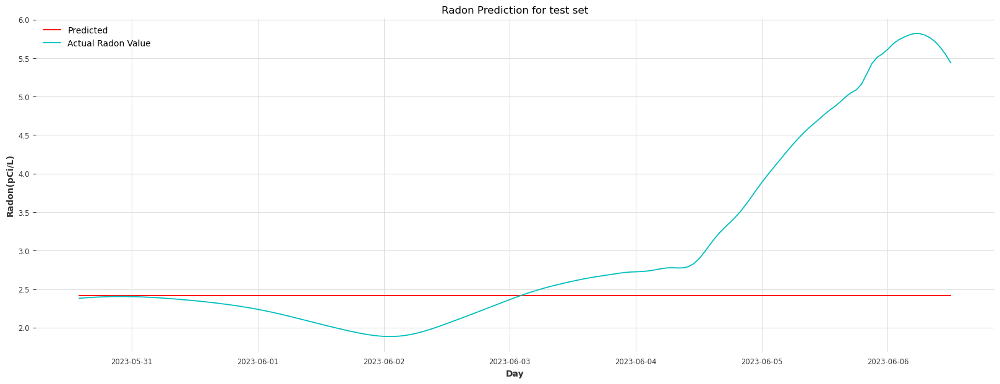

In [40]:
# plot the forecast
plt.figure(100, figsize=(20, 7))
plt.plot(dfY.index, dfY['Predicted'], color='r', label='Predicted')
plt.plot(dfY.index, dfY['Actual'], color='c', label='Actual Radon Value')
plt.legend()
plt.title('Radon Prediction for test set')
plt.xlabel('Day')
plt.ylabel('Radon(pCi/L)')
plt.show()